In [1]:
#!/usr/bin/env python3.6
# -*- coding: utf-8 -*-

In [2]:
# Imports
import sys
import math
import numpy as np
from matplotlib import animation
from IPython.display import HTML
from matplotlib import pyplot as plt
plt.rcParams['animation.ffmpeg_path'] = '/usr/bin/ffmpeg'
import mpl_toolkits.mplot3d.axes3d as p3

In [3]:
np.random.seed(20)
np.set_printoptions(threshold=sys.maxsize)

In [4]:
%matplotlib inline

# Data

In [5]:
# Read data
motion = np.genfromtxt('../dataset3/com_data/odom_full.csv', delimiter=',', dtype=np.float64)
print("Motion data has a length of ", len(motion))

Motion data has a length of  94738


In [6]:
motion.shape

(94738, 32)

In [7]:
motion[0]

array([ 1.63395464e+09,  1.00000000e-01,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  1.82542473e-01,
        1.35624066e-01, -3.39013636e-01,  1.82857841e-01, -1.35449603e-01,
       -3.39399964e-01, -2.74768233e-01,  1.35316253e-01, -3.40746403e-01,
       -2.75295526e-01, -1.35175854e-01, -3.41135651e-01, -5.66924317e-02,
        6.24190956e-04, -1.50323876e-46,  1.72969623e-29, -6.09867293e-32,
       -3.52772832e-03,  9.99993778e-01, -2.88852735e-18, -5.73324575e-15,
        3.70707180e-51,  1.24638970e-26, -9.32457774e-33,  6.57871115e-03])

## Visualizations

In [8]:
"""
    Plot a 4x2 grid of comparing data.
"""
def plot_non_overlapping_data(dataset, data:list, idxs: list):
    fig, ((ax1, ax2), (ax3, ax4), (ax5, ax6), (ax7, ax8)) = plt.subplots(4,2, figsize=(20,15))
    fig.suptitle('Heigh-Force (Idle)')

    ax1.plot(dataset[data[0], 0], dataset[data[0], idxs[0]], 'b-')
    ax1.set_xlabel('Time')
    ax1.set_ylabel('Height (FL)')

    ax2.plot(dataset[data[0], 0], dataset[data[0], idxs[1]], 'g-')
    ax2.set_xlabel('Time')
    ax2.set_ylabel('Force (FL)')

    ax3.plot(dataset[data[1], 0], dataset[data[1], idxs[2]], 'b-')
    ax3.set_xlabel('Time')
    ax3.set_ylabel('Height (FR)')

    ax4.plot(dataset[data[1], 0], dataset[data[1], idxs[3]], 'g-')
    ax4.set_xlabel('Time')
    ax4.set_ylabel('Force (FR)')

    ax5.plot(dataset[data[2], 0], dataset[data[2], idxs[4]], 'b-')
    ax5.set_xlabel('Time')
    ax5.set_ylabel('Height (RL)')

    ax6.plot(dataset[data[2], 0], datasetD[data[2], idxs[5]], 'g-')
    ax6.set_xlabel('Time')
    ax6.set_ylabel('Force (RL)')

    ax7.plot(dataset[data[3], 0], dataset[data[3], idxs[6]], 'b-')
    ax7.set_xlabel('Time')
    ax7.set_ylabel('Height (RR)')

    ax8.plot(dataset[data[3], 0], dataset[data[3], idxs[7]], 'g-')
    ax8.set_xlabel('Time')
    ax8.set_ylabel('Force (RR)')

    fig.tight_layout()

    plt.show()
 
"""
    Plot data on overlapping graph. 
"""
def plot_overlapping_data(title: str, dataset, data: list, idxs: list, draw_footsteps=None, footsteps_timestamp=None):
    fig, (ax1, ax3, ax5, ax7) = plt.subplots(4,1, figsize=(20,15))
    fig.suptitle(title)
    
    # FL plot (height)
    ax1.plot(dataset[data[0], 0], dataset[data[0], idxs[0]], 'b-')
    ax1.set_ylabel('Height (FL)', color='b')
    ax1.set_xlabel('Time')
         
    # FL plot (force)
    ax2 = ax1.twinx()
    ax2.plot(dataset[data[0], 0], dataset[data[0], idxs[1]], 'g-')
    ax2.set_ylabel('Force (FL)', color='g')
          
    # FR plot (height)
    ax3.plot(dataset[data[1], 0], dataset[data[1], idxs[2]], 'b-')
    ax3.set_ylabel('Height (FR)', color='b')
    ax3.set_xlabel('Time')
         
    # FR plot (force)
    ax4 = ax3.twinx()
    ax4.plot(dataset[data[1], 0], dataset[data[1], idxs[3]], 'g-')
    ax4.set_ylabel('Force(FR)', color='g')      
          
    # RL plot (height)
    ax5.plot(dataset[data[2], 0], dataset[data[2], idxs[4]], 'b-')
    ax5.set_ylabel('Height (RL)', color='b')
    ax5.set_xlabel('Time')
         
    # RL plot (force)
    ax6 = ax5.twinx()
    ax6.plot(dataset[data[2], 0], dataset[data[2], idxs[5]], 'g-')
    ax6.set_ylabel('Force (RL)', color='g')   
          
    # RR plot (height)
    ax7.plot(dataset[data[3], 0], dataset[data[3], idxs[6]], 'b-')
    ax7.set_ylabel('Height (RR)', color='b')
    ax7.set_xlabel('Time')
         
    # RR plot (force)
    ax8 = ax7.twinx()
    ax8.plot(dataset[data[3], 0], dataset[data[3], idxs[7]], 'g-')
    ax8.set_ylabel('Force (RR)', color='g')

    for ax in [ax2, ax4, ax6, ax8]:
        for tl in ax.get_yticklabels():
            tl.set_color('g')
    
    for ax in [ax1, ax3, ax5, ax7]:
        for tl in ax.get_yticklabels():
            tl.set_color('b')
    
    # Draw footsteps
    if draw_footsteps:
        for ax in [ax1, ax3, ax5, ax7]:
            for footstep_timestamp in footsteps_timestamp:
                if footstep_timestamp <= max(dataset[data[0], 0]) and footstep_timestamp >= min(dataset[data[0], 0]):
                    #print("Timestamp: ", footstep_timestamp)
                    ax.axvline(x=footstep_timestamp, color='r', linestyle='-')
                    #ax.axvline(x=footstep_timestamp+0.15, color='b', linestyle='-')
    
    fig.tight_layout()
    plt.show()

## Height-Force plots

In [9]:
def get_specific_cmd(dataset, fwd, side, rot):
    if abs(fwd): 
        return np.where(dataset[:, 1] > 0)[0] if fwd > 0 else np.where(dataset[:, 1] < 0)[0]
    if abs(side): 
        return np.where(dataset[:, 2] > 0)[0] if side > 0 else np.where(dataset[:, 2] < 0)[0]
    if abs(rot): 
        return np.where(dataset[:, 6] > 0)[0] if rot > 0 else np.where(dataset[:, 6] < 0)[0]

In [10]:
def get_swinging_motions(dataset, height=-0.1):
    # FR min height (i.e swining motion)
    fr_min_height = np.where(dataset[:, 9] < height)[0]
    fl_min_height = np.where(dataset[:, 12] < height)[0]
    rr_min_height = np.where(dataset[:, 15] < height)[0]
    rl_min_height = np.where(dataset[:, 18] < height)[0]
            
    return fr_min_height,fl_min_height,rr_min_height,rl_min_height

## motion

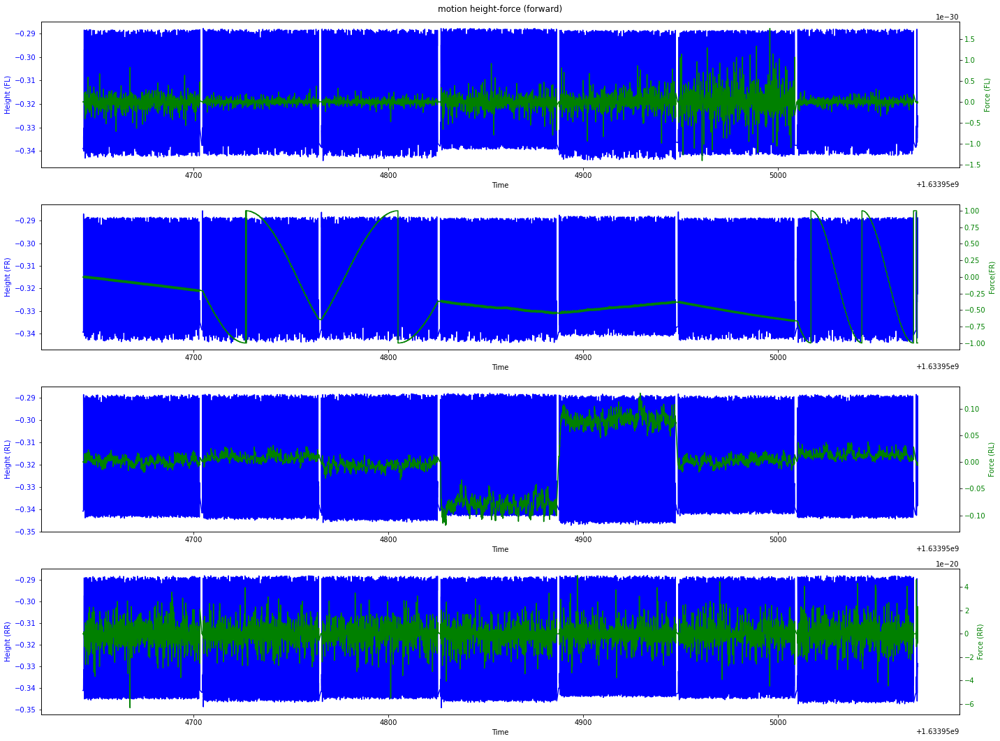

In [11]:
# Forward
fwd_cmds = get_specific_cmd(motion, 1, 0, 0)
motion_fwd = motion[fwd_cmds]
fr_min_height,fl_min_height,rr_min_height,rl_min_height = get_swinging_motions(motion_fwd)

sample_walking_fr_height = fr_min_height
sample_walking_fl_height = fl_min_height
sample_walking_rr_height = rr_min_height
sample_walking_rl_height = rl_min_height

plot_overlapping_data("motion height-force (forward)",
                      motion,
                      [sample_walking_fr_height, 
                       sample_walking_fl_height, 
                       sample_walking_rr_height,
                       sample_walking_rl_height],
                       [9, 21, 12, 24, 15, 27, 18, 30])

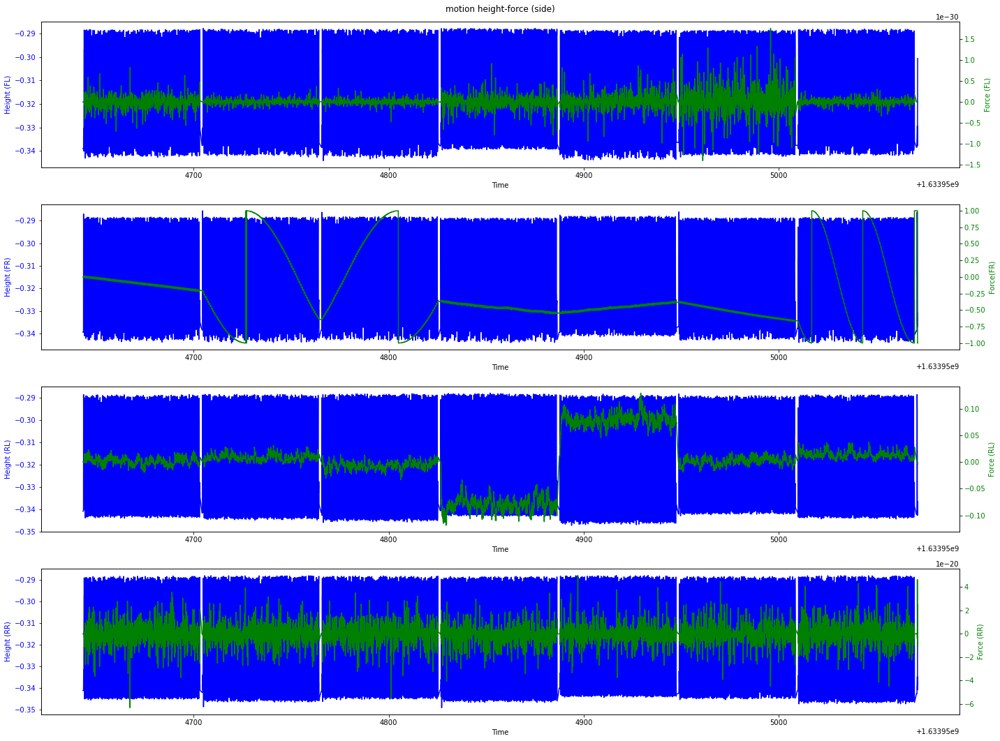

In [12]:
# Side (right)
side_cmds = get_specific_cmd(motion, 0, -1, 0)
motion_side = motion[side_cmds]
fr_min_height,fl_min_height,rr_min_height,rl_min_height = get_swinging_motions(motion_side)

sample_walking_fr_height = fr_min_height
sample_walking_fl_height = fl_min_height
sample_walking_rr_height = rr_min_height
sample_walking_rl_height = rl_min_height

plot_overlapping_data("motion height-force (side)",
                      motion,
                      [sample_walking_fr_height, 
                       sample_walking_fl_height, 
                       sample_walking_rr_height,
                       sample_walking_rl_height],
                       [9, 21, 12, 24, 15, 27, 18, 30])

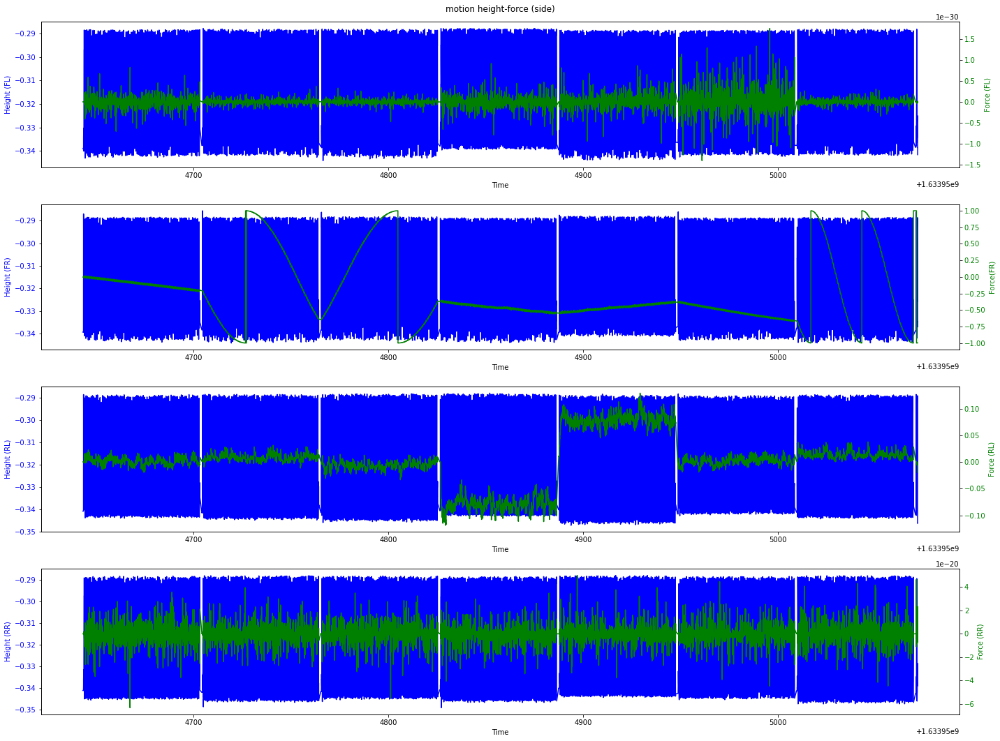

In [13]:
# Side (left)
side_cmds = get_specific_cmd(motion, 0, 1, 0)
motion_side = motion[side_cmds]
fr_min_height,fl_min_height,rr_min_height,rl_min_height = get_swinging_motions(motion_side)

sample_walking_fr_height = fr_min_height
sample_walking_fl_height = fl_min_height
sample_walking_rr_height = rr_min_height
sample_walking_rl_height = rl_min_height

plot_overlapping_data("motion height-force (side)",
                      motion,
                      [sample_walking_fr_height, 
                       sample_walking_fl_height, 
                       sample_walking_rr_height,
                       sample_walking_rl_height],
                       [9, 21, 12, 24, 15, 27, 18, 30])

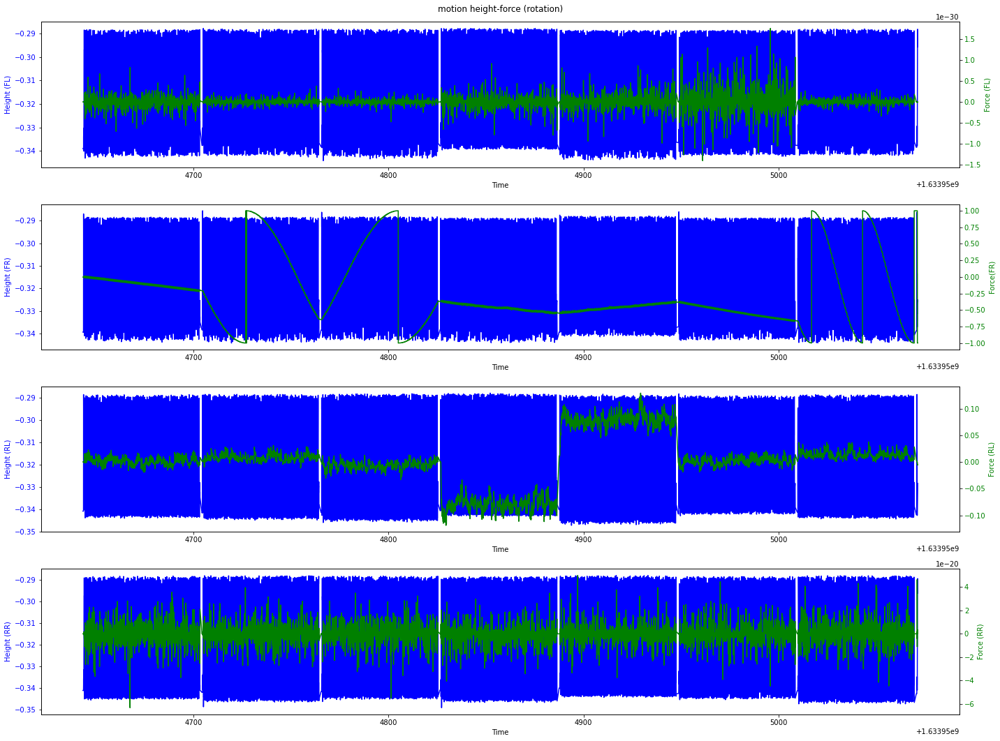

In [14]:
# Rotation (clockwise)
rot_cmds = get_specific_cmd(motion, 0, 0, -1)
motion_rot = motion[rot_cmds]
fr_min_height,fl_min_height,rr_min_height,rl_min_height = get_swinging_motions(motion_rot)

sample_walking_fr_height = fr_min_height
sample_walking_fl_height = fl_min_height
sample_walking_rr_height = rr_min_height
sample_walking_rl_height = rl_min_height

plot_overlapping_data("motion height-force (rotation)",
                      motion,
                      [sample_walking_fr_height, 
                       sample_walking_fl_height, 
                       sample_walking_rr_height,
                       sample_walking_rl_height],
                       [9, 21, 12, 24, 15, 27, 18, 30])

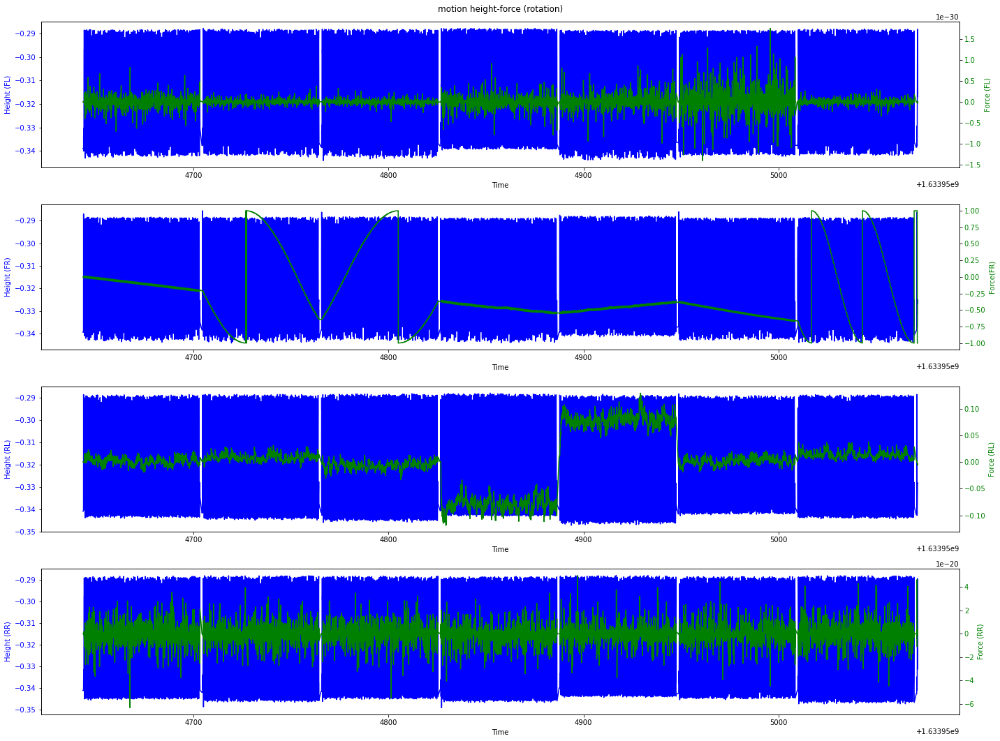

In [15]:
# Rotation (counter clockwise)
rot_cmds = get_specific_cmd(motion, 0, 0, 1)
motion_rot = motion[rot_cmds]
fr_min_height,fl_min_height,rr_min_height,rl_min_height = get_swinging_motions(motion_rot)

sample_walking_fr_height = fr_min_height
sample_walking_fl_height = fl_min_height
sample_walking_rr_height = rr_min_height
sample_walking_rl_height = rl_min_height

plot_overlapping_data("motion height-force (rotation)",
                      motion,
                      [sample_walking_fr_height, 
                       sample_walking_fl_height, 
                       sample_walking_rr_height,
                       sample_walking_rl_height],
                       [9, 21, 12, 24, 15, 27, 18, 30])

## Footsteps Extraction (Height + Force)

In [16]:
"""
    Extract footsteps from raw data using
    force and height measurements together.
"""
def extract_footsteps(dataset, height_threshold=0.1, force_thresholds=[100,100,100,100]):
    # Compute height difference for FR and FL
    fr_fl_diff = np.round(abs(dataset[:, 9] - dataset[:, 12]), 9)
    print("Max diff between fr and fl: ", max(fr_fl_diff))

    # Compute height difference for RR and RL
    rr_rl_diff = np.round(abs(dataset[:, 15] - dataset[:, 18]), 9)
    print("Max diff between rr and rl: ", max(rr_rl_diff))

    # Compute compound difference for all foots
    height_diff = np.round(fr_fl_diff + rr_rl_diff, 9)
    print("Min and max diff between front and rear feet", min(height_diff), max(height_diff), "\n")
    
    # Find footsteps (based on height difference)
    footsteps_height = np.where(height_diff < height_threshold)[0]
    print("Amount of footsteps found with height criteria: ", len(footsteps_height), "\n")
    
    # Find footsteps based on force perceived
    rear_force_footsteps = np.where(np.logical_or(dataset[:, 21] <= force_thresholds[0], dataset[:, 24] <= force_thresholds[1]))[0]
    front_force_footsteps = np.where(np.logical_or(dataset[:, 27] <= force_thresholds[2], dataset[:, 30] <= force_thresholds[3]))[0]
    
    # Find footsteps that match force constraints on all foot
    footsteps_force = np.intersect1d(rear_force_footsteps, front_force_footsteps)
    print("Number of force footsteps: ", len(footsteps_force), "\n")
    
    # Find force and height footsteps intersection
    force_height_footsteps = np.intersect1d(footsteps_force, footsteps_height)
    print("Number of height-force footsteps: ", len(force_height_footsteps), "\n")
    
    return force_height_footsteps


"""
    Perform non-maximum-suppresion on the 
    footsteps found as multiple instances
    are found within a small time window.
"""
def footsteps_nms(dataset, footsteps):
    footsteps_nms = []

    idx = 0
    footstep_to_add = footsteps[0]
    
    # Iterate over the footsteps
    while idx < (len(footsteps) - 1):
        # Compute time difference between
        # current and next footsteps
        time_difference = abs(dataset[footsteps[idx], 0] - dataset[footsteps[idx+1], 0])
        
        # Find corresponding index in between
        # the current and next footsteps
        time_differences = np.abs(dataset[:, 0] - (dataset[footsteps[idx], 0] + time_difference/2))
        matching_index = time_differences.argmin()
        
        # Retrieve what is the maximum height
        # reached in between the current and
        # next footstep
        height_peek_in_between = max([dataset[matching_index, x] for x in [9, 12, 15, 18]])
        
        # Within same time window but not consecute footsteps
        if time_difference < 0.1 and not height_peek_in_between > -0.31:
            # Compute height difference between feet
            #height_diff_idx = abs(dataset[footsteps[idx], 9] - dataset[footsteps[idx], 12]) + abs(dataset[footsteps[idx], 15] - dataset[footsteps[idx], 18])
            #height_diff_idx_next = abs(dataset[footsteps[idx+1], 9] - dataset[footsteps[idx+1], 12]) + abs(dataset[footsteps[idx+1], 15] - dataset[footsteps[idx+1], 18])
                
            # Choose foot with lowest height difference
            #footstep_to_add = footsteps[idx] if height_diff_idx < height_diff_idx_next else footsteps[idx+1]
            #timestamp_of_footstep_to_add = dataset[footsteps[idx], 0] if height_diff_idx < height_diff_idx_next else dataset[footsteps[idx+1], 0] 
            
            footstep_to_add = footsteps[idx] if dataset[footsteps[idx], 0] < dataset[footsteps[idx+1], 0] else footsteps[idx+1]
        elif time_difference < 0.1 and height_peek_in_between > -0.31:
            footsteps_nms.append(footstep_to_add)
        elif time_difference > 0.1:
            footsteps_nms.append(footstep_to_add)
        
        idx += 1
        
    return np.asarray(footsteps_nms)

## Footsteps

In [17]:
def footstep_extraction_and_plotting(dataset, velocities, height_threshold, force_thresholds, indexes):
    # Extract backward motion entries
    cmds = get_specific_cmd(dataset, velocities[0], velocities[1], velocities[2])
    motion_cmds = motion[cmds]
    fr_min_height, fl_min_height, rr_min_height, rl_min_height = get_swinging_motions(motion_cmds)
    print("Foot swinging motions lenghts: ", len(fr_min_height), len(fl_min_height), len(rr_min_height), len(rl_min_height))
    
    # Extract footsteps
    footsteps = extract_footsteps(motion_cmds, height_threshold, force_thresholds)
    print("Footsteps extracted: ", len(footsteps))
    
    # Footsteps NMS
    footsteps_after_nms = footsteps_nms(motion_cmds, footsteps)
    print("Footsteps after non-maximum-suppression: ", len(footsteps_after_nms))
    
    # Plot footsteps
    sample_walking_fr_height = fr_min_height[indexes]
    sample_walking_fl_height = fl_min_height[indexes]
    sample_walking_rr_height = rr_min_height[indexes]
    sample_walking_rl_height = rl_min_height[indexes]

    plot_overlapping_data("Footsteps",
                          motion_cmds,
                          [sample_walking_fr_height, 
                           sample_walking_fl_height, 
                           sample_walking_rr_height,
                           sample_walking_rl_height],
                           [9, 21, 12, 24, 15, 27, 18, 30],
                           True,
                           motion_cmds[footsteps_nms(motion_cmds, footsteps), 0])
                           #motion_cmds[footsteps, 0])
 
    return motion_cmds, footsteps_after_nms

### Forward motion

Foot swinging motions lenghts:  18958 18958 18958 18958
Max diff between fr and fl:  0.049234569
Max diff between rr and rl:  0.050395072
Min and max diff between front and rear feet 5.4896e-05 0.09889397 

Amount of footsteps found with height criteria:  7659 

Number of force footsteps:  18958 

Number of height-force footsteps:  7659 

Footsteps extracted:  7659
Footsteps after non-maximum-suppression:  1638


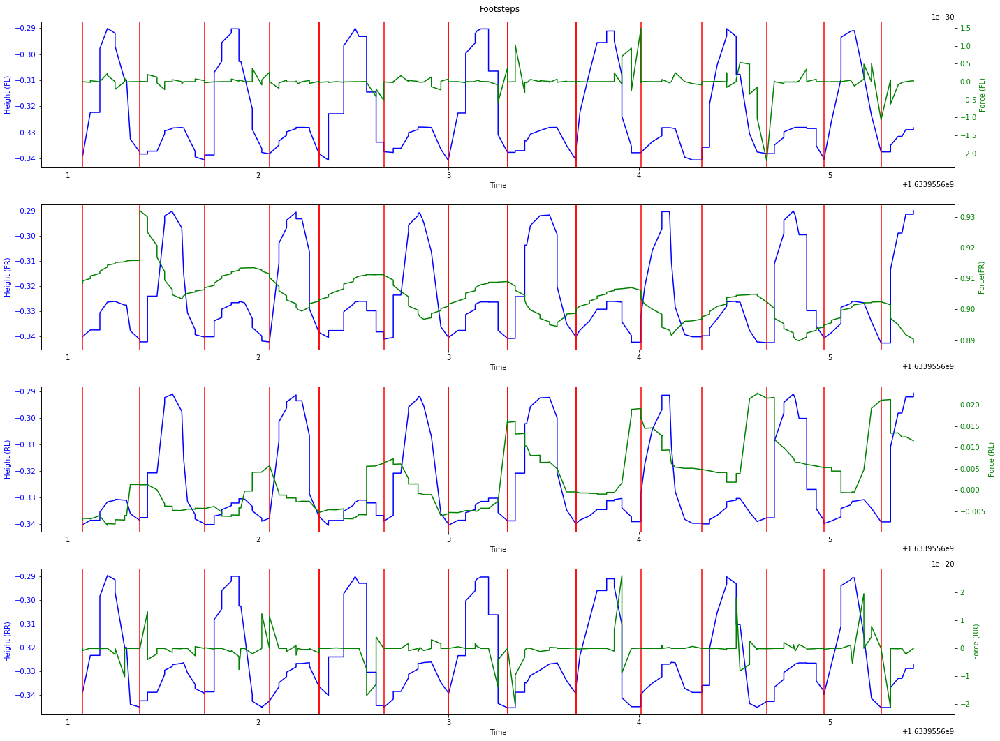

In [18]:
motion_fwd, footsteps_fwd = footstep_extraction_and_plotting(dataset=motion, velocities=[1, 0, 0], height_threshold=0.02, force_thresholds=[100,100,100,100], indexes=range(10000, 10200))

### Side motion (right)

Foot swinging motions lenghts:  18936 18936 18936 18936
Max diff between fr and fl:  0.047053516
Max diff between rr and rl:  0.051178902
Min and max diff between front and rear feet 7.8142e-05 0.097535073 

Amount of footsteps found with height criteria:  6995 

Number of force footsteps:  18936 

Number of height-force footsteps:  6995 

Footsteps extracted:  6995
Footsteps after non-maximum-suppression:  1594


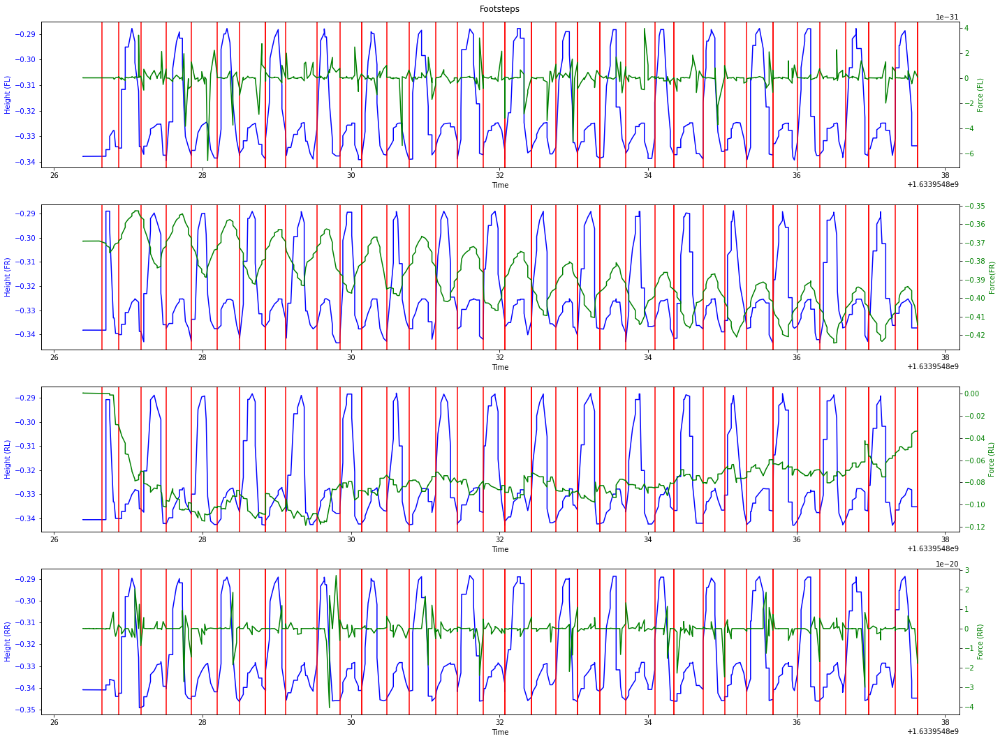

In [19]:
motion_side_right, footsteps_01_side_right = footstep_extraction_and_plotting(dataset=motion, velocities=[0, -1, 0],  height_threshold=0.02, force_thresholds=[100,100,100,100], indexes=range(0, 500))

### Side (left)

Foot swinging motions lenghts:  18961 18961 18961 18961
Max diff between fr and fl:  0.050379336
Max diff between rr and rl:  0.051147252
Min and max diff between front and rear feet 9.089e-06 0.098065943 

Amount of footsteps found with height criteria:  7379 

Number of force footsteps:  18961 

Number of height-force footsteps:  7379 

Footsteps extracted:  7379
Footsteps after non-maximum-suppression:  1653


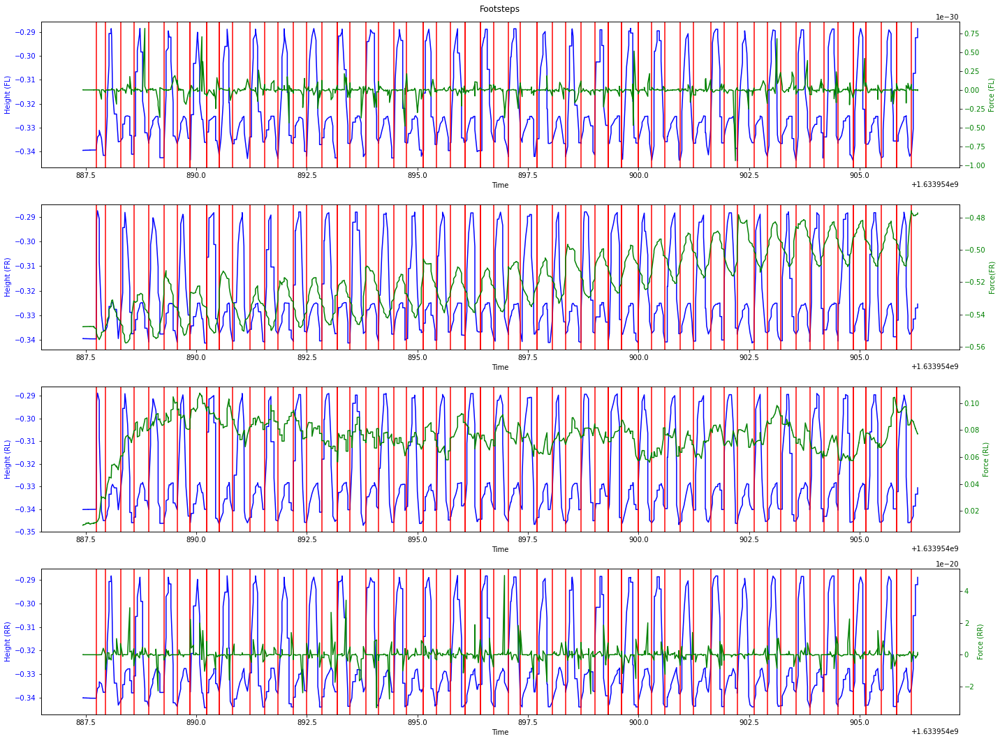

In [20]:
motion_side_left, footsteps_01_side_left = footstep_extraction_and_plotting(dataset=motion, velocities=[0, 1, 0],  height_threshold=0.02, force_thresholds=[100,100,100,100], indexes=range(0, 850))

### Rotation (clockwise)

Foot swinging motions lenghts:  18940 18940 18940 18940
Max diff between fr and fl:  0.048926204
Max diff between rr and rl:  0.049568832
Min and max diff between front and rear feet 8.4788e-05 0.098098665 

Amount of footsteps found with height criteria:  7881 

Number of force footsteps:  18940 

Number of height-force footsteps:  7881 

Footsteps extracted:  7881
Footsteps after non-maximum-suppression:  1645


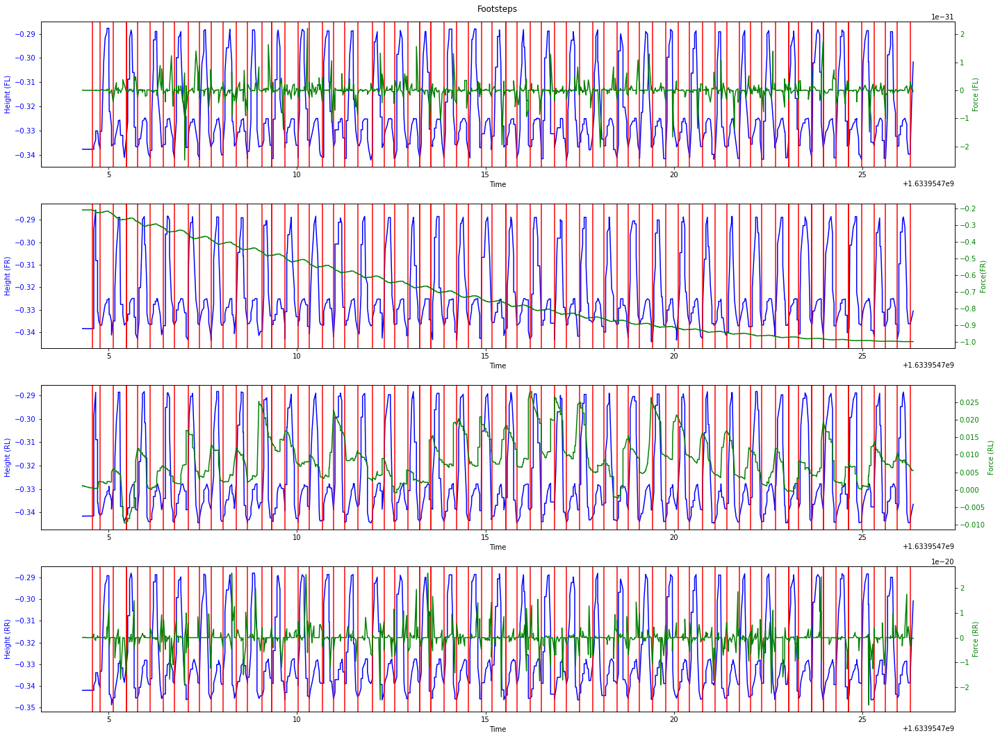

In [21]:
motion_clock, footsteps_01_clock = footstep_extraction_and_plotting(dataset=motion, velocities=[0, 0, -1],  height_threshold=0.02, force_thresholds=[100,100,100,100], indexes=range(0, 1000))

### Rotation (counter clockwise)

Foot swinging motions lenghts:  18943 18943 18943 18943
Max diff between fr and fl:  0.04901731
Max diff between rr and rl:  0.050334245
Min and max diff between front and rear feet 8.744e-05 0.09877932 

Amount of footsteps found with height criteria:  7885 

Number of force footsteps:  18943 

Number of height-force footsteps:  7885 

Footsteps extracted:  7885
Footsteps after non-maximum-suppression:  1657


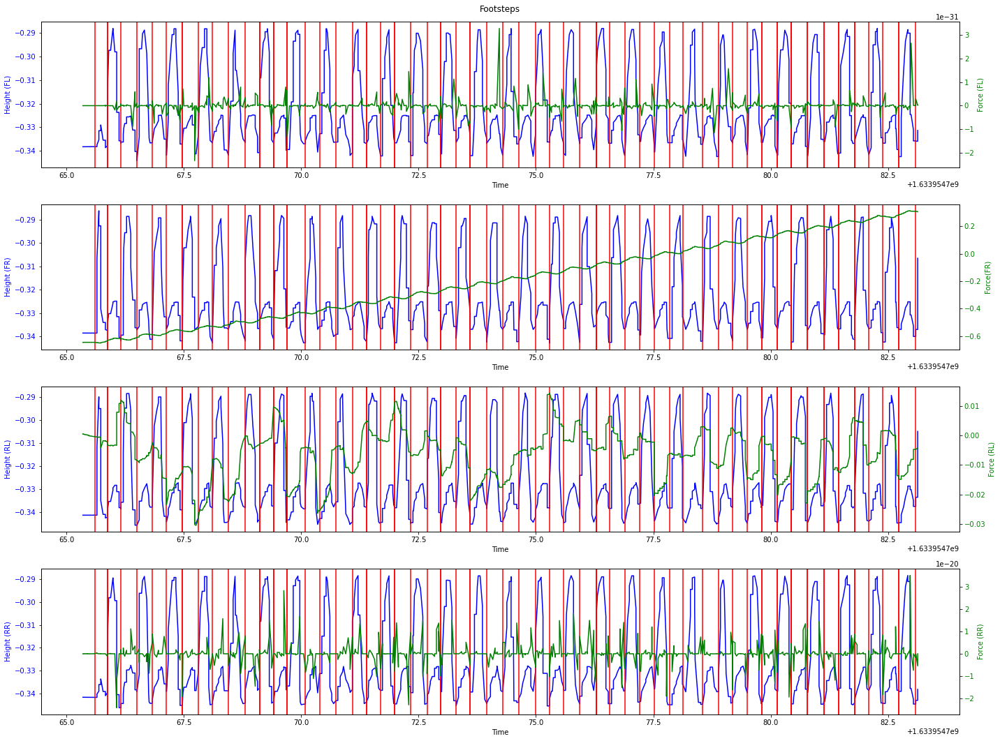

In [22]:
motion_count, footsteps_01_count = footstep_extraction_and_plotting(dataset=motion, velocities=[0, 0, 1],  height_threshold=0.02, force_thresholds=[100,100,100,100], indexes=range(0, 800))

### CoM displacement

In [23]:
def euler_from_quaternion(x, y, z, w):
    """
    Convert a quaternion into euler angles (roll, pitch, yaw)
    roll is rotation around x in radians (counterclockwise)
    pitch is rotation around y in radians (counterclockwise)
    yaw is rotation around z in radians (counterclockwise)
    """
    t0 = +2.0 * (w * x + y * z)
    t1 = +1.0 - 2.0 * (x * x + y * y)
    roll_x = math.atan2(t0, t1)
     
    t2 = +2.0 * (w * y - z * x)
    t2 = +1.0 if t2 > +1.0 else t2
    t2 = -1.0 if t2 < -1.0 else t2
    pitch_y = math.asin(t2)
     
    t3 = +2.0 * (w * z + x * y)
    t4 = +1.0 - 2.0 * (y * y + z * z)
    yaw_z = math.atan2(t3, t4)
     
    return roll_x, pitch_y, yaw_z # in radians

In [24]:
def get_step_size(dataset, footsteps, idx_coord=[7,10,13,16]):
    # Footsteps sizes
    step_size_fr = []
    step_size_fl = []
    step_size_rr = []
    step_size_rl = []
    footstep_period = []
    
    # Compute step sizes
    for idx, footstep in enumerate(footsteps):
        if idx > 0:
            time_diff = dataset[footsteps[idx], 0] - dataset[footsteps[idx-1], 0]
            #print("Time diff: ", time_diff)

            if time_diff < 1.0:
                footstep_period.append(time_diff)
                step_size_fl.append(dataset[footsteps[idx], idx_coord[0]] - dataset[footsteps[idx-1], idx_coord[0]])
                step_size_fr.append(dataset[footsteps[idx], idx_coord[1]] - dataset[footsteps[idx-1], idx_coord[1]])
                step_size_rl.append(dataset[footsteps[idx], idx_coord[2]] - dataset[footsteps[idx-1], idx_coord[2]])
                step_size_rr.append(dataset[footsteps[idx], idx_coord[3]] - dataset[footsteps[idx-1], idx_coord[3]])
    
    # Convert to numpy array
    step_size_fl_numpy = np.array(step_size_fl)
    step_size_fr_numpy = np.array(step_size_fr)
    step_size_rl_numpy = np.array(step_size_rl)
    step_size_rr_numpy = np.array(step_size_rr)
    footstep_period_numpy = np.array(footstep_period)
    
    # Only keep positive footsteps
    step_size_fl_numpy = step_size_fl_numpy[np.where(step_size_fl_numpy > 0)[0]]
    step_size_fr_numpy = step_size_fr_numpy[np.where(step_size_fr_numpy > 0)[0]]
    step_size_rl_numpy = step_size_rl_numpy[np.where(step_size_rl_numpy > 0)[0]]
    step_size_rr_numpy = step_size_rr_numpy[np.where(step_size_rr_numpy > 0)[0]]
                
    # Print average step-size
    print("Avg. step size time: ", np.mean(footstep_period_numpy))
    print("Min. step size time: ", np.min(footstep_period_numpy))
    print("Max. step size time: ", np.max(footstep_period_numpy))
    print("Std. step size time: ", np.std(footstep_period_numpy), "\n")
    #print(footstep_period_numpy)
    print("Avg. step size for FL foot: ", np.mean(step_size_fl_numpy))
    print("Avg. step size for FR foot: ", np.mean(step_size_fr_numpy))
    print("Avg. step size for RL foot: ", np.mean(step_size_rl_numpy))
    print("Avg. step size for RR foot: ", np.mean(step_size_rr_numpy), '\n')

    # Print std. dev. step-size
    print("Std. dev. step size for FL foot: ", np.std(step_size_fl_numpy))
    print("Std. dev. step size for FR foot: ", np.std(step_size_fr_numpy))
    print("Std. dev. step size for RL foot: ", np.std(step_size_rl_numpy))
    print("Std. dev. step size for RR foot: ", np.std(step_size_rr_numpy), '\n')
    
    return step_size_fr_numpy, step_size_fl_numpy, step_size_rr_numpy, step_size_rl_numpy

In [25]:
def getCoMStep(dataset, footsteps, velocities, swinging, displacement_type, threshold=0.02):
    base_yaw = []
    base_displacement_x = []
    base_displacement_y = []
    support_base_displacement_x = []
    support_base_displacement_y = []
    
    # Visualize footsteps
    for idx, footstep in enumerate(footsteps):
        dataset[footstep, 7:19] = np.round(dataset[footstep, 7:19], 3)
        
        #print(velocities)
        #print(dataset[footstep, 1], dataset[footstep, 2], dataset[footstep, 5])
        
        velocity_check = np.isclose(velocities[0], dataset[footstep, 1]) and np.isclose(velocities[1], dataset[footstep, 2]) and np.isclose(velocities[2], dataset[footstep, 5])
        #print("Velocity: ", velocity_check)
        
        if idx < (len(footsteps) - 1) and velocity_check:
            time_difference = abs(dataset[footsteps[idx], 0] - dataset[footsteps[idx+1], 0])
            
            if time_difference < 0.4 and time_difference > 0:
                # Find corresponding index between two consecutive footsteps
                lower_bound_index = np.abs(dataset[:, 0] - (dataset[footsteps[idx], 0]))
                upper_bound_index = np.abs(dataset[:, 0] - (dataset[footsteps[idx], 0] + time_difference))
                matching_index_lower_bound = lower_bound_index.argmin()
                matching_index_upper_bound = upper_bound_index.argmin()

                # Retrieve what is the maximum height
                # reached in between the current and
                # next footstep
                height_peeks_in_between = [dataset[matching_index_lower_bound:matching_index_upper_bound, x] for x in [9, 12, 15, 18]]

                fl_moving = max(height_peeks_in_between[0]) > -0.31
                fr_moving = max(height_peeks_in_between[1]) > -0.31
                rl_moving = max(height_peeks_in_between[2]) > -0.31
                rr_moving = max(height_peeks_in_between[3]) > -0.31
                                
                if (not fr_moving != fl_moving):
                    print("Exception")
                    continue
                    
                # Get euler angles from odom to base rotation
                _, _, curr_yaw = euler_from_quaternion(dataset[footstep, 22], dataset[footstep, 23], dataset[footstep, 24], dataset[footstep, 25])
                _, _, next_yaw = euler_from_quaternion(dataset[footsteps[idx+1], 22], dataset[footsteps[idx+1], 23], dataset[footsteps[idx+1], 24], dataset[footsteps[idx+1], 25])

                # Compute rotation matrix
                c_curr, s_curr = np.cos(curr_yaw), np.sin(curr_yaw)
                c_next, s_next = np.cos(next_yaw), np.sin(next_yaw)
                R_curr = np.array(((c_curr, -s_curr), (s_curr, c_curr)))
                R_next = np.array(((c_next, -s_next), (s_next, c_next)))
                
                # Odom base vectors
                curr_base = np.array([[dataset[footstep, 19], dataset[footstep, 20]]])
                next_base = np.array([[dataset[footsteps[idx+1], 19], dataset[footsteps[idx+1], 20]]])
                
                # Local base vectors
                local_curr_base = R_curr.T @ curr_base.T
                local_next_base = R_curr.T @ next_base.T
                local_next_base_next = R_next.T @ next_base.T
                base_displacement = local_next_base - local_curr_base
                                        
                # Feet displacements
                fl_x_displacement = dataset[footsteps[idx+1], 7] - dataset[footsteps[idx], 7]
                fl_y_displacement = dataset[footsteps[idx+1], 8] - dataset[footsteps[idx], 8]
                fr_x_displacement = dataset[footsteps[idx+1], 10] - dataset[footsteps[idx], 10]
                fr_y_displacement = dataset[footsteps[idx+1], 11] - dataset[footsteps[idx], 11]
                rl_x_displacement = dataset[footsteps[idx+1], 13] - dataset[footsteps[idx], 13]
                rl_y_displacement = dataset[footsteps[idx+1], 14] - dataset[footsteps[idx], 14]
                rr_x_displacement = dataset[footsteps[idx+1], 16] - dataset[footsteps[idx], 16]
                rr_y_displacement = dataset[footsteps[idx+1], 17] - dataset[footsteps[idx], 17]
                
                # Support foot base displacement
                support_base_displacement = [0, 0]
                if fr_moving and swinging:
                    base_yaw.append(next_yaw - curr_yaw)
                    base_displacement_x.append(base_displacement.tolist()[0])
                    base_displacement_y.append(base_displacement.tolist()[1])
                    support_base_displacement_x.append(fr_x_displacement)
                    support_base_displacement_y.append(fr_y_displacement)
                elif fl_moving and not swinging:
                    base_yaw.append(next_yaw - curr_yaw)
                    base_displacement_x.append(base_displacement.tolist()[0])
                    base_displacement_y.append(base_displacement.tolist()[1])
                    support_base_displacement_x.append(fl_x_displacement)
                    support_base_displacement_y.append(fl_y_displacement)
                
    if displacement_type == "odom":
        return base_yaw, base_displacement_x, base_displacement_y
    else:
        return base_yaw, support_base_displacement_x, support_base_displacement_y

### Forward motion (0.1)

#### FR/RL swing

In [106]:
# Step size and velocity along x and y axis 
com_yaw_fwd_fr_rl_01, com_x_fwd_fr_rl_01, com_y_fwd_fr_rl_01,= getCoMStep(motion_fwd, footsteps_fwd, [0.1, 0, 0], True, "odom")
print("Size: ", len(com_yaw_fwd_fr_rl_01))

Size:  91


In [44]:
print(f'Avg. com step yaw: {np.mean(com_yaw_fwd_fr_rl_01)}')
print(f'Min com step yaw: {np.min(com_yaw_fwd_fr_rl_01)}')
print(f'Max com step yaw: {np.max(com_yaw_fwd_fr_rl_01)}')
print(f'Std com step yaw: {np.std(com_yaw_fwd_fr_rl_01)}')

Avg. com step yaw: -0.014378809548880161
Min com step yaw: -0.026055613233679442
Max com step yaw: 0.007597736588798518
Std com step yaw: 0.006962042688514139


In [45]:
print(f'Avg. com step size (x): {np.mean(com_x_fwd_fr_rl_01)}')
print(f'Min com step size (x): {np.min(com_x_fwd_fr_rl_01)}')
print(f'Max com step size (x): {np.max(com_x_fwd_fr_rl_01)}')
print(f'Std com step size (x): {np.std(com_x_fwd_fr_rl_01)}')

Avg. com step size (x): 0.018323146926494695
Min com step size (x): 0.002550799614746177
Max com step size (x): 0.03416980000639547
Std com step size (x): 0.0069368185099109095


In [46]:
print(f'Avg. com step size (y): {np.mean(com_y_fwd_fr_rl_01)}')
print(f'Min com step size (y): {np.min(com_y_fwd_fr_rl_01)}')
print(f'Max com step size (y): {np.max(com_y_fwd_fr_rl_01)}')
print(f'Std com step size (y): {np.std(com_y_fwd_fr_rl_01)}')

Avg. com step size (y): -0.00544222785027594
Min com step size (y): -0.010959171917564126
Max com step size (y): -0.00031482823682030313
Std com step size (y): 0.0022329065061747404


#### FL/RR swing

In [107]:
# Step size and velocity along x and y axis 
com_yaw_fwd_fl_rr_01, com_x_fwd_fl_rr_01, com_y_fwd_fl_rr_01,= getCoMStep(motion_fwd, footsteps_fwd, [0.1, 0, 0], False, "odom")
print("Size: ", len(com_yaw_fwd_fl_rr_01))

Size:  91


In [48]:
print(f'Avg. com step yaw: {np.mean(com_yaw_fwd_fl_rr_01)}')
print(f'Min com step yaw: {np.min(com_yaw_fwd_fl_rr_01)}')
print(f'Max com step yaw: {np.max(com_yaw_fwd_fl_rr_01)}')
print(f'Std com step yaw: {np.std(com_yaw_fwd_fl_rr_01)}')

Avg. com step yaw: 0.010062711686051714
Min com step yaw: -0.009354841804778746
Max com step yaw: 0.020951275519976997
Std com step yaw: 0.005851067290974285


In [49]:
print(f'Avg. com step size (x): {np.mean(com_x_fwd_fl_rr_01)}')
print(f'Min com step size (x): {np.min(com_x_fwd_fl_rr_01)}')
print(f'Max com step size (x): {np.max(com_x_fwd_fl_rr_01)}')
print(f'Std com step size (x): {np.std(com_x_fwd_fl_rr_01)}')

Avg. com step size (x): 0.02265583506641263
Min com step size (x): 0.007594238939951925
Max com step size (x): 0.038234367327124597
Std com step size (x): 0.007263995041042689


In [50]:
print(f'Avg. com step size (y): {np.mean(com_y_fwd_fl_rr_01)}')
print(f'Min com step size (y): {np.min(com_y_fwd_fl_rr_01)}')
print(f'Max com step size (y): {np.max(com_y_fwd_fl_rr_01)}')
print(f'Std com step size (y): {np.std(com_y_fwd_fl_rr_01)}')

Avg. com step size (y): 0.006425720266049643
Min com step size (y): 0.0009625141989844377
Max com step size (y): 0.01120241196085918
Std com step size (y): 0.0026064986107708415


### Forward motion (0.2)

#### FR/RL swing

In [108]:
# Step size and velocity along x and y axis 
com_yaw_fwd_fr_rl_02, com_x_fwd_fr_rl_02, com_y_fwd_fr_rl_02,= getCoMStep(motion_fwd, footsteps_fwd, [0.2, 0, 0], True, "odom")
print("Size: ", len(com_yaw_fwd_fr_rl_02))

Size:  92


In [52]:
print(f'Avg. com step yaw: {np.mean(com_yaw_fwd_fr_rl_02)}')
print(f'Min com step yaw: {np.min(com_yaw_fwd_fr_rl_02)}')
print(f'Max com step yaw: {np.max(com_yaw_fwd_fr_rl_02)}')
print(f'Std com step yaw: {np.std(com_yaw_fwd_fr_rl_02)}')

Avg. com step yaw: -0.020097442444705342
Min com step yaw: -0.03226163174939023
Max com step yaw: 0.001378062239048683
Std com step yaw: 0.006498296339222417


In [53]:
print(f'Avg. com step size (x): {np.mean(com_x_fwd_fr_rl_02)}')
print(f'Min com step size (x): {np.min(com_x_fwd_fr_rl_02)}')
print(f'Max com step size (x): {np.max(com_x_fwd_fr_rl_02)}')
print(f'Std com step size (x): {np.std(com_x_fwd_fr_rl_02)}')

Avg. com step size (x): 0.043004033254581533
Min com step size (x): 0.00364424104328398
Max com step size (x): 0.07418751590879347
Std com step size (x): 0.012410931368175358


In [54]:
print(f'Avg. com step size (y): {np.mean(com_y_fwd_fr_rl_02)}')
print(f'Min com step size (y): {np.min(com_y_fwd_fr_rl_02)}')
print(f'Max com step size (y): {np.max(com_y_fwd_fr_rl_02)}')
print(f'Std com step size (y): {np.std(com_y_fwd_fr_rl_02)}')

Avg. com step size (y): -0.006027615728054841
Min com step size (y): -0.012096918347156205
Max com step size (y): 0.00034709946511712886
Std com step size (y): 0.002323580292233845


#### FL/RR swing

In [109]:
# Step size and velocity along x and y axis 
com_yaw_fwd_fl_rr_02, com_x_fwd_fl_rr_02, com_y_fwd_fl_rr_02,= getCoMStep(motion_fwd, footsteps_fwd, [0.2, 0, 0], False, "odom")
print("Size: ", len(com_yaw_fwd_fl_rr_02))

Size:  90


In [56]:
print(f'Avg. com step yaw: {np.mean(com_yaw_fwd_fl_rr_02)}')
print(f'Min com step yaw: {np.min(com_yaw_fwd_fl_rr_02)}')
print(f'Max com step yaw: {np.max(com_yaw_fwd_fl_rr_02)}')
print(f'Std com step yaw: {np.std(com_yaw_fwd_fl_rr_02)}')

Avg. com step yaw: 0.012989189124365481
Min com step yaw: -0.0014235036715217753
Max com step yaw: 0.024872503587034522
Std com step yaw: 0.006146524499212707


In [57]:
print(f'Avg. com step size (x): {np.mean(com_x_fwd_fl_rr_02)}')
print(f'Min com step size (x): {np.min(com_x_fwd_fl_rr_02)}')
print(f'Max com step size (x): {np.max(com_x_fwd_fl_rr_02)}')
print(f'Std com step size (x): {np.std(com_x_fwd_fl_rr_02)}')

Avg. com step size (x): 0.05313162140687444
Min com step size (x): 0.012387677539641206
Max com step size (x): 0.0787912620530884
Std com step size (x): 0.014224696247699686


In [58]:
print(f'Avg. com step size (y): {np.mean(com_y_fwd_fl_rr_02)}')
print(f'Min com step size (y): {np.min(com_y_fwd_fl_rr_02)}')
print(f'Max com step size (y): {np.max(com_y_fwd_fl_rr_02)}')
print(f'Std com step size (y): {np.std(com_y_fwd_fl_rr_02)}')

Avg. com step size (y): 0.006963100629715526
Min com step size (y): 0.0012287808132844802
Max com step size (y): 0.011811837651054535
Std com step size (y): 0.0029352001433738625


### Forward motion (0.3)

#### FR/RL swing

In [110]:
# Step size and velocity along x and y axis 
com_yaw_fwd_fr_rl_03, com_x_fwd_fr_rl_03, com_y_fwd_fr_rl_03,= getCoMStep(motion_fwd, footsteps_fwd, [0.3, 0, 0], True, "odom")
print("Size: ", len(com_yaw_fwd_fr_rl_03))

Size:  90


In [60]:
print(f'Avg. com step yaw: {np.mean(com_yaw_fwd_fr_rl_03)}')
print(f'Min com step yaw: {np.min(com_yaw_fwd_fr_rl_03)}')
print(f'Max com step yaw: {np.max(com_yaw_fwd_fr_rl_03)}')
print(f'Std com step yaw: {np.std(com_yaw_fwd_fr_rl_03)}')

Avg. com step yaw: 0.1824235152708574
Min com step yaw: -0.04064948181989392
Max com step yaw: 6.254331166709333
Std com step yaw: 1.1272619472559504


In [61]:
print(f'Avg. com step size (x): {np.mean(com_x_fwd_fr_rl_03)}')
print(f'Min com step size (x): {np.min(com_x_fwd_fr_rl_03)}')
print(f'Max com step size (x): {np.max(com_x_fwd_fr_rl_03)}')
print(f'Std com step size (x): {np.std(com_x_fwd_fr_rl_03)}')

Avg. com step size (x): 0.06572633040398415
Min com step size (x): 0.0029585380730914324
Max com step size (x): 0.10820308296529557
Std com step size (x): 0.019097881916963814


In [62]:
print(f'Avg. com step size (y): {np.mean(com_y_fwd_fr_rl_03)}')
print(f'Min com step size (y): {np.min(com_y_fwd_fr_rl_03)}')
print(f'Max com step size (y): {np.max(com_y_fwd_fr_rl_03)}')
print(f'Std com step size (y): {np.std(com_y_fwd_fr_rl_03)}')

Avg. com step size (y): -0.006574972823422935
Min com step size (y): -0.011065002759043097
Max com step size (y): -0.0010454382215261404
Std com step size (y): 0.0020365760923549804


#### FL/RR swing

In [111]:
# Step size and velocity along x and y axis 
com_yaw_fwd_fl_rr_03, com_x_fwd_fl_rr_03, com_y_fwd_fl_rr_03,= getCoMStep(motion_fwd, footsteps_fwd, [0.3, 0, 0], False, "odom")
print("Size: ", len(com_yaw_fwd_fr_rl_03))

Size:  90


In [64]:
print(f'Avg. com step yaw: {np.mean(com_yaw_fwd_fl_rr_03)}')
print(f'Min com step yaw: {np.min(com_yaw_fwd_fl_rr_03)}')
print(f'Max com step yaw: {np.max(com_yaw_fwd_fl_rr_03)}')
print(f'Std com step yaw: {np.std(com_yaw_fwd_fl_rr_03)}')

Avg. com step yaw: -0.1216567290735447
Min com step yaw: -6.267526961754552
Max com step yaw: 0.029127246108206606
Std com step yaw: 0.9209505257160988


In [65]:
print(f'Avg. com step size (x): {np.mean(com_x_fwd_fl_rr_03)}')
print(f'Min com step size (x): {np.min(com_x_fwd_fl_rr_03)}')
print(f'Max com step size (x): {np.max(com_x_fwd_fl_rr_03)}')
print(f'Std com step size (x): {np.std(com_x_fwd_fl_rr_03)}')

Avg. com step size (x): 0.08153036084134328
Min com step size (x): 0.01971830574179445
Max com step size (x): 0.15068840171459286
Std com step size (x): 0.02128324311331423


In [66]:
print(f'Avg. com step size (y): {np.mean(com_y_fwd_fl_rr_03)}')
print(f'Min com step size (y): {np.min(com_y_fwd_fl_rr_03)}')
print(f'Max com step size (y): {np.max(com_y_fwd_fl_rr_03)}')
print(f'Std com step size (y): {np.std(com_y_fwd_fl_rr_03)}')

Avg. com step size (y): 0.007096795816759357
Min com step size (y): 0.0010222193951339165
Max com step size (y): 0.012261044096536722
Std com step size (y): 0.0029663477142233565


### Forward motion (0.4)

#### FR/RL swing

In [112]:
# Step size and velocity along x and y axis 
com_yaw_fwd_fr_rl_04, com_x_fwd_fr_rl_04, com_y_fwd_fr_rl_04,= getCoMStep(motion_fwd, footsteps_fwd, [0.4, 0, 0], True, "odom")
print("Size: ", len(com_yaw_fwd_fr_rl_04))

Size:  91


In [68]:
print(f'Avg. com step yaw: {np.mean(com_yaw_fwd_fr_rl_04)}')
print(f'Min com step yaw: {np.min(com_yaw_fwd_fr_rl_04)}')
print(f'Max com step yaw: {np.max(com_yaw_fwd_fr_rl_04)}')
print(f'Std com step yaw: {np.std(com_yaw_fwd_fr_rl_04)}')

Avg. com step yaw: -0.03592371673874559
Min com step yaw: -0.20682817539294263
Max com step yaw: 0.014231691850669304
Std com step yaw: 0.023873287218099514


In [69]:
print(f'Avg. com step size (x): {np.mean(com_x_fwd_fr_rl_04)}')
print(f'Min com step size (x): {np.min(com_x_fwd_fr_rl_04)}')
print(f'Max com step size (x): {np.max(com_x_fwd_fr_rl_04)}')
print(f'Std com step size (x): {np.std(com_x_fwd_fr_rl_04)}')

Avg. com step size (x): 0.08215933846581149
Min com step size (x): 0.029614380271240748
Max com step size (x): 0.16988453507427792
Std com step size (x): 0.02644183847702384


In [70]:
print(f'Avg. com step size (y): {np.mean(com_y_fwd_fr_rl_04)}')
print(f'Min com step size (y): {np.min(com_y_fwd_fr_rl_04)}')
print(f'Max com step size (y): {np.max(com_y_fwd_fr_rl_04)}')
print(f'Std com step size (y): {np.std(com_y_fwd_fr_rl_04)}')

Avg. com step size (y): -0.007153145111502074
Min com step size (y): -0.01771245284074041
Max com step size (y): -0.002359996047770707
Std com step size (y): 0.0024242792820671454


#### FL/RR swing

In [113]:
# Step size and velocity along x and y axis 
com_yaw_fwd_fl_rr_04, com_x_fwd_fl_rr_04, com_y_fwd_fl_rr_04,= getCoMStep(motion_fwd, footsteps_fwd, [0.4, 0, 0], False, "odom")
print("Size: ", len(com_yaw_fwd_fr_rl_04))

Size:  91


In [72]:
print(f'Avg. com step yaw: {np.mean(com_yaw_fwd_fl_rr_04)}')
print(f'Min com step yaw: {np.min(com_yaw_fwd_fl_rr_04)}')
print(f'Max com step yaw: {np.max(com_yaw_fwd_fl_rr_04)}')
print(f'Std com step yaw: {np.std(com_yaw_fwd_fl_rr_04)}')

Avg. com step yaw: 0.026516103813824802
Min com step yaw: -0.023786924650576413
Max com step yaw: 0.20305734930091424
Std com step yaw: 0.024314014125960296


In [73]:
print(f'Avg. com step size (x): {np.mean(com_x_fwd_fl_rr_04)}')
print(f'Min com step size (x): {np.min(com_x_fwd_fl_rr_04)}')
print(f'Max com step size (x): {np.max(com_x_fwd_fl_rr_04)}')
print(f'Std com step size (x): {np.std(com_x_fwd_fl_rr_04)}')

Avg. com step size (x): 0.1096113949324957
Min com step size (x): 0.0564173593879822
Max com step size (x): 0.15551229475681438
Std com step size (x): 0.024213621968322132


In [74]:
print(f'Avg. com step size (y): {np.mean(com_y_fwd_fl_rr_04)}')
print(f'Min com step size (y): {np.min(com_y_fwd_fl_rr_04)}')
print(f'Max com step size (y): {np.max(com_y_fwd_fl_rr_04)}')
print(f'Std com step size (y): {np.std(com_y_fwd_fl_rr_04)}')

Avg. com step size (y): 0.008019088501993668
Min com step size (y): -0.00021622051786351904
Max com step size (y): 0.015363793226370603
Std com step size (y): 0.0037203368807964187


### Forward motion (0.5)

#### FR/RL swing

In [114]:
# Step size and velocity along x and y axis 
com_yaw_fwd_fr_rl_05, com_x_fwd_fr_rl_05, com_y_fwd_fr_rl_05,= getCoMStep(motion_fwd, footsteps_fwd, [0.5, 0, 0], True, "odom")
print("Size: ", len(com_yaw_fwd_fr_rl_05))

Size:  92


In [76]:
print(f'Avg. com step yaw: {np.mean(com_yaw_fwd_fr_rl_05)}')
print(f'Min com step yaw: {np.min(com_yaw_fwd_fr_rl_05)}')
print(f'Max com step yaw: {np.max(com_yaw_fwd_fr_rl_05)}')
print(f'Std com step yaw: {np.std(com_yaw_fwd_fr_rl_05)}')

Avg. com step yaw: 0.8575451573520703
Min com step yaw: -0.32823227356214124
Max com step yaw: 6.196878107887715
Std com step yaw: 2.3085286109243146


In [77]:
print(f'Avg. com step size (x): {np.mean(com_x_fwd_fr_rl_05)}')
print(f'Min com step size (x): {np.min(com_x_fwd_fr_rl_05)}')
print(f'Max com step size (x): {np.max(com_x_fwd_fr_rl_05)}')
print(f'Std com step size (x): {np.std(com_x_fwd_fr_rl_05)}')

Avg. com step size (x): 0.077839374925737
Min com step size (x): 0.012789557079137204
Max com step size (x): 0.12302445669203266
Std com step size (x): 0.024379619351209334


In [78]:
print(f'Avg. com step size (y): {np.mean(com_y_fwd_fr_rl_05)}')
print(f'Min com step size (y): {np.min(com_y_fwd_fr_rl_05)}')
print(f'Max com step size (y): {np.max(com_y_fwd_fr_rl_05)}')
print(f'Std com step size (y): {np.std(com_y_fwd_fr_rl_05)}')

Avg. com step size (y): -0.012690244344413237
Min com step size (y): -0.03053328316697268
Max com step size (y): 0.0016579175497168919
Std com step size (y): 0.00694251659289942


#### FL/RR swing

In [116]:
# Step size and velocity along x and y axis 
com_yaw_fwd_fl_rr_05, com_x_fwd_fl_rr_05, com_y_fwd_fl_rr_05,= getCoMStep(motion_fwd, footsteps_fwd, [0.5, 0, 0], False, "odom")
print("Size: ", len(com_yaw_fwd_fr_rl_05))

Size:  92


In [80]:
print(f'Avg. com step yaw: {np.mean(com_yaw_fwd_fl_rr_05)}')
print(f'Min com step yaw: {np.min(com_yaw_fwd_fl_rr_05)}')
print(f'Max com step yaw: {np.max(com_yaw_fwd_fl_rr_05)}')
print(f'Std com step yaw: {np.std(com_yaw_fwd_fl_rr_05)}')

Avg. com step yaw: -0.9107637428017156
Min com step yaw: -6.197105841810304
Max com step yaw: 0.35366691533672867
Std com step yaw: 2.3700978742630223


In [81]:
print(f'Avg. com step size (x): {np.mean(com_x_fwd_fl_rr_05)}')
print(f'Min com step size (x): {np.min(com_x_fwd_fl_rr_05)}')
print(f'Max com step size (x): {np.max(com_x_fwd_fl_rr_05)}')
print(f'Std com step size (x): {np.std(com_x_fwd_fl_rr_05)}')

Avg. com step size (x): 0.11917839567444109
Min com step size (x): 0.0154664434183438
Max com step size (x): 0.2025526500853303
Std com step size (x): 0.03327404259497245


In [82]:
print(f'Avg. com step size (y): {np.mean(com_y_fwd_fl_rr_05)}')
print(f'Min com step size (y): {np.min(com_y_fwd_fl_rr_05)}')
print(f'Max com step size (y): {np.max(com_y_fwd_fl_rr_05)}')
print(f'Std com step size (y): {np.std(com_y_fwd_fl_rr_05)}')

Avg. com step size (y): 0.010069646994259917
Min com step size (y): 0.0007017684468877405
Max com step size (y): 0.018372053566309887
Std com step size (y): 0.004547526313432869


### Forward motion (0.6)

#### FR/RL swing

In [117]:
# Step size and velocity along x and y axis 
com_yaw_fwd_fr_rl_06, com_x_fwd_fr_rl_06, com_y_fwd_fr_rl_06,= getCoMStep(motion_fwd, footsteps_fwd, [0.6, 0, 0], True, "odom")
print("Size: ", len(com_yaw_fwd_fr_rl_06))

Size:  92


In [84]:
print(f'Avg. com step yaw: {np.mean(com_yaw_fwd_fr_rl_06)}')
print(f'Min com step yaw: {np.min(com_yaw_fwd_fr_rl_06)}')
print(f'Max com step yaw: {np.max(com_yaw_fwd_fr_rl_06)}')
print(f'Std com step yaw: {np.std(com_yaw_fwd_fr_rl_06)}')

Avg. com step yaw: 0.49439753593126545
Min com step yaw: -0.32405954200921583
Max com step yaw: 6.146226434818322
Std com step yaw: 1.9518287629319153


In [85]:
print(f'Avg. com step size (x): {np.mean(com_x_fwd_fr_rl_06)}')
print(f'Min com step size (x): {np.min(com_x_fwd_fr_rl_06)}')
print(f'Max com step size (x): {np.max(com_x_fwd_fr_rl_06)}')
print(f'Std com step size (x): {np.std(com_x_fwd_fr_rl_06)}')

Avg. com step size (x): 0.08451571953897385
Min com step size (x): 0.02894509188467609
Max com step size (x): 0.13760231562533676
Std com step size (x): 0.02024177369284421


In [86]:
print(f'Avg. com step size (y): {np.mean(com_y_fwd_fr_rl_06)}')
print(f'Min com step size (y): {np.min(com_y_fwd_fr_rl_06)}')
print(f'Max com step size (y): {np.max(com_y_fwd_fr_rl_06)}')
print(f'Std com step size (y): {np.std(com_y_fwd_fr_rl_06)}')

Avg. com step size (y): -0.014820554068582101
Min com step size (y): -0.034823145510458176
Max com step size (y): 0.0010097213426050189
Std com step size (y): 0.007210057100319213


#### FL/RR swing

In [118]:
# Step size and velocity along x and y axis 
com_yaw_fwd_fl_rr_06, com_x_fwd_fl_rr_06, com_y_fwd_fl_rr_06,= getCoMStep(motion_fwd, footsteps_fwd, [0.6, 0, 0], False, "odom")
print("Size: ", len(com_yaw_fwd_fr_rl_06))

Size:  92


In [88]:
print(f'Avg. com step yaw: {np.mean(com_yaw_fwd_fl_rr_06)}')
print(f'Min com step yaw: {np.min(com_yaw_fwd_fl_rr_06)}')
print(f'Max com step yaw: {np.max(com_yaw_fwd_fl_rr_06)}')
print(f'Std com step yaw: {np.std(com_yaw_fwd_fl_rr_06)}')

Avg. com step yaw: -0.5475305488527136
Min com step yaw: -6.118572352756866
Max com step yaw: 0.3486330867066818
Std com step yaw: 2.031569244328574


In [89]:
print(f'Avg. com step size (x): {np.mean(com_x_fwd_fl_rr_06)}')
print(f'Min com step size (x): {np.min(com_x_fwd_fl_rr_06)}')
print(f'Max com step size (x): {np.max(com_x_fwd_fl_rr_06)}')
print(f'Std com step size (x): {np.std(com_x_fwd_fl_rr_06)}')

Avg. com step size (x): 0.11063967835813485
Min com step size (x): 0.04835913566449079
Max com step size (x): 0.2011797344273134
Std com step size (x): 0.027795456100334404


In [90]:
print(f'Avg. com step size (y): {np.mean(com_y_fwd_fl_rr_06)}')
print(f'Min com step size (y): {np.min(com_y_fwd_fl_rr_06)}')
print(f'Max com step size (y): {np.max(com_y_fwd_fl_rr_06)}')
print(f'Std com step size (y): {np.std(com_y_fwd_fl_rr_06)}')

Avg. com step size (y): 0.009695703885897326
Min com step size (y): 0.0005062579722374672
Max com step size (y): 0.02245279969029923
Std com step size (y): 0.004925628655429089


### Forward motion (0.7)

#### FR/RL swing

In [119]:
# Step size and velocity along x and y axis 
com_yaw_fwd_fr_rl_07, com_x_fwd_fr_rl_07, com_y_fwd_fr_rl_07,= getCoMStep(motion_fwd, footsteps_fwd, [0.7, 0, 0], True, "odom")
print("Size: ", len(com_yaw_fwd_fr_rl_07))

Size:  90


In [92]:
print(f'Avg. com step yaw: {np.mean(com_yaw_fwd_fr_rl_07)}')
print(f'Min com step yaw: {np.min(com_yaw_fwd_fr_rl_07)}')
print(f'Max com step yaw: {np.max(com_yaw_fwd_fr_rl_07)}')
print(f'Std com step yaw: {np.std(com_yaw_fwd_fr_rl_07)}')

Avg. com step yaw: -0.11717729806560528
Min com step yaw: -0.49383318878404014
Max com step yaw: 0.07085327985745993
Std com step yaw: 0.10090985514108677


In [93]:
print(f'Avg. com step size (x): {np.mean(com_x_fwd_fr_rl_07)}')
print(f'Min com step size (x): {np.min(com_x_fwd_fr_rl_07)}')
print(f'Max com step size (x): {np.max(com_x_fwd_fr_rl_07)}')
print(f'Std com step size (x): {np.std(com_x_fwd_fr_rl_07)}')

Avg. com step size (x): 0.09188915337949126
Min com step size (x): 0.0018484820379107703
Max com step size (x): 0.21540216637802878
Std com step size (x): 0.02972940275763719


In [94]:
print(f'Avg. com step size (y): {np.mean(com_y_fwd_fr_rl_07)}')
print(f'Min com step size (y): {np.min(com_y_fwd_fr_rl_07)}')
print(f'Max com step size (y): {np.max(com_y_fwd_fr_rl_07)}')
print(f'Std com step size (y): {np.std(com_y_fwd_fr_rl_07)}')

Avg. com step size (y): -0.010291147584213355
Min com step size (y): -0.026382129205501315
Max com step size (y): -0.001681338332247151
Std com step size (y): 0.0061398057875166525


#### FL/RR swing

In [120]:
# Step size and velocity along x and y axis 
com_yaw_fwd_fl_rr_07, com_x_fwd_fl_rr_07, com_y_fwd_fl_rr_07,= getCoMStep(motion_fwd, footsteps_fwd, [0.7, 0, 0], False, "odom")
print("Size: ", len(com_yaw_fwd_fr_rl_07))

Size:  90


In [96]:
print(f'Avg. com step yaw: {np.mean(com_yaw_fwd_fl_rr_07)}')
print(f'Min com step yaw: {np.min(com_yaw_fwd_fl_rr_07)}')
print(f'Max com step yaw: {np.max(com_yaw_fwd_fl_rr_07)}')
print(f'Std com step yaw: {np.std(com_yaw_fwd_fl_rr_07)}')

Avg. com step yaw: 0.1219687597455944
Min com step yaw: -0.08120478132758113
Max com step yaw: 0.489664389095118
Std com step yaw: 0.10789037663234576


In [97]:
print(f'Avg. com step size (x): {np.mean(com_x_fwd_fl_rr_07)}')
print(f'Min com step size (x): {np.min(com_x_fwd_fl_rr_07)}')
print(f'Max com step size (x): {np.max(com_x_fwd_fl_rr_07)}')
print(f'Std com step size (x): {np.std(com_x_fwd_fl_rr_07)}')

Avg. com step size (x): 0.1197008604486151
Min com step size (x): -0.0023079802434757823
Max com step size (x): 0.18596966959710315
Std com step size (x): 0.03388901879131158


In [98]:
print(f'Avg. com step size (y): {np.mean(com_y_fwd_fl_rr_07)}')
print(f'Min com step size (y): {np.min(com_y_fwd_fl_rr_07)}')
print(f'Max com step size (y): {np.max(com_y_fwd_fl_rr_07)}')
print(f'Std com step size (y): {np.std(com_y_fwd_fl_rr_07)}')

Avg. com step size (y): 0.008795538213933807
Min com step size (y): -0.0028138242221018572
Max com step size (y): 0.026728372052993166
Std com step size (y): 0.004812013256454339


## Step vs Velocity (Support Foot)

#### FL/RR (x)

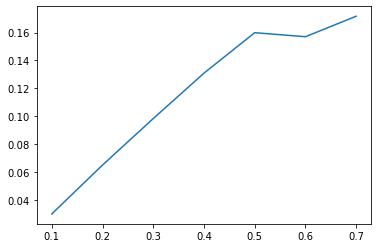

In [122]:
plt.plot([.1, .2, .3, .4, .5, .6, .7],
         [np.mean(getCoMStep(motion_fwd, footsteps_fwd, [0.1, 0, 0], False, "support")[1]), 
          np.mean(getCoMStep(motion_fwd, footsteps_fwd, [0.2, 0, 0], False, "support")[1]), 
          np.mean(getCoMStep(motion_fwd, footsteps_fwd, [0.3, 0, 0], False, "support")[1]),
          np.mean(getCoMStep(motion_fwd, footsteps_fwd, [0.4, 0, 0], False, "support")[1]),
          np.mean(getCoMStep(motion_fwd, footsteps_fwd, [0.5, 0, 0], False, "support")[1]),
          np.mean(getCoMStep(motion_fwd, footsteps_fwd, [0.6, 0, 0], False, "support")[1]),
          np.mean(getCoMStep(motion_fwd, footsteps_fwd, [0.7, 0, 0], False, "support")[1])])

#### FL/RR (y)

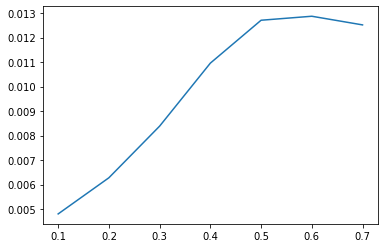

In [125]:
plt.plot([.1, .2, .3, .4, .5, .6, .7],
         [np.mean(np.abs(getCoMStep(motion_fwd, footsteps_fwd, [0.1, 0, 0], False, "support")[2])), 
          np.mean(np.abs(getCoMStep(motion_fwd, footsteps_fwd, [0.2, 0, 0], False, "support")[2])), 
          np.mean(np.abs(getCoMStep(motion_fwd, footsteps_fwd, [0.3, 0, 0], False, "support")[2])),
          np.mean(np.abs(getCoMStep(motion_fwd, footsteps_fwd, [0.4, 0, 0], False, "support")[2])),
          np.mean(np.abs(getCoMStep(motion_fwd, footsteps_fwd, [0.5, 0, 0], False, "support")[2])),
          np.mean(np.abs(getCoMStep(motion_fwd, footsteps_fwd, [0.6, 0, 0], False, "support")[2])),
          np.mean(np.abs(getCoMStep(motion_fwd, footsteps_fwd, [0.7, 0, 0], False, "support")[2]))])

#### FR/RL (x)

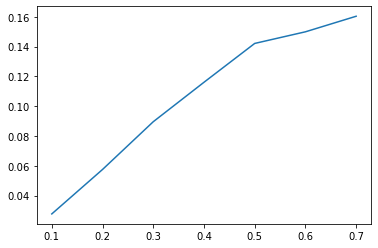

In [126]:
plt.plot([.1, .2, .3, .4, .5, .6, .7],
         [np.mean(getCoMStep(motion_fwd, footsteps_fwd, [0.1, 0, 0], True, "support")[1]), 
          np.mean(getCoMStep(motion_fwd, footsteps_fwd, [0.2, 0, 0], True, "support")[1]), 
          np.mean(getCoMStep(motion_fwd, footsteps_fwd, [0.3, 0, 0], True, "support")[1]),
          np.mean(getCoMStep(motion_fwd, footsteps_fwd, [0.4, 0, 0], True, "support")[1]),
          np.mean(getCoMStep(motion_fwd, footsteps_fwd, [0.5, 0, 0], True, "support")[1]),
          np.mean(getCoMStep(motion_fwd, footsteps_fwd, [0.6, 0, 0], True, "support")[1]),
          np.mean(getCoMStep(motion_fwd, footsteps_fwd, [0.7, 0, 0], True, "support")[1])])

#### FR/RL (y)

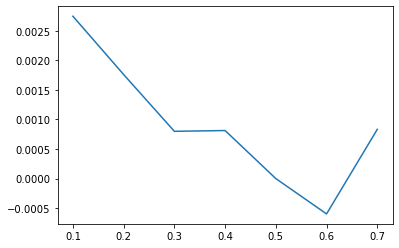

In [128]:
plt.plot([.1, .2, .3, .4, .5, .6, .7],
         [np.mean(getCoMStep(motion_fwd, footsteps_fwd, [0.1, 0, 0], True, "support")[2]), 
          np.mean(getCoMStep(motion_fwd, footsteps_fwd, [0.2, 0, 0], True, "support")[2]), 
          np.mean(getCoMStep(motion_fwd, footsteps_fwd, [0.3, 0, 0], True, "support")[2]),
          np.mean(getCoMStep(motion_fwd, footsteps_fwd, [0.4, 0, 0], True, "support")[2]),
          np.mean(getCoMStep(motion_fwd, footsteps_fwd, [0.5, 0, 0], True, "support")[2]),
          np.mean(getCoMStep(motion_fwd, footsteps_fwd, [0.6, 0, 0], True, "support")[2]),
          np.mean(getCoMStep(motion_fwd, footsteps_fwd, [0.7, 0, 0], True, "support")[2])])

## Step vs Velocity (Odom)

#### FL/RR (x)

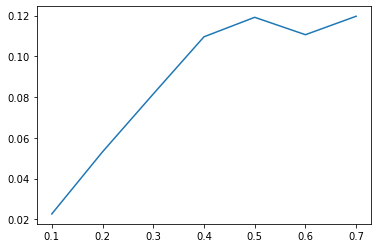

In [99]:
plt.plot([.1, .2, .3, .4, .5, .6, .7],
         [np.mean(com_x_fwd_fl_rr_01), 
          np.mean(com_x_fwd_fl_rr_02), 
          np.mean(com_x_fwd_fl_rr_03),
          np.mean(com_x_fwd_fl_rr_04),
          np.mean(com_x_fwd_fl_rr_05),
          np.mean(com_x_fwd_fl_rr_06),
          np.mean(com_x_fwd_fl_rr_07)])

#### FL/RR (y)

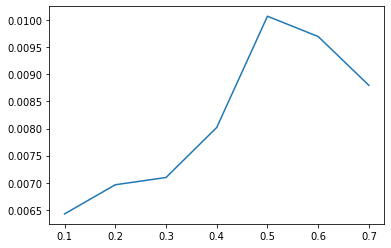

In [101]:
plt.plot([.1, .2, .3, .4, .5, .6, .7],
         [np.mean(com_y_fwd_fl_rr_01), 
          np.mean(com_y_fwd_fl_rr_02), 
          np.mean(com_y_fwd_fl_rr_03),
          np.mean(com_y_fwd_fl_rr_04),
          np.mean(com_y_fwd_fl_rr_05),
          np.mean(com_y_fwd_fl_rr_06),
          np.mean(com_y_fwd_fl_rr_07)])

#### FR/RL (x)

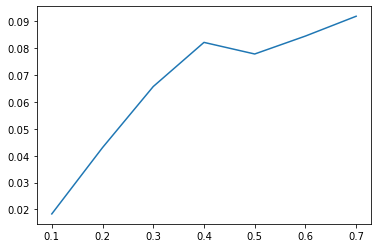

In [100]:
plt.plot([.1, .2, .3, .4, .5, .6, .7],
         [np.mean(com_x_fwd_fr_rl_01), 
          np.mean(com_x_fwd_fr_rl_02), 
          np.mean(com_x_fwd_fr_rl_03),
          np.mean(com_x_fwd_fr_rl_04),
          np.mean(com_x_fwd_fr_rl_05),
          np.mean(com_x_fwd_fr_rl_06),
          np.mean(com_x_fwd_fr_rl_07)])

#### FR/RL (y)

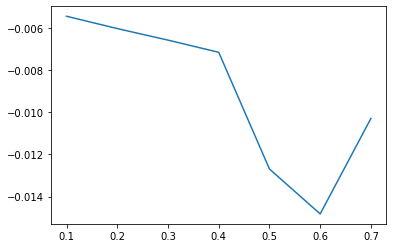

In [129]:
plt.plot([.1, .2, .3, .4, .5, .6, .7],
         [np.mean(com_y_fwd_fr_rl_01), 
          np.mean(com_y_fwd_fr_rl_02), 
          np.mean(com_y_fwd_fr_rl_03),
          np.mean(com_y_fwd_fr_rl_04),
          np.mean(com_y_fwd_fr_rl_05),
          np.mean(com_y_fwd_fr_rl_06),
          np.mean(com_y_fwd_fr_rl_07)])

### Footstep visualization

In [32]:
def visualize_static_foosteps(dataset, footsteps):
    old_xs = None
    old_ys = None
    old_zs = None
    
    # Visualize footsteps
    for idx, footstep in enumerate(footsteps):
        fig = plt.figure()
        ax = fig.add_subplot(projection='3d')

        #ax.set_xlim([-0.5, 0.5])
        #ax.set_ylim([-0.3, 0.3])
        ax.set_zlim([-0.5, 0.5])

        dataset[footstep, 7:19] = np.round(dataset[footstep, 7:19], 3)
        
        time_diff = dataset[footsteps[idx], 0] - dataset[footsteps[idx-1], 0]
            
        # 3D positions        
        xs = np.array([dataset[footstep, 7], dataset[footstep, 10], dataset[footstep, 13], dataset[footstep, 16]])
        ys = np.array([dataset[footstep, 8], dataset[footstep, 11], dataset[footstep, 14], dataset[footstep, 17]])
        zz = np.array([dataset[footstep, 9], dataset[footstep, 12], dataset[footstep, 15], dataset[footstep, 18]])

        ax.scatter(xs, ys, zs, marker='o')

        ax.set_xlabel('X Label')
        ax.set_ylabel('Y Label')
        ax.set_zlabel('Z Label')

        plt.show()

        #print(xs, ys, zs, dataset[footstep, 2:5], dataset[footstep, 25:28])
        if idx > 0 and idx < len(footsteps):
            print(f'Diff: {time_diff}. Command: {dataset[footstep, 1:7]}. Coord: {[xs[0], ys[0], zs[0]]}. Step size: {[xs[0]-old_xs[0], ys[0]-old_ys[0], zs[0]-old_zs[0]]}.')
        else:
            print(f'Command: {dataset[footstep, 1:7]}. Coord: {[xs[0], ys[0], zs[0]]}.')
            
        old_xs = xs
        old_ys = ys
        old_zs = zs

In [33]:
def update_points(num, dataset, footsteps, x, y, z, points):    
    # Starting footstep index
    footstep = footsteps[num]
    
    # Round footsteps position
    dataset[footstep, 7:19] = np.round(dataset[footstep, 7:19], 3)

    # Initial footsteps 3D positions
    new_x = np.array([dataset[footstep, 7], dataset[footstep, 10], dataset[footstep, 13], dataset[footstep, 16]])
    new_y = np.array([dataset[footstep, 8], dataset[footstep, 11], dataset[footstep, 14], dataset[footstep, 17]])
    new_z = np.array([dataset[footstep, 9], dataset[footstep, 12], dataset[footstep, 15], dataset[footstep, 18]])

    # update properties
    points.set_data(new_x, new_y)
    points.set_3d_properties(new_z, 'z')

    # return modified artists
    return points

def visualize_animated_footsteps(dataset, footsteps, style: str):
    # Create figure
    fig = plt.figure()
    ax = p3.Axes3D(fig)

    # Setting the axes properties
    ax.set_xlim3d([-0.4, 0.4])
    ax.set_xlabel('X')

    ax.set_ylim3d([-0.2, 0.2])
    ax.set_ylabel('Y')

    ax.set_zlim3d([-0.5, 0.5])
    ax.set_zlabel('Z')

    # Starting footstep index
    footstep = footsteps[0]

    # Round footsteps position
    dataset[footstep, 7:19] = np.round(dataset[footstep, 7:19], 3)

    # Initial footsteps 3D positions
    x = np.array([dataset[footstep, 7], dataset[footstep, 10], dataset[footstep, 13], dataset[footstep, 16]])
    y = np.array([dataset[footstep, 8], dataset[footstep, 11], dataset[footstep, 14], dataset[footstep, 17]])
    z = np.array([dataset[footstep, 9], dataset[footstep, 12], dataset[footstep, 15], dataset[footstep, 18]])

    txt = fig.suptitle('')
    points, = ax.plot(x, y, z, style)
    
    # blit=True re-draws only the parts that have changed.
    anim = animation.FuncAnimation(fig, update_points, frames=len(footsteps), fargs=(dataset, footsteps, x, y, z, points))
    
    return anim   

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.183, 0.171, FL (y): 0.136, 0.136.
FL displacement: -0.011999999999999983, 0.0.

FR (x): 0.183, 0.204, FR (y): -0.135, -0.136.
FR displacement: 0.02099999999999999, -0.0010000000000000009.

RL (x): -0.275, -0.268, RL (y): 0.135, 0.137.
RL displacement: 0.007000000000000006, 0.0020000000000000018.

RR (x): -0.275, -0.291, RR (y): -0.135, -0.135.
RR displacement: -0.01599999999999996, 0.0.


Base displacement (Foot): [0.011999999999999983, -0.0].

Base displacement (Odom): [[0.002550799614746177], [-0.00031482823682030313]]. Rotation displacement: -0.5591366576316817.



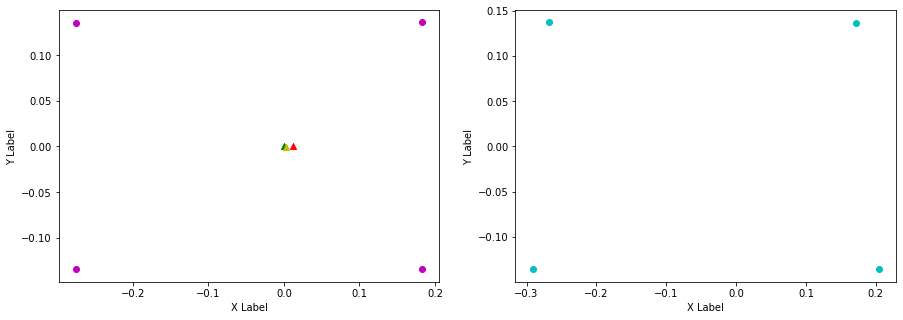

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.171, 0.198, FL (y): 0.136, 0.133.
FL displacement: 0.026999999999999996, -0.0030000000000000027.

FR (x): 0.204, 0.168, FR (y): -0.136, -0.135.
FR displacement: -0.035999999999999976, 0.0010000000000000009.

RL (x): -0.268, -0.308, RL (y): 0.137, 0.135.
RL displacement: -0.03999999999999998, -0.0020000000000000018.

RR (x): -0.291, -0.274, RR (y): -0.135, -0.137.
RR displacement: 0.01699999999999996, -0.0020000000000000018.


Base displacement (Foot): [0.035999999999999976, -0.0010000000000000009].

Base displacement (Odom): [[0.03591909866213355], [0.00799874535001905]]. Rotation displacement: 0.4353182403902781.



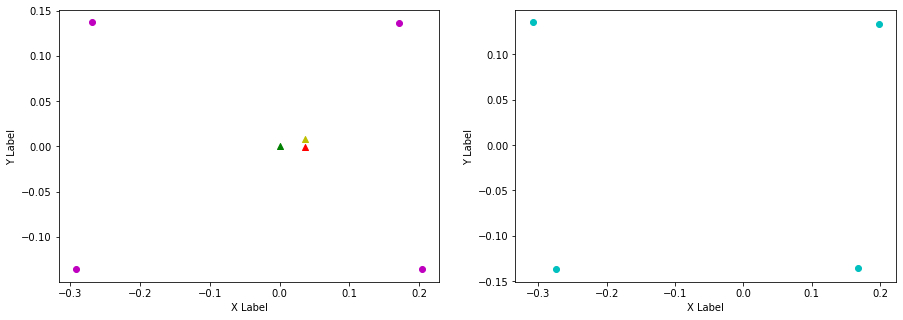

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.198, 0.172, FL (y): 0.133, 0.137.
FL displacement: -0.026000000000000023, 0.0040000000000000036.

FR (x): 0.168, 0.202, FR (y): -0.135, -0.133.
FR displacement: 0.034, 0.0020000000000000018.

RL (x): -0.308, -0.272, RL (y): 0.135, 0.138.
RL displacement: 0.035999999999999976, 0.0030000000000000027.

RR (x): -0.274, -0.294, RR (y): -0.137, -0.137.
RR displacement: -0.019999999999999962, 0.0.


Base displacement (Foot): [0.026000000000000023, -0.0040000000000000036].

Base displacement (Odom): [[0.01579565748464302], [-0.0058329414779290135]]. Rotation displacement: 0.23304289515261567.



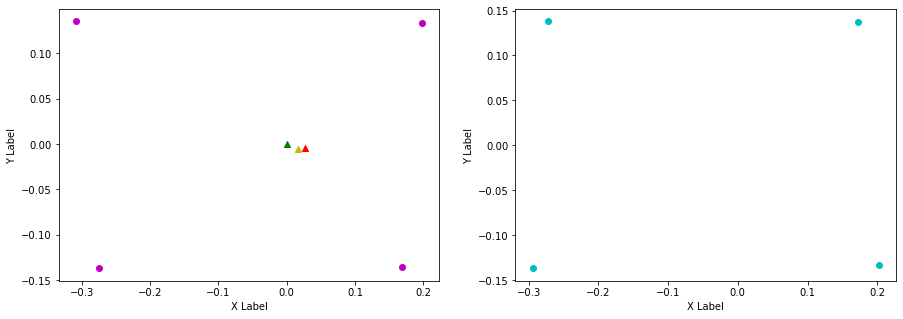

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.172, 0.203, FL (y): 0.137, 0.132.
FL displacement: 0.031000000000000028, -0.0050000000000000044.

FR (x): 0.202, 0.179, FR (y): -0.133, -0.138.
FR displacement: -0.02300000000000002, -0.0050000000000000044.

RL (x): -0.272, -0.292, RL (y): 0.138, 0.137.
RL displacement: -0.019999999999999962, -0.0010000000000000009.

RR (x): -0.294, -0.271, RR (y): -0.137, -0.137.
RR displacement: 0.022999999999999965, 0.0.


Base displacement (Foot): [0.02300000000000002, 0.0050000000000000044].

Base displacement (Odom): [[0.03025486846900486], [0.009403665540985965]]. Rotation displacement: -0.7321483670836524.



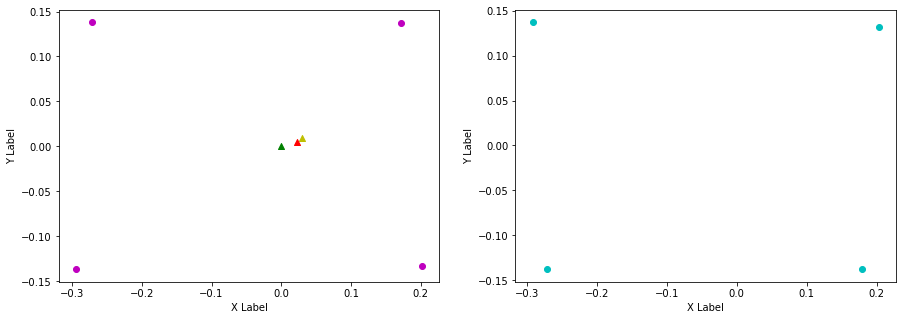

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.203, 0.175, FL (y): 0.132, 0.139.
FL displacement: -0.028000000000000025, 0.007000000000000006.

FR (x): 0.179, 0.205, FR (y): -0.138, -0.134.
FR displacement: 0.025999999999999995, 0.0040000000000000036.

RL (x): -0.292, -0.27, RL (y): 0.137, 0.137.
RL displacement: 0.021999999999999964, 0.0.

RR (x): -0.271, -0.294, RR (y): -0.137, -0.138.
RR displacement: -0.022999999999999965, -0.0010000000000000009.


Base displacement (Foot): [0.028000000000000025, -0.007000000000000006].

Base displacement (Odom): [[0.020772537488115587], [-0.006275286734002573]]. Rotation displacement: 1.1887861048278165.



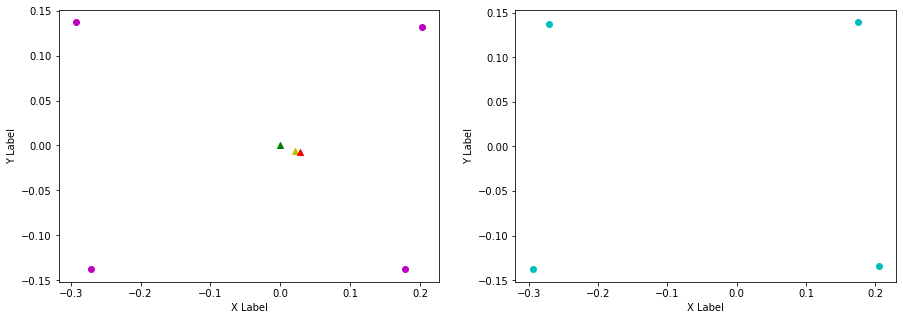

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.175, 0.202, FL (y): 0.139, 0.132.
FL displacement: 0.027000000000000024, -0.007000000000000006.

FR (x): 0.205, 0.176, FR (y): -0.134, -0.137.
FR displacement: -0.028999999999999998, -0.0030000000000000027.

RL (x): -0.27, -0.298, RL (y): 0.137, 0.137.
RL displacement: -0.02799999999999997, 0.0.

RR (x): -0.294, -0.272, RR (y): -0.138, -0.138.
RR displacement: 0.021999999999999964, 0.0.


Base displacement (Foot): [0.028999999999999998, 0.0030000000000000027].

Base displacement (Odom): [[0.031629768912567635], [0.010248601899326458]]. Rotation displacement: -1.3772385579967021.



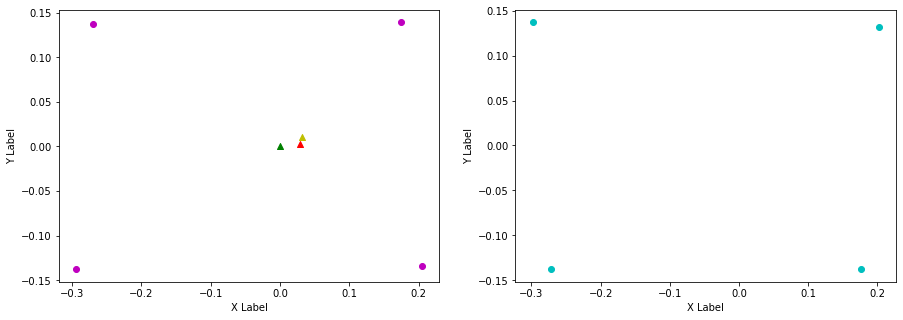

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.202, 0.17, FL (y): 0.132, 0.137.
FL displacement: -0.032, 0.0050000000000000044.

FR (x): 0.176, 0.201, FR (y): -0.137, -0.134.
FR displacement: 0.025000000000000022, 0.0030000000000000027.

RL (x): -0.298, -0.273, RL (y): 0.137, 0.138.
RL displacement: 0.024999999999999967, 0.0010000000000000009.

RR (x): -0.272, -0.299, RR (y): -0.138, -0.136.
RR displacement: -0.02699999999999997, 0.0020000000000000018.


Base displacement (Foot): [0.032, -0.0050000000000000044].

Base displacement (Odom): [[0.011567588133084283], [-0.0036119604010087097]]. Rotation displacement: 0.8171594334181156.



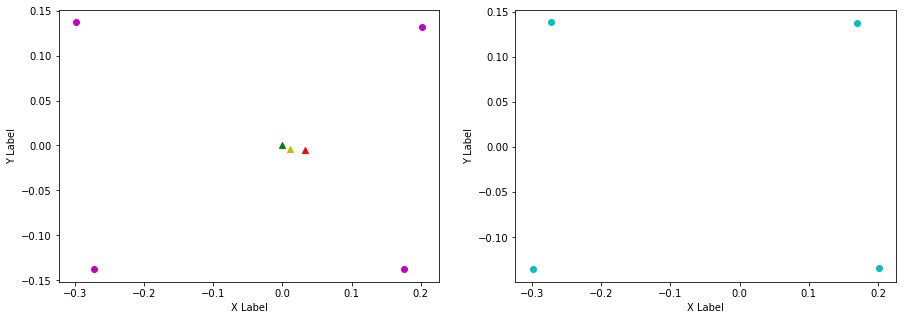

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.17, 0.203, FL (y): 0.137, 0.132.
FL displacement: 0.033, -0.0050000000000000044.

FR (x): 0.201, 0.18, FR (y): -0.134, -0.139.
FR displacement: -0.02100000000000002, -0.0050000000000000044.

RL (x): -0.273, -0.291, RL (y): 0.138, 0.138.
RL displacement: -0.01799999999999996, 0.0.

RR (x): -0.299, -0.271, RR (y): -0.136, -0.135.
RR displacement: 0.02799999999999997, 0.0010000000000000009.


Base displacement (Foot): [0.02100000000000002, 0.0050000000000000044].

Base displacement (Odom): [[0.03033451679467221], [0.011170696390081586]]. Rotation displacement: -0.9183032865449622.



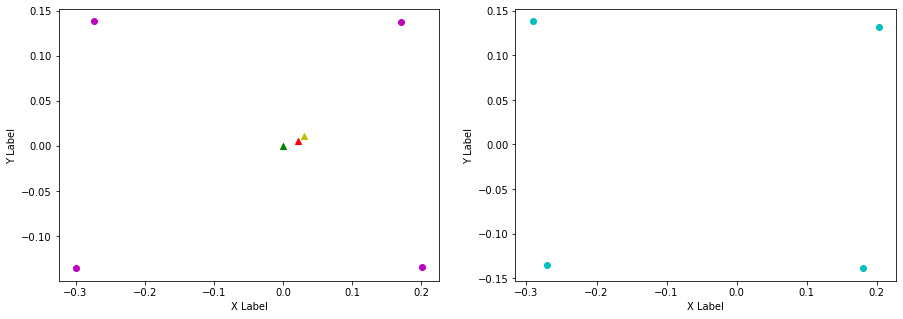

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.203, 0.167, FL (y): 0.132, 0.136.
FL displacement: -0.036000000000000004, 0.0040000000000000036.

FR (x): 0.18, 0.2, FR (y): -0.139, -0.135.
FR displacement: 0.020000000000000018, 0.0040000000000000036.

RL (x): -0.291, -0.274, RL (y): 0.138, 0.139.
RL displacement: 0.01699999999999996, 0.0010000000000000009.

RR (x): -0.271, -0.305, RR (y): -0.135, -0.135.
RR displacement: -0.033999999999999975, 0.0.


Base displacement (Foot): [0.036000000000000004, -0.0040000000000000036].

Base displacement (Odom): [[0.020713441769096008], [-0.005173889033744498]]. Rotation displacement: 1.0702756769340511.



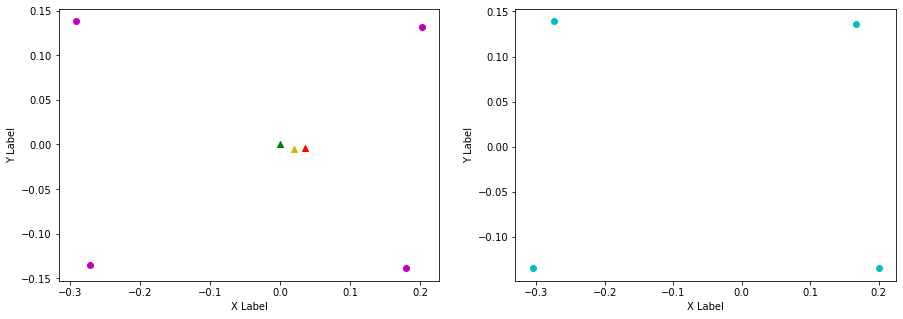

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.167, 0.203, FL (y): 0.136, 0.132.
FL displacement: 0.036000000000000004, -0.0040000000000000036.

FR (x): 0.2, 0.179, FR (y): -0.135, -0.138.
FR displacement: -0.02100000000000002, -0.0030000000000000027.

RL (x): -0.274, -0.293, RL (y): 0.139, 0.137.
RL displacement: -0.01899999999999996, -0.0020000000000000018.

RR (x): -0.305, -0.271, RR (y): -0.135, -0.137.
RR displacement: 0.033999999999999975, -0.0020000000000000018.


Base displacement (Foot): [0.02100000000000002, 0.0030000000000000027].

Base displacement (Odom): [[0.026423295401501595], [0.008820197456926106]]. Rotation displacement: -0.9518129141427499.



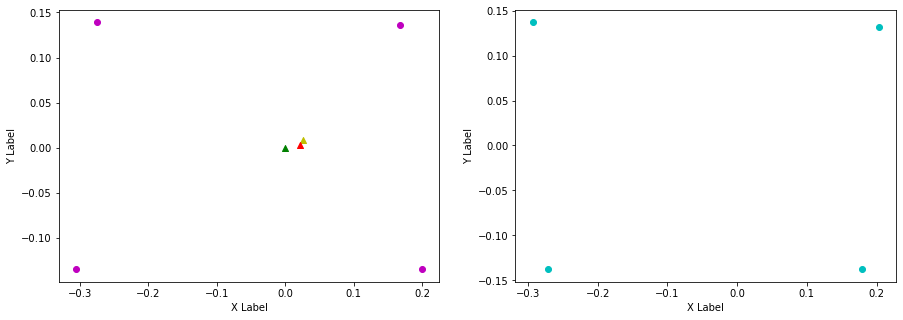

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.203, 0.178, FL (y): 0.132, 0.141.
FL displacement: -0.025000000000000022, 0.00899999999999998.

FR (x): 0.179, 0.208, FR (y): -0.138, -0.133.
FR displacement: 0.028999999999999998, 0.0050000000000000044.

RL (x): -0.293, -0.268, RL (y): 0.137, 0.136.
RL displacement: 0.024999999999999967, -0.0010000000000000009.

RR (x): -0.271, -0.29, RR (y): -0.137, -0.14.
RR displacement: -0.01899999999999996, -0.0030000000000000027.


Base displacement (Foot): [0.025000000000000022, -0.00899999999999998].

Base displacement (Odom): [[0.012504786066500045], [-0.004493768652959546]]. Rotation displacement: 0.3434627917776911.



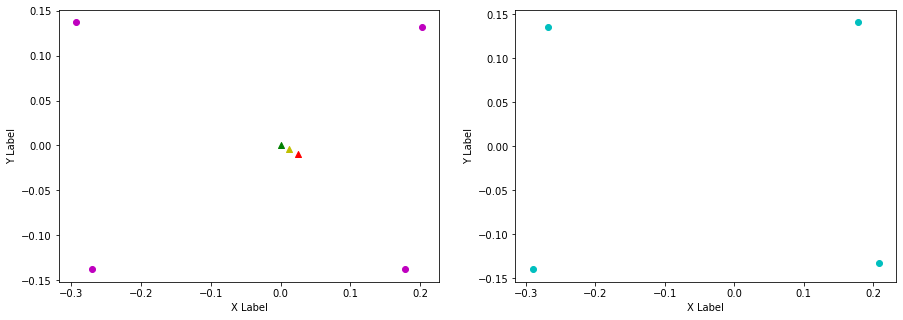

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.178, 0.203, FL (y): 0.141, 0.132.
FL displacement: 0.025000000000000022, -0.00899999999999998.

FR (x): 0.208, 0.179, FR (y): -0.133, -0.138.
FR displacement: -0.028999999999999998, -0.0050000000000000044.

RL (x): -0.268, -0.292, RL (y): 0.136, 0.138.
RL displacement: -0.023999999999999966, 0.0020000000000000018.

RR (x): -0.29, -0.271, RR (y): -0.14, -0.136.
RR displacement: 0.01899999999999996, 0.0040000000000000036.


Base displacement (Foot): [0.028999999999999998, 0.0050000000000000044].

Base displacement (Odom): [[0.027756148145439113], [0.005829783511133856]]. Rotation displacement: -1.140409987250737.



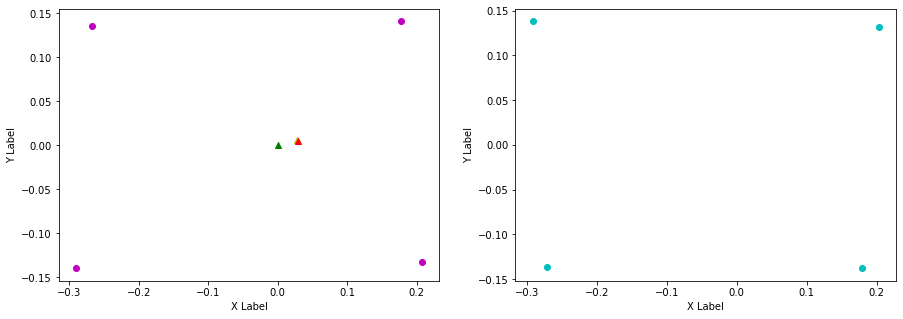

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.203, 0.171, FL (y): 0.132, 0.137.
FL displacement: -0.032, 0.0050000000000000044.

FR (x): 0.179, 0.202, FR (y): -0.138, -0.134.
FR displacement: 0.02300000000000002, 0.0040000000000000036.

RL (x): -0.292, -0.272, RL (y): 0.138, 0.139.
RL displacement: 0.019999999999999962, 0.0010000000000000009.

RR (x): -0.271, -0.297, RR (y): -0.136, -0.137.
RR displacement: -0.025999999999999968, -0.0010000000000000009.


Base displacement (Foot): [0.032, -0.0050000000000000044].

Base displacement (Odom): [[0.011460648060961726], [-0.003798379690701313]]. Rotation displacement: 0.8886521857209986.



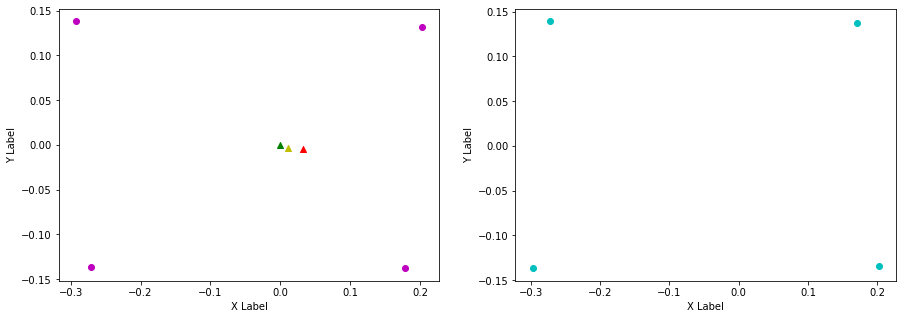

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.171, 0.2, FL (y): 0.137, 0.133.
FL displacement: 0.028999999999999998, -0.0040000000000000036.

FR (x): 0.202, 0.168, FR (y): -0.134, -0.136.
FR displacement: -0.034, -0.0020000000000000018.

RL (x): -0.272, -0.305, RL (y): 0.139, 0.135.
RL displacement: -0.032999999999999974, -0.0040000000000000036.

RR (x): -0.297, -0.273, RR (y): -0.137, -0.137.
RR displacement: 0.023999999999999966, 0.0.


Base displacement (Foot): [0.034, 0.0020000000000000018].

Base displacement (Odom): [[0.024487177399316468], [0.006683066491653691]]. Rotation displacement: -0.9175046728492122.



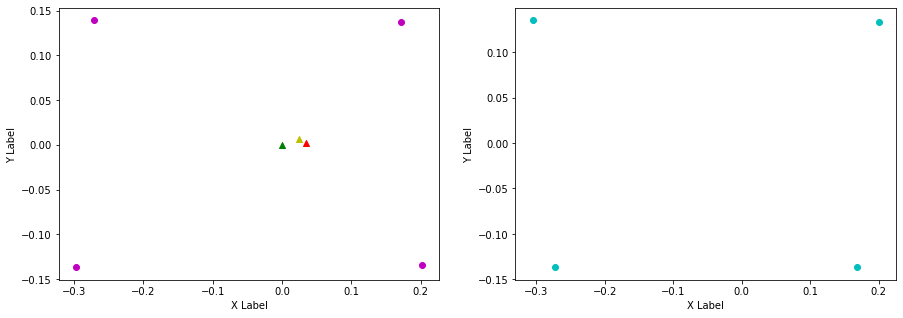

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.2, 0.169, FL (y): 0.133, 0.136.
FL displacement: -0.031, 0.0030000000000000027.

FR (x): 0.168, 0.201, FR (y): -0.136, -0.135.
FR displacement: 0.033, 0.0010000000000000009.

RL (x): -0.305, -0.273, RL (y): 0.135, 0.139.
RL displacement: 0.03199999999999997, 0.0040000000000000036.

RR (x): -0.273, -0.302, RR (y): -0.137, -0.136.
RR displacement: -0.02899999999999997, 0.0010000000000000009.


Base displacement (Foot): [0.031, -0.0030000000000000027].

Base displacement (Odom): [[0.016816896590462177], [-0.005364965849603203]]. Rotation displacement: 0.3728043347811849.



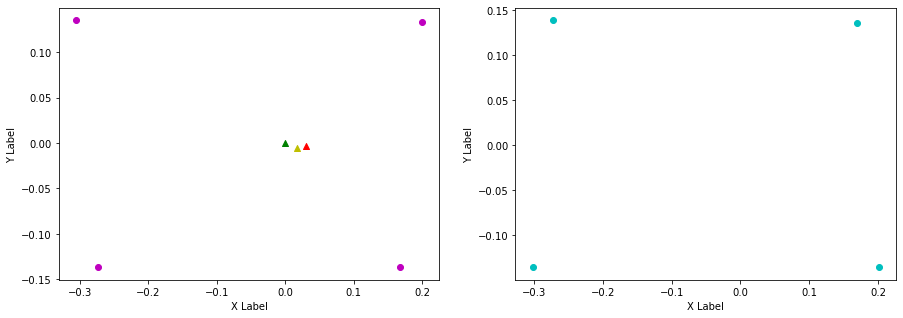

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.169, 0.2, FL (y): 0.136, 0.133.
FL displacement: 0.031, -0.0030000000000000027.

FR (x): 0.201, 0.169, FR (y): -0.135, -0.136.
FR displacement: -0.032, -0.0010000000000000009.

RL (x): -0.273, -0.304, RL (y): 0.139, 0.136.
RL displacement: -0.030999999999999972, -0.0030000000000000027.

RR (x): -0.302, -0.274, RR (y): -0.136, -0.138.
RR displacement: 0.02799999999999997, -0.0020000000000000018.


Base displacement (Foot): [0.032, 0.0010000000000000009].

Base displacement (Odom): [[0.023219456500691016], [0.004372069901902909]]. Rotation displacement: -0.5065469748462235.



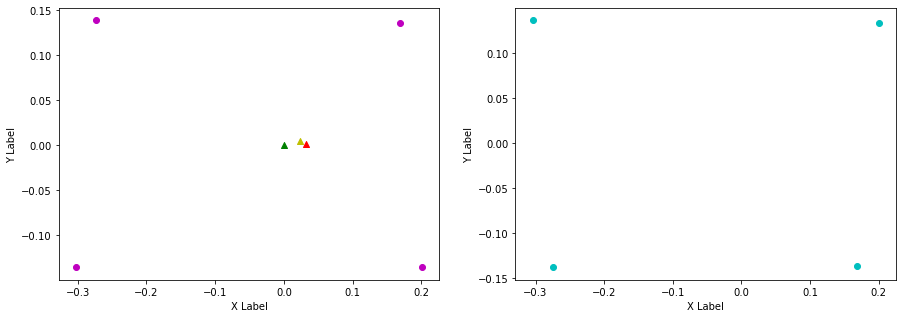

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.2, 0.174, FL (y): 0.133, 0.138.
FL displacement: -0.026000000000000023, 0.0050000000000000044.

FR (x): 0.169, 0.203, FR (y): -0.136, -0.133.
FR displacement: 0.034, 0.0030000000000000027.

RL (x): -0.304, -0.271, RL (y): 0.136, 0.138.
RL displacement: 0.032999999999999974, 0.0020000000000000018.

RR (x): -0.274, -0.294, RR (y): -0.138, -0.137.
RR displacement: -0.019999999999999962, 0.0010000000000000009.


Base displacement (Foot): [0.026000000000000023, -0.0050000000000000044].

Base displacement (Odom): [[0.016076824585878446], [-0.004100064789049524]]. Rotation displacement: 0.37771301324850665.



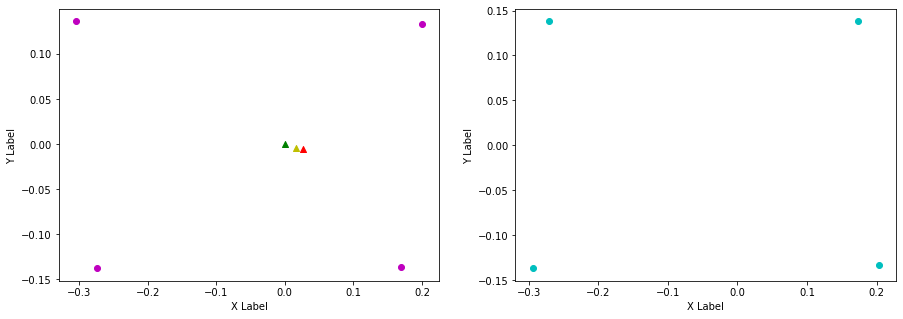

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.174, 0.202, FL (y): 0.138, 0.132.
FL displacement: 0.028000000000000025, -0.006000000000000005.

FR (x): 0.203, 0.177, FR (y): -0.133, -0.137.
FR displacement: -0.026000000000000023, -0.0040000000000000036.

RL (x): -0.271, -0.295, RL (y): 0.138, 0.137.
RL displacement: -0.023999999999999966, -0.0010000000000000009.

RR (x): -0.294, -0.272, RR (y): -0.137, -0.137.
RR displacement: 0.021999999999999964, 0.0.


Base displacement (Foot): [0.026000000000000023, 0.0040000000000000036].

Base displacement (Odom): [[0.022605125908001678], [0.004656750457882067]]. Rotation displacement: -1.0041012501729165.



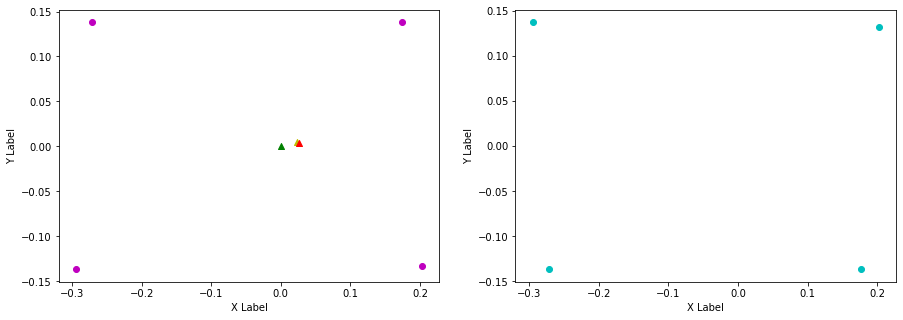

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.202, 0.172, FL (y): 0.132, 0.137.
FL displacement: -0.030000000000000027, 0.0050000000000000044.

FR (x): 0.177, 0.202, FR (y): -0.137, -0.134.
FR displacement: 0.025000000000000022, 0.0030000000000000027.

RL (x): -0.295, -0.272, RL (y): 0.137, 0.138.
RL displacement: 0.022999999999999965, 0.0010000000000000009.

RR (x): -0.272, -0.295, RR (y): -0.137, -0.137.
RR displacement: -0.022999999999999965, 0.0.


Base displacement (Foot): [0.030000000000000027, -0.0050000000000000044].

Base displacement (Odom): [[0.01871011188479299], [-0.005080241836800673]]. Rotation displacement: 0.8207198905276045.



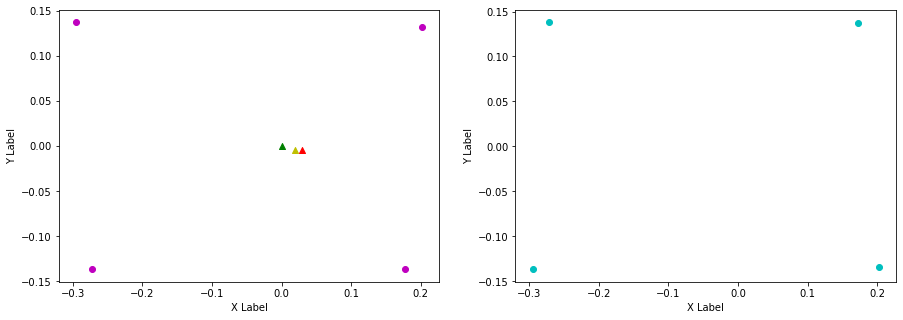

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.172, 0.199, FL (y): 0.137, 0.133.
FL displacement: 0.027000000000000024, -0.0040000000000000036.

FR (x): 0.202, 0.167, FR (y): -0.134, -0.136.
FR displacement: -0.035, -0.0020000000000000018.

RL (x): -0.272, -0.306, RL (y): 0.138, 0.135.
RL displacement: -0.033999999999999975, -0.0030000000000000027.

RR (x): -0.295, -0.274, RR (y): -0.137, -0.137.
RR displacement: 0.020999999999999963, 0.0.


Base displacement (Foot): [0.035, 0.0020000000000000018].

Base displacement (Odom): [[0.02389355569250884], [0.011193032380019785]]. Rotation displacement: -0.9903043006684191.



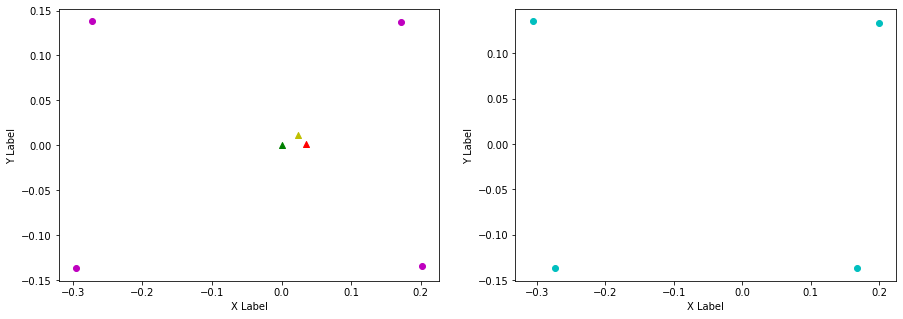

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.199, 0.173, FL (y): 0.133, 0.138.
FL displacement: -0.026000000000000023, 0.0050000000000000044.

FR (x): 0.167, 0.203, FR (y): -0.136, -0.134.
FR displacement: 0.036000000000000004, 0.0020000000000000018.

RL (x): -0.306, -0.271, RL (y): 0.135, 0.138.
RL displacement: 0.034999999999999976, 0.0030000000000000027.

RR (x): -0.274, -0.295, RR (y): -0.137, -0.137.
RR displacement: -0.020999999999999963, 0.0.


Base displacement (Foot): [0.026000000000000023, -0.0050000000000000044].

Base displacement (Odom): [[0.016501073622711637], [-0.0035008139442386232]]. Rotation displacement: 0.2129407686771077.



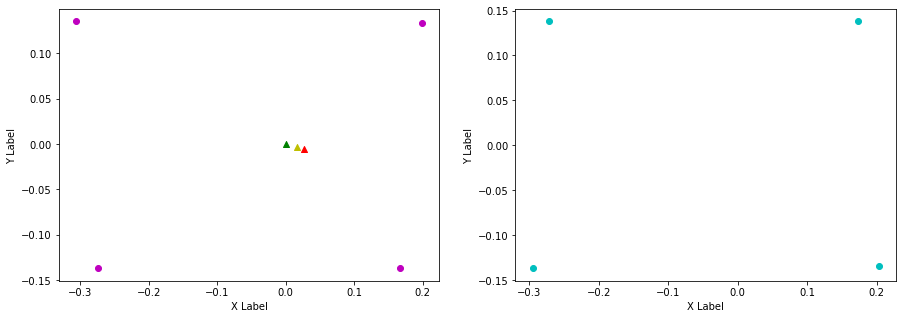

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.173, 0.203, FL (y): 0.138, 0.132.
FL displacement: 0.030000000000000027, -0.006000000000000005.

FR (x): 0.203, 0.179, FR (y): -0.134, -0.137.
FR displacement: -0.02400000000000002, -0.0030000000000000027.

RL (x): -0.271, -0.293, RL (y): 0.138, 0.137.
RL displacement: -0.021999999999999964, -0.0010000000000000009.

RR (x): -0.295, -0.271, RR (y): -0.137, -0.137.
RR displacement: 0.023999999999999966, 0.0.


Base displacement (Foot): [0.02400000000000002, 0.0030000000000000027].

Base displacement (Odom): [[0.025440709837699083], [0.0051169056588157985]]. Rotation displacement: -0.4078487989052483.



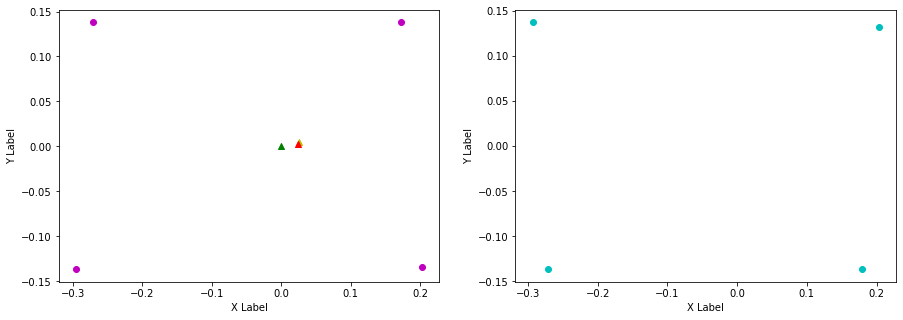

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.203, 0.17, FL (y): 0.132, 0.136.
FL displacement: -0.033, 0.0040000000000000036.

FR (x): 0.179, 0.201, FR (y): -0.137, -0.134.
FR displacement: 0.02200000000000002, 0.0030000000000000027.

RL (x): -0.293, -0.273, RL (y): 0.137, 0.138.
RL displacement: 0.019999999999999962, 0.0010000000000000009.

RR (x): -0.271, -0.299, RR (y): -0.137, -0.136.
RR displacement: -0.02799999999999997, 0.0010000000000000009.


Base displacement (Foot): [0.033, -0.0040000000000000036].

Base displacement (Odom): [[0.03246264823050221], [-0.008539829243970981]]. Rotation displacement: 0.6577241094536157.



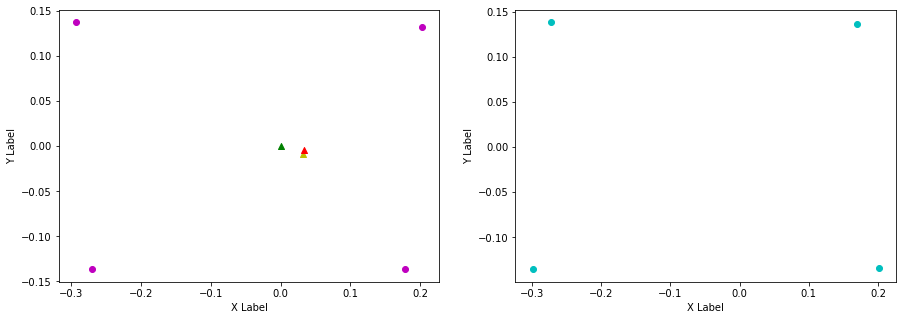

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.17, 0.204, FL (y): 0.136, 0.132.
FL displacement: 0.033999999999999975, -0.0040000000000000036.

FR (x): 0.201, 0.18, FR (y): -0.134, -0.139.
FR displacement: -0.02100000000000002, -0.0050000000000000044.

RL (x): -0.273, -0.292, RL (y): 0.138, 0.138.
RL displacement: -0.01899999999999996, 0.0.

RR (x): -0.299, -0.271, RR (y): -0.136, -0.136.
RR displacement: 0.02799999999999997, 0.0.


Base displacement (Foot): [0.02100000000000002, 0.0050000000000000044].

Base displacement (Odom): [[0.02998991059600936], [0.011132751640880824]]. Rotation displacement: -0.1995102600522591.



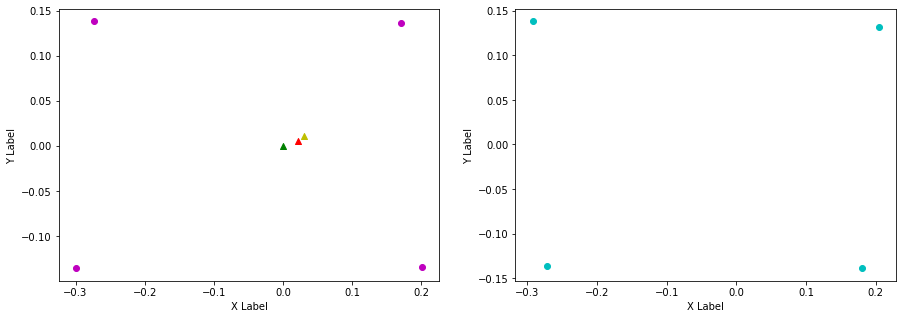

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.204, 0.175, FL (y): 0.132, 0.139.
FL displacement: -0.028999999999999998, 0.007000000000000006.

FR (x): 0.18, 0.204, FR (y): -0.139, -0.134.
FR displacement: 0.023999999999999994, 0.0050000000000000044.

RL (x): -0.292, -0.27, RL (y): 0.138, 0.137.
RL displacement: 0.021999999999999964, -0.0010000000000000009.

RR (x): -0.271, -0.293, RR (y): -0.136, -0.138.
RR displacement: -0.021999999999999964, -0.0020000000000000018.


Base displacement (Foot): [0.028999999999999998, -0.007000000000000006].

Base displacement (Odom): [[0.016447335111943406], [-0.004406599607098015]]. Rotation displacement: 0.3204789220846376.



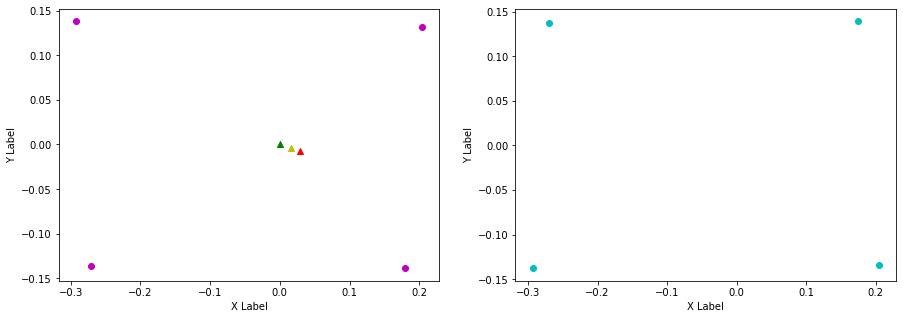

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.175, 0.205, FL (y): 0.139, 0.132.
FL displacement: 0.03, -0.007000000000000006.

FR (x): 0.204, 0.18, FR (y): -0.134, -0.14.
FR displacement: -0.023999999999999994, -0.006000000000000005.

RL (x): -0.27, -0.29, RL (y): 0.137, 0.139.
RL displacement: -0.019999999999999962, 0.0020000000000000018.

RR (x): -0.293, -0.27, RR (y): -0.138, -0.136.
RR displacement: 0.022999999999999965, 0.0020000000000000018.


Base displacement (Foot): [0.023999999999999994, 0.006000000000000005].

Base displacement (Odom): [[0.0271600512471194], [0.006663251336789425]]. Rotation displacement: -1.2011456312534512.



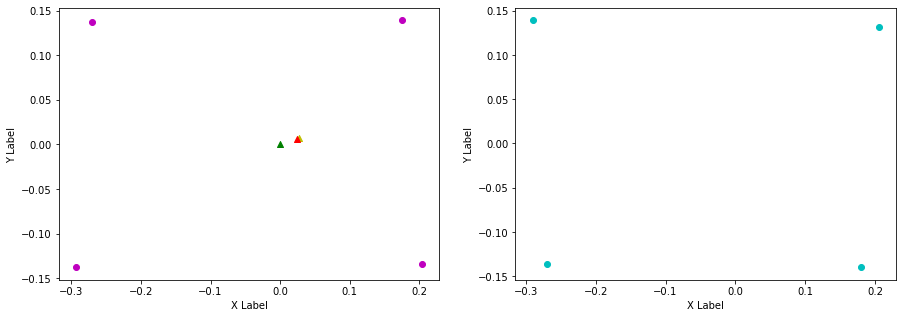

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.205, 0.175, FL (y): 0.132, 0.139.
FL displacement: -0.03, 0.007000000000000006.

FR (x): 0.18, 0.205, FR (y): -0.14, -0.134.
FR displacement: 0.024999999999999994, 0.006000000000000005.

RL (x): -0.29, -0.27, RL (y): 0.139, 0.138.
RL displacement: 0.019999999999999962, -0.0010000000000000009.

RR (x): -0.27, -0.294, RR (y): -0.136, -0.138.
RR displacement: -0.023999999999999966, -0.0020000000000000018.


Base displacement (Foot): [0.03, -0.007000000000000006].

Base displacement (Odom): [[0.02432669452322589], [-0.0076688965645053675]]. Rotation displacement: 0.8655886093455717.



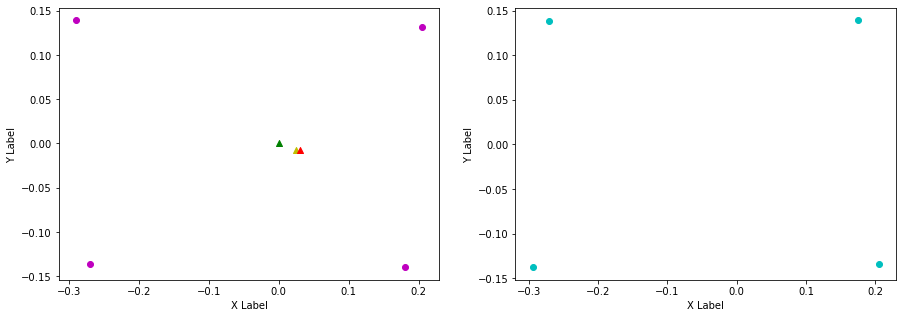

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.175, 0.204, FL (y): 0.139, 0.132.
FL displacement: 0.028999999999999998, -0.007000000000000006.

FR (x): 0.205, 0.179, FR (y): -0.134, -0.139.
FR displacement: -0.025999999999999995, -0.0050000000000000044.

RL (x): -0.27, -0.291, RL (y): 0.138, 0.139.
RL displacement: -0.020999999999999963, 0.0010000000000000009.

RR (x): -0.294, -0.27, RR (y): -0.138, -0.136.
RR displacement: 0.023999999999999966, 0.0020000000000000018.


Base displacement (Foot): [0.025999999999999995, 0.0050000000000000044].

Base displacement (Odom): [[0.015055126046571998], [0.005622470948066144]]. Rotation displacement: -1.1750719468872484.



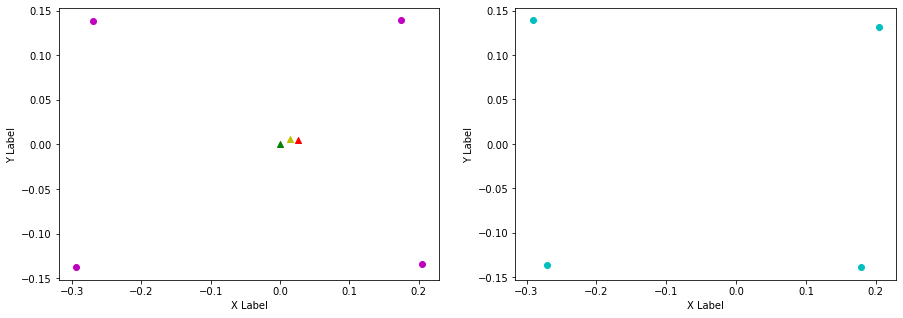

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.204, 0.176, FL (y): 0.132, 0.139.
FL displacement: -0.027999999999999997, 0.007000000000000006.

FR (x): 0.179, 0.206, FR (y): -0.139, -0.134.
FR displacement: 0.026999999999999996, 0.0050000000000000044.

RL (x): -0.291, -0.269, RL (y): 0.139, 0.137.
RL displacement: 0.021999999999999964, -0.0020000000000000018.

RR (x): -0.27, -0.293, RR (y): -0.136, -0.139.
RR displacement: -0.022999999999999965, -0.0030000000000000027.


Base displacement (Foot): [0.027999999999999997, -0.007000000000000006].

Base displacement (Odom): [[0.03317959445243579], [-0.009371775786579134]]. Rotation displacement: 1.0186466768312794.



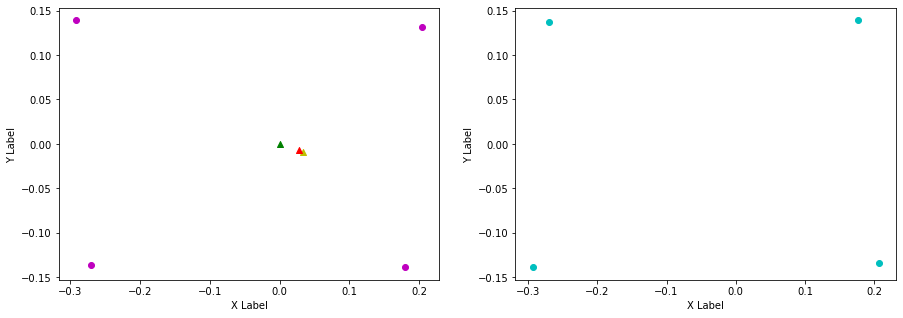

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.176, 0.203, FL (y): 0.139, 0.132.
FL displacement: 0.027000000000000024, -0.007000000000000006.

FR (x): 0.206, 0.18, FR (y): -0.134, -0.138.
FR displacement: -0.025999999999999995, -0.0040000000000000036.

RL (x): -0.269, -0.292, RL (y): 0.137, 0.138.
RL displacement: -0.022999999999999965, 0.0010000000000000009.

RR (x): -0.293, -0.271, RR (y): -0.139, -0.136.
RR displacement: 0.021999999999999964, 0.0030000000000000027.


Base displacement (Foot): [0.025999999999999995, 0.0040000000000000036].

Base displacement (Odom): [[0.02673694490983225], [0.005896399130271873]]. Rotation displacement: -1.1679794607538647.



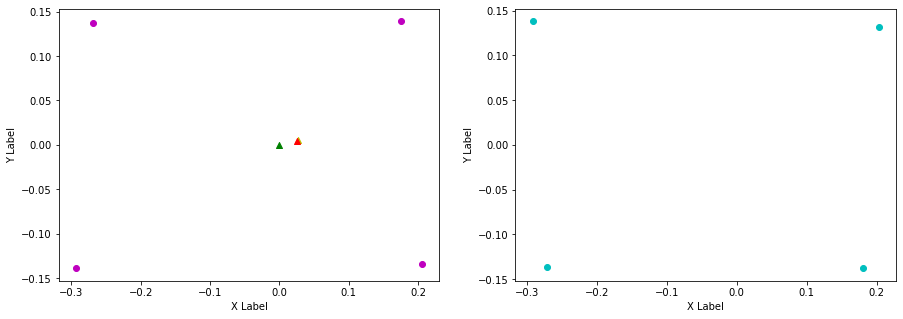

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.203, 0.173, FL (y): 0.132, 0.138.
FL displacement: -0.030000000000000027, 0.006000000000000005.

FR (x): 0.18, 0.203, FR (y): -0.138, -0.134.
FR displacement: 0.02300000000000002, 0.0040000000000000036.

RL (x): -0.292, -0.271, RL (y): 0.138, 0.138.
RL displacement: 0.020999999999999963, 0.0.

RR (x): -0.271, -0.295, RR (y): -0.136, -0.137.
RR displacement: -0.023999999999999966, -0.0010000000000000009.


Base displacement (Foot): [0.030000000000000027, -0.006000000000000005].

Base displacement (Odom): [[0.02755904717020563], [-0.008930939817979558]]. Rotation displacement: 0.9498630464809195.



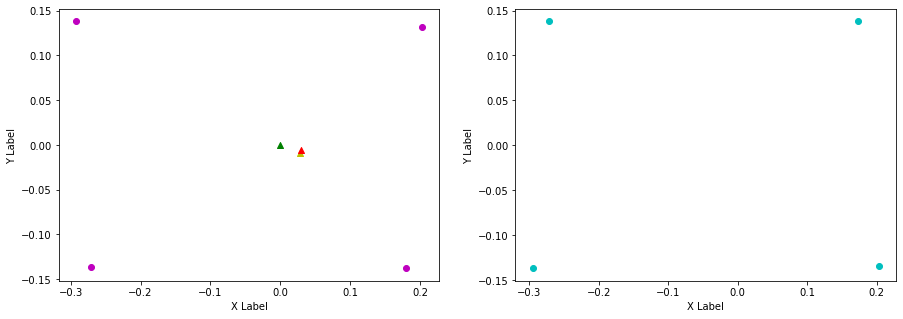

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.173, 0.203, FL (y): 0.138, 0.132.
FL displacement: 0.030000000000000027, -0.006000000000000005.

FR (x): 0.203, 0.179, FR (y): -0.134, -0.137.
FR displacement: -0.02400000000000002, -0.0030000000000000027.

RL (x): -0.271, -0.293, RL (y): 0.138, 0.137.
RL displacement: -0.021999999999999964, -0.0010000000000000009.

RR (x): -0.295, -0.271, RR (y): -0.137, -0.137.
RR displacement: 0.023999999999999966, 0.0.


Base displacement (Foot): [0.02400000000000002, 0.0030000000000000027].

Base displacement (Odom): [[0.01999795650666525], [0.00731139014053845]]. Rotation displacement: -1.3363956393151457.



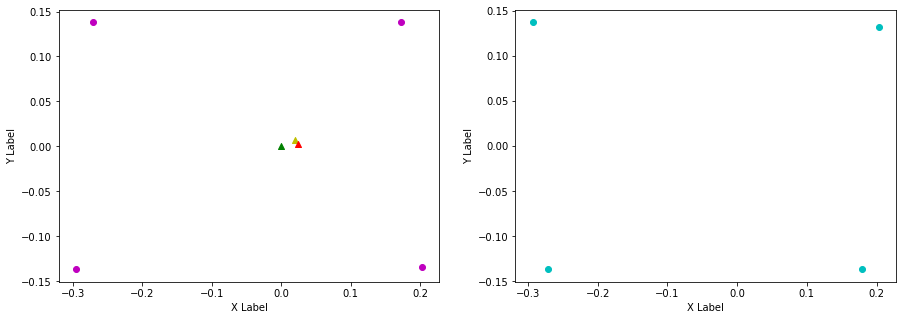

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.203, 0.169, FL (y): 0.132, 0.137.
FL displacement: -0.034, 0.0050000000000000044.

FR (x): 0.179, 0.201, FR (y): -0.137, -0.135.
FR displacement: 0.02200000000000002, 0.0020000000000000018.

RL (x): -0.293, -0.273, RL (y): 0.137, 0.139.
RL displacement: 0.019999999999999962, 0.0020000000000000018.

RR (x): -0.271, -0.302, RR (y): -0.137, -0.136.
RR displacement: -0.030999999999999972, 0.0010000000000000009.


Base displacement (Foot): [0.034, -0.0050000000000000044].

Base displacement (Odom): [[0.02968824497305045], [-0.008066579174137424]]. Rotation displacement: 0.4432339999389265.



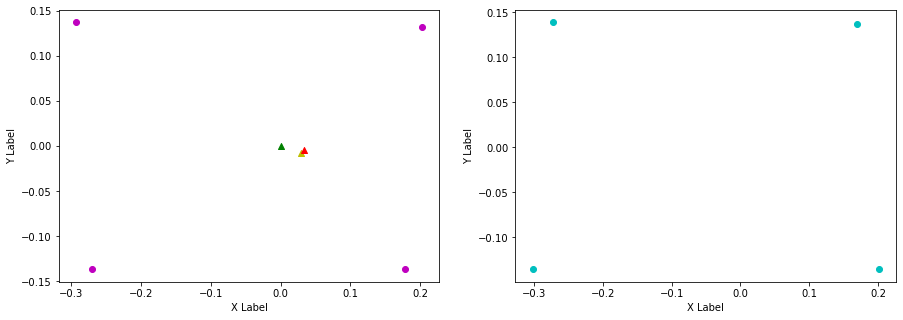

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.169, 0.199, FL (y): 0.137, 0.134.
FL displacement: 0.03, -0.0030000000000000027.

FR (x): 0.201, 0.167, FR (y): -0.135, -0.136.
FR displacement: -0.034, -0.0010000000000000009.

RL (x): -0.273, -0.308, RL (y): 0.139, 0.135.
RL displacement: -0.034999999999999976, -0.0040000000000000036.

RR (x): -0.302, -0.274, RR (y): -0.136, -0.137.
RR displacement: 0.02799999999999997, -0.0010000000000000009.


Base displacement (Foot): [0.034, 0.0010000000000000009].

Base displacement (Odom): [[0.031782991488051415], [0.00804156596038308]]. Rotation displacement: -0.30100364489922726.



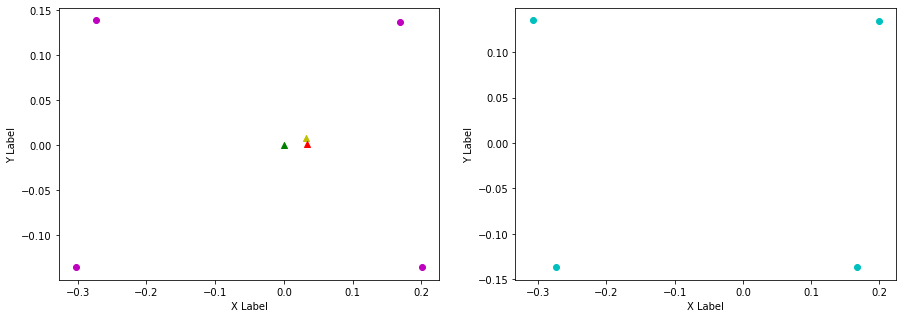

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.199, 0.174, FL (y): 0.134, 0.138.
FL displacement: -0.025000000000000022, 0.0040000000000000036.

FR (x): 0.167, 0.204, FR (y): -0.136, -0.134.
FR displacement: 0.03699999999999998, 0.0020000000000000018.

RL (x): -0.308, -0.27, RL (y): 0.135, 0.138.
RL displacement: 0.03799999999999998, 0.0030000000000000027.

RR (x): -0.274, -0.294, RR (y): -0.137, -0.137.
RR displacement: -0.019999999999999962, 0.0.


Base displacement (Foot): [0.025000000000000022, -0.0040000000000000036].

Base displacement (Odom): [[0.019304423227515244], [-0.008797405709808352]]. Rotation displacement: -0.08287652848960608.



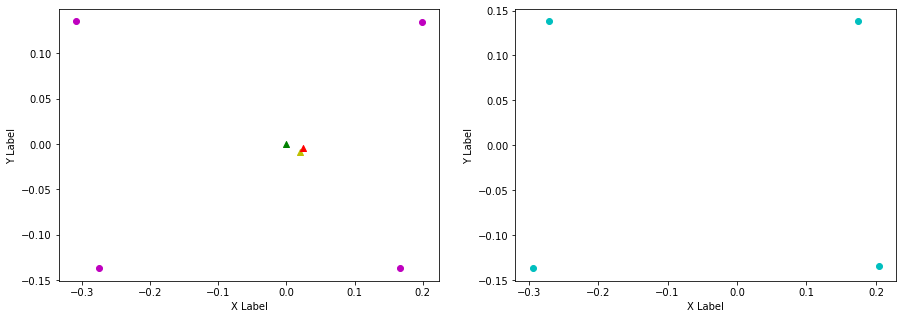

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.174, 0.203, FL (y): 0.138, 0.132.
FL displacement: 0.029000000000000026, -0.006000000000000005.

FR (x): 0.204, 0.179, FR (y): -0.134, -0.138.
FR displacement: -0.024999999999999994, -0.0040000000000000036.

RL (x): -0.27, -0.293, RL (y): 0.138, 0.137.
RL displacement: -0.022999999999999965, -0.0010000000000000009.

RR (x): -0.294, -0.271, RR (y): -0.137, -0.137.
RR displacement: 0.022999999999999965, 0.0.


Base displacement (Foot): [0.024999999999999994, 0.0040000000000000036].

Base displacement (Odom): [[0.025723935387944374], [0.0077397275044205835]]. Rotation displacement: -0.3770679661666788.



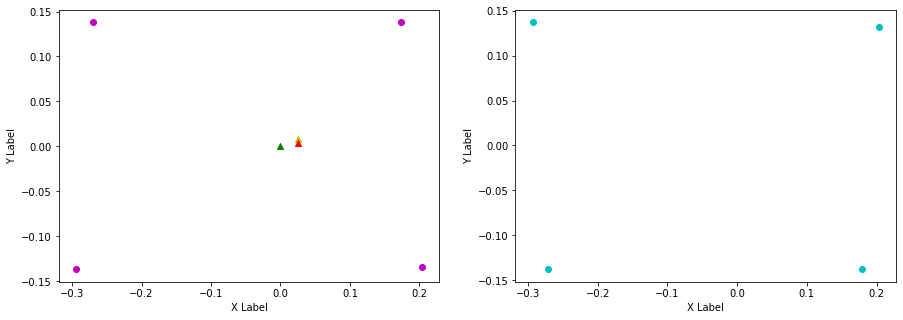

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.203, 0.173, FL (y): 0.132, 0.138.
FL displacement: -0.030000000000000027, 0.006000000000000005.

FR (x): 0.179, 0.203, FR (y): -0.138, -0.134.
FR displacement: 0.02400000000000002, 0.0040000000000000036.

RL (x): -0.293, -0.271, RL (y): 0.137, 0.138.
RL displacement: 0.021999999999999964, 0.0010000000000000009.

RR (x): -0.271, -0.295, RR (y): -0.137, -0.137.
RR displacement: -0.023999999999999966, 0.0.


Base displacement (Foot): [0.030000000000000027, -0.006000000000000005].

Base displacement (Odom): [[0.020103127117280684], [-0.004177770894594403]]. Rotation displacement: 0.7877580643557782.



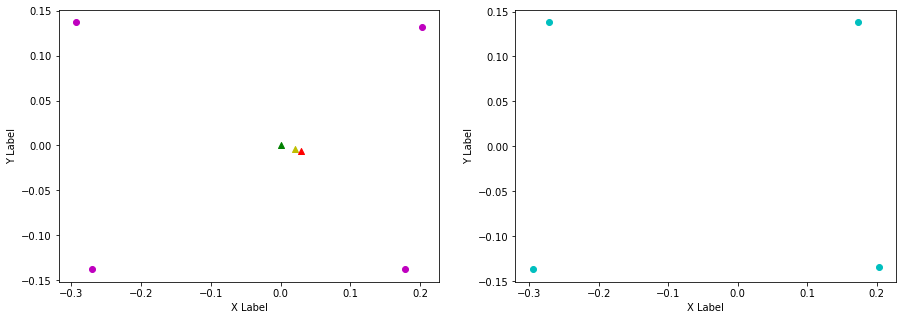

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.173, 0.204, FL (y): 0.138, 0.132.
FL displacement: 0.031, -0.006000000000000005.

FR (x): 0.203, 0.18, FR (y): -0.134, -0.139.
FR displacement: -0.02300000000000002, -0.0050000000000000044.

RL (x): -0.271, -0.292, RL (y): 0.138, 0.138.
RL displacement: -0.020999999999999963, 0.0.

RR (x): -0.295, -0.271, RR (y): -0.137, -0.136.
RR displacement: 0.023999999999999966, 0.0010000000000000009.


Base displacement (Foot): [0.02300000000000002, 0.0050000000000000044].

Base displacement (Odom): [[0.024073459180709356], [0.006670940805500292]]. Rotation displacement: -1.3638879312406818.



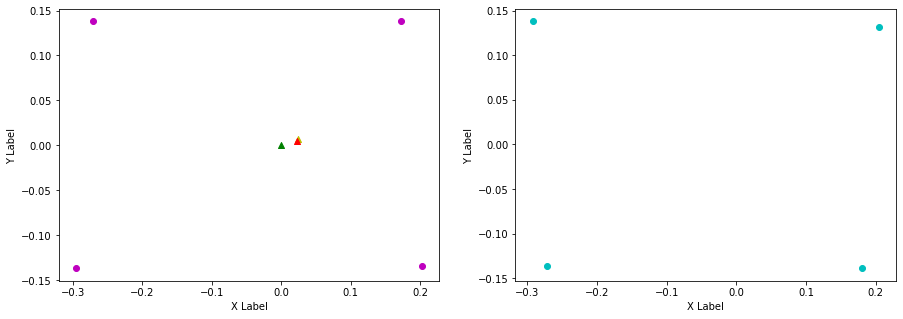

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.204, 0.171, FL (y): 0.132, 0.137.
FL displacement: -0.032999999999999974, 0.0050000000000000044.

FR (x): 0.18, 0.202, FR (y): -0.139, -0.134.
FR displacement: 0.02200000000000002, 0.0050000000000000044.

RL (x): -0.292, -0.272, RL (y): 0.138, 0.138.
RL displacement: 0.019999999999999962, 0.0.

RR (x): -0.271, -0.297, RR (y): -0.136, -0.136.
RR displacement: -0.025999999999999968, 0.0.


Base displacement (Foot): [0.032999999999999974, -0.0050000000000000044].

Base displacement (Odom): [[0.012430239034880275], [-0.0026604871414395506]]. Rotation displacement: 1.1416403813896485.



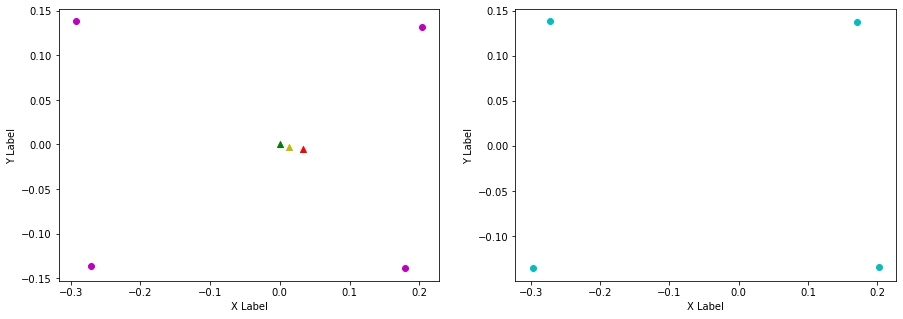

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.171, 0.2, FL (y): 0.137, 0.133.
FL displacement: 0.028999999999999998, -0.0040000000000000036.

FR (x): 0.202, 0.17, FR (y): -0.134, -0.136.
FR displacement: -0.032, -0.0020000000000000018.

RL (x): -0.272, -0.303, RL (y): 0.138, 0.135.
RL displacement: -0.030999999999999972, -0.0030000000000000027.

RR (x): -0.297, -0.274, RR (y): -0.136, -0.137.
RR displacement: 0.022999999999999965, -0.0010000000000000009.


Base displacement (Foot): [0.032, 0.0020000000000000018].

Base displacement (Odom): [[0.026521667905188617], [0.006457170648967295]]. Rotation displacement: -1.136960849714088.



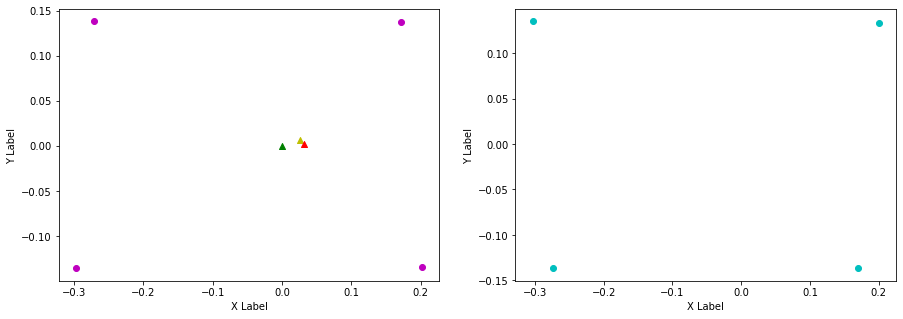

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.2, 0.169, FL (y): 0.133, 0.137.
FL displacement: -0.031, 0.0040000000000000036.

FR (x): 0.17, 0.201, FR (y): -0.136, -0.135.
FR displacement: 0.031, 0.0010000000000000009.

RL (x): -0.303, -0.273, RL (y): 0.135, 0.139.
RL displacement: 0.02999999999999997, 0.0040000000000000036.

RR (x): -0.274, -0.301, RR (y): -0.137, -0.136.
RR displacement: -0.02699999999999997, 0.0010000000000000009.


Base displacement (Foot): [0.031, -0.0040000000000000036].

Base displacement (Odom): [[0.013803913258295553], [-0.0035300969943712485]]. Rotation displacement: 0.22088291400034327.



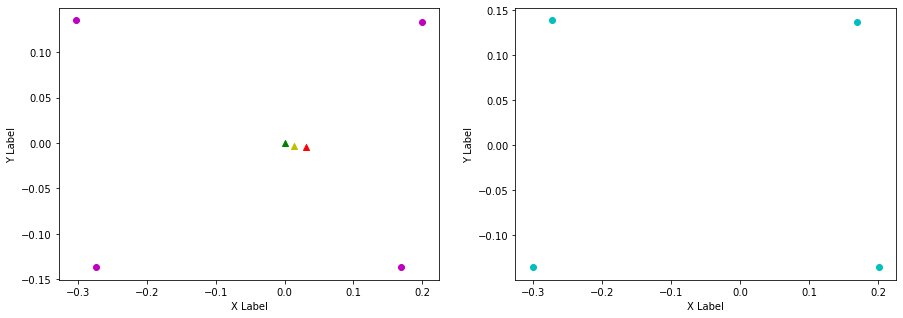

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.169, 0.204, FL (y): 0.137, 0.132.
FL displacement: 0.034999999999999976, -0.0050000000000000044.

FR (x): 0.201, 0.18, FR (y): -0.135, -0.138.
FR displacement: -0.02100000000000002, -0.0030000000000000027.

RL (x): -0.273, -0.292, RL (y): 0.139, 0.138.
RL displacement: -0.01899999999999996, -0.0010000000000000009.

RR (x): -0.301, -0.271, RR (y): -0.136, -0.137.
RR displacement: 0.02999999999999997, -0.0010000000000000009.


Base displacement (Foot): [0.02100000000000002, 0.0030000000000000027].

Base displacement (Odom): [[0.029493403551504538], [0.008815403381009931]]. Rotation displacement: -0.4815171506381998.



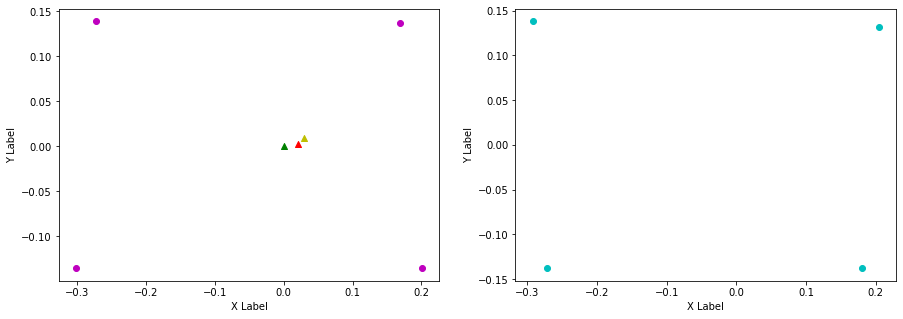

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.204, 0.167, FL (y): 0.132, 0.136.
FL displacement: -0.03699999999999998, 0.0040000000000000036.

FR (x): 0.18, 0.199, FR (y): -0.138, -0.135.
FR displacement: 0.019000000000000017, 0.0030000000000000027.

RL (x): -0.292, -0.274, RL (y): 0.138, 0.139.
RL displacement: 0.01799999999999996, 0.0010000000000000009.

RR (x): -0.271, -0.305, RR (y): -0.137, -0.135.
RR displacement: -0.033999999999999975, 0.0020000000000000018.


Base displacement (Foot): [0.03699999999999998, -0.0040000000000000036].

Base displacement (Odom): [[0.02234748873333192], [-0.00434898762487454]]. Rotation displacement: 0.25906532886793887.



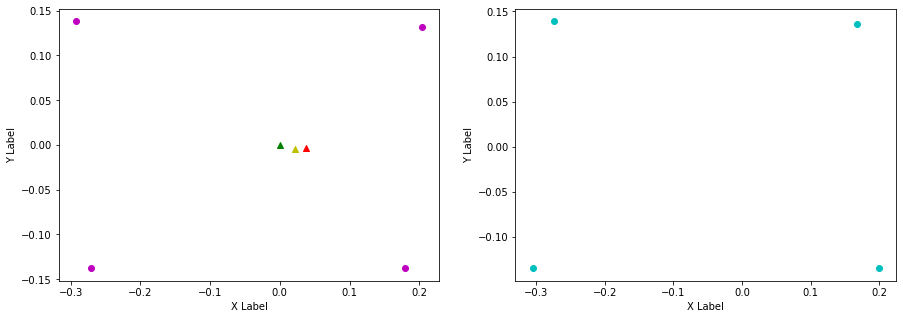

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.167, 0.203, FL (y): 0.136, 0.132.
FL displacement: 0.036000000000000004, -0.0040000000000000036.

FR (x): 0.199, 0.18, FR (y): -0.135, -0.138.
FR displacement: -0.019000000000000017, -0.0030000000000000027.

RL (x): -0.274, -0.291, RL (y): 0.139, 0.138.
RL displacement: -0.01699999999999996, -0.0010000000000000009.

RR (x): -0.305, -0.271, RR (y): -0.135, -0.137.
RR displacement: 0.033999999999999975, -0.0020000000000000018.


Base displacement (Foot): [0.019000000000000017, 0.0030000000000000027].

Base displacement (Odom): [[0.03197027884634984], [0.01120241196085918]]. Rotation displacement: -0.4664263434068821.



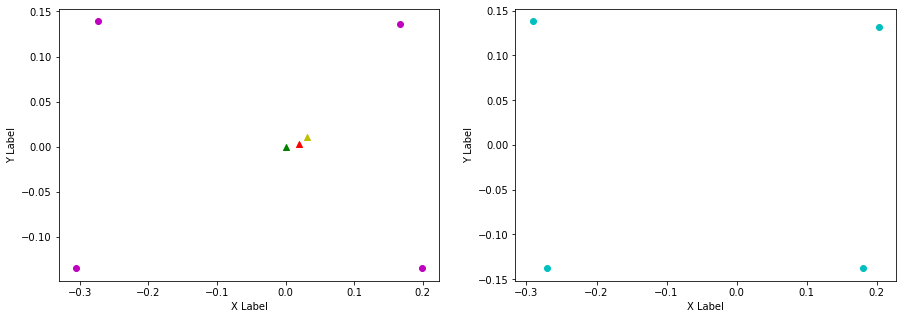

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.203, 0.173, FL (y): 0.132, 0.138.
FL displacement: -0.030000000000000027, 0.006000000000000005.

FR (x): 0.18, 0.204, FR (y): -0.138, -0.134.
FR displacement: 0.023999999999999994, 0.0040000000000000036.

RL (x): -0.291, -0.271, RL (y): 0.138, 0.138.
RL displacement: 0.019999999999999962, 0.0.

RR (x): -0.271, -0.295, RR (y): -0.137, -0.137.
RR displacement: -0.023999999999999966, 0.0.


Base displacement (Foot): [0.030000000000000027, -0.006000000000000005].

Base displacement (Odom): [[0.014860575953909883], [-0.004475939361568787]]. Rotation displacement: 0.6746253637385896.



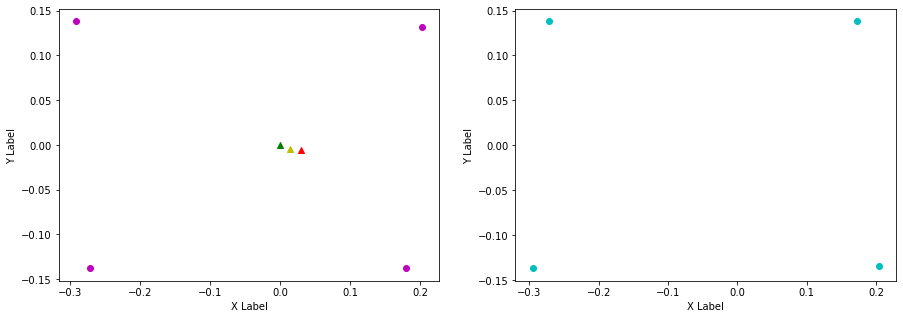

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.173, 0.2, FL (y): 0.138, 0.133.
FL displacement: 0.027000000000000024, -0.0050000000000000044.

FR (x): 0.204, 0.168, FR (y): -0.134, -0.136.
FR displacement: -0.035999999999999976, -0.0020000000000000018.

RL (x): -0.271, -0.306, RL (y): 0.138, 0.135.
RL displacement: -0.034999999999999976, -0.0030000000000000027.

RR (x): -0.295, -0.273, RR (y): -0.137, -0.137.
RR displacement: 0.021999999999999964, 0.0.


Base displacement (Foot): [0.035999999999999976, 0.0020000000000000018].

Base displacement (Odom): [[0.02062210391760877], [0.004224962191637829]]. Rotation displacement: -1.3914469766501938.



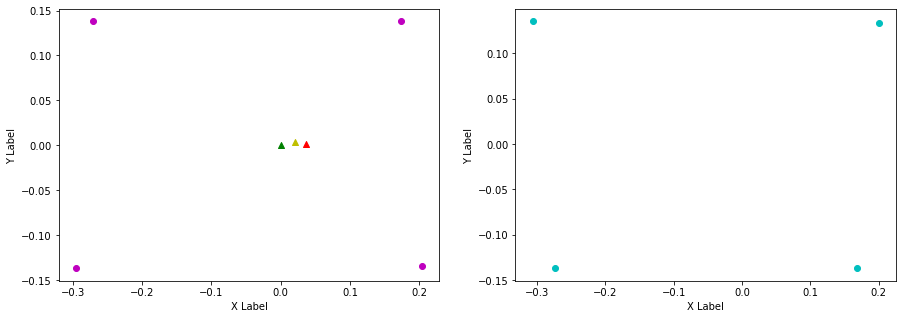

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.2, 0.168, FL (y): 0.133, 0.136.
FL displacement: -0.032, 0.0030000000000000027.

FR (x): 0.168, 0.2, FR (y): -0.136, -0.135.
FR displacement: 0.032, 0.0010000000000000009.

RL (x): -0.306, -0.273, RL (y): 0.135, 0.139.
RL displacement: 0.032999999999999974, 0.0040000000000000036.

RR (x): -0.273, -0.303, RR (y): -0.137, -0.136.
RR displacement: -0.02999999999999997, 0.0010000000000000009.


Base displacement (Foot): [0.032, -0.0030000000000000027].

Base displacement (Odom): [[0.015364699475053367], [-0.007248820761511315]]. Rotation displacement: 0.544944289259902.



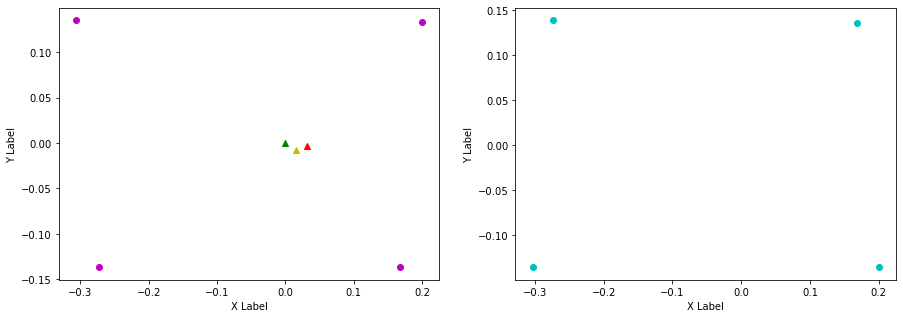

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.168, 0.203, FL (y): 0.136, 0.132.
FL displacement: 0.035, -0.0040000000000000036.

FR (x): 0.2, 0.18, FR (y): -0.135, -0.138.
FR displacement: -0.020000000000000018, -0.0030000000000000027.

RL (x): -0.273, -0.292, RL (y): 0.139, 0.137.
RL displacement: -0.01899999999999996, -0.0020000000000000018.

RR (x): -0.303, -0.271, RR (y): -0.136, -0.137.
RR displacement: 0.03199999999999997, -0.0010000000000000009.


Base displacement (Foot): [0.020000000000000018, 0.0030000000000000027].

Base displacement (Odom): [[0.02832204005270056], [0.008224316051363825]]. Rotation displacement: -0.3384600767970431.



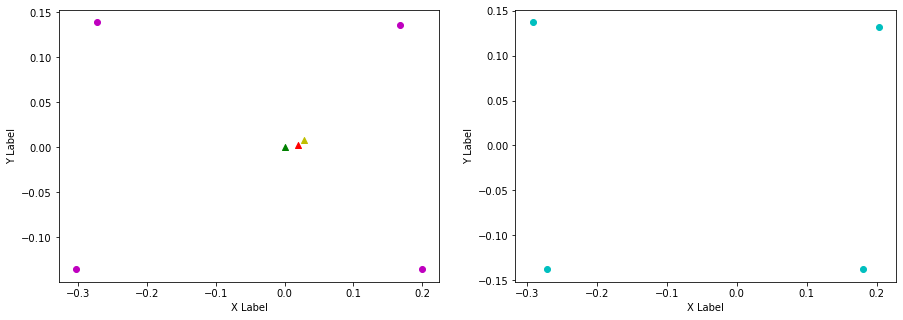

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.203, 0.175, FL (y): 0.132, 0.139.
FL displacement: -0.028000000000000025, 0.007000000000000006.

FR (x): 0.18, 0.204, FR (y): -0.138, -0.133.
FR displacement: 0.023999999999999994, 0.0050000000000000044.

RL (x): -0.292, -0.271, RL (y): 0.137, 0.137.
RL displacement: 0.020999999999999963, 0.0.

RR (x): -0.271, -0.293, RR (y): -0.137, -0.138.
RR displacement: -0.021999999999999964, -0.0010000000000000009.


Base displacement (Foot): [0.028000000000000025, -0.007000000000000006].

Base displacement (Odom): [[0.013367076074218609], [-0.00433195930737959]]. Rotation displacement: 0.43773999893471555.



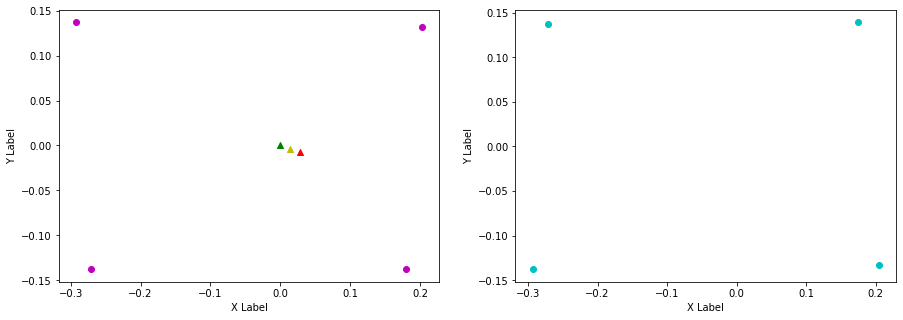

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.175, 0.199, FL (y): 0.139, 0.133.
FL displacement: 0.02400000000000002, -0.006000000000000005.

FR (x): 0.204, 0.167, FR (y): -0.133, -0.135.
FR displacement: -0.03699999999999998, -0.0020000000000000018.

RL (x): -0.271, -0.307, RL (y): 0.137, 0.135.
RL displacement: -0.035999999999999976, -0.0020000000000000018.

RR (x): -0.293, -0.274, RR (y): -0.138, -0.137.
RR displacement: 0.01899999999999996, 0.0010000000000000009.


Base displacement (Foot): [0.03699999999999998, 0.0020000000000000018].

Base displacement (Odom): [[0.030063138824332203], [0.007516553730924122]]. Rotation displacement: -1.2795089839105878.



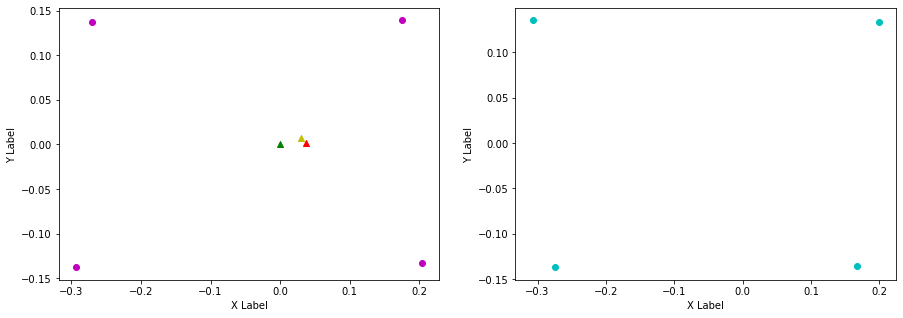

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.199, 0.169, FL (y): 0.133, 0.136.
FL displacement: -0.03, 0.0030000000000000027.

FR (x): 0.167, 0.2, FR (y): -0.135, -0.135.
FR displacement: 0.033, 0.0.

RL (x): -0.307, -0.273, RL (y): 0.135, 0.139.
RL displacement: 0.033999999999999975, 0.0040000000000000036.

RR (x): -0.274, -0.301, RR (y): -0.137, -0.136.
RR displacement: -0.02699999999999997, 0.0010000000000000009.


Base displacement (Foot): [0.03, -0.0030000000000000027].

Base displacement (Odom): [[0.025649247145430376], [-0.0055320506324402635]]. Rotation displacement: 0.619369737000283.



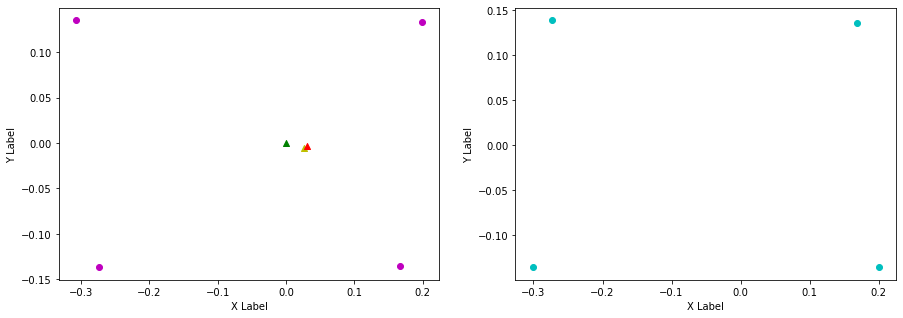

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.169, 0.2, FL (y): 0.136, 0.133.
FL displacement: 0.031, -0.0030000000000000027.

FR (x): 0.2, 0.17, FR (y): -0.135, -0.136.
FR displacement: -0.03, -0.0010000000000000009.

RL (x): -0.273, -0.303, RL (y): 0.139, 0.136.
RL displacement: -0.02999999999999997, -0.0030000000000000027.

RR (x): -0.301, -0.273, RR (y): -0.136, -0.137.
RR displacement: 0.02799999999999997, -0.0010000000000000009.


Base displacement (Foot): [0.03, 0.0010000000000000009].

Base displacement (Odom): [[0.019626923820683206], [0.007247653949987054]]. Rotation displacement: -0.5438327735434858.



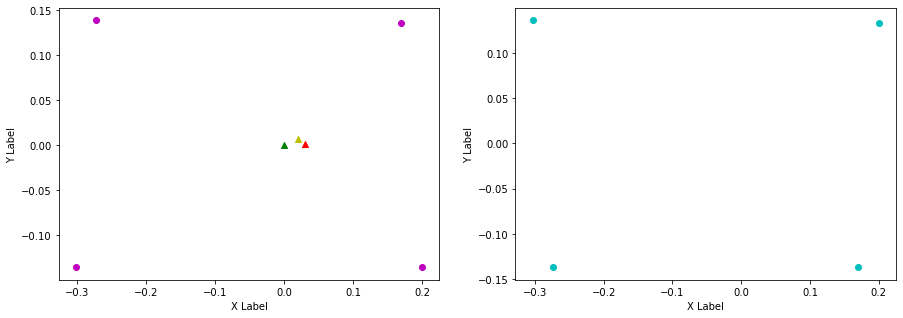

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.2, 0.17, FL (y): 0.133, 0.137.
FL displacement: -0.03, 0.0040000000000000036.

FR (x): 0.17, 0.201, FR (y): -0.136, -0.134.
FR displacement: 0.031, 0.0020000000000000018.

RL (x): -0.303, -0.273, RL (y): 0.136, 0.139.
RL displacement: 0.02999999999999997, 0.0030000000000000027.

RR (x): -0.273, -0.299, RR (y): -0.137, -0.136.
RR displacement: -0.025999999999999968, 0.0010000000000000009.


Base displacement (Foot): [0.03, -0.0040000000000000036].

Base displacement (Odom): [[0.008237162184610014], [-0.0028549341524412436]]. Rotation displacement: 0.4035037022057697.



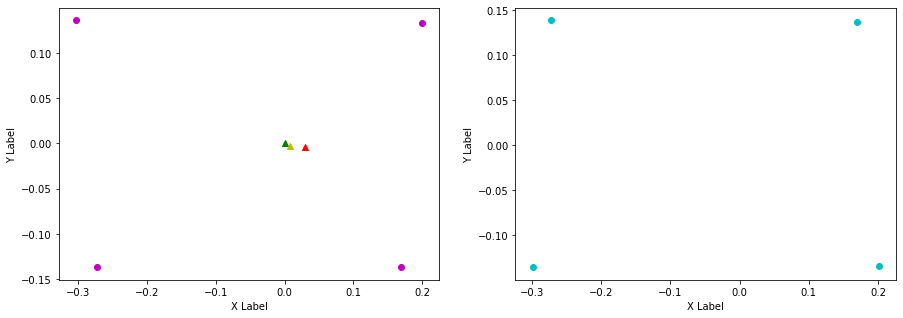

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.17, 0.203, FL (y): 0.137, 0.132.
FL displacement: 0.033, -0.0050000000000000044.

FR (x): 0.201, 0.179, FR (y): -0.134, -0.138.
FR displacement: -0.02200000000000002, -0.0040000000000000036.

RL (x): -0.273, -0.292, RL (y): 0.139, 0.137.
RL displacement: -0.01899999999999996, -0.0020000000000000018.

RR (x): -0.299, -0.271, RR (y): -0.136, -0.136.
RR displacement: 0.02799999999999997, 0.0.


Base displacement (Foot): [0.02200000000000002, 0.0040000000000000036].

Base displacement (Odom): [[0.015001486493967375], [0.005832508044179785]]. Rotation displacement: -0.5352132181134465.



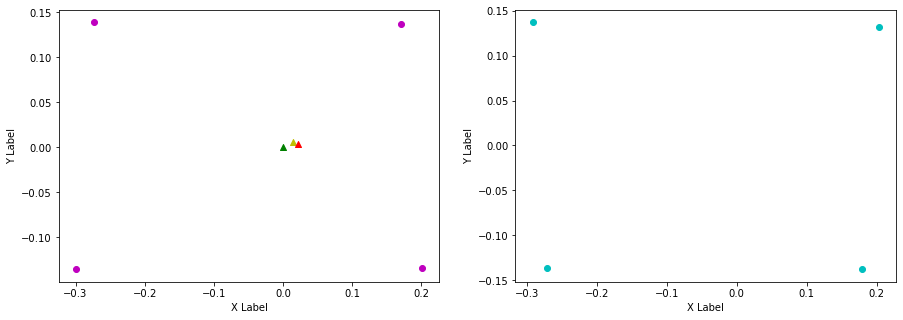

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.203, 0.173, FL (y): 0.132, 0.138.
FL displacement: -0.030000000000000027, 0.006000000000000005.

FR (x): 0.179, 0.204, FR (y): -0.138, -0.134.
FR displacement: 0.024999999999999994, 0.0040000000000000036.

RL (x): -0.292, -0.271, RL (y): 0.137, 0.138.
RL displacement: 0.020999999999999963, 0.0010000000000000009.

RR (x): -0.271, -0.294, RR (y): -0.136, -0.137.
RR displacement: -0.022999999999999965, -0.0010000000000000009.


Base displacement (Foot): [0.030000000000000027, -0.006000000000000005].

Base displacement (Odom): [[0.020255442608207996], [-0.005162413012263611]]. Rotation displacement: 0.6910938721040252.



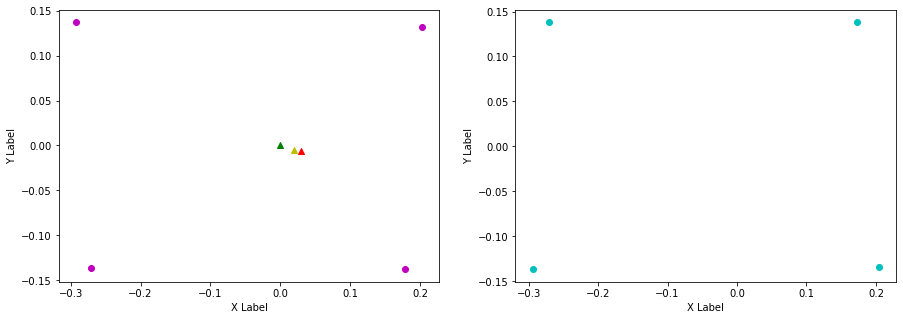

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.173, 0.202, FL (y): 0.138, 0.132.
FL displacement: 0.029000000000000026, -0.006000000000000005.

FR (x): 0.204, 0.179, FR (y): -0.134, -0.137.
FR displacement: -0.024999999999999994, -0.0030000000000000027.

RL (x): -0.271, -0.293, RL (y): 0.138, 0.137.
RL displacement: -0.021999999999999964, -0.0010000000000000009.

RR (x): -0.294, -0.271, RR (y): -0.137, -0.137.
RR displacement: 0.022999999999999965, 0.0.


Base displacement (Foot): [0.024999999999999994, 0.0030000000000000027].

Base displacement (Odom): [[0.02168196143602885], [0.0036711993058135828]]. Rotation displacement: -1.1241208774894935.



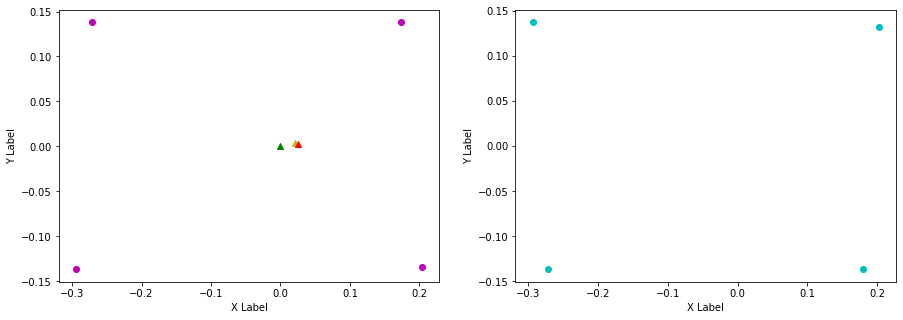

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.202, 0.168, FL (y): 0.132, 0.136.
FL displacement: -0.034, 0.0040000000000000036.

FR (x): 0.179, 0.2, FR (y): -0.137, -0.135.
FR displacement: 0.02100000000000002, 0.0020000000000000018.

RL (x): -0.293, -0.274, RL (y): 0.137, 0.139.
RL displacement: 0.01899999999999996, 0.0020000000000000018.

RR (x): -0.271, -0.303, RR (y): -0.137, -0.136.
RR displacement: -0.03199999999999997, 0.0010000000000000009.


Base displacement (Foot): [0.034, -0.0040000000000000036].

Base displacement (Odom): [[0.003094992732288304], [-0.002363821016222345]]. Rotation displacement: 0.8890678483403865.



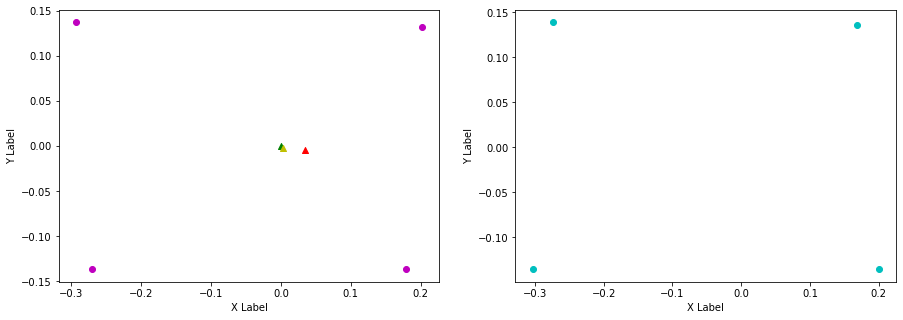

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.168, 0.203, FL (y): 0.136, 0.132.
FL displacement: 0.035, -0.0040000000000000036.

FR (x): 0.2, 0.179, FR (y): -0.135, -0.138.
FR displacement: -0.02100000000000002, -0.0030000000000000027.

RL (x): -0.274, -0.292, RL (y): 0.139, 0.137.
RL displacement: -0.01799999999999996, -0.0020000000000000018.

RR (x): -0.303, -0.271, RR (y): -0.136, -0.137.
RR displacement: 0.03199999999999997, -0.0010000000000000009.


Base displacement (Foot): [0.02100000000000002, 0.0030000000000000027].

Base displacement (Odom): [[0.01184508023007691], [0.0026154513652422717]]. Rotation displacement: -0.8168686134980189.



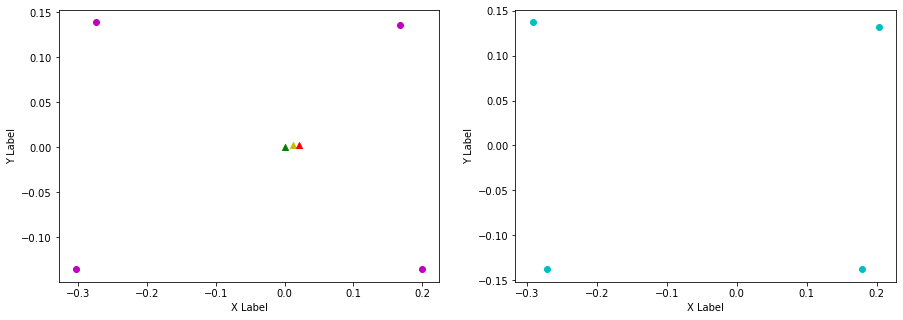

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.203, 0.171, FL (y): 0.132, 0.137.
FL displacement: -0.032, 0.0050000000000000044.

FR (x): 0.179, 0.202, FR (y): -0.138, -0.134.
FR displacement: 0.02300000000000002, 0.0040000000000000036.

RL (x): -0.292, -0.272, RL (y): 0.137, 0.138.
RL displacement: 0.019999999999999962, 0.0010000000000000009.

RR (x): -0.271, -0.297, RR (y): -0.137, -0.136.
RR displacement: -0.025999999999999968, 0.0010000000000000009.


Base displacement (Foot): [0.032, -0.0050000000000000044].

Base displacement (Odom): [[0.025595687612574913], [-0.007250053545814067]]. Rotation displacement: 0.632816040224933.



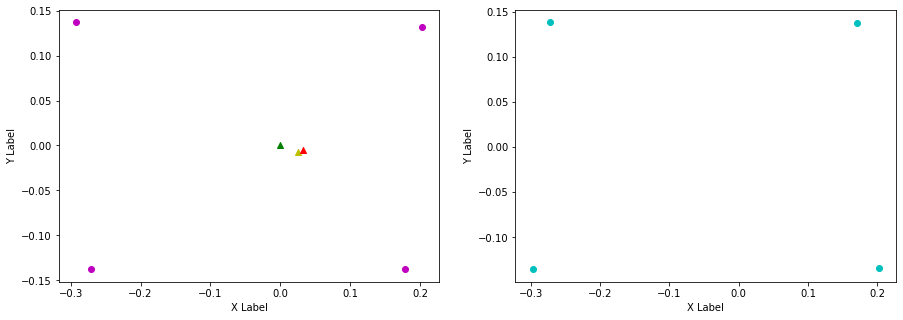

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.171, 0.2, FL (y): 0.137, 0.133.
FL displacement: 0.028999999999999998, -0.0040000000000000036.

FR (x): 0.202, 0.171, FR (y): -0.134, -0.136.
FR displacement: -0.031, -0.0020000000000000018.

RL (x): -0.272, -0.303, RL (y): 0.138, 0.135.
RL displacement: -0.030999999999999972, -0.0030000000000000027.

RR (x): -0.297, -0.273, RR (y): -0.136, -0.137.
RR displacement: 0.023999999999999966, -0.0010000000000000009.


Base displacement (Foot): [0.031, 0.0020000000000000018].

Base displacement (Odom): [[0.0228625612071216], [0.006468892012670119]]. Rotation displacement: -1.2887279083017094.



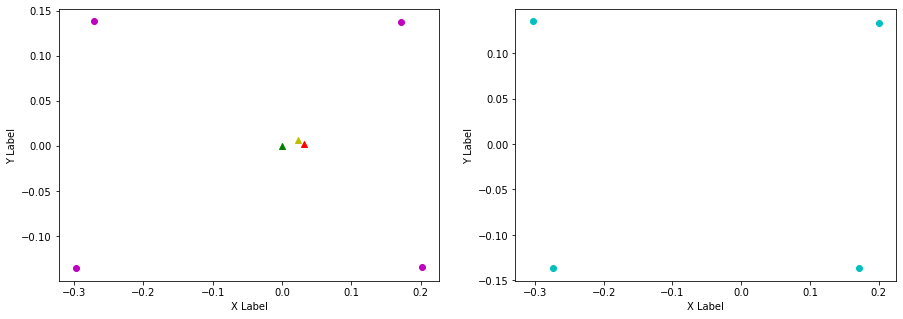

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.2, 0.169, FL (y): 0.133, 0.136.
FL displacement: -0.031, 0.0030000000000000027.

FR (x): 0.171, 0.2, FR (y): -0.136, -0.135.
FR displacement: 0.028999999999999998, 0.0010000000000000009.

RL (x): -0.303, -0.273, RL (y): 0.135, 0.138.
RL displacement: 0.02999999999999997, 0.0030000000000000027.

RR (x): -0.273, -0.301, RR (y): -0.137, -0.136.
RR displacement: -0.02799999999999997, 0.0010000000000000009.


Base displacement (Foot): [0.031, -0.0030000000000000027].

Base displacement (Odom): [[0.011629654604282447], [-0.004007336262513123]]. Rotation displacement: 0.21203008220843947.



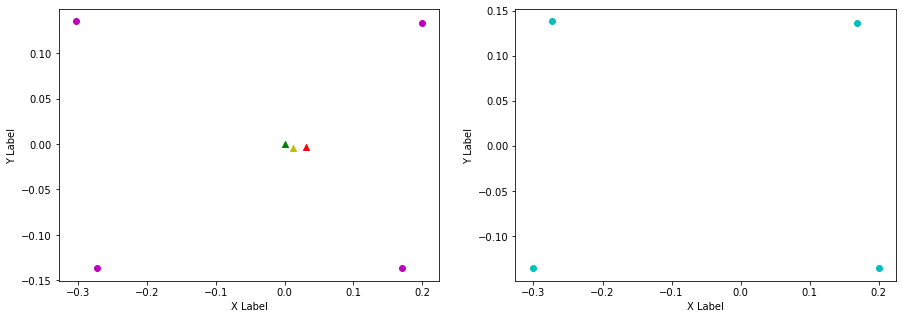

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.169, 0.2, FL (y): 0.136, 0.134.
FL displacement: 0.031, -0.0020000000000000018.

FR (x): 0.2, 0.168, FR (y): -0.135, -0.135.
FR displacement: -0.032, 0.0.

RL (x): -0.273, -0.307, RL (y): 0.138, 0.135.
RL displacement: -0.033999999999999975, -0.0030000000000000027.

RR (x): -0.301, -0.273, RR (y): -0.136, -0.138.
RR displacement: 0.02799999999999997, -0.0020000000000000018.


Base displacement (Foot): [0.032, -0.0].

Base displacement (Odom): [[0.030326623415169562], [0.00904007006602836]]. Rotation displacement: -0.34404148089978054.



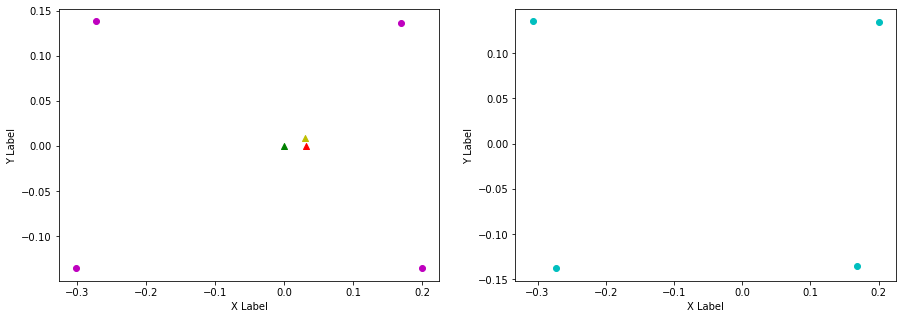

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.2, 0.169, FL (y): 0.134, 0.136.
FL displacement: -0.031, 0.0020000000000000018.

FR (x): 0.168, 0.201, FR (y): -0.135, -0.135.
FR displacement: 0.033, 0.0.

RL (x): -0.307, -0.273, RL (y): 0.135, 0.139.
RL displacement: 0.033999999999999975, 0.0040000000000000036.

RR (x): -0.273, -0.301, RR (y): -0.138, -0.136.
RR displacement: -0.02799999999999997, 0.0020000000000000018.


Base displacement (Foot): [0.031, -0.0020000000000000018].

Base displacement (Odom): [[0.020035724570938163], [-0.004782569323608349]]. Rotation displacement: -0.012570949133051908.



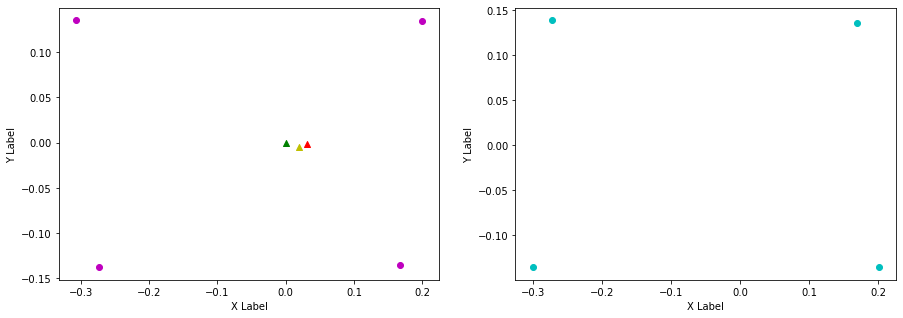

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.169, 0.201, FL (y): 0.136, 0.133.
FL displacement: 0.032, -0.0030000000000000027.

FR (x): 0.201, 0.173, FR (y): -0.135, -0.136.
FR displacement: -0.028000000000000025, -0.0010000000000000009.

RL (x): -0.273, -0.299, RL (y): 0.139, 0.136.
RL displacement: -0.025999999999999968, -0.0030000000000000027.

RR (x): -0.301, -0.273, RR (y): -0.136, -0.137.
RR displacement: 0.02799999999999997, -0.0010000000000000009.


Base displacement (Foot): [0.028000000000000025, 0.0010000000000000009].

Base displacement (Odom): [[0.02027356932166824], [0.005112714427028986]]. Rotation displacement: -0.09504868382356399.



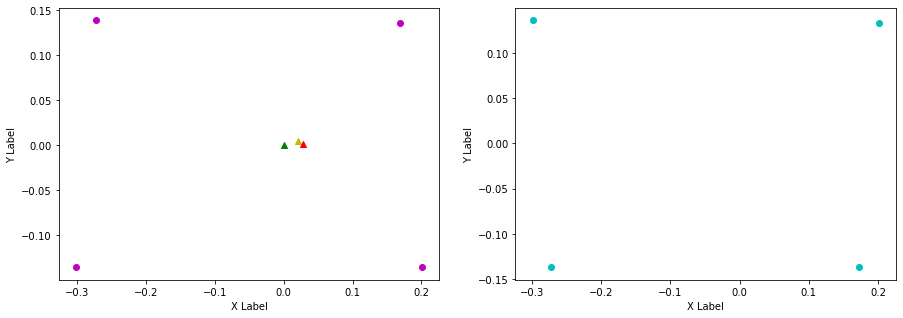

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.201, 0.175, FL (y): 0.133, 0.139.
FL displacement: -0.026000000000000023, 0.006000000000000005.

FR (x): 0.173, 0.205, FR (y): -0.136, -0.133.
FR displacement: 0.032, 0.0030000000000000027.

RL (x): -0.299, -0.27, RL (y): 0.136, 0.137.
RL displacement: 0.02899999999999997, 0.0010000000000000009.

RR (x): -0.273, -0.293, RR (y): -0.137, -0.138.
RR displacement: -0.019999999999999962, -0.0010000000000000009.


Base displacement (Foot): [0.026000000000000023, -0.006000000000000005].

Base displacement (Odom): [[0.01094740523722404], [-0.004207685948368983]]. Rotation displacement: 0.3116895561594096.



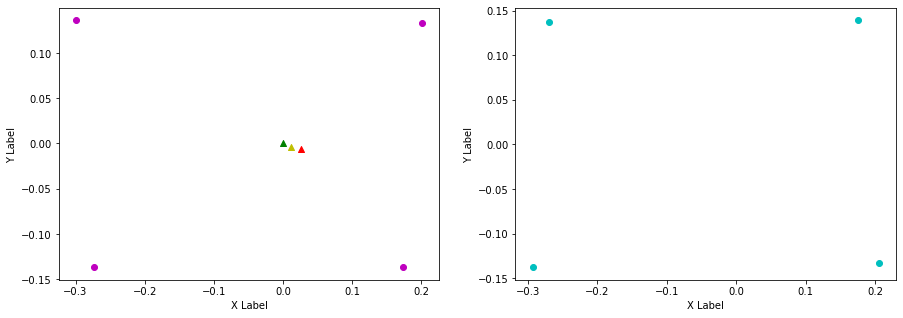

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.175, 0.2, FL (y): 0.139, 0.133.
FL displacement: 0.025000000000000022, -0.006000000000000005.

FR (x): 0.205, 0.17, FR (y): -0.133, -0.136.
FR displacement: -0.034999999999999976, -0.0030000000000000027.

RL (x): -0.27, -0.302, RL (y): 0.137, 0.136.
RL displacement: -0.03199999999999997, -0.0010000000000000009.

RR (x): -0.293, -0.273, RR (y): -0.138, -0.137.
RR displacement: 0.019999999999999962, 0.0010000000000000009.


Base displacement (Foot): [0.034999999999999976, 0.0030000000000000027].

Base displacement (Odom): [[0.038234367327124597], [0.008170940429563095]]. Rotation displacement: -0.8749275844993523.



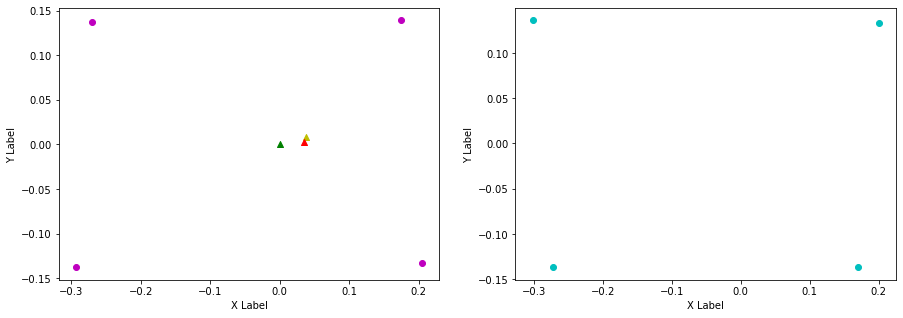

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.2, 0.174, FL (y): 0.133, 0.138.
FL displacement: -0.026000000000000023, 0.0050000000000000044.

FR (x): 0.17, 0.204, FR (y): -0.136, -0.134.
FR displacement: 0.033999999999999975, 0.0020000000000000018.

RL (x): -0.302, -0.27, RL (y): 0.136, 0.138.
RL displacement: 0.03199999999999997, 0.0020000000000000018.

RR (x): -0.273, -0.294, RR (y): -0.137, -0.138.
RR displacement: -0.020999999999999963, -0.0010000000000000009.


Base displacement (Foot): [0.026000000000000023, -0.0050000000000000044].

Base displacement (Odom): [[0.014107242162764377], [-0.0025781606640530585]]. Rotation displacement: 0.6683725568768865.



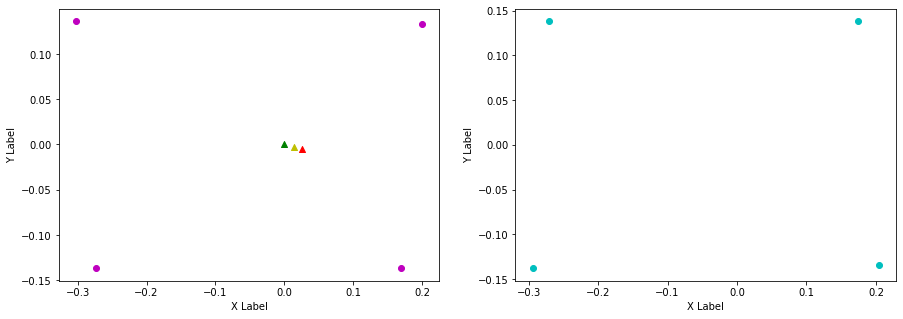

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.174, 0.202, FL (y): 0.138, 0.132.
FL displacement: 0.028000000000000025, -0.006000000000000005.

FR (x): 0.204, 0.176, FR (y): -0.134, -0.137.
FR displacement: -0.027999999999999997, -0.0030000000000000027.

RL (x): -0.27, -0.295, RL (y): 0.138, 0.136.
RL displacement: -0.024999999999999967, -0.0020000000000000018.

RR (x): -0.294, -0.272, RR (y): -0.138, -0.137.
RR displacement: 0.021999999999999964, 0.0010000000000000009.


Base displacement (Foot): [0.027999999999999997, 0.0030000000000000027].

Base displacement (Odom): [[0.020424679374998478], [0.006057287884779605]]. Rotation displacement: -0.77826574025349.



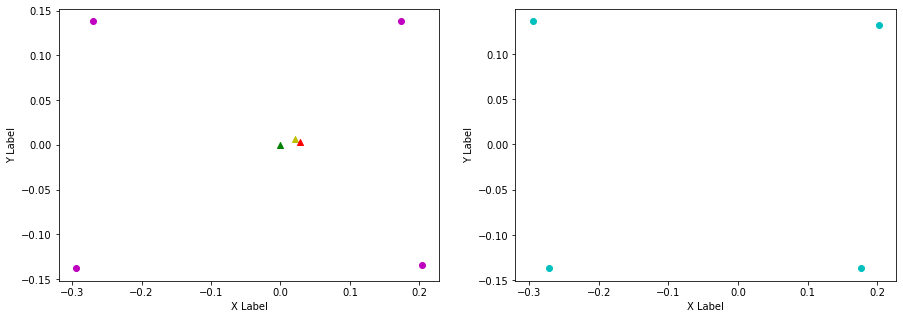

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.202, 0.173, FL (y): 0.132, 0.138.
FL displacement: -0.029000000000000026, 0.006000000000000005.

FR (x): 0.176, 0.203, FR (y): -0.137, -0.134.
FR displacement: 0.027000000000000024, 0.0030000000000000027.

RL (x): -0.295, -0.271, RL (y): 0.136, 0.138.
RL displacement: 0.023999999999999966, 0.0020000000000000018.

RR (x): -0.272, -0.295, RR (y): -0.137, -0.137.
RR displacement: -0.022999999999999965, 0.0.


Base displacement (Foot): [0.029000000000000026, -0.006000000000000005].

Base displacement (Odom): [[0.006889333996435987], [-0.0019304414578352747]]. Rotation displacement: 0.7299303068858854.



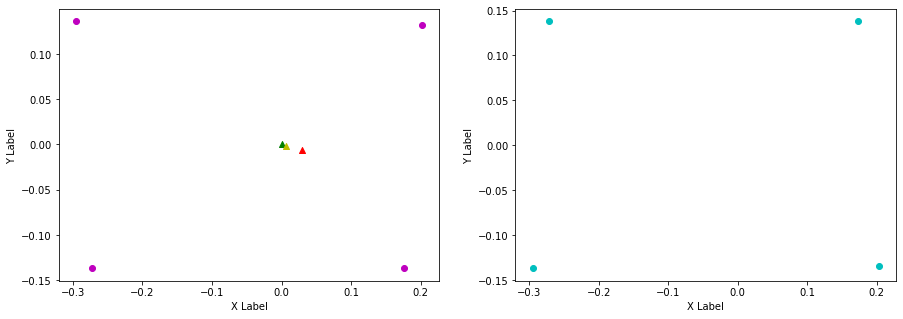

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.173, 0.199, FL (y): 0.138, 0.134.
FL displacement: 0.026000000000000023, -0.0040000000000000036.

FR (x): 0.203, 0.167, FR (y): -0.134, -0.135.
FR displacement: -0.036000000000000004, -0.0010000000000000009.

RL (x): -0.271, -0.307, RL (y): 0.138, 0.135.
RL displacement: -0.035999999999999976, -0.0030000000000000027.

RR (x): -0.295, -0.274, RR (y): -0.137, -0.137.
RR displacement: 0.020999999999999963, 0.0.


Base displacement (Foot): [0.036000000000000004, 0.0010000000000000009].

Base displacement (Odom): [[0.016206935922526533], [0.0026701585666172867]]. Rotation displacement: -1.140465224851248.



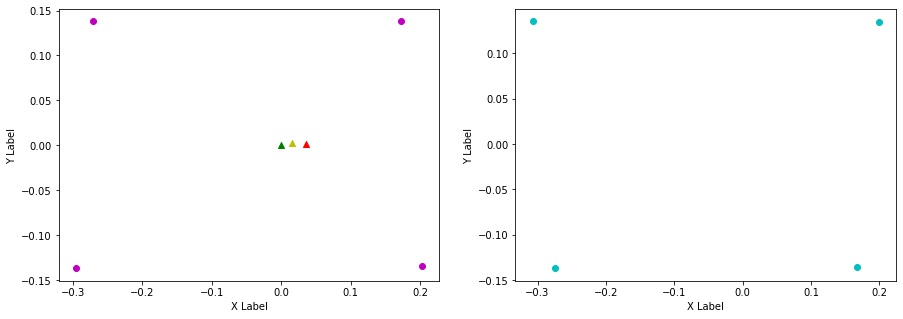

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.199, 0.172, FL (y): 0.134, 0.138.
FL displacement: -0.027000000000000024, 0.0040000000000000036.

FR (x): 0.167, 0.202, FR (y): -0.135, -0.134.
FR displacement: 0.035, 0.0010000000000000009.

RL (x): -0.307, -0.272, RL (y): 0.135, 0.138.
RL displacement: 0.034999999999999976, 0.0030000000000000027.

RR (x): -0.274, -0.296, RR (y): -0.137, -0.137.
RR displacement: -0.021999999999999964, 0.0.


Base displacement (Foot): [0.027000000000000024, -0.0040000000000000036].

Base displacement (Odom): [[0.03405050519904829], [-0.010959171917564126]]. Rotation displacement: 0.07696203611666354.



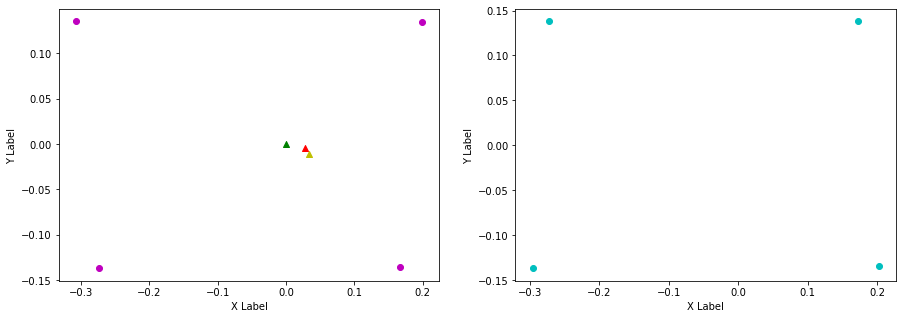

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.172, 0.199, FL (y): 0.138, 0.134.
FL displacement: 0.027000000000000024, -0.0040000000000000036.

FR (x): 0.202, 0.167, FR (y): -0.134, -0.136.
FR displacement: -0.035, -0.0020000000000000018.

RL (x): -0.272, -0.307, RL (y): 0.138, 0.135.
RL displacement: -0.034999999999999976, -0.0030000000000000027.

RR (x): -0.296, -0.274, RR (y): -0.137, -0.137.
RR displacement: 0.021999999999999964, 0.0.


Base displacement (Foot): [0.035, 0.0020000000000000018].

Base displacement (Odom): [[0.014787217751460968], [0.008839985030288489]]. Rotation displacement: -0.10447677154888597.



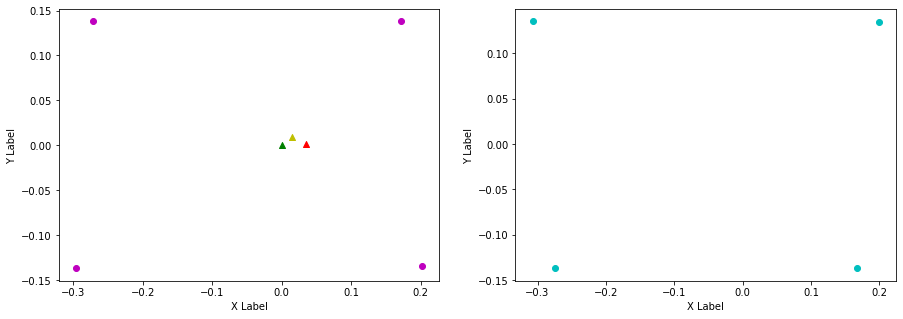

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.199, 0.172, FL (y): 0.134, 0.137.
FL displacement: -0.027000000000000024, 0.0030000000000000027.

FR (x): 0.167, 0.203, FR (y): -0.136, -0.134.
FR displacement: 0.036000000000000004, 0.0020000000000000018.

RL (x): -0.307, -0.271, RL (y): 0.135, 0.138.
RL displacement: 0.035999999999999976, 0.0030000000000000027.

RR (x): -0.274, -0.296, RR (y): -0.137, -0.137.
RR displacement: -0.021999999999999964, 0.0.


Base displacement (Foot): [0.027000000000000024, -0.0030000000000000027].

Base displacement (Odom): [[0.01738301906522044], [-0.005433142037829297]]. Rotation displacement: 0.27321625195931104.



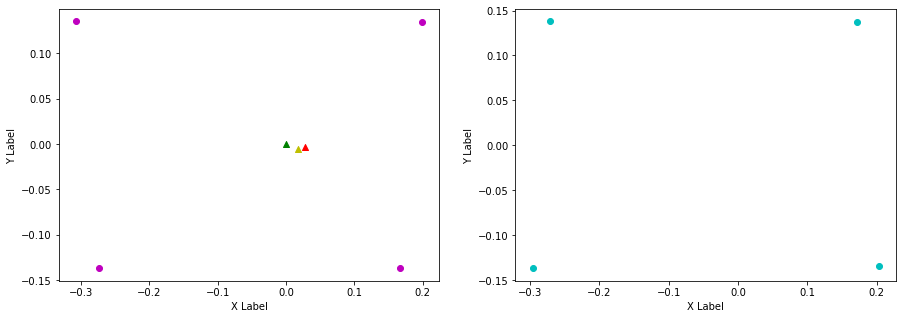

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.172, 0.199, FL (y): 0.137, 0.134.
FL displacement: 0.027000000000000024, -0.0030000000000000027.

FR (x): 0.203, 0.168, FR (y): -0.134, -0.136.
FR displacement: -0.035, -0.0020000000000000018.

RL (x): -0.271, -0.306, RL (y): 0.138, 0.135.
RL displacement: -0.034999999999999976, -0.0030000000000000027.

RR (x): -0.296, -0.274, RR (y): -0.137, -0.137.
RR displacement: 0.021999999999999964, 0.0.


Base displacement (Foot): [0.035, 0.0020000000000000018].

Base displacement (Odom): [[0.020118669816763246], [0.0028577515695842604]]. Rotation displacement: -0.6485534520049147.



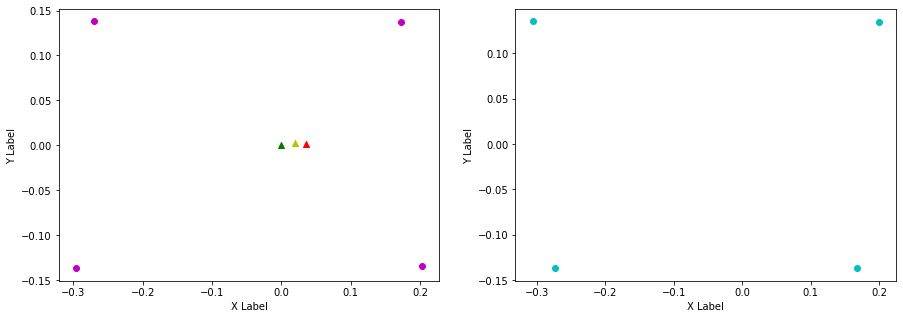

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.199, 0.172, FL (y): 0.134, 0.137.
FL displacement: -0.027000000000000024, 0.0030000000000000027.

FR (x): 0.168, 0.202, FR (y): -0.136, -0.134.
FR displacement: 0.034, 0.0020000000000000018.

RL (x): -0.306, -0.272, RL (y): 0.135, 0.139.
RL displacement: 0.033999999999999975, 0.0040000000000000036.

RR (x): -0.274, -0.297, RR (y): -0.137, -0.137.
RR displacement: -0.022999999999999965, 0.0.


Base displacement (Foot): [0.027000000000000024, -0.0030000000000000027].

Base displacement (Odom): [[0.016199949019572113], [-0.005875874378517165]]. Rotation displacement: 0.1986769755353638.



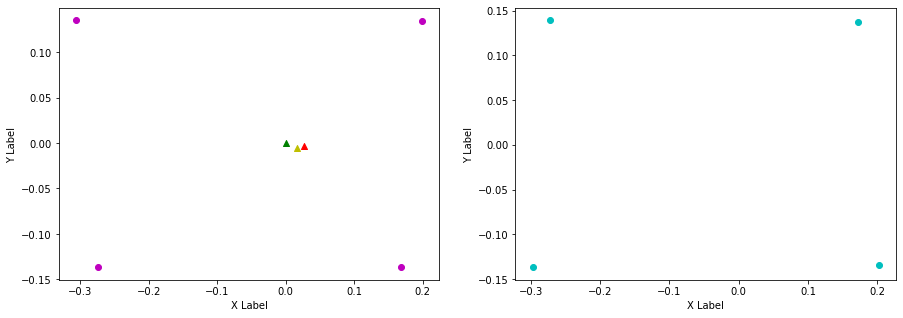

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.172, 0.203, FL (y): 0.137, 0.132.
FL displacement: 0.031000000000000028, -0.0050000000000000044.

FR (x): 0.202, 0.179, FR (y): -0.134, -0.138.
FR displacement: -0.02300000000000002, -0.0040000000000000036.

RL (x): -0.272, -0.292, RL (y): 0.139, 0.138.
RL displacement: -0.019999999999999962, -0.0010000000000000009.

RR (x): -0.297, -0.271, RR (y): -0.137, -0.137.
RR displacement: 0.025999999999999968, 0.0.


Base displacement (Foot): [0.02300000000000002, 0.0040000000000000036].

Base displacement (Odom): [[0.019717240877697995], [0.0051624633790007535]]. Rotation displacement: -0.590459737857819.



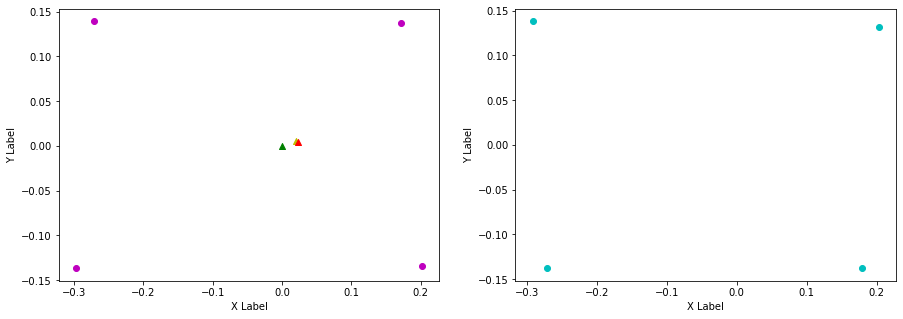

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.203, 0.173, FL (y): 0.132, 0.138.
FL displacement: -0.030000000000000027, 0.006000000000000005.

FR (x): 0.179, 0.203, FR (y): -0.138, -0.134.
FR displacement: 0.02400000000000002, 0.0040000000000000036.

RL (x): -0.292, -0.271, RL (y): 0.138, 0.138.
RL displacement: 0.020999999999999963, 0.0.

RR (x): -0.271, -0.295, RR (y): -0.137, -0.137.
RR displacement: -0.023999999999999966, 0.0.


Base displacement (Foot): [0.030000000000000027, -0.006000000000000005].

Base displacement (Odom): [[0.02390067337713986], [-0.007739770182529471]]. Rotation displacement: 0.6720732487674295.



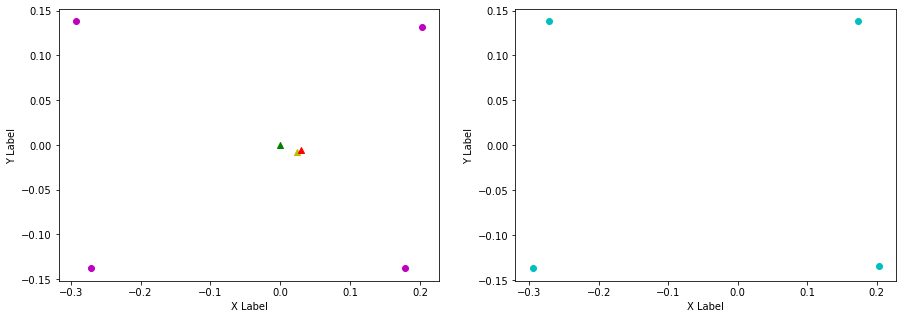

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.173, 0.201, FL (y): 0.138, 0.133.
FL displacement: 0.028000000000000025, -0.0050000000000000044.

FR (x): 0.203, 0.175, FR (y): -0.134, -0.137.
FR displacement: -0.028000000000000025, -0.0030000000000000027.

RL (x): -0.271, -0.297, RL (y): 0.138, 0.136.
RL displacement: -0.025999999999999968, -0.0020000000000000018.

RR (x): -0.295, -0.272, RR (y): -0.137, -0.137.
RR displacement: 0.022999999999999965, 0.0.


Base displacement (Foot): [0.028000000000000025, 0.0030000000000000027].

Base displacement (Odom): [[0.01842513157036163], [0.0038805088637438034]]. Rotation displacement: -0.8785656165632992.



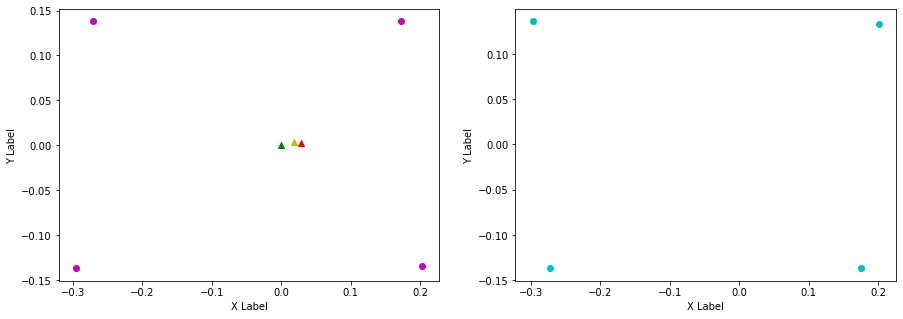

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.201, 0.168, FL (y): 0.133, 0.136.
FL displacement: -0.033, 0.0030000000000000027.

FR (x): 0.175, 0.2, FR (y): -0.137, -0.135.
FR displacement: 0.025000000000000022, 0.0020000000000000018.

RL (x): -0.297, -0.273, RL (y): 0.136, 0.139.
RL displacement: 0.023999999999999966, 0.0030000000000000027.

RR (x): -0.272, -0.303, RR (y): -0.137, -0.136.
RR displacement: -0.030999999999999972, 0.0010000000000000009.


Base displacement (Foot): [0.033, -0.0030000000000000027].

Base displacement (Odom): [[0.028316218189164744], [-0.0069680215283570435]]. Rotation displacement: 0.6495145865986377.



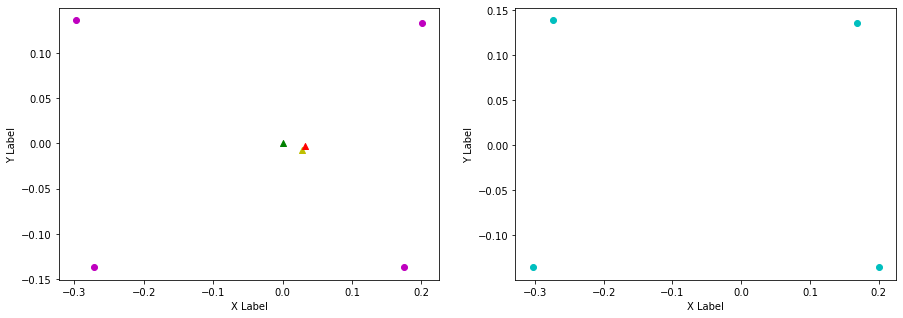

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.168, 0.204, FL (y): 0.136, 0.132.
FL displacement: 0.035999999999999976, -0.0040000000000000036.

FR (x): 0.2, 0.179, FR (y): -0.135, -0.139.
FR displacement: -0.02100000000000002, -0.0040000000000000036.

RL (x): -0.273, -0.292, RL (y): 0.139, 0.138.
RL displacement: -0.01899999999999996, -0.0010000000000000009.

RR (x): -0.303, -0.27, RR (y): -0.136, -0.136.
RR displacement: 0.032999999999999974, 0.0.


Base displacement (Foot): [0.02100000000000002, 0.0040000000000000036].

Base displacement (Odom): [[0.009489773158672277], [0.0009625141989844377]]. Rotation displacement: -0.30661887231948604.



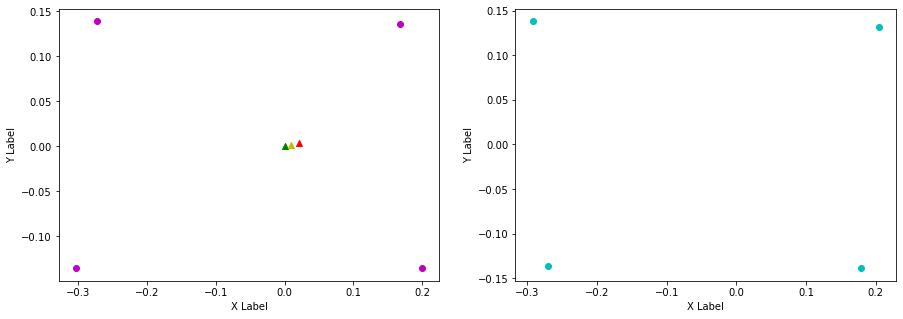

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.204, 0.167, FL (y): 0.132, 0.135.
FL displacement: -0.03699999999999998, 0.0030000000000000027.

FR (x): 0.179, 0.2, FR (y): -0.139, -0.135.
FR displacement: 0.02100000000000002, 0.0040000000000000036.

RL (x): -0.292, -0.274, RL (y): 0.138, 0.139.
RL displacement: 0.01799999999999996, 0.0010000000000000009.

RR (x): -0.27, -0.305, RR (y): -0.136, -0.135.
RR displacement: -0.034999999999999976, 0.0010000000000000009.


Base displacement (Foot): [0.03699999999999998, -0.0030000000000000027].

Base displacement (Odom): [[0.02865271518926371], [-0.005504863009756916]]. Rotation displacement: 0.14658150367201161.



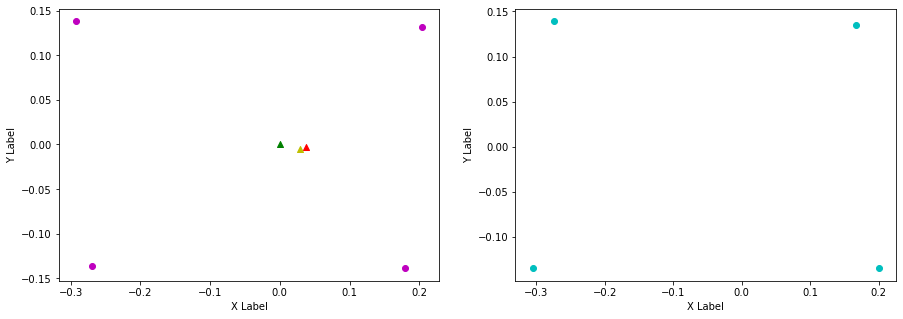

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.167, 0.2, FL (y): 0.135, 0.133.
FL displacement: 0.033, -0.0020000000000000018.

FR (x): 0.2, 0.17, FR (y): -0.135, -0.136.
FR displacement: -0.03, -0.0010000000000000009.

RL (x): -0.274, -0.302, RL (y): 0.139, 0.136.
RL displacement: -0.02799999999999997, -0.0030000000000000027.

RR (x): -0.305, -0.273, RR (y): -0.135, -0.137.
RR displacement: 0.03199999999999997, -0.0020000000000000018.


Base displacement (Foot): [0.03, 0.0010000000000000009].

Base displacement (Odom): [[0.02067426781210835], [0.005421688285851711]]. Rotation displacement: -0.6756444480481917.



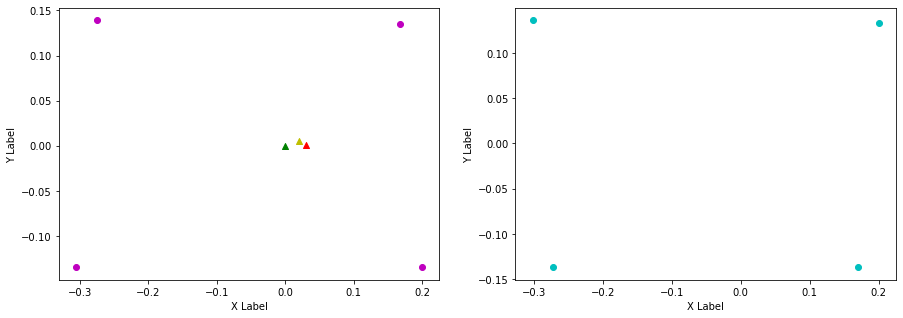

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.2, 0.175, FL (y): 0.133, 0.139.
FL displacement: -0.025000000000000022, 0.006000000000000005.

FR (x): 0.17, 0.205, FR (y): -0.136, -0.134.
FR displacement: 0.034999999999999976, 0.0020000000000000018.

RL (x): -0.302, -0.27, RL (y): 0.136, 0.137.
RL displacement: 0.03199999999999997, 0.0010000000000000009.

RR (x): -0.273, -0.293, RR (y): -0.137, -0.138.
RR displacement: -0.019999999999999962, -0.0010000000000000009.


Base displacement (Foot): [0.025000000000000022, -0.006000000000000005].

Base displacement (Odom): [[0.023640513544542552], [-0.005357023206168432]]. Rotation displacement: 0.12204493197722086.



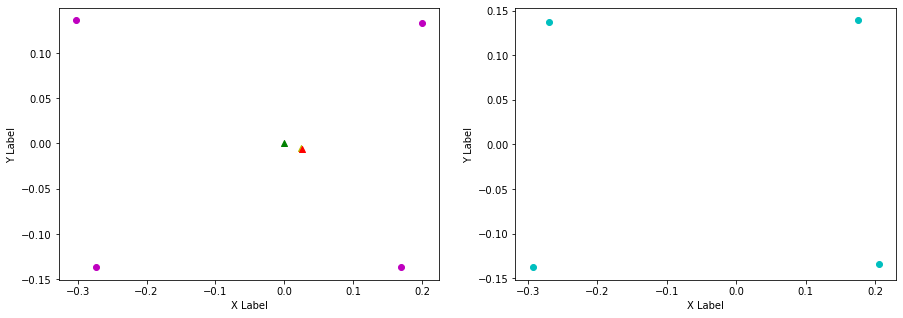

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.175, 0.203, FL (y): 0.139, 0.132.
FL displacement: 0.028000000000000025, -0.007000000000000006.

FR (x): 0.205, 0.179, FR (y): -0.134, -0.138.
FR displacement: -0.025999999999999995, -0.0040000000000000036.

RL (x): -0.27, -0.293, RL (y): 0.137, 0.137.
RL displacement: -0.022999999999999965, 0.0.

RR (x): -0.293, -0.271, RR (y): -0.138, -0.137.
RR displacement: 0.021999999999999964, 0.0010000000000000009.


Base displacement (Foot): [0.025999999999999995, 0.0040000000000000036].

Base displacement (Odom): [[0.027857985889288672], [0.007667920695305475]]. Rotation displacement: -0.9273423506581541.



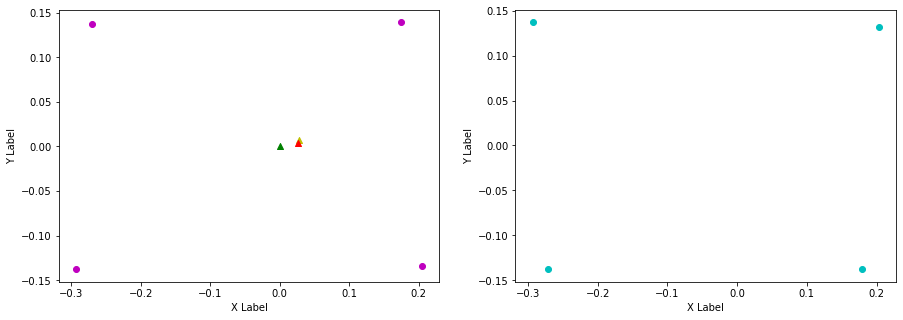

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.203, 0.172, FL (y): 0.132, 0.137.
FL displacement: -0.031000000000000028, 0.0050000000000000044.

FR (x): 0.179, 0.203, FR (y): -0.138, -0.134.
FR displacement: 0.02400000000000002, 0.0040000000000000036.

RL (x): -0.293, -0.272, RL (y): 0.137, 0.139.
RL displacement: 0.020999999999999963, 0.0020000000000000018.

RR (x): -0.271, -0.296, RR (y): -0.137, -0.137.
RR displacement: -0.024999999999999967, 0.0.


Base displacement (Foot): [0.031000000000000028, -0.0050000000000000044].

Base displacement (Odom): [[0.01721724334924768], [-0.005478646722066105]]. Rotation displacement: 0.9451947296580377.



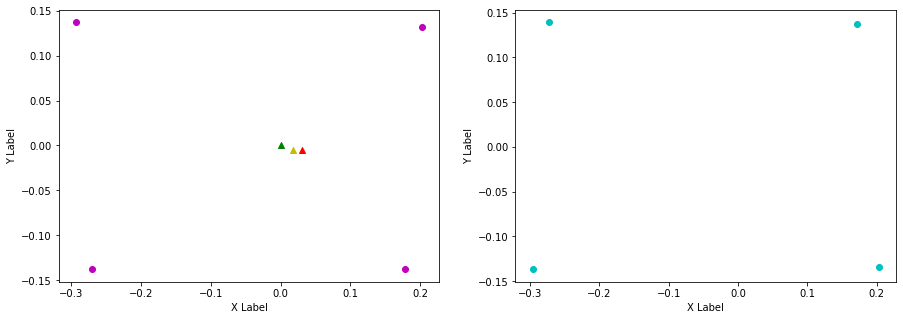

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.172, 0.2, FL (y): 0.137, 0.133.
FL displacement: 0.028000000000000025, -0.0040000000000000036.

FR (x): 0.203, 0.17, FR (y): -0.134, -0.136.
FR displacement: -0.033, -0.0020000000000000018.

RL (x): -0.272, -0.303, RL (y): 0.139, 0.136.
RL displacement: -0.030999999999999972, -0.0030000000000000027.

RR (x): -0.296, -0.273, RR (y): -0.137, -0.137.
RR displacement: 0.022999999999999965, 0.0.


Base displacement (Foot): [0.033, 0.0020000000000000018].

Base displacement (Odom): [[0.02913069192883344], [0.009340932562757864]]. Rotation displacement: -0.9477703458014761.



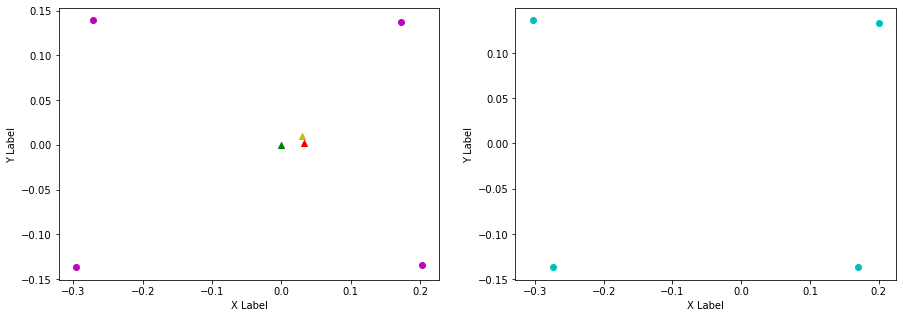

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.2, 0.173, FL (y): 0.133, 0.138.
FL displacement: -0.027000000000000024, 0.0050000000000000044.

FR (x): 0.17, 0.203, FR (y): -0.136, -0.134.
FR displacement: 0.033, 0.0020000000000000018.

RL (x): -0.303, -0.271, RL (y): 0.136, 0.138.
RL displacement: 0.03199999999999997, 0.0020000000000000018.

RR (x): -0.273, -0.296, RR (y): -0.137, -0.137.
RR displacement: -0.022999999999999965, 0.0.


Base displacement (Foot): [0.027000000000000024, -0.0050000000000000044].

Base displacement (Odom): [[0.013280027228506297], [-0.0038437156140267714]]. Rotation displacement: 0.24252696203696714.



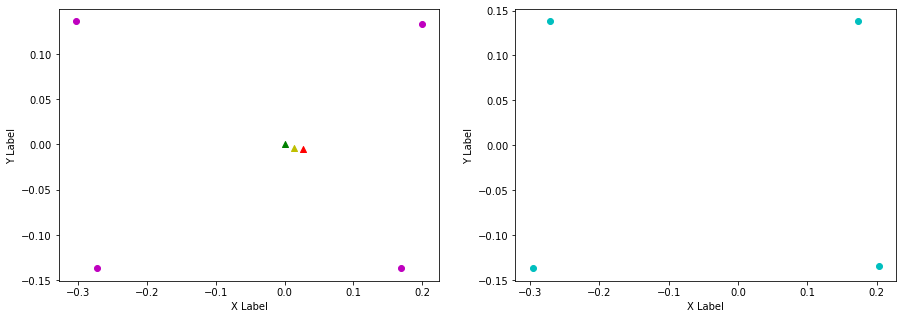

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.173, 0.201, FL (y): 0.138, 0.133.
FL displacement: 0.028000000000000025, -0.0050000000000000044.

FR (x): 0.203, 0.172, FR (y): -0.134, -0.137.
FR displacement: -0.031000000000000028, -0.0030000000000000027.

RL (x): -0.271, -0.3, RL (y): 0.138, 0.136.
RL displacement: -0.02899999999999997, -0.0020000000000000018.

RR (x): -0.296, -0.273, RR (y): -0.137, -0.137.
RR displacement: 0.022999999999999965, 0.0.


Base displacement (Foot): [0.031000000000000028, 0.0030000000000000027].

Base displacement (Odom): [[0.025800036698479856], [0.006892479794527007]]. Rotation displacement: -0.5978626880529385.



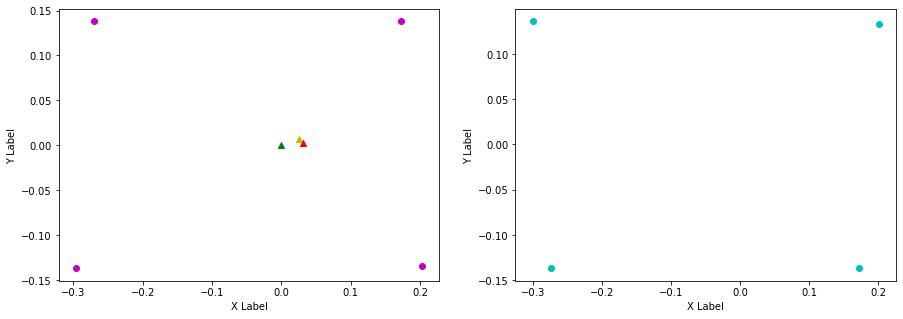

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.201, 0.174, FL (y): 0.133, 0.138.
FL displacement: -0.027000000000000024, 0.0050000000000000044.

FR (x): 0.172, 0.204, FR (y): -0.137, -0.134.
FR displacement: 0.032, 0.0030000000000000027.

RL (x): -0.3, -0.27, RL (y): 0.136, 0.138.
RL displacement: 0.02999999999999997, 0.0020000000000000018.

RR (x): -0.273, -0.294, RR (y): -0.137, -0.138.
RR displacement: -0.020999999999999963, -0.0010000000000000009.


Base displacement (Foot): [0.027000000000000024, -0.0050000000000000044].

Base displacement (Odom): [[0.008102199581038194], [-0.0021762521784952638]]. Rotation displacement: 0.5028394321684558.



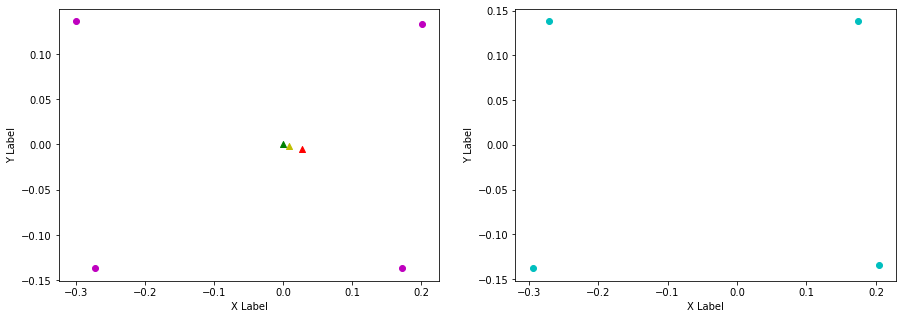

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.174, 0.202, FL (y): 0.138, 0.132.
FL displacement: 0.028000000000000025, -0.006000000000000005.

FR (x): 0.204, 0.177, FR (y): -0.134, -0.137.
FR displacement: -0.026999999999999996, -0.0030000000000000027.

RL (x): -0.27, -0.295, RL (y): 0.138, 0.137.
RL displacement: -0.024999999999999967, -0.0010000000000000009.

RR (x): -0.294, -0.272, RR (y): -0.138, -0.137.
RR displacement: 0.021999999999999964, 0.0010000000000000009.


Base displacement (Foot): [0.026999999999999996, 0.0030000000000000027].

Base displacement (Odom): [[0.007594238939951925], [0.0013185783643797078]]. Rotation displacement: -0.857888564049459.



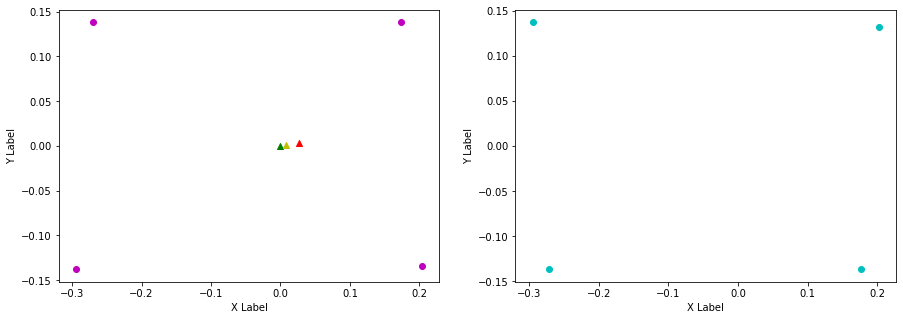

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.202, 0.168, FL (y): 0.132, 0.136.
FL displacement: -0.034, 0.0040000000000000036.

FR (x): 0.177, 0.2, FR (y): -0.137, -0.135.
FR displacement: 0.02300000000000002, 0.0020000000000000018.

RL (x): -0.295, -0.273, RL (y): 0.137, 0.139.
RL displacement: 0.021999999999999964, 0.0020000000000000018.

RR (x): -0.272, -0.303, RR (y): -0.137, -0.136.
RR displacement: -0.030999999999999972, 0.0010000000000000009.


Base displacement (Foot): [0.034, -0.0040000000000000036].

Base displacement (Odom): [[0.02527252044216244], [-0.007895460965863771]]. Rotation displacement: 0.8070591532570485.



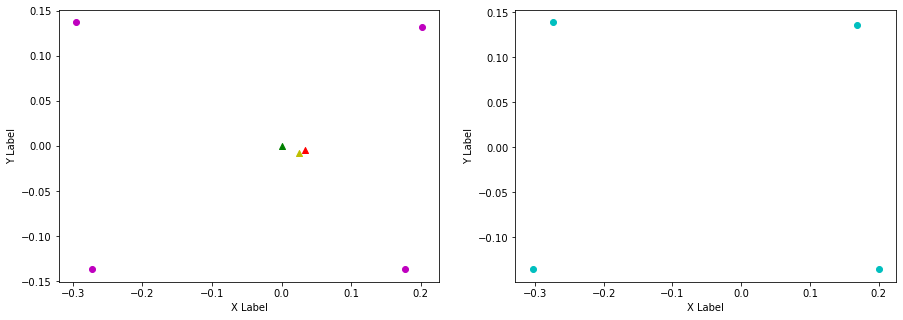

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.168, 0.202, FL (y): 0.136, 0.132.
FL displacement: 0.034, -0.0040000000000000036.

FR (x): 0.2, 0.178, FR (y): -0.135, -0.137.
FR displacement: -0.02200000000000002, -0.0020000000000000018.

RL (x): -0.273, -0.294, RL (y): 0.139, 0.137.
RL displacement: -0.020999999999999963, -0.0020000000000000018.

RR (x): -0.303, -0.271, RR (y): -0.136, -0.137.
RR displacement: 0.03199999999999997, -0.0010000000000000009.


Base displacement (Foot): [0.02200000000000002, 0.0020000000000000018].

Base displacement (Odom): [[0.02549535551496951], [0.007924741377808853]]. Rotation displacement: -0.7597703102080163.



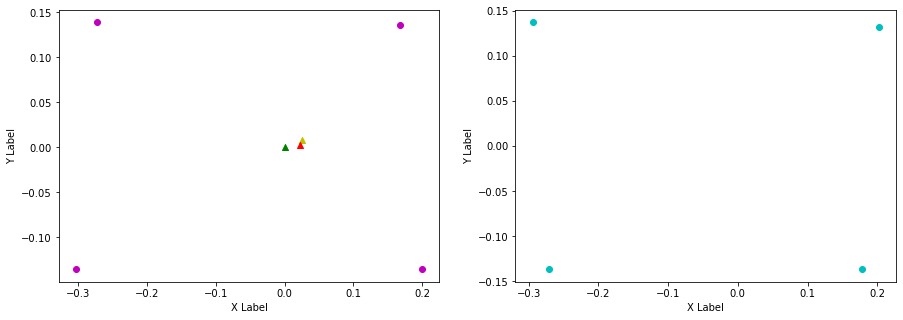

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.202, 0.173, FL (y): 0.132, 0.138.
FL displacement: -0.029000000000000026, 0.006000000000000005.

FR (x): 0.178, 0.204, FR (y): -0.137, -0.134.
FR displacement: 0.025999999999999995, 0.0030000000000000027.

RL (x): -0.294, -0.27, RL (y): 0.137, 0.138.
RL displacement: 0.023999999999999966, 0.0010000000000000009.

RR (x): -0.271, -0.295, RR (y): -0.137, -0.137.
RR displacement: -0.023999999999999966, 0.0.


Base displacement (Foot): [0.029000000000000026, -0.006000000000000005].

Base displacement (Odom): [[0.02335827678376723], [-0.010587247069548111]]. Rotation displacement: 0.7022633978324374.



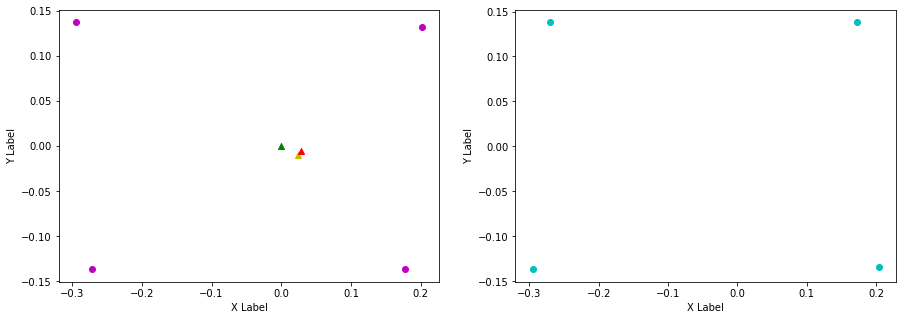

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.173, 0.202, FL (y): 0.138, 0.133.
FL displacement: 0.029000000000000026, -0.0050000000000000044.

FR (x): 0.204, 0.177, FR (y): -0.134, -0.137.
FR displacement: -0.026999999999999996, -0.0030000000000000027.

RL (x): -0.27, -0.295, RL (y): 0.138, 0.136.
RL displacement: -0.024999999999999967, -0.0020000000000000018.

RR (x): -0.295, -0.272, RR (y): -0.137, -0.137.
RR displacement: 0.022999999999999965, 0.0.


Base displacement (Foot): [0.026999999999999996, 0.0030000000000000027].

Base displacement (Odom): [[0.008685150037220257], [0.00226662786126014]]. Rotation displacement: -1.3711895206359415.



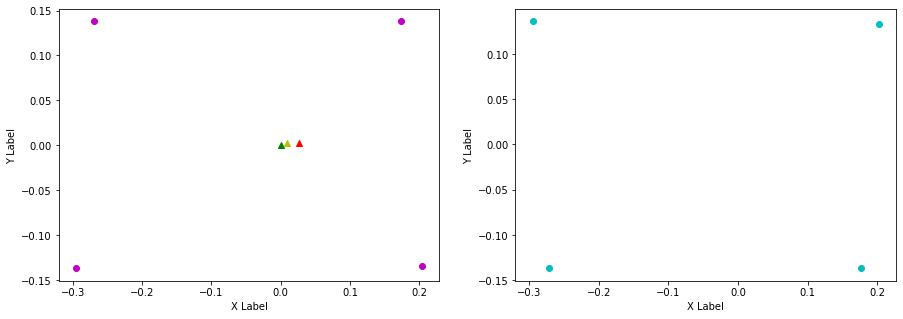

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.202, 0.173, FL (y): 0.133, 0.138.
FL displacement: -0.029000000000000026, 0.0050000000000000044.

FR (x): 0.177, 0.203, FR (y): -0.137, -0.134.
FR displacement: 0.026000000000000023, 0.0030000000000000027.

RL (x): -0.295, -0.271, RL (y): 0.136, 0.138.
RL displacement: 0.023999999999999966, 0.0020000000000000018.

RR (x): -0.272, -0.295, RR (y): -0.137, -0.137.
RR displacement: -0.022999999999999965, 0.0.


Base displacement (Foot): [0.029000000000000026, -0.0050000000000000044].

Base displacement (Odom): [[0.028532334515962043], [-0.009089528991694018]]. Rotation displacement: 0.9056364376762951.



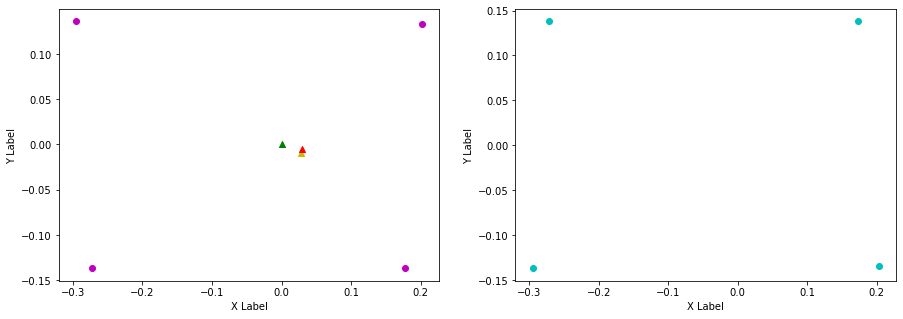

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.173, 0.206, FL (y): 0.138, 0.132.
FL displacement: 0.033, -0.006000000000000005.

FR (x): 0.203, 0.18, FR (y): -0.134, -0.14.
FR displacement: -0.02300000000000002, -0.006000000000000005.

RL (x): -0.271, -0.29, RL (y): 0.138, 0.14.
RL displacement: -0.01899999999999996, 0.0020000000000000018.

RR (x): -0.295, -0.269, RR (y): -0.137, -0.136.
RR displacement: 0.025999999999999968, 0.0010000000000000009.


Base displacement (Foot): [0.02300000000000002, 0.006000000000000005].

Base displacement (Odom): [[0.01567704660057956], [0.004884618732253709]]. Rotation displacement: -1.0631855451613477.



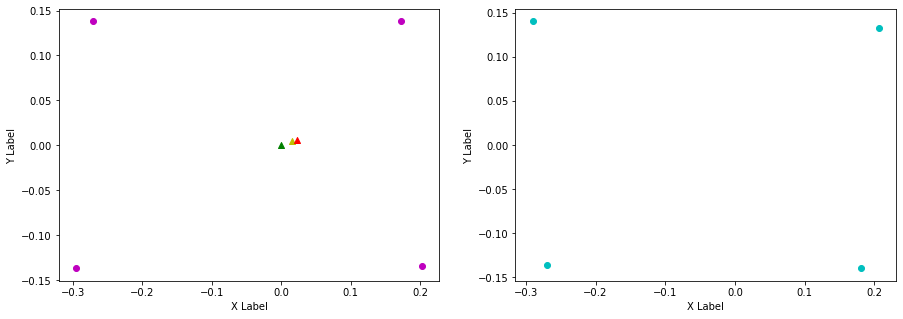

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.206, 0.172, FL (y): 0.132, 0.137.
FL displacement: -0.034, 0.0050000000000000044.

FR (x): 0.18, 0.202, FR (y): -0.14, -0.134.
FR displacement: 0.02200000000000002, 0.006000000000000005.

RL (x): -0.29, -0.272, RL (y): 0.14, 0.138.
RL displacement: 0.01799999999999996, -0.0020000000000000018.

RR (x): -0.269, -0.296, RR (y): -0.136, -0.137.
RR displacement: -0.02699999999999997, -0.0010000000000000009.


Base displacement (Foot): [0.034, -0.0050000000000000044].

Base displacement (Odom): [[0.03416980000639547], [-0.01002882468154398]]. Rotation displacement: 1.0221101701487794.



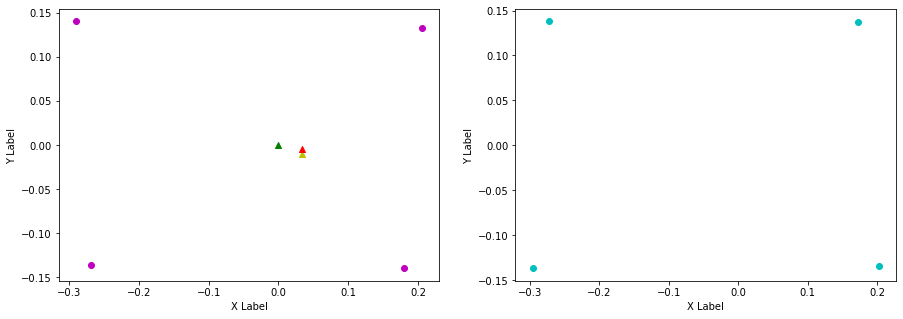

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.172, 0.201, FL (y): 0.137, 0.133.
FL displacement: 0.029000000000000026, -0.0040000000000000036.

FR (x): 0.202, 0.175, FR (y): -0.134, -0.137.
FR displacement: -0.027000000000000024, -0.0030000000000000027.

RL (x): -0.272, -0.297, RL (y): 0.138, 0.136.
RL displacement: -0.024999999999999967, -0.0020000000000000018.

RR (x): -0.296, -0.273, RR (y): -0.137, -0.137.
RR displacement: 0.022999999999999965, 0.0.


Base displacement (Foot): [0.027000000000000024, 0.0030000000000000027].

Base displacement (Odom): [[0.02336256382073465], [0.009294497124609058]]. Rotation displacement: -0.9873526394005036.



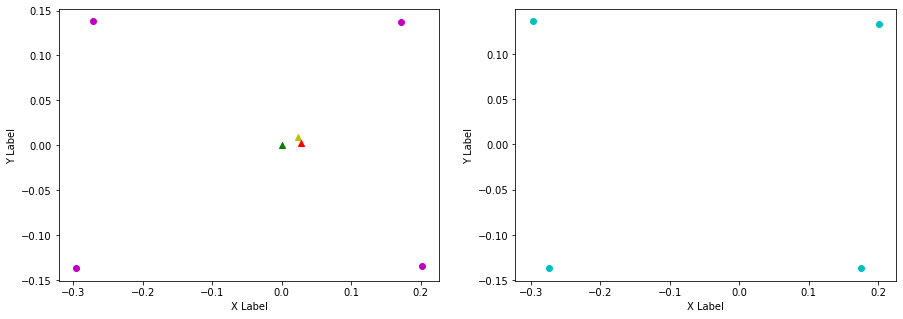

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.201, 0.17, FL (y): 0.133, 0.137.
FL displacement: -0.031, 0.0040000000000000036.

FR (x): 0.175, 0.201, FR (y): -0.137, -0.134.
FR displacement: 0.026000000000000023, 0.0030000000000000027.

RL (x): -0.297, -0.273, RL (y): 0.136, 0.139.
RL displacement: 0.023999999999999966, 0.0030000000000000027.

RR (x): -0.273, -0.3, RR (y): -0.137, -0.136.
RR displacement: -0.02699999999999997, 0.0010000000000000009.


Base displacement (Foot): [0.031, -0.0040000000000000036].

Base displacement (Odom): [[0.01864349834229717], [-0.005173944547645581]]. Rotation displacement: 0.6068913807312084.



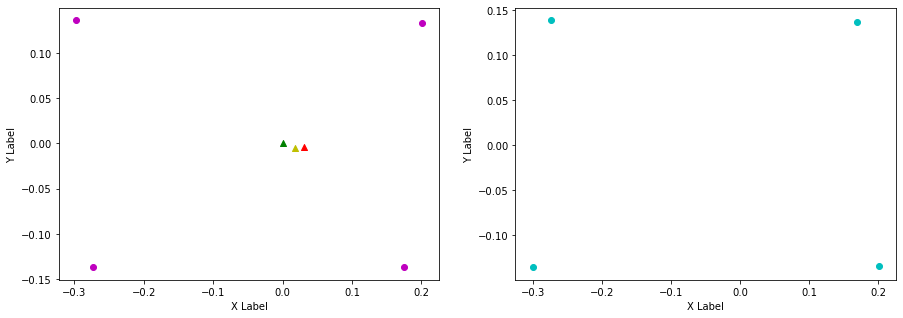

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.17, 0.201, FL (y): 0.137, 0.132.
FL displacement: 0.031, -0.0050000000000000044.

FR (x): 0.201, 0.175, FR (y): -0.134, -0.137.
FR displacement: -0.026000000000000023, -0.0030000000000000027.

RL (x): -0.273, -0.297, RL (y): 0.139, 0.136.
RL displacement: -0.023999999999999966, -0.0030000000000000027.

RR (x): -0.3, -0.273, RR (y): -0.136, -0.137.
RR displacement: 0.02699999999999997, -0.0010000000000000009.


Base displacement (Foot): [0.026000000000000023, 0.0030000000000000027].

Base displacement (Odom): [[0.027505439205843807], [0.005745012678772421]]. Rotation displacement: -0.9756366001390954.



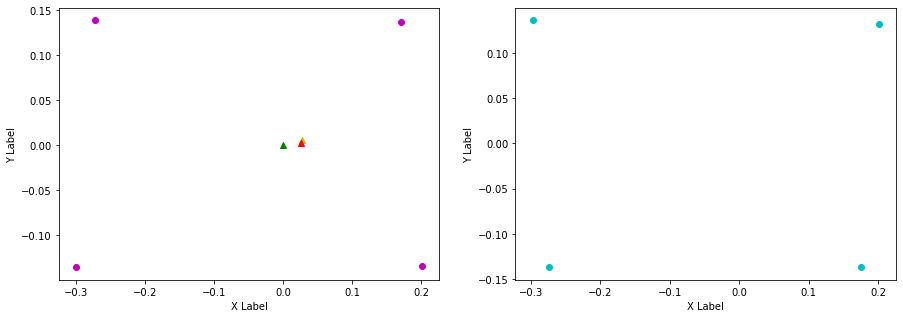

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.201, 0.172, FL (y): 0.132, 0.138.
FL displacement: -0.029000000000000026, 0.006000000000000005.

FR (x): 0.175, 0.202, FR (y): -0.137, -0.134.
FR displacement: 0.027000000000000024, 0.0030000000000000027.

RL (x): -0.297, -0.272, RL (y): 0.136, 0.138.
RL displacement: 0.024999999999999967, 0.0020000000000000018.

RR (x): -0.273, -0.296, RR (y): -0.137, -0.137.
RR displacement: -0.022999999999999965, 0.0.


Base displacement (Foot): [0.029000000000000026, -0.006000000000000005].

Base displacement (Odom): [[0.01701094517786439], [-0.006835577859337472]]. Rotation displacement: 0.887375813318857.



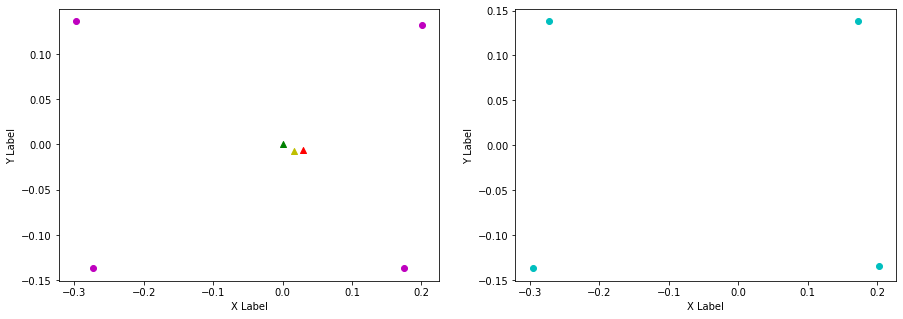

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.172, 0.2, FL (y): 0.138, 0.134.
FL displacement: 0.028000000000000025, -0.0040000000000000036.

FR (x): 0.202, 0.168, FR (y): -0.134, -0.136.
FR displacement: -0.034, -0.0020000000000000018.

RL (x): -0.272, -0.305, RL (y): 0.138, 0.135.
RL displacement: -0.032999999999999974, -0.0030000000000000027.

RR (x): -0.296, -0.273, RR (y): -0.137, -0.137.
RR displacement: 0.022999999999999965, 0.0.


Base displacement (Foot): [0.034, 0.0020000000000000018].

Base displacement (Odom): [[0.010195590668360843], [0.0019482255366027879]]. Rotation displacement: -1.174235961972109.



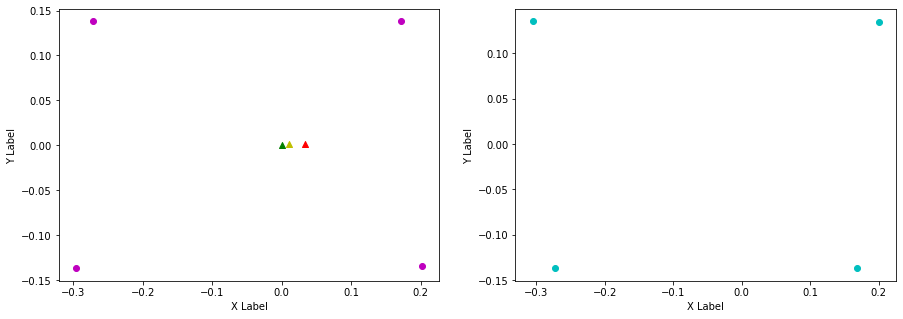

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.2, 0.168, FL (y): 0.134, 0.136.
FL displacement: -0.032, 0.0020000000000000018.

FR (x): 0.168, 0.2, FR (y): -0.136, -0.135.
FR displacement: 0.032, 0.0010000000000000009.

RL (x): -0.305, -0.273, RL (y): 0.135, 0.139.
RL displacement: 0.03199999999999997, 0.0040000000000000036.

RR (x): -0.273, -0.303, RR (y): -0.137, -0.136.
RR displacement: -0.02999999999999997, 0.0010000000000000009.


Base displacement (Foot): [0.032, -0.0020000000000000018].

Base displacement (Odom): [[0.01995333800924115], [-0.004511690721210271]]. Rotation displacement: 0.43159893985615766.



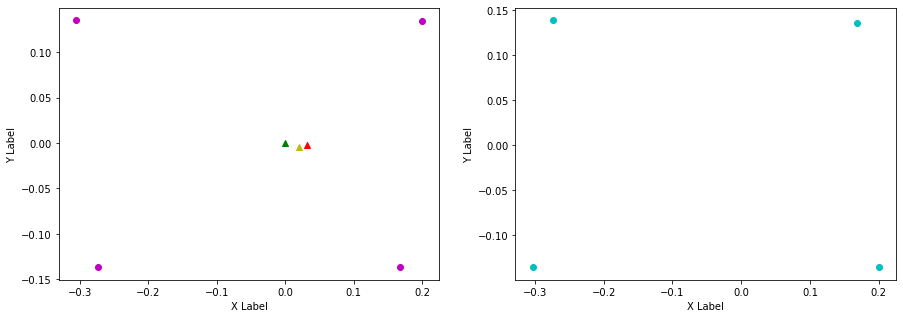

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.168, 0.199, FL (y): 0.136, 0.133.
FL displacement: 0.031, -0.0030000000000000027.

FR (x): 0.2, 0.168, FR (y): -0.135, -0.135.
FR displacement: -0.032, 0.0.

RL (x): -0.273, -0.307, RL (y): 0.139, 0.135.
RL displacement: -0.033999999999999975, -0.0040000000000000036.

RR (x): -0.303, -0.274, RR (y): -0.136, -0.137.
RR displacement: 0.02899999999999997, -0.0010000000000000009.


Base displacement (Foot): [0.032, -0.0].

Base displacement (Odom): [[0.030317649283821524], [0.007233323845691475]]. Rotation displacement: -0.5175124091266672.



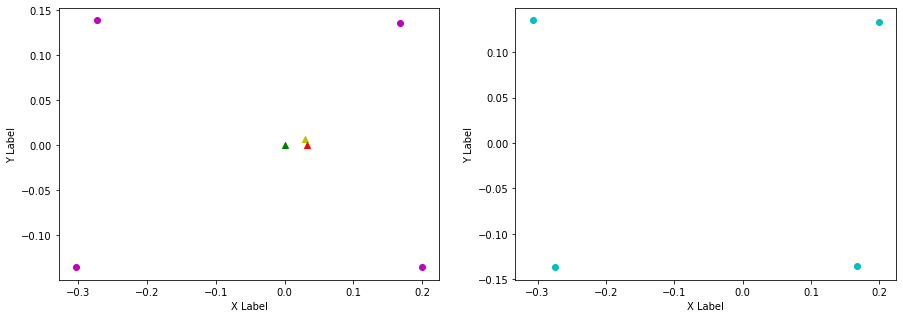

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.199, 0.168, FL (y): 0.133, 0.136.
FL displacement: -0.031, 0.0030000000000000027.

FR (x): 0.168, 0.199, FR (y): -0.135, -0.134.
FR displacement: 0.031, 0.0010000000000000009.

RL (x): -0.307, -0.274, RL (y): 0.135, 0.139.
RL displacement: 0.032999999999999974, 0.0040000000000000036.

RR (x): -0.274, -0.303, RR (y): -0.137, -0.136.
RR displacement: -0.02899999999999997, 0.0010000000000000009.


Base displacement (Foot): [0.031, -0.0030000000000000027].

Base displacement (Odom): [[0.015054704463365987], [-0.006221064918446595]]. Rotation displacement: 0.39996207134017847.



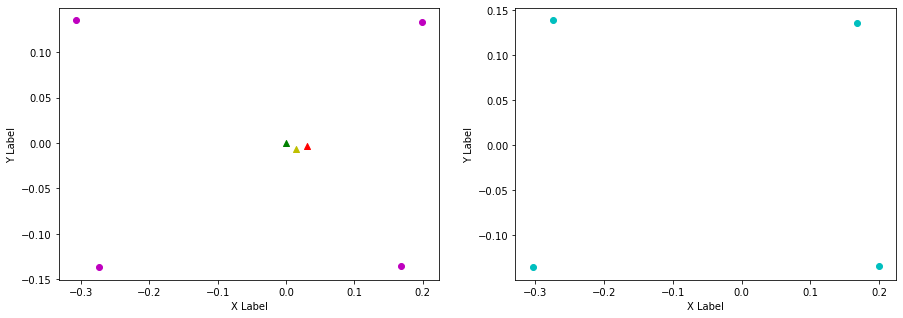

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.168, 0.2, FL (y): 0.136, 0.133.
FL displacement: 0.032, -0.0030000000000000027.

FR (x): 0.199, 0.17, FR (y): -0.134, -0.136.
FR displacement: -0.028999999999999998, -0.0020000000000000018.

RL (x): -0.274, -0.302, RL (y): 0.139, 0.136.
RL displacement: -0.02799999999999997, -0.0030000000000000027.

RR (x): -0.303, -0.273, RR (y): -0.136, -0.137.
RR displacement: 0.02999999999999997, -0.0010000000000000009.


Base displacement (Foot): [0.028999999999999998, 0.0020000000000000018].

Base displacement (Odom): [[0.029895090580025485], [0.007996259651992743]]. Rotation displacement: -0.8765571483284356.



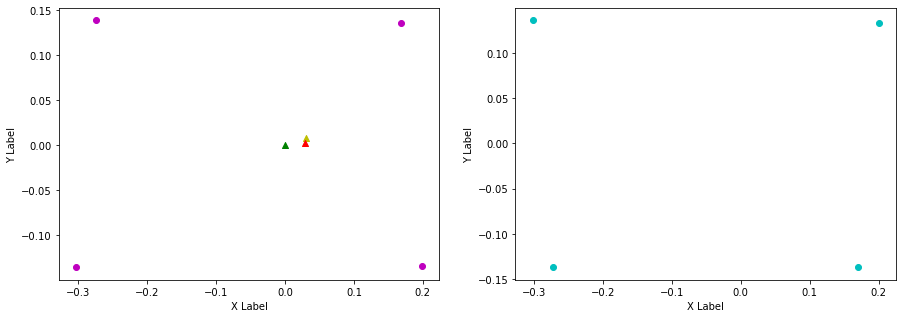

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.2, 0.174, FL (y): 0.133, 0.138.
FL displacement: -0.026000000000000023, 0.0050000000000000044.

FR (x): 0.17, 0.204, FR (y): -0.136, -0.134.
FR displacement: 0.033999999999999975, 0.0020000000000000018.

RL (x): -0.302, -0.271, RL (y): 0.136, 0.138.
RL displacement: 0.030999999999999972, 0.0020000000000000018.

RR (x): -0.273, -0.295, RR (y): -0.137, -0.137.
RR displacement: -0.021999999999999964, 0.0.


Base displacement (Foot): [0.026000000000000023, -0.0050000000000000044].

Base displacement (Odom): [[0.020452713358618535], [-0.004387679446107795]]. Rotation displacement: 0.7528773509937646.



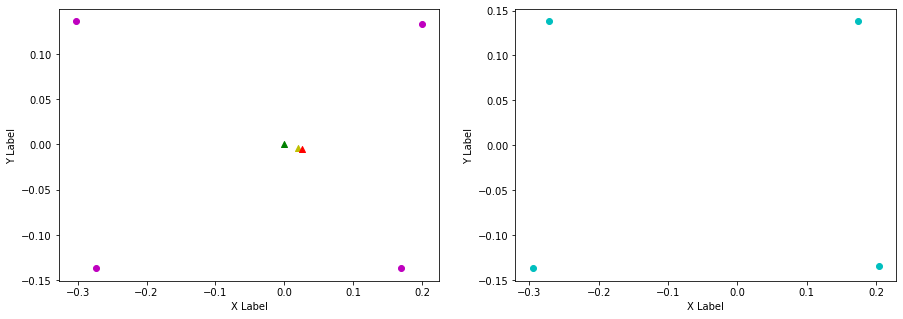

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.174, 0.199, FL (y): 0.138, 0.134.
FL displacement: 0.025000000000000022, -0.0040000000000000036.

FR (x): 0.204, 0.167, FR (y): -0.134, -0.136.
FR displacement: -0.03699999999999998, -0.0020000000000000018.

RL (x): -0.271, -0.307, RL (y): 0.138, 0.135.
RL displacement: -0.035999999999999976, -0.0030000000000000027.

RR (x): -0.295, -0.274, RR (y): -0.137, -0.137.
RR displacement: 0.020999999999999963, 0.0.


Base displacement (Foot): [0.03699999999999998, 0.0020000000000000018].

Base displacement (Odom): [[0.02305570599486062], [0.005311537983533121]]. Rotation displacement: -1.0560923718102913.



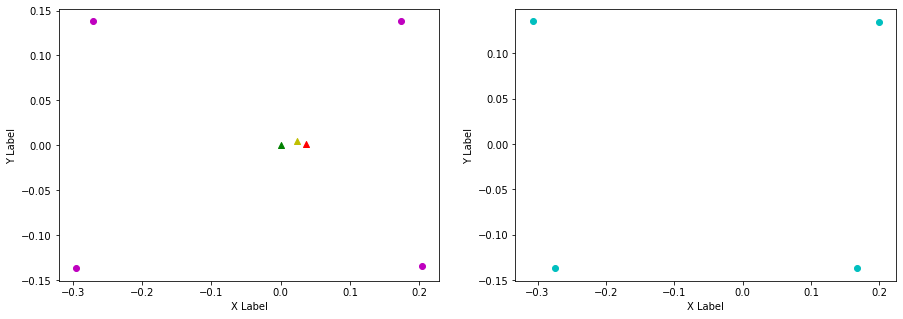

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.199, 0.168, FL (y): 0.134, 0.136.
FL displacement: -0.031, 0.0020000000000000018.

FR (x): 0.167, 0.2, FR (y): -0.136, -0.135.
FR displacement: 0.033, 0.0010000000000000009.

RL (x): -0.307, -0.273, RL (y): 0.135, 0.139.
RL displacement: 0.033999999999999975, 0.0040000000000000036.

RR (x): -0.274, -0.304, RR (y): -0.137, -0.136.
RR displacement: -0.02999999999999997, 0.0010000000000000009.


Base displacement (Foot): [0.031, -0.0020000000000000018].

Base displacement (Odom): [[0.01915088831904521], [-0.0038387144114157556]]. Rotation displacement: 0.3554976849070409.



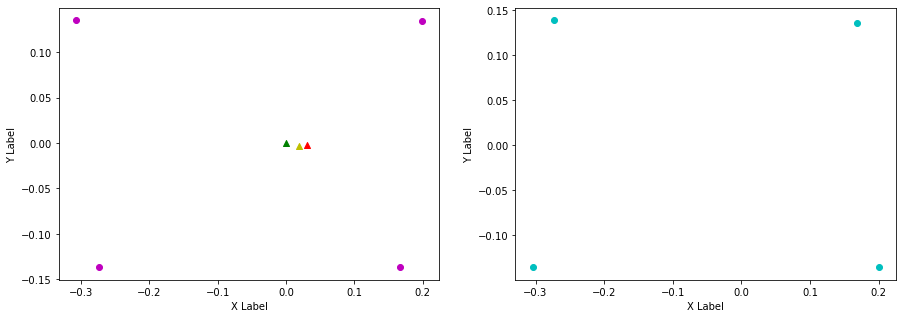

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.168, 0.2, FL (y): 0.136, 0.133.
FL displacement: 0.032, -0.0030000000000000027.

FR (x): 0.2, 0.17, FR (y): -0.135, -0.136.
FR displacement: -0.03, -0.0010000000000000009.

RL (x): -0.273, -0.303, RL (y): 0.139, 0.136.
RL displacement: -0.02999999999999997, -0.0030000000000000027.

RR (x): -0.304, -0.273, RR (y): -0.136, -0.137.
RR displacement: 0.030999999999999972, -0.0010000000000000009.


Base displacement (Foot): [0.03, 0.0010000000000000009].

Base displacement (Odom): [[0.017799362102369987], [0.0048291191028626]]. Rotation displacement: -0.4766000119640105.



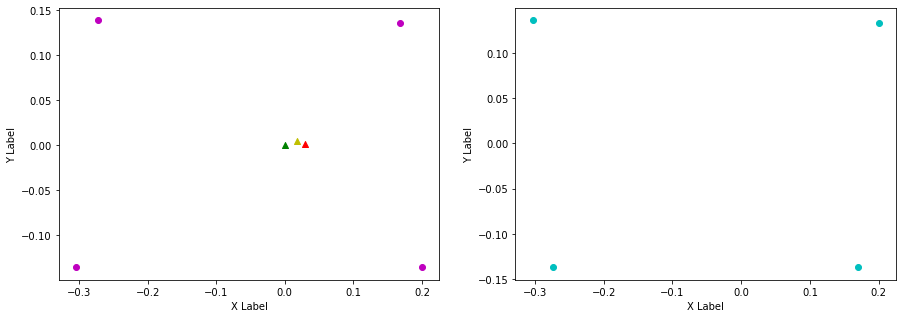

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.2, 0.17, FL (y): 0.133, 0.137.
FL displacement: -0.03, 0.0040000000000000036.

FR (x): 0.17, 0.201, FR (y): -0.136, -0.134.
FR displacement: 0.031, 0.0020000000000000018.

RL (x): -0.303, -0.273, RL (y): 0.136, 0.139.
RL displacement: 0.02999999999999997, 0.0030000000000000027.

RR (x): -0.273, -0.299, RR (y): -0.137, -0.136.
RR displacement: -0.025999999999999968, 0.0010000000000000009.


Base displacement (Foot): [0.03, -0.0040000000000000036].

Base displacement (Odom): [[0.017460241329702253], [-0.005516478155550453]]. Rotation displacement: 0.3548558473102496.



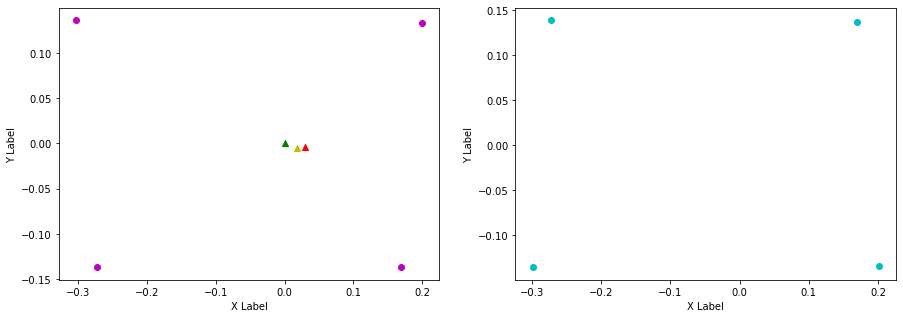

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.17, 0.203, FL (y): 0.137, 0.132.
FL displacement: 0.033, -0.0050000000000000044.

FR (x): 0.201, 0.179, FR (y): -0.134, -0.138.
FR displacement: -0.02200000000000002, -0.0040000000000000036.

RL (x): -0.273, -0.293, RL (y): 0.139, 0.137.
RL displacement: -0.019999999999999962, -0.0020000000000000018.

RR (x): -0.299, -0.271, RR (y): -0.136, -0.137.
RR displacement: 0.02799999999999997, -0.0010000000000000009.


Base displacement (Foot): [0.02200000000000002, 0.0040000000000000036].

Base displacement (Odom): [[0.010437619976142454], [0.0012315735727619348]]. Rotation displacement: -0.26862870711761655.



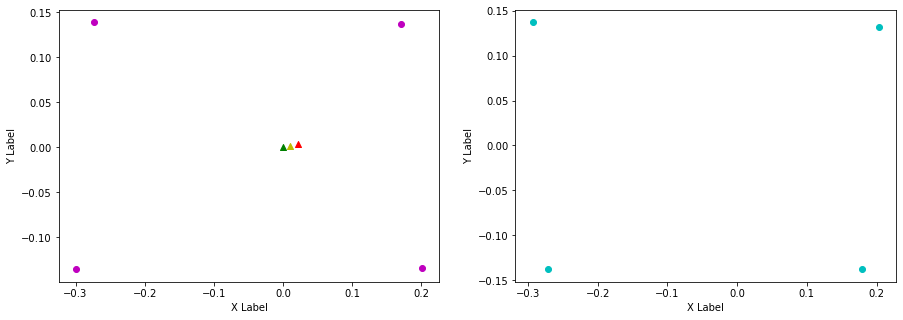

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.203, 0.174, FL (y): 0.132, 0.138.
FL displacement: -0.029000000000000026, 0.006000000000000005.

FR (x): 0.179, 0.204, FR (y): -0.138, -0.134.
FR displacement: 0.024999999999999994, 0.0040000000000000036.

RL (x): -0.293, -0.271, RL (y): 0.137, 0.138.
RL displacement: 0.021999999999999964, 0.0010000000000000009.

RR (x): -0.271, -0.294, RR (y): -0.137, -0.137.
RR displacement: -0.022999999999999965, 0.0.


Base displacement (Foot): [0.029000000000000026, -0.006000000000000005].

Base displacement (Odom): [[0.022371133677772104], [-0.006943777086058145]]. Rotation displacement: 0.5921689763172016.



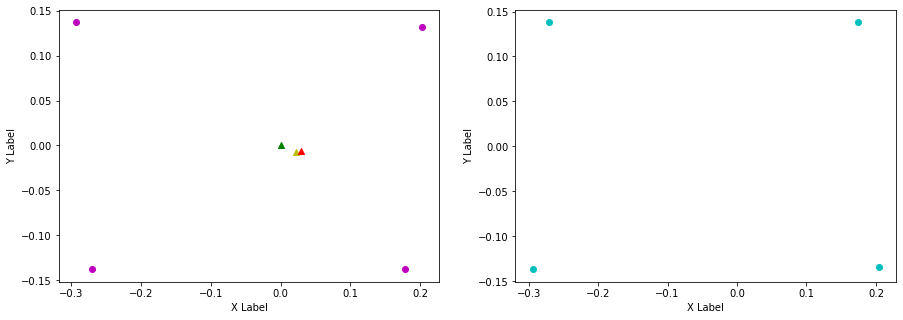

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.174, 0.203, FL (y): 0.138, 0.132.
FL displacement: 0.029000000000000026, -0.006000000000000005.

FR (x): 0.204, 0.179, FR (y): -0.134, -0.138.
FR displacement: -0.024999999999999994, -0.0040000000000000036.

RL (x): -0.271, -0.292, RL (y): 0.138, 0.137.
RL displacement: -0.020999999999999963, -0.0010000000000000009.

RR (x): -0.294, -0.271, RR (y): -0.137, -0.137.
RR displacement: 0.022999999999999965, 0.0.


Base displacement (Foot): [0.024999999999999994, 0.0040000000000000036].

Base displacement (Odom): [[0.02208564144013936], [0.005272441626909319]]. Rotation displacement: -1.4928766709150472.



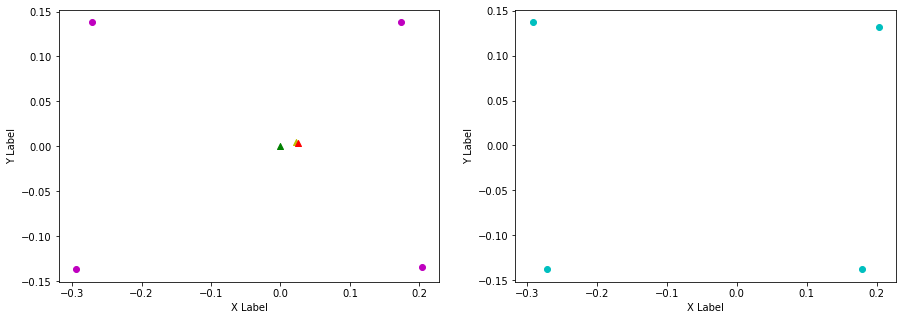

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.203, 0.167, FL (y): 0.132, 0.136.
FL displacement: -0.036000000000000004, 0.0040000000000000036.

FR (x): 0.179, 0.2, FR (y): -0.138, -0.135.
FR displacement: 0.02100000000000002, 0.0030000000000000027.

RL (x): -0.292, -0.274, RL (y): 0.137, 0.139.
RL displacement: 0.01799999999999996, 0.0020000000000000018.

RR (x): -0.271, -0.305, RR (y): -0.137, -0.135.
RR displacement: -0.033999999999999975, 0.0020000000000000018.


Base displacement (Foot): [0.036000000000000004, -0.0040000000000000036].

Base displacement (Odom): [[0.013138899778541546], [-0.0028735927708968267]]. Rotation displacement: 0.9067772559079861.



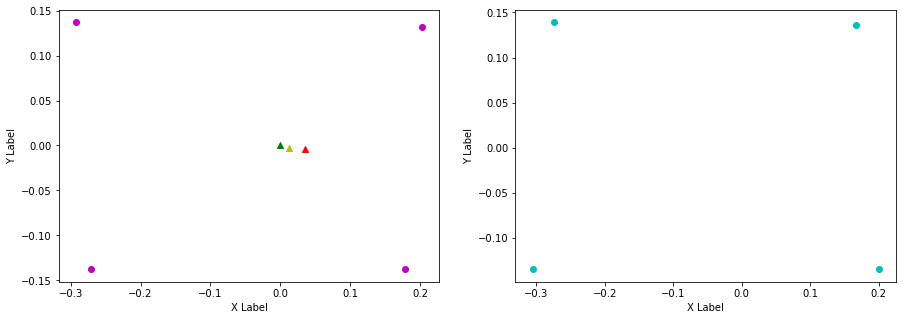

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.167, 0.202, FL (y): 0.136, 0.132.
FL displacement: 0.035, -0.0040000000000000036.

FR (x): 0.2, 0.179, FR (y): -0.135, -0.137.
FR displacement: -0.02100000000000002, -0.0020000000000000018.

RL (x): -0.274, -0.293, RL (y): 0.139, 0.137.
RL displacement: -0.01899999999999996, -0.0020000000000000018.

RR (x): -0.305, -0.271, RR (y): -0.135, -0.137.
RR displacement: 0.033999999999999975, -0.0020000000000000018.


Base displacement (Foot): [0.02100000000000002, 0.0020000000000000018].

Base displacement (Odom): [[0.02178254422160597], [0.006470732743190932]]. Rotation displacement: -0.5377154051447335.



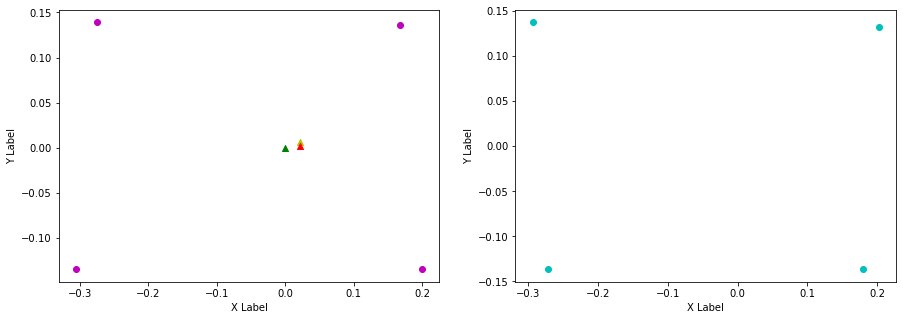

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.202, 0.177, FL (y): 0.132, 0.14.
FL displacement: -0.025000000000000022, 0.008000000000000007.

FR (x): 0.179, 0.206, FR (y): -0.137, -0.133.
FR displacement: 0.026999999999999996, 0.0040000000000000036.

RL (x): -0.293, -0.269, RL (y): 0.137, 0.136.
RL displacement: 0.023999999999999966, -0.0010000000000000009.

RR (x): -0.271, -0.291, RR (y): -0.137, -0.139.
RR displacement: -0.019999999999999962, -0.0020000000000000018.


Base displacement (Foot): [0.025000000000000022, -0.008000000000000007].

Base displacement (Odom): [[0.01855542922562048], [-0.005553863510579182]]. Rotation displacement: 0.17681680917486908.



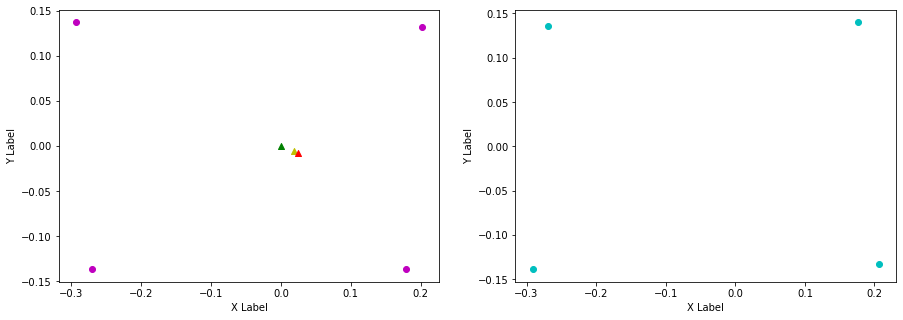

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.177, 0.2, FL (y): 0.14, 0.133.
FL displacement: 0.02300000000000002, -0.007000000000000006.

FR (x): 0.206, 0.17, FR (y): -0.133, -0.136.
FR displacement: -0.035999999999999976, -0.0030000000000000027.

RL (x): -0.269, -0.302, RL (y): 0.136, 0.136.
RL displacement: -0.032999999999999974, 0.0.

RR (x): -0.291, -0.274, RR (y): -0.139, -0.137.
RR displacement: 0.01699999999999996, 0.0020000000000000018.


Base displacement (Foot): [0.035999999999999976, 0.0030000000000000027].

Base displacement (Odom): [[0.024987623344894683], [0.009301514447056514]]. Rotation displacement: -1.0671767941103314.



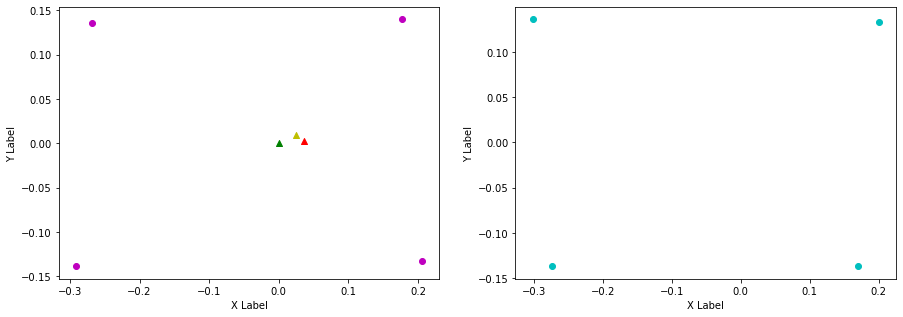

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.2, 0.171, FL (y): 0.133, 0.137.
FL displacement: -0.028999999999999998, 0.0040000000000000036.

FR (x): 0.17, 0.202, FR (y): -0.136, -0.134.
FR displacement: 0.032, 0.0020000000000000018.

RL (x): -0.302, -0.272, RL (y): 0.136, 0.139.
RL displacement: 0.02999999999999997, 0.0030000000000000027.

RR (x): -0.274, -0.298, RR (y): -0.137, -0.137.
RR displacement: -0.023999999999999966, 0.0.


Base displacement (Foot): [0.028999999999999998, -0.0040000000000000036].

Base displacement (Odom): [[0.021018270346716772], [-0.006104419494943114]]. Rotation displacement: 1.102707929081248.



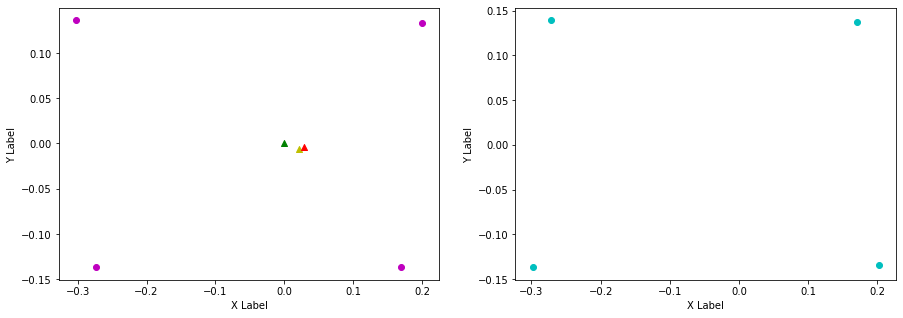

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.171, 0.2, FL (y): 0.137, 0.134.
FL displacement: 0.028999999999999998, -0.0030000000000000027.

FR (x): 0.202, 0.17, FR (y): -0.134, -0.136.
FR displacement: -0.032, -0.0020000000000000018.

RL (x): -0.272, -0.304, RL (y): 0.139, 0.135.
RL displacement: -0.03199999999999997, -0.0040000000000000036.

RR (x): -0.298, -0.274, RR (y): -0.137, -0.137.
RR displacement: 0.023999999999999966, 0.0.


Base displacement (Foot): [0.032, 0.0020000000000000018].

Base displacement (Odom): [[0.02163543709884852], [0.007039729526005234]]. Rotation displacement: -1.286398693456817.



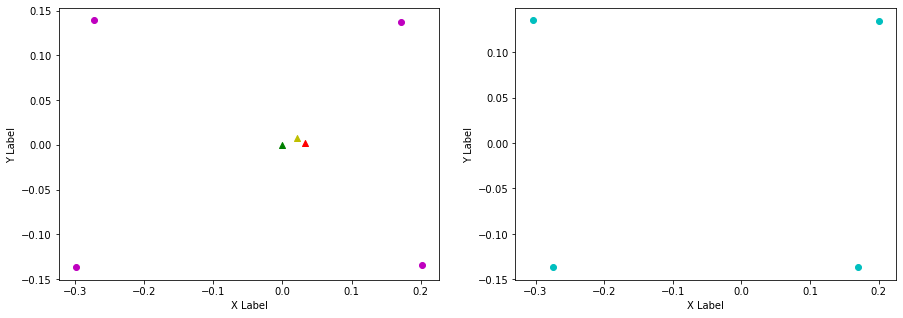

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.2, 0.172, FL (y): 0.134, 0.138.
FL displacement: -0.028000000000000025, 0.0040000000000000036.

FR (x): 0.17, 0.203, FR (y): -0.136, -0.134.
FR displacement: 0.033, 0.0020000000000000018.

RL (x): -0.304, -0.271, RL (y): 0.135, 0.138.
RL displacement: 0.032999999999999974, 0.0030000000000000027.

RR (x): -0.274, -0.296, RR (y): -0.137, -0.137.
RR displacement: -0.021999999999999964, 0.0.


Base displacement (Foot): [0.028000000000000025, -0.0040000000000000036].

Base displacement (Odom): [[0.00808852133752902], [-0.00211600123199851]]. Rotation displacement: -0.01469083699211523.



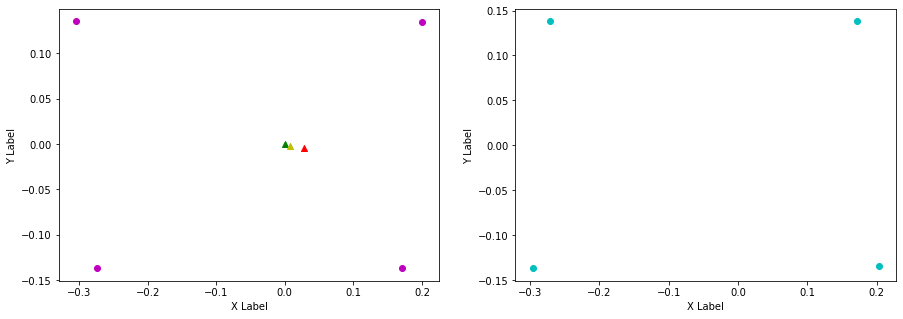

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.172, 0.2, FL (y): 0.138, 0.134.
FL displacement: 0.028000000000000025, -0.0040000000000000036.

FR (x): 0.203, 0.167, FR (y): -0.134, -0.136.
FR displacement: -0.036000000000000004, -0.0020000000000000018.

RL (x): -0.271, -0.307, RL (y): 0.138, 0.135.
RL displacement: -0.035999999999999976, -0.0030000000000000027.

RR (x): -0.296, -0.274, RR (y): -0.137, -0.138.
RR displacement: 0.021999999999999964, -0.0010000000000000009.


Base displacement (Foot): [0.036000000000000004, 0.0020000000000000018].

Base displacement (Odom): [[0.02140041937471171], [0.004820319766806358]]. Rotation displacement: -0.08548408122481474.



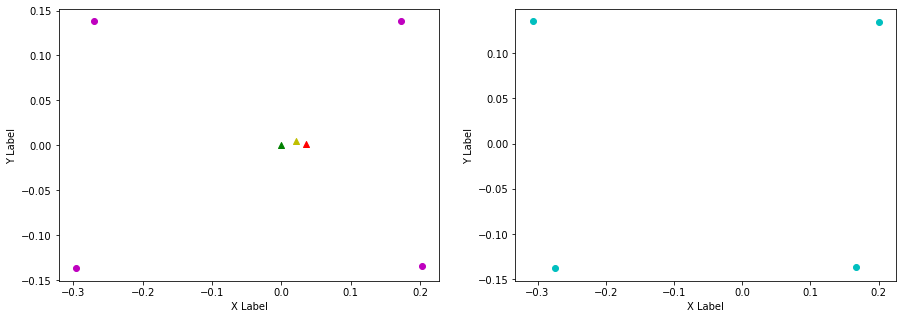

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.2, 0.17, FL (y): 0.134, 0.137.
FL displacement: -0.03, 0.0030000000000000027.

FR (x): 0.167, 0.201, FR (y): -0.136, -0.134.
FR displacement: 0.034, 0.0020000000000000018.

RL (x): -0.307, -0.273, RL (y): 0.135, 0.139.
RL displacement: 0.033999999999999975, 0.0040000000000000036.

RR (x): -0.274, -0.3, RR (y): -0.138, -0.136.
RR displacement: -0.025999999999999968, 0.0020000000000000018.


Base displacement (Foot): [0.03, -0.0030000000000000027].

Base displacement (Odom): [[0.009783289163043385], [-0.005937051371931401]]. Rotation displacement: 0.251372376604686.



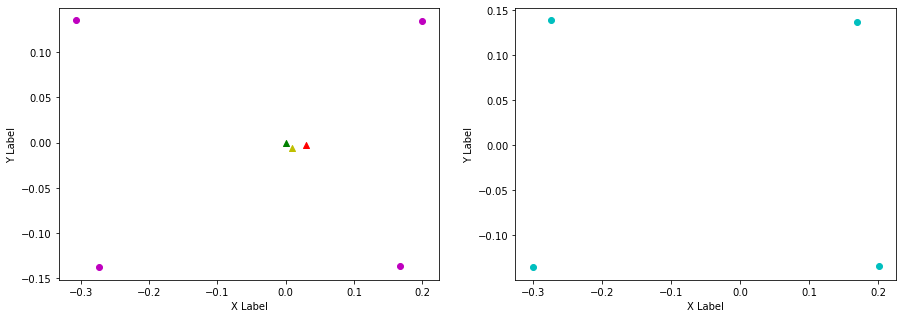

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.17, 0.2, FL (y): 0.137, 0.133.
FL displacement: 0.03, -0.0040000000000000036.

FR (x): 0.201, 0.17, FR (y): -0.134, -0.136.
FR displacement: -0.031, -0.0020000000000000018.

RL (x): -0.273, -0.303, RL (y): 0.139, 0.135.
RL displacement: -0.02999999999999997, -0.0040000000000000036.

RR (x): -0.3, -0.273, RR (y): -0.136, -0.137.
RR displacement: 0.02699999999999997, -0.0010000000000000009.


Base displacement (Foot): [0.031, 0.0020000000000000018].

Base displacement (Odom): [[0.011104498626736792], [0.00436545902956087]]. Rotation displacement: -0.06888402483417565.



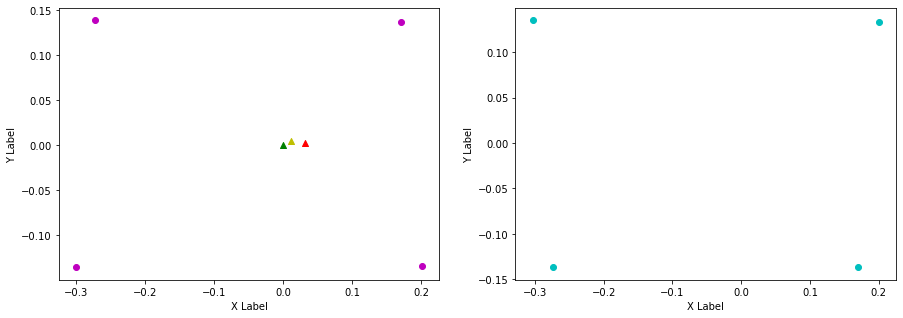

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.2, 0.173, FL (y): 0.133, 0.138.
FL displacement: -0.027000000000000024, 0.0050000000000000044.

FR (x): 0.17, 0.203, FR (y): -0.136, -0.134.
FR displacement: 0.033, 0.0020000000000000018.

RL (x): -0.303, -0.271, RL (y): 0.135, 0.139.
RL displacement: 0.03199999999999997, 0.0040000000000000036.

RR (x): -0.273, -0.295, RR (y): -0.137, -0.137.
RR displacement: -0.021999999999999964, 0.0.


Base displacement (Foot): [0.027000000000000024, -0.0050000000000000044].

Base displacement (Odom): [[0.015158525382057864], [-0.0030776573464170176]]. Rotation displacement: -0.5359929534263681.



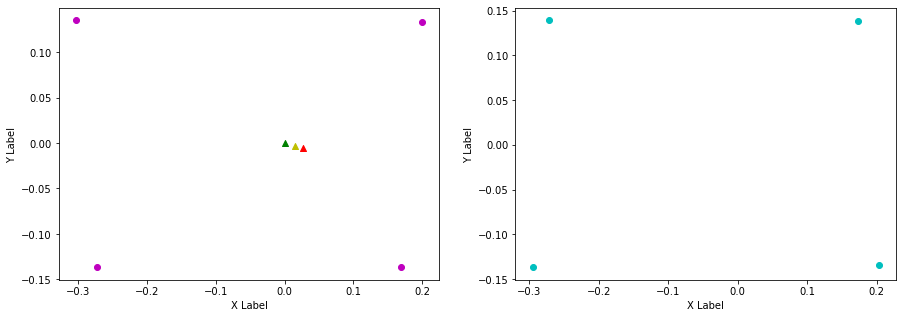

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.173, 0.203, FL (y): 0.138, 0.132.
FL displacement: 0.030000000000000027, -0.006000000000000005.

FR (x): 0.203, 0.18, FR (y): -0.134, -0.137.
FR displacement: -0.02300000000000002, -0.0030000000000000027.

RL (x): -0.271, -0.293, RL (y): 0.139, 0.137.
RL displacement: -0.021999999999999964, -0.0020000000000000018.

RR (x): -0.295, -0.272, RR (y): -0.137, -0.137.
RR displacement: 0.022999999999999965, 0.0.


Base displacement (Foot): [0.02300000000000002, 0.0030000000000000027].

Base displacement (Odom): [[0.022498182545220846], [0.0062418144580794754]]. Rotation displacement: -0.1688168512510871.



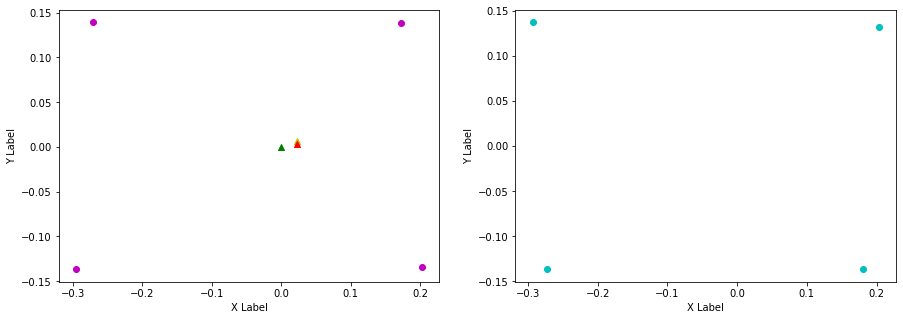

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.203, 0.174, FL (y): 0.132, 0.138.
FL displacement: -0.029000000000000026, 0.006000000000000005.

FR (x): 0.18, 0.203, FR (y): -0.137, -0.134.
FR displacement: 0.02300000000000002, 0.0030000000000000027.

RL (x): -0.293, -0.271, RL (y): 0.137, 0.138.
RL displacement: 0.021999999999999964, 0.0010000000000000009.

RR (x): -0.272, -0.294, RR (y): -0.137, -0.137.
RR displacement: -0.021999999999999964, 0.0.


Base displacement (Foot): [0.029000000000000026, -0.006000000000000005].

Base displacement (Odom): [[0.02927409880099674], [-0.008037585522194579]]. Rotation displacement: 0.8175738763442801.



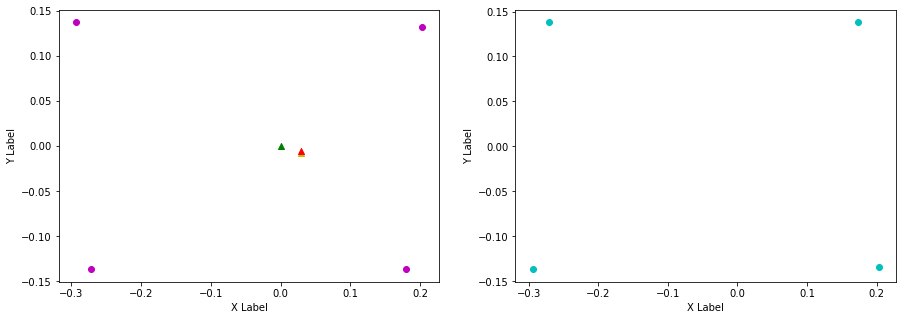

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.174, 0.203, FL (y): 0.138, 0.132.
FL displacement: 0.029000000000000026, -0.006000000000000005.

FR (x): 0.203, 0.18, FR (y): -0.134, -0.138.
FR displacement: -0.02300000000000002, -0.0040000000000000036.

RL (x): -0.271, -0.292, RL (y): 0.138, 0.137.
RL displacement: -0.020999999999999963, -0.0010000000000000009.

RR (x): -0.294, -0.271, RR (y): -0.137, -0.136.
RR displacement: 0.022999999999999965, 0.0010000000000000009.


Base displacement (Foot): [0.02300000000000002, 0.0040000000000000036].

Base displacement (Odom): [[0.021663802528272935], [0.006753892195982714]]. Rotation displacement: -1.2875360225380228.



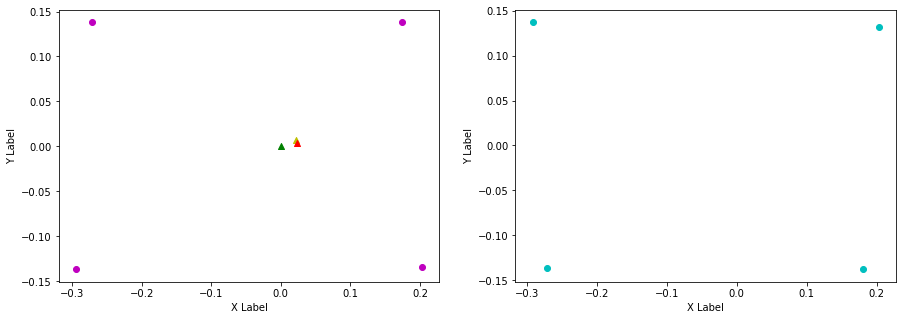

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.203, 0.176, FL (y): 0.132, 0.139.
FL displacement: -0.027000000000000024, 0.007000000000000006.

FR (x): 0.18, 0.205, FR (y): -0.138, -0.133.
FR displacement: 0.024999999999999994, 0.0050000000000000044.

RL (x): -0.292, -0.27, RL (y): 0.137, 0.137.
RL displacement: 0.021999999999999964, 0.0.

RR (x): -0.271, -0.292, RR (y): -0.136, -0.138.
RR displacement: -0.020999999999999963, -0.0020000000000000018.


Base displacement (Foot): [0.027000000000000024, -0.007000000000000006].

Base displacement (Odom): [[0.01775147611989647], [-0.007833806923971842]]. Rotation displacement: 0.5927720816161995.



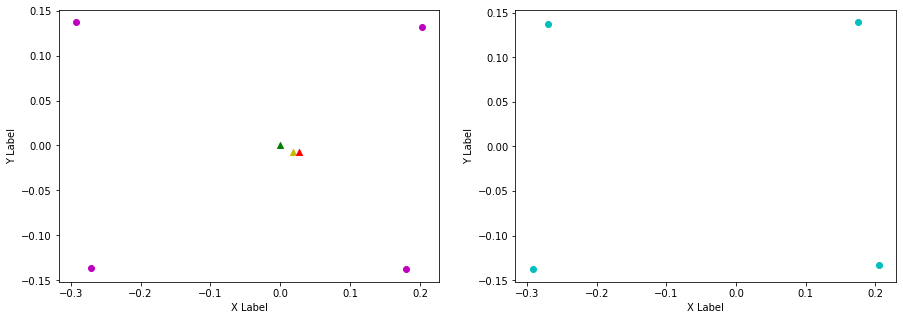

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.176, 0.2, FL (y): 0.139, 0.132.
FL displacement: 0.02400000000000002, -0.007000000000000006.

FR (x): 0.205, 0.171, FR (y): -0.133, -0.136.
FR displacement: -0.033999999999999975, -0.0030000000000000027.

RL (x): -0.27, -0.3, RL (y): 0.137, 0.136.
RL displacement: -0.02999999999999997, -0.0010000000000000009.

RR (x): -0.292, -0.273, RR (y): -0.138, -0.137.
RR displacement: 0.01899999999999996, 0.0010000000000000009.


Base displacement (Foot): [0.033999999999999975, 0.0030000000000000027].

Base displacement (Odom): [[0.013861965214915006], [0.004565397978927466]]. Rotation displacement: -1.0088007515279014.



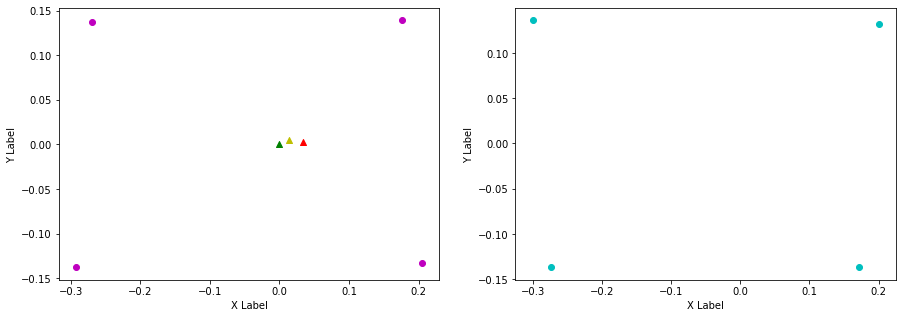

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.2, 0.169, FL (y): 0.132, 0.136.
FL displacement: -0.031, 0.0040000000000000036.

FR (x): 0.171, 0.201, FR (y): -0.136, -0.135.
FR displacement: 0.03, 0.0010000000000000009.

RL (x): -0.3, -0.273, RL (y): 0.136, 0.139.
RL displacement: 0.02699999999999997, 0.0030000000000000027.

RR (x): -0.273, -0.301, RR (y): -0.137, -0.136.
RR displacement: -0.02799999999999997, 0.0010000000000000009.


Base displacement (Foot): [0.031, -0.0040000000000000036].

Base displacement (Odom): [[0.01107225161671277], [-0.005339408614577212]]. Rotation displacement: 0.8510490191032972.



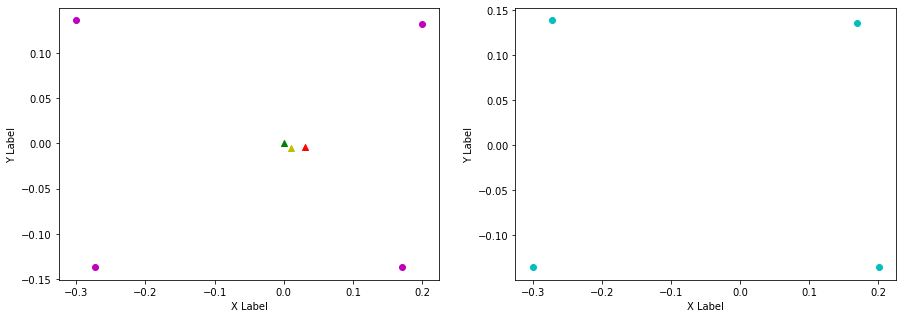

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.169, 0.202, FL (y): 0.136, 0.132.
FL displacement: 0.033, -0.0040000000000000036.

FR (x): 0.201, 0.177, FR (y): -0.135, -0.137.
FR displacement: -0.02400000000000002, -0.0020000000000000018.

RL (x): -0.273, -0.295, RL (y): 0.139, 0.137.
RL displacement: -0.021999999999999964, -0.0020000000000000018.

RR (x): -0.301, -0.272, RR (y): -0.136, -0.137.
RR displacement: 0.02899999999999997, -0.0010000000000000009.


Base displacement (Foot): [0.02400000000000002, 0.0020000000000000018].

Base displacement (Odom): [[0.013016914427690818], [0.0033080439154974384]]. Rotation displacement: -0.7853345666685433.



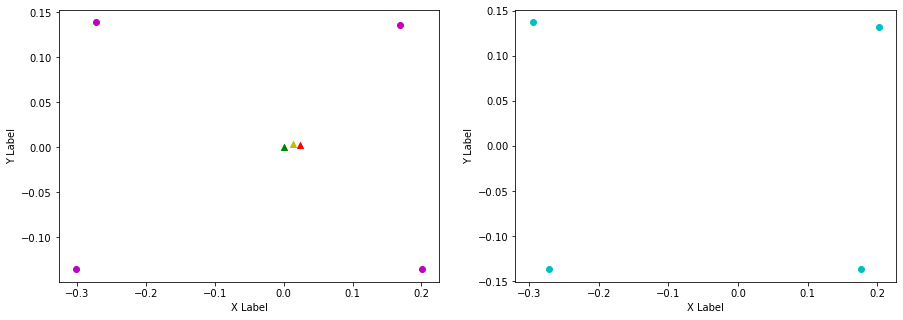

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.202, 0.173, FL (y): 0.132, 0.138.
FL displacement: -0.029000000000000026, 0.006000000000000005.

FR (x): 0.177, 0.203, FR (y): -0.137, -0.134.
FR displacement: 0.026000000000000023, 0.0030000000000000027.

RL (x): -0.295, -0.271, RL (y): 0.137, 0.138.
RL displacement: 0.023999999999999966, 0.0010000000000000009.

RR (x): -0.272, -0.295, RR (y): -0.137, -0.137.
RR displacement: -0.022999999999999965, 0.0.


Base displacement (Foot): [0.029000000000000026, -0.006000000000000005].

Base displacement (Odom): [[0.025407399982900092], [-0.008967724247187225]]. Rotation displacement: 0.764054693870474.



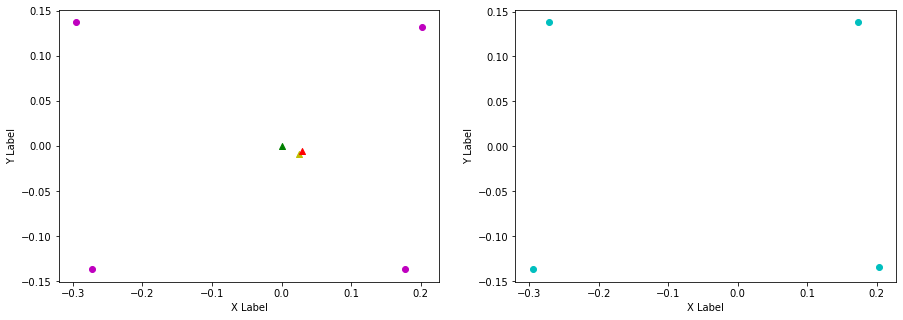

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.173, 0.204, FL (y): 0.138, 0.132.
FL displacement: 0.031, -0.006000000000000005.

FR (x): 0.203, 0.18, FR (y): -0.134, -0.139.
FR displacement: -0.02300000000000002, -0.0050000000000000044.

RL (x): -0.271, -0.292, RL (y): 0.138, 0.138.
RL displacement: -0.020999999999999963, 0.0.

RR (x): -0.295, -0.271, RR (y): -0.137, -0.136.
RR displacement: 0.023999999999999966, 0.0010000000000000009.


Base displacement (Foot): [0.02300000000000002, 0.0050000000000000044].

Base displacement (Odom): [[0.012707717215401981], [0.003254599897773325]]. Rotation displacement: -1.2329998073577133.



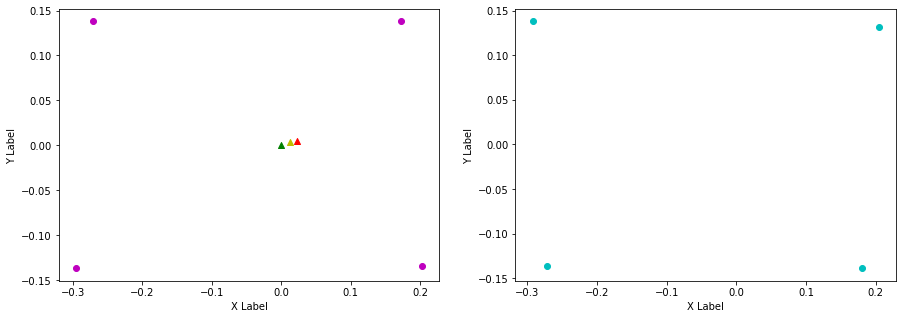

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.204, 0.168, FL (y): 0.132, 0.136.
FL displacement: -0.035999999999999976, 0.0040000000000000036.

FR (x): 0.18, 0.2, FR (y): -0.139, -0.135.
FR displacement: 0.020000000000000018, 0.0040000000000000036.

RL (x): -0.292, -0.273, RL (y): 0.138, 0.139.
RL displacement: 0.01899999999999996, 0.0010000000000000009.

RR (x): -0.271, -0.303, RR (y): -0.136, -0.135.
RR displacement: -0.03199999999999997, 0.0010000000000000009.


Base displacement (Foot): [0.035999999999999976, -0.0040000000000000036].

Base displacement (Odom): [[0.028468392143688348], [-0.005844665474527111]]. Rotation displacement: 1.0497117993521075.



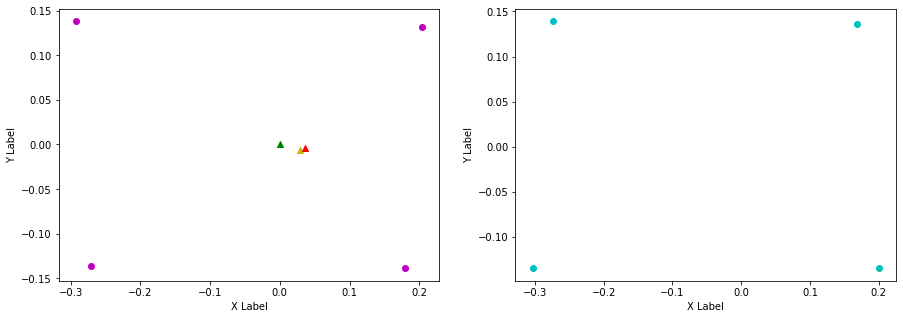

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.168, 0.2, FL (y): 0.136, 0.133.
FL displacement: 0.032, -0.0030000000000000027.

FR (x): 0.2, 0.169, FR (y): -0.135, -0.136.
FR displacement: -0.031, -0.0010000000000000009.

RL (x): -0.273, -0.304, RL (y): 0.139, 0.135.
RL displacement: -0.030999999999999972, -0.0040000000000000036.

RR (x): -0.303, -0.274, RR (y): -0.135, -0.137.
RR displacement: 0.02899999999999997, -0.0020000000000000018.


Base displacement (Foot): [0.031, 0.0010000000000000009].

Base displacement (Odom): [[0.027235782513116646], [0.008868639085829522]]. Rotation displacement: -1.1616279865370625.



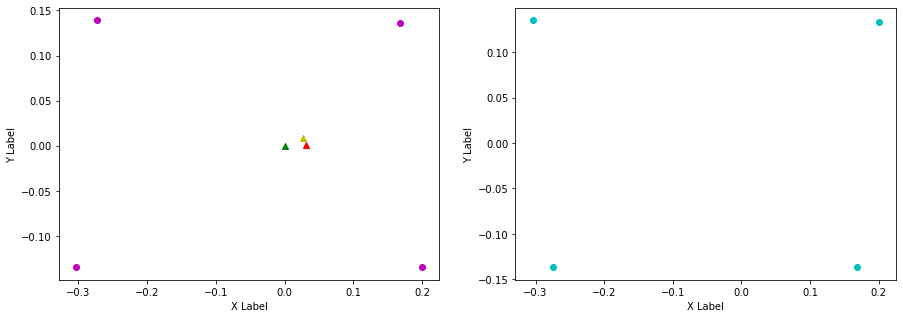

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.2, 0.169, FL (y): 0.133, 0.136.
FL displacement: -0.031, 0.0030000000000000027.

FR (x): 0.169, 0.201, FR (y): -0.136, -0.135.
FR displacement: 0.032, 0.0010000000000000009.

RL (x): -0.304, -0.273, RL (y): 0.135, 0.139.
RL displacement: 0.030999999999999972, 0.0040000000000000036.

RR (x): -0.274, -0.301, RR (y): -0.137, -0.136.
RR displacement: -0.02699999999999997, 0.0010000000000000009.


Base displacement (Foot): [0.031, -0.0030000000000000027].

Base displacement (Odom): [[0.02805099710057224], [-0.009187590263188938]]. Rotation displacement: 0.6783745349202193.



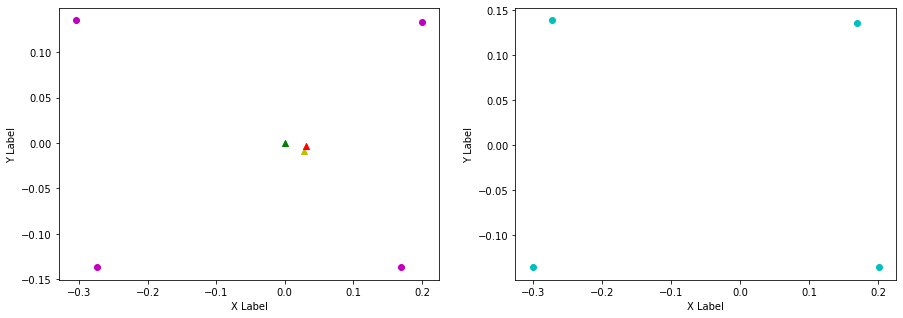

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.169, 0.204, FL (y): 0.136, 0.132.
FL displacement: 0.034999999999999976, -0.0040000000000000036.

FR (x): 0.201, 0.179, FR (y): -0.135, -0.138.
FR displacement: -0.02200000000000002, -0.0030000000000000027.

RL (x): -0.273, -0.292, RL (y): 0.139, 0.138.
RL displacement: -0.01899999999999996, -0.0010000000000000009.

RR (x): -0.301, -0.271, RR (y): -0.136, -0.136.
RR displacement: 0.02999999999999997, 0.0.


Base displacement (Foot): [0.02200000000000002, 0.0030000000000000027].

Base displacement (Odom): [[0.011401332259496133], [0.00232381144788274]]. Rotation displacement: -0.9768514625171334.



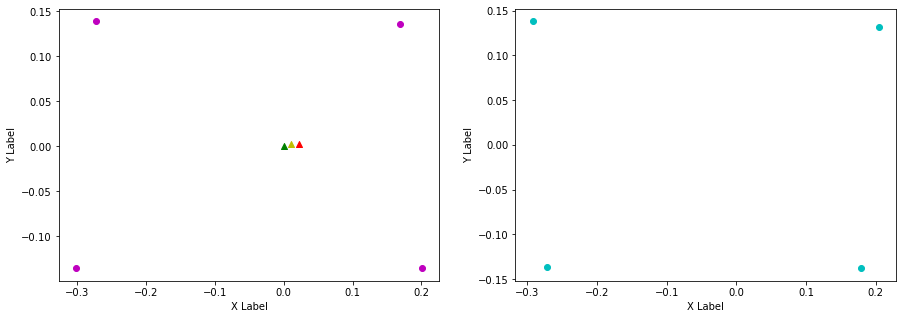

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.204, 0.17, FL (y): 0.132, 0.137.
FL displacement: -0.033999999999999975, 0.0050000000000000044.

FR (x): 0.179, 0.201, FR (y): -0.138, -0.134.
FR displacement: 0.02200000000000002, 0.0040000000000000036.

RL (x): -0.292, -0.273, RL (y): 0.138, 0.139.
RL displacement: 0.01899999999999996, 0.0010000000000000009.

RR (x): -0.271, -0.3, RR (y): -0.136, -0.136.
RR displacement: -0.02899999999999997, 0.0.


Base displacement (Foot): [0.033999999999999975, -0.0050000000000000044].

Base displacement (Odom): [[0.02141668732609725], [-0.00654582650818919]]. Rotation displacement: 0.5067928748828793.



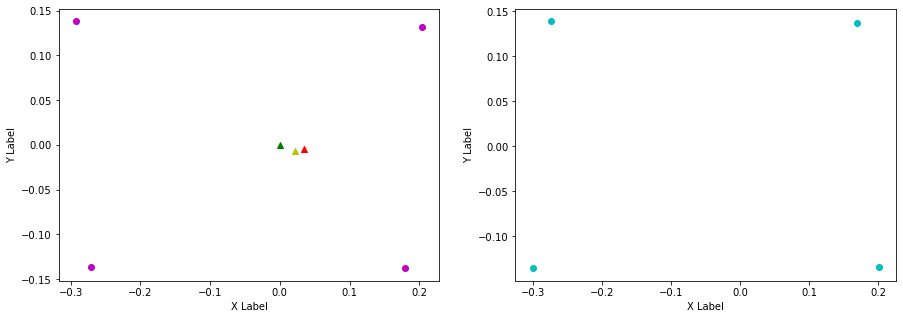

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.17, 0.202, FL (y): 0.137, 0.132.
FL displacement: 0.032, -0.0050000000000000044.

FR (x): 0.201, 0.178, FR (y): -0.134, -0.137.
FR displacement: -0.02300000000000002, -0.0030000000000000027.

RL (x): -0.273, -0.295, RL (y): 0.139, 0.136.
RL displacement: -0.021999999999999964, -0.0030000000000000027.

RR (x): -0.3, -0.272, RR (y): -0.136, -0.137.
RR displacement: 0.02799999999999997, -0.0010000000000000009.


Base displacement (Foot): [0.02300000000000002, 0.0030000000000000027].

Base displacement (Odom): [[0.011078655064583831], [0.0022707113960763747]]. Rotation displacement: -0.40870242734542517.



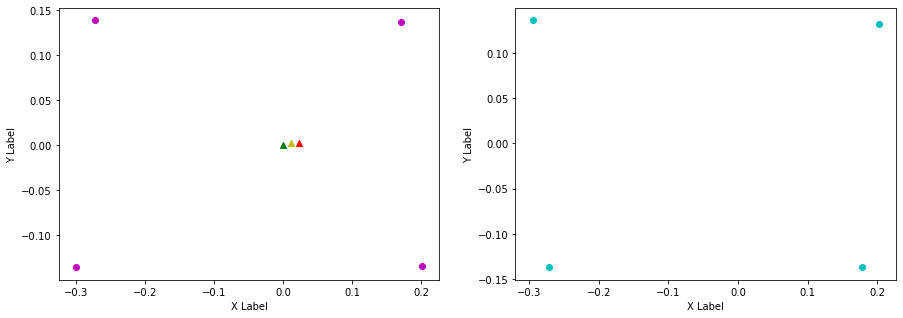

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.202, 0.175, FL (y): 0.132, 0.139.
FL displacement: -0.027000000000000024, 0.007000000000000006.

FR (x): 0.178, 0.204, FR (y): -0.137, -0.133.
FR displacement: 0.025999999999999995, 0.0040000000000000036.

RL (x): -0.295, -0.271, RL (y): 0.136, 0.138.
RL displacement: 0.023999999999999966, 0.0020000000000000018.

RR (x): -0.272, -0.293, RR (y): -0.137, -0.138.
RR displacement: -0.020999999999999963, -0.0010000000000000009.


Base displacement (Foot): [0.027000000000000024, -0.007000000000000006].

Base displacement (Odom): [[0.017429947060413564], [-0.007515382203381715]]. Rotation displacement: 0.3000774479464934.



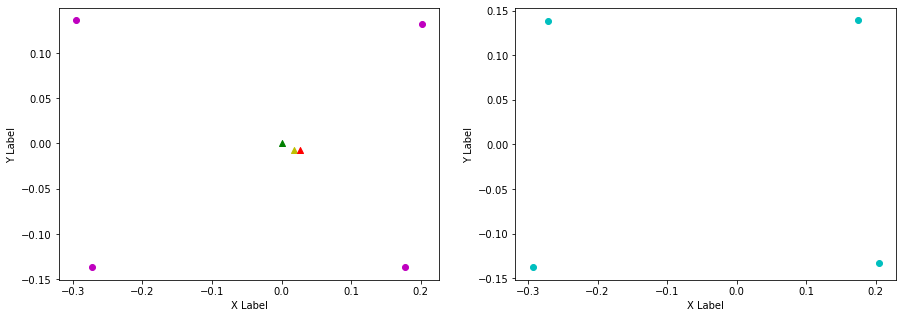

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.175, 0.201, FL (y): 0.139, 0.133.
FL displacement: 0.026000000000000023, -0.006000000000000005.

FR (x): 0.204, 0.172, FR (y): -0.133, -0.136.
FR displacement: -0.032, -0.0030000000000000027.

RL (x): -0.271, -0.3, RL (y): 0.138, 0.136.
RL displacement: -0.02899999999999997, -0.0020000000000000018.

RR (x): -0.293, -0.273, RR (y): -0.138, -0.137.
RR displacement: 0.019999999999999962, 0.0010000000000000009.


Base displacement (Foot): [0.032, 0.0030000000000000027].

Base displacement (Odom): [[0.01402276460568963], [0.0023072881726639016]]. Rotation displacement: -1.2380846967992396.



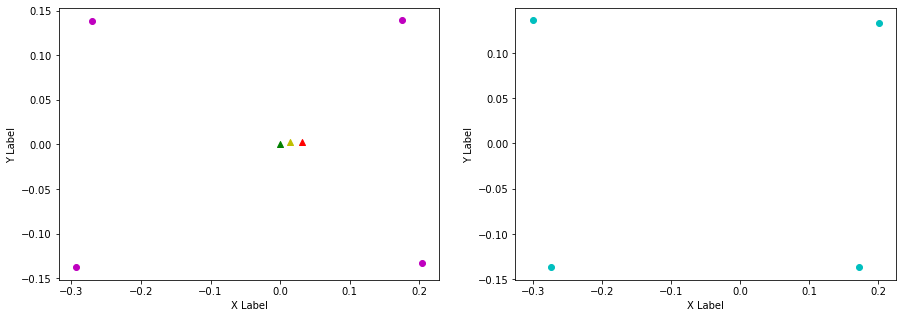

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.201, 0.173, FL (y): 0.133, 0.138.
FL displacement: -0.028000000000000025, 0.0050000000000000044.

FR (x): 0.172, 0.203, FR (y): -0.136, -0.134.
FR displacement: 0.031000000000000028, 0.0020000000000000018.

RL (x): -0.3, -0.271, RL (y): 0.136, 0.138.
RL displacement: 0.02899999999999997, 0.0020000000000000018.

RR (x): -0.273, -0.295, RR (y): -0.137, -0.137.
RR displacement: -0.021999999999999964, 0.0.


Base displacement (Foot): [0.028000000000000025, -0.0050000000000000044].

Base displacement (Odom): [[0.010770334125440595], [-0.002078138759542436]]. Rotation displacement: 0.9180434896195752.



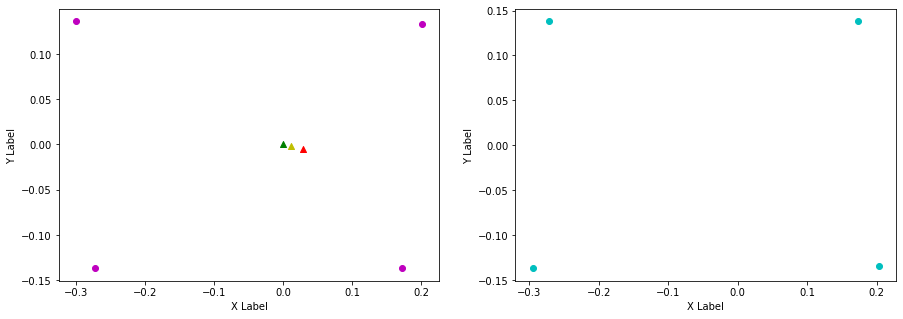

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.173, 0.203, FL (y): 0.138, 0.132.
FL displacement: 0.030000000000000027, -0.006000000000000005.

FR (x): 0.203, 0.179, FR (y): -0.134, -0.137.
FR displacement: -0.02400000000000002, -0.0030000000000000027.

RL (x): -0.271, -0.293, RL (y): 0.138, 0.137.
RL displacement: -0.021999999999999964, -0.0010000000000000009.

RR (x): -0.295, -0.271, RR (y): -0.137, -0.137.
RR displacement: 0.023999999999999966, 0.0.


Base displacement (Foot): [0.02400000000000002, 0.0030000000000000027].

Base displacement (Odom): [[0.031108642708728595], [0.010973686819396367]]. Rotation displacement: -1.090349147724897.



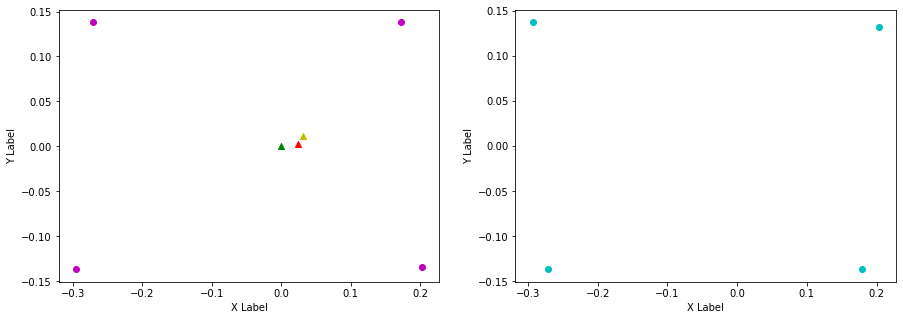

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.203, 0.168, FL (y): 0.132, 0.136.
FL displacement: -0.035, 0.0040000000000000036.

FR (x): 0.179, 0.2, FR (y): -0.137, -0.135.
FR displacement: 0.02100000000000002, 0.0020000000000000018.

RL (x): -0.293, -0.274, RL (y): 0.137, 0.139.
RL displacement: 0.01899999999999996, 0.0020000000000000018.

RR (x): -0.271, -0.304, RR (y): -0.137, -0.136.
RR displacement: -0.032999999999999974, 0.0010000000000000009.


Base displacement (Foot): [0.035, -0.0040000000000000036].

Base displacement (Odom): [[0.018303963651836508], [-0.007374507413694276]]. Rotation displacement: 0.9456319465354139.



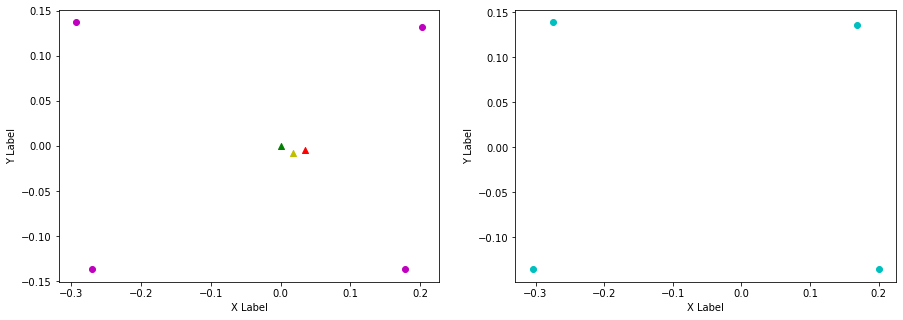

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.168, 0.203, FL (y): 0.136, 0.132.
FL displacement: 0.035, -0.0040000000000000036.

FR (x): 0.2, 0.179, FR (y): -0.135, -0.138.
FR displacement: -0.02100000000000002, -0.0030000000000000027.

RL (x): -0.274, -0.292, RL (y): 0.139, 0.137.
RL displacement: -0.01799999999999996, -0.0020000000000000018.

RR (x): -0.304, -0.271, RR (y): -0.136, -0.137.
RR displacement: 0.032999999999999974, -0.0010000000000000009.


Base displacement (Foot): [0.02100000000000002, 0.0030000000000000027].

Base displacement (Odom): [[0.01776605276885368], [0.008188571827729918]]. Rotation displacement: -0.8097015411668196.



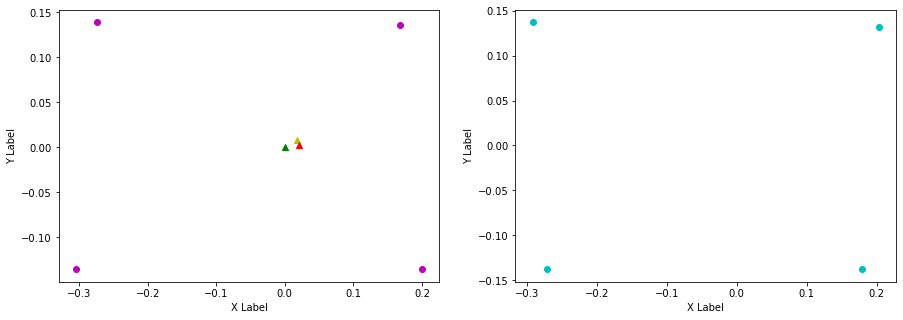

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.203, 0.175, FL (y): 0.132, 0.139.
FL displacement: -0.028000000000000025, 0.007000000000000006.

FR (x): 0.179, 0.205, FR (y): -0.138, -0.134.
FR displacement: 0.025999999999999995, 0.0040000000000000036.

RL (x): -0.292, -0.27, RL (y): 0.137, 0.138.
RL displacement: 0.021999999999999964, 0.0010000000000000009.

RR (x): -0.271, -0.294, RR (y): -0.137, -0.138.
RR displacement: -0.022999999999999965, -0.0010000000000000009.


Base displacement (Foot): [0.028000000000000025, -0.007000000000000006].

Base displacement (Odom): [[0.01409759141241329], [-0.004424359282625967]]. Rotation displacement: 0.5692217039741021.



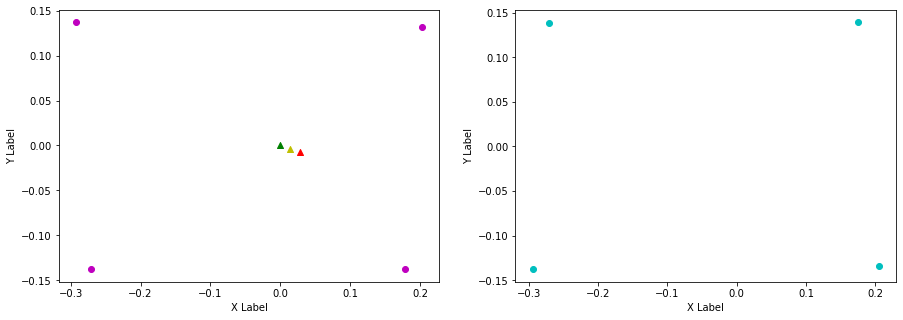

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.175, 0.202, FL (y): 0.139, 0.133.
FL displacement: 0.027000000000000024, -0.006000000000000005.

FR (x): 0.205, 0.176, FR (y): -0.134, -0.137.
FR displacement: -0.028999999999999998, -0.0030000000000000027.

RL (x): -0.27, -0.295, RL (y): 0.138, 0.136.
RL displacement: -0.024999999999999967, -0.0020000000000000018.

RR (x): -0.294, -0.272, RR (y): -0.138, -0.137.
RR displacement: 0.021999999999999964, 0.0010000000000000009.


Base displacement (Foot): [0.028999999999999998, 0.0030000000000000027].

Base displacement (Odom): [[0.0245895486633807], [0.00924915653990599]]. Rotation displacement: -0.9602542734785153.



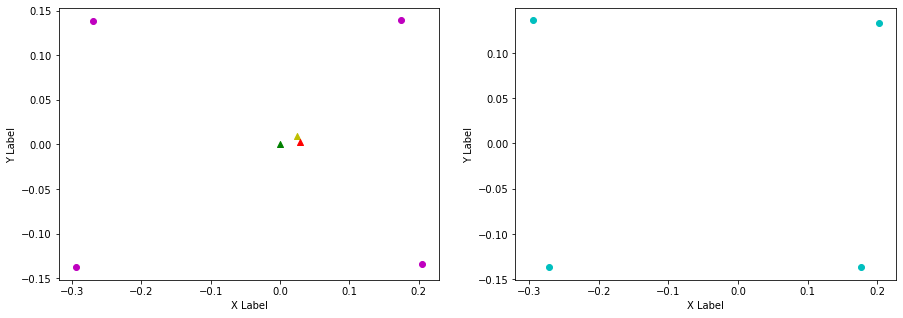

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.202, 0.173, FL (y): 0.133, 0.137.
FL displacement: -0.029000000000000026, 0.0040000000000000036.

FR (x): 0.176, 0.203, FR (y): -0.137, -0.135.
FR displacement: 0.027000000000000024, 0.0020000000000000018.

RL (x): -0.295, -0.271, RL (y): 0.136, 0.139.
RL displacement: 0.023999999999999966, 0.0030000000000000027.

RR (x): -0.272, -0.296, RR (y): -0.137, -0.137.
RR displacement: -0.023999999999999966, 0.0.


Base displacement (Foot): [0.029000000000000026, -0.0040000000000000036].

Base displacement (Odom): [[0.02196903859940713], [-0.0055640564984378305]]. Rotation displacement: 0.7478752612906474.



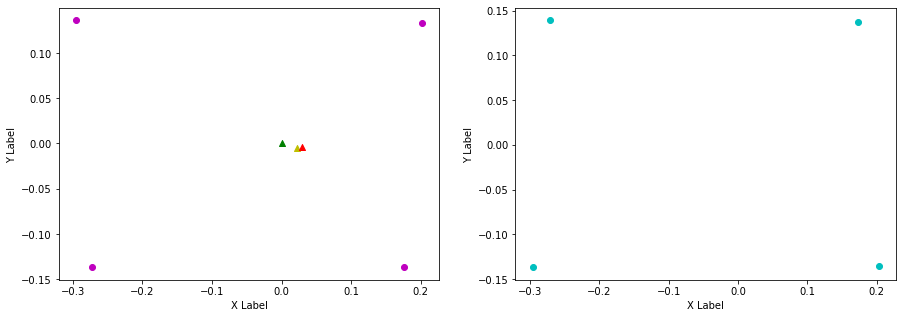

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.173, 0.202, FL (y): 0.137, 0.132.
FL displacement: 0.029000000000000026, -0.0050000000000000044.

FR (x): 0.203, 0.179, FR (y): -0.135, -0.137.
FR displacement: -0.02400000000000002, -0.0020000000000000018.

RL (x): -0.271, -0.294, RL (y): 0.139, 0.137.
RL displacement: -0.022999999999999965, -0.0020000000000000018.

RR (x): -0.296, -0.272, RR (y): -0.137, -0.137.
RR displacement: 0.023999999999999966, 0.0.


Base displacement (Foot): [0.02400000000000002, 0.0020000000000000018].

Base displacement (Odom): [[0.022612839653951777], [0.008535720608447428]]. Rotation displacement: -1.1724359405001057.



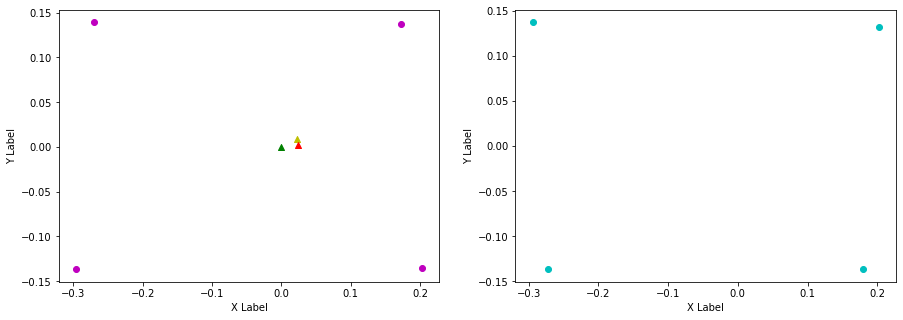

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.202, 0.174, FL (y): 0.132, 0.138.
FL displacement: -0.028000000000000025, 0.006000000000000005.

FR (x): 0.179, 0.204, FR (y): -0.137, -0.134.
FR displacement: 0.024999999999999994, 0.0030000000000000027.

RL (x): -0.294, -0.27, RL (y): 0.137, 0.138.
RL displacement: 0.023999999999999966, 0.0010000000000000009.

RR (x): -0.272, -0.294, RR (y): -0.137, -0.138.
RR displacement: -0.021999999999999964, -0.0010000000000000009.


Base displacement (Foot): [0.028000000000000025, -0.006000000000000005].

Base displacement (Odom): [[0.0167547620245605], [-0.005859934568578251]]. Rotation displacement: 0.8220499794635767.



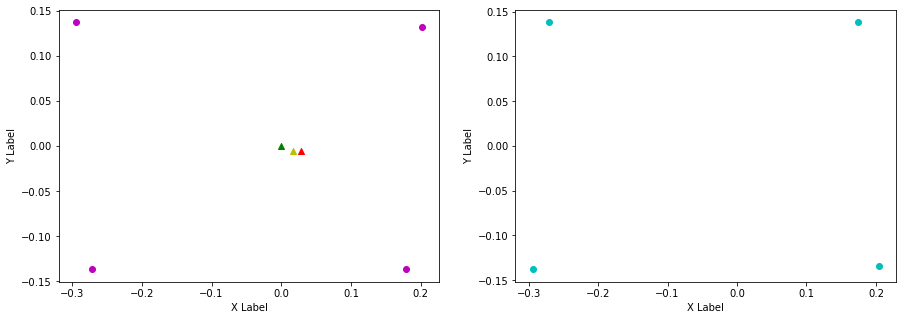

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.174, 0.202, FL (y): 0.138, 0.133.
FL displacement: 0.028000000000000025, -0.0050000000000000044.

FR (x): 0.204, 0.177, FR (y): -0.134, -0.137.
FR displacement: -0.026999999999999996, -0.0030000000000000027.

RL (x): -0.27, -0.295, RL (y): 0.138, 0.137.
RL displacement: -0.024999999999999967, -0.0010000000000000009.

RR (x): -0.294, -0.272, RR (y): -0.138, -0.137.
RR displacement: 0.021999999999999964, 0.0010000000000000009.


Base displacement (Foot): [0.026999999999999996, 0.0030000000000000027].

Base displacement (Odom): [[0.02864267534310816], [0.008696691755215591]]. Rotation displacement: -1.2799638928021657.



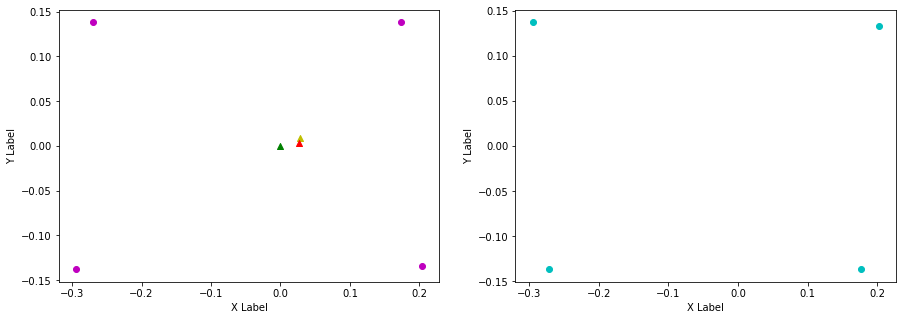

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.202, 0.175, FL (y): 0.133, 0.139.
FL displacement: -0.027000000000000024, 0.006000000000000005.

FR (x): 0.177, 0.204, FR (y): -0.137, -0.134.
FR displacement: 0.026999999999999996, 0.0030000000000000027.

RL (x): -0.295, -0.27, RL (y): 0.137, 0.138.
RL displacement: 0.024999999999999967, 0.0010000000000000009.

RR (x): -0.272, -0.294, RR (y): -0.137, -0.138.
RR displacement: -0.021999999999999964, -0.0010000000000000009.


Base displacement (Foot): [0.027000000000000024, -0.006000000000000005].

Base displacement (Odom): [[0.00822776263159053], [-0.0026726100727265667]]. Rotation displacement: 0.8262431827299118.



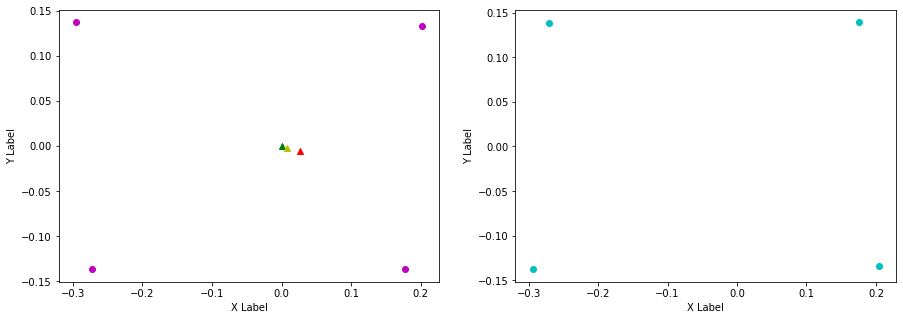

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.175, 0.203, FL (y): 0.139, 0.132.
FL displacement: 0.028000000000000025, -0.007000000000000006.

FR (x): 0.204, 0.179, FR (y): -0.134, -0.138.
FR displacement: -0.024999999999999994, -0.0040000000000000036.

RL (x): -0.27, -0.292, RL (y): 0.138, 0.137.
RL displacement: -0.021999999999999964, -0.0010000000000000009.

RR (x): -0.294, -0.271, RR (y): -0.138, -0.136.
RR displacement: 0.022999999999999965, 0.0020000000000000018.


Base displacement (Foot): [0.024999999999999994, 0.0040000000000000036].

Base displacement (Odom): [[0.013855077738849975], [0.005794268010226977]]. Rotation displacement: -1.098998896900978.



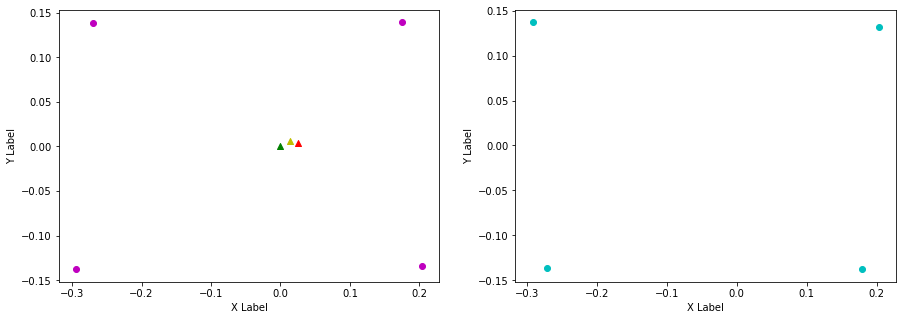

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.203, 0.173, FL (y): 0.132, 0.138.
FL displacement: -0.030000000000000027, 0.006000000000000005.

FR (x): 0.179, 0.203, FR (y): -0.138, -0.134.
FR displacement: 0.02400000000000002, 0.0040000000000000036.

RL (x): -0.292, -0.271, RL (y): 0.137, 0.138.
RL displacement: 0.020999999999999963, 0.0010000000000000009.

RR (x): -0.271, -0.295, RR (y): -0.136, -0.137.
RR displacement: -0.023999999999999966, -0.0010000000000000009.


Base displacement (Foot): [0.030000000000000027, -0.006000000000000005].

Base displacement (Odom): [[0.016275025766689932], [-0.00565239327466438]]. Rotation displacement: 1.1569792776974628.



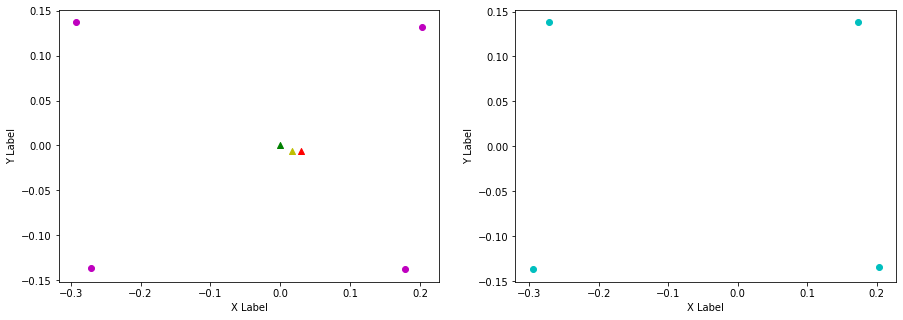

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.173, 0.202, FL (y): 0.138, 0.132.
FL displacement: 0.029000000000000026, -0.006000000000000005.

FR (x): 0.203, 0.177, FR (y): -0.134, -0.137.
FR displacement: -0.026000000000000023, -0.0030000000000000027.

RL (x): -0.271, -0.295, RL (y): 0.138, 0.137.
RL displacement: -0.023999999999999966, -0.0010000000000000009.

RR (x): -0.295, -0.272, RR (y): -0.137, -0.137.
RR displacement: 0.022999999999999965, 0.0.


Base displacement (Foot): [0.026000000000000023, 0.0030000000000000027].

Base displacement (Odom): [[0.033171039596673335], [0.01019179426165795]]. Rotation displacement: -1.3502100703328705.



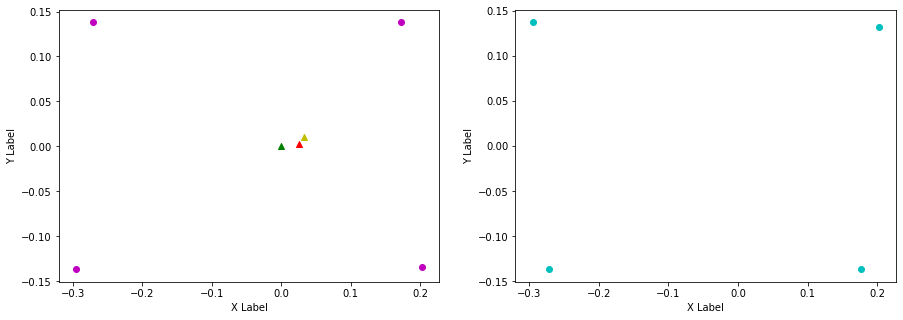

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.202, 0.172, FL (y): 0.132, 0.137.
FL displacement: -0.030000000000000027, 0.0050000000000000044.

FR (x): 0.177, 0.202, FR (y): -0.137, -0.134.
FR displacement: 0.025000000000000022, 0.0030000000000000027.

RL (x): -0.295, -0.272, RL (y): 0.137, 0.139.
RL displacement: 0.022999999999999965, 0.0020000000000000018.

RR (x): -0.272, -0.296, RR (y): -0.137, -0.137.
RR displacement: -0.023999999999999966, 0.0.


Base displacement (Foot): [0.030000000000000027, -0.0050000000000000044].

Base displacement (Odom): [[0.024046282945995312], [-0.009363714895051611]]. Rotation displacement: 0.833233576487005.



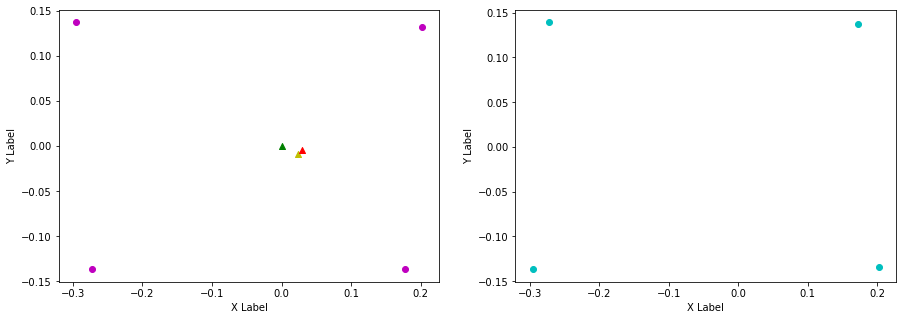

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.172, 0.203, FL (y): 0.137, 0.132.
FL displacement: 0.031000000000000028, -0.0050000000000000044.

FR (x): 0.202, 0.18, FR (y): -0.134, -0.137.
FR displacement: -0.02200000000000002, -0.0030000000000000027.

RL (x): -0.272, -0.293, RL (y): 0.139, 0.137.
RL displacement: -0.020999999999999963, -0.0020000000000000018.

RR (x): -0.296, -0.272, RR (y): -0.137, -0.137.
RR displacement: 0.023999999999999966, 0.0.


Base displacement (Foot): [0.02200000000000002, 0.0030000000000000027].

Base displacement (Odom): [[0.02914047120151908], [0.009049863745573594]]. Rotation displacement: -1.2558249500578524.



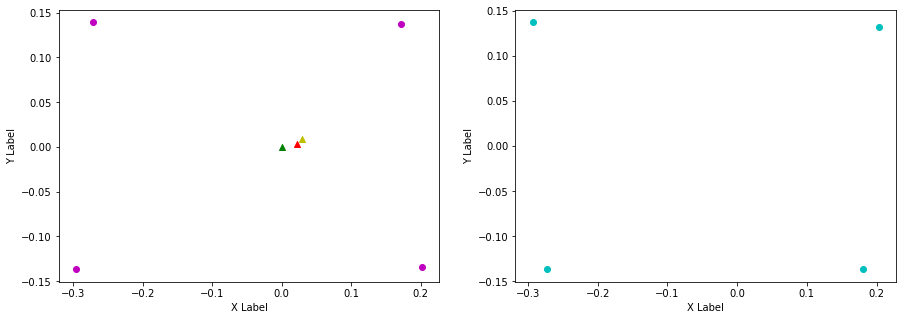

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.203, 0.171, FL (y): 0.132, 0.137.
FL displacement: -0.032, 0.0050000000000000044.

FR (x): 0.18, 0.202, FR (y): -0.137, -0.134.
FR displacement: 0.02200000000000002, 0.0030000000000000027.

RL (x): -0.293, -0.272, RL (y): 0.137, 0.139.
RL displacement: 0.020999999999999963, 0.0020000000000000018.

RR (x): -0.272, -0.298, RR (y): -0.137, -0.137.
RR displacement: -0.025999999999999968, 0.0.


Base displacement (Foot): [0.032, -0.0050000000000000044].

Base displacement (Odom): [[0.02102539112210211], [-0.005005669656431677]]. Rotation displacement: 0.9790288166600254.



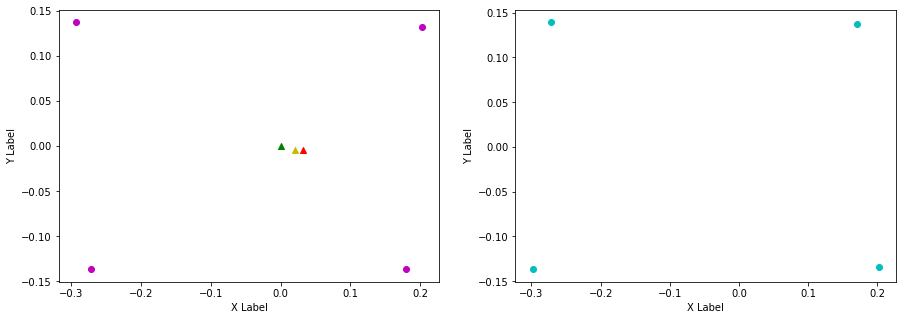

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.171, 0.202, FL (y): 0.137, 0.133.
FL displacement: 0.031, -0.0040000000000000036.

FR (x): 0.202, 0.177, FR (y): -0.134, -0.137.
FR displacement: -0.025000000000000022, -0.0030000000000000027.

RL (x): -0.272, -0.295, RL (y): 0.139, 0.136.
RL displacement: -0.022999999999999965, -0.0030000000000000027.

RR (x): -0.298, -0.272, RR (y): -0.137, -0.137.
RR displacement: 0.025999999999999968, 0.0.


Base displacement (Foot): [0.025000000000000022, 0.0030000000000000027].

Base displacement (Odom): [[0.02965812058105488], [0.007950941378963572]]. Rotation displacement: -0.9980956108536878.



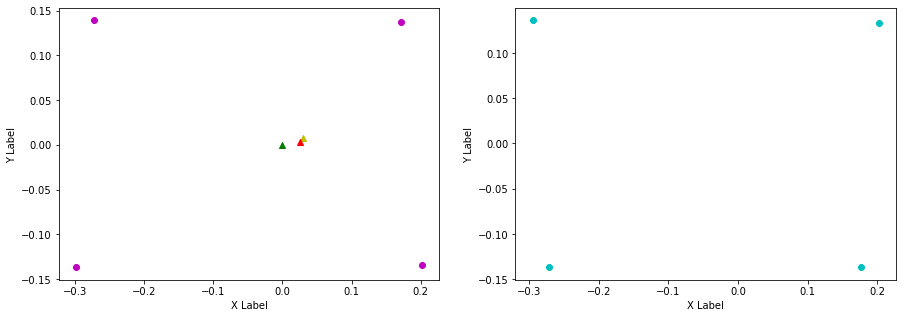

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.202, 0.169, FL (y): 0.133, 0.136.
FL displacement: -0.033, 0.0030000000000000027.

FR (x): 0.177, 0.2, FR (y): -0.137, -0.135.
FR displacement: 0.02300000000000002, 0.0020000000000000018.

RL (x): -0.295, -0.273, RL (y): 0.136, 0.138.
RL displacement: 0.021999999999999964, 0.0020000000000000018.

RR (x): -0.272, -0.301, RR (y): -0.137, -0.136.
RR displacement: -0.02899999999999997, 0.0010000000000000009.


Base displacement (Foot): [0.033, -0.0030000000000000027].

Base displacement (Odom): [[0.012708961741118241], [-0.0010316618102027553]]. Rotation displacement: 0.18368338062689607.



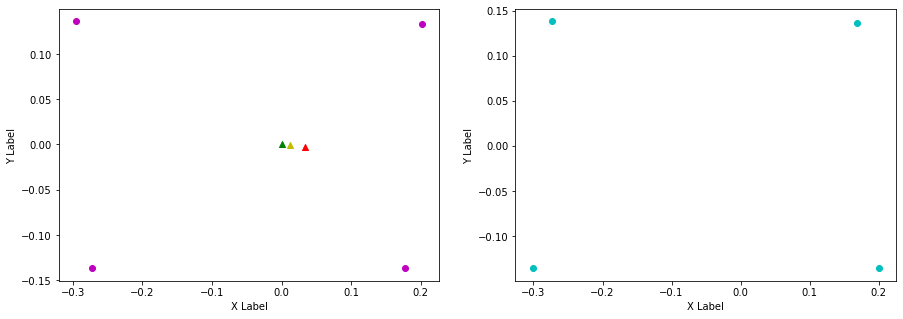

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.169, 0.204, FL (y): 0.136, 0.132.
FL displacement: 0.034999999999999976, -0.0040000000000000036.

FR (x): 0.2, 0.18, FR (y): -0.135, -0.139.
FR displacement: -0.020000000000000018, -0.0040000000000000036.

RL (x): -0.273, -0.291, RL (y): 0.138, 0.139.
RL displacement: -0.01799999999999996, 0.0010000000000000009.

RR (x): -0.301, -0.271, RR (y): -0.136, -0.136.
RR displacement: 0.02999999999999997, 0.0.


Base displacement (Foot): [0.020000000000000018, 0.0040000000000000036].

Base displacement (Odom): [[0.02869311385517248], [0.0076615771150571055]]. Rotation displacement: -0.30382174069107387.



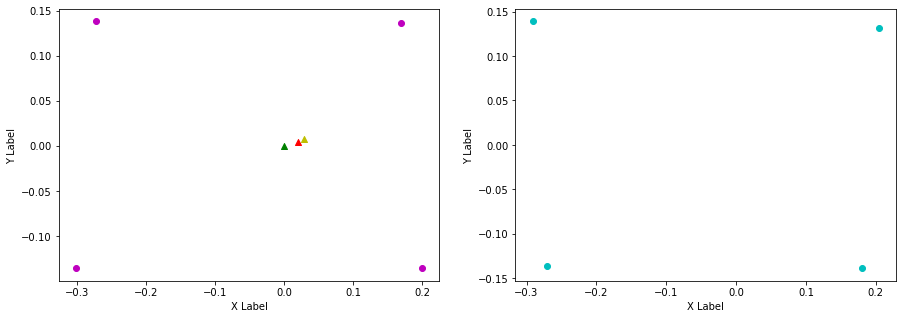

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.204, 0.167, FL (y): 0.132, 0.136.
FL displacement: -0.03699999999999998, 0.0040000000000000036.

FR (x): 0.18, 0.199, FR (y): -0.139, -0.135.
FR displacement: 0.019000000000000017, 0.0040000000000000036.

RL (x): -0.291, -0.274, RL (y): 0.139, 0.139.
RL displacement: 0.01699999999999996, 0.0.

RR (x): -0.271, -0.305, RR (y): -0.136, -0.136.
RR displacement: -0.033999999999999975, 0.0.


Base displacement (Foot): [0.03699999999999998, -0.0040000000000000036].

Base displacement (Odom): [[0.02035167789797221], [-0.005560653262306925]]. Rotation displacement: 0.7779800324689803.



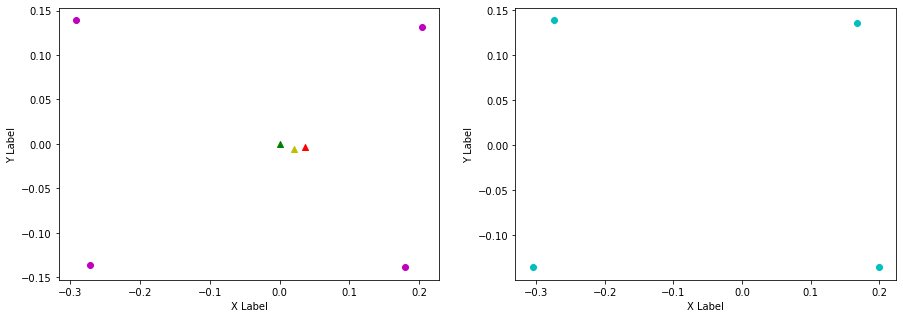

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.167, 0.203, FL (y): 0.136, 0.132.
FL displacement: 0.036000000000000004, -0.0040000000000000036.

FR (x): 0.199, 0.179, FR (y): -0.135, -0.138.
FR displacement: -0.020000000000000018, -0.0030000000000000027.

RL (x): -0.274, -0.292, RL (y): 0.139, 0.138.
RL displacement: -0.01799999999999996, -0.0010000000000000009.

RR (x): -0.305, -0.271, RR (y): -0.136, -0.137.
RR displacement: 0.033999999999999975, -0.0010000000000000009.


Base displacement (Foot): [0.020000000000000018, 0.0030000000000000027].

Base displacement (Odom): [[0.014097257805376628], [0.003442294441083682]]. Rotation displacement: -0.8573641574581372.



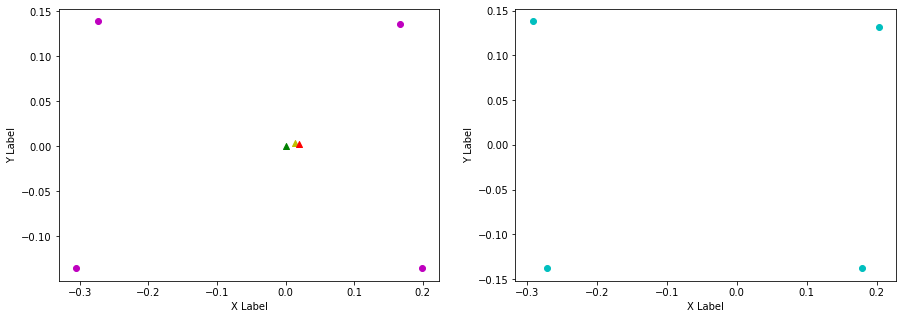

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.203, 0.174, FL (y): 0.132, 0.138.
FL displacement: -0.029000000000000026, 0.006000000000000005.

FR (x): 0.179, 0.204, FR (y): -0.138, -0.134.
FR displacement: 0.024999999999999994, 0.0040000000000000036.

RL (x): -0.292, -0.27, RL (y): 0.138, 0.138.
RL displacement: 0.021999999999999964, 0.0.

RR (x): -0.271, -0.294, RR (y): -0.137, -0.138.
RR displacement: -0.022999999999999965, -0.0010000000000000009.


Base displacement (Foot): [0.029000000000000026, -0.006000000000000005].

Base displacement (Odom): [[0.019922951175652237], [-0.005887091067638628]]. Rotation displacement: 0.5165771714437845.



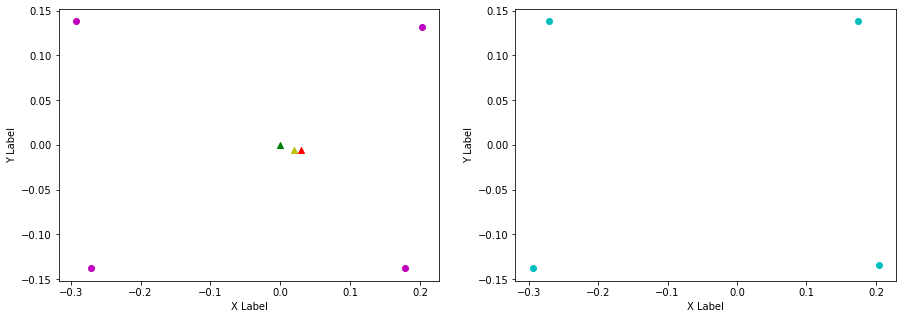

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.172, 0.203, FL (y): 0.137, 0.132.
FL displacement: 0.031000000000000028, -0.0050000000000000044.

FR (x): 0.202, 0.179, FR (y): -0.134, -0.137.
FR displacement: -0.02300000000000002, -0.0030000000000000027.

RL (x): -0.272, -0.293, RL (y): 0.139, 0.137.
RL displacement: -0.020999999999999963, -0.0020000000000000018.

RR (x): -0.297, -0.272, RR (y): -0.137, -0.137.
RR displacement: 0.024999999999999967, 0.0.


Base displacement (Foot): [0.02300000000000002, 0.0030000000000000027].

Base displacement (Odom): [[0.012911831103263438], [0.003554684870730185]]. Rotation displacement: -1.627790484698613.



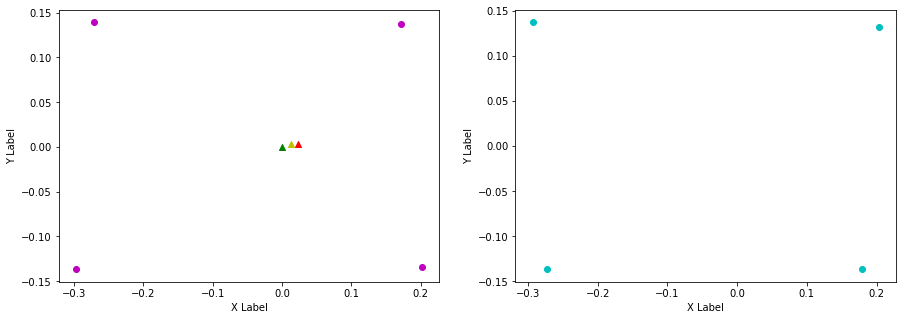

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.203, 0.175, FL (y): 0.132, 0.139.
FL displacement: -0.028000000000000025, 0.007000000000000006.

FR (x): 0.179, 0.205, FR (y): -0.137, -0.133.
FR displacement: 0.025999999999999995, 0.0040000000000000036.

RL (x): -0.293, -0.27, RL (y): 0.137, 0.137.
RL displacement: 0.022999999999999965, 0.0.

RR (x): -0.272, -0.292, RR (y): -0.137, -0.138.
RR displacement: -0.019999999999999962, -0.0010000000000000009.


Base displacement (Foot): [0.028000000000000025, -0.007000000000000006].

Base displacement (Odom): [[0.014703444060656157], [-0.002658431725670818]]. Rotation displacement: 0.6360875006519328.



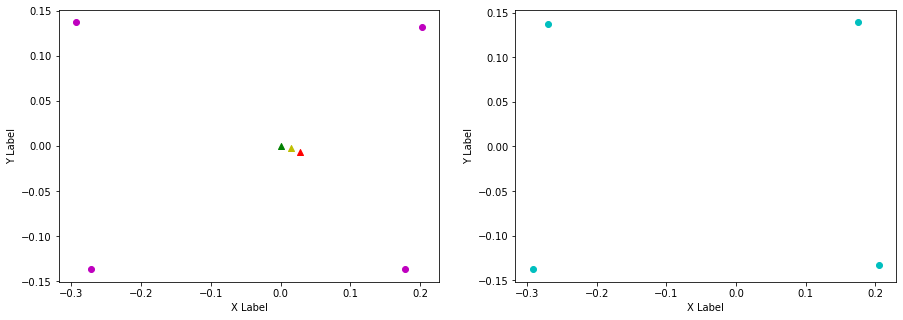

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.175, 0.199, FL (y): 0.139, 0.133.
FL displacement: 0.02400000000000002, -0.006000000000000005.

FR (x): 0.205, 0.167, FR (y): -0.133, -0.136.
FR displacement: -0.03799999999999998, -0.0030000000000000027.

RL (x): -0.27, -0.306, RL (y): 0.137, 0.135.
RL displacement: -0.035999999999999976, -0.0020000000000000018.

RR (x): -0.292, -0.274, RR (y): -0.138, -0.137.
RR displacement: 0.01799999999999996, 0.0010000000000000009.


Base displacement (Foot): [0.03799999999999998, 0.0030000000000000027].

Base displacement (Odom): [[0.029337942279151985], [0.007123680229626395]]. Rotation displacement: -1.0902720078622257.



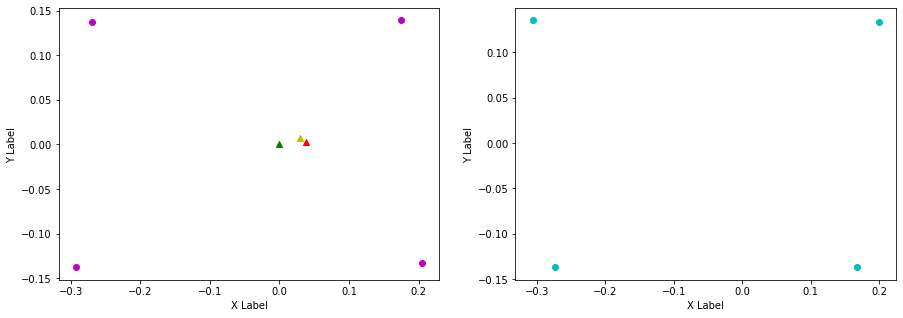

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.199, 0.174, FL (y): 0.133, 0.138.
FL displacement: -0.025000000000000022, 0.0050000000000000044.

FR (x): 0.167, 0.204, FR (y): -0.136, -0.134.
FR displacement: 0.03699999999999998, 0.0020000000000000018.

RL (x): -0.306, -0.27, RL (y): 0.135, 0.138.
RL displacement: 0.035999999999999976, 0.0030000000000000027.

RR (x): -0.274, -0.294, RR (y): -0.137, -0.138.
RR displacement: -0.019999999999999962, -0.0010000000000000009.


Base displacement (Foot): [0.025000000000000022, -0.0050000000000000044].

Base displacement (Odom): [[0.008911346025644917], [-0.0017769227640641594]]. Rotation displacement: 0.2810616678508636.



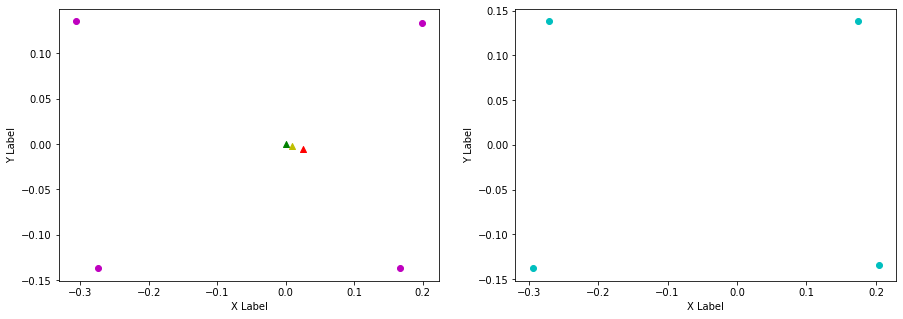

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.174, 0.2, FL (y): 0.138, 0.133.
FL displacement: 0.026000000000000023, -0.0050000000000000044.

FR (x): 0.204, 0.17, FR (y): -0.134, -0.136.
FR displacement: -0.033999999999999975, -0.0020000000000000018.

RL (x): -0.27, -0.302, RL (y): 0.138, 0.136.
RL displacement: -0.03199999999999997, -0.0020000000000000018.

RR (x): -0.294, -0.274, RR (y): -0.138, -0.137.
RR displacement: 0.019999999999999962, 0.0010000000000000009.


Base displacement (Foot): [0.033999999999999975, 0.0020000000000000018].

Base displacement (Odom): [[0.034588722612356015], [0.009249048116352854]]. Rotation displacement: -0.6020395640886086.



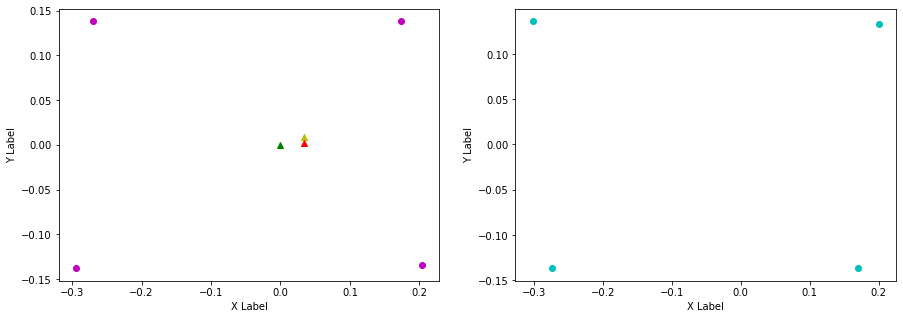

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.2, 0.17, FL (y): 0.133, 0.137.
FL displacement: -0.03, 0.0040000000000000036.

FR (x): 0.17, 0.202, FR (y): -0.136, -0.135.
FR displacement: 0.032, 0.0010000000000000009.

RL (x): -0.302, -0.272, RL (y): 0.136, 0.139.
RL displacement: 0.02999999999999997, 0.0030000000000000027.

RR (x): -0.274, -0.3, RR (y): -0.137, -0.136.
RR displacement: -0.025999999999999968, 0.0010000000000000009.


Base displacement (Foot): [0.03, -0.0040000000000000036].

Base displacement (Odom): [[0.010892876511415128], [-0.0038107535703948425]]. Rotation displacement: 0.44651697174685673.



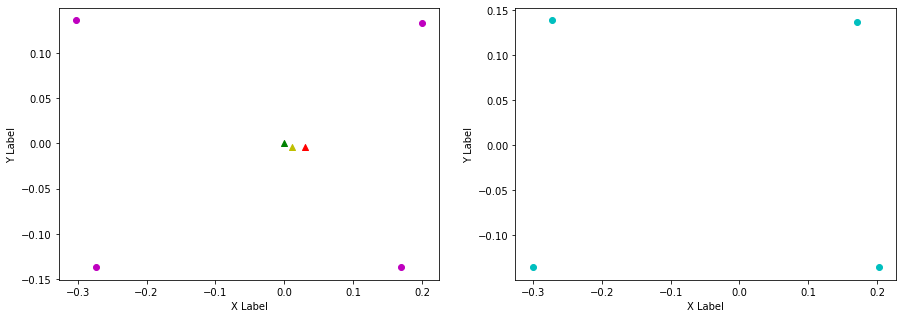

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.17, 0.199, FL (y): 0.137, 0.134.
FL displacement: 0.028999999999999998, -0.0030000000000000027.

FR (x): 0.202, 0.168, FR (y): -0.135, -0.136.
FR displacement: -0.034, -0.0010000000000000009.

RL (x): -0.272, -0.306, RL (y): 0.139, 0.135.
RL displacement: -0.033999999999999975, -0.0040000000000000036.

RR (x): -0.3, -0.274, RR (y): -0.136, -0.138.
RR displacement: 0.025999999999999968, -0.0020000000000000018.


Base displacement (Foot): [0.034, 0.0010000000000000009].

Base displacement (Odom): [[0.032046026887813106], [0.01042149711842455]]. Rotation displacement: -0.43394115808027856.



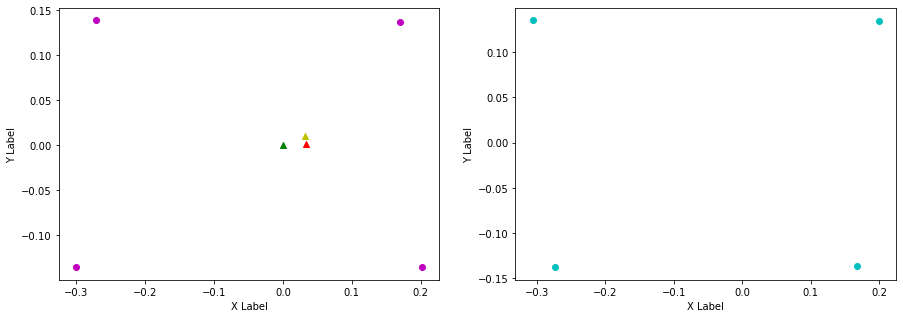

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.199, 0.171, FL (y): 0.134, 0.137.
FL displacement: -0.027999999999999997, 0.0030000000000000027.

FR (x): 0.168, 0.201, FR (y): -0.136, -0.134.
FR displacement: 0.033, 0.0020000000000000018.

RL (x): -0.306, -0.272, RL (y): 0.135, 0.139.
RL displacement: 0.033999999999999975, 0.0040000000000000036.

RR (x): -0.274, -0.298, RR (y): -0.138, -0.137.
RR displacement: -0.023999999999999966, 0.0010000000000000009.


Base displacement (Foot): [0.027999999999999997, -0.0030000000000000027].

Base displacement (Odom): [[0.02262043438718786], [-0.00733642730281947]]. Rotation displacement: 0.2601431310770408.



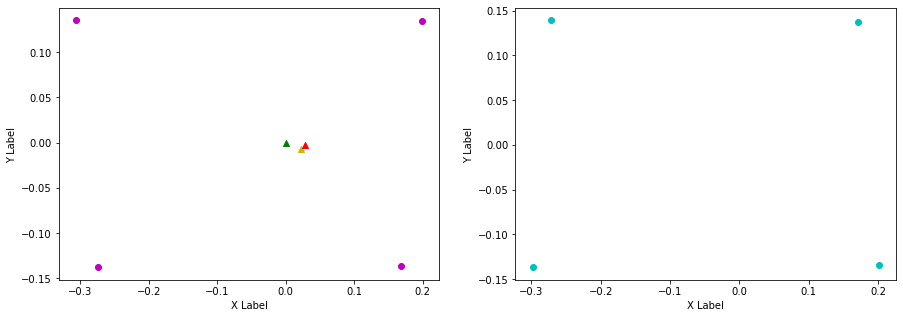

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.171, 0.2, FL (y): 0.137, 0.133.
FL displacement: 0.028999999999999998, -0.0040000000000000036.

FR (x): 0.201, 0.17, FR (y): -0.134, -0.136.
FR displacement: -0.031, -0.0020000000000000018.

RL (x): -0.272, -0.302, RL (y): 0.139, 0.136.
RL displacement: -0.02999999999999997, -0.0030000000000000027.

RR (x): -0.298, -0.274, RR (y): -0.137, -0.137.
RR displacement: 0.023999999999999966, 0.0.


Base displacement (Foot): [0.031, 0.0020000000000000018].

Base displacement (Odom): [[0.036803753685197726], [0.009615958772277389]]. Rotation displacement: -0.26281629439681264.



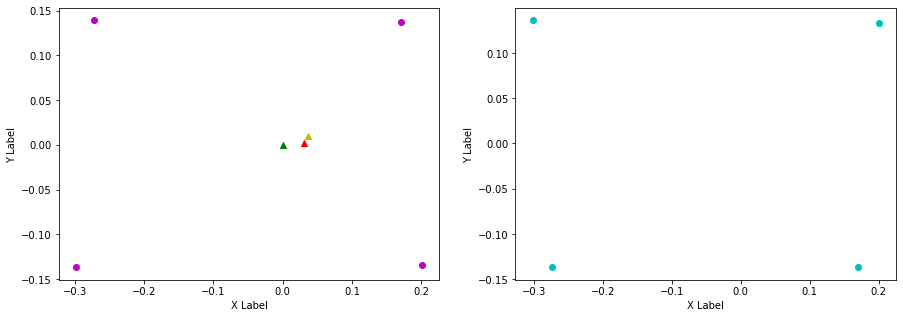

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.2, 0.17, FL (y): 0.133, 0.137.
FL displacement: -0.03, 0.0040000000000000036.

FR (x): 0.17, 0.201, FR (y): -0.136, -0.135.
FR displacement: 0.031, 0.0010000000000000009.

RL (x): -0.302, -0.273, RL (y): 0.136, 0.139.
RL displacement: 0.02899999999999997, 0.0030000000000000027.

RR (x): -0.274, -0.3, RR (y): -0.137, -0.137.
RR displacement: -0.025999999999999968, 0.0.


Base displacement (Foot): [0.03, -0.0040000000000000036].

Base displacement (Odom): [[0.006615899382209189], [-0.0040184843224976285]]. Rotation displacement: 0.24004556917125303.



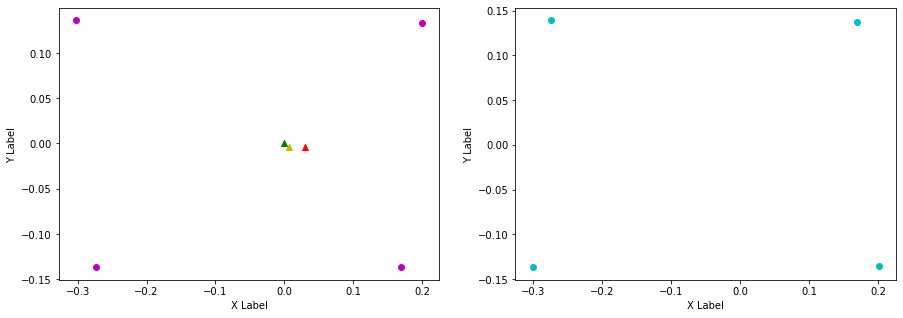

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.17, 0.199, FL (y): 0.137, 0.134.
FL displacement: 0.028999999999999998, -0.0030000000000000027.

FR (x): 0.201, 0.168, FR (y): -0.135, -0.136.
FR displacement: -0.033, -0.0010000000000000009.

RL (x): -0.273, -0.306, RL (y): 0.139, 0.135.
RL displacement: -0.032999999999999974, -0.0040000000000000036.

RR (x): -0.3, -0.274, RR (y): -0.137, -0.137.
RR displacement: 0.025999999999999968, 0.0.


Base displacement (Foot): [0.033, 0.0010000000000000009].

Base displacement (Odom): [[0.02198681321535334], [0.0057573058219854145]]. Rotation displacement: -0.29824130770422375.



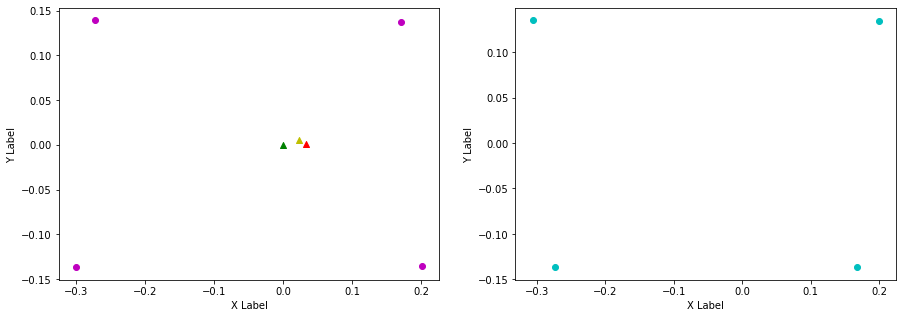

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.199, 0.167, FL (y): 0.134, 0.136.
FL displacement: -0.032, 0.0020000000000000018.

FR (x): 0.168, 0.2, FR (y): -0.136, -0.135.
FR displacement: 0.032, 0.0010000000000000009.

RL (x): -0.306, -0.274, RL (y): 0.135, 0.139.
RL displacement: 0.03199999999999997, 0.0040000000000000036.

RR (x): -0.274, -0.305, RR (y): -0.137, -0.135.
RR displacement: -0.030999999999999972, 0.0020000000000000018.


Base displacement (Foot): [0.032, -0.0020000000000000018].

Base displacement (Odom): [[0.02705654289040149], [-0.005746050876073272]]. Rotation displacement: 0.09320208208606082.



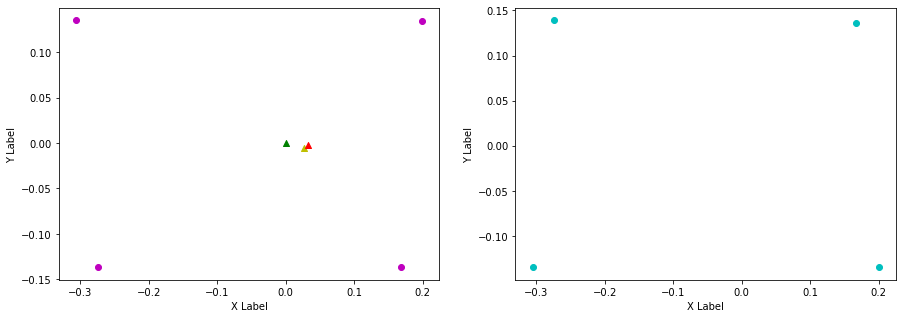

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.167, 0.201, FL (y): 0.136, 0.133.
FL displacement: 0.034, -0.0030000000000000027.

FR (x): 0.2, 0.173, FR (y): -0.135, -0.136.
FR displacement: -0.027000000000000024, -0.0010000000000000009.

RL (x): -0.274, -0.3, RL (y): 0.139, 0.136.
RL displacement: -0.025999999999999968, -0.0030000000000000027.

RR (x): -0.305, -0.273, RR (y): -0.135, -0.137.
RR displacement: 0.03199999999999997, -0.0020000000000000018.


Base displacement (Foot): [0.027000000000000024, 0.0010000000000000009].

Base displacement (Odom): [[0.010538598589871384], [0.0035042633840192128]]. Rotation displacement: -0.5353605648585762.



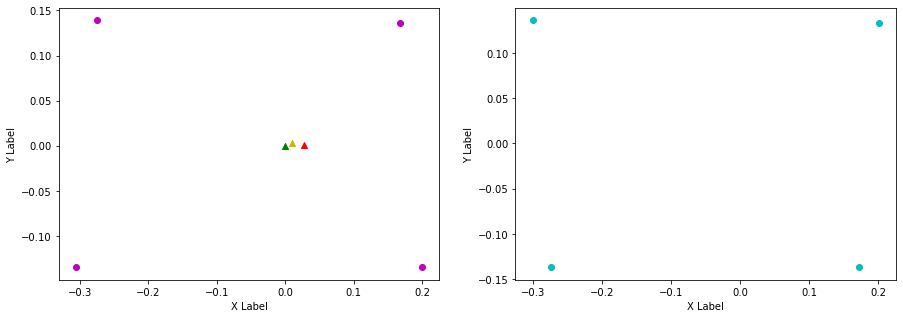

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.201, 0.175, FL (y): 0.133, 0.139.
FL displacement: -0.026000000000000023, 0.006000000000000005.

FR (x): 0.173, 0.205, FR (y): -0.136, -0.134.
FR displacement: 0.032, 0.0020000000000000018.

RL (x): -0.3, -0.27, RL (y): 0.136, 0.137.
RL displacement: 0.02999999999999997, 0.0010000000000000009.

RR (x): -0.273, -0.293, RR (y): -0.137, -0.138.
RR displacement: -0.019999999999999962, -0.0010000000000000009.


Base displacement (Foot): [0.026000000000000023, -0.006000000000000005].

Base displacement (Odom): [[0.01904337171140469], [-0.005798867166674104]]. Rotation displacement: 0.4131975813361819.



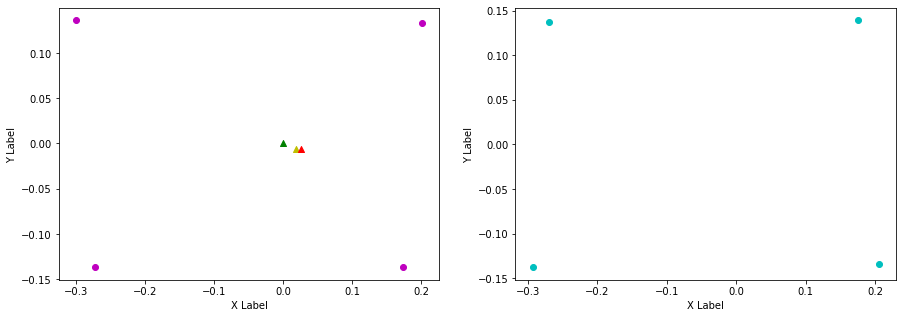

Command:  [0.1 0. ] 0.0
Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.175, 0.201, FL (y): 0.139, 0.133.
FL displacement: 0.026000000000000023, -0.006000000000000005.

FR (x): 0.205, 0.174, FR (y): -0.134, -0.137.
FR displacement: -0.031, -0.0030000000000000027.

RL (x): -0.27, -0.297, RL (y): 0.137, 0.136.
RL displacement: -0.02699999999999997, -0.0010000000000000009.

RR (x): -0.293, -0.273, RR (y): -0.138, -0.137.
RR displacement: 0.019999999999999962, 0.0010000000000000009.


Base displacement (Foot): [0.031, 0.0030000000000000027].

Base displacement (Odom): [[0.01625665825074618], [0.002757446860675361]]. Rotation displacement: -1.2211688280923756.



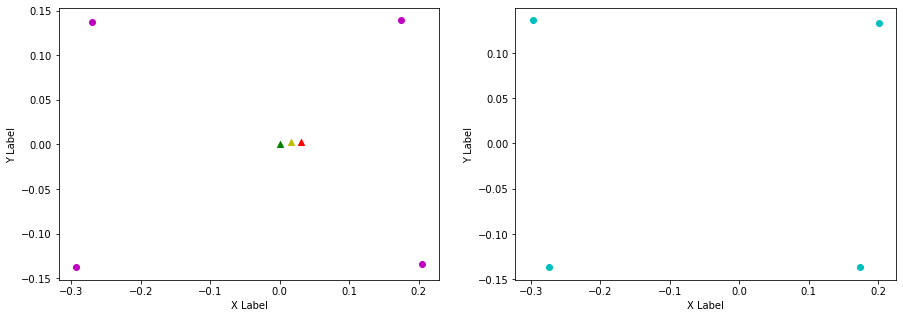

Command:  [0.1 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.201, 0.174, FL (y): 0.133, 0.138.
FL displacement: -0.027000000000000024, 0.0050000000000000044.

FR (x): 0.174, 0.204, FR (y): -0.137, -0.134.
FR displacement: 0.03, 0.0030000000000000027.

RL (x): -0.297, -0.271, RL (y): 0.136, 0.138.
RL displacement: 0.025999999999999968, 0.0020000000000000018.

RR (x): -0.273, -0.294, RR (y): -0.137, -0.137.
RR displacement: -0.020999999999999963, 0.0.


Base displacement (Foot): [0.027000000000000024, -0.0050000000000000044].

Base displacement (Odom): [[0.011163703201997333], [-0.003548266319062021]]. Rotation displacement: 0.8134110158394634.



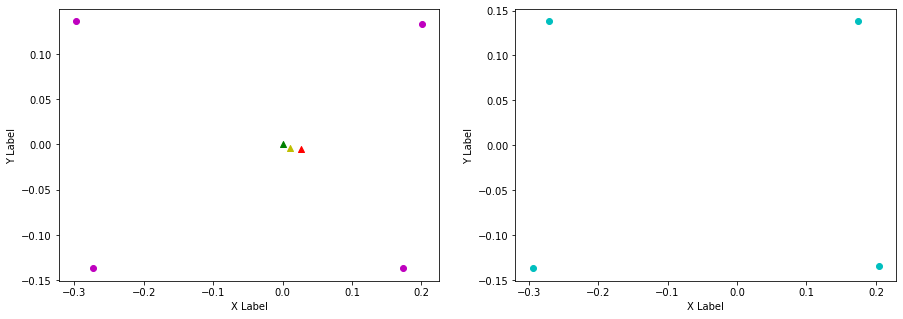

Command:  [0.1 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.174, 0.208, FL (y): 0.138, 0.131.
FL displacement: 0.034, -0.007000000000000006.

FR (x): 0.204, 0.181, FR (y): -0.134, -0.142.
FR displacement: -0.022999999999999993, -0.00799999999999998.

RL (x): -0.271, -0.287, RL (y): 0.138, 0.141.
RL displacement: -0.01599999999999996, 0.002999999999999975.

RR (x): -0.294, -0.268, RR (y): -0.137, -0.135.
RR displacement: 0.025999999999999968, 0.0020000000000000018.


Base displacement (Foot): [0.022999999999999993, 0.00799999999999998].

Base displacement (Odom): [[0.021409777059765656], [0.006947630110083147]]. Rotation displacement: -1.0315774416310712.



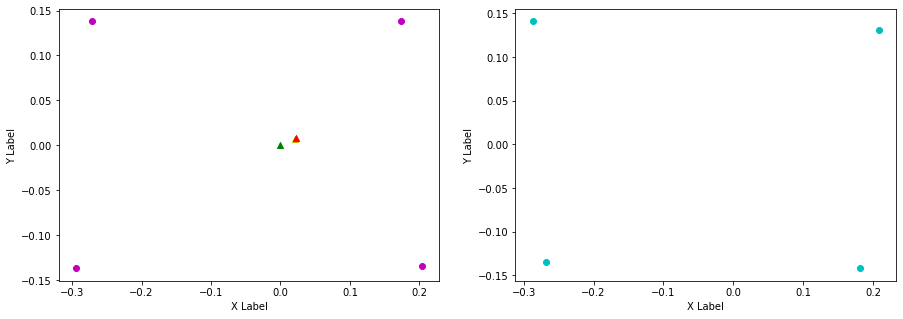

Command:  [0.1 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.194, 0.156, FL (y): 0.142, 0.138.
FL displacement: -0.038000000000000006, -0.003999999999999976.

FR (x): 0.189, 0.218, FR (y): -0.142, -0.137.
FR displacement: 0.028999999999999998, 0.004999999999999977.

RL (x): -0.285, -0.258, RL (y): 0.134, 0.137.
RL displacement: 0.02699999999999997, 0.0030000000000000027.

RR (x): -0.283, -0.318, RR (y): -0.134, -0.136.
RR displacement: -0.03500000000000003, -0.0020000000000000018.


Base displacement (Foot): [0.038000000000000006, 0.003999999999999976].

Base displacement (Odom): [[0.00364424104328398], [0.00034709946511712886]]. Rotation displacement: -20.34317846154266.



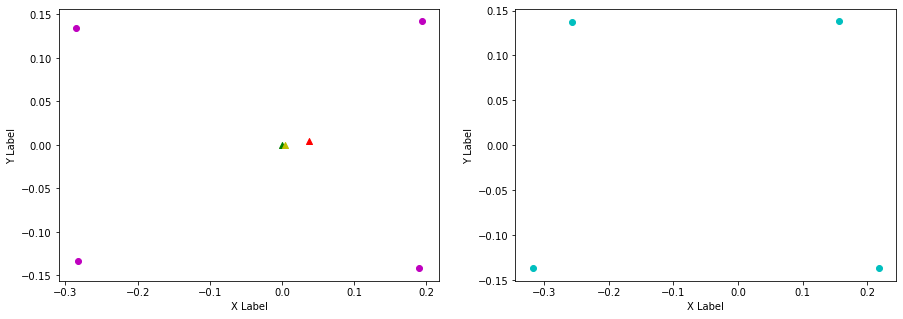

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.156, 0.218, FL (y): 0.138, 0.13.
FL displacement: 0.062, -0.008000000000000007.

FR (x): 0.218, 0.168, FR (y): -0.137, -0.138.
FR displacement: -0.04999999999999999, -0.0010000000000000009.

RL (x): -0.258, -0.31, RL (y): 0.137, 0.138.
RL displacement: -0.05199999999999999, 0.0010000000000000009.

RR (x): -0.318, -0.255, RR (y): -0.136, -0.136.
RR displacement: 0.063, 0.0.


Base displacement (Foot): [0.04999999999999999, 0.0010000000000000009].

Base displacement (Odom): [[0.07393273927314081], [0.008925121580710016]]. Rotation displacement: 0.07895715020383788.



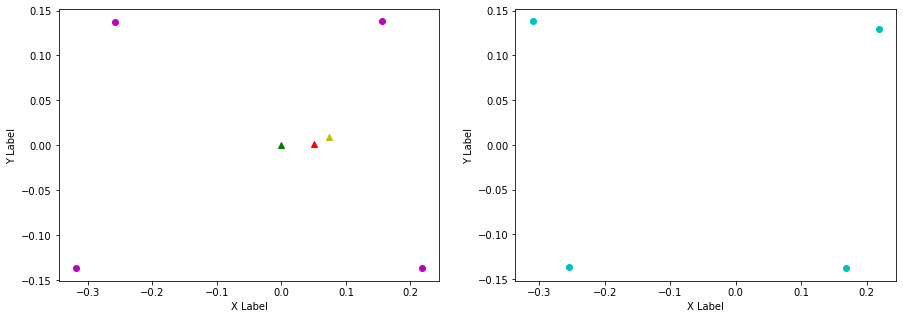

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.218, 0.142, FL (y): 0.13, 0.136.
FL displacement: -0.07600000000000001, 0.006000000000000005.

FR (x): 0.168, 0.21, FR (y): -0.138, -0.135.
FR displacement: 0.04199999999999998, 0.0030000000000000027.

RL (x): -0.31, -0.263, RL (y): 0.138, 0.139.
RL displacement: 0.046999999999999986, 0.0010000000000000009.

RR (x): -0.255, -0.327, RR (y): -0.136, -0.135.
RR displacement: -0.07200000000000001, 0.0010000000000000009.


Base displacement (Foot): [0.07600000000000001, -0.006000000000000005].

Base displacement (Odom): [[0.044169183226585806], [-0.008857697956625277]]. Rotation displacement: 1.1153100758132457.



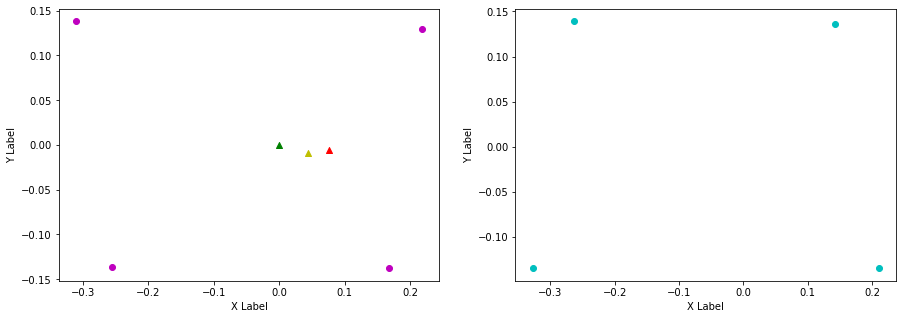

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.142, 0.218, FL (y): 0.136, 0.131.
FL displacement: 0.07600000000000001, -0.0050000000000000044.

FR (x): 0.21, 0.167, FR (y): -0.135, -0.137.
FR displacement: -0.04299999999999998, -0.0020000000000000018.

RL (x): -0.263, -0.309, RL (y): 0.139, 0.138.
RL displacement: -0.045999999999999985, -0.0010000000000000009.

RR (x): -0.327, -0.256, RR (y): -0.135, -0.136.
RR displacement: 0.07100000000000001, -0.0010000000000000009.


Base displacement (Foot): [0.04299999999999998, 0.0020000000000000018].

Base displacement (Odom): [[0.038665984372107554], [0.0027647322118098394]]. Rotation displacement: -1.409090093152509.



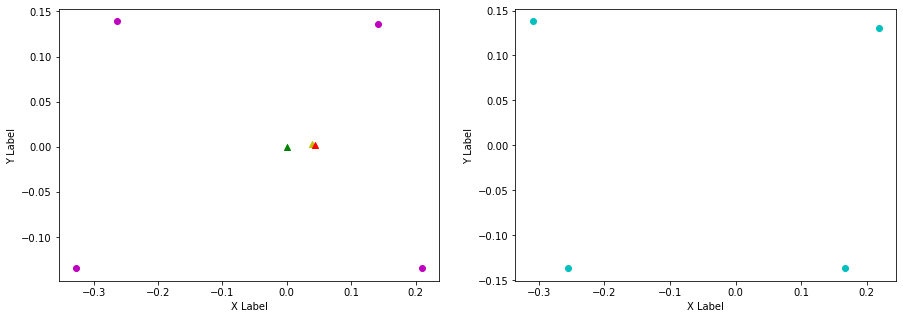

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.218, 0.143, FL (y): 0.131, 0.136.
FL displacement: -0.07500000000000001, 0.0050000000000000044.

FR (x): 0.167, 0.211, FR (y): -0.137, -0.136.
FR displacement: 0.043999999999999984, 0.0010000000000000009.

RL (x): -0.309, -0.262, RL (y): 0.138, 0.139.
RL displacement: 0.046999999999999986, 0.0010000000000000009.

RR (x): -0.256, -0.328, RR (y): -0.136, -0.135.
RR displacement: -0.07200000000000001, 0.0010000000000000009.


Base displacement (Foot): [0.07500000000000001, -0.0050000000000000044].

Base displacement (Odom): [[0.05619866788770422], [-0.005281734169730434]]. Rotation displacement: 0.7276290467437412.



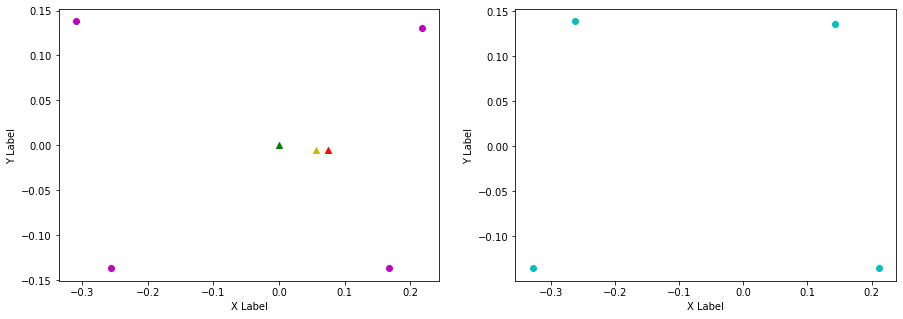

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.143, 0.212, FL (y): 0.136, 0.132.
FL displacement: 0.069, -0.0040000000000000036.

FR (x): 0.211, 0.147, FR (y): -0.136, -0.136.
FR displacement: -0.064, 0.0.

RL (x): -0.262, -0.329, RL (y): 0.139, 0.136.
RL displacement: -0.067, -0.0030000000000000027.

RR (x): -0.328, -0.261, RR (y): -0.135, -0.137.
RR displacement: 0.067, -0.0020000000000000018.


Base displacement (Foot): [0.064, -0.0].

Base displacement (Odom): [[0.04635601246396326], [0.00429824565736725]]. Rotation displacement: -1.2245985993397877.



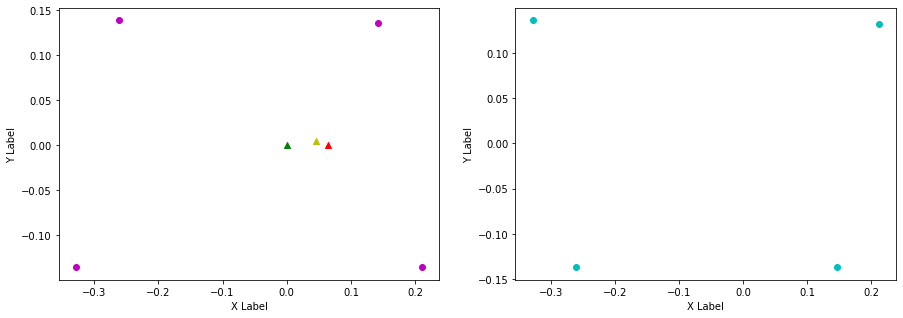

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.212, 0.16, FL (y): 0.132, 0.139.
FL displacement: -0.05199999999999999, 0.007000000000000006.

FR (x): 0.147, 0.223, FR (y): -0.136, -0.134.
FR displacement: 0.07600000000000001, 0.0020000000000000018.

RL (x): -0.329, -0.252, RL (y): 0.136, 0.137.
RL displacement: 0.07700000000000001, 0.0010000000000000009.

RR (x): -0.261, -0.306, RR (y): -0.137, -0.139.
RR displacement: -0.044999999999999984, -0.0020000000000000018.


Base displacement (Foot): [0.05199999999999999, -0.007000000000000006].

Base displacement (Odom): [[0.04565201627122306], [-0.008699437796141574]]. Rotation displacement: 0.34490550345795556.



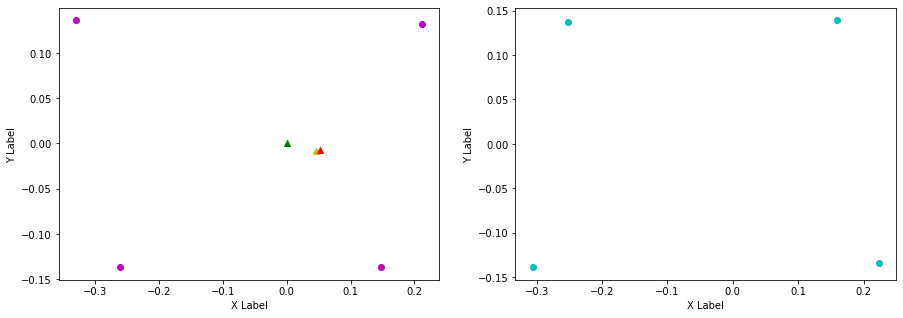

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.16, 0.218, FL (y): 0.139, 0.131.
FL displacement: 0.057999999999999996, -0.008000000000000007.

FR (x): 0.223, 0.167, FR (y): -0.134, -0.137.
FR displacement: -0.055999999999999994, -0.0030000000000000027.

RL (x): -0.252, -0.31, RL (y): 0.137, 0.137.
RL displacement: -0.057999999999999996, 0.0.

RR (x): -0.306, -0.256, RR (y): -0.139, -0.137.
RR displacement: 0.04999999999999999, 0.0020000000000000018.


Base displacement (Foot): [0.055999999999999994, 0.0030000000000000027].

Base displacement (Odom): [[0.061621843275307286], [0.011792096154886078]]. Rotation displacement: -1.0498402102238842.



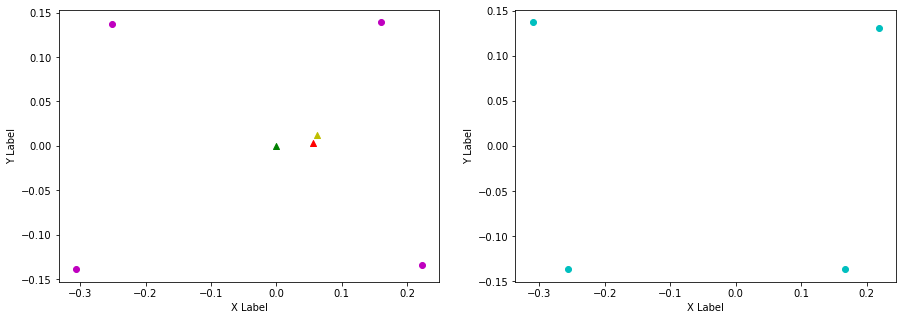

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.218, 0.142, FL (y): 0.131, 0.136.
FL displacement: -0.07600000000000001, 0.0050000000000000044.

FR (x): 0.167, 0.211, FR (y): -0.137, -0.136.
FR displacement: 0.043999999999999984, 0.0010000000000000009.

RL (x): -0.31, -0.262, RL (y): 0.137, 0.139.
RL displacement: 0.04799999999999999, 0.0020000000000000018.

RR (x): -0.256, -0.328, RR (y): -0.137, -0.135.
RR displacement: -0.07200000000000001, 0.0020000000000000018.


Base displacement (Foot): [0.07600000000000001, -0.0050000000000000044].

Base displacement (Odom): [[0.04574334886465148], [-0.006041301901345886]]. Rotation displacement: 0.8694832963281521.



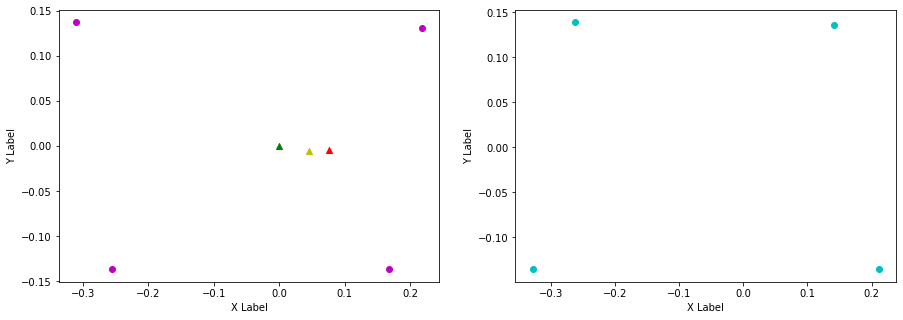

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.142, 0.213, FL (y): 0.136, 0.132.
FL displacement: 0.07100000000000001, -0.0040000000000000036.

FR (x): 0.211, 0.149, FR (y): -0.136, -0.136.
FR displacement: -0.062, 0.0.

RL (x): -0.262, -0.326, RL (y): 0.139, 0.136.
RL displacement: -0.064, -0.0030000000000000027.

RR (x): -0.328, -0.26, RR (y): -0.135, -0.137.
RR displacement: 0.068, -0.0020000000000000018.


Base displacement (Foot): [0.062, -0.0].

Base displacement (Odom): [[0.04580239995395741], [0.00892311661001699]]. Rotation displacement: -0.870285710385257.



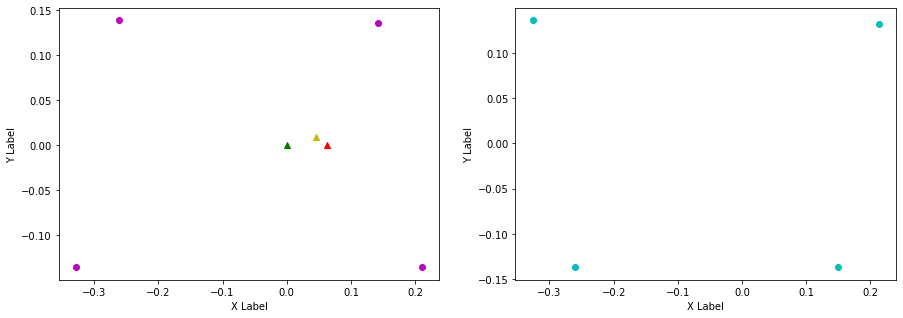

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.213, 0.145, FL (y): 0.132, 0.136.
FL displacement: -0.068, 0.0040000000000000036.

FR (x): 0.149, 0.212, FR (y): -0.136, -0.136.
FR displacement: 0.063, 0.0.

RL (x): -0.326, -0.262, RL (y): 0.136, 0.139.
RL displacement: 0.064, 0.0030000000000000027.

RR (x): -0.26, -0.325, RR (y): -0.137, -0.136.
RR displacement: -0.065, 0.0010000000000000009.


Base displacement (Foot): [0.068, -0.0040000000000000036].

Base displacement (Odom): [[0.034304370498623005], [-0.0053866767158918805]]. Rotation displacement: -0.0815607524995748.



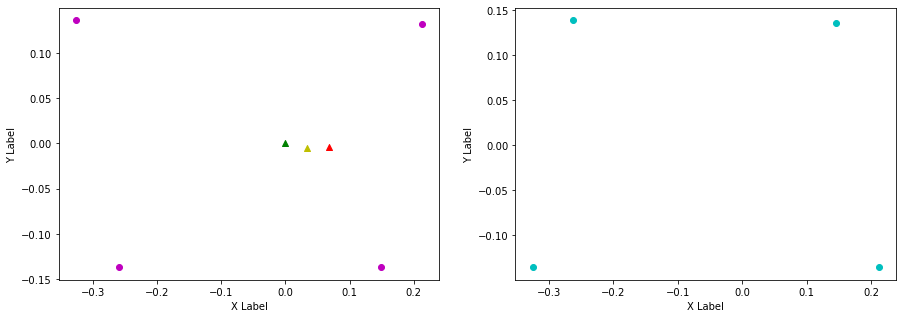

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.145, 0.212, FL (y): 0.136, 0.132.
FL displacement: 0.067, -0.0040000000000000036.

FR (x): 0.212, 0.144, FR (y): -0.136, -0.136.
FR displacement: -0.068, 0.0.

RL (x): -0.262, -0.334, RL (y): 0.139, 0.136.
RL displacement: -0.07200000000000001, -0.0030000000000000027.

RR (x): -0.325, -0.262, RR (y): -0.136, -0.137.
RR displacement: 0.063, -0.0010000000000000009.


Base displacement (Foot): [0.068, -0.0].

Base displacement (Odom): [[0.07210851027259157], [0.009004480217266408]]. Rotation displacement: -0.44438886966465313.



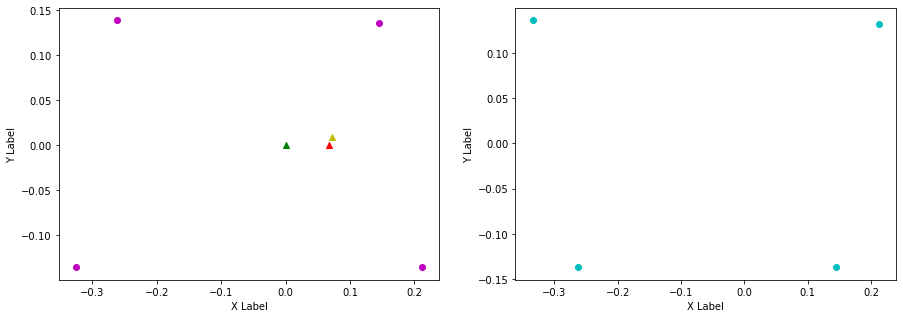

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.212, 0.145, FL (y): 0.132, 0.136.
FL displacement: -0.067, 0.0040000000000000036.

FR (x): 0.144, 0.213, FR (y): -0.136, -0.136.
FR displacement: 0.069, 0.0.

RL (x): -0.334, -0.261, RL (y): 0.136, 0.139.
RL displacement: 0.07300000000000001, 0.0030000000000000027.

RR (x): -0.262, -0.325, RR (y): -0.137, -0.136.
RR displacement: -0.063, 0.0010000000000000009.


Base displacement (Foot): [0.067, -0.0040000000000000036].

Base displacement (Odom): [[0.027418791287398436], [-0.0039648512146226444]]. Rotation displacement: 0.13704145916860933.



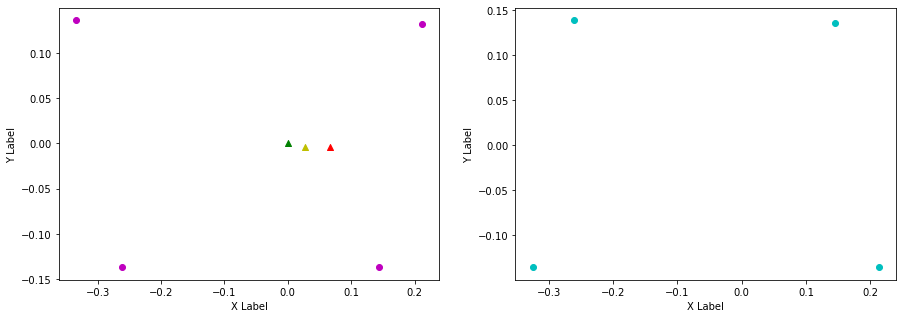

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.145, 0.216, FL (y): 0.136, 0.132.
FL displacement: 0.07100000000000001, -0.0040000000000000036.

FR (x): 0.213, 0.158, FR (y): -0.136, -0.137.
FR displacement: -0.05499999999999999, -0.0010000000000000009.

RL (x): -0.261, -0.319, RL (y): 0.139, 0.138.
RL displacement: -0.057999999999999996, -0.0010000000000000009.

RR (x): -0.325, -0.258, RR (y): -0.136, -0.137.
RR displacement: 0.067, -0.0010000000000000009.


Base displacement (Foot): [0.05499999999999999, 0.0010000000000000009].

Base displacement (Odom): [[0.06261403030471646], [0.008814519906105822]]. Rotation displacement: -0.8007254248613621.



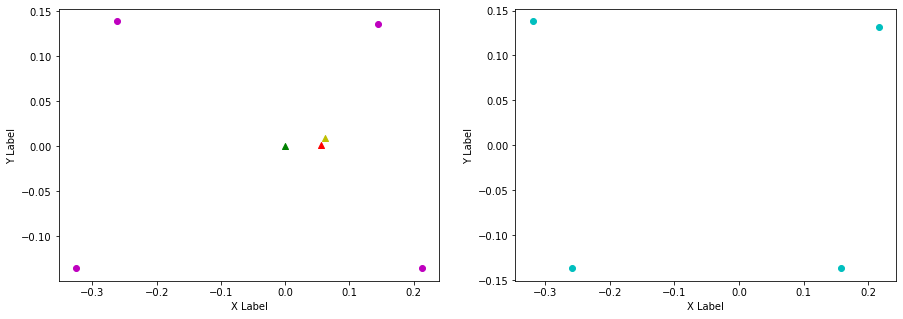

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.216, 0.143, FL (y): 0.132, 0.136.
FL displacement: -0.07300000000000001, 0.0040000000000000036.

FR (x): 0.158, 0.211, FR (y): -0.137, -0.136.
FR displacement: 0.05299999999999999, 0.0010000000000000009.

RL (x): -0.319, -0.262, RL (y): 0.138, 0.139.
RL displacement: 0.056999999999999995, 0.0010000000000000009.

RR (x): -0.258, -0.328, RR (y): -0.137, -0.136.
RR displacement: -0.07, 0.0010000000000000009.


Base displacement (Foot): [0.07300000000000001, -0.0040000000000000036].

Base displacement (Odom): [[0.041748420973853784], [-0.004944290595435774]]. Rotation displacement: 0.45660113566400096.



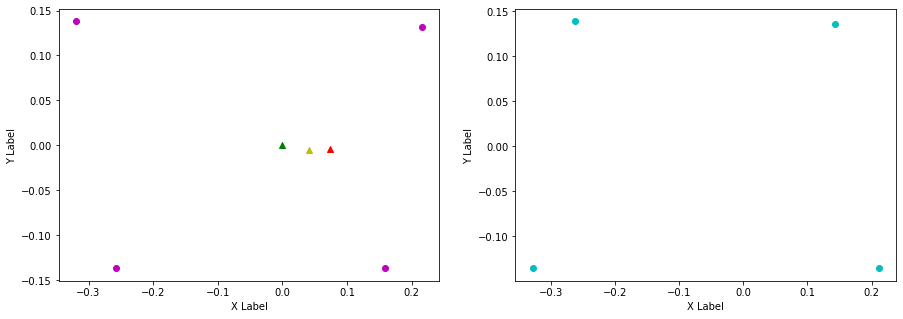

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.143, 0.212, FL (y): 0.136, 0.133.
FL displacement: 0.069, -0.0030000000000000027.

FR (x): 0.211, 0.144, FR (y): -0.136, -0.136.
FR displacement: -0.067, 0.0.

RL (x): -0.262, -0.334, RL (y): 0.139, 0.136.
RL displacement: -0.07200000000000001, -0.0030000000000000027.

RR (x): -0.328, -0.261, RR (y): -0.136, -0.137.
RR displacement: 0.067, -0.0010000000000000009.


Base displacement (Foot): [0.067, -0.0].

Base displacement (Odom): [[0.046207185595489864], [0.003755848654412919]]. Rotation displacement: -0.7724236651270386.



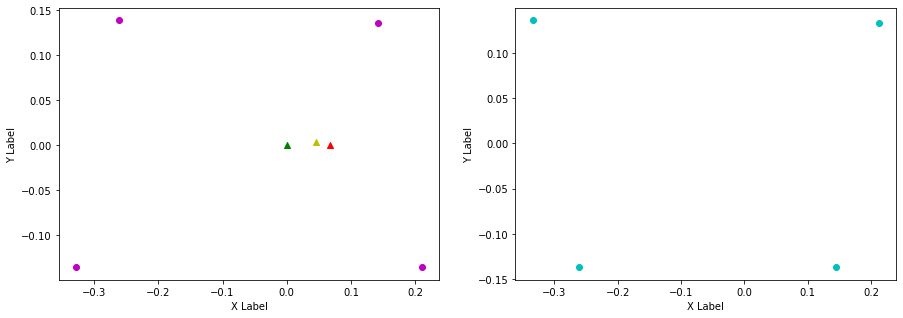

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.212, 0.151, FL (y): 0.133, 0.138.
FL displacement: -0.061, 0.0050000000000000044.

FR (x): 0.144, 0.216, FR (y): -0.136, -0.135.
FR displacement: 0.07200000000000001, 0.0010000000000000009.

RL (x): -0.334, -0.258, RL (y): 0.136, 0.139.
RL displacement: 0.07600000000000001, 0.0030000000000000027.

RR (x): -0.261, -0.317, RR (y): -0.137, -0.137.
RR displacement: -0.055999999999999994, 0.0.


Base displacement (Foot): [0.061, -0.0050000000000000044].

Base displacement (Odom): [[0.027619581541255545], [-0.003385914689433722]]. Rotation displacement: 0.19917058746211413.



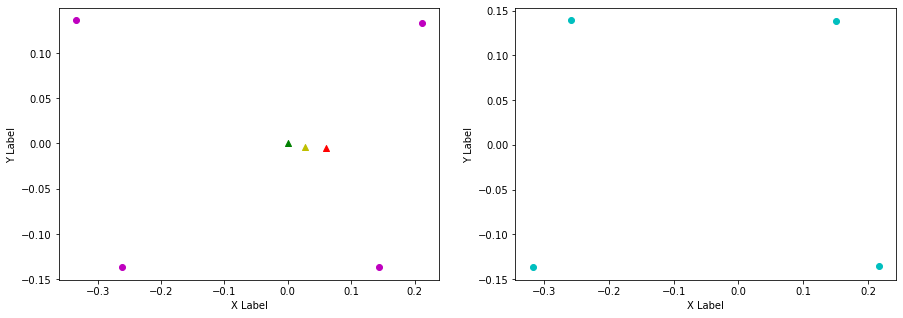

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.151, 0.221, FL (y): 0.138, 0.131.
FL displacement: 0.07, -0.007000000000000006.

FR (x): 0.216, 0.168, FR (y): -0.135, -0.138.
FR displacement: -0.04799999999999999, -0.0030000000000000027.

RL (x): -0.258, -0.308, RL (y): 0.139, 0.138.
RL displacement: -0.04999999999999999, -0.0010000000000000009.

RR (x): -0.317, -0.254, RR (y): -0.137, -0.136.
RR displacement: 0.063, 0.0010000000000000009.


Base displacement (Foot): [0.04799999999999999, 0.0030000000000000027].

Base displacement (Odom): [[0.0380489610400262], [0.002483624102311399]]. Rotation displacement: -0.7702844640121912.



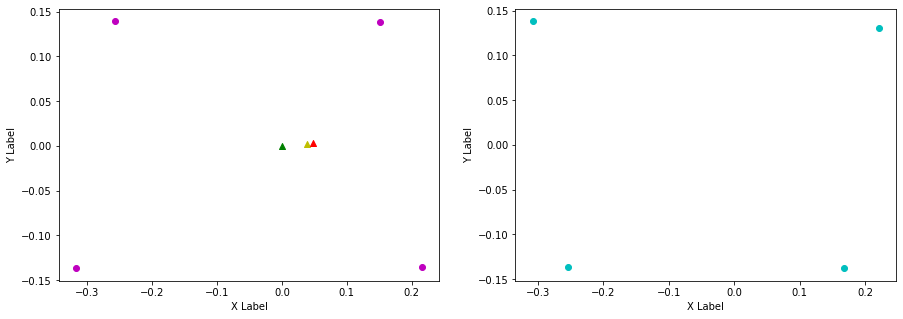

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.221, 0.156, FL (y): 0.131, 0.138.
FL displacement: -0.065, 0.007000000000000006.

FR (x): 0.168, 0.219, FR (y): -0.138, -0.135.
FR displacement: 0.05099999999999999, 0.0030000000000000027.

RL (x): -0.308, -0.255, RL (y): 0.138, 0.138.
RL displacement: 0.05299999999999999, 0.0.

RR (x): -0.254, -0.311, RR (y): -0.136, -0.138.
RR displacement: -0.056999999999999995, -0.0020000000000000018.


Base displacement (Foot): [0.065, -0.007000000000000006].

Base displacement (Odom): [[0.02023004732418865], [-0.0023449091204521544]]. Rotation displacement: 1.0162889545810767.



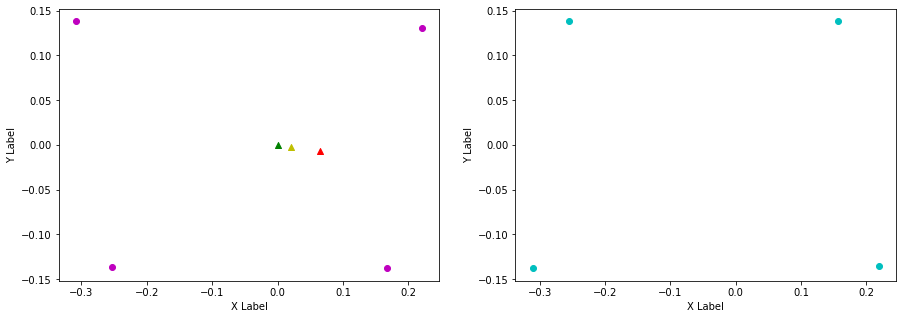

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.156, 0.218, FL (y): 0.138, 0.131.
FL displacement: 0.062, -0.007000000000000006.

FR (x): 0.219, 0.168, FR (y): -0.135, -0.137.
FR displacement: -0.05099999999999999, -0.0020000000000000018.

RL (x): -0.255, -0.311, RL (y): 0.138, 0.138.
RL displacement: -0.055999999999999994, 0.0.

RR (x): -0.311, -0.256, RR (y): -0.138, -0.137.
RR displacement: 0.05499999999999999, 0.0010000000000000009.


Base displacement (Foot): [0.05099999999999999, 0.0020000000000000018].

Base displacement (Odom): [[0.0601080530630137], [0.0084229705188692]]. Rotation displacement: -1.5509849250960297.



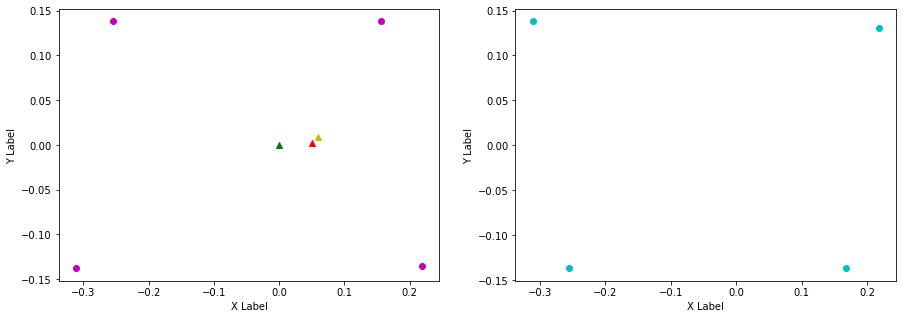

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.218, 0.155, FL (y): 0.131, 0.138.
FL displacement: -0.063, 0.007000000000000006.

FR (x): 0.168, 0.218, FR (y): -0.137, -0.134.
FR displacement: 0.04999999999999999, 0.0030000000000000027.

RL (x): -0.311, -0.256, RL (y): 0.138, 0.138.
RL displacement: 0.05499999999999999, 0.0.

RR (x): -0.256, -0.31, RR (y): -0.137, -0.138.
RR displacement: -0.05399999999999999, -0.0010000000000000009.


Base displacement (Foot): [0.063, -0.007000000000000006].

Base displacement (Odom): [[0.03888889295541831], [-0.007131767253783838]]. Rotation displacement: 1.1486322064670966.



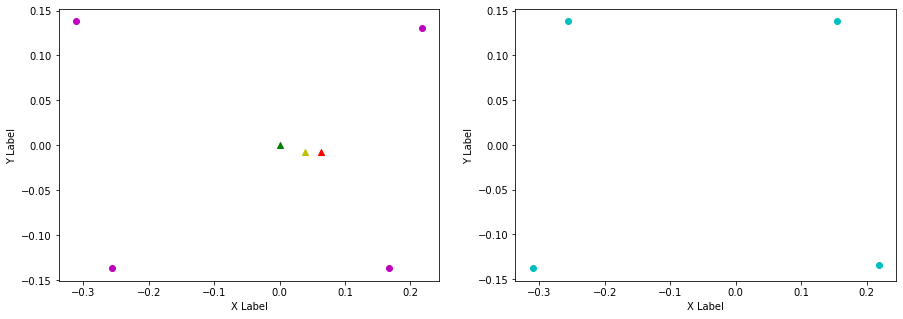

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.155, 0.213, FL (y): 0.138, 0.131.
FL displacement: 0.057999999999999996, -0.007000000000000006.

FR (x): 0.218, 0.152, FR (y): -0.134, -0.136.
FR displacement: -0.066, -0.0020000000000000018.

RL (x): -0.256, -0.327, RL (y): 0.138, 0.137.
RL displacement: -0.07100000000000001, -0.0010000000000000009.

RR (x): -0.31, -0.26, RR (y): -0.138, -0.137.
RR displacement: 0.04999999999999999, 0.0010000000000000009.


Base displacement (Foot): [0.066, 0.0020000000000000018].

Base displacement (Odom): [[0.039381006894881776], [0.006417355375956113]]. Rotation displacement: -1.5328422978965122.



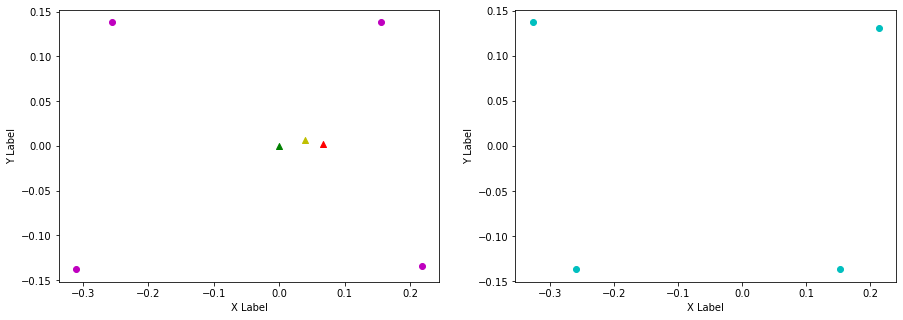

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.213, 0.153, FL (y): 0.131, 0.138.
FL displacement: -0.06, 0.007000000000000006.

FR (x): 0.152, 0.217, FR (y): -0.136, -0.134.
FR displacement: 0.065, 0.0020000000000000018.

RL (x): -0.327, -0.257, RL (y): 0.137, 0.138.
RL displacement: 0.07, 0.0010000000000000009.

RR (x): -0.26, -0.312, RR (y): -0.137, -0.137.
RR displacement: -0.05199999999999999, 0.0.


Base displacement (Foot): [0.06, -0.007000000000000006].

Base displacement (Odom): [[0.046793513843155665], [-0.0056300444994299426]]. Rotation displacement: 0.5565624240067258.



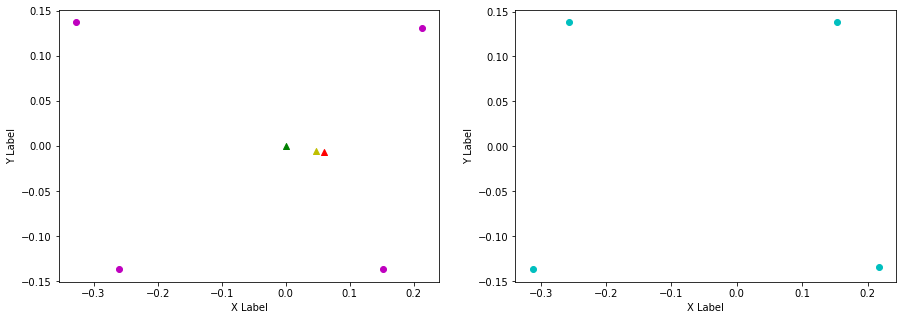

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.153, 0.214, FL (y): 0.138, 0.131.
FL displacement: 0.061, -0.007000000000000006.

FR (x): 0.217, 0.154, FR (y): -0.134, -0.136.
FR displacement: -0.063, -0.0020000000000000018.

RL (x): -0.257, -0.322, RL (y): 0.138, 0.137.
RL displacement: -0.065, -0.0010000000000000009.

RR (x): -0.312, -0.26, RR (y): -0.137, -0.137.
RR displacement: 0.05199999999999999, 0.0.


Base displacement (Foot): [0.063, 0.0020000000000000018].

Base displacement (Odom): [[0.066711004966728], [0.006290548483482539]]. Rotation displacement: -0.9090685060642624.



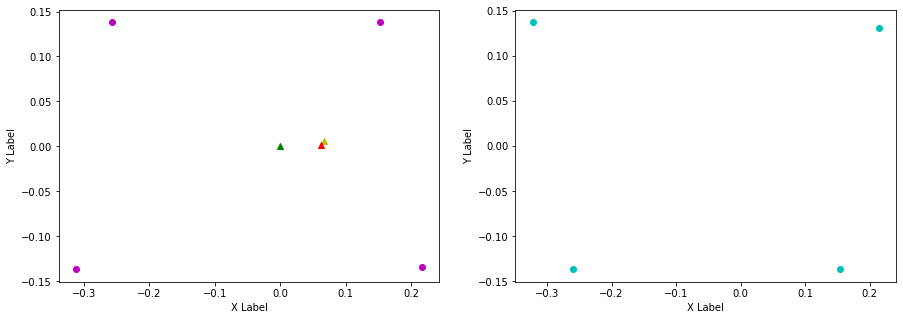

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.214, 0.157, FL (y): 0.131, 0.138.
FL displacement: -0.056999999999999995, 0.007000000000000006.

FR (x): 0.154, 0.221, FR (y): -0.136, -0.134.
FR displacement: 0.067, 0.0020000000000000018.

RL (x): -0.322, -0.253, RL (y): 0.137, 0.138.
RL displacement: 0.069, 0.0010000000000000009.

RR (x): -0.26, -0.309, RR (y): -0.137, -0.138.
RR displacement: -0.04899999999999999, -0.0010000000000000009.


Base displacement (Foot): [0.056999999999999995, -0.007000000000000006].

Base displacement (Odom): [[0.050699947332070394], [-0.007079278793383992]]. Rotation displacement: 0.4277817457272107.



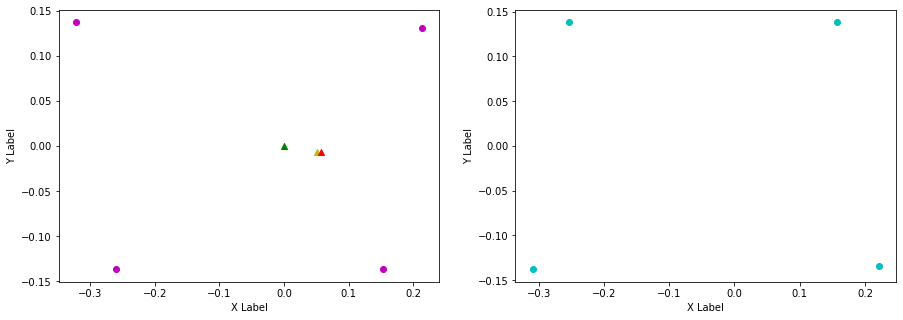

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.157, 0.221, FL (y): 0.138, 0.131.
FL displacement: 0.064, -0.007000000000000006.

FR (x): 0.221, 0.168, FR (y): -0.134, -0.138.
FR displacement: -0.05299999999999999, -0.0040000000000000036.

RL (x): -0.253, -0.307, RL (y): 0.138, 0.138.
RL displacement: -0.05399999999999999, 0.0.

RR (x): -0.309, -0.254, RR (y): -0.138, -0.136.
RR displacement: 0.05499999999999999, 0.0020000000000000018.


Base displacement (Foot): [0.05299999999999999, 0.0040000000000000036].

Base displacement (Odom): [[0.056349107785842456], [0.0041600566339043965]]. Rotation displacement: -1.0889357825146375.



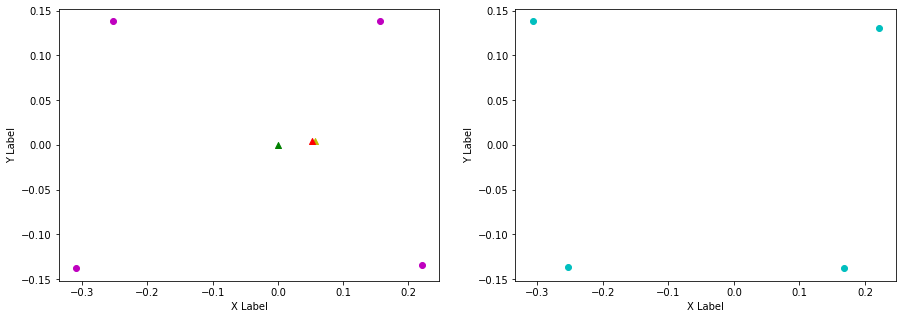

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.221, 0.145, FL (y): 0.131, 0.136.
FL displacement: -0.07600000000000001, 0.0050000000000000044.

FR (x): 0.168, 0.212, FR (y): -0.138, -0.136.
FR displacement: 0.043999999999999984, 0.0020000000000000018.

RL (x): -0.307, -0.261, RL (y): 0.138, 0.139.
RL displacement: 0.045999999999999985, 0.0010000000000000009.

RR (x): -0.254, -0.325, RR (y): -0.136, -0.136.
RR displacement: -0.07100000000000001, 0.0.


Base displacement (Foot): [0.07600000000000001, -0.0050000000000000044].

Base displacement (Odom): [[0.061110431043316815], [-0.005399661195212513]]. Rotation displacement: 1.3219483160761196.



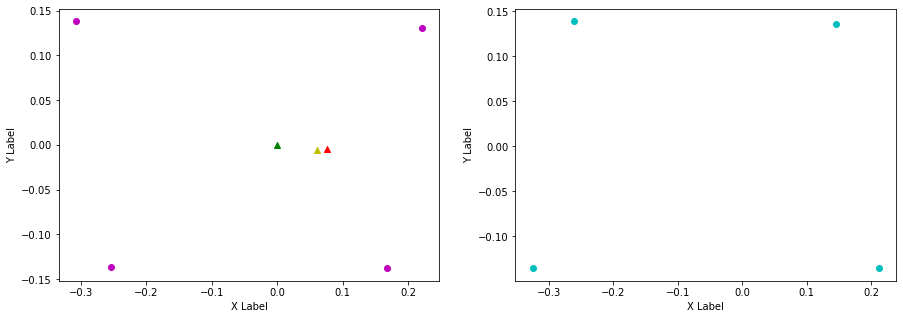

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.145, 0.211, FL (y): 0.136, 0.132.
FL displacement: 0.066, -0.0040000000000000036.

FR (x): 0.212, 0.144, FR (y): -0.136, -0.135.
FR displacement: -0.068, 0.0010000000000000009.

RL (x): -0.261, -0.334, RL (y): 0.139, 0.136.
RL displacement: -0.07300000000000001, -0.0030000000000000027.

RR (x): -0.325, -0.262, RR (y): -0.136, -0.137.
RR displacement: 0.063, -0.0010000000000000009.


Base displacement (Foot): [0.068, -0.0010000000000000009].

Base displacement (Odom): [[0.0787912620530884], [0.00870447587747103]]. Rotation displacement: -1.428267738037592.



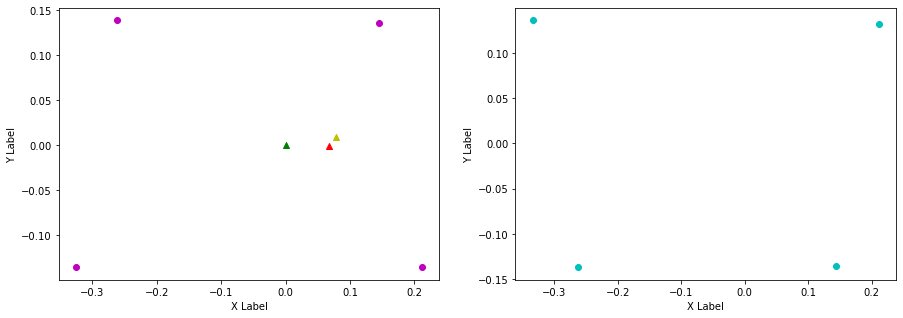

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.211, 0.147, FL (y): 0.132, 0.137.
FL displacement: -0.064, 0.0050000000000000044.

FR (x): 0.144, 0.213, FR (y): -0.135, -0.135.
FR displacement: 0.069, 0.0.

RL (x): -0.334, -0.26, RL (y): 0.136, 0.139.
RL displacement: 0.07400000000000001, 0.0030000000000000027.

RR (x): -0.262, -0.322, RR (y): -0.137, -0.136.
RR displacement: -0.06, 0.0010000000000000009.


Base displacement (Foot): [0.064, -0.0050000000000000044].

Base displacement (Odom): [[0.03681661542986081], [-0.004864032794327233]]. Rotation displacement: 0.26517966540889354.



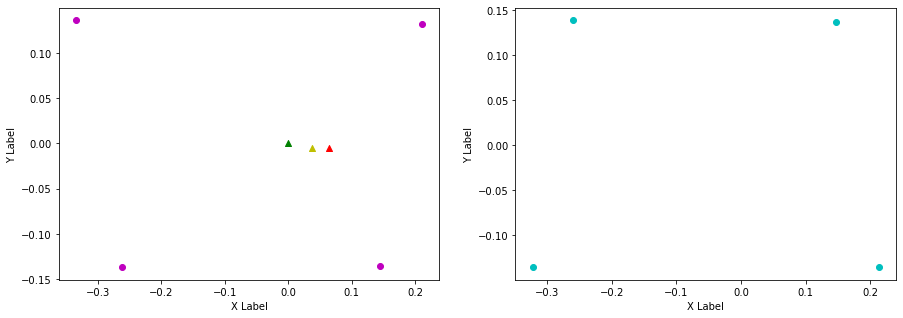

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.147, 0.218, FL (y): 0.137, 0.131.
FL displacement: 0.07100000000000001, -0.006000000000000005.

FR (x): 0.213, 0.168, FR (y): -0.135, -0.137.
FR displacement: -0.044999999999999984, -0.0020000000000000018.

RL (x): -0.26, -0.309, RL (y): 0.139, 0.137.
RL displacement: -0.04899999999999999, -0.0020000000000000018.

RR (x): -0.322, -0.256, RR (y): -0.136, -0.136.
RR displacement: 0.066, 0.0.


Base displacement (Foot): [0.044999999999999984, 0.0020000000000000018].

Base displacement (Odom): [[0.04915212550303405], [0.006291220657555829]]. Rotation displacement: -0.4336758791477562.



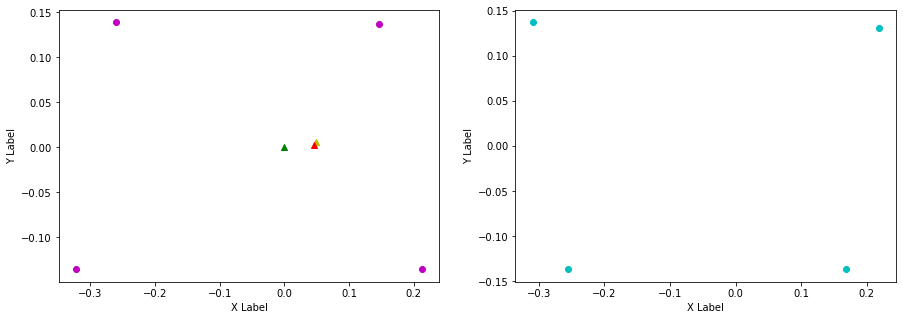

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.218, 0.149, FL (y): 0.131, 0.137.
FL displacement: -0.069, 0.006000000000000005.

FR (x): 0.168, 0.215, FR (y): -0.137, -0.135.
FR displacement: 0.046999999999999986, 0.0020000000000000018.

RL (x): -0.309, -0.259, RL (y): 0.137, 0.138.
RL displacement: 0.04999999999999999, 0.0010000000000000009.

RR (x): -0.256, -0.319, RR (y): -0.136, -0.136.
RR displacement: -0.063, 0.0.


Base displacement (Foot): [0.069, -0.006000000000000005].

Base displacement (Odom): [[0.040624176632583], [-0.007364265067572706]]. Rotation displacement: 0.6669006368643049.



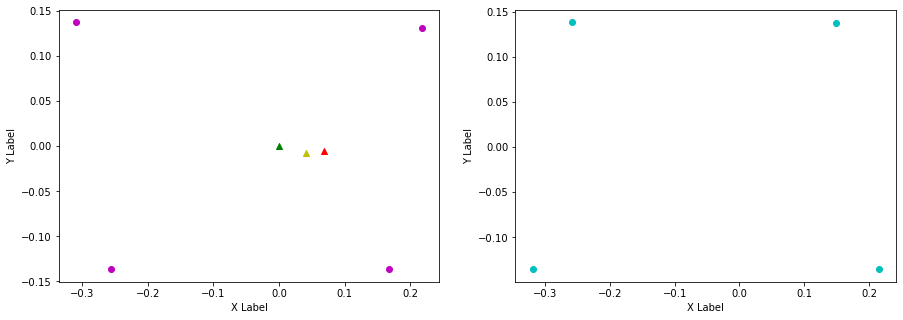

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.149, 0.22, FL (y): 0.137, 0.131.
FL displacement: 0.07100000000000001, -0.006000000000000005.

FR (x): 0.215, 0.169, FR (y): -0.135, -0.138.
FR displacement: -0.045999999999999985, -0.0030000000000000027.

RL (x): -0.259, -0.309, RL (y): 0.138, 0.138.
RL displacement: -0.04999999999999999, 0.0.

RR (x): -0.319, -0.255, RR (y): -0.136, -0.136.
RR displacement: 0.064, 0.0.


Base displacement (Foot): [0.045999999999999985, 0.0030000000000000027].

Base displacement (Odom): [[0.04358369804671214], [0.0019631592149984556]]. Rotation displacement: -1.4921764921795333.



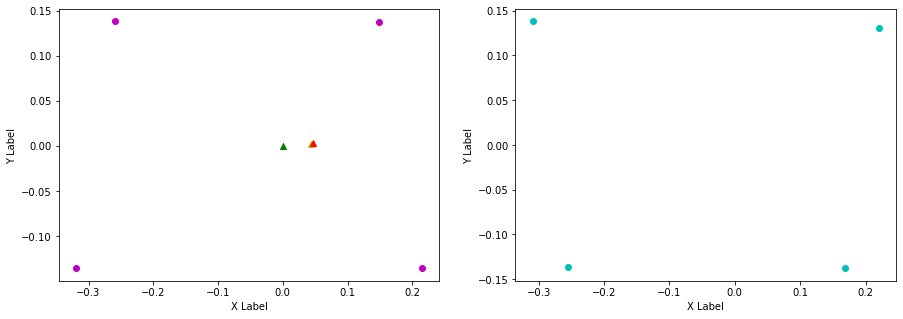

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.22, 0.147, FL (y): 0.131, 0.137.
FL displacement: -0.07300000000000001, 0.006000000000000005.

FR (x): 0.169, 0.214, FR (y): -0.138, -0.135.
FR displacement: 0.044999999999999984, 0.0030000000000000027.

RL (x): -0.309, -0.26, RL (y): 0.138, 0.139.
RL displacement: 0.04899999999999999, 0.0010000000000000009.

RR (x): -0.255, -0.323, RR (y): -0.136, -0.136.
RR displacement: -0.068, 0.0.


Base displacement (Foot): [0.07300000000000001, -0.006000000000000005].

Base displacement (Odom): [[0.07418751590879347], [-0.012096918347156205]]. Rotation displacement: 0.9150235791930551.



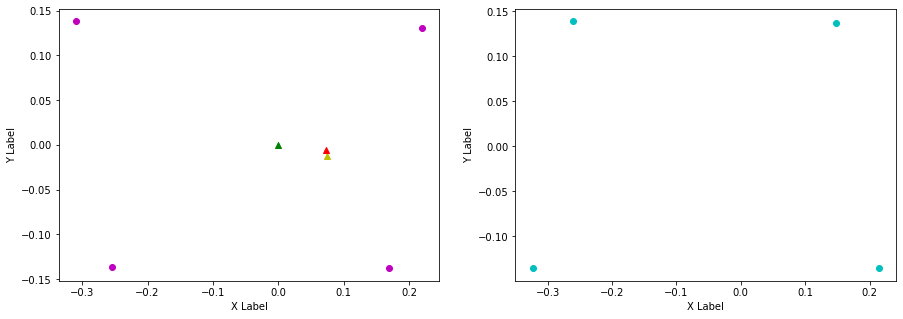

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.147, 0.213, FL (y): 0.137, 0.132.
FL displacement: 0.066, -0.0050000000000000044.

FR (x): 0.214, 0.15, FR (y): -0.135, -0.136.
FR displacement: -0.064, -0.0010000000000000009.

RL (x): -0.26, -0.327, RL (y): 0.139, 0.137.
RL displacement: -0.067, -0.0020000000000000018.

RR (x): -0.323, -0.261, RR (y): -0.136, -0.137.
RR displacement: 0.062, -0.0010000000000000009.


Base displacement (Foot): [0.064, 0.0010000000000000009].

Base displacement (Odom): [[0.02755962374207388], [0.0021411893154872352]]. Rotation displacement: -1.4878553210549483.



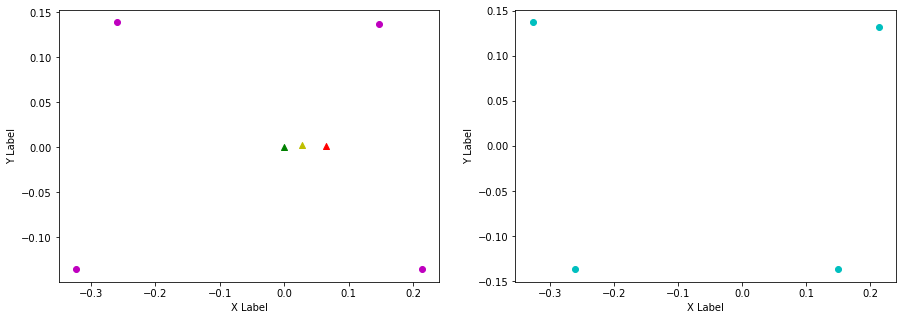

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.213, 0.154, FL (y): 0.132, 0.138.
FL displacement: -0.059, 0.006000000000000005.

FR (x): 0.15, 0.218, FR (y): -0.136, -0.135.
FR displacement: 0.068, 0.0010000000000000009.

RL (x): -0.327, -0.257, RL (y): 0.137, 0.139.
RL displacement: 0.07, 0.0020000000000000018.

RR (x): -0.261, -0.314, RR (y): -0.137, -0.138.
RR displacement: -0.05299999999999999, -0.0010000000000000009.


Base displacement (Foot): [0.059, -0.006000000000000005].

Base displacement (Odom): [[0.0510432736970452], [-0.006566815115168545]]. Rotation displacement: 0.6129884934984288.



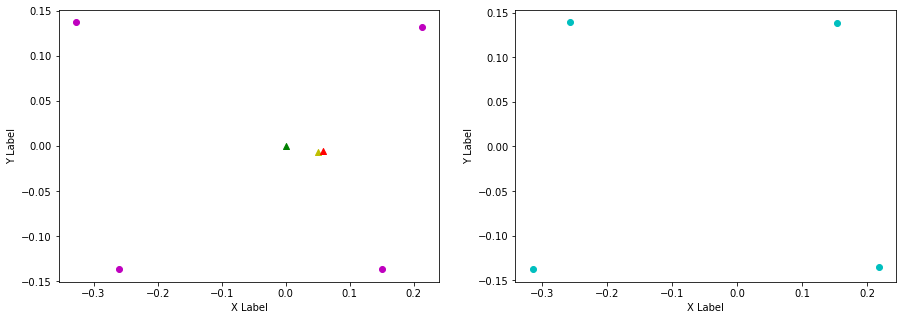

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.154, 0.221, FL (y): 0.138, 0.131.
FL displacement: 0.067, -0.007000000000000006.

FR (x): 0.218, 0.168, FR (y): -0.135, -0.138.
FR displacement: -0.04999999999999999, -0.0030000000000000027.

RL (x): -0.257, -0.308, RL (y): 0.139, 0.138.
RL displacement: -0.05099999999999999, -0.0010000000000000009.

RR (x): -0.314, -0.254, RR (y): -0.138, -0.136.
RR displacement: 0.06, 0.0020000000000000018.


Base displacement (Foot): [0.04999999999999999, 0.0030000000000000027].

Base displacement (Odom): [[0.05098596772533037], [0.009912011568461665]]. Rotation displacement: -1.0026193365529583.



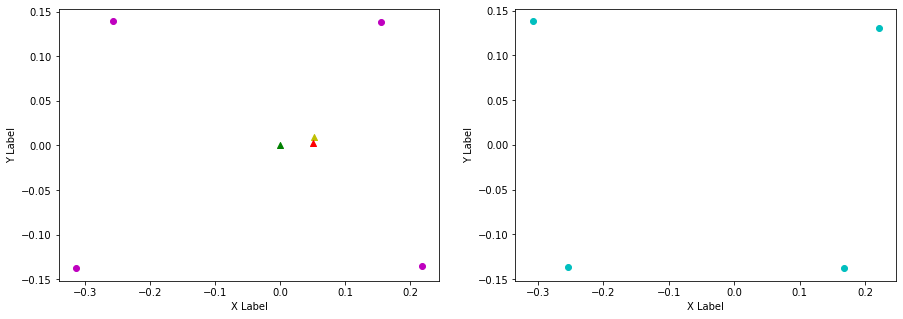

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.221, 0.163, FL (y): 0.131, 0.141.
FL displacement: -0.057999999999999996, 0.009999999999999981.

FR (x): 0.168, 0.227, FR (y): -0.138, -0.134.
FR displacement: 0.059, 0.0040000000000000036.

RL (x): -0.308, -0.249, RL (y): 0.138, 0.137.
RL displacement: 0.059, -0.0010000000000000009.

RR (x): -0.254, -0.303, RR (y): -0.136, -0.14.
RR displacement: -0.04899999999999999, -0.0040000000000000036.


Base displacement (Foot): [0.057999999999999996, -0.009999999999999981].

Base displacement (Odom): [[0.05419494658596191], [-0.008757108802214031]]. Rotation displacement: 1.0619895134580102.



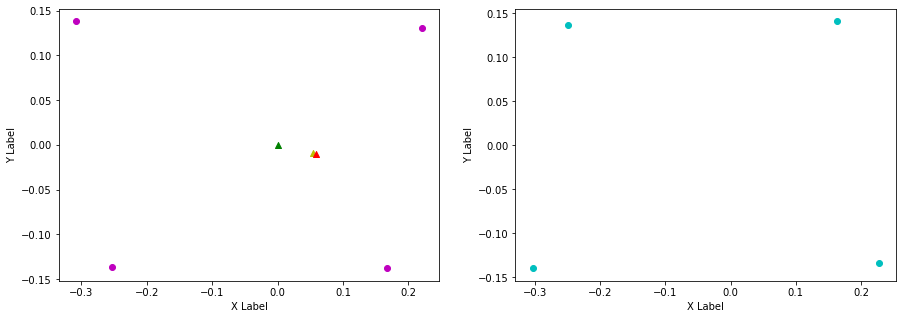

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.212, 0.142, FL (y): 0.132, 0.136.
FL displacement: -0.07, 0.0040000000000000036.

FR (x): 0.147, 0.211, FR (y): -0.135, -0.136.
FR displacement: 0.064, -0.0010000000000000009.

RL (x): -0.33, -0.262, RL (y): 0.136, 0.139.
RL displacement: 0.068, 0.0030000000000000027.

RR (x): -0.261, -0.328, RR (y): -0.137, -0.136.
RR displacement: -0.067, 0.0010000000000000009.


Base displacement (Foot): [0.07, -0.0040000000000000036].

Base displacement (Odom): [[0.02848912200591691], [-0.0064557590135385645]]. Rotation displacement: -1.5489546657954898.



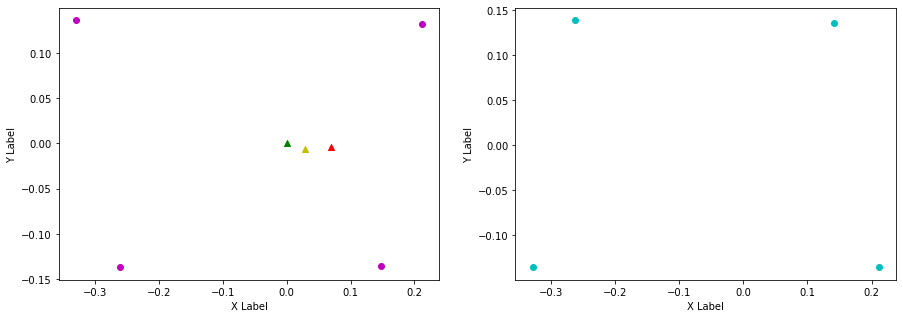

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.142, 0.213, FL (y): 0.136, 0.132.
FL displacement: 0.07100000000000001, -0.0040000000000000036.

FR (x): 0.211, 0.15, FR (y): -0.136, -0.136.
FR displacement: -0.061, 0.0.

RL (x): -0.262, -0.326, RL (y): 0.139, 0.137.
RL displacement: -0.064, -0.0020000000000000018.

RR (x): -0.328, -0.261, RR (y): -0.136, -0.137.
RR displacement: 0.067, -0.0010000000000000009.


Base displacement (Foot): [0.061, -0.0].

Base displacement (Odom): [[0.0705202898752415], [0.008912446823314824]]. Rotation displacement: -0.40512218999266586.



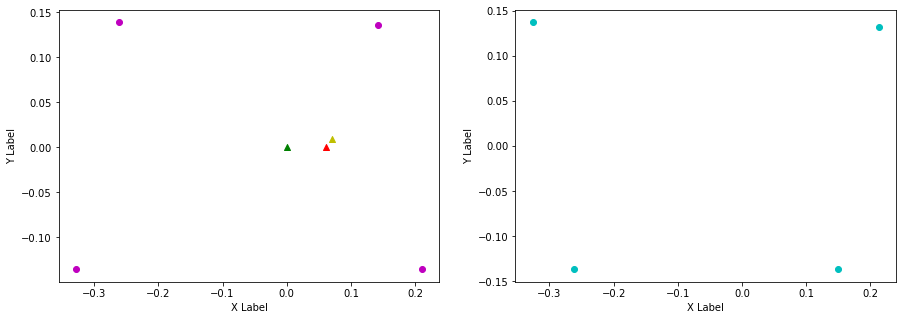

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.213, 0.149, FL (y): 0.132, 0.137.
FL displacement: -0.064, 0.0050000000000000044.

FR (x): 0.15, 0.215, FR (y): -0.136, -0.135.
FR displacement: 0.065, 0.0010000000000000009.

RL (x): -0.326, -0.259, RL (y): 0.137, 0.139.
RL displacement: 0.067, 0.0020000000000000018.

RR (x): -0.261, -0.32, RR (y): -0.137, -0.137.
RR displacement: -0.059, 0.0.


Base displacement (Foot): [0.064, -0.0050000000000000044].

Base displacement (Odom): [[0.044834796653622444], [-0.004396284344271528]]. Rotation displacement: 0.7855233620703528.



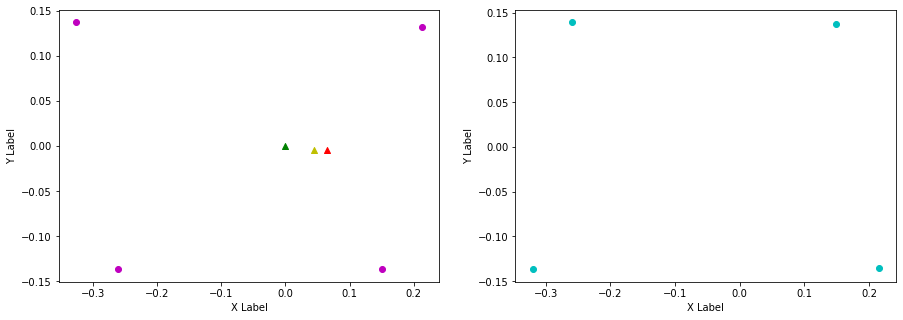

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.149, 0.214, FL (y): 0.137, 0.132.
FL displacement: 0.065, -0.0050000000000000044.

FR (x): 0.215, 0.15, FR (y): -0.135, -0.136.
FR displacement: -0.065, -0.0010000000000000009.

RL (x): -0.259, -0.328, RL (y): 0.139, 0.137.
RL displacement: -0.069, -0.0020000000000000018.

RR (x): -0.32, -0.26, RR (y): -0.137, -0.137.
RR displacement: 0.06, 0.0.


Base displacement (Foot): [0.065, 0.0010000000000000009].

Base displacement (Odom): [[0.057274777632590146], [0.009269900124513342]]. Rotation displacement: -1.0793112624585337.



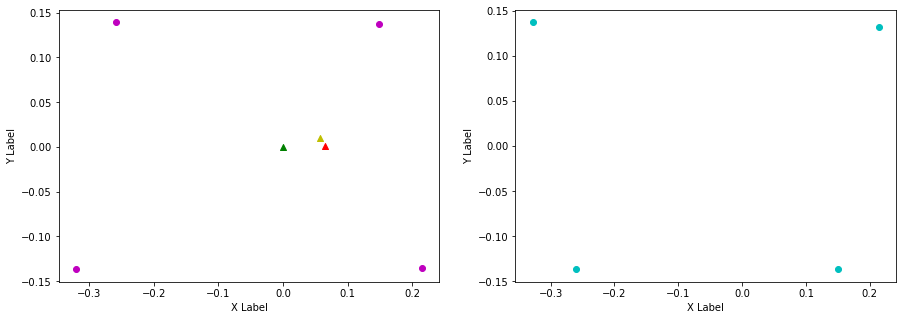

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.214, 0.152, FL (y): 0.132, 0.138.
FL displacement: -0.062, 0.006000000000000005.

FR (x): 0.15, 0.216, FR (y): -0.136, -0.135.
FR displacement: 0.066, 0.0010000000000000009.

RL (x): -0.328, -0.258, RL (y): 0.137, 0.139.
RL displacement: 0.07, 0.0020000000000000018.

RR (x): -0.26, -0.317, RR (y): -0.137, -0.137.
RR displacement: -0.056999999999999995, 0.0.


Base displacement (Foot): [0.062, -0.006000000000000005].

Base displacement (Odom): [[0.04827666820258347], [-0.006338690191548313]]. Rotation displacement: 0.1576262939360802.



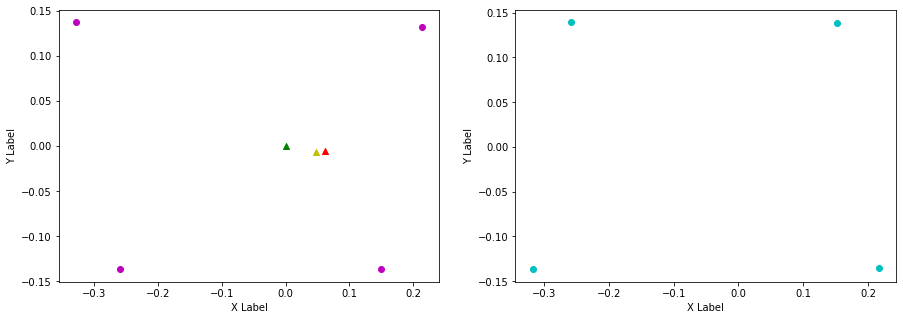

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.152, 0.213, FL (y): 0.138, 0.132.
FL displacement: 0.061, -0.006000000000000005.

FR (x): 0.216, 0.147, FR (y): -0.135, -0.136.
FR displacement: -0.069, -0.0010000000000000009.

RL (x): -0.258, -0.33, RL (y): 0.139, 0.137.
RL displacement: -0.07200000000000001, -0.0020000000000000018.

RR (x): -0.317, -0.261, RR (y): -0.137, -0.137.
RR displacement: 0.055999999999999994, 0.0.


Base displacement (Foot): [0.069, 0.0010000000000000009].

Base displacement (Odom): [[0.03909926598745317], [0.0026612871063909083]]. Rotation displacement: -0.5163976482515481.



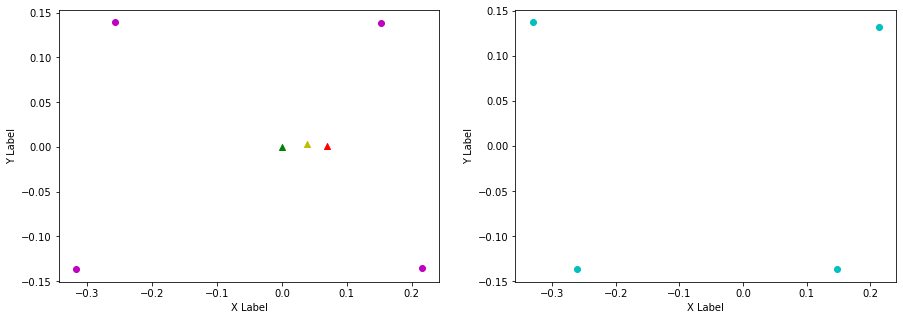

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.213, 0.149, FL (y): 0.132, 0.137.
FL displacement: -0.064, 0.0050000000000000044.

FR (x): 0.147, 0.215, FR (y): -0.136, -0.135.
FR displacement: 0.068, 0.0010000000000000009.

RL (x): -0.33, -0.259, RL (y): 0.137, 0.138.
RL displacement: 0.07100000000000001, 0.0010000000000000009.

RR (x): -0.261, -0.32, RR (y): -0.137, -0.137.
RR displacement: -0.059, 0.0.


Base displacement (Foot): [0.064, -0.0050000000000000044].

Base displacement (Odom): [[0.03261561683991676], [-0.003303718869913208]]. Rotation displacement: 0.2469239108505188.



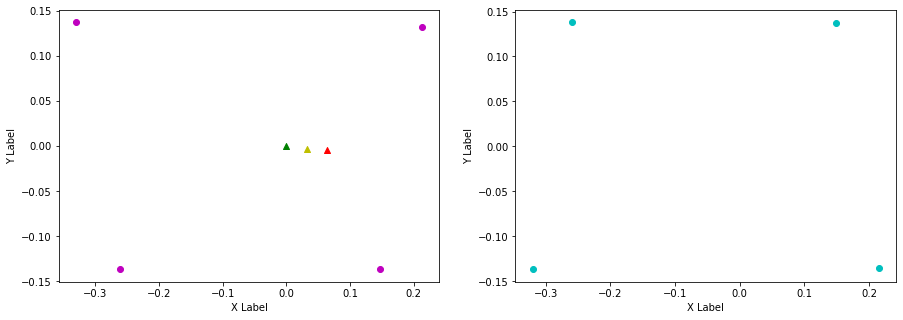

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.149, 0.218, FL (y): 0.137, 0.131.
FL displacement: 0.069, -0.006000000000000005.

FR (x): 0.215, 0.166, FR (y): -0.135, -0.137.
FR displacement: -0.04899999999999999, -0.0020000000000000018.

RL (x): -0.259, -0.312, RL (y): 0.138, 0.138.
RL displacement: -0.05299999999999999, 0.0.

RR (x): -0.32, -0.257, RR (y): -0.137, -0.137.
RR displacement: 0.063, 0.0.


Base displacement (Foot): [0.04899999999999999, 0.0020000000000000018].

Base displacement (Odom): [[0.06897446857141531], [0.007266309374775126]]. Rotation displacement: -0.765887823963445.



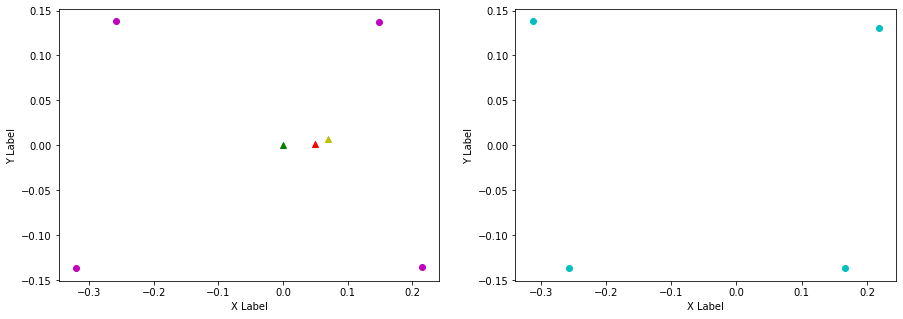

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.218, 0.157, FL (y): 0.131, 0.138.
FL displacement: -0.061, 0.007000000000000006.

FR (x): 0.166, 0.221, FR (y): -0.137, -0.134.
FR displacement: 0.05499999999999999, 0.0030000000000000027.

RL (x): -0.312, -0.253, RL (y): 0.138, 0.138.
RL displacement: 0.059, 0.0.

RR (x): -0.257, -0.309, RR (y): -0.137, -0.138.
RR displacement: -0.05199999999999999, -0.0010000000000000009.


Base displacement (Foot): [0.061, -0.007000000000000006].

Base displacement (Odom): [[0.02254763983395902], [-0.002593705042380101]]. Rotation displacement: 0.7412901208979381.



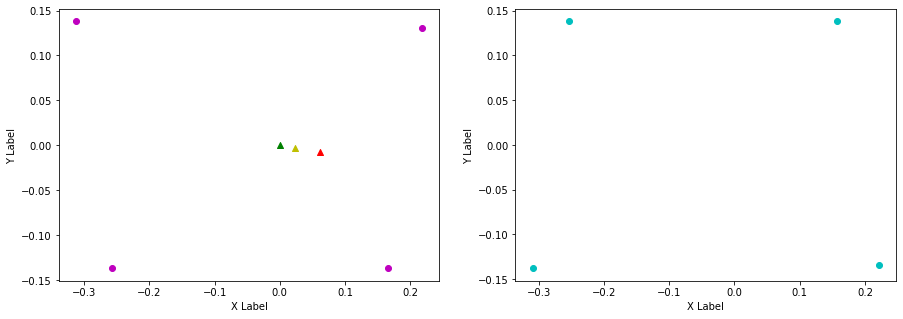

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.157, 0.219, FL (y): 0.138, 0.131.
FL displacement: 0.062, -0.007000000000000006.

FR (x): 0.221, 0.168, FR (y): -0.134, -0.138.
FR displacement: -0.05299999999999999, -0.0040000000000000036.

RL (x): -0.253, -0.309, RL (y): 0.138, 0.138.
RL displacement: -0.055999999999999994, 0.0.

RR (x): -0.309, -0.255, RR (y): -0.138, -0.137.
RR displacement: 0.05399999999999999, 0.0010000000000000009.


Base displacement (Foot): [0.05299999999999999, 0.0040000000000000036].

Base displacement (Odom): [[0.02088710306545649], [0.0034124407650097943]]. Rotation displacement: -1.6187390697704307.



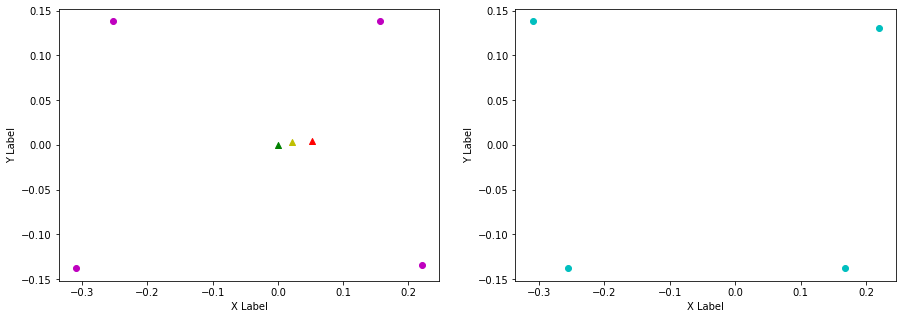

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.219, 0.149, FL (y): 0.131, 0.137.
FL displacement: -0.07, 0.006000000000000005.

FR (x): 0.168, 0.215, FR (y): -0.138, -0.135.
FR displacement: 0.046999999999999986, 0.0030000000000000027.

RL (x): -0.309, -0.259, RL (y): 0.138, 0.138.
RL displacement: 0.04999999999999999, 0.0.

RR (x): -0.255, -0.32, RR (y): -0.137, -0.137.
RR displacement: -0.065, 0.0.


Base displacement (Foot): [0.07, -0.006000000000000005].

Base displacement (Odom): [[0.035414086721872184], [-0.003023217943535439]]. Rotation displacement: 1.2397641293418564.



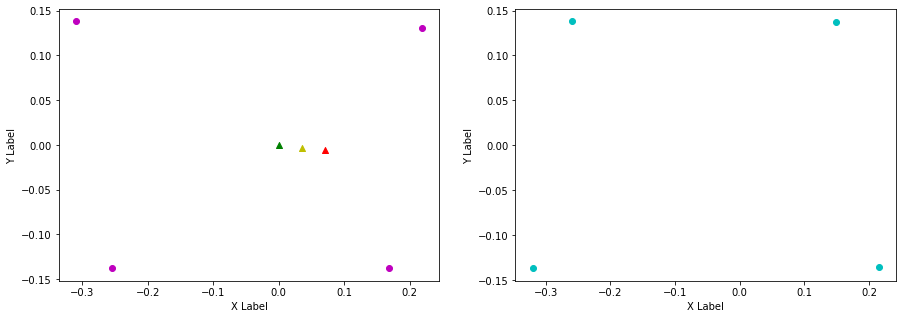

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.149, 0.218, FL (y): 0.137, 0.131.
FL displacement: 0.069, -0.006000000000000005.

FR (x): 0.215, 0.168, FR (y): -0.135, -0.137.
FR displacement: -0.046999999999999986, -0.0020000000000000018.

RL (x): -0.259, -0.31, RL (y): 0.138, 0.138.
RL displacement: -0.05099999999999999, 0.0.

RR (x): -0.32, -0.256, RR (y): -0.137, -0.137.
RR displacement: 0.064, 0.0.


Base displacement (Foot): [0.046999999999999986, 0.0020000000000000018].

Base displacement (Odom): [[0.06570471835093006], [0.0076254869722580665]]. Rotation displacement: -1.2696336913028439.



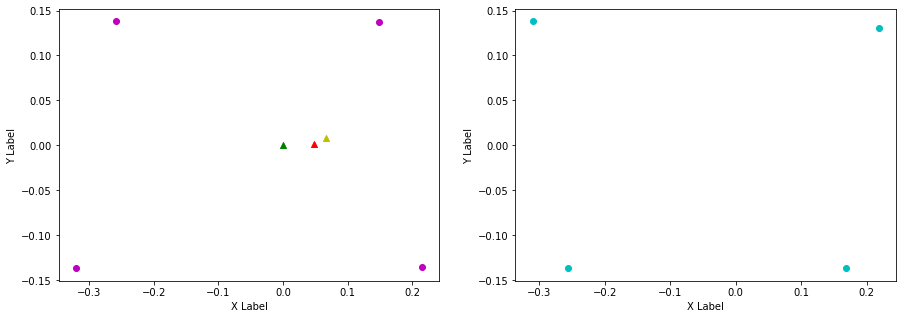

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.218, 0.145, FL (y): 0.131, 0.136.
FL displacement: -0.07300000000000001, 0.0050000000000000044.

FR (x): 0.168, 0.212, FR (y): -0.137, -0.135.
FR displacement: 0.043999999999999984, 0.0020000000000000018.

RL (x): -0.31, -0.262, RL (y): 0.138, 0.139.
RL displacement: 0.04799999999999999, 0.0010000000000000009.

RR (x): -0.256, -0.324, RR (y): -0.137, -0.136.
RR displacement: -0.068, 0.0010000000000000009.


Base displacement (Foot): [0.07300000000000001, -0.0050000000000000044].

Base displacement (Odom): [[0.056921849085005416], [-0.00951110116837306]]. Rotation displacement: 1.031080755196948.



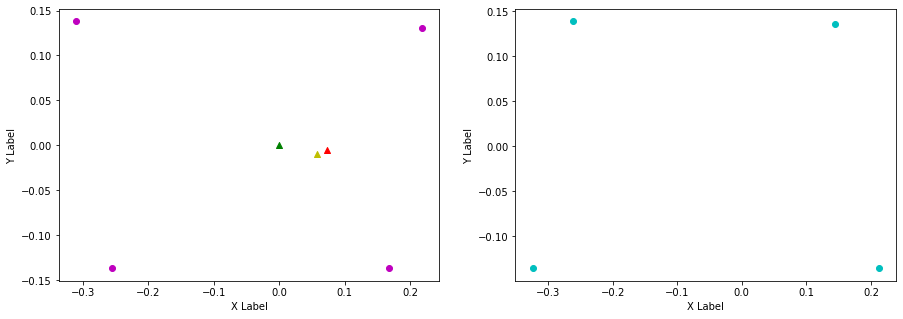

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.145, 0.222, FL (y): 0.136, 0.131.
FL displacement: 0.07700000000000001, -0.0050000000000000044.

FR (x): 0.212, 0.168, FR (y): -0.135, -0.139.
FR displacement: -0.043999999999999984, -0.0040000000000000036.

RL (x): -0.262, -0.306, RL (y): 0.139, 0.139.
RL displacement: -0.043999999999999984, 0.0.

RR (x): -0.324, -0.253, RR (y): -0.136, -0.136.
RR displacement: 0.07100000000000001, 0.0.


Base displacement (Foot): [0.043999999999999984, 0.0040000000000000036].

Base displacement (Odom): [[0.05965700003739238], [0.0087792794751258]]. Rotation displacement: -1.199667710686822.



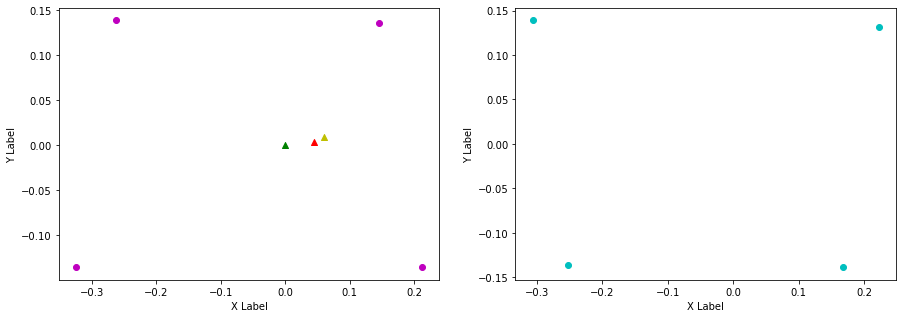

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.222, 0.145, FL (y): 0.131, 0.136.
FL displacement: -0.07700000000000001, 0.0050000000000000044.

FR (x): 0.168, 0.212, FR (y): -0.139, -0.135.
FR displacement: 0.043999999999999984, 0.0040000000000000036.

RL (x): -0.306, -0.262, RL (y): 0.139, 0.139.
RL displacement: 0.043999999999999984, 0.0.

RR (x): -0.253, -0.325, RR (y): -0.136, -0.136.
RR displacement: -0.07200000000000001, 0.0.


Base displacement (Foot): [0.07700000000000001, -0.0050000000000000044].

Base displacement (Odom): [[0.059352461537481194], [-0.00811668810593602]]. Rotation displacement: 0.8951306095841628.



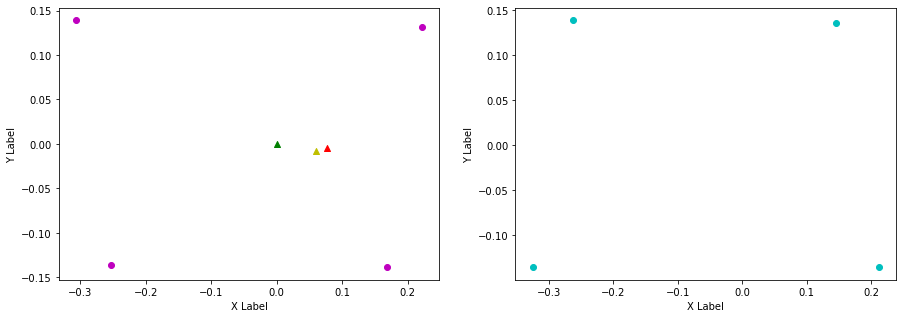

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.145, 0.219, FL (y): 0.136, 0.13.
FL displacement: 0.07400000000000001, -0.006000000000000005.

FR (x): 0.212, 0.168, FR (y): -0.135, -0.138.
FR displacement: -0.043999999999999984, -0.0030000000000000027.

RL (x): -0.262, -0.309, RL (y): 0.139, 0.138.
RL displacement: -0.046999999999999986, -0.0010000000000000009.

RR (x): -0.325, -0.256, RR (y): -0.136, -0.136.
RR displacement: 0.069, 0.0.


Base displacement (Foot): [0.043999999999999984, 0.0030000000000000027].

Base displacement (Odom): [[0.02943434882294005], [0.0031992166248744347]]. Rotation displacement: -1.5220809123929806.



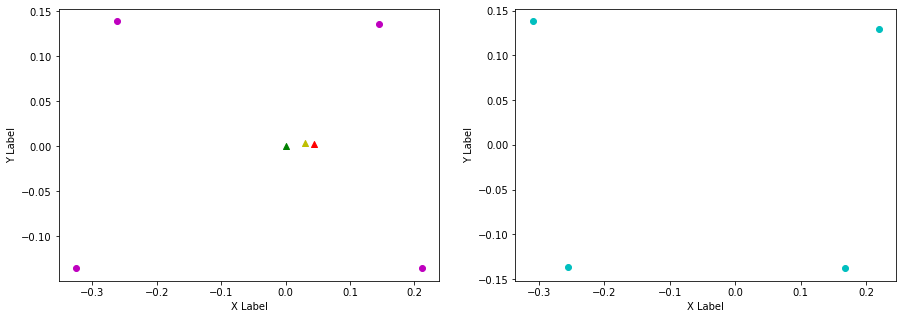

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.219, 0.147, FL (y): 0.13, 0.137.
FL displacement: -0.07200000000000001, 0.007000000000000006.

FR (x): 0.168, 0.213, FR (y): -0.138, -0.136.
FR displacement: 0.044999999999999984, 0.0020000000000000018.

RL (x): -0.309, -0.26, RL (y): 0.138, 0.139.
RL displacement: 0.04899999999999999, 0.0010000000000000009.

RR (x): -0.256, -0.322, RR (y): -0.136, -0.136.
RR displacement: -0.066, 0.0.


Base displacement (Foot): [0.07200000000000001, -0.007000000000000006].

Base displacement (Odom): [[0.07315261085846947], [-0.010660188998929065]]. Rotation displacement: 1.0048370087785399.



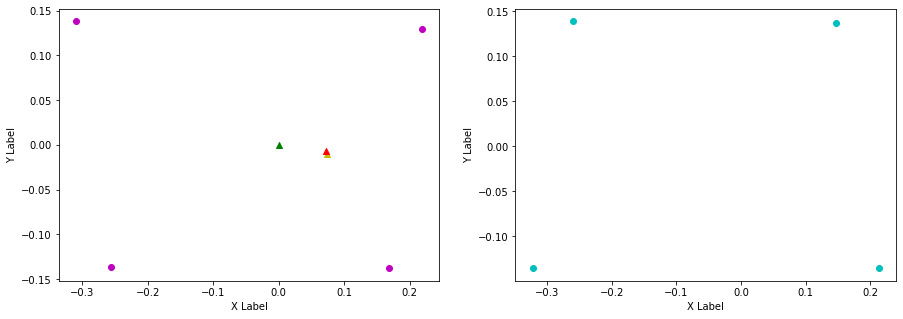

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.147, 0.215, FL (y): 0.137, 0.131.
FL displacement: 0.068, -0.006000000000000005.

FR (x): 0.213, 0.158, FR (y): -0.136, -0.136.
FR displacement: -0.05499999999999999, 0.0.

RL (x): -0.26, -0.318, RL (y): 0.139, 0.138.
RL displacement: -0.057999999999999996, -0.0010000000000000009.

RR (x): -0.322, -0.259, RR (y): -0.136, -0.137.
RR displacement: 0.063, -0.0010000000000000009.


Base displacement (Foot): [0.05499999999999999, -0.0].

Base displacement (Odom): [[0.03366975673308792], [0.002126169027873992]]. Rotation displacement: -1.5564188282330367.



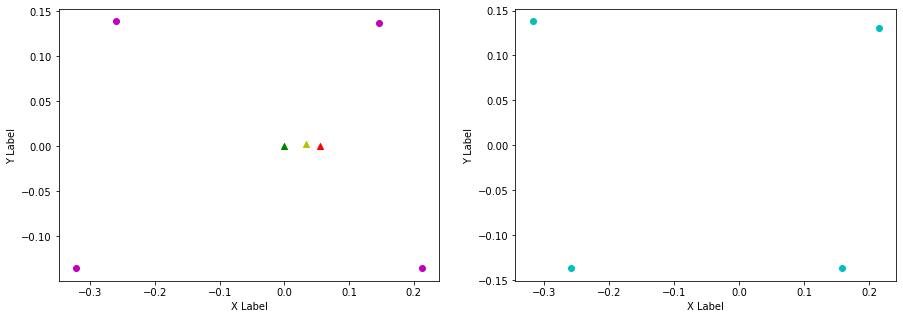

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.215, 0.155, FL (y): 0.131, 0.138.
FL displacement: -0.06, 0.007000000000000006.

FR (x): 0.158, 0.219, FR (y): -0.136, -0.135.
FR displacement: 0.061, 0.0010000000000000009.

RL (x): -0.318, -0.255, RL (y): 0.138, 0.138.
RL displacement: 0.063, 0.0.

RR (x): -0.259, -0.311, RR (y): -0.137, -0.138.
RR displacement: -0.05199999999999999, -0.0010000000000000009.


Base displacement (Foot): [0.06, -0.007000000000000006].

Base displacement (Odom): [[0.053244407111163294], [-0.007790331753193769]]. Rotation displacement: 0.552341601223227.



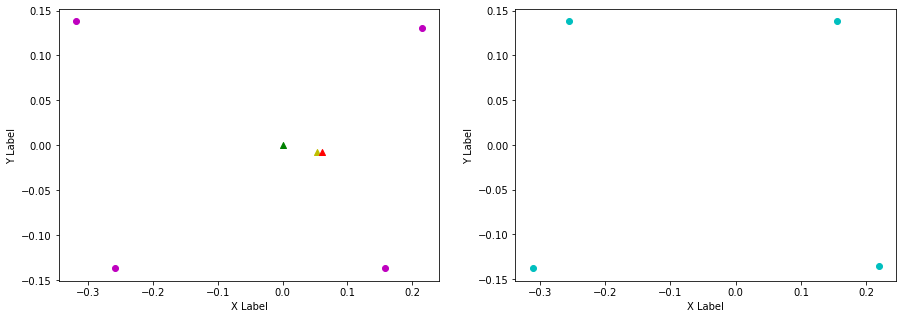

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.155, 0.218, FL (y): 0.138, 0.131.
FL displacement: 0.063, -0.007000000000000006.

FR (x): 0.219, 0.166, FR (y): -0.135, -0.137.
FR displacement: -0.05299999999999999, -0.0020000000000000018.

RL (x): -0.255, -0.311, RL (y): 0.138, 0.138.
RL displacement: -0.055999999999999994, 0.0.

RR (x): -0.311, -0.256, RR (y): -0.138, -0.137.
RR displacement: 0.05499999999999999, 0.0010000000000000009.


Base displacement (Foot): [0.05299999999999999, 0.0020000000000000018].

Base displacement (Odom): [[0.04211772886225473], [0.0024817032553601237]]. Rotation displacement: -0.9544496814811746.



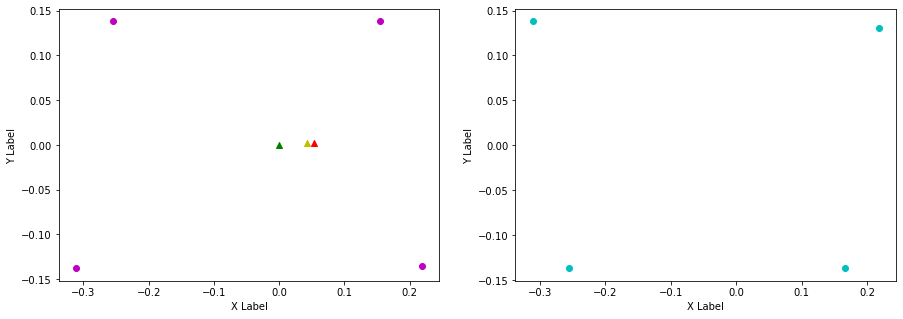

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.218, 0.149, FL (y): 0.131, 0.137.
FL displacement: -0.069, 0.006000000000000005.

FR (x): 0.166, 0.215, FR (y): -0.137, -0.136.
FR displacement: 0.04899999999999999, 0.0010000000000000009.

RL (x): -0.311, -0.259, RL (y): 0.138, 0.139.
RL displacement: 0.05199999999999999, 0.0010000000000000009.

RR (x): -0.256, -0.319, RR (y): -0.137, -0.137.
RR displacement: -0.063, 0.0.


Base displacement (Foot): [0.069, -0.006000000000000005].

Base displacement (Odom): [[0.06833632796722977], [-0.007704332314587781]]. Rotation displacement: 0.8301636460262787.



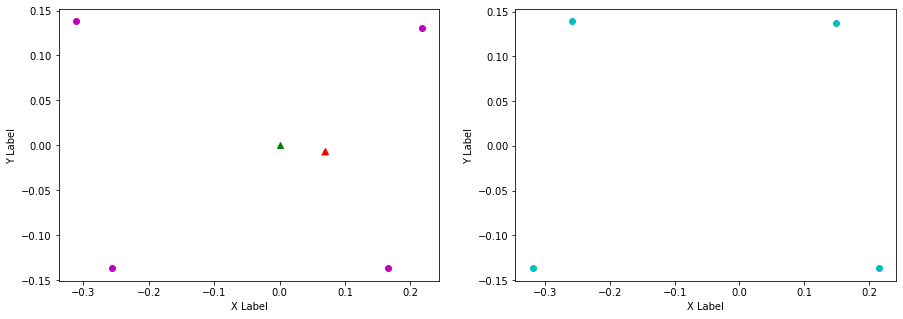

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.149, 0.215, FL (y): 0.137, 0.132.
FL displacement: 0.066, -0.0050000000000000044.

FR (x): 0.215, 0.154, FR (y): -0.136, -0.136.
FR displacement: -0.061, 0.0.

RL (x): -0.259, -0.323, RL (y): 0.139, 0.137.
RL displacement: -0.064, -0.0020000000000000018.

RR (x): -0.319, -0.26, RR (y): -0.137, -0.137.
RR displacement: 0.059, 0.0.


Base displacement (Foot): [0.061, -0.0].

Base displacement (Odom): [[0.04830840911045131], [0.00847686952060922]]. Rotation displacement: -1.1478261223310058.



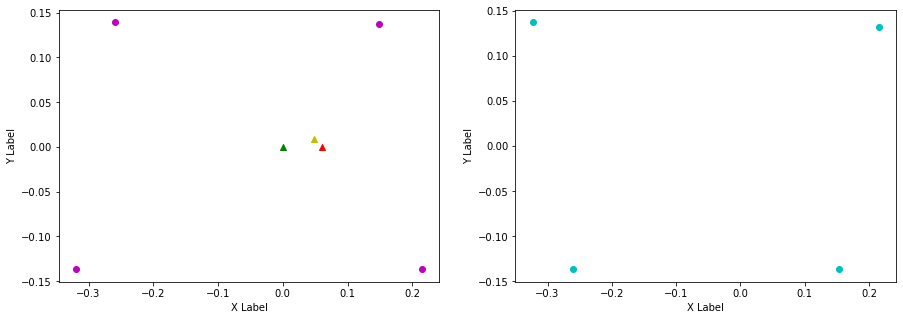

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.215, 0.155, FL (y): 0.132, 0.138.
FL displacement: -0.06, 0.006000000000000005.

FR (x): 0.154, 0.219, FR (y): -0.136, -0.135.
FR displacement: 0.065, 0.0010000000000000009.

RL (x): -0.323, -0.256, RL (y): 0.137, 0.138.
RL displacement: 0.067, 0.0010000000000000009.

RR (x): -0.26, -0.312, RR (y): -0.137, -0.138.
RR displacement: -0.05199999999999999, -0.0010000000000000009.


Base displacement (Foot): [0.06, -0.006000000000000005].

Base displacement (Odom): [[0.058992868082638594], [-0.007712273553018623]]. Rotation displacement: 0.40921704282010213.



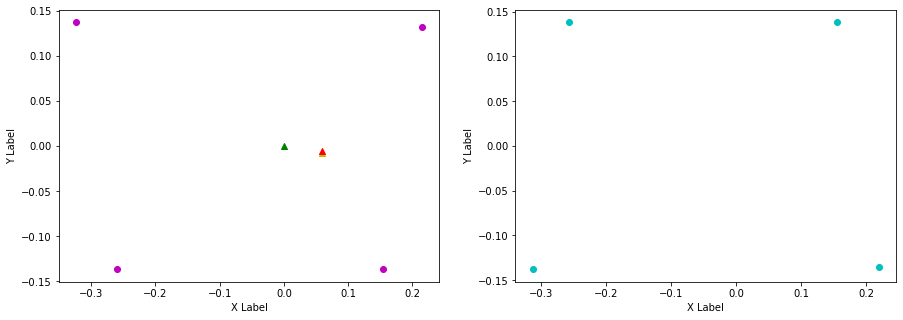

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.155, 0.221, FL (y): 0.138, 0.131.
FL displacement: 0.066, -0.007000000000000006.

FR (x): 0.219, 0.168, FR (y): -0.135, -0.138.
FR displacement: -0.05099999999999999, -0.0030000000000000027.

RL (x): -0.256, -0.308, RL (y): 0.138, 0.138.
RL displacement: -0.05199999999999999, 0.0.

RR (x): -0.312, -0.254, RR (y): -0.138, -0.136.
RR displacement: 0.057999999999999996, 0.0020000000000000018.


Base displacement (Foot): [0.05099999999999999, 0.0030000000000000027].

Base displacement (Odom): [[0.023170777346896543], [0.0019956407027947876]]. Rotation displacement: -0.7072893261106613.



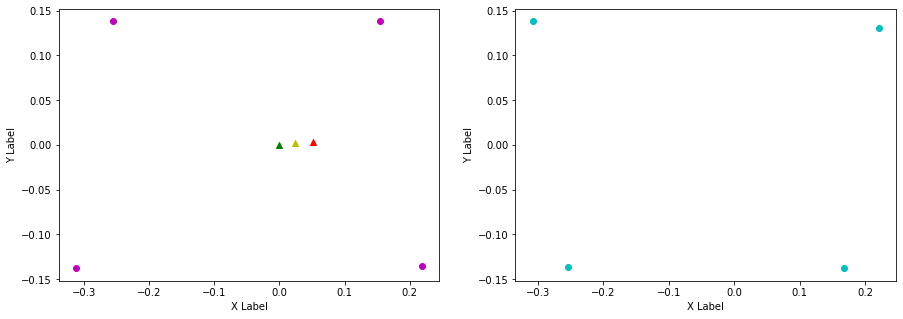

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.221, 0.156, FL (y): 0.131, 0.138.
FL displacement: -0.065, 0.007000000000000006.

FR (x): 0.168, 0.22, FR (y): -0.138, -0.135.
FR displacement: 0.05199999999999999, 0.0030000000000000027.

RL (x): -0.308, -0.255, RL (y): 0.138, 0.138.
RL displacement: 0.05299999999999999, 0.0.

RR (x): -0.254, -0.311, RR (y): -0.136, -0.138.
RR displacement: -0.056999999999999995, -0.0020000000000000018.


Base displacement (Foot): [0.065, -0.007000000000000006].

Base displacement (Odom): [[0.05338810502554292], [-0.006787405462512108]]. Rotation displacement: 0.6675961339440933.



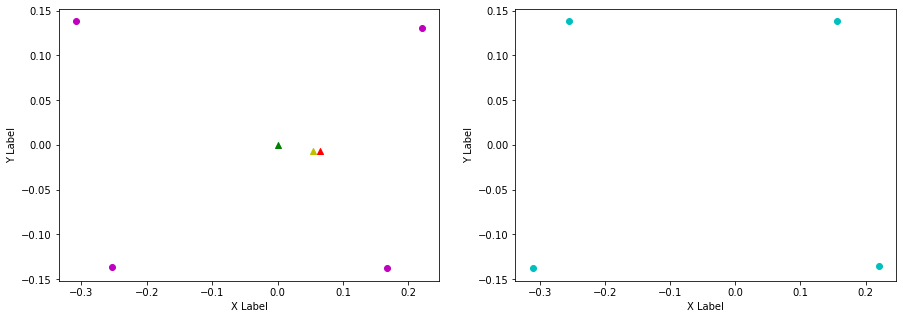

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.156, 0.219, FL (y): 0.138, 0.131.
FL displacement: 0.063, -0.007000000000000006.

FR (x): 0.22, 0.167, FR (y): -0.135, -0.137.
FR displacement: -0.05299999999999999, -0.0020000000000000018.

RL (x): -0.255, -0.309, RL (y): 0.138, 0.138.
RL displacement: -0.05399999999999999, 0.0.

RR (x): -0.311, -0.256, RR (y): -0.138, -0.137.
RR displacement: 0.05499999999999999, 0.0010000000000000009.


Base displacement (Foot): [0.05299999999999999, 0.0020000000000000018].

Base displacement (Odom): [[0.0497027628884803], [0.0036342923237770997]]. Rotation displacement: -1.4454962217012521.



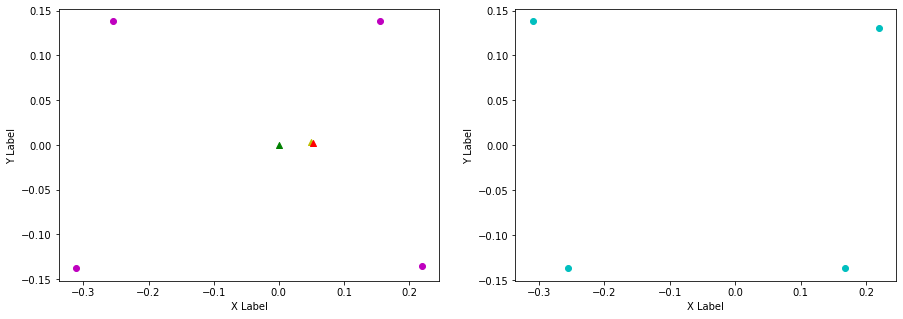

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.219, 0.157, FL (y): 0.131, 0.138.
FL displacement: -0.062, 0.007000000000000006.

FR (x): 0.167, 0.221, FR (y): -0.137, -0.135.
FR displacement: 0.05399999999999999, 0.0020000000000000018.

RL (x): -0.309, -0.254, RL (y): 0.138, 0.138.
RL displacement: 0.05499999999999999, 0.0.

RR (x): -0.256, -0.31, RR (y): -0.137, -0.138.
RR displacement: -0.05399999999999999, -0.0010000000000000009.


Base displacement (Foot): [0.062, -0.007000000000000006].

Base displacement (Odom): [[0.05504846837202848], [-0.009252227391148171]]. Rotation displacement: 0.9353268078873608.



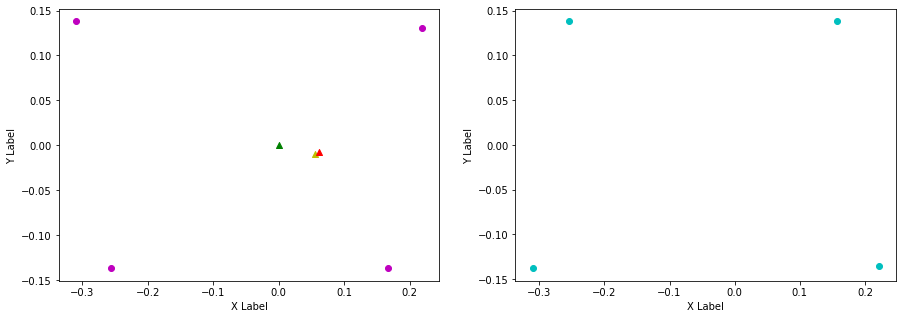

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.157, 0.217, FL (y): 0.138, 0.131.
FL displacement: 0.06, -0.007000000000000006.

FR (x): 0.221, 0.162, FR (y): -0.135, -0.137.
FR displacement: -0.059, -0.0020000000000000018.

RL (x): -0.254, -0.314, RL (y): 0.138, 0.138.
RL displacement: -0.06, 0.0.

RR (x): -0.31, -0.257, RR (y): -0.138, -0.137.
RR displacement: 0.05299999999999999, 0.0010000000000000009.


Base displacement (Foot): [0.059, 0.0020000000000000018].

Base displacement (Odom): [[0.03835386624313886], [0.005238709009282694]]. Rotation displacement: -1.4560710815700542.



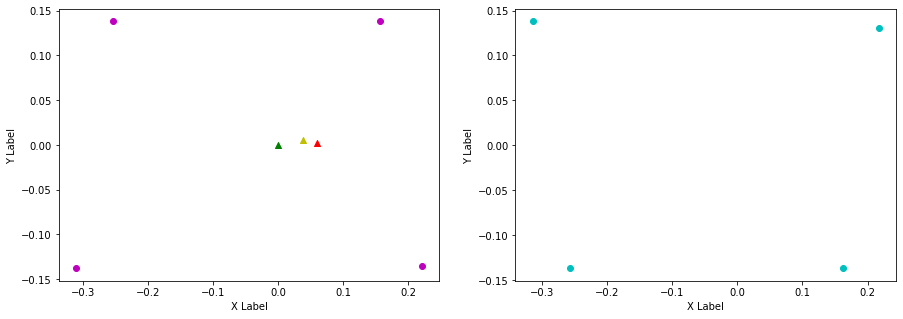

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.217, 0.145, FL (y): 0.131, 0.136.
FL displacement: -0.07200000000000001, 0.0050000000000000044.

FR (x): 0.162, 0.212, FR (y): -0.137, -0.136.
FR displacement: 0.04999999999999999, 0.0010000000000000009.

RL (x): -0.314, -0.261, RL (y): 0.138, 0.139.
RL displacement: 0.05299999999999999, 0.0010000000000000009.

RR (x): -0.257, -0.326, RR (y): -0.137, -0.136.
RR displacement: -0.069, 0.0010000000000000009.


Base displacement (Foot): [0.07200000000000001, -0.0050000000000000044].

Base displacement (Odom): [[0.04818645523315945], [-0.006720535070710465]]. Rotation displacement: 0.8601800186082644.



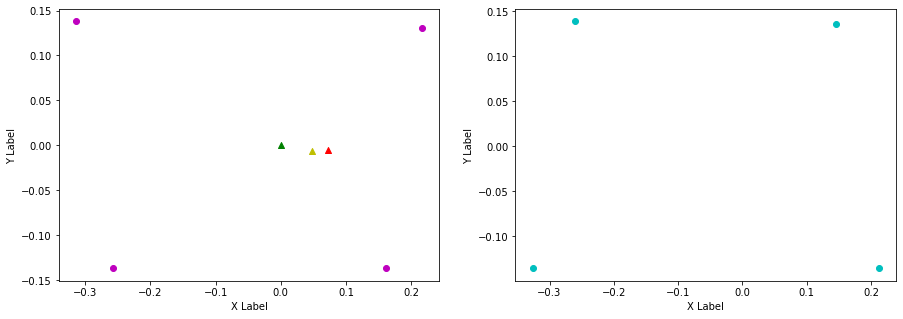

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.145, 0.213, FL (y): 0.136, 0.132.
FL displacement: 0.068, -0.0040000000000000036.

FR (x): 0.212, 0.147, FR (y): -0.136, -0.135.
FR displacement: -0.065, 0.0010000000000000009.

RL (x): -0.261, -0.33, RL (y): 0.139, 0.137.
RL displacement: -0.069, -0.0020000000000000018.

RR (x): -0.326, -0.261, RR (y): -0.136, -0.137.
RR displacement: 0.065, -0.0010000000000000009.


Base displacement (Foot): [0.065, -0.0010000000000000009].

Base displacement (Odom): [[0.03334844186044528], [0.0012287808132844802]]. Rotation displacement: -0.9353914008702796.



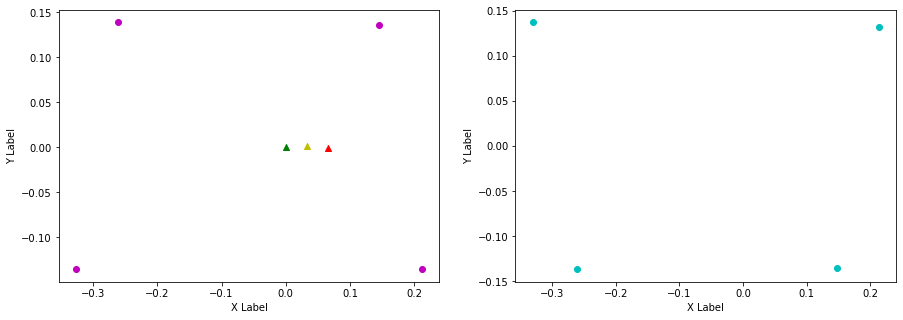

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.213, 0.153, FL (y): 0.132, 0.138.
FL displacement: -0.06, 0.006000000000000005.

FR (x): 0.147, 0.218, FR (y): -0.135, -0.135.
FR displacement: 0.07100000000000001, 0.0.

RL (x): -0.33, -0.257, RL (y): 0.137, 0.138.
RL displacement: 0.07300000000000001, 0.0010000000000000009.

RR (x): -0.261, -0.314, RR (y): -0.137, -0.138.
RR displacement: -0.05299999999999999, -0.0010000000000000009.


Base displacement (Foot): [0.06, -0.006000000000000005].

Base displacement (Odom): [[0.05210231474317473], [-0.005718681256300595]]. Rotation displacement: 0.03302748136203589.



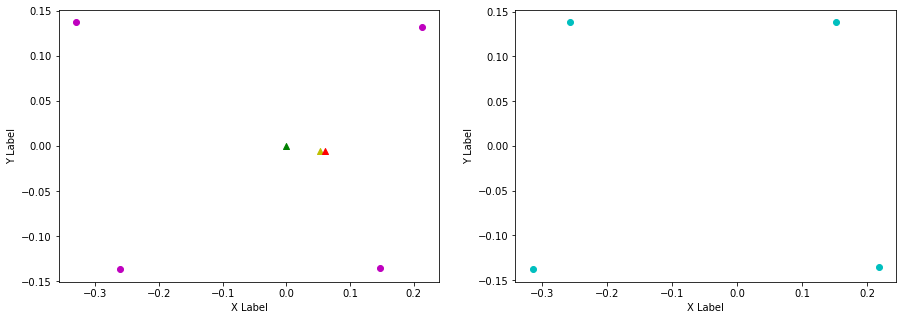

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.153, 0.213, FL (y): 0.138, 0.132.
FL displacement: 0.06, -0.006000000000000005.

FR (x): 0.218, 0.147, FR (y): -0.135, -0.136.
FR displacement: -0.07100000000000001, -0.0010000000000000009.

RL (x): -0.257, -0.331, RL (y): 0.138, 0.137.
RL displacement: -0.07400000000000001, -0.0010000000000000009.

RR (x): -0.314, -0.261, RR (y): -0.138, -0.137.
RR displacement: 0.05299999999999999, 0.0010000000000000009.


Base displacement (Foot): [0.07100000000000001, 0.0010000000000000009].

Base displacement (Odom): [[0.060058973874839605], [0.007958355257351002]]. Rotation displacement: -0.34800863409512856.



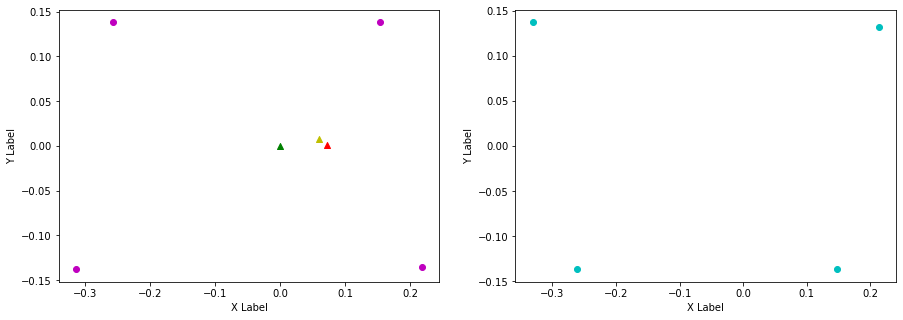

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.213, 0.156, FL (y): 0.132, 0.139.
FL displacement: -0.056999999999999995, 0.007000000000000006.

FR (x): 0.147, 0.22, FR (y): -0.136, -0.135.
FR displacement: 0.07300000000000001, 0.0010000000000000009.

RL (x): -0.331, -0.255, RL (y): 0.137, 0.138.
RL displacement: 0.07600000000000001, 0.0010000000000000009.

RR (x): -0.261, -0.311, RR (y): -0.137, -0.138.
RR displacement: -0.04999999999999999, -0.0010000000000000009.


Base displacement (Foot): [0.056999999999999995, -0.007000000000000006].

Base displacement (Odom): [[0.03627788412028288], [-0.00561971661896532]]. Rotation displacement: 0.406067718049819.



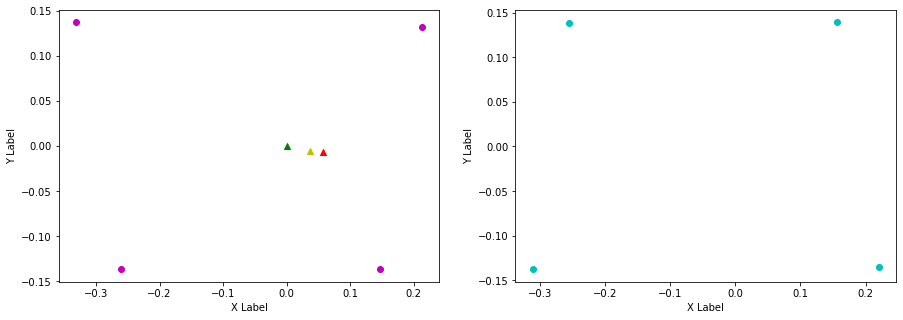

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.156, 0.218, FL (y): 0.139, 0.131.
FL displacement: 0.062, -0.008000000000000007.

FR (x): 0.22, 0.169, FR (y): -0.135, -0.137.
FR displacement: -0.05099999999999999, -0.0020000000000000018.

RL (x): -0.255, -0.31, RL (y): 0.138, 0.137.
RL displacement: -0.05499999999999999, -0.0010000000000000009.

RR (x): -0.311, -0.256, RR (y): -0.138, -0.137.
RR displacement: 0.05499999999999999, 0.0010000000000000009.


Base displacement (Foot): [0.05099999999999999, 0.0020000000000000018].

Base displacement (Odom): [[0.05114121301990027], [0.0053747996873627635]]. Rotation displacement: -1.1907158372036102.



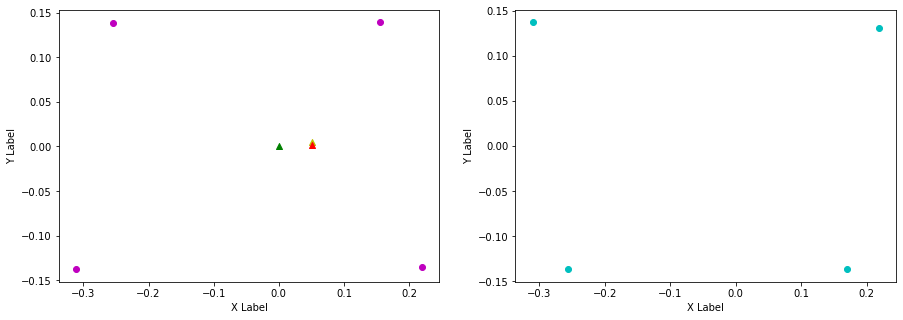

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.218, 0.161, FL (y): 0.131, 0.14.
FL displacement: -0.056999999999999995, 0.009000000000000008.

FR (x): 0.169, 0.224, FR (y): -0.137, -0.134.
FR displacement: 0.05499999999999999, 0.0030000000000000027.

RL (x): -0.31, -0.251, RL (y): 0.137, 0.137.
RL displacement: 0.059, 0.0.

RR (x): -0.256, -0.305, RR (y): -0.137, -0.139.
RR displacement: -0.04899999999999999, -0.0020000000000000018.


Base displacement (Foot): [0.056999999999999995, -0.009000000000000008].

Base displacement (Odom): [[0.052530976563979426], [-0.006649279979652256]]. Rotation displacement: 1.0188871534121862.



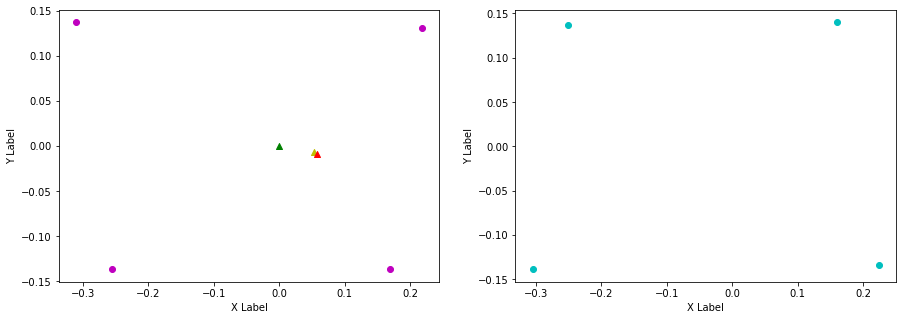

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.161, 0.22, FL (y): 0.14, 0.13.
FL displacement: 0.059, -0.010000000000000009.

FR (x): 0.224, 0.169, FR (y): -0.134, -0.138.
FR displacement: -0.05499999999999999, -0.0040000000000000036.

RL (x): -0.251, -0.307, RL (y): 0.137, 0.138.
RL displacement: -0.055999999999999994, 0.0010000000000000009.

RR (x): -0.305, -0.255, RR (y): -0.139, -0.136.
RR displacement: 0.04999999999999999, 0.0030000000000000027.


Base displacement (Foot): [0.05499999999999999, 0.0040000000000000036].

Base displacement (Odom): [[0.051063759385609586], [0.002460513792118757]]. Rotation displacement: -1.7683794887102866.



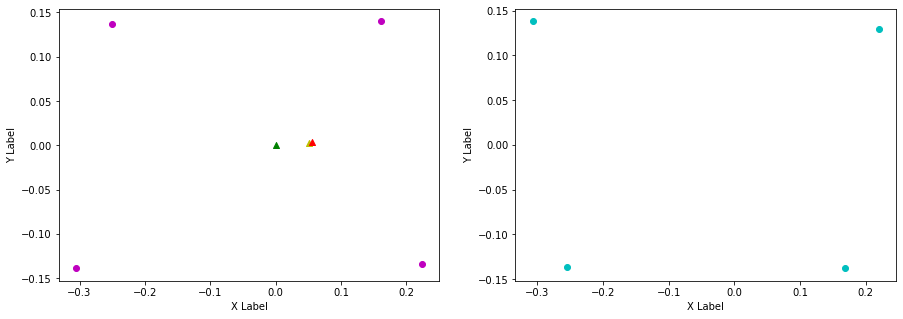

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.22, 0.147, FL (y): 0.13, 0.137.
FL displacement: -0.07300000000000001, 0.007000000000000006.

FR (x): 0.169, 0.214, FR (y): -0.138, -0.135.
FR displacement: 0.044999999999999984, 0.0030000000000000027.

RL (x): -0.307, -0.26, RL (y): 0.138, 0.139.
RL displacement: 0.046999999999999986, 0.0010000000000000009.

RR (x): -0.255, -0.322, RR (y): -0.136, -0.136.
RR displacement: -0.067, 0.0.


Base displacement (Foot): [0.07300000000000001, -0.007000000000000006].

Base displacement (Odom): [[0.038554378037850334], [-0.010039806626072956]]. Rotation displacement: 1.424782404685041.



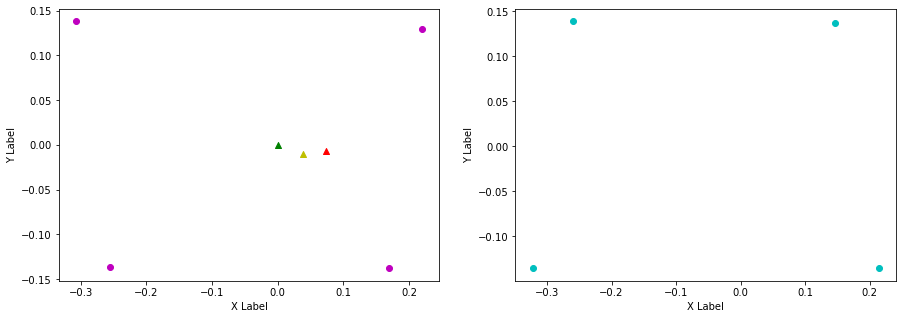

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.147, 0.215, FL (y): 0.137, 0.132.
FL displacement: 0.068, -0.0050000000000000044.

FR (x): 0.214, 0.154, FR (y): -0.135, -0.136.
FR displacement: -0.06, -0.0010000000000000009.

RL (x): -0.26, -0.323, RL (y): 0.139, 0.137.
RL displacement: -0.063, -0.0020000000000000018.

RR (x): -0.322, -0.26, RR (y): -0.136, -0.137.
RR displacement: 0.062, -0.0010000000000000009.


Base displacement (Foot): [0.06, 0.0010000000000000009].

Base displacement (Odom): [[0.05102968462824364], [0.011174628268641573]]. Rotation displacement: -1.4309046802018077.



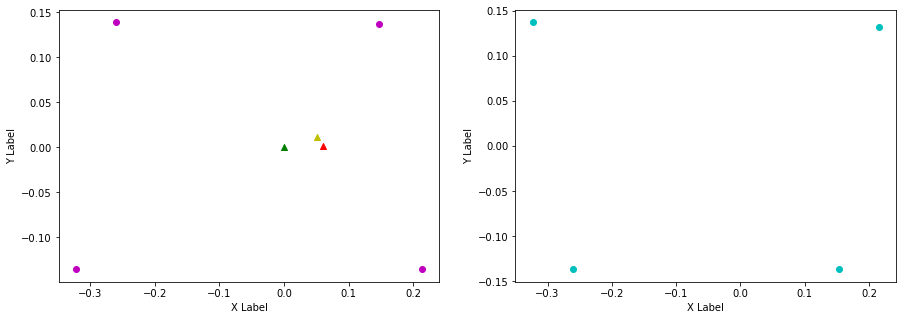

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.215, 0.147, FL (y): 0.132, 0.137.
FL displacement: -0.068, 0.0050000000000000044.

FR (x): 0.154, 0.214, FR (y): -0.136, -0.136.
FR displacement: 0.06, 0.0.

RL (x): -0.323, -0.26, RL (y): 0.137, 0.139.
RL displacement: 0.063, 0.0020000000000000018.

RR (x): -0.26, -0.322, RR (y): -0.137, -0.137.
RR displacement: -0.062, 0.0.


Base displacement (Foot): [0.068, -0.0050000000000000044].

Base displacement (Odom): [[0.04524469649051355], [-0.00698558337030919]]. Rotation displacement: 0.7139101573213886.



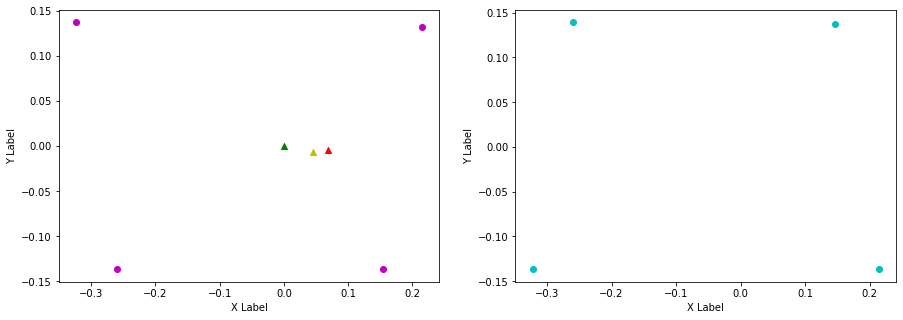

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.147, 0.217, FL (y): 0.137, 0.131.
FL displacement: 0.07, -0.006000000000000005.

FR (x): 0.214, 0.163, FR (y): -0.136, -0.137.
FR displacement: -0.05099999999999999, -0.0010000000000000009.

RL (x): -0.26, -0.314, RL (y): 0.139, 0.138.
RL displacement: -0.05399999999999999, -0.0010000000000000009.

RR (x): -0.322, -0.258, RR (y): -0.137, -0.137.
RR displacement: 0.064, 0.0.


Base displacement (Foot): [0.05099999999999999, 0.0010000000000000009].

Base displacement (Odom): [[0.012387677539641206], [0.004705782693363414]]. Rotation displacement: -0.9998179903120629.



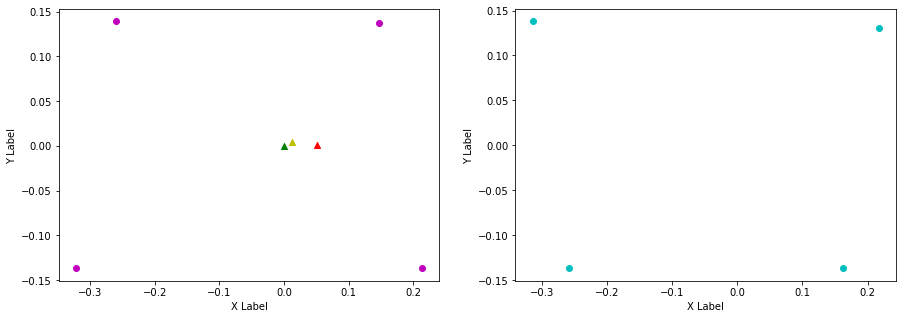

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.217, 0.149, FL (y): 0.131, 0.137.
FL displacement: -0.068, 0.006000000000000005.

FR (x): 0.163, 0.215, FR (y): -0.137, -0.135.
FR displacement: 0.05199999999999999, 0.0020000000000000018.

RL (x): -0.314, -0.259, RL (y): 0.138, 0.139.
RL displacement: 0.05499999999999999, 0.0010000000000000009.

RR (x): -0.258, -0.32, RR (y): -0.137, -0.137.
RR displacement: -0.062, 0.0.


Base displacement (Foot): [0.068, -0.006000000000000005].

Base displacement (Odom): [[0.040498711509286967], [-0.004127069788219195]]. Rotation displacement: 0.3939272700191511.



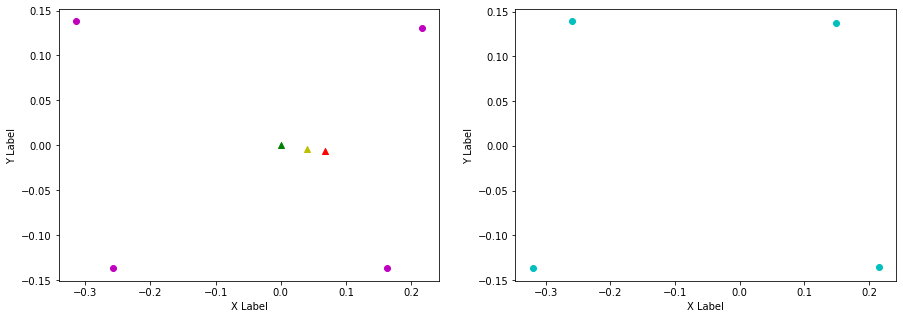

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.149, 0.215, FL (y): 0.137, 0.131.
FL displacement: 0.066, -0.006000000000000005.

FR (x): 0.215, 0.155, FR (y): -0.135, -0.136.
FR displacement: -0.06, -0.0010000000000000009.

RL (x): -0.259, -0.323, RL (y): 0.139, 0.137.
RL displacement: -0.064, -0.0020000000000000018.

RR (x): -0.32, -0.26, RR (y): -0.137, -0.138.
RR displacement: 0.06, -0.0010000000000000009.


Base displacement (Foot): [0.06, 0.0010000000000000009].

Base displacement (Odom): [[0.05574716087042075], [0.009545004068198804]]. Rotation displacement: -0.9883901646266271.



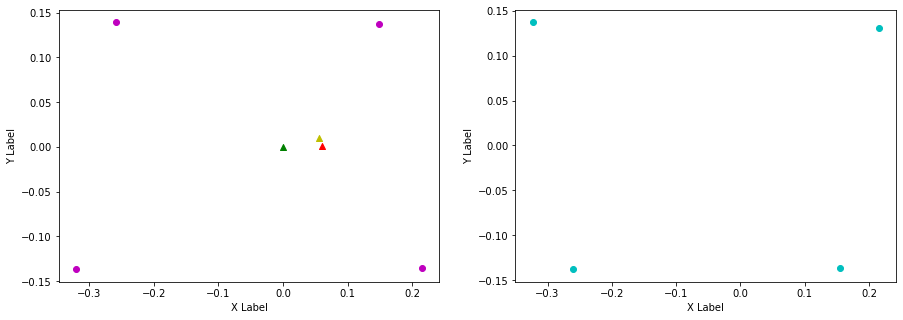

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.215, 0.153, FL (y): 0.131, 0.138.
FL displacement: -0.062, 0.007000000000000006.

FR (x): 0.155, 0.217, FR (y): -0.136, -0.135.
FR displacement: 0.062, 0.0010000000000000009.

RL (x): -0.323, -0.257, RL (y): 0.137, 0.138.
RL displacement: 0.066, 0.0010000000000000009.

RR (x): -0.26, -0.314, RR (y): -0.138, -0.137.
RR displacement: -0.05399999999999999, 0.0010000000000000009.


Base displacement (Foot): [0.062, -0.007000000000000006].

Base displacement (Odom): [[0.05125815825059554], [-0.010387120236868164]]. Rotation displacement: 0.6655742949477607.



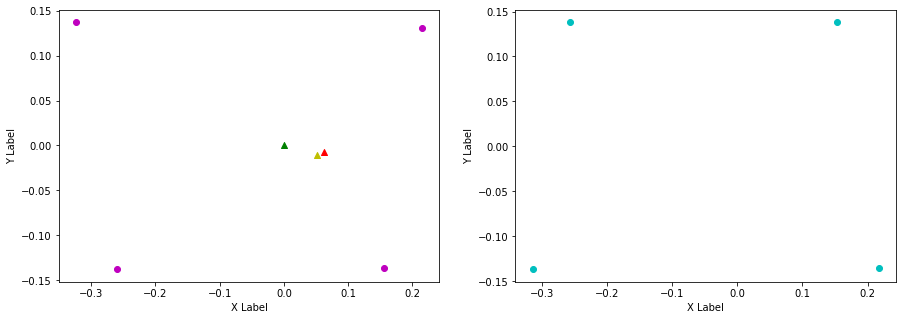

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.153, 0.22, FL (y): 0.138, 0.132.
FL displacement: 0.067, -0.006000000000000005.

FR (x): 0.217, 0.168, FR (y): -0.135, -0.138.
FR displacement: -0.04899999999999999, -0.0030000000000000027.

RL (x): -0.257, -0.308, RL (y): 0.138, 0.138.
RL displacement: -0.05099999999999999, 0.0.

RR (x): -0.314, -0.255, RR (y): -0.137, -0.136.
RR displacement: 0.059, 0.0010000000000000009.


Base displacement (Foot): [0.04899999999999999, 0.0030000000000000027].

Base displacement (Odom): [[0.06553020146240929], [0.010884389322014076]]. Rotation displacement: -0.995659095591812.



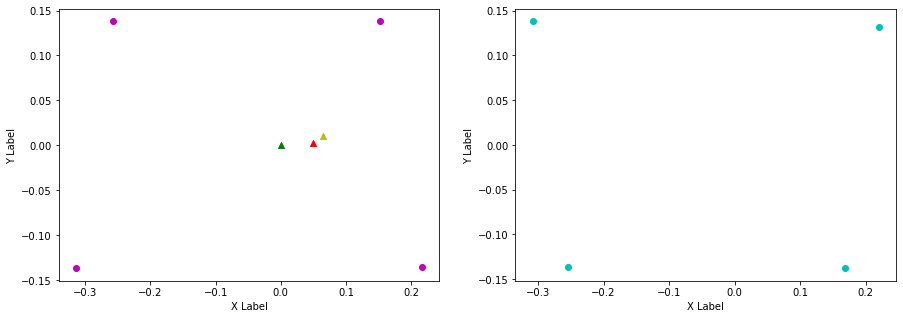

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.22, 0.147, FL (y): 0.132, 0.137.
FL displacement: -0.07300000000000001, 0.0050000000000000044.

FR (x): 0.168, 0.214, FR (y): -0.138, -0.136.
FR displacement: 0.045999999999999985, 0.0020000000000000018.

RL (x): -0.308, -0.26, RL (y): 0.138, 0.139.
RL displacement: 0.04799999999999999, 0.0010000000000000009.

RR (x): -0.255, -0.323, RR (y): -0.136, -0.136.
RR displacement: -0.068, 0.0.


Base displacement (Foot): [0.07300000000000001, -0.0050000000000000044].

Base displacement (Odom): [[0.03751057560037507], [-0.002833350222779085]]. Rotation displacement: 0.8043461826260988.



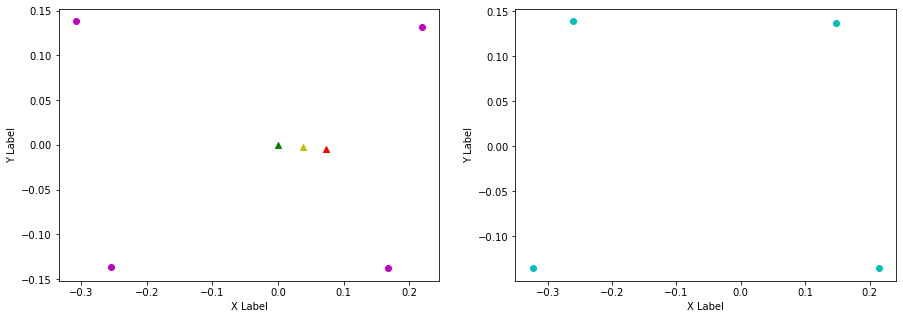

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.147, 0.215, FL (y): 0.137, 0.132.
FL displacement: 0.068, -0.0050000000000000044.

FR (x): 0.214, 0.153, FR (y): -0.136, -0.136.
FR displacement: -0.061, 0.0.

RL (x): -0.26, -0.324, RL (y): 0.139, 0.137.
RL displacement: -0.064, -0.0020000000000000018.

RR (x): -0.323, -0.26, RR (y): -0.136, -0.137.
RR displacement: 0.063, -0.0010000000000000009.


Base displacement (Foot): [0.061, -0.0].

Base displacement (Odom): [[0.06699475950497558], [0.009883278348732816]]. Rotation displacement: -1.5384631946145504.



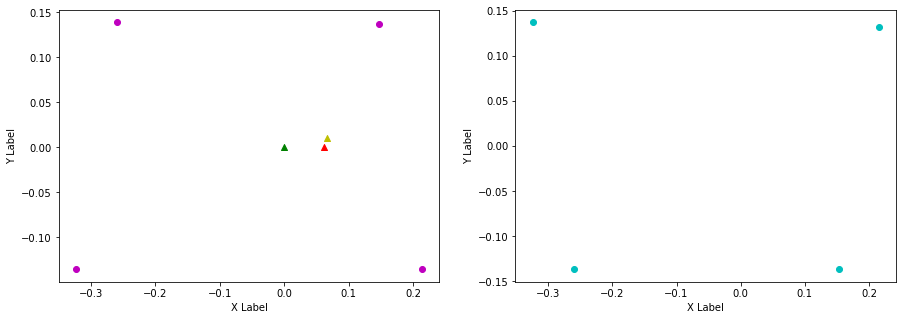

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.215, 0.149, FL (y): 0.132, 0.137.
FL displacement: -0.066, 0.0050000000000000044.

FR (x): 0.153, 0.215, FR (y): -0.136, -0.136.
FR displacement: 0.062, 0.0.

RL (x): -0.324, -0.259, RL (y): 0.137, 0.139.
RL displacement: 0.065, 0.0020000000000000018.

RR (x): -0.26, -0.32, RR (y): -0.137, -0.137.
RR displacement: -0.06, 0.0.


Base displacement (Foot): [0.066, -0.0050000000000000044].

Base displacement (Odom): [[0.04973740320824316], [-0.004856277443367585]]. Rotation displacement: 0.5678259249577199.



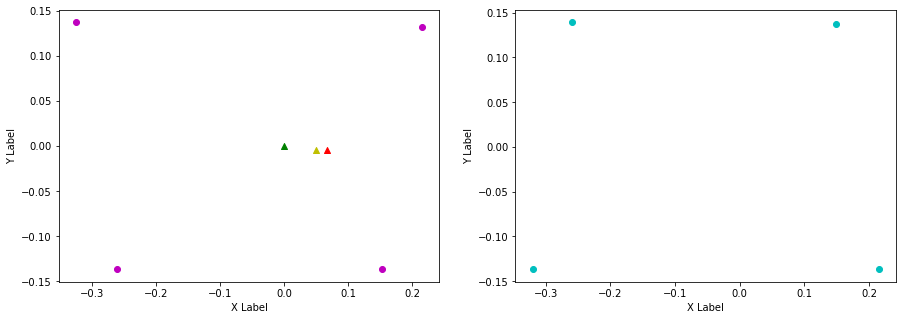

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.149, 0.216, FL (y): 0.137, 0.131.
FL displacement: 0.067, -0.006000000000000005.

FR (x): 0.215, 0.158, FR (y): -0.136, -0.136.
FR displacement: -0.056999999999999995, 0.0.

RL (x): -0.259, -0.319, RL (y): 0.139, 0.138.
RL displacement: -0.06, -0.0010000000000000009.

RR (x): -0.32, -0.259, RR (y): -0.137, -0.137.
RR displacement: 0.061, 0.0.


Base displacement (Foot): [0.056999999999999995, -0.0].

Base displacement (Odom): [[0.030566927235128105], [0.0023391517998945233]]. Rotation displacement: -1.14703009653592.



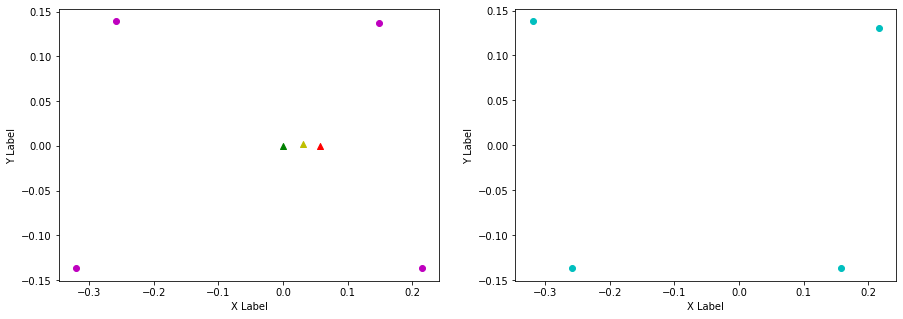

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.216, 0.155, FL (y): 0.131, 0.138.
FL displacement: -0.061, 0.007000000000000006.

FR (x): 0.158, 0.219, FR (y): -0.136, -0.135.
FR displacement: 0.061, 0.0010000000000000009.

RL (x): -0.319, -0.256, RL (y): 0.138, 0.138.
RL displacement: 0.063, 0.0.

RR (x): -0.259, -0.313, RR (y): -0.137, -0.138.
RR displacement: -0.05399999999999999, -0.0010000000000000009.


Base displacement (Foot): [0.061, -0.007000000000000006].

Base displacement (Odom): [[0.035244578628248036], [-0.005392602824989101]]. Rotation displacement: 0.8191376773809841.



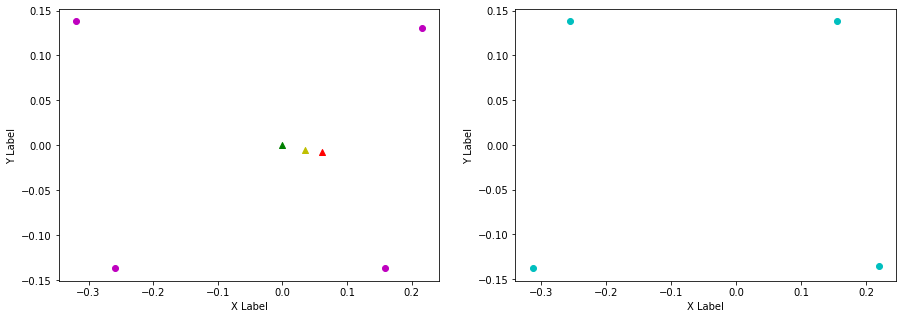

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.155, 0.219, FL (y): 0.138, 0.131.
FL displacement: 0.064, -0.007000000000000006.

FR (x): 0.219, 0.168, FR (y): -0.135, -0.137.
FR displacement: -0.05099999999999999, -0.0020000000000000018.

RL (x): -0.256, -0.309, RL (y): 0.138, 0.138.
RL displacement: -0.05299999999999999, 0.0.

RR (x): -0.313, -0.255, RR (y): -0.138, -0.137.
RR displacement: 0.057999999999999996, 0.0010000000000000009.


Base displacement (Foot): [0.05099999999999999, 0.0020000000000000018].

Base displacement (Odom): [[0.05756212260929594], [0.006054310797092732]]. Rotation displacement: -1.3645075971928944.



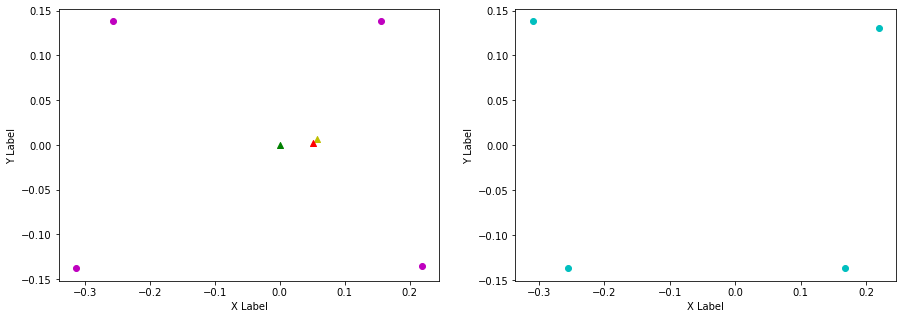

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.219, 0.157, FL (y): 0.131, 0.138.
FL displacement: -0.062, 0.007000000000000006.

FR (x): 0.168, 0.221, FR (y): -0.137, -0.135.
FR displacement: 0.05299999999999999, 0.0020000000000000018.

RL (x): -0.309, -0.254, RL (y): 0.138, 0.138.
RL displacement: 0.05499999999999999, 0.0.

RR (x): -0.255, -0.31, RR (y): -0.137, -0.138.
RR displacement: -0.05499999999999999, -0.0010000000000000009.


Base displacement (Foot): [0.062, -0.007000000000000006].

Base displacement (Odom): [[0.0425813004243385], [-0.005349868050370521]]. Rotation displacement: 1.2839529770901632.



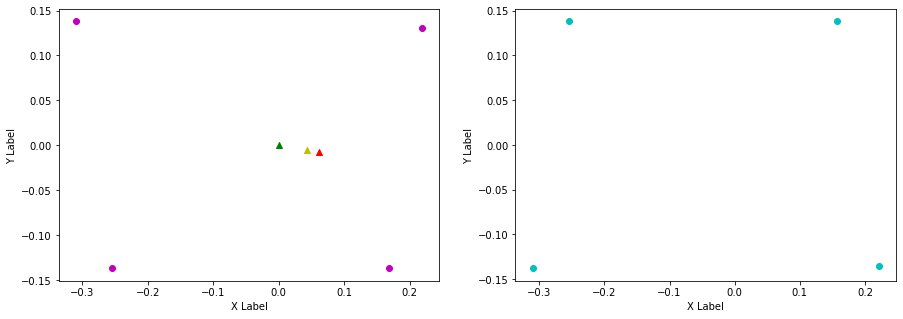

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.157, 0.216, FL (y): 0.138, 0.131.
FL displacement: 0.059, -0.007000000000000006.

FR (x): 0.221, 0.159, FR (y): -0.135, -0.136.
FR displacement: -0.062, -0.0010000000000000009.

RL (x): -0.254, -0.319, RL (y): 0.138, 0.138.
RL displacement: -0.065, 0.0.

RR (x): -0.31, -0.259, RR (y): -0.138, -0.137.
RR displacement: 0.05099999999999999, 0.0010000000000000009.


Base displacement (Foot): [0.062, 0.0010000000000000009].

Base displacement (Odom): [[0.053448209008249314], [0.009160079642626329]]. Rotation displacement: -1.767964330988412.



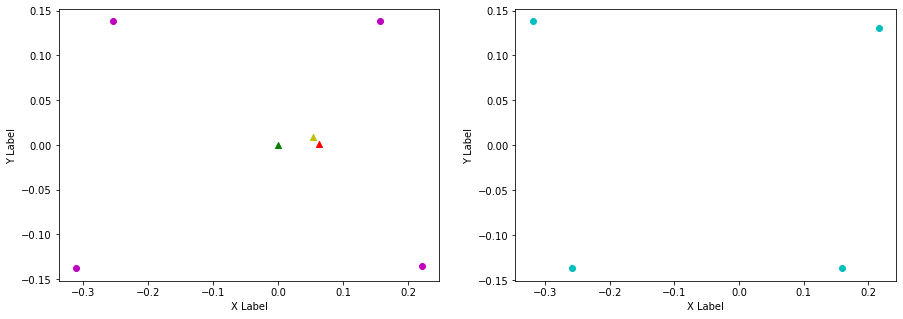

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.216, 0.147, FL (y): 0.131, 0.137.
FL displacement: -0.069, 0.006000000000000005.

FR (x): 0.159, 0.213, FR (y): -0.136, -0.135.
FR displacement: 0.05399999999999999, 0.0010000000000000009.

RL (x): -0.319, -0.26, RL (y): 0.138, 0.139.
RL displacement: 0.059, 0.0010000000000000009.

RR (x): -0.259, -0.323, RR (y): -0.137, -0.136.
RR displacement: -0.064, 0.0010000000000000009.


Base displacement (Foot): [0.069, -0.006000000000000005].

Base displacement (Odom): [[0.05066263781768221], [-0.004993899514076361]]. Rotation displacement: 1.1549713837243978.



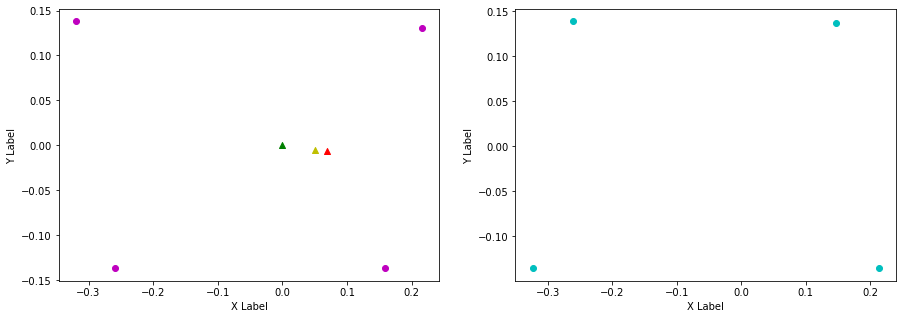

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.147, 0.218, FL (y): 0.137, 0.131.
FL displacement: 0.07100000000000001, -0.006000000000000005.

FR (x): 0.213, 0.167, FR (y): -0.135, -0.137.
FR displacement: -0.045999999999999985, -0.0020000000000000018.

RL (x): -0.26, -0.31, RL (y): 0.139, 0.138.
RL displacement: -0.04999999999999999, -0.0010000000000000009.

RR (x): -0.323, -0.257, RR (y): -0.136, -0.137.
RR displacement: 0.066, -0.0010000000000000009.


Base displacement (Foot): [0.045999999999999985, 0.0020000000000000018].

Base displacement (Odom): [[0.05403970293713156], [0.004248363097887342]]. Rotation displacement: -1.2778425485727976.



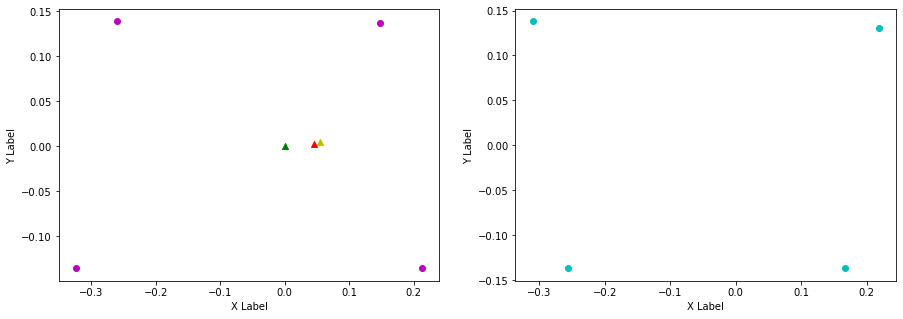

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.218, 0.161, FL (y): 0.131, 0.14.
FL displacement: -0.056999999999999995, 0.009000000000000008.

FR (x): 0.167, 0.225, FR (y): -0.137, -0.134.
FR displacement: 0.057999999999999996, 0.0030000000000000027.

RL (x): -0.31, -0.25, RL (y): 0.138, 0.137.
RL displacement: 0.06, -0.0010000000000000009.

RR (x): -0.257, -0.306, RR (y): -0.137, -0.139.
RR displacement: -0.04899999999999999, -0.0020000000000000018.


Base displacement (Foot): [0.056999999999999995, -0.009000000000000008].

Base displacement (Odom): [[0.023276388505976353], [-0.0043150766560433595]]. Rotation displacement: 0.6103268319537605.



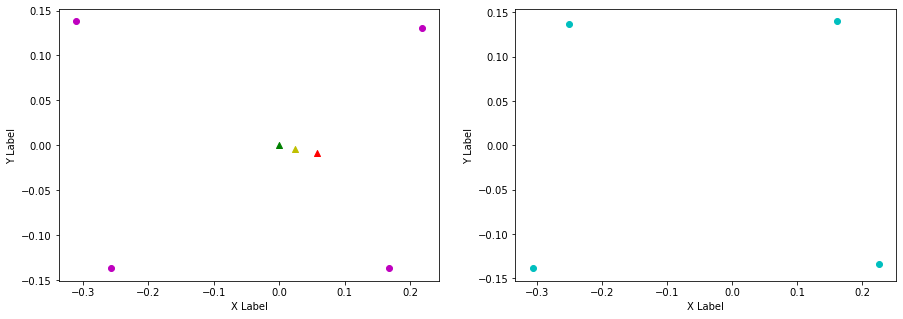

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.161, 0.222, FL (y): 0.14, 0.131.
FL displacement: 0.061, -0.009000000000000008.

FR (x): 0.225, 0.169, FR (y): -0.134, -0.139.
FR displacement: -0.055999999999999994, -0.0050000000000000044.

RL (x): -0.25, -0.306, RL (y): 0.137, 0.139.
RL displacement: -0.055999999999999994, 0.0020000000000000018.

RR (x): -0.306, -0.253, RR (y): -0.139, -0.136.
RR displacement: 0.05299999999999999, 0.0030000000000000027.


Base displacement (Foot): [0.055999999999999994, 0.0050000000000000044].

Base displacement (Odom): [[0.07168009608067871], [0.009608057053271057]]. Rotation displacement: -1.221032960233882.



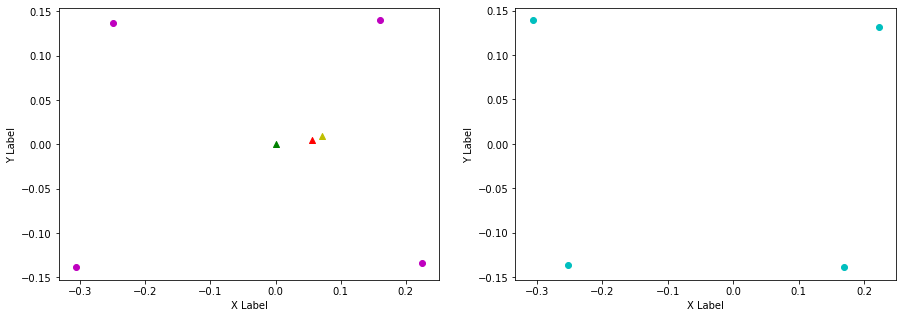

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.222, 0.154, FL (y): 0.131, 0.138.
FL displacement: -0.068, 0.007000000000000006.

FR (x): 0.169, 0.218, FR (y): -0.139, -0.135.
FR displacement: 0.04899999999999999, 0.0040000000000000036.

RL (x): -0.306, -0.256, RL (y): 0.139, 0.138.
RL displacement: 0.04999999999999999, -0.0010000000000000009.

RR (x): -0.253, -0.313, RR (y): -0.136, -0.137.
RR displacement: -0.06, -0.0010000000000000009.


Base displacement (Foot): [0.068, -0.007000000000000006].

Base displacement (Odom): [[0.060393992713659195], [-0.008827088026909458]]. Rotation displacement: 1.3188789088993613.



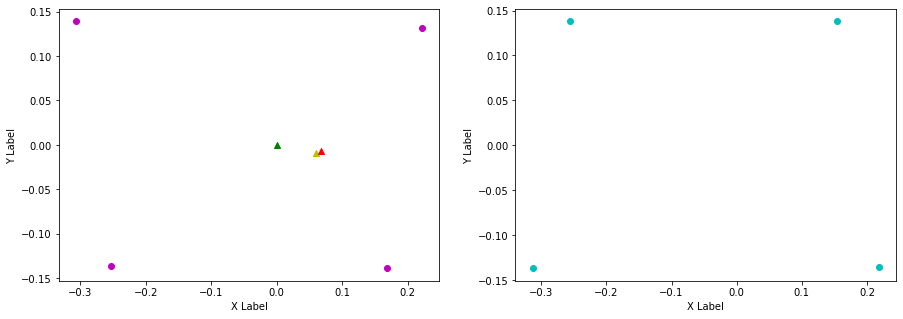

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.154, 0.219, FL (y): 0.138, 0.131.
FL displacement: 0.065, -0.007000000000000006.

FR (x): 0.218, 0.168, FR (y): -0.135, -0.137.
FR displacement: -0.04999999999999999, -0.0020000000000000018.

RL (x): -0.256, -0.309, RL (y): 0.138, 0.137.
RL displacement: -0.05299999999999999, -0.0010000000000000009.

RR (x): -0.313, -0.256, RR (y): -0.137, -0.137.
RR displacement: 0.056999999999999995, 0.0.


Base displacement (Foot): [0.04999999999999999, 0.0020000000000000018].

Base displacement (Odom): [[0.046823622588226144], [0.008659929120375498]]. Rotation displacement: -1.599018571796787.



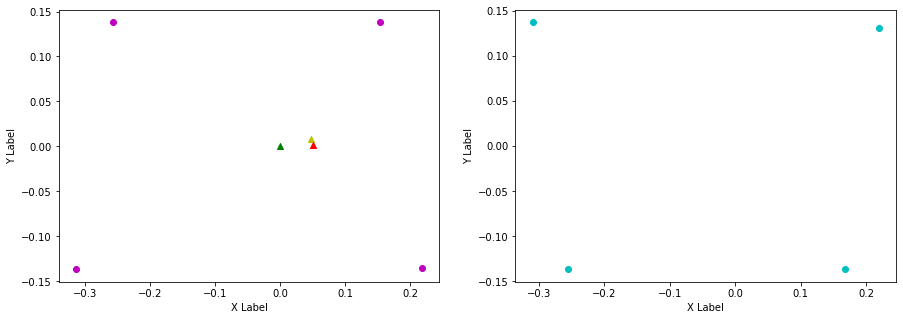

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.219, 0.157, FL (y): 0.131, 0.139.
FL displacement: -0.062, 0.008000000000000007.

FR (x): 0.168, 0.221, FR (y): -0.137, -0.135.
FR displacement: 0.05299999999999999, 0.0020000000000000018.

RL (x): -0.309, -0.254, RL (y): 0.137, 0.138.
RL displacement: 0.05499999999999999, 0.0010000000000000009.

RR (x): -0.256, -0.31, RR (y): -0.137, -0.138.
RR displacement: -0.05399999999999999, -0.0010000000000000009.


Base displacement (Foot): [0.062, -0.008000000000000007].

Base displacement (Odom): [[0.037685980464564395], [-0.0030710767310360154]]. Rotation displacement: 1.2003169546247776.



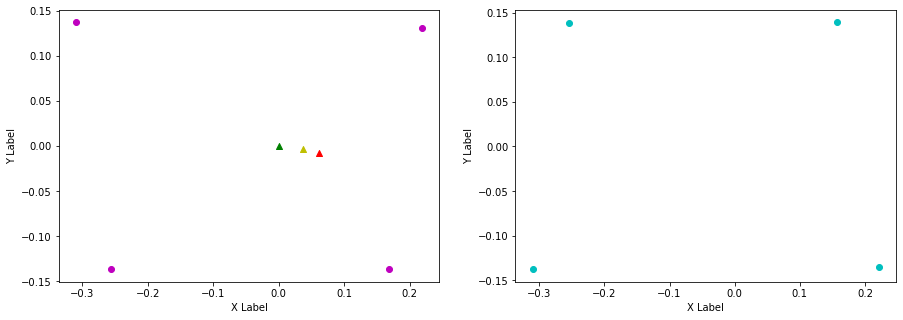

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.157, 0.211, FL (y): 0.139, 0.132.
FL displacement: 0.05399999999999999, -0.007000000000000006.

FR (x): 0.221, 0.144, FR (y): -0.135, -0.135.
FR displacement: -0.07700000000000001, 0.0.

RL (x): -0.254, -0.334, RL (y): 0.138, 0.136.
RL displacement: -0.08000000000000002, -0.0020000000000000018.

RR (x): -0.31, -0.262, RR (y): -0.138, -0.137.
RR displacement: 0.04799999999999999, 0.0010000000000000009.


Base displacement (Foot): [0.07700000000000001, -0.0].

Base displacement (Odom): [[0.0399618887985822], [0.008237116681286683]]. Rotation displacement: -1.6114801496931255.



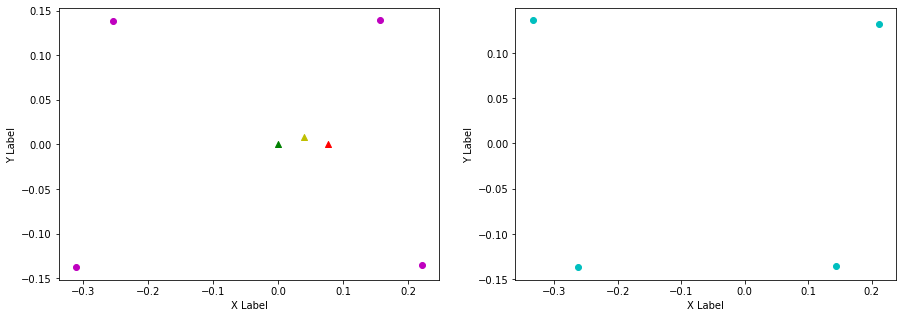

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.211, 0.157, FL (y): 0.132, 0.138.
FL displacement: -0.05399999999999999, 0.006000000000000005.

FR (x): 0.144, 0.221, FR (y): -0.135, -0.135.
FR displacement: 0.07700000000000001, 0.0.

RL (x): -0.334, -0.254, RL (y): 0.136, 0.138.
RL displacement: 0.08000000000000002, 0.0020000000000000018.

RR (x): -0.262, -0.31, RR (y): -0.137, -0.138.
RR displacement: -0.04799999999999999, -0.0010000000000000009.


Base displacement (Foot): [0.05399999999999999, -0.006000000000000005].

Base displacement (Odom): [[0.022497085490564395], [-0.0018830987847455738]]. Rotation displacement: 0.2664998438466973.



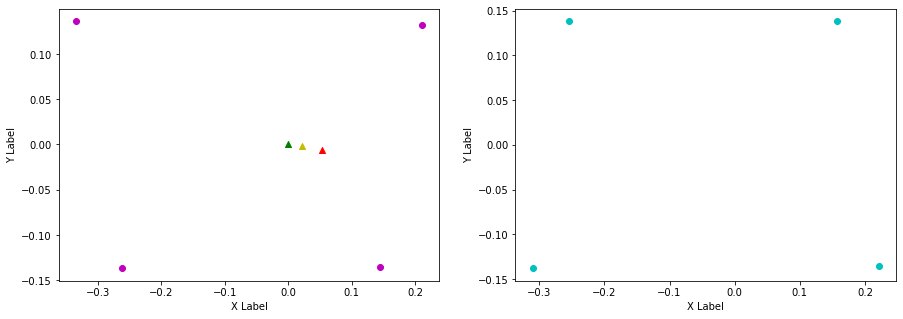

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.157, 0.217, FL (y): 0.138, 0.131.
FL displacement: 0.06, -0.007000000000000006.

FR (x): 0.221, 0.162, FR (y): -0.135, -0.137.
FR displacement: -0.059, -0.0020000000000000018.

RL (x): -0.254, -0.314, RL (y): 0.138, 0.139.
RL displacement: -0.06, 0.0010000000000000009.

RR (x): -0.31, -0.257, RR (y): -0.138, -0.137.
RR displacement: 0.05299999999999999, 0.0010000000000000009.


Base displacement (Foot): [0.059, 0.0020000000000000018].

Base displacement (Odom): [[0.06395087397768862], [0.0077435721379370825]]. Rotation displacement: -0.6747781672859133.



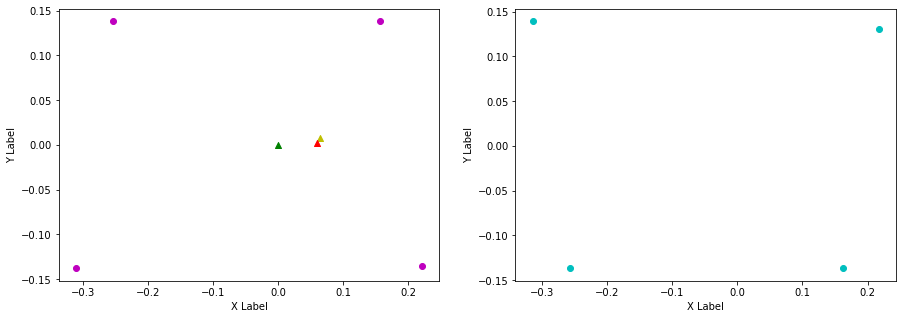

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.217, 0.161, FL (y): 0.131, 0.14.
FL displacement: -0.055999999999999994, 0.009000000000000008.

FR (x): 0.162, 0.225, FR (y): -0.137, -0.134.
FR displacement: 0.063, 0.0030000000000000027.

RL (x): -0.314, -0.25, RL (y): 0.139, 0.137.
RL displacement: 0.064, -0.0020000000000000018.

RR (x): -0.257, -0.306, RR (y): -0.137, -0.139.
RR displacement: -0.04899999999999999, -0.0020000000000000018.


Base displacement (Foot): [0.055999999999999994, -0.009000000000000008].

Base displacement (Odom): [[0.04570972502973891], [-0.006635975422079721]]. Rotation displacement: 0.7912161382142996.



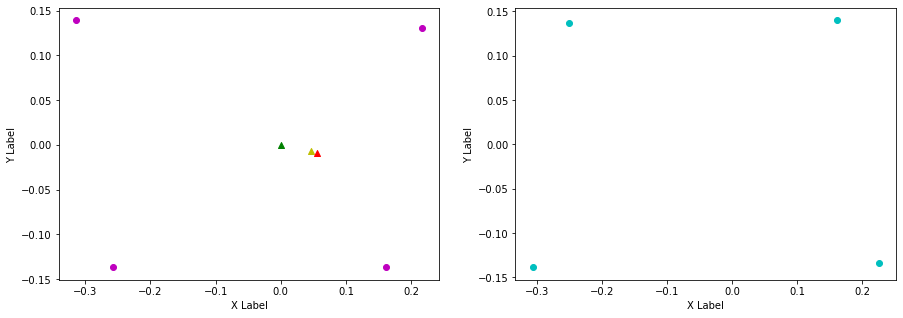

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.161, 0.217, FL (y): 0.14, 0.131.
FL displacement: 0.055999999999999994, -0.009000000000000008.

FR (x): 0.225, 0.163, FR (y): -0.134, -0.137.
FR displacement: -0.062, -0.0030000000000000027.

RL (x): -0.25, -0.314, RL (y): 0.137, 0.138.
RL displacement: -0.064, 0.0010000000000000009.

RR (x): -0.306, -0.258, RR (y): -0.139, -0.137.
RR displacement: 0.04799999999999999, 0.0020000000000000018.


Base displacement (Foot): [0.062, 0.0030000000000000027].

Base displacement (Odom): [[0.0702550582986774], [0.007526525036126941]]. Rotation displacement: -1.2349480821858867.



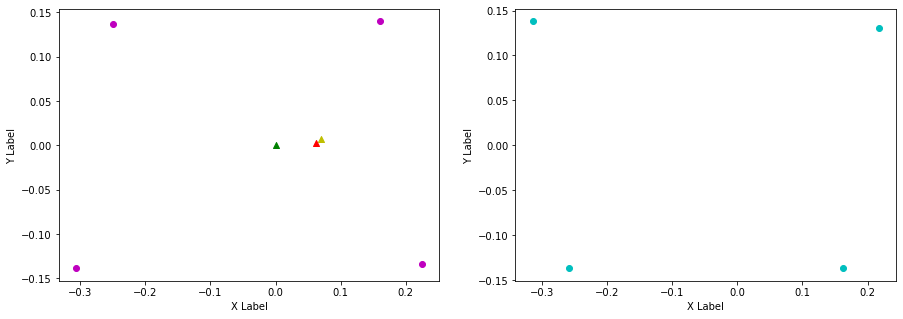

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.217, 0.149, FL (y): 0.131, 0.137.
FL displacement: -0.068, 0.006000000000000005.

FR (x): 0.163, 0.215, FR (y): -0.137, -0.135.
FR displacement: 0.05199999999999999, 0.0020000000000000018.

RL (x): -0.314, -0.259, RL (y): 0.138, 0.139.
RL displacement: 0.05499999999999999, 0.0010000000000000009.

RR (x): -0.258, -0.319, RR (y): -0.137, -0.137.
RR displacement: -0.061, 0.0.


Base displacement (Foot): [0.068, -0.006000000000000005].

Base displacement (Odom): [[0.04525171778384207], [-0.006721008616715984]]. Rotation displacement: 1.106614480435815.



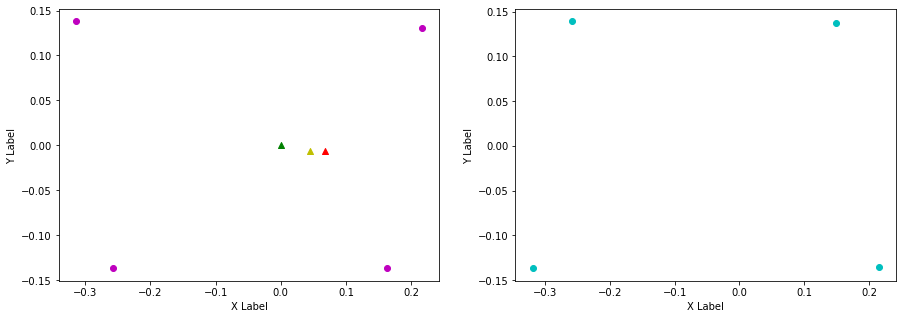

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.149, 0.212, FL (y): 0.137, 0.132.
FL displacement: 0.063, -0.0050000000000000044.

FR (x): 0.215, 0.146, FR (y): -0.135, -0.135.
FR displacement: -0.069, 0.0.

RL (x): -0.259, -0.333, RL (y): 0.139, 0.137.
RL displacement: -0.07400000000000001, -0.0020000000000000018.

RR (x): -0.319, -0.262, RR (y): -0.137, -0.138.
RR displacement: 0.056999999999999995, -0.0010000000000000009.


Base displacement (Foot): [0.069, -0.0].

Base displacement (Odom): [[0.06411018776785626], [0.00830402954752385]]. Rotation displacement: -1.2497760844430177.



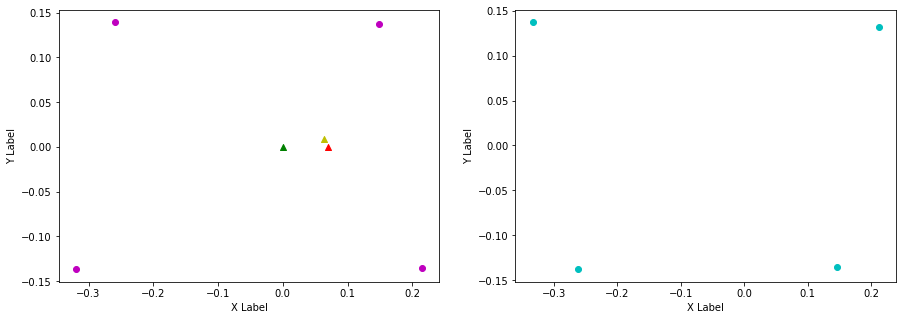

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.212, 0.152, FL (y): 0.132, 0.138.
FL displacement: -0.06, 0.006000000000000005.

FR (x): 0.146, 0.216, FR (y): -0.135, -0.135.
FR displacement: 0.07, 0.0.

RL (x): -0.333, -0.258, RL (y): 0.137, 0.139.
RL displacement: 0.07500000000000001, 0.0020000000000000018.

RR (x): -0.262, -0.316, RR (y): -0.138, -0.137.
RR displacement: -0.05399999999999999, 0.0010000000000000009.


Base displacement (Foot): [0.06, -0.006000000000000005].

Base displacement (Odom): [[0.04914467998070737], [-0.00796712687391432]]. Rotation displacement: 0.14320348182587733.



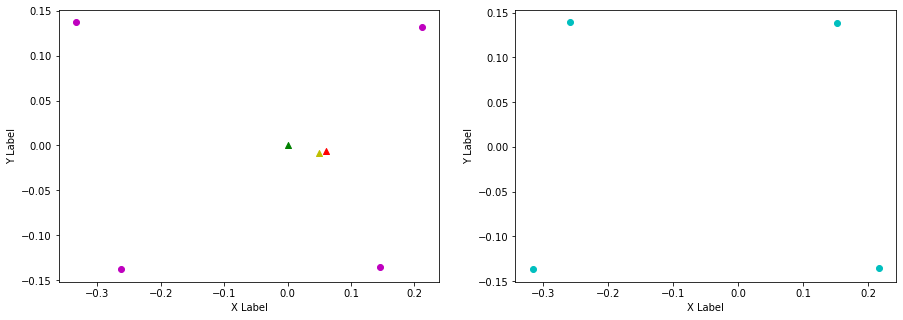

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.152, 0.215, FL (y): 0.138, 0.131.
FL displacement: 0.063, -0.007000000000000006.

FR (x): 0.216, 0.157, FR (y): -0.135, -0.136.
FR displacement: -0.059, -0.0010000000000000009.

RL (x): -0.258, -0.319, RL (y): 0.139, 0.138.
RL displacement: -0.061, -0.0010000000000000009.

RR (x): -0.316, -0.259, RR (y): -0.137, -0.137.
RR displacement: 0.056999999999999995, 0.0.


Base displacement (Foot): [0.059, 0.0010000000000000009].

Base displacement (Odom): [[0.03759425855565279], [0.004922979439683672]]. Rotation displacement: -0.7497099659406257.



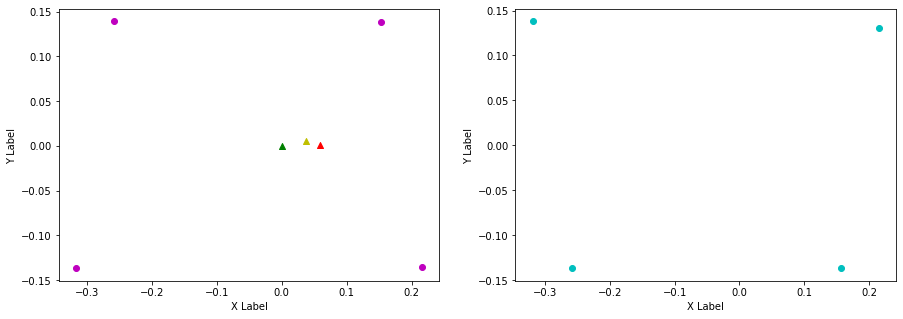

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.215, 0.15, FL (y): 0.131, 0.137.
FL displacement: -0.065, 0.006000000000000005.

FR (x): 0.157, 0.215, FR (y): -0.136, -0.135.
FR displacement: 0.057999999999999996, 0.0010000000000000009.

RL (x): -0.319, -0.259, RL (y): 0.138, 0.139.
RL displacement: 0.06, 0.0010000000000000009.

RR (x): -0.259, -0.319, RR (y): -0.137, -0.137.
RR displacement: -0.06, 0.0.


Base displacement (Foot): [0.065, -0.006000000000000005].

Base displacement (Odom): [[0.043389548052354066], [-0.005845002161089408]]. Rotation displacement: 0.5759109266310068.



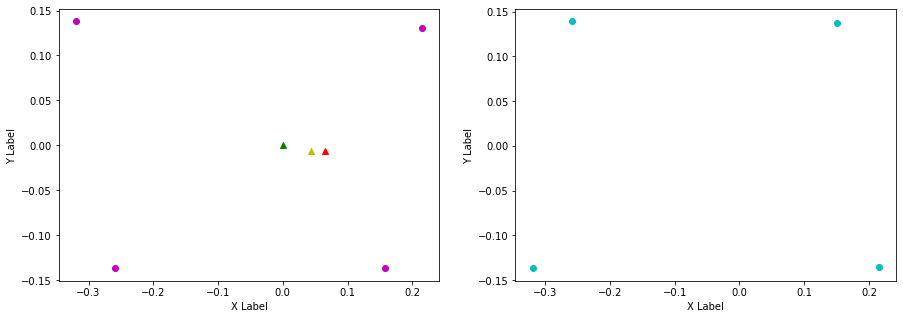

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.15, 0.213, FL (y): 0.137, 0.132.
FL displacement: 0.063, -0.0050000000000000044.

FR (x): 0.215, 0.149, FR (y): -0.135, -0.135.
FR displacement: -0.066, 0.0.

RL (x): -0.259, -0.331, RL (y): 0.139, 0.137.
RL displacement: -0.07200000000000001, -0.0020000000000000018.

RR (x): -0.319, -0.262, RR (y): -0.137, -0.138.
RR displacement: 0.056999999999999995, -0.0010000000000000009.


Base displacement (Foot): [0.066, -0.0].

Base displacement (Odom): [[0.06408214184881711], [0.0067165718623489745]]. Rotation displacement: -0.8111036339807897.



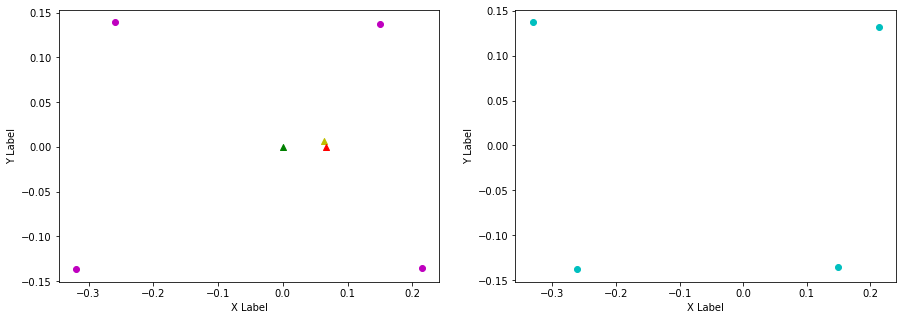

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.213, 0.149, FL (y): 0.132, 0.137.
FL displacement: -0.064, 0.0050000000000000044.

FR (x): 0.149, 0.215, FR (y): -0.135, -0.135.
FR displacement: 0.066, 0.0.

RL (x): -0.331, -0.259, RL (y): 0.137, 0.139.
RL displacement: 0.07200000000000001, 0.0020000000000000018.

RR (x): -0.262, -0.319, RR (y): -0.138, -0.137.
RR displacement: -0.056999999999999995, 0.0010000000000000009.


Base displacement (Foot): [0.064, -0.0050000000000000044].

Base displacement (Odom): [[0.054753804615028656], [-0.009035251397373933]]. Rotation displacement: 0.1467407408451017.



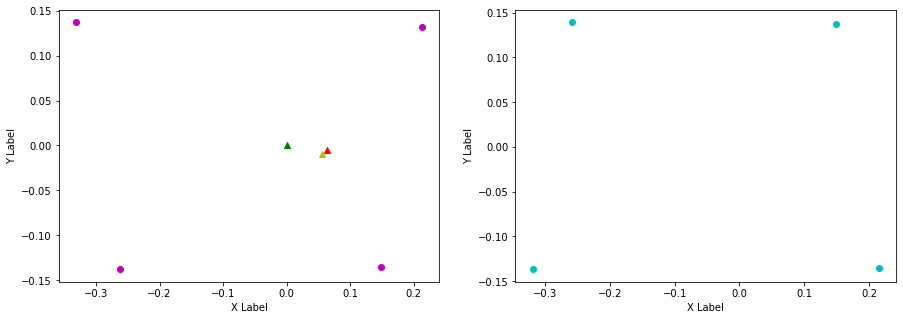

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.149, 0.215, FL (y): 0.137, 0.131.
FL displacement: 0.066, -0.006000000000000005.

FR (x): 0.215, 0.153, FR (y): -0.135, -0.136.
FR displacement: -0.062, -0.0010000000000000009.

RL (x): -0.259, -0.324, RL (y): 0.139, 0.137.
RL displacement: -0.065, -0.0020000000000000018.

RR (x): -0.319, -0.26, RR (y): -0.137, -0.137.
RR displacement: 0.059, 0.0.


Base displacement (Foot): [0.062, 0.0010000000000000009].

Base displacement (Odom): [[0.05114319142374413], [0.006256583080217926]]. Rotation displacement: -1.0754438317697983.



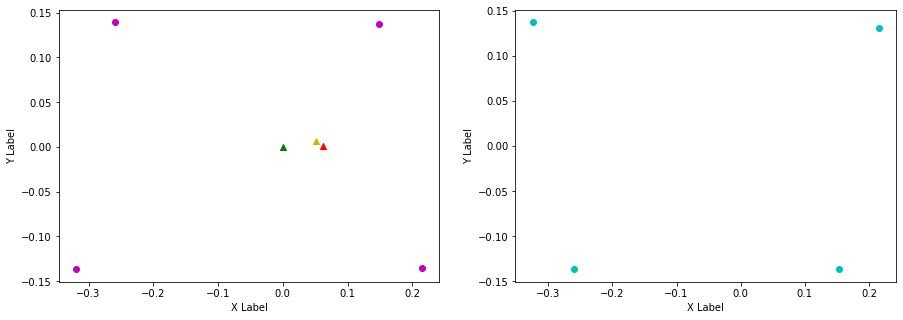

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.215, 0.143, FL (y): 0.131, 0.136.
FL displacement: -0.07200000000000001, 0.0050000000000000044.

FR (x): 0.153, 0.212, FR (y): -0.136, -0.136.
FR displacement: 0.059, 0.0.

RL (x): -0.324, -0.262, RL (y): 0.137, 0.139.
RL displacement: 0.062, 0.0020000000000000018.

RR (x): -0.26, -0.329, RR (y): -0.137, -0.136.
RR displacement: -0.069, 0.0010000000000000009.


Base displacement (Foot): [0.07200000000000001, -0.0050000000000000044].

Base displacement (Odom): [[0.05763091772039619], [-0.008568314045357184]]. Rotation displacement: 0.7975972572049338.



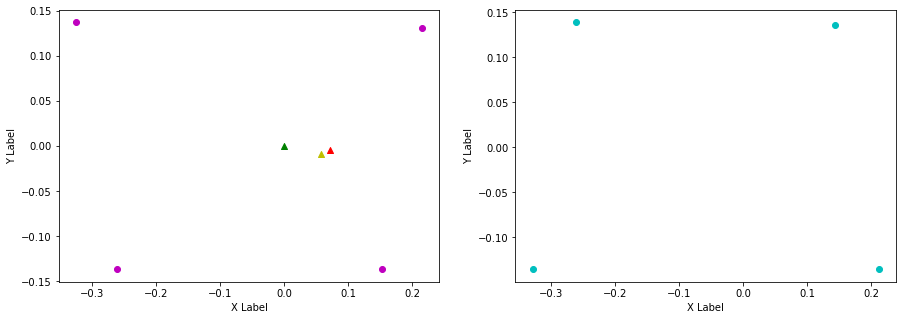

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.143, 0.22, FL (y): 0.136, 0.131.
FL displacement: 0.07700000000000001, -0.0050000000000000044.

FR (x): 0.212, 0.169, FR (y): -0.136, -0.138.
FR displacement: -0.04299999999999998, -0.0020000000000000018.

RL (x): -0.262, -0.309, RL (y): 0.139, 0.138.
RL displacement: -0.046999999999999986, -0.0010000000000000009.

RR (x): -0.329, -0.254, RR (y): -0.136, -0.137.
RR displacement: 0.07500000000000001, -0.0010000000000000009.


Base displacement (Foot): [0.04299999999999998, 0.0020000000000000018].

Base displacement (Odom): [[0.0631513807588604], [0.010658097823340373]]. Rotation displacement: -1.08763568451517.



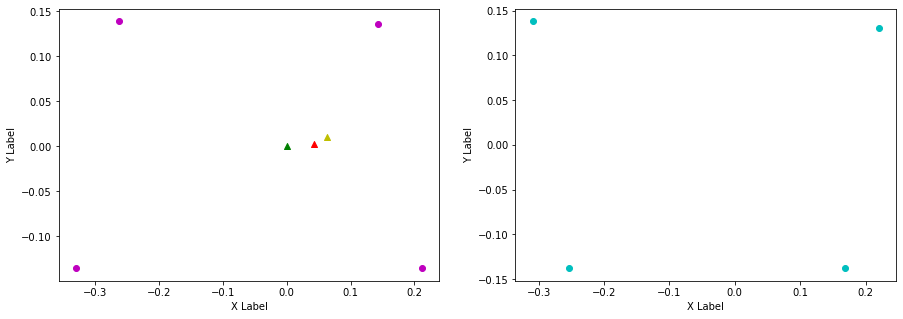

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.22, 0.154, FL (y): 0.131, 0.138.
FL displacement: -0.066, 0.007000000000000006.

FR (x): 0.169, 0.218, FR (y): -0.138, -0.135.
FR displacement: 0.04899999999999999, 0.0030000000000000027.

RL (x): -0.309, -0.256, RL (y): 0.138, 0.138.
RL displacement: 0.05299999999999999, 0.0.

RR (x): -0.254, -0.313, RR (y): -0.137, -0.138.
RR displacement: -0.059, -0.0010000000000000009.


Base displacement (Foot): [0.066, -0.007000000000000006].

Base displacement (Odom): [[0.05582428802659756], [-0.006475962184909534]]. Rotation displacement: 0.9918381502052749.



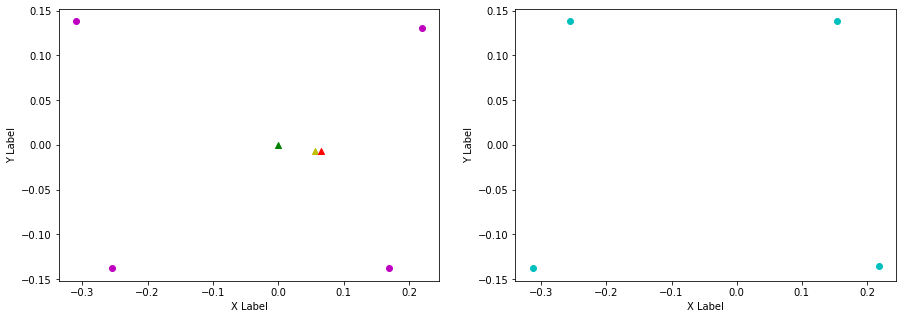

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.154, 0.212, FL (y): 0.138, 0.132.
FL displacement: 0.057999999999999996, -0.006000000000000005.

FR (x): 0.218, 0.146, FR (y): -0.135, -0.135.
FR displacement: -0.07200000000000001, 0.0.

RL (x): -0.256, -0.332, RL (y): 0.138, 0.137.
RL displacement: -0.07600000000000001, -0.0010000000000000009.

RR (x): -0.313, -0.262, RR (y): -0.138, -0.138.
RR displacement: 0.05099999999999999, 0.0.


Base displacement (Foot): [0.07200000000000001, -0.0].

Base displacement (Odom): [[0.07298732869404745], [0.011811837651054535]]. Rotation displacement: -1.5211325928374593.



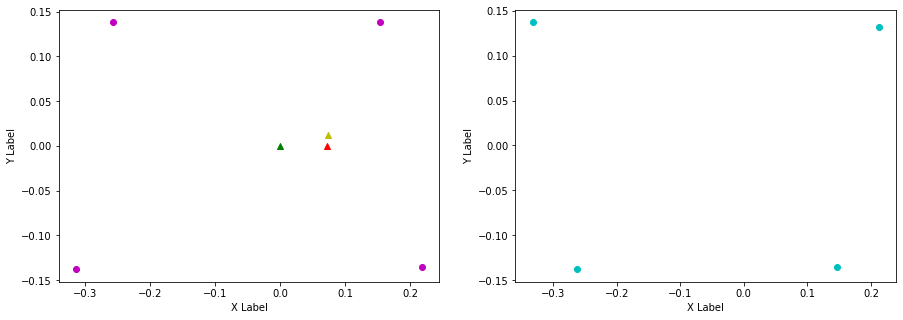

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.212, 0.143, FL (y): 0.132, 0.136.
FL displacement: -0.069, 0.0040000000000000036.

FR (x): 0.146, 0.211, FR (y): -0.135, -0.136.
FR displacement: 0.065, -0.0010000000000000009.

RL (x): -0.332, -0.262, RL (y): 0.137, 0.139.
RL displacement: 0.07, 0.0020000000000000018.

RR (x): -0.262, -0.327, RR (y): -0.138, -0.136.
RR displacement: -0.065, 0.0020000000000000018.


Base displacement (Foot): [0.069, -0.0040000000000000036].

Base displacement (Odom): [[0.037114677266882445], [-0.006251938998977469]]. Rotation displacement: 0.6758926130635039.



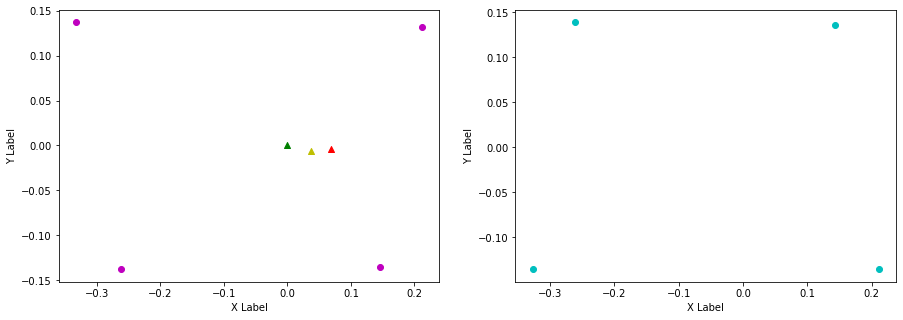

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.143, 0.214, FL (y): 0.136, 0.131.
FL displacement: 0.07100000000000001, -0.0050000000000000044.

FR (x): 0.211, 0.153, FR (y): -0.136, -0.136.
FR displacement: -0.057999999999999996, 0.0.

RL (x): -0.262, -0.324, RL (y): 0.139, 0.137.
RL displacement: -0.062, -0.0020000000000000018.

RR (x): -0.327, -0.26, RR (y): -0.136, -0.137.
RR displacement: 0.067, -0.0010000000000000009.


Base displacement (Foot): [0.057999999999999996, -0.0].

Base displacement (Odom): [[0.06729883284499394], [0.010980256424470536]]. Rotation displacement: -0.9393366138790759.



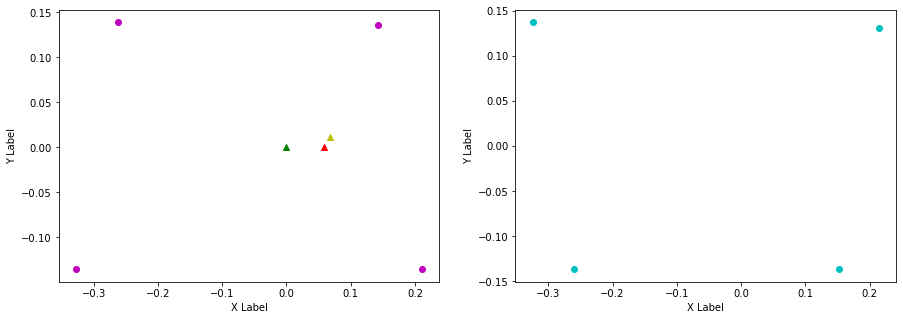

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.214, 0.153, FL (y): 0.131, 0.138.
FL displacement: -0.061, 0.007000000000000006.

FR (x): 0.153, 0.217, FR (y): -0.136, -0.135.
FR displacement: 0.064, 0.0010000000000000009.

RL (x): -0.324, -0.257, RL (y): 0.137, 0.138.
RL displacement: 0.067, 0.0010000000000000009.

RR (x): -0.26, -0.313, RR (y): -0.137, -0.138.
RR displacement: -0.05299999999999999, -0.0010000000000000009.


Base displacement (Foot): [0.061, -0.007000000000000006].

Base displacement (Odom): [[0.03767765372567489], [-0.005574812552290531]]. Rotation displacement: 0.4296924863589105.



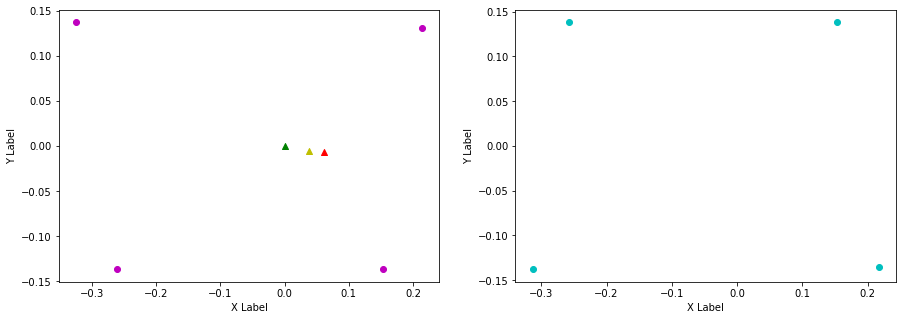

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.153, 0.212, FL (y): 0.138, 0.132.
FL displacement: 0.059, -0.006000000000000005.

FR (x): 0.217, 0.147, FR (y): -0.135, -0.135.
FR displacement: -0.07, 0.0.

RL (x): -0.257, -0.33, RL (y): 0.138, 0.137.
RL displacement: -0.07300000000000001, -0.0010000000000000009.

RR (x): -0.313, -0.261, RR (y): -0.138, -0.138.
RR displacement: 0.05199999999999999, 0.0.


Base displacement (Foot): [0.07, -0.0].

Base displacement (Odom): [[0.06830151173791954], [0.009688026384113702]]. Rotation displacement: -1.0605273586329416.



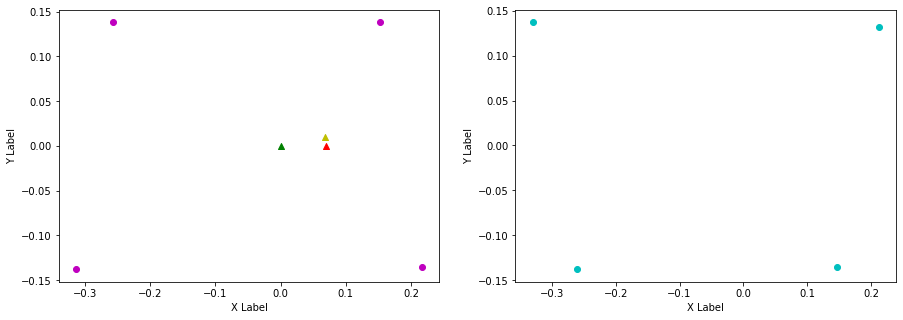

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.212, 0.145, FL (y): 0.132, 0.136.
FL displacement: -0.067, 0.0040000000000000036.

FR (x): 0.147, 0.212, FR (y): -0.135, -0.136.
FR displacement: 0.065, -0.0010000000000000009.

RL (x): -0.33, -0.261, RL (y): 0.137, 0.139.
RL displacement: 0.069, 0.0020000000000000018.

RR (x): -0.261, -0.326, RR (y): -0.138, -0.136.
RR displacement: -0.065, 0.0020000000000000018.


Base displacement (Foot): [0.067, -0.0040000000000000036].

Base displacement (Odom): [[0.05708070000897969], [-0.0077847389550660395]]. Rotation displacement: 0.7596435504528652.



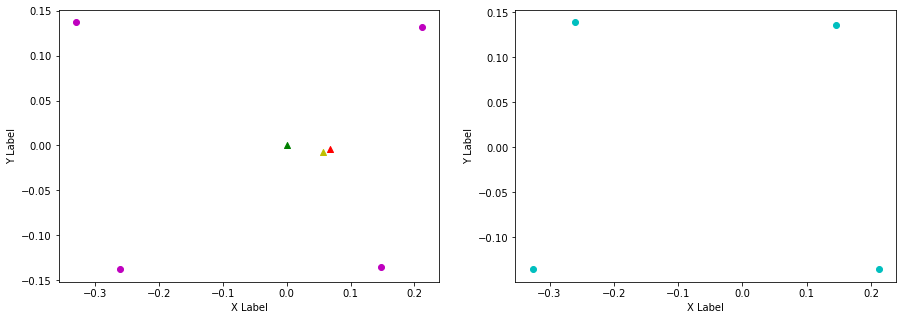

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.145, 0.213, FL (y): 0.136, 0.132.
FL displacement: 0.068, -0.0040000000000000036.

FR (x): 0.212, 0.151, FR (y): -0.136, -0.135.
FR displacement: -0.061, 0.0010000000000000009.

RL (x): -0.261, -0.326, RL (y): 0.139, 0.137.
RL displacement: -0.065, -0.0020000000000000018.

RR (x): -0.326, -0.261, RR (y): -0.136, -0.138.
RR displacement: 0.065, -0.0020000000000000018.


Base displacement (Foot): [0.061, -0.0010000000000000009].

Base displacement (Odom): [[0.04470364728287901], [0.009416927491072702]]. Rotation displacement: -0.9134290361274661.



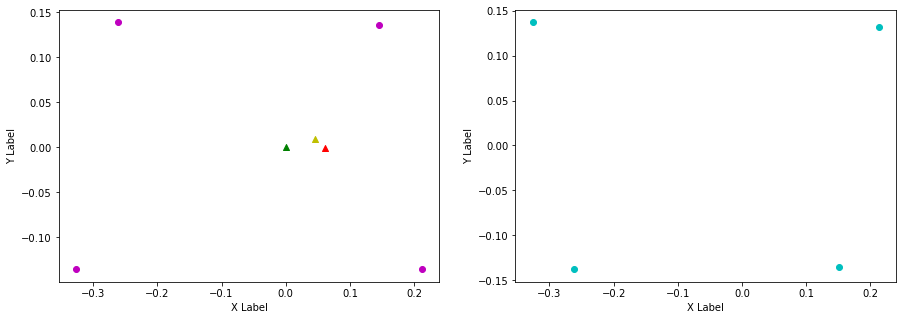

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.213, 0.149, FL (y): 0.132, 0.137.
FL displacement: -0.064, 0.0050000000000000044.

FR (x): 0.151, 0.215, FR (y): -0.135, -0.135.
FR displacement: 0.064, 0.0.

RL (x): -0.326, -0.259, RL (y): 0.137, 0.139.
RL displacement: 0.067, 0.0020000000000000018.

RR (x): -0.261, -0.32, RR (y): -0.138, -0.137.
RR displacement: -0.059, 0.0010000000000000009.


Base displacement (Foot): [0.064, -0.0050000000000000044].

Base displacement (Odom): [[0.047202928889435114], [-0.005155292028210745]]. Rotation displacement: 0.3370679288115285.



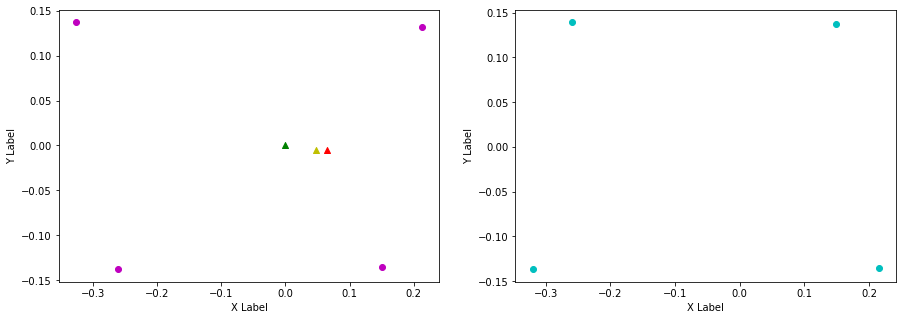

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.149, 0.215, FL (y): 0.137, 0.131.
FL displacement: 0.066, -0.006000000000000005.

FR (x): 0.215, 0.159, FR (y): -0.135, -0.136.
FR displacement: -0.055999999999999994, -0.0010000000000000009.

RL (x): -0.259, -0.319, RL (y): 0.139, 0.138.
RL displacement: -0.06, -0.0010000000000000009.

RR (x): -0.32, -0.259, RR (y): -0.137, -0.138.
RR displacement: 0.061, -0.0010000000000000009.


Base displacement (Foot): [0.055999999999999994, 0.0010000000000000009].

Base displacement (Odom): [[0.07623559301754934], [0.011348328907670346]]. Rotation displacement: -1.0420948885380594.



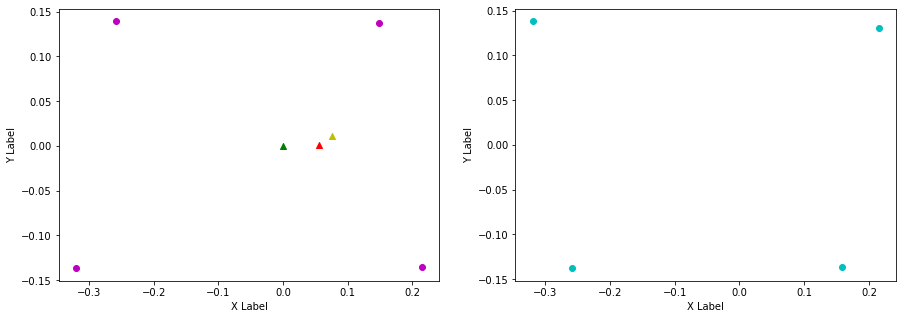

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.215, 0.153, FL (y): 0.131, 0.138.
FL displacement: -0.062, 0.007000000000000006.

FR (x): 0.159, 0.217, FR (y): -0.136, -0.134.
FR displacement: 0.057999999999999996, 0.0020000000000000018.

RL (x): -0.319, -0.257, RL (y): 0.138, 0.138.
RL displacement: 0.062, 0.0.

RR (x): -0.259, -0.314, RR (y): -0.138, -0.137.
RR displacement: -0.05499999999999999, 0.0010000000000000009.


Base displacement (Foot): [0.062, -0.007000000000000006].

Base displacement (Odom): [[0.05750351020759048], [-0.010014535809585112]]. Rotation displacement: 0.8055777940010673.



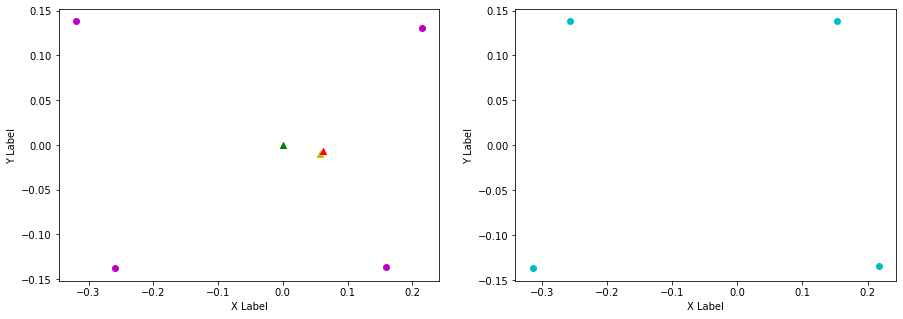

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.153, 0.22, FL (y): 0.138, 0.132.
FL displacement: 0.067, -0.006000000000000005.

FR (x): 0.217, 0.168, FR (y): -0.134, -0.138.
FR displacement: -0.04899999999999999, -0.0040000000000000036.

RL (x): -0.257, -0.308, RL (y): 0.138, 0.138.
RL displacement: -0.05099999999999999, 0.0.

RR (x): -0.314, -0.255, RR (y): -0.137, -0.136.
RR displacement: 0.059, 0.0010000000000000009.


Base displacement (Foot): [0.04899999999999999, 0.0040000000000000036].

Base displacement (Odom): [[0.05857130076863637], [0.0103996134712383]]. Rotation displacement: -1.244501363809488.



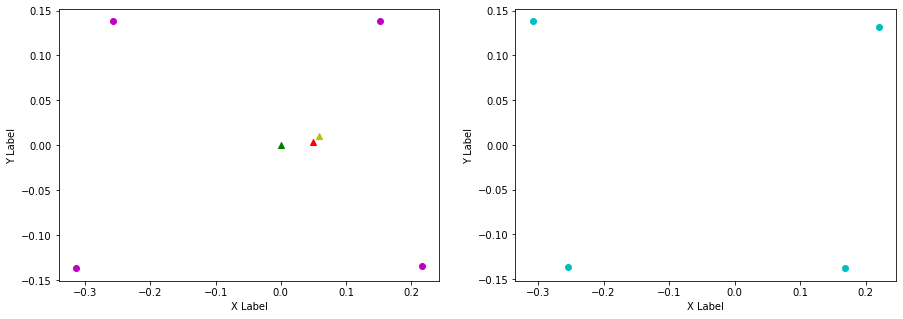

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.22, 0.156, FL (y): 0.132, 0.139.
FL displacement: -0.064, 0.007000000000000006.

FR (x): 0.168, 0.22, FR (y): -0.138, -0.135.
FR displacement: 0.05199999999999999, 0.0030000000000000027.

RL (x): -0.308, -0.255, RL (y): 0.138, 0.138.
RL displacement: 0.05299999999999999, 0.0.

RR (x): -0.255, -0.311, RR (y): -0.136, -0.138.
RR displacement: -0.055999999999999994, -0.0020000000000000018.


Base displacement (Foot): [0.064, -0.007000000000000006].

Base displacement (Odom): [[0.041024588186783895], [-0.00840612217985015]]. Rotation displacement: 1.3197025680965673.



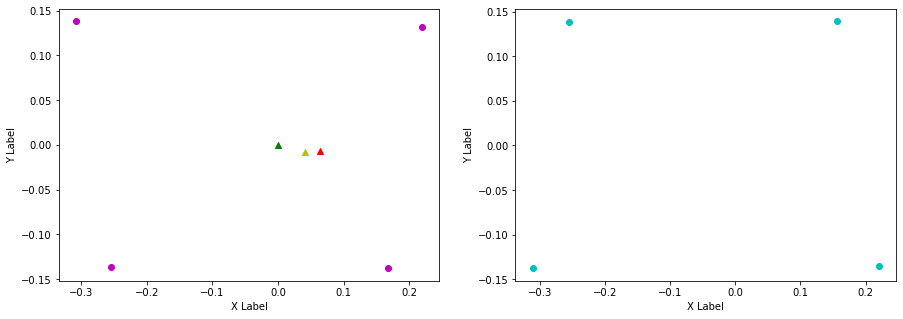

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.156, 0.22, FL (y): 0.139, 0.131.
FL displacement: 0.064, -0.008000000000000007.

FR (x): 0.22, 0.168, FR (y): -0.135, -0.138.
FR displacement: -0.05199999999999999, -0.0030000000000000027.

RL (x): -0.255, -0.308, RL (y): 0.138, 0.138.
RL displacement: -0.05299999999999999, 0.0.

RR (x): -0.311, -0.255, RR (y): -0.138, -0.136.
RR displacement: 0.055999999999999994, 0.0020000000000000018.


Base displacement (Foot): [0.05199999999999999, 0.0030000000000000027].

Base displacement (Odom): [[0.05421145207539624], [0.0062139461850967415]]. Rotation displacement: -1.758047516137849.



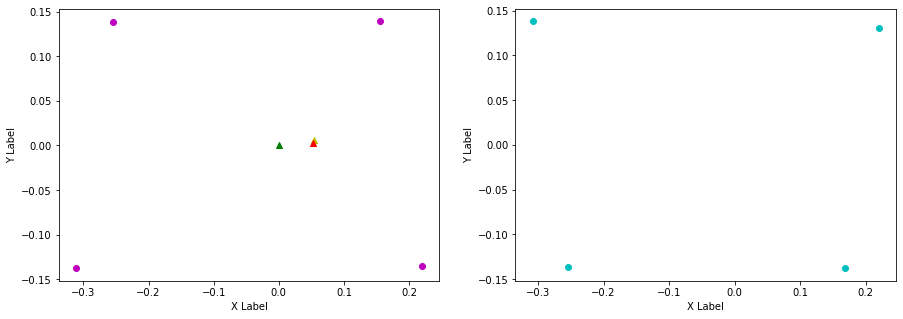

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.22, 0.157, FL (y): 0.131, 0.138.
FL displacement: -0.063, 0.007000000000000006.

FR (x): 0.168, 0.221, FR (y): -0.138, -0.134.
FR displacement: 0.05299999999999999, 0.0040000000000000036.

RL (x): -0.308, -0.253, RL (y): 0.138, 0.138.
RL displacement: 0.05499999999999999, 0.0.

RR (x): -0.255, -0.309, RR (y): -0.136, -0.138.
RR displacement: -0.05399999999999999, -0.0020000000000000018.


Base displacement (Foot): [0.063, -0.007000000000000006].

Base displacement (Odom): [[0.04656395490417076], [-0.006895378657710616]]. Rotation displacement: 1.16508247820549.



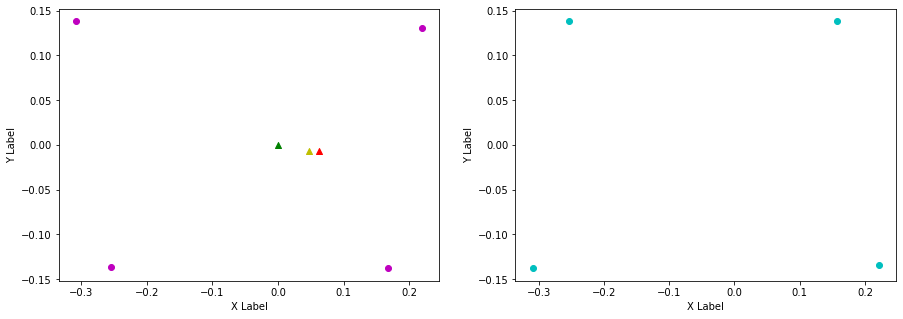

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.157, 0.214, FL (y): 0.138, 0.132.
FL displacement: 0.056999999999999995, -0.006000000000000005.

FR (x): 0.221, 0.149, FR (y): -0.134, -0.136.
FR displacement: -0.07200000000000001, -0.0020000000000000018.

RL (x): -0.253, -0.327, RL (y): 0.138, 0.137.
RL displacement: -0.07400000000000001, -0.0010000000000000009.

RR (x): -0.309, -0.26, RR (y): -0.138, -0.138.
RR displacement: 0.04899999999999999, 0.0.


Base displacement (Foot): [0.07200000000000001, 0.0020000000000000018].

Base displacement (Odom): [[0.05480077069317968], [0.007846003486403852]]. Rotation displacement: -1.3650448455984248.



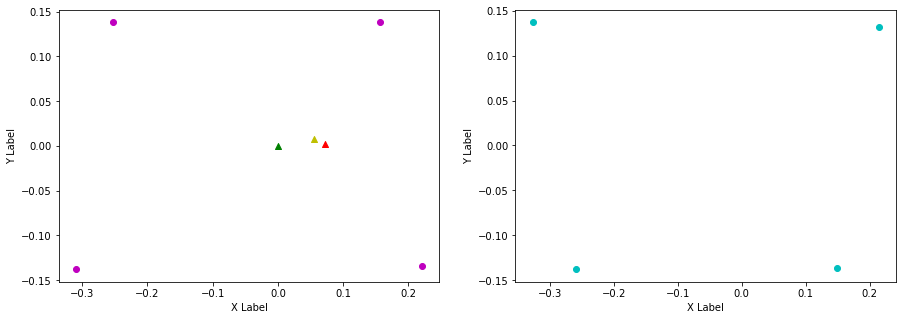

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.214, 0.16, FL (y): 0.132, 0.139.
FL displacement: -0.05399999999999999, 0.007000000000000006.

FR (x): 0.149, 0.224, FR (y): -0.136, -0.135.
FR displacement: 0.07500000000000001, 0.0010000000000000009.

RL (x): -0.327, -0.251, RL (y): 0.137, 0.137.
RL displacement: 0.07600000000000001, 0.0.

RR (x): -0.26, -0.307, RR (y): -0.138, -0.139.
RR displacement: -0.046999999999999986, -0.0010000000000000009.


Base displacement (Foot): [0.05399999999999999, -0.007000000000000006].

Base displacement (Odom): [[0.04173776345866642], [-0.006202806028198893]]. Rotation displacement: 0.5547600931829711.



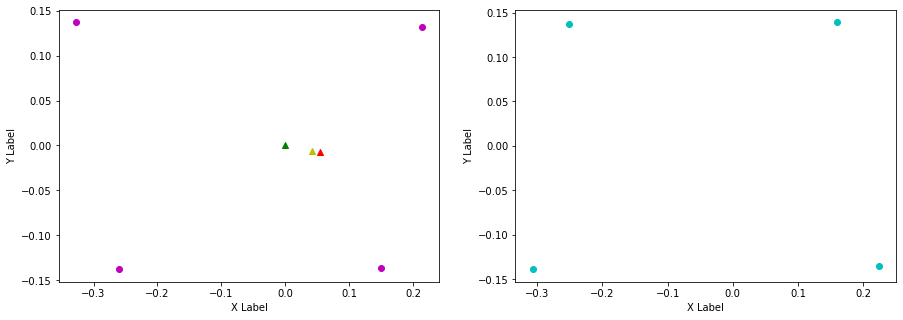

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.16, 0.216, FL (y): 0.139, 0.131.
FL displacement: 0.055999999999999994, -0.008000000000000007.

FR (x): 0.224, 0.159, FR (y): -0.135, -0.136.
FR displacement: -0.065, -0.0010000000000000009.

RL (x): -0.251, -0.319, RL (y): 0.137, 0.138.
RL displacement: -0.068, 0.0010000000000000009.

RR (x): -0.307, -0.259, RR (y): -0.139, -0.138.
RR displacement: 0.04799999999999999, 0.0010000000000000009.


Base displacement (Foot): [0.065, 0.0010000000000000009].

Base displacement (Odom): [[0.04179388387442362], [0.00776446184604751]]. Rotation displacement: -1.0086209038253378.



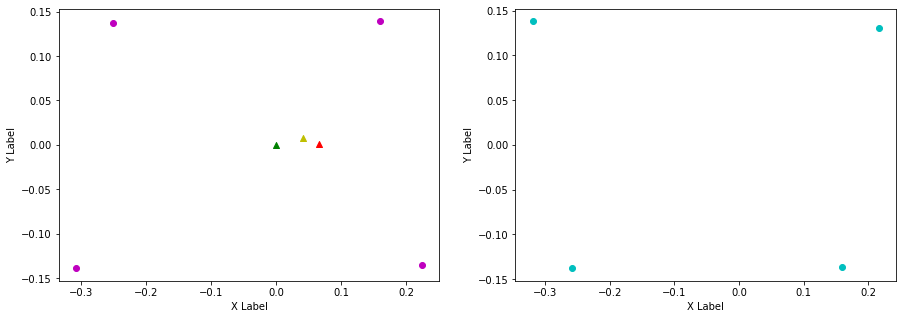

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.216, 0.16, FL (y): 0.131, 0.139.
FL displacement: -0.055999999999999994, 0.008000000000000007.

FR (x): 0.159, 0.223, FR (y): -0.136, -0.134.
FR displacement: 0.064, 0.0020000000000000018.

RL (x): -0.319, -0.251, RL (y): 0.138, 0.138.
RL displacement: 0.068, 0.0.

RR (x): -0.259, -0.307, RR (y): -0.138, -0.139.
RR displacement: -0.04799999999999999, -0.0010000000000000009.


Base displacement (Foot): [0.055999999999999994, -0.008000000000000007].

Base displacement (Odom): [[0.026355147975631432], [-0.0012902718899505672]]. Rotation displacement: 0.7535789794107259.



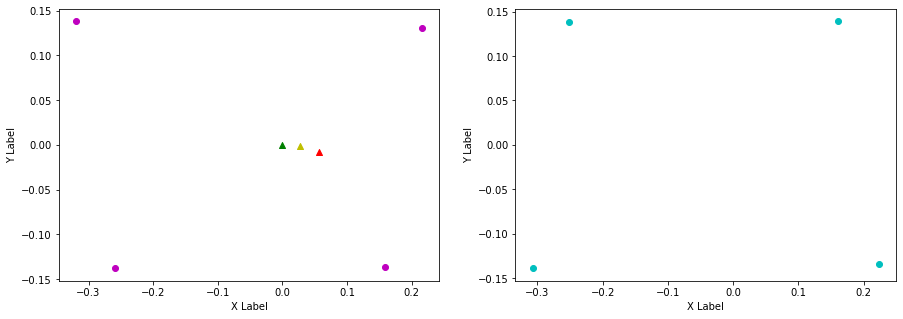

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.16, 0.215, FL (y): 0.139, 0.131.
FL displacement: 0.05499999999999999, -0.008000000000000007.

FR (x): 0.223, 0.154, FR (y): -0.134, -0.136.
FR displacement: -0.069, -0.0020000000000000018.

RL (x): -0.251, -0.324, RL (y): 0.138, 0.138.
RL displacement: -0.07300000000000001, 0.0.

RR (x): -0.307, -0.259, RR (y): -0.139, -0.138.
RR displacement: 0.04799999999999999, 0.0010000000000000009.


Base displacement (Foot): [0.069, 0.0020000000000000018].

Base displacement (Odom): [[0.0653777018108892], [0.0057255857582534375]]. Rotation displacement: -1.2563284321447838.



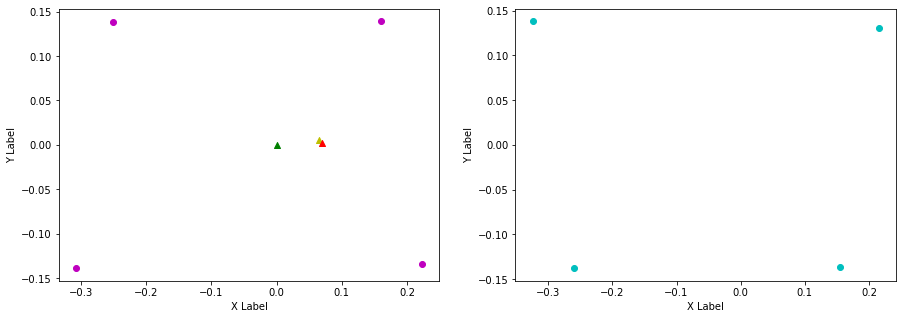

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.215, 0.143, FL (y): 0.131, 0.136.
FL displacement: -0.07200000000000001, 0.0050000000000000044.

FR (x): 0.154, 0.211, FR (y): -0.136, -0.136.
FR displacement: 0.056999999999999995, 0.0.

RL (x): -0.324, -0.262, RL (y): 0.138, 0.139.
RL displacement: 0.062, 0.0010000000000000009.

RR (x): -0.259, -0.329, RR (y): -0.138, -0.136.
RR displacement: -0.07, 0.0020000000000000018.


Base displacement (Foot): [0.07200000000000001, -0.0050000000000000044].

Base displacement (Odom): [[0.025025871099519925], [-0.005101811033704884]]. Rotation displacement: 0.8250202591043729.



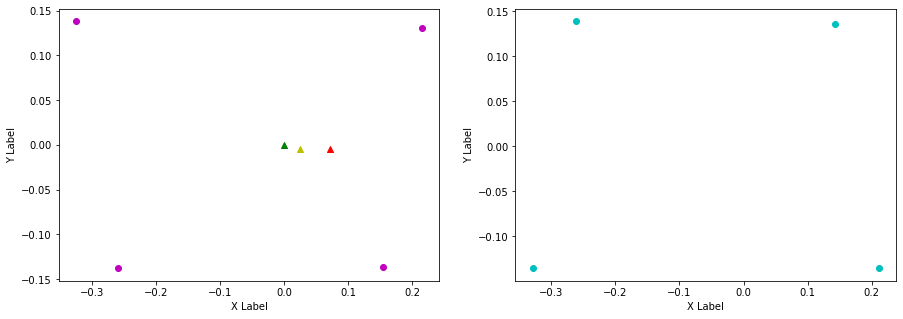

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.143, 0.216, FL (y): 0.136, 0.131.
FL displacement: 0.07300000000000001, -0.0050000000000000044.

FR (x): 0.211, 0.158, FR (y): -0.136, -0.136.
FR displacement: -0.05299999999999999, 0.0.

RL (x): -0.262, -0.319, RL (y): 0.139, 0.138.
RL displacement: -0.056999999999999995, -0.0010000000000000009.

RR (x): -0.329, -0.259, RR (y): -0.136, -0.138.
RR displacement: 0.07, -0.0020000000000000018.


Base displacement (Foot): [0.05299999999999999, -0.0].

Base displacement (Odom): [[0.06892255041776174], [0.0106396745979227]]. Rotation displacement: -0.6512662891606541.



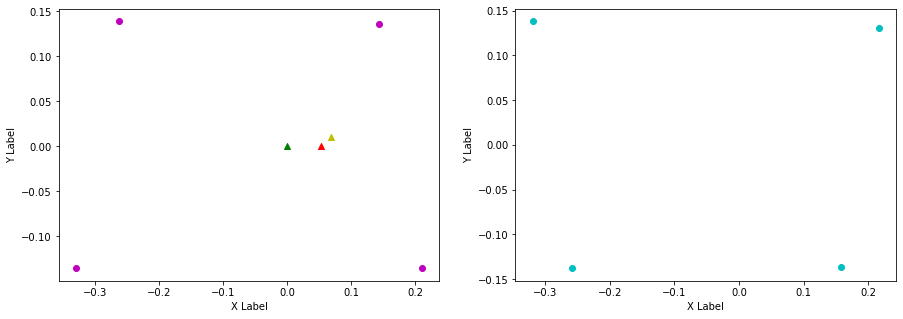

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.216, 0.147, FL (y): 0.131, 0.137.
FL displacement: -0.069, 0.006000000000000005.

FR (x): 0.158, 0.214, FR (y): -0.136, -0.136.
FR displacement: 0.055999999999999994, 0.0.

RL (x): -0.319, -0.26, RL (y): 0.138, 0.139.
RL displacement: 0.059, 0.0010000000000000009.

RR (x): -0.259, -0.323, RR (y): -0.138, -0.137.
RR displacement: -0.064, 0.0010000000000000009.


Base displacement (Foot): [0.069, -0.006000000000000005].

Base displacement (Odom): [[0.02349345178751161], [-0.003954669451041504]]. Rotation displacement: 0.3315684923485125.



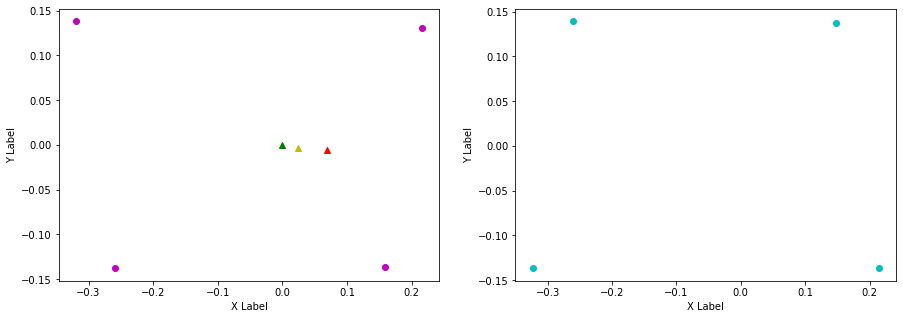

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.147, 0.219, FL (y): 0.137, 0.131.
FL displacement: 0.07200000000000001, -0.006000000000000005.

FR (x): 0.214, 0.168, FR (y): -0.136, -0.137.
FR displacement: -0.045999999999999985, -0.0010000000000000009.

RL (x): -0.26, -0.309, RL (y): 0.139, 0.138.
RL displacement: -0.04899999999999999, -0.0010000000000000009.

RR (x): -0.323, -0.256, RR (y): -0.137, -0.137.
RR displacement: 0.067, 0.0.


Base displacement (Foot): [0.045999999999999985, 0.0010000000000000009].

Base displacement (Odom): [[0.049280174262154475], [0.008815847004915334]]. Rotation displacement: -0.8151341075253641.



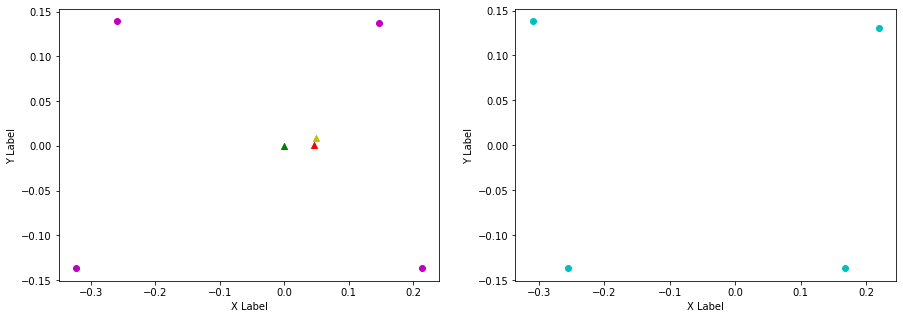

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.219, 0.147, FL (y): 0.131, 0.137.
FL displacement: -0.07200000000000001, 0.006000000000000005.

FR (x): 0.168, 0.214, FR (y): -0.137, -0.136.
FR displacement: 0.045999999999999985, 0.0010000000000000009.

RL (x): -0.309, -0.26, RL (y): 0.138, 0.139.
RL displacement: 0.04899999999999999, 0.0010000000000000009.

RR (x): -0.256, -0.323, RR (y): -0.137, -0.137.
RR displacement: -0.067, 0.0.


Base displacement (Foot): [0.07200000000000001, -0.006000000000000005].

Base displacement (Odom): [[0.024559481704739206], [-0.002356318793323986]]. Rotation displacement: 0.5892070935608714.



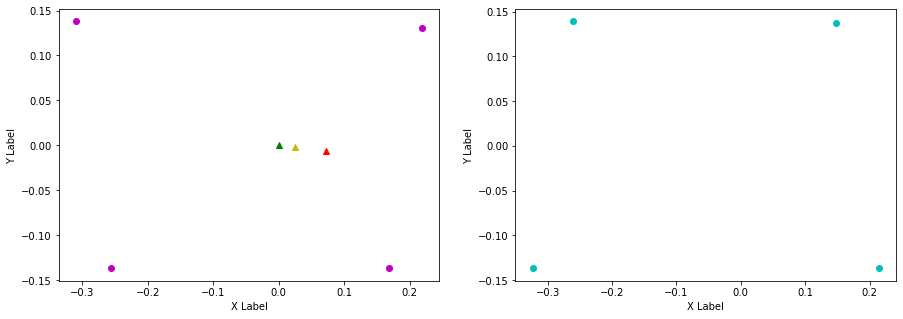

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.147, 0.216, FL (y): 0.137, 0.131.
FL displacement: 0.069, -0.006000000000000005.

FR (x): 0.214, 0.158, FR (y): -0.136, -0.136.
FR displacement: -0.055999999999999994, 0.0.

RL (x): -0.26, -0.319, RL (y): 0.139, 0.138.
RL displacement: -0.059, -0.0010000000000000009.

RR (x): -0.323, -0.259, RR (y): -0.137, -0.138.
RR displacement: 0.064, -0.0010000000000000009.


Base displacement (Foot): [0.055999999999999994, -0.0].

Base displacement (Odom): [[0.06886573411472696], [0.010163397691577813]]. Rotation displacement: -1.1164268555308485.



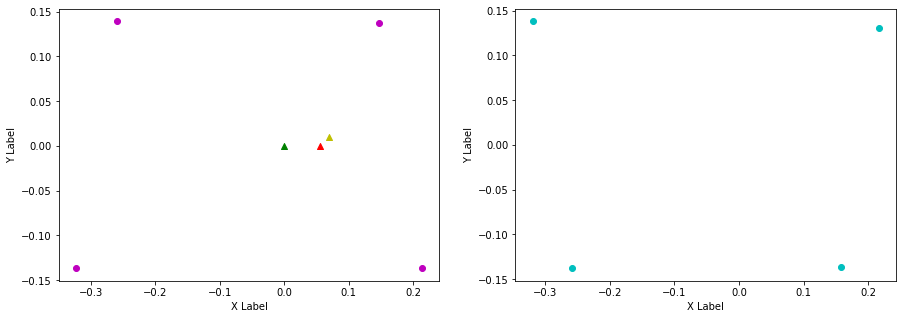

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.216, 0.154, FL (y): 0.131, 0.138.
FL displacement: -0.062, 0.007000000000000006.

FR (x): 0.158, 0.218, FR (y): -0.136, -0.135.
FR displacement: 0.06, 0.0010000000000000009.

RL (x): -0.319, -0.257, RL (y): 0.138, 0.139.
RL displacement: 0.062, 0.0010000000000000009.

RR (x): -0.259, -0.314, RR (y): -0.138, -0.138.
RR displacement: -0.05499999999999999, 0.0.


Base displacement (Foot): [0.062, -0.007000000000000006].

Base displacement (Odom): [[0.032159910267783864], [-0.005109289601683109]]. Rotation displacement: 0.6565426027871459.



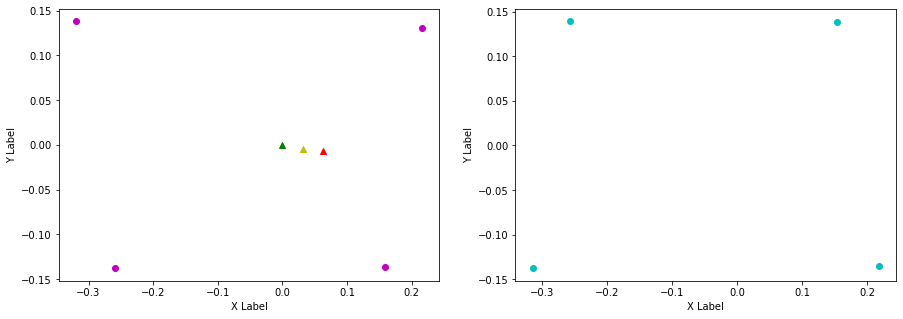

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.154, 0.226, FL (y): 0.138, 0.131.
FL displacement: 0.07200000000000001, -0.007000000000000006.

FR (x): 0.218, 0.169, FR (y): -0.135, -0.141.
FR displacement: -0.04899999999999999, -0.005999999999999978.

RL (x): -0.257, -0.303, RL (y): 0.139, 0.14.
RL displacement: -0.045999999999999985, 0.0010000000000000009.

RR (x): -0.314, -0.248, RR (y): -0.138, -0.135.
RR displacement: 0.066, 0.0030000000000000027.


Base displacement (Foot): [0.04899999999999999, 0.005999999999999978].

Base displacement (Odom): [[0.05746891245366115], [0.008733368555009946]]. Rotation displacement: -1.1513705759114223.



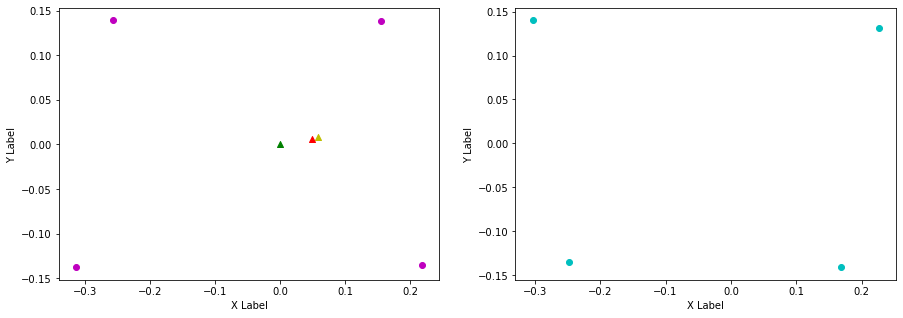

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.226, 0.162, FL (y): 0.131, 0.14.
FL displacement: -0.064, 0.009000000000000008.

FR (x): 0.169, 0.226, FR (y): -0.141, -0.134.
FR displacement: 0.056999999999999995, 0.0069999999999999785.

RL (x): -0.303, -0.249, RL (y): 0.14, 0.137.
RL displacement: 0.05399999999999999, -0.0030000000000000027.

RR (x): -0.248, -0.305, RR (y): -0.135, -0.139.
RR displacement: -0.056999999999999995, -0.0040000000000000036.


Base displacement (Foot): [0.064, -0.009000000000000008].

Base displacement (Odom): [[0.04015258349736861], [-0.0022408607184072338]]. Rotation displacement: 1.0173247135625612.



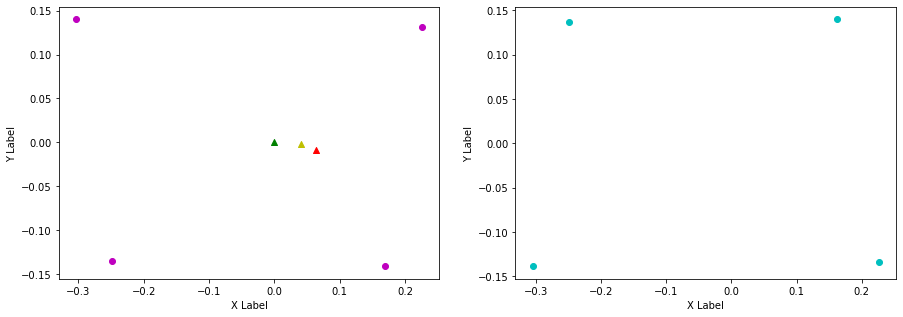

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.215, 0.149, FL (y): 0.131, 0.137.
FL displacement: -0.066, 0.006000000000000005.

FR (x): 0.154, 0.215, FR (y): -0.136, -0.135.
FR displacement: 0.061, 0.0010000000000000009.

RL (x): -0.324, -0.259, RL (y): 0.138, 0.139.
RL displacement: 0.065, 0.0010000000000000009.

RR (x): -0.259, -0.32, RR (y): -0.138, -0.137.
RR displacement: -0.061, 0.0010000000000000009.


Base displacement (Foot): [0.066, -0.006000000000000005].

Base displacement (Odom): [[0.049062311714949125], [-0.005679411667532719]]. Rotation displacement: -0.7471845528520696.



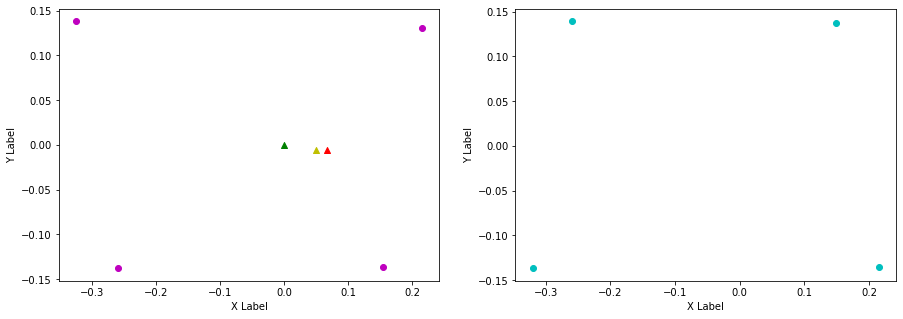

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.149, 0.215, FL (y): 0.137, 0.131.
FL displacement: 0.066, -0.006000000000000005.

FR (x): 0.215, 0.154, FR (y): -0.135, -0.136.
FR displacement: -0.061, -0.0010000000000000009.

RL (x): -0.259, -0.324, RL (y): 0.139, 0.138.
RL displacement: -0.065, -0.0010000000000000009.

RR (x): -0.32, -0.259, RR (y): -0.137, -0.138.
RR displacement: 0.061, -0.0010000000000000009.


Base displacement (Foot): [0.061, 0.0010000000000000009].

Base displacement (Odom): [[0.07390430208756804], [0.009072821012559018]]. Rotation displacement: -0.9437269301553466.



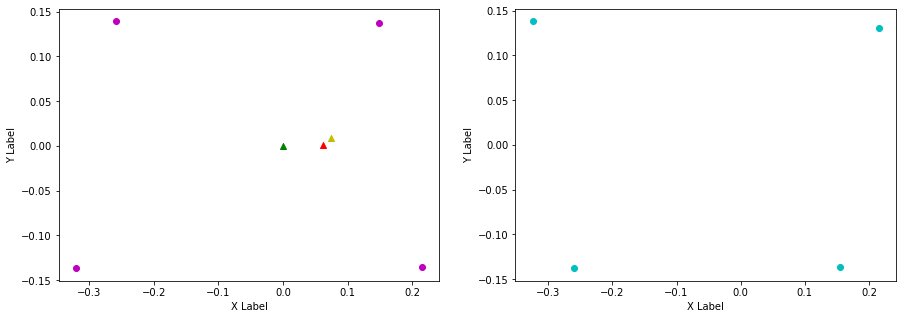

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.215, 0.155, FL (y): 0.131, 0.138.
FL displacement: -0.06, 0.007000000000000006.

FR (x): 0.154, 0.218, FR (y): -0.136, -0.135.
FR displacement: 0.064, 0.0010000000000000009.

RL (x): -0.324, -0.256, RL (y): 0.138, 0.138.
RL displacement: 0.068, 0.0.

RR (x): -0.259, -0.312, RR (y): -0.138, -0.138.
RR displacement: -0.05299999999999999, 0.0.


Base displacement (Foot): [0.06, -0.007000000000000006].

Base displacement (Odom): [[0.026404836665451015], [-0.005144445027223554]]. Rotation displacement: 0.5818527174138877.



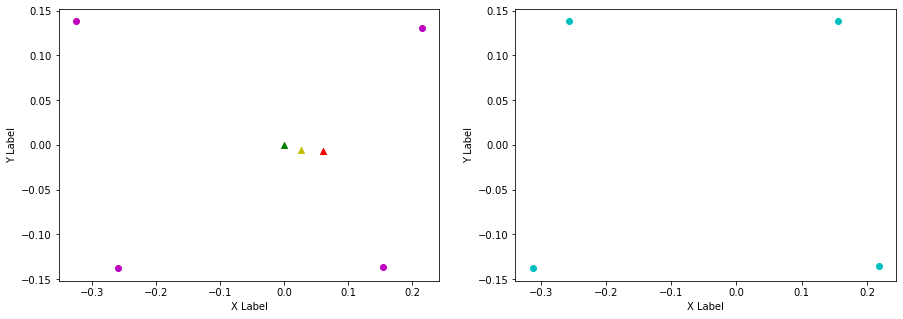

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.155, 0.214, FL (y): 0.138, 0.131.
FL displacement: 0.059, -0.007000000000000006.

FR (x): 0.218, 0.154, FR (y): -0.135, -0.136.
FR displacement: -0.064, -0.0010000000000000009.

RL (x): -0.256, -0.323, RL (y): 0.138, 0.138.
RL displacement: -0.067, 0.0.

RR (x): -0.312, -0.26, RR (y): -0.138, -0.138.
RR displacement: 0.05199999999999999, 0.0.


Base displacement (Foot): [0.064, 0.0010000000000000009].

Base displacement (Odom): [[0.06771308713394131], [0.006337599861712562]]. Rotation displacement: -1.3043316883699902.



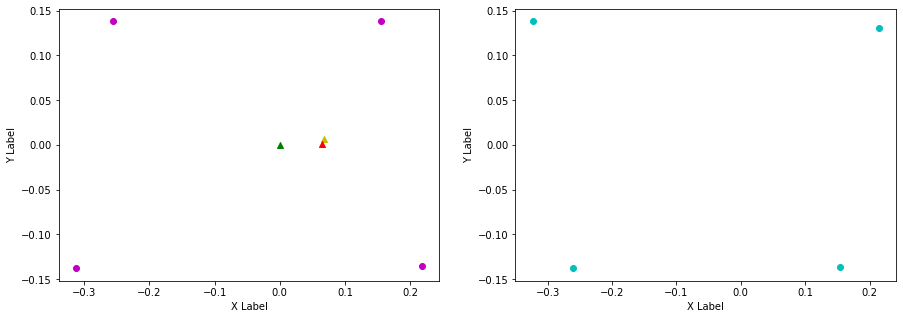

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.214, 0.165, FL (y): 0.131, 0.141.
FL displacement: -0.04899999999999999, 0.009999999999999981.

FR (x): 0.154, 0.229, FR (y): -0.136, -0.133.
FR displacement: 0.07500000000000001, 0.0030000000000000027.

RL (x): -0.323, -0.246, RL (y): 0.138, 0.136.
RL displacement: 0.07700000000000001, -0.0020000000000000018.

RR (x): -0.26, -0.301, RR (y): -0.138, -0.14.
RR displacement: -0.04099999999999998, -0.0020000000000000018.


Base displacement (Foot): [0.04899999999999999, -0.009999999999999981].

Base displacement (Odom): [[0.03653951180867043], [-0.003959888267301537]]. Rotation displacement: 0.5768842402985614.



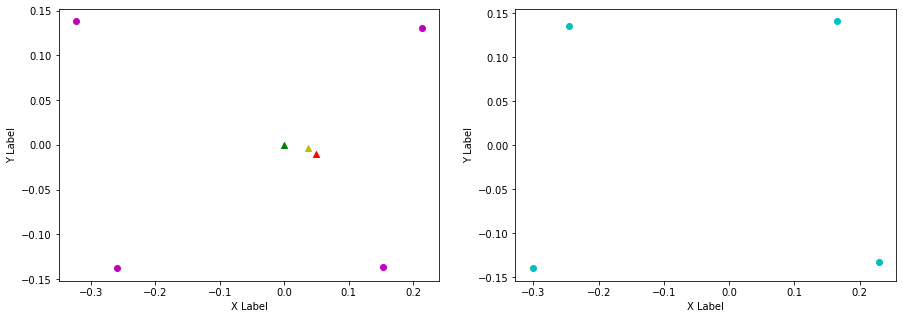

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.165, 0.213, FL (y): 0.141, 0.132.
FL displacement: 0.04799999999999999, -0.00899999999999998.

FR (x): 0.229, 0.146, FR (y): -0.133, -0.135.
FR displacement: -0.08300000000000002, -0.0020000000000000018.

RL (x): -0.246, -0.331, RL (y): 0.136, 0.137.
RL displacement: -0.08500000000000002, 0.0010000000000000009.

RR (x): -0.301, -0.261, RR (y): -0.14, -0.138.
RR displacement: 0.03999999999999998, 0.0020000000000000018.


Base displacement (Foot): [0.08300000000000002, 0.0020000000000000018].

Base displacement (Odom): [[0.0709180768570663], [0.009186910044653551]]. Rotation displacement: -1.0655006647126364.



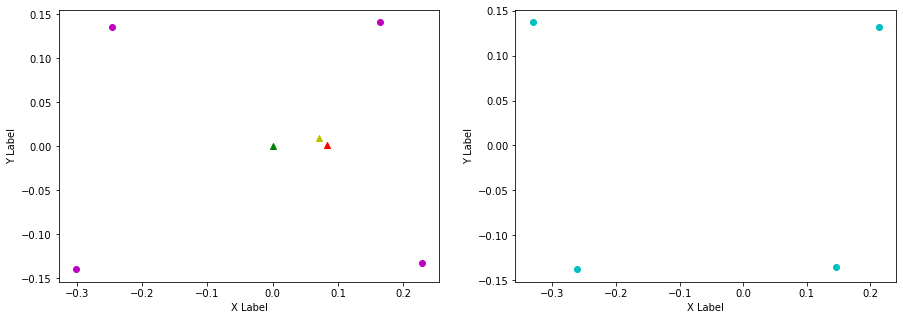

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.213, 0.154, FL (y): 0.132, 0.138.
FL displacement: -0.059, 0.006000000000000005.

FR (x): 0.146, 0.217, FR (y): -0.135, -0.135.
FR displacement: 0.07100000000000001, 0.0.

RL (x): -0.331, -0.257, RL (y): 0.137, 0.139.
RL displacement: 0.07400000000000001, 0.0020000000000000018.

RR (x): -0.261, -0.314, RR (y): -0.138, -0.138.
RR displacement: -0.05299999999999999, 0.0.


Base displacement (Foot): [0.059, -0.006000000000000005].

Base displacement (Odom): [[0.05291576402221487], [-0.006386318005261238]]. Rotation displacement: 0.8255041993295806.



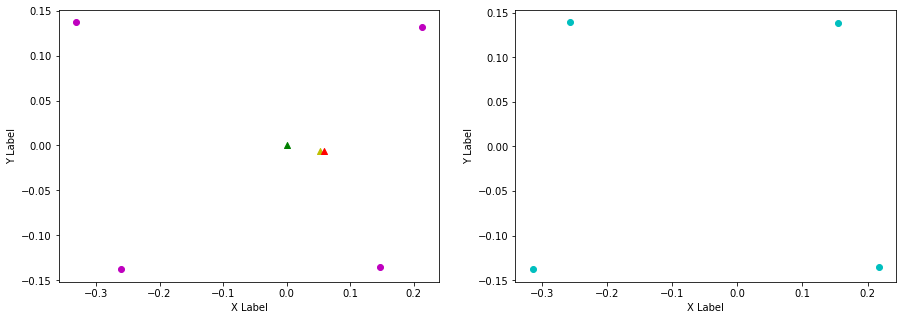

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.154, 0.218, FL (y): 0.138, 0.131.
FL displacement: 0.064, -0.007000000000000006.

FR (x): 0.217, 0.166, FR (y): -0.135, -0.137.
FR displacement: -0.05099999999999999, -0.0020000000000000018.

RL (x): -0.257, -0.311, RL (y): 0.139, 0.138.
RL displacement: -0.05399999999999999, -0.0010000000000000009.

RR (x): -0.314, -0.256, RR (y): -0.138, -0.137.
RR displacement: 0.057999999999999996, 0.0010000000000000009.


Base displacement (Foot): [0.05099999999999999, 0.0020000000000000018].

Base displacement (Odom): [[0.05245877235506935], [0.009045366191676507]]. Rotation displacement: -0.6675071924709474.



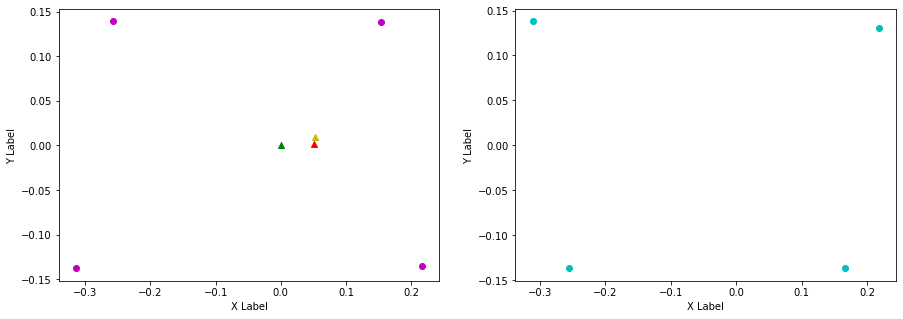

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.218, 0.155, FL (y): 0.131, 0.138.
FL displacement: -0.063, 0.007000000000000006.

FR (x): 0.166, 0.218, FR (y): -0.137, -0.135.
FR displacement: 0.05199999999999999, 0.0020000000000000018.

RL (x): -0.311, -0.256, RL (y): 0.138, 0.139.
RL displacement: 0.05499999999999999, 0.0010000000000000009.

RR (x): -0.256, -0.312, RR (y): -0.137, -0.138.
RR displacement: -0.055999999999999994, -0.0010000000000000009.


Base displacement (Foot): [0.063, -0.007000000000000006].

Base displacement (Odom): [[0.05125312764612566], [-0.007546260849350617]]. Rotation displacement: -0.0020014390367061384.



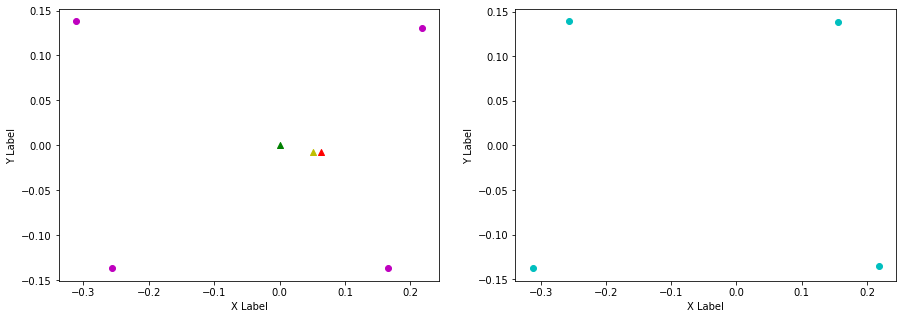

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.155, 0.219, FL (y): 0.138, 0.131.
FL displacement: 0.064, -0.007000000000000006.

FR (x): 0.218, 0.168, FR (y): -0.135, -0.137.
FR displacement: -0.04999999999999999, -0.0020000000000000018.

RL (x): -0.256, -0.309, RL (y): 0.139, 0.138.
RL displacement: -0.05299999999999999, -0.0010000000000000009.

RR (x): -0.312, -0.255, RR (y): -0.138, -0.137.
RR displacement: 0.056999999999999995, 0.0010000000000000009.


Base displacement (Foot): [0.04999999999999999, 0.0020000000000000018].

Base displacement (Odom): [[0.03166668347309454], [0.005254847462413892]]. Rotation displacement: -0.54900165231871.



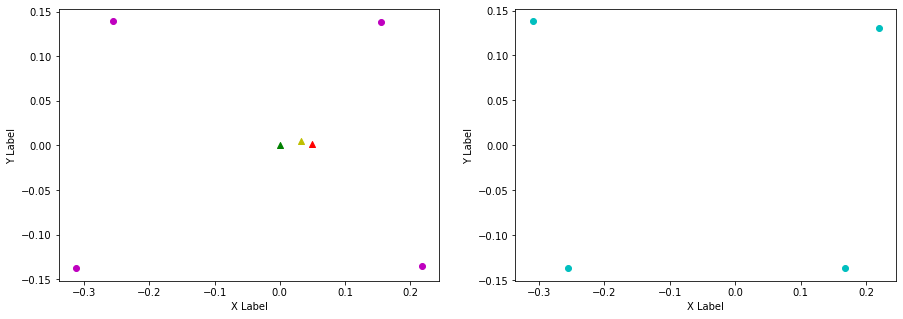

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.219, 0.158, FL (y): 0.131, 0.139.
FL displacement: -0.061, 0.008000000000000007.

FR (x): 0.168, 0.221, FR (y): -0.137, -0.134.
FR displacement: 0.05299999999999999, 0.0030000000000000027.

RL (x): -0.309, -0.253, RL (y): 0.138, 0.138.
RL displacement: 0.055999999999999994, 0.0.

RR (x): -0.255, -0.309, RR (y): -0.137, -0.138.
RR displacement: -0.05399999999999999, -0.0010000000000000009.


Base displacement (Foot): [0.061, -0.008000000000000007].

Base displacement (Odom): [[0.03307293569810277], [-0.004015185806037991]]. Rotation displacement: 0.5783837542202823.



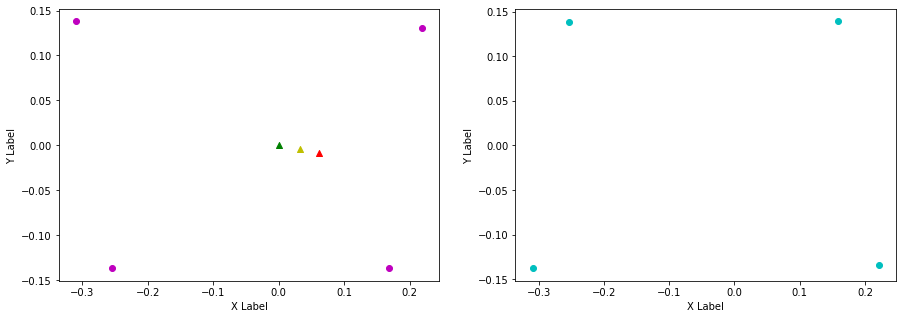

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.158, 0.219, FL (y): 0.139, 0.131.
FL displacement: 0.061, -0.008000000000000007.

FR (x): 0.221, 0.168, FR (y): -0.134, -0.138.
FR displacement: -0.05299999999999999, -0.0040000000000000036.

RL (x): -0.253, -0.309, RL (y): 0.138, 0.138.
RL displacement: -0.055999999999999994, 0.0.

RR (x): -0.309, -0.255, RR (y): -0.138, -0.137.
RR displacement: 0.05399999999999999, 0.0010000000000000009.


Base displacement (Foot): [0.05299999999999999, 0.0040000000000000036].

Base displacement (Odom): [[0.05723768545222985], [0.007911446296868796]]. Rotation displacement: -1.083765543658253.



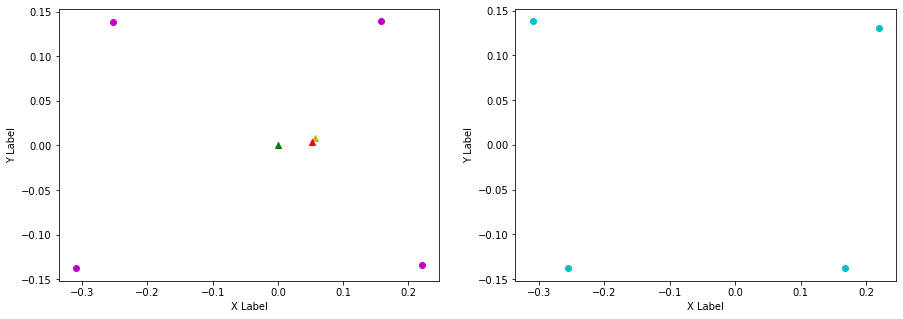

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.219, 0.154, FL (y): 0.131, 0.138.
FL displacement: -0.065, 0.007000000000000006.

FR (x): 0.168, 0.217, FR (y): -0.138, -0.135.
FR displacement: 0.04899999999999999, 0.0030000000000000027.

RL (x): -0.309, -0.257, RL (y): 0.138, 0.138.
RL displacement: 0.05199999999999999, 0.0.

RR (x): -0.255, -0.314, RR (y): -0.137, -0.138.
RR displacement: -0.059, -0.0010000000000000009.


Base displacement (Foot): [0.065, -0.007000000000000006].

Base displacement (Odom): [[0.03626220247256828], [-0.005016728508310919]]. Rotation displacement: 0.8566162690356025.



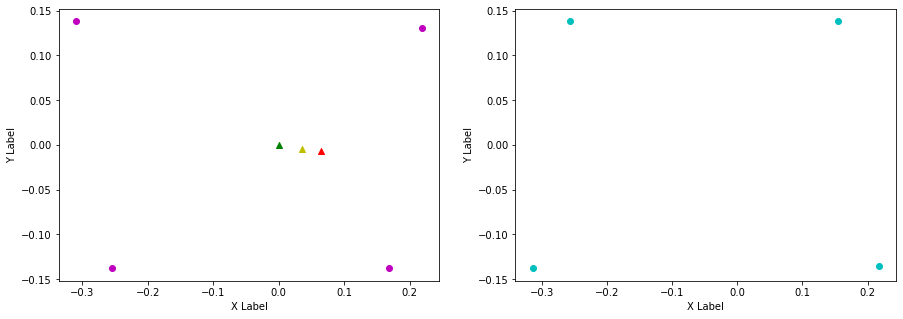

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.154, 0.217, FL (y): 0.138, 0.131.
FL displacement: 0.063, -0.007000000000000006.

FR (x): 0.217, 0.164, FR (y): -0.135, -0.137.
FR displacement: -0.05299999999999999, -0.0020000000000000018.

RL (x): -0.257, -0.314, RL (y): 0.138, 0.138.
RL displacement: -0.056999999999999995, 0.0.

RR (x): -0.314, -0.257, RR (y): -0.138, -0.137.
RR displacement: 0.056999999999999995, 0.0010000000000000009.


Base displacement (Foot): [0.05299999999999999, 0.0020000000000000018].

Base displacement (Odom): [[0.06345281338917008], [0.009694057088218244]]. Rotation displacement: -1.3965658517491797.



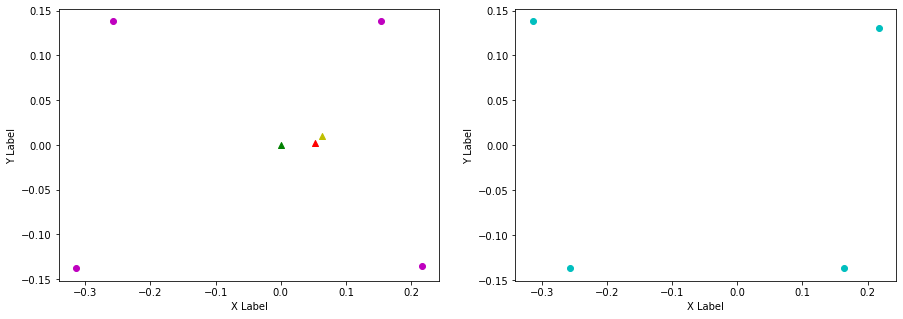

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.217, 0.165, FL (y): 0.131, 0.141.
FL displacement: -0.05199999999999999, 0.009999999999999981.

FR (x): 0.164, 0.228, FR (y): -0.137, -0.134.
FR displacement: 0.064, 0.0030000000000000027.

RL (x): -0.314, -0.248, RL (y): 0.138, 0.137.
RL displacement: 0.066, -0.0010000000000000009.

RR (x): -0.257, -0.303, RR (y): -0.137, -0.14.
RR displacement: -0.045999999999999985, -0.0030000000000000027.


Base displacement (Foot): [0.05199999999999999, -0.009999999999999981].

Base displacement (Odom): [[0.04817450028836223], [-0.007104425527314717]]. Rotation displacement: 0.5387536023385192.



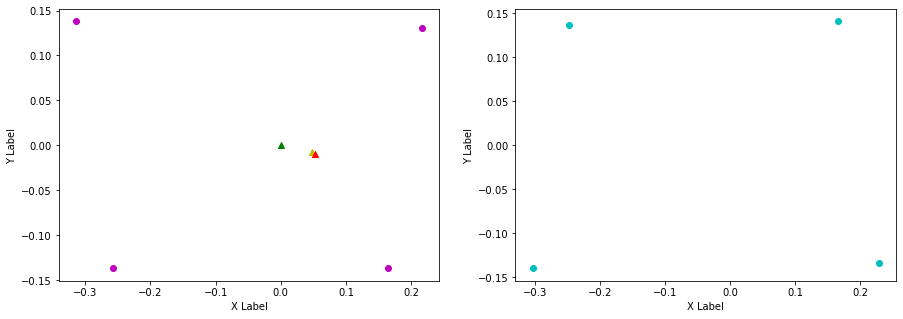

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.165, 0.22, FL (y): 0.141, 0.131.
FL displacement: 0.05499999999999999, -0.009999999999999981.

FR (x): 0.228, 0.168, FR (y): -0.134, -0.138.
FR displacement: -0.06, -0.0040000000000000036.

RL (x): -0.248, -0.308, RL (y): 0.137, 0.138.
RL displacement: -0.06, 0.0010000000000000009.

RR (x): -0.303, -0.255, RR (y): -0.14, -0.137.
RR displacement: 0.04799999999999999, 0.0030000000000000027.


Base displacement (Foot): [0.06, 0.0040000000000000036].

Base displacement (Odom): [[0.03250408352992551], [0.0018280392184886196]]. Rotation displacement: -1.2771827614524986.



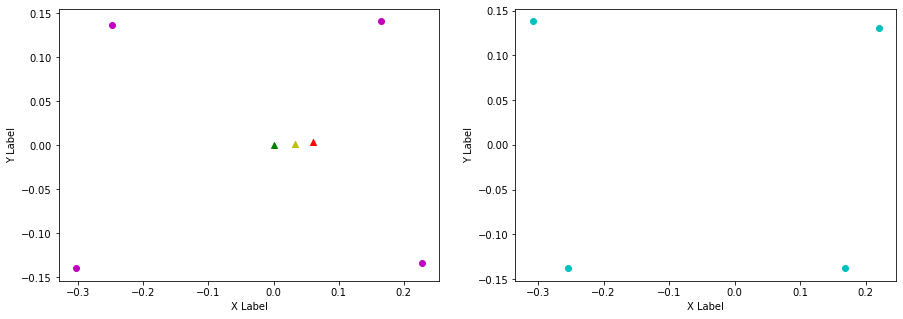

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.22, 0.145, FL (y): 0.131, 0.136.
FL displacement: -0.07500000000000001, 0.0050000000000000044.

FR (x): 0.168, 0.213, FR (y): -0.138, -0.136.
FR displacement: 0.044999999999999984, 0.0020000000000000018.

RL (x): -0.308, -0.261, RL (y): 0.138, 0.139.
RL displacement: 0.046999999999999986, 0.0010000000000000009.

RR (x): -0.255, -0.326, RR (y): -0.137, -0.136.
RR displacement: -0.07100000000000001, 0.0010000000000000009.


Base displacement (Foot): [0.07500000000000001, -0.0050000000000000044].

Base displacement (Odom): [[0.047326189859816736], [-0.007917570543954255]]. Rotation displacement: 1.4250894814610793.



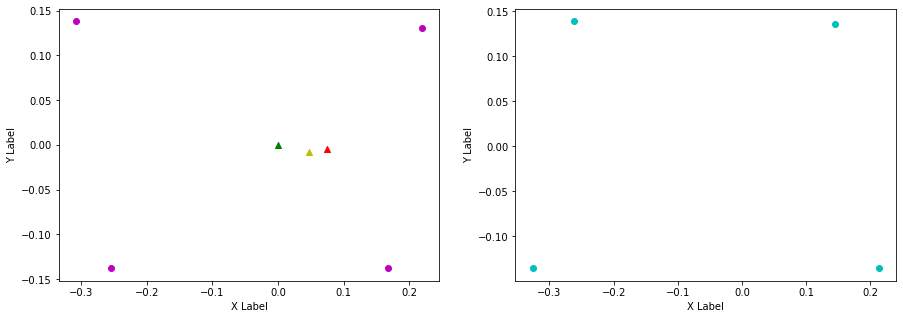

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.145, 0.22, FL (y): 0.136, 0.131.
FL displacement: 0.07500000000000001, -0.0050000000000000044.

FR (x): 0.213, 0.168, FR (y): -0.136, -0.138.
FR displacement: -0.044999999999999984, -0.0020000000000000018.

RL (x): -0.261, -0.308, RL (y): 0.139, 0.138.
RL displacement: -0.046999999999999986, -0.0010000000000000009.

RR (x): -0.326, -0.254, RR (y): -0.136, -0.137.
RR displacement: 0.07200000000000001, -0.0010000000000000009.


Base displacement (Foot): [0.044999999999999984, 0.0020000000000000018].

Base displacement (Odom): [[0.05668032901769404], [0.006925083427792522]]. Rotation displacement: -1.4091439180890897.



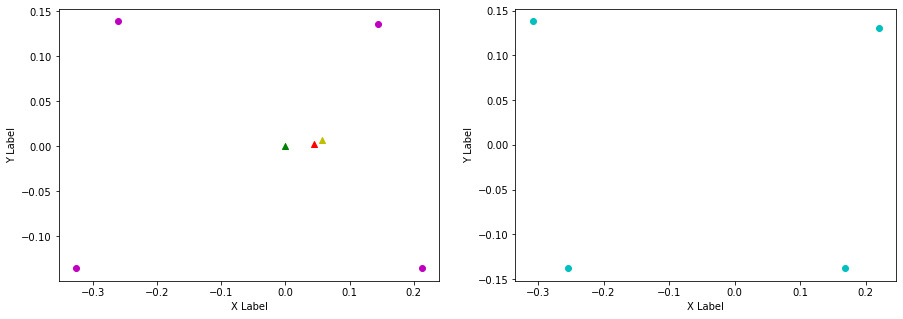

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.22, 0.155, FL (y): 0.131, 0.138.
FL displacement: -0.065, 0.007000000000000006.

FR (x): 0.168, 0.219, FR (y): -0.138, -0.135.
FR displacement: 0.05099999999999999, 0.0030000000000000027.

RL (x): -0.308, -0.256, RL (y): 0.138, 0.138.
RL displacement: 0.05199999999999999, 0.0.

RR (x): -0.254, -0.313, RR (y): -0.137, -0.138.
RR displacement: -0.059, -0.0010000000000000009.


Base displacement (Foot): [0.065, -0.007000000000000006].

Base displacement (Odom): [[0.048117252517065445], [-0.006415272720851739]]. Rotation displacement: 1.0935752809675767.



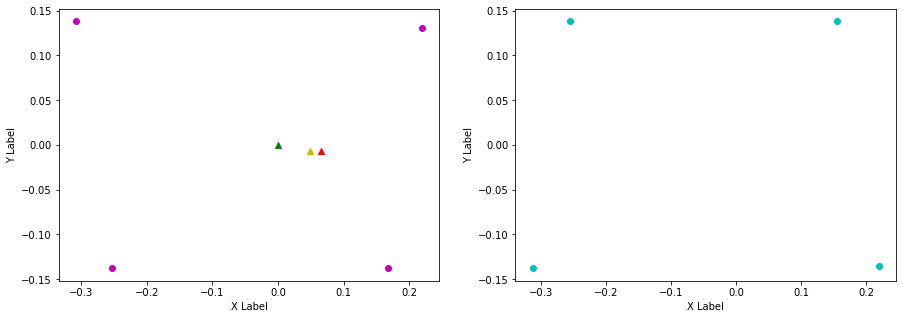

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.155, 0.217, FL (y): 0.138, 0.131.
FL displacement: 0.062, -0.007000000000000006.

FR (x): 0.219, 0.164, FR (y): -0.135, -0.137.
FR displacement: -0.05499999999999999, -0.0020000000000000018.

RL (x): -0.256, -0.315, RL (y): 0.138, 0.138.
RL displacement: -0.059, 0.0.

RR (x): -0.313, -0.257, RR (y): -0.138, -0.137.
RR displacement: 0.055999999999999994, 0.0010000000000000009.


Base displacement (Foot): [0.05499999999999999, 0.0020000000000000018].

Base displacement (Odom): [[0.03773827438934507], [0.0031360367132862166]]. Rotation displacement: -1.5047407003755555.



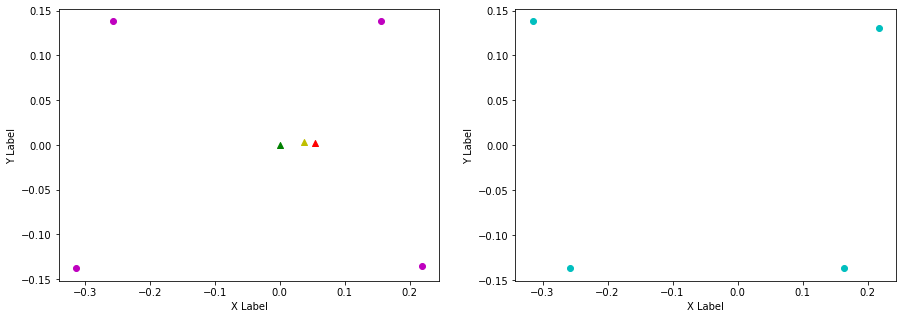

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.217, 0.157, FL (y): 0.131, 0.138.
FL displacement: -0.06, 0.007000000000000006.

FR (x): 0.164, 0.222, FR (y): -0.137, -0.134.
FR displacement: 0.057999999999999996, 0.0030000000000000027.

RL (x): -0.315, -0.253, RL (y): 0.138, 0.138.
RL displacement: 0.062, 0.0.

RR (x): -0.257, -0.31, RR (y): -0.137, -0.138.
RR displacement: -0.05299999999999999, -0.0010000000000000009.


Base displacement (Foot): [0.06, -0.007000000000000006].

Base displacement (Odom): [[0.045435318695565385], [-0.008166631743599773]]. Rotation displacement: 1.044736166056618.



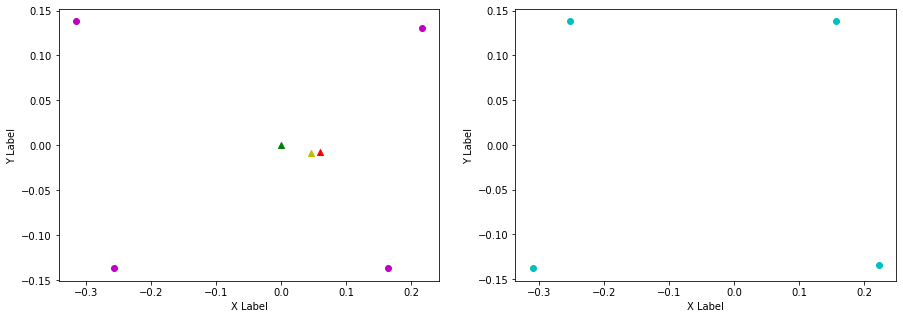

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.157, 0.224, FL (y): 0.138, 0.131.
FL displacement: 0.067, -0.007000000000000006.

FR (x): 0.222, 0.168, FR (y): -0.134, -0.14.
FR displacement: -0.05399999999999999, -0.006000000000000005.

RL (x): -0.253, -0.304, RL (y): 0.138, 0.14.
RL displacement: -0.05099999999999999, 0.0020000000000000018.

RR (x): -0.31, -0.251, RR (y): -0.138, -0.136.
RR displacement: 0.059, 0.0020000000000000018.


Base displacement (Foot): [0.05399999999999999, 0.006000000000000005].

Base displacement (Odom): [[0.06210890140130321], [0.009135213834356115]]. Rotation displacement: -1.5905173964124264.



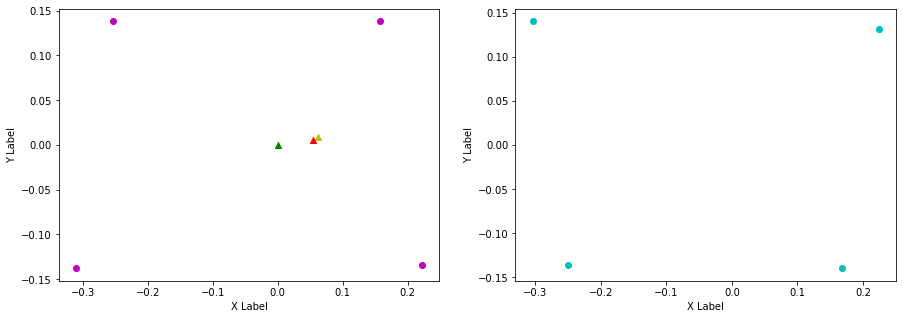

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.224, 0.157, FL (y): 0.131, 0.138.
FL displacement: -0.067, 0.007000000000000006.

FR (x): 0.168, 0.221, FR (y): -0.14, -0.134.
FR displacement: 0.05299999999999999, 0.006000000000000005.

RL (x): -0.304, -0.253, RL (y): 0.14, 0.138.
RL displacement: 0.05099999999999999, -0.0020000000000000018.

RR (x): -0.251, -0.309, RR (y): -0.136, -0.138.
RR displacement: -0.057999999999999996, -0.0020000000000000018.


Base displacement (Foot): [0.067, -0.007000000000000006].

Base displacement (Odom): [[0.024496741101533104], [-0.0018850807043104822]]. Rotation displacement: 1.3967491599725848.



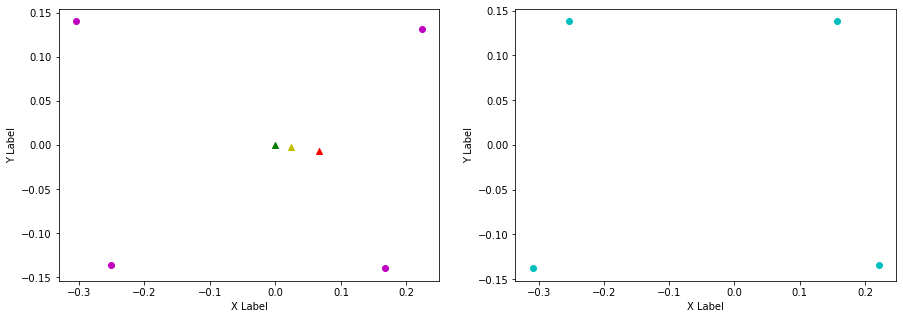

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.157, 0.22, FL (y): 0.138, 0.131.
FL displacement: 0.063, -0.007000000000000006.

FR (x): 0.221, 0.168, FR (y): -0.134, -0.138.
FR displacement: -0.05299999999999999, -0.0040000000000000036.

RL (x): -0.253, -0.308, RL (y): 0.138, 0.138.
RL displacement: -0.05499999999999999, 0.0.

RR (x): -0.309, -0.255, RR (y): -0.138, -0.136.
RR displacement: 0.05399999999999999, 0.0020000000000000018.


Base displacement (Foot): [0.05299999999999999, 0.0040000000000000036].

Base displacement (Odom): [[0.0706019745466886], [0.011767379352201068]]. Rotation displacement: -1.7064144488076785.



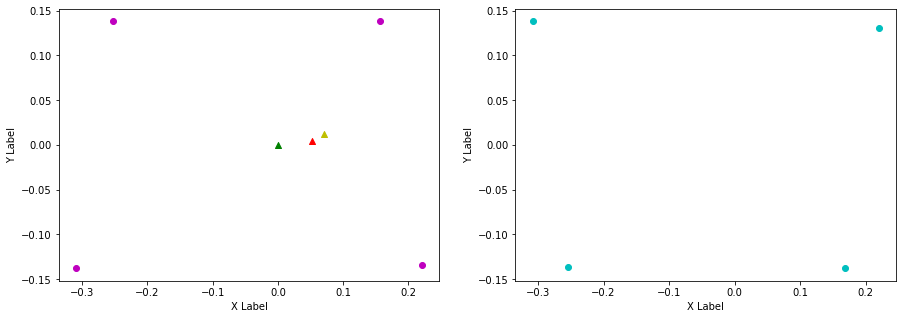

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.22, 0.147, FL (y): 0.131, 0.137.
FL displacement: -0.07300000000000001, 0.006000000000000005.

FR (x): 0.168, 0.214, FR (y): -0.138, -0.136.
FR displacement: 0.045999999999999985, 0.0020000000000000018.

RL (x): -0.308, -0.26, RL (y): 0.138, 0.139.
RL displacement: 0.04799999999999999, 0.0010000000000000009.

RR (x): -0.255, -0.323, RR (y): -0.136, -0.137.
RR displacement: -0.068, -0.0010000000000000009.


Base displacement (Foot): [0.07300000000000001, -0.006000000000000005].

Base displacement (Odom): [[0.035283726523092085], [-0.005087661132373356]]. Rotation displacement: 1.1263535104718256.



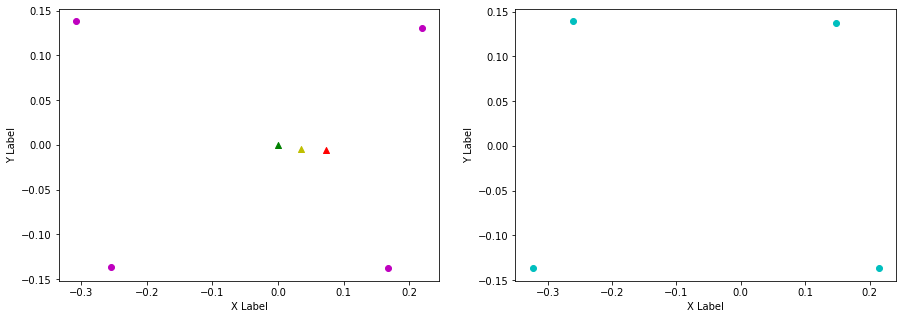

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.147, 0.22, FL (y): 0.137, 0.131.
FL displacement: 0.07300000000000001, -0.006000000000000005.

FR (x): 0.214, 0.168, FR (y): -0.136, -0.138.
FR displacement: -0.045999999999999985, -0.0020000000000000018.

RL (x): -0.26, -0.309, RL (y): 0.139, 0.138.
RL displacement: -0.04899999999999999, -0.0010000000000000009.

RR (x): -0.323, -0.255, RR (y): -0.137, -0.137.
RR displacement: 0.068, 0.0.


Base displacement (Foot): [0.045999999999999985, 0.0020000000000000018].

Base displacement (Odom): [[0.05637757668740395], [0.008851179103882778]]. Rotation displacement: -1.3758984644227292.



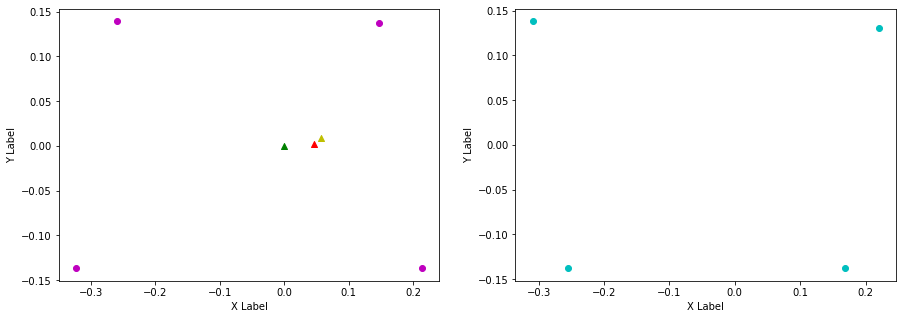

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.22, 0.157, FL (y): 0.131, 0.139.
FL displacement: -0.063, 0.008000000000000007.

FR (x): 0.168, 0.221, FR (y): -0.138, -0.134.
FR displacement: 0.05299999999999999, 0.0040000000000000036.

RL (x): -0.309, -0.253, RL (y): 0.138, 0.138.
RL displacement: 0.055999999999999994, 0.0.

RR (x): -0.255, -0.31, RR (y): -0.137, -0.138.
RR displacement: -0.05499999999999999, -0.0010000000000000009.


Base displacement (Foot): [0.063, -0.008000000000000007].

Base displacement (Odom): [[0.029576827265891836], [-0.0046630854332194716]]. Rotation displacement: 1.0036597029497116.



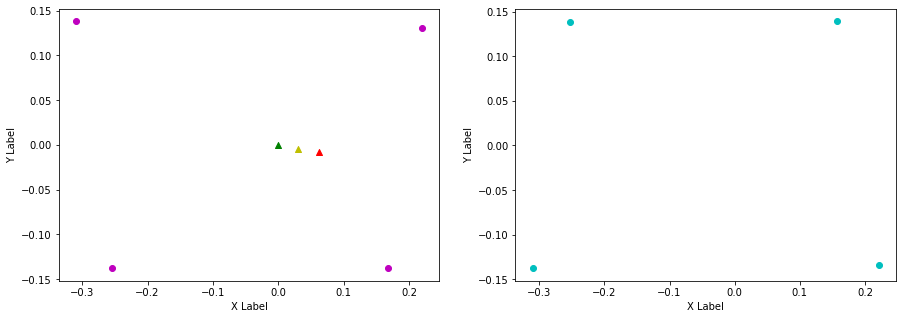

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.157, 0.214, FL (y): 0.139, 0.132.
FL displacement: 0.056999999999999995, -0.007000000000000006.

FR (x): 0.221, 0.149, FR (y): -0.134, -0.136.
FR displacement: -0.07200000000000001, -0.0020000000000000018.

RL (x): -0.253, -0.328, RL (y): 0.138, 0.137.
RL displacement: -0.07500000000000001, -0.0010000000000000009.

RR (x): -0.31, -0.26, RR (y): -0.138, -0.137.
RR displacement: 0.04999999999999999, 0.0010000000000000009.


Base displacement (Foot): [0.07200000000000001, 0.0020000000000000018].

Base displacement (Odom): [[0.051949168237972465], [0.005025475107087729]]. Rotation displacement: -1.5645402199749907.



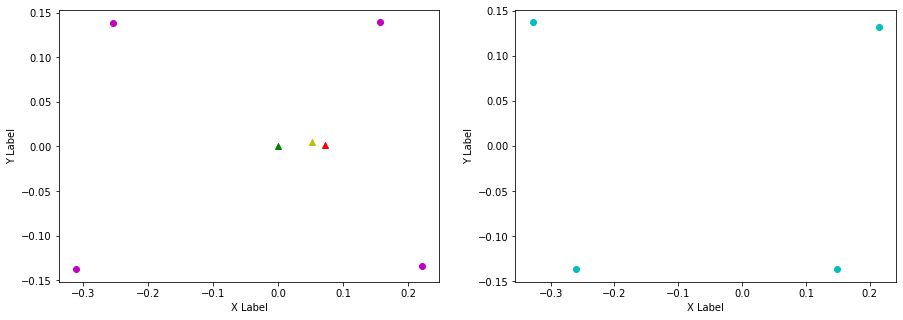

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.214, 0.158, FL (y): 0.132, 0.138.
FL displacement: -0.055999999999999994, 0.006000000000000005.

FR (x): 0.149, 0.222, FR (y): -0.136, -0.134.
FR displacement: 0.07300000000000001, 0.0020000000000000018.

RL (x): -0.328, -0.253, RL (y): 0.137, 0.138.
RL displacement: 0.07500000000000001, 0.0010000000000000009.

RR (x): -0.26, -0.309, RR (y): -0.137, -0.138.
RR displacement: -0.04899999999999999, -0.0010000000000000009.


Base displacement (Foot): [0.055999999999999994, -0.006000000000000005].

Base displacement (Odom): [[0.040198628682417414], [-0.006283717377802311]]. Rotation displacement: 0.4886785165054362.



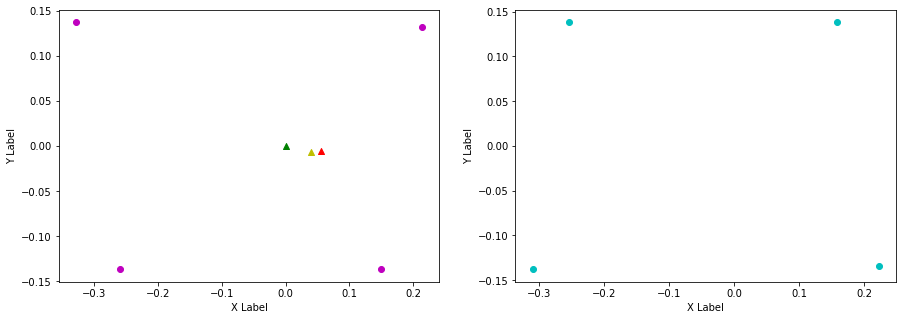

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.158, 0.22, FL (y): 0.138, 0.131.
FL displacement: 0.062, -0.007000000000000006.

FR (x): 0.222, 0.168, FR (y): -0.134, -0.138.
FR displacement: -0.05399999999999999, -0.0040000000000000036.

RL (x): -0.253, -0.309, RL (y): 0.138, 0.138.
RL displacement: -0.055999999999999994, 0.0.

RR (x): -0.309, -0.255, RR (y): -0.138, -0.137.
RR displacement: 0.05399999999999999, 0.0010000000000000009.


Base displacement (Foot): [0.05399999999999999, 0.0040000000000000036].

Base displacement (Odom): [[0.036803054335050156], [0.0020440479584342697]]. Rotation displacement: -0.9439280365650078.



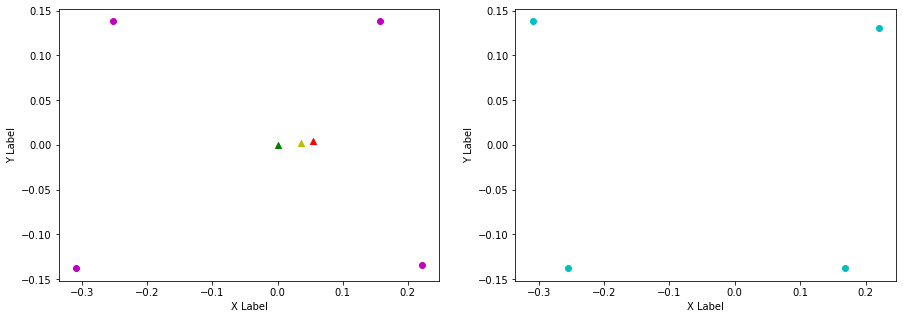

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.22, 0.151, FL (y): 0.131, 0.138.
FL displacement: -0.069, 0.007000000000000006.

FR (x): 0.168, 0.216, FR (y): -0.138, -0.135.
FR displacement: 0.04799999999999999, 0.0030000000000000027.

RL (x): -0.309, -0.258, RL (y): 0.138, 0.139.
RL displacement: 0.05099999999999999, 0.0010000000000000009.

RR (x): -0.255, -0.317, RR (y): -0.137, -0.137.
RR displacement: -0.062, 0.0.


Base displacement (Foot): [0.069, -0.007000000000000006].

Base displacement (Odom): [[0.0472600301675552], [-0.005517028906278476]]. Rotation displacement: 1.2404720756377712.



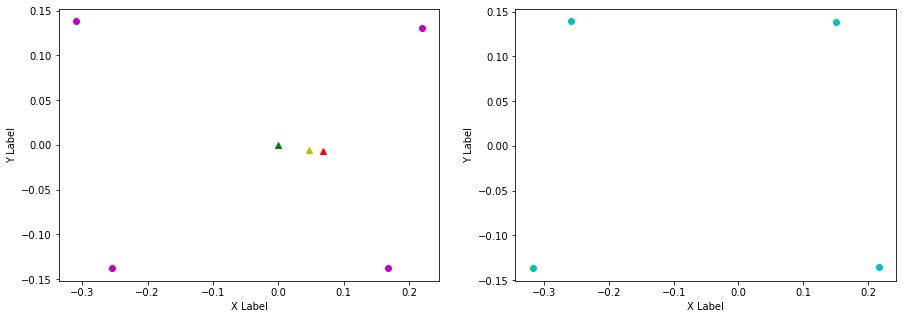

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.151, 0.212, FL (y): 0.138, 0.132.
FL displacement: 0.061, -0.006000000000000005.

FR (x): 0.216, 0.145, FR (y): -0.135, -0.135.
FR displacement: -0.07100000000000001, 0.0.

RL (x): -0.258, -0.334, RL (y): 0.139, 0.136.
RL displacement: -0.07600000000000001, -0.0030000000000000027.

RR (x): -0.317, -0.262, RR (y): -0.137, -0.137.
RR displacement: 0.05499999999999999, 0.0.


Base displacement (Foot): [0.07100000000000001, -0.0].

Base displacement (Odom): [[0.061039329962426336], [0.00949559827308466]]. Rotation displacement: -1.5519841040343285.



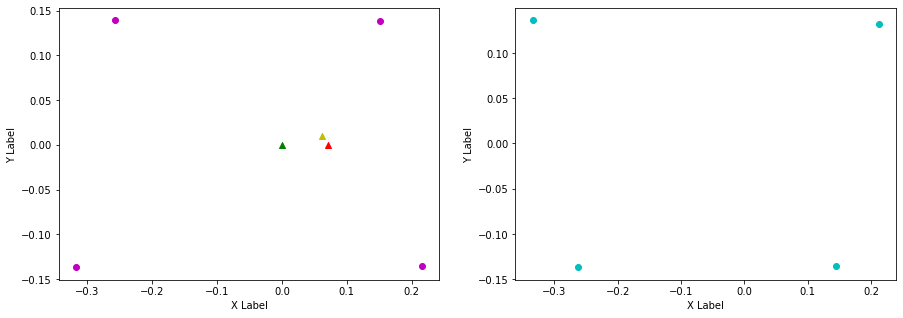

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.212, 0.145, FL (y): 0.132, 0.136.
FL displacement: -0.067, 0.0040000000000000036.

FR (x): 0.145, 0.212, FR (y): -0.135, -0.135.
FR displacement: 0.067, 0.0.

RL (x): -0.334, -0.262, RL (y): 0.136, 0.139.
RL displacement: 0.07200000000000001, 0.0030000000000000027.

RR (x): -0.262, -0.324, RR (y): -0.137, -0.136.
RR displacement: -0.062, 0.0010000000000000009.


Base displacement (Foot): [0.067, -0.0040000000000000036].

Base displacement (Odom): [[0.031381313249963405], [-0.005906413574133573]]. Rotation displacement: 0.7356697342729849.



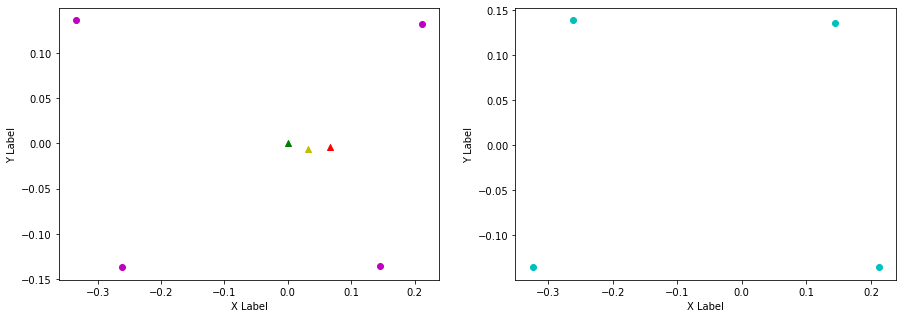

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.145, 0.22, FL (y): 0.136, 0.131.
FL displacement: 0.07500000000000001, -0.0050000000000000044.

FR (x): 0.212, 0.168, FR (y): -0.135, -0.138.
FR displacement: -0.043999999999999984, -0.0030000000000000027.

RL (x): -0.262, -0.308, RL (y): 0.139, 0.138.
RL displacement: -0.045999999999999985, -0.0010000000000000009.

RR (x): -0.324, -0.255, RR (y): -0.136, -0.136.
RR displacement: 0.069, 0.0.


Base displacement (Foot): [0.043999999999999984, 0.0030000000000000027].

Base displacement (Odom): [[0.05308021980281552], [0.00753039226625507]]. Rotation displacement: -0.8995316511313327.



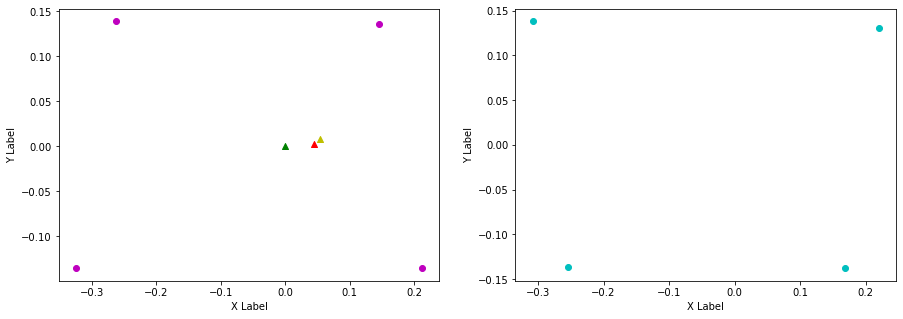

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.22, 0.154, FL (y): 0.131, 0.138.
FL displacement: -0.066, 0.007000000000000006.

FR (x): 0.168, 0.217, FR (y): -0.138, -0.135.
FR displacement: 0.04899999999999999, 0.0030000000000000027.

RL (x): -0.308, -0.257, RL (y): 0.138, 0.139.
RL displacement: 0.05099999999999999, 0.0010000000000000009.

RR (x): -0.255, -0.313, RR (y): -0.136, -0.137.
RR displacement: -0.057999999999999996, -0.0010000000000000009.


Base displacement (Foot): [0.066, -0.007000000000000006].

Base displacement (Odom): [[0.040616022595857615], [-0.0052989127002218694]]. Rotation displacement: 0.6890371762536225.



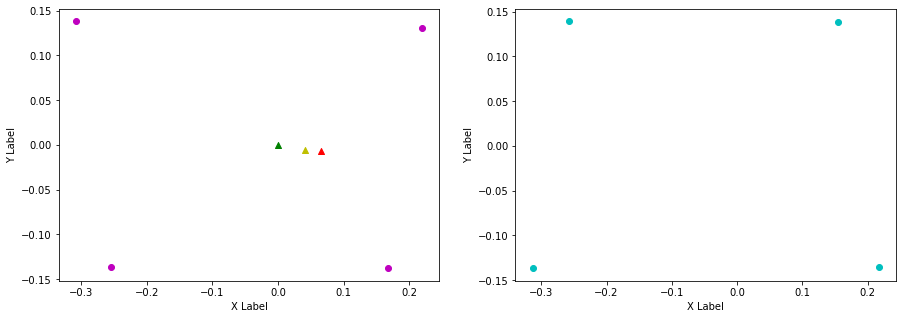

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.154, 0.216, FL (y): 0.138, 0.131.
FL displacement: 0.062, -0.007000000000000006.

FR (x): 0.217, 0.157, FR (y): -0.135, -0.136.
FR displacement: -0.06, -0.0010000000000000009.

RL (x): -0.257, -0.319, RL (y): 0.139, 0.138.
RL displacement: -0.062, -0.0010000000000000009.

RR (x): -0.313, -0.259, RR (y): -0.137, -0.137.
RR displacement: 0.05399999999999999, 0.0.


Base displacement (Foot): [0.06, 0.0010000000000000009].

Base displacement (Odom): [[0.04900842073898559], [0.0030858497334449453]]. Rotation displacement: -1.1993280727344802.



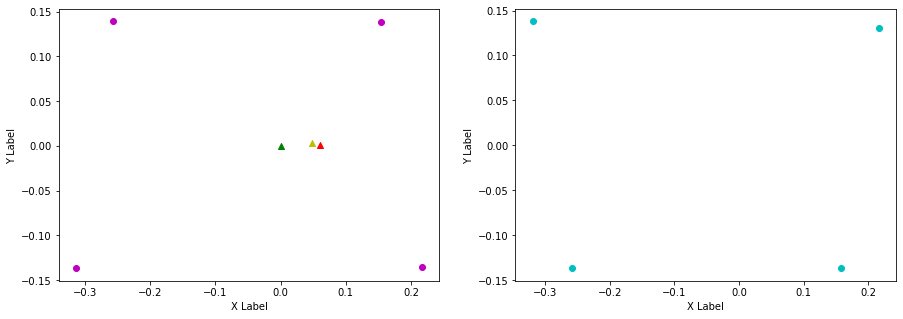

Command:  [0.2 0. ] 0.0
Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.216, 0.155, FL (y): 0.131, 0.138.
FL displacement: -0.061, 0.007000000000000006.

FR (x): 0.157, 0.219, FR (y): -0.136, -0.135.
FR displacement: 0.062, 0.0010000000000000009.

RL (x): -0.319, -0.256, RL (y): 0.138, 0.139.
RL displacement: 0.063, 0.0010000000000000009.

RR (x): -0.259, -0.313, RR (y): -0.137, -0.138.
RR displacement: -0.05399999999999999, -0.0010000000000000009.


Base displacement (Foot): [0.061, -0.007000000000000006].

Base displacement (Odom): [[0.061776557837791124], [-0.01107134729255943]]. Rotation displacement: 0.583293489320356.



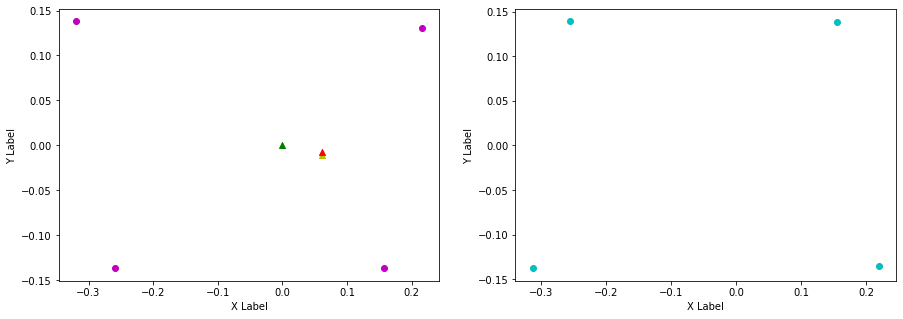

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.155, 0.217, FL (y): 0.138, 0.131.
FL displacement: 0.062, -0.007000000000000006.

FR (x): 0.219, 0.163, FR (y): -0.135, -0.137.
FR displacement: -0.055999999999999994, -0.0020000000000000018.

RL (x): -0.256, -0.314, RL (y): 0.139, 0.138.
RL displacement: -0.057999999999999996, -0.0010000000000000009.

RR (x): -0.313, -0.257, RR (y): -0.138, -0.137.
RR displacement: 0.055999999999999994, 0.0010000000000000009.


Base displacement (Foot): [0.055999999999999994, 0.0020000000000000018].

Base displacement (Odom): [[0.027697671728357243], [0.002448626205195481]]. Rotation displacement: -1.3156445069756038.



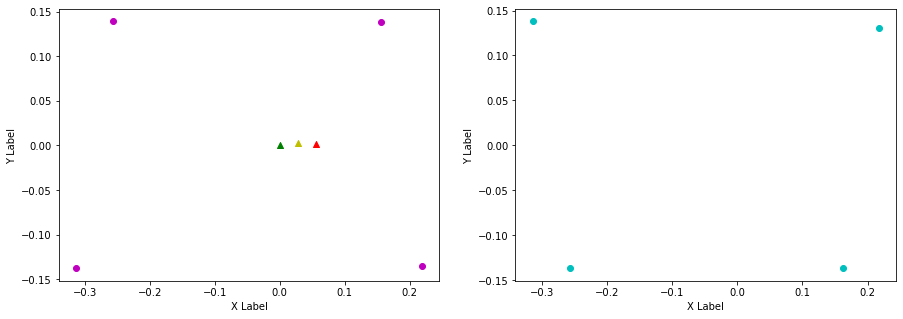

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.217, 0.156, FL (y): 0.131, 0.138.
FL displacement: -0.061, 0.007000000000000006.

FR (x): 0.163, 0.219, FR (y): -0.137, -0.135.
FR displacement: 0.055999999999999994, 0.0020000000000000018.

RL (x): -0.314, -0.255, RL (y): 0.138, 0.138.
RL displacement: 0.059, 0.0.

RR (x): -0.257, -0.312, RR (y): -0.137, -0.138.
RR displacement: -0.05499999999999999, -0.0010000000000000009.


Base displacement (Foot): [0.061, -0.007000000000000006].

Base displacement (Odom): [[0.028790147703155355], [-0.0025664744803615136]]. Rotation displacement: 0.9617044722220539.



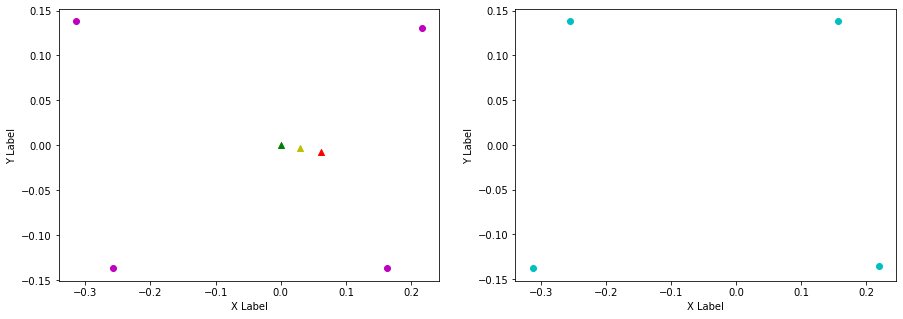

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.156, 0.213, FL (y): 0.138, 0.132.
FL displacement: 0.056999999999999995, -0.006000000000000005.

FR (x): 0.219, 0.145, FR (y): -0.135, -0.136.
FR displacement: -0.07400000000000001, -0.0010000000000000009.

RL (x): -0.255, -0.331, RL (y): 0.138, 0.137.
RL displacement: -0.07600000000000001, -0.0010000000000000009.

RR (x): -0.312, -0.261, RR (y): -0.138, -0.137.
RR displacement: 0.05099999999999999, 0.0010000000000000009.


Base displacement (Foot): [0.07400000000000001, 0.0010000000000000009].

Base displacement (Odom): [[0.041397683526407825], [0.006449897627764045]]. Rotation displacement: -1.4713523228721384.



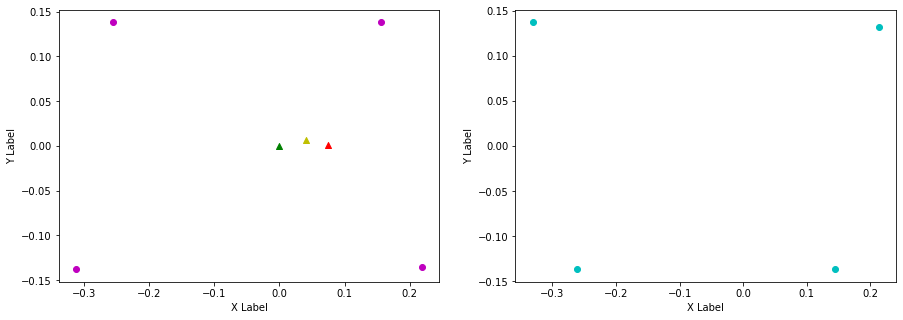

Command:  [0.2 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.213, 0.144, FL (y): 0.132, 0.136.
FL displacement: -0.069, 0.0040000000000000036.

FR (x): 0.145, 0.213, FR (y): -0.136, -0.136.
FR displacement: 0.068, 0.0.

RL (x): -0.331, -0.261, RL (y): 0.137, 0.139.
RL displacement: 0.07, 0.0020000000000000018.

RR (x): -0.261, -0.326, RR (y): -0.137, -0.136.
RR displacement: -0.065, 0.0010000000000000009.


Base displacement (Foot): [0.069, -0.0040000000000000036].

Base displacement (Odom): [[0.03712368026905111], [-0.006455637396492797]]. Rotation displacement: 0.6444170816881661.



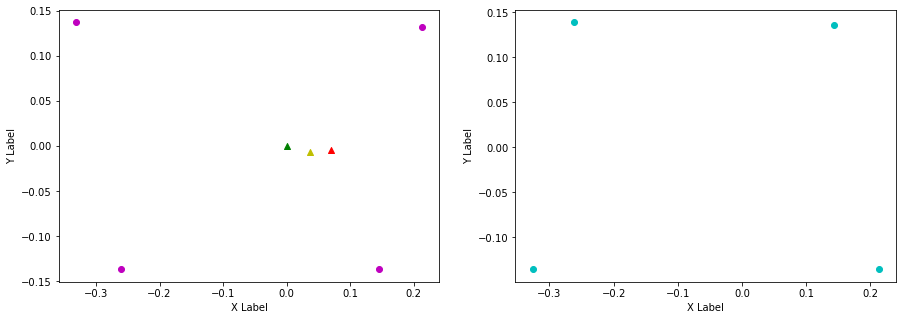

Command:  [0.2 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.144, 0.221, FL (y): 0.136, 0.132.
FL displacement: 0.07700000000000001, -0.0040000000000000036.

FR (x): 0.213, 0.168, FR (y): -0.136, -0.138.
FR displacement: -0.044999999999999984, -0.0020000000000000018.

RL (x): -0.261, -0.308, RL (y): 0.139, 0.138.
RL displacement: -0.046999999999999986, -0.0010000000000000009.

RR (x): -0.326, -0.254, RR (y): -0.136, -0.136.
RR displacement: 0.07200000000000001, 0.0.


Base displacement (Foot): [0.044999999999999984, 0.0020000000000000018].

Base displacement (Odom): [[0.058162100023158025], [0.009110491222459771]]. Rotation displacement: -0.7747662467100986.



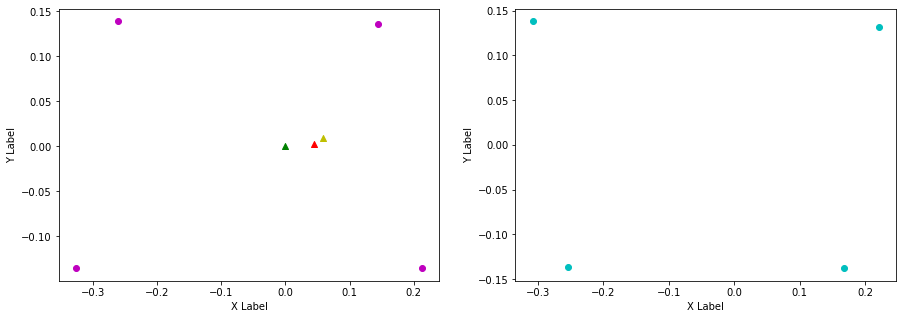

Command:  [0.2 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.194, 0.138, FL (y): 0.132, 0.137.
FL displacement: -0.055999999999999994, 0.0050000000000000044.

FR (x): 0.188, 0.228, FR (y): -0.132, -0.135.
FR displacement: 0.04000000000000001, -0.0030000000000000027.

RL (x): -0.285, -0.244, RL (y): 0.143, 0.136.
RL displacement: 0.04099999999999998, -0.0069999999999999785.

RR (x): -0.28, -0.338, RR (y): -0.143, -0.138.
RR displacement: -0.057999999999999996, 0.004999999999999977.


Base displacement (Foot): [0.055999999999999994, -0.0050000000000000044].

Base displacement (Odom): [[0.0029585380730914324], [-0.0010454382215261404]]. Rotation displacement: -45.88891619714153.



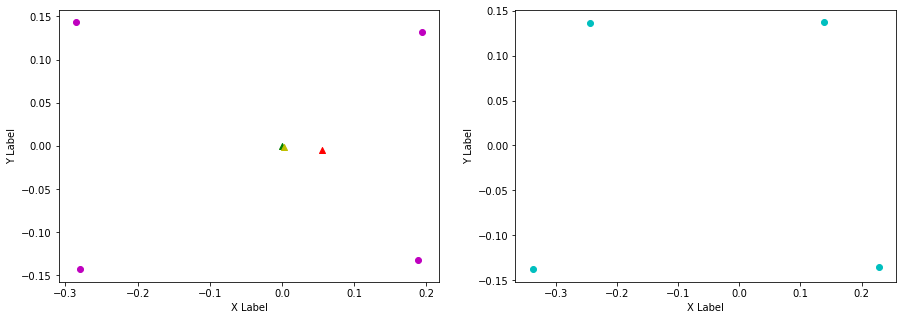

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.138, 0.228, FL (y): 0.137, 0.132.
FL displacement: 0.09, -0.0050000000000000044.

FR (x): 0.228, 0.131, FR (y): -0.135, -0.137.
FR displacement: -0.097, -0.0020000000000000018.

RL (x): -0.244, -0.347, RL (y): 0.136, 0.138.
RL displacement: -0.10299999999999998, 0.0020000000000000018.

RR (x): -0.338, -0.245, RR (y): -0.138, -0.136.
RR displacement: 0.09300000000000003, 0.0020000000000000018.


Base displacement (Foot): [0.097, 0.0020000000000000018].

Base displacement (Odom): [[0.0824259236538678], [0.0038540092965746453]]. Rotation displacement: -0.33325506565010937.



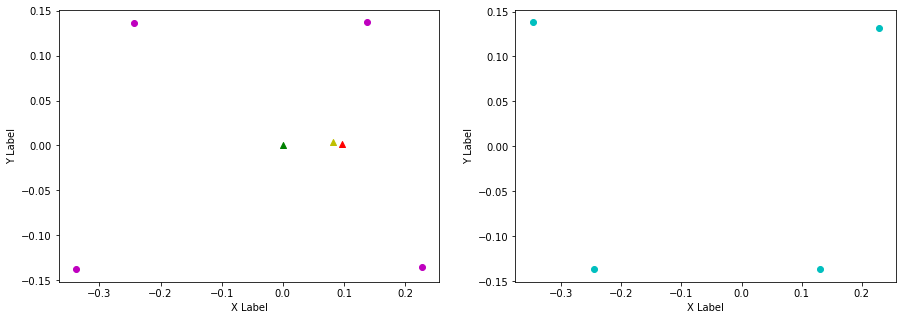

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.228, 0.124, FL (y): 0.132, 0.137.
FL displacement: -0.10400000000000001, 0.0050000000000000044.

FR (x): 0.131, 0.225, FR (y): -0.137, -0.136.
FR displacement: 0.094, 0.0010000000000000009.

RL (x): -0.347, -0.249, RL (y): 0.138, 0.138.
RL displacement: 0.09799999999999998, 0.0.

RR (x): -0.245, -0.343, RR (y): -0.136, -0.137.
RR displacement: -0.09800000000000003, -0.0010000000000000009.


Base displacement (Foot): [0.10400000000000001, -0.0050000000000000044].

Base displacement (Odom): [[0.06473097483142087], [-0.005251666223617946]]. Rotation displacement: 1.1283856145008553.



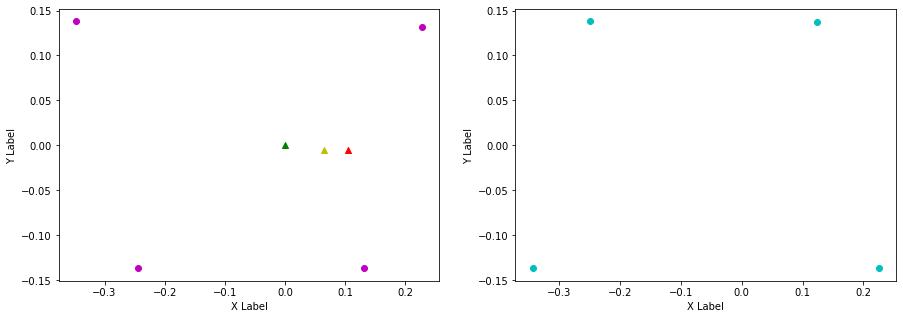

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.124, 0.236, FL (y): 0.137, 0.129.
FL displacement: 0.11199999999999999, -0.008000000000000007.

FR (x): 0.225, 0.157, FR (y): -0.136, -0.138.
FR displacement: -0.068, -0.0020000000000000018.

RL (x): -0.249, -0.324, RL (y): 0.138, 0.138.
RL displacement: -0.07500000000000001, 0.0.

RR (x): -0.343, -0.237, RR (y): -0.137, -0.135.
RR displacement: 0.10600000000000004, 0.0020000000000000018.


Base displacement (Foot): [0.068, 0.0020000000000000018].

Base displacement (Odom): [[0.09425504783836747], [0.011279100589163704]]. Rotation displacement: -1.4869057445494902.



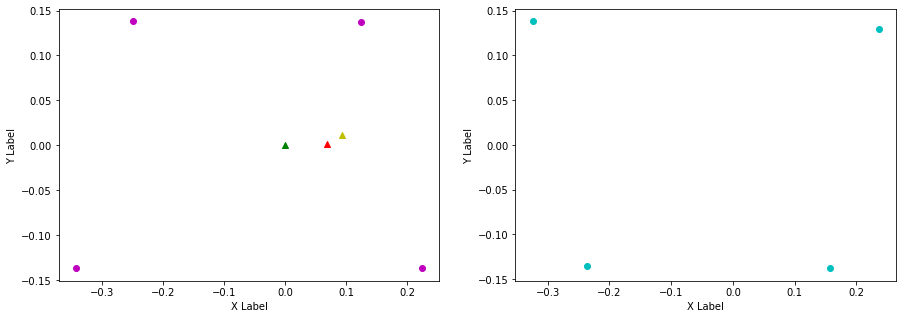

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.236, 0.118, FL (y): 0.129, 0.136.
FL displacement: -0.118, 0.007000000000000006.

FR (x): 0.157, 0.222, FR (y): -0.138, -0.136.
FR displacement: 0.065, 0.0020000000000000018.

RL (x): -0.324, -0.252, RL (y): 0.138, 0.139.
RL displacement: 0.07200000000000001, 0.0010000000000000009.

RR (x): -0.237, -0.35, RR (y): -0.135, -0.136.
RR displacement: -0.11299999999999999, -0.0010000000000000009.


Base displacement (Foot): [0.118, -0.007000000000000006].

Base displacement (Odom): [[0.059996479632511424], [-0.005673556003573665]]. Rotation displacement: 1.4686763857066973.



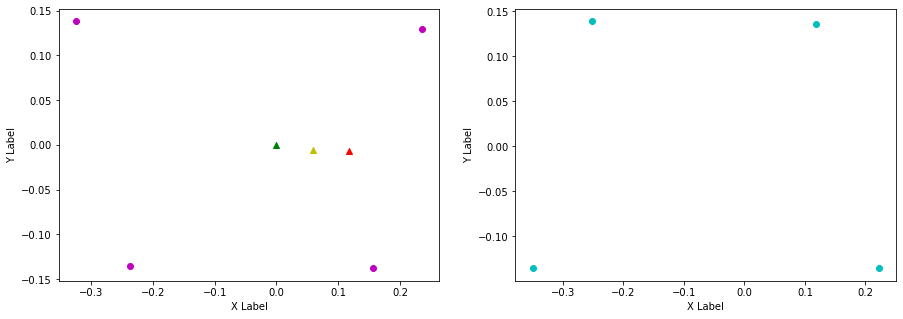

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.118, 0.224, FL (y): 0.136, 0.131.
FL displacement: 0.10600000000000001, -0.0050000000000000044.

FR (x): 0.222, 0.124, FR (y): -0.136, -0.136.
FR displacement: -0.098, 0.0.

RL (x): -0.252, -0.355, RL (y): 0.139, 0.136.
RL displacement: -0.10299999999999998, -0.0030000000000000027.

RR (x): -0.35, -0.248, RR (y): -0.136, -0.135.
RR displacement: 0.10199999999999998, 0.0010000000000000009.


Base displacement (Foot): [0.098, -0.0].

Base displacement (Odom): [[0.05748750548271442], [0.004432545065139237]]. Rotation displacement: -1.7271444561148472.



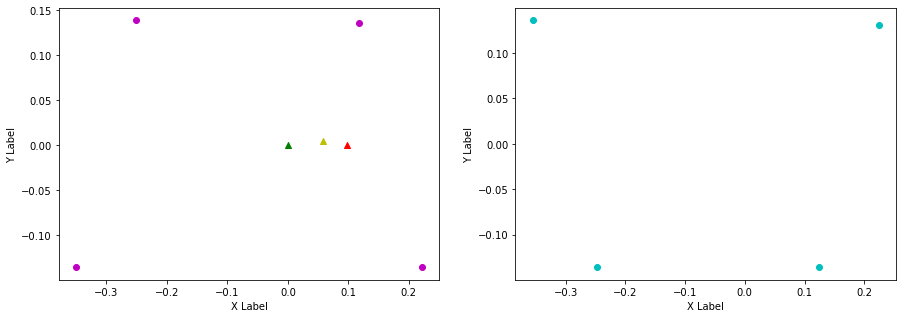

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.224, 0.134, FL (y): 0.131, 0.138.
FL displacement: -0.09, 0.007000000000000006.

FR (x): 0.124, 0.232, FR (y): -0.136, -0.136.
FR displacement: 0.10800000000000001, 0.0.

RL (x): -0.355, -0.243, RL (y): 0.136, 0.138.
RL displacement: 0.11199999999999999, 0.0020000000000000018.

RR (x): -0.248, -0.33, RR (y): -0.135, -0.138.
RR displacement: -0.08200000000000002, -0.0030000000000000027.


Base displacement (Foot): [0.09, -0.007000000000000006].

Base displacement (Odom): [[0.03573852409343292], [-0.003230998771906357]]. Rotation displacement: 0.6913387320084317.



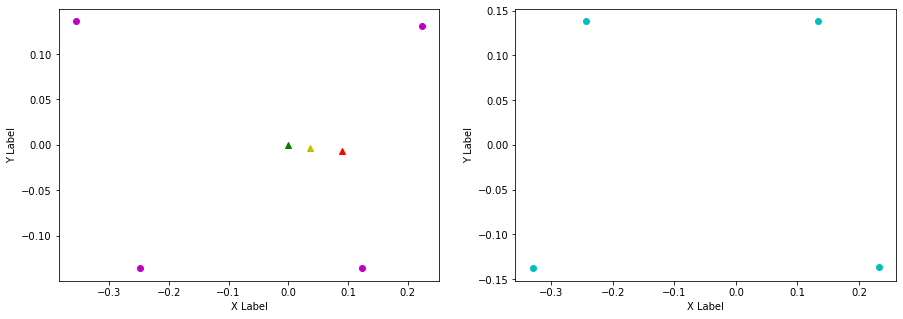

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.134, 0.234, FL (y): 0.138, 0.129.
FL displacement: 0.1, -0.009000000000000008.

FR (x): 0.232, 0.155, FR (y): -0.136, -0.138.
FR displacement: -0.07700000000000001, -0.0020000000000000018.

RL (x): -0.243, -0.328, RL (y): 0.138, 0.138.
RL displacement: -0.08500000000000002, 0.0.

RR (x): -0.33, -0.239, RR (y): -0.138, -0.136.
RR displacement: 0.09100000000000003, 0.0020000000000000018.


Base displacement (Foot): [0.07700000000000001, 0.0020000000000000018].

Base displacement (Odom): [[0.06425599938714743], [0.005497007997870895]]. Rotation displacement: -1.4250567196086699.



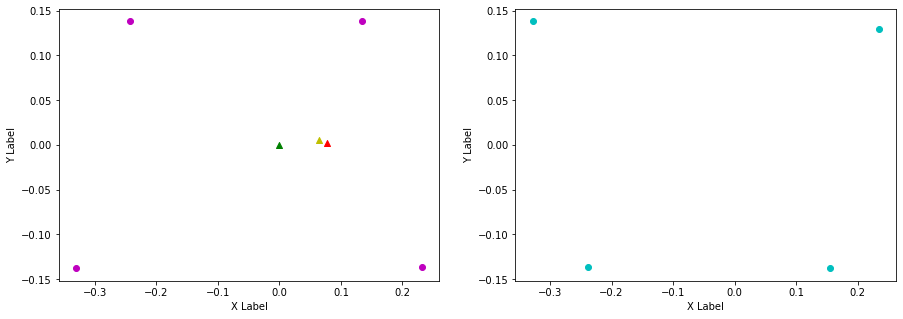

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.234, 0.118, FL (y): 0.129, 0.136.
FL displacement: -0.11600000000000002, 0.007000000000000006.

FR (x): 0.155, 0.222, FR (y): -0.138, -0.136.
FR displacement: 0.067, 0.0020000000000000018.

RL (x): -0.328, -0.251, RL (y): 0.138, 0.139.
RL displacement: 0.07700000000000001, 0.0010000000000000009.

RR (x): -0.239, -0.351, RR (y): -0.136, -0.136.
RR displacement: -0.11199999999999999, 0.0.


Base displacement (Foot): [0.11600000000000002, -0.007000000000000006].

Base displacement (Odom): [[0.08232605547454241], [-0.007551405327468785]]. Rotation displacement: 0.869568974157329.



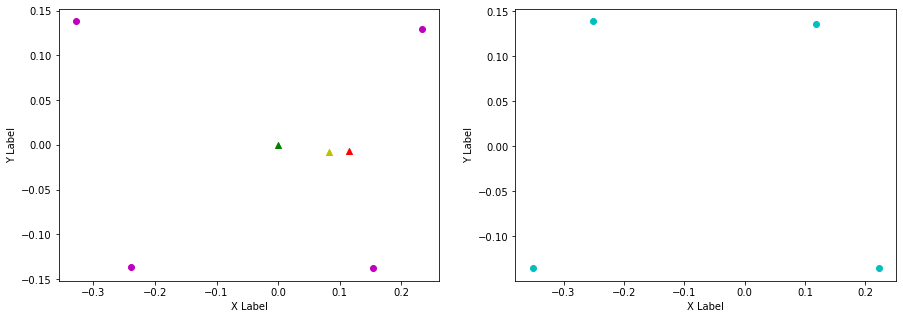

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.118, 0.229, FL (y): 0.136, 0.13.
FL displacement: 0.11100000000000002, -0.006000000000000005.

FR (x): 0.222, 0.141, FR (y): -0.136, -0.137.
FR displacement: -0.08100000000000002, -0.0010000000000000009.

RL (x): -0.251, -0.338, RL (y): 0.139, 0.138.
RL displacement: -0.08700000000000002, -0.0010000000000000009.

RR (x): -0.351, -0.243, RR (y): -0.136, -0.135.
RR displacement: 0.10799999999999998, 0.0010000000000000009.


Base displacement (Foot): [0.08100000000000002, 0.0010000000000000009].

Base displacement (Odom): [[0.1194860840059313], [0.012229516232636684]]. Rotation displacement: -1.3491258126546142.



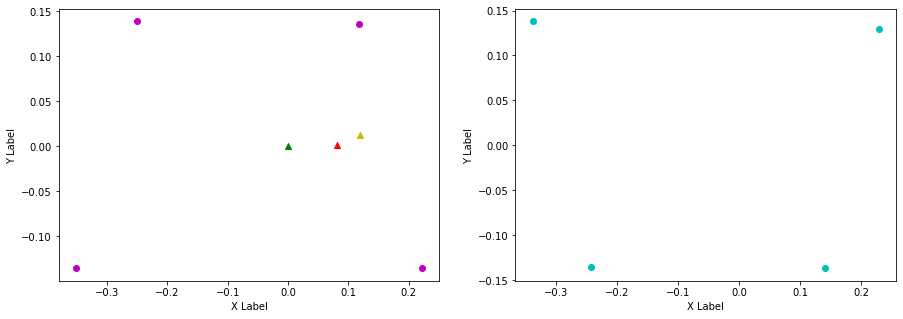

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.229, 0.136, FL (y): 0.13, 0.139.
FL displacement: -0.093, 0.009000000000000008.

FR (x): 0.141, 0.233, FR (y): -0.137, -0.136.
FR displacement: 0.09200000000000003, 0.0010000000000000009.

RL (x): -0.338, -0.242, RL (y): 0.138, 0.138.
RL displacement: 0.09600000000000003, 0.0.

RR (x): -0.243, -0.328, RR (y): -0.135, -0.138.
RR displacement: -0.08500000000000002, -0.0030000000000000027.


Base displacement (Foot): [0.093, -0.009000000000000008].

Base displacement (Odom): [[0.03671621609417386], [-0.005172787464369222]]. Rotation displacement: 0.8521173667383841.



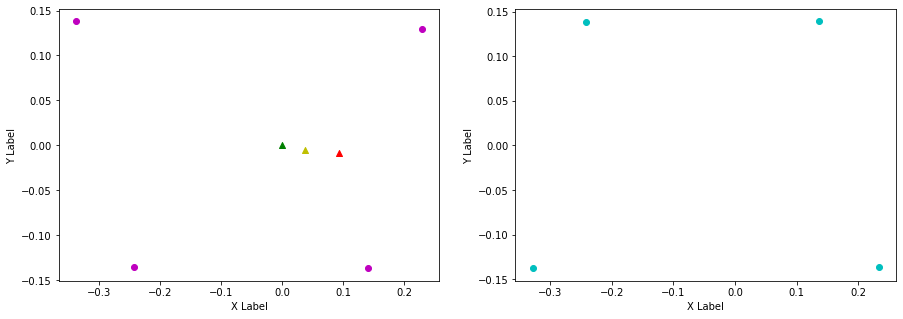

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.136, 0.234, FL (y): 0.139, 0.129.
FL displacement: 0.098, -0.010000000000000009.

FR (x): 0.233, 0.156, FR (y): -0.136, -0.137.
FR displacement: -0.07700000000000001, -0.0010000000000000009.

RL (x): -0.242, -0.328, RL (y): 0.138, 0.138.
RL displacement: -0.08600000000000002, 0.0.

RR (x): -0.328, -0.239, RR (y): -0.138, -0.135.
RR displacement: 0.08900000000000002, 0.0030000000000000027.


Base displacement (Foot): [0.07700000000000001, 0.0010000000000000009].

Base displacement (Odom): [[0.07977265092111185], [0.009838733099263308]]. Rotation displacement: -1.9133761212404023.



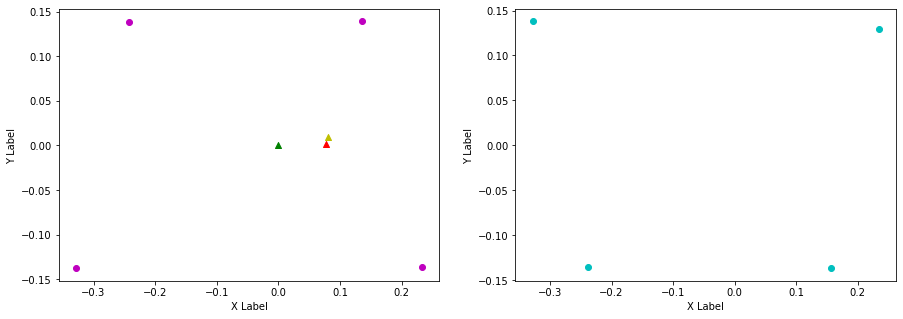

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.234, 0.118, FL (y): 0.129, 0.136.
FL displacement: -0.11600000000000002, 0.007000000000000006.

FR (x): 0.156, 0.222, FR (y): -0.137, -0.137.
FR displacement: 0.066, 0.0.

RL (x): -0.328, -0.252, RL (y): 0.138, 0.139.
RL displacement: 0.07600000000000001, 0.0010000000000000009.

RR (x): -0.239, -0.351, RR (y): -0.135, -0.136.
RR displacement: -0.11199999999999999, -0.0010000000000000009.


Base displacement (Foot): [0.11600000000000002, -0.007000000000000006].

Base displacement (Odom): [[0.07186831395169513], [-0.0064085642484386085]]. Rotation displacement: 1.262145096121127.



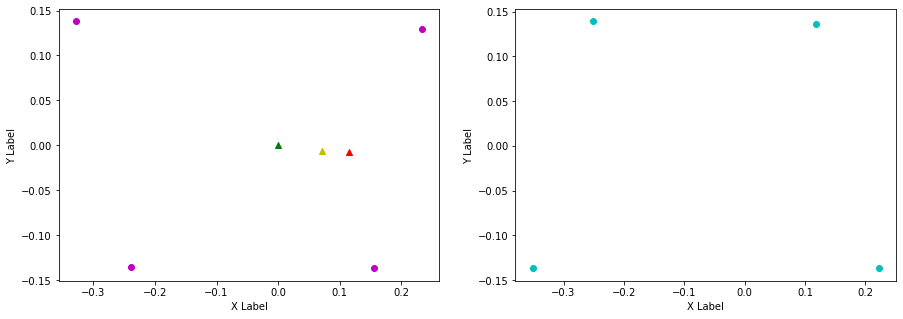

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.118, 0.224, FL (y): 0.136, 0.13.
FL displacement: 0.10600000000000001, -0.006000000000000005.

FR (x): 0.222, 0.124, FR (y): -0.137, -0.136.
FR displacement: -0.098, 0.0010000000000000009.

RL (x): -0.252, -0.356, RL (y): 0.139, 0.137.
RL displacement: -0.10399999999999998, -0.0020000000000000018.

RR (x): -0.351, -0.248, RR (y): -0.136, -0.135.
RR displacement: 0.10299999999999998, 0.0010000000000000009.


Base displacement (Foot): [0.098, -0.0010000000000000009].

Base displacement (Odom): [[0.06920919119542024], [0.004292477616962387]]. Rotation displacement: -1.6756962046410626.



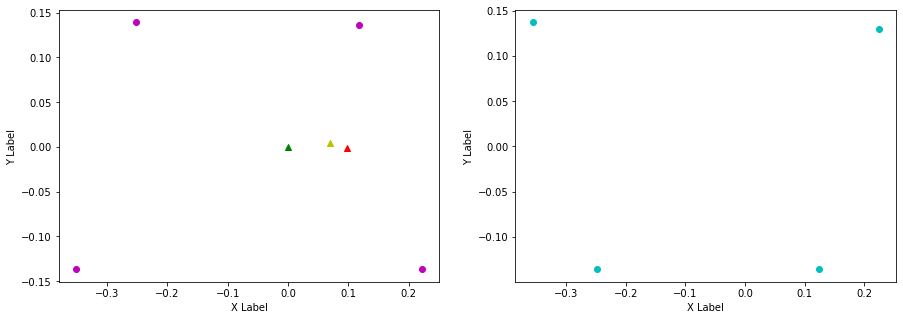

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.224, 0.124, FL (y): 0.13, 0.137.
FL displacement: -0.1, 0.007000000000000006.

FR (x): 0.124, 0.226, FR (y): -0.136, -0.136.
FR displacement: 0.10200000000000001, 0.0.

RL (x): -0.356, -0.248, RL (y): 0.137, 0.138.
RL displacement: 0.10799999999999998, 0.0010000000000000009.

RR (x): -0.248, -0.342, RR (y): -0.135, -0.137.
RR displacement: -0.09400000000000003, -0.0020000000000000018.


Base displacement (Foot): [0.1, -0.007000000000000006].

Base displacement (Odom): [[0.04917919876559029], [-0.004323056586663654]]. Rotation displacement: 0.5171960940182394.



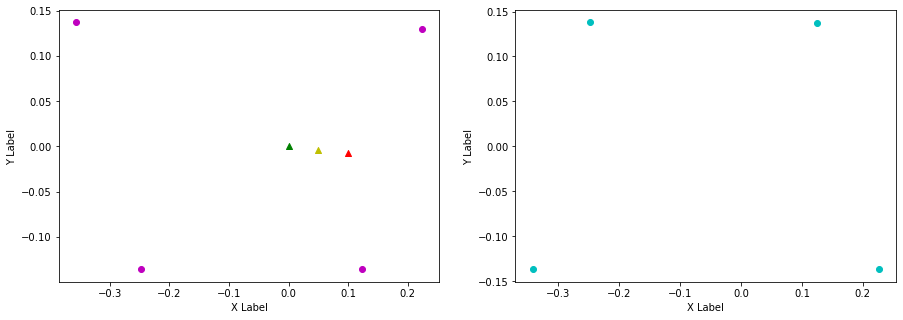

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.124, 0.227, FL (y): 0.137, 0.129.
FL displacement: 0.10300000000000001, -0.008000000000000007.

FR (x): 0.226, 0.135, FR (y): -0.136, -0.136.
FR displacement: -0.091, 0.0.

RL (x): -0.248, -0.345, RL (y): 0.138, 0.138.
RL displacement: -0.09699999999999998, 0.0.

RR (x): -0.342, -0.245, RR (y): -0.137, -0.135.
RR displacement: 0.09700000000000003, 0.0020000000000000018.


Base displacement (Foot): [0.091, -0.0].

Base displacement (Odom): [[0.07457305086547628], [0.007840605640723197]]. Rotation displacement: -1.245752049229613.



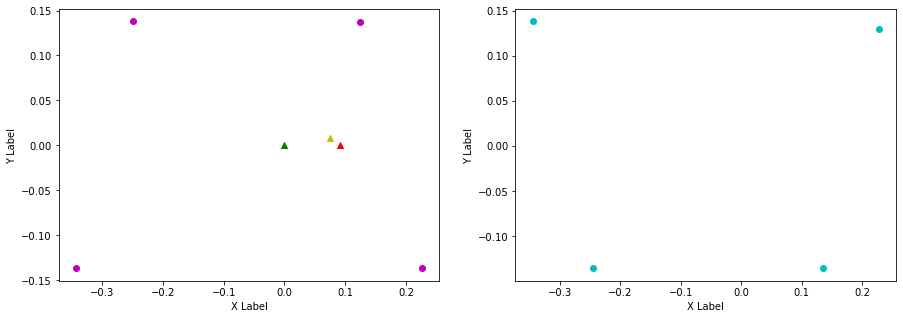

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.227, 0.139, FL (y): 0.129, 0.139.
FL displacement: -0.088, 0.010000000000000009.

FR (x): 0.135, 0.237, FR (y): -0.136, -0.135.
FR displacement: 0.10199999999999998, 0.0010000000000000009.

RL (x): -0.345, -0.238, RL (y): 0.138, 0.138.
RL displacement: 0.10699999999999998, 0.0.

RR (x): -0.245, -0.325, RR (y): -0.135, -0.138.
RR displacement: -0.08000000000000002, -0.0030000000000000027.


Base displacement (Foot): [0.088, -0.010000000000000009].

Base displacement (Odom): [[0.06434448471319865], [-0.005933679156740368]]. Rotation displacement: 0.8341652761757612.



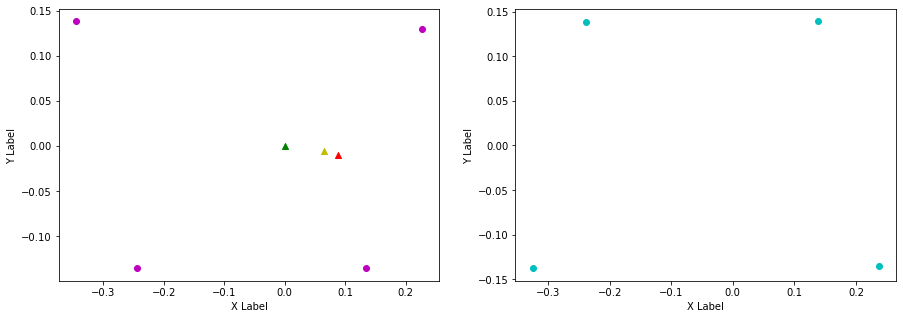

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.139, 0.231, FL (y): 0.139, 0.129.
FL displacement: 0.092, -0.010000000000000009.

FR (x): 0.237, 0.15, FR (y): -0.135, -0.137.
FR displacement: -0.087, -0.0020000000000000018.

RL (x): -0.238, -0.334, RL (y): 0.138, 0.138.
RL displacement: -0.09600000000000003, 0.0.

RR (x): -0.325, -0.242, RR (y): -0.138, -0.136.
RR displacement: 0.08300000000000002, 0.0020000000000000018.


Base displacement (Foot): [0.087, 0.0020000000000000018].

Base displacement (Odom): [[0.09726411844047878], [0.009982712479665423]]. Rotation displacement: -1.3881109343771942.



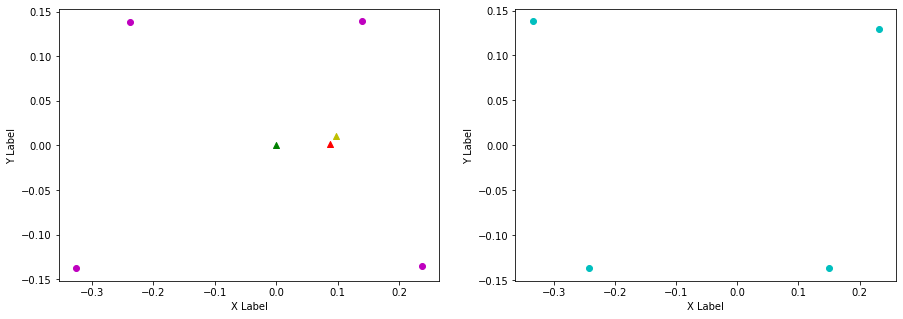

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.231, 0.138, FL (y): 0.129, 0.139.
FL displacement: -0.093, 0.010000000000000009.

FR (x): 0.15, 0.235, FR (y): -0.137, -0.135.
FR displacement: 0.08499999999999999, 0.0020000000000000018.

RL (x): -0.334, -0.24, RL (y): 0.138, 0.138.
RL displacement: 0.09400000000000003, 0.0.

RR (x): -0.242, -0.326, RR (y): -0.136, -0.138.
RR displacement: -0.08400000000000002, -0.0020000000000000018.


Base displacement (Foot): [0.093, -0.010000000000000009].

Base displacement (Odom): [[0.05382321393122602], [-0.00445627611892796]]. Rotation displacement: 0.8337910937305161.



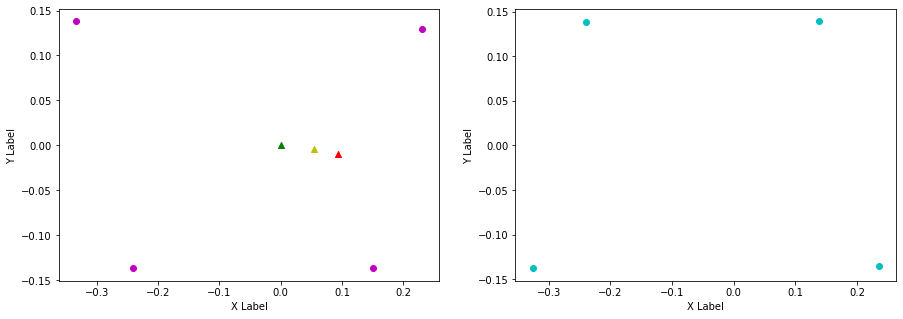

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.138, 0.234, FL (y): 0.139, 0.129.
FL displacement: 0.096, -0.010000000000000009.

FR (x): 0.235, 0.155, FR (y): -0.135, -0.137.
FR displacement: -0.07999999999999999, -0.0020000000000000018.

RL (x): -0.24, -0.327, RL (y): 0.138, 0.138.
RL displacement: -0.08700000000000002, 0.0.

RR (x): -0.326, -0.239, RR (y): -0.138, -0.135.
RR displacement: 0.08700000000000002, 0.0030000000000000027.


Base displacement (Foot): [0.07999999999999999, 0.0020000000000000018].

Base displacement (Odom): [[0.08698184128559827], [0.010113109875367954]]. Rotation displacement: -1.5899846981163492.



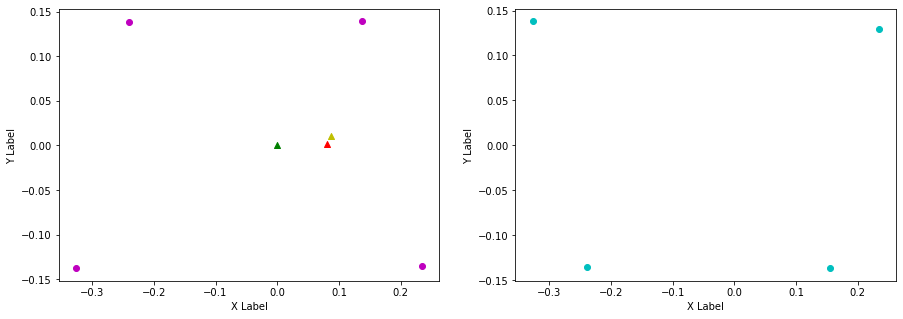

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.234, 0.154, FL (y): 0.129, 0.142.
FL displacement: -0.08000000000000002, 0.012999999999999984.

FR (x): 0.155, 0.253, FR (y): -0.137, -0.134.
FR displacement: 0.098, 0.0030000000000000027.

RL (x): -0.327, -0.224, RL (y): 0.138, 0.136.
RL displacement: 0.10300000000000001, -0.0020000000000000018.

RR (x): -0.239, -0.308, RR (y): -0.135, -0.141.
RR displacement: -0.069, -0.005999999999999978.


Base displacement (Foot): [0.08000000000000002, -0.012999999999999984].

Base displacement (Odom): [[0.037365995289277976], [-0.003772679959196168]]. Rotation displacement: 1.3028324780990945.



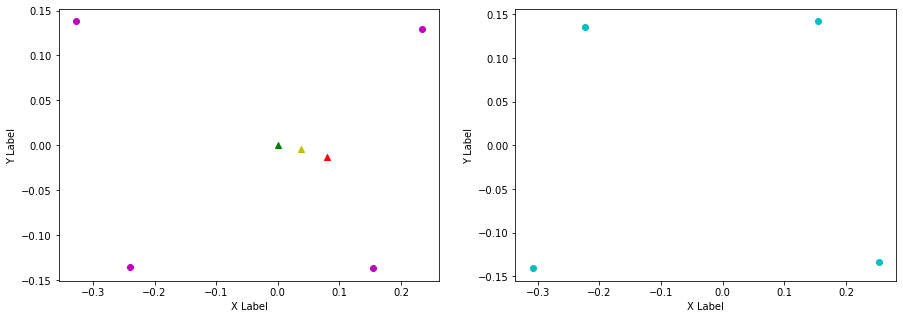

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.154, 0.236, FL (y): 0.142, 0.129.
FL displacement: 0.08199999999999999, -0.012999999999999984.

FR (x): 0.253, 0.157, FR (y): -0.134, -0.138.
FR displacement: -0.096, -0.0040000000000000036.

RL (x): -0.224, -0.325, RL (y): 0.136, 0.139.
RL displacement: -0.101, 0.0030000000000000027.

RR (x): -0.308, -0.236, RR (y): -0.141, -0.135.
RR displacement: 0.07200000000000001, 0.005999999999999978.


Base displacement (Foot): [0.096, 0.0040000000000000036].

Base displacement (Odom): [[0.15068840171459286], [0.007515477064188758]]. Rotation displacement: -2.1748416298895927.



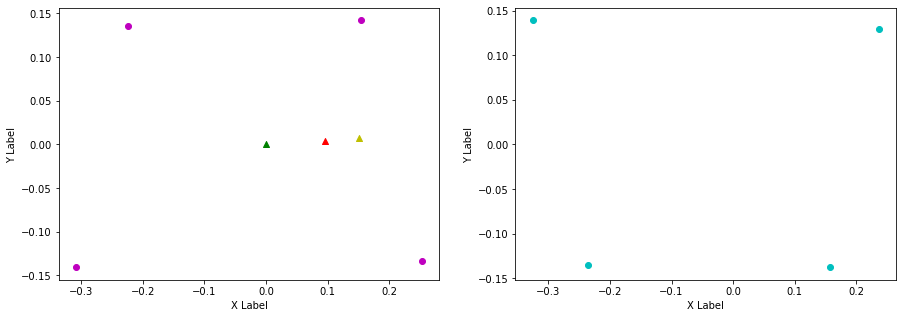

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.124, 0.236, FL (y): 0.137, 0.129.
FL displacement: 0.11199999999999999, -0.008000000000000007.

FR (x): 0.226, 0.156, FR (y): -0.136, -0.138.
FR displacement: -0.07, -0.0020000000000000018.

RL (x): -0.248, -0.325, RL (y): 0.138, 0.139.
RL displacement: -0.07700000000000001, 0.0010000000000000009.

RR (x): -0.342, -0.236, RR (y): -0.136, -0.135.
RR displacement: 0.10600000000000004, 0.0010000000000000009.


Base displacement (Foot): [0.07, 0.0020000000000000018].

Base displacement (Odom): [[0.05992533170194392], [0.011440816103343465]]. Rotation displacement: -0.20874058790221778.



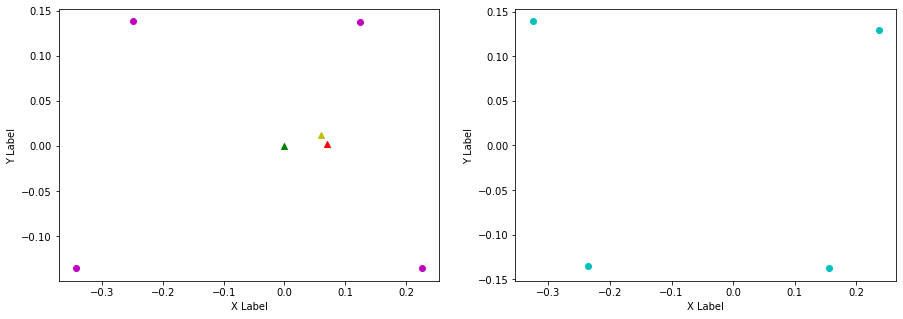

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.236, 0.139, FL (y): 0.129, 0.139.
FL displacement: -0.09699999999999998, 0.010000000000000009.

FR (x): 0.156, 0.237, FR (y): -0.138, -0.135.
FR displacement: 0.08099999999999999, 0.0030000000000000027.

RL (x): -0.325, -0.238, RL (y): 0.139, 0.138.
RL displacement: 0.08700000000000002, -0.0010000000000000009.

RR (x): -0.236, -0.324, RR (y): -0.135, -0.138.
RR displacement: -0.08800000000000002, -0.0030000000000000027.


Base displacement (Foot): [0.09699999999999998, -0.010000000000000009].

Base displacement (Odom): [[0.05137880547830598], [-0.005276825291346654]]. Rotation displacement: 1.2408746729411944.



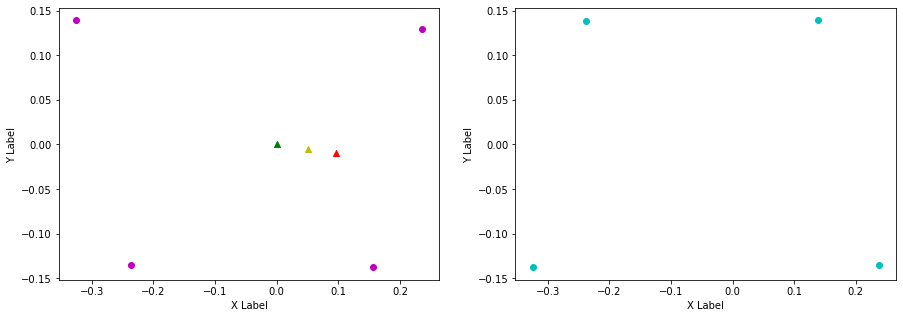

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.139, 0.223, FL (y): 0.139, 0.131.
FL displacement: 0.08399999999999999, -0.008000000000000007.

FR (x): 0.237, 0.121, FR (y): -0.135, -0.136.
FR displacement: -0.11599999999999999, -0.0010000000000000009.

RL (x): -0.238, -0.358, RL (y): 0.138, 0.137.
RL displacement: -0.12, -0.0010000000000000009.

RR (x): -0.324, -0.249, RR (y): -0.138, -0.136.
RR displacement: 0.07500000000000001, 0.0020000000000000018.


Base displacement (Foot): [0.11599999999999999, 0.0010000000000000009].

Base displacement (Odom): [[0.13290764120454313], [0.010236875584222815]]. Rotation displacement: -2.3290437476736905.



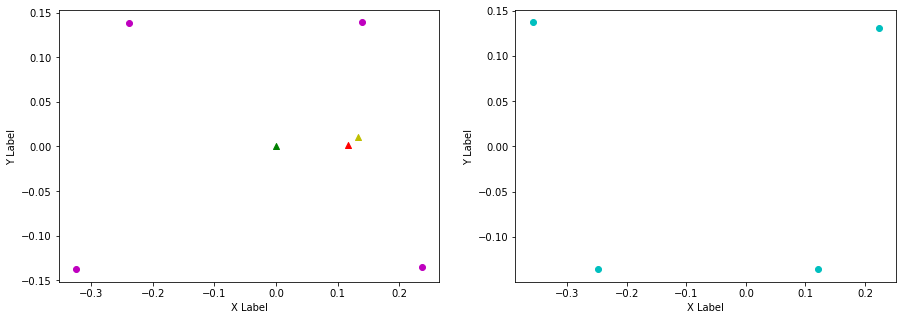

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.223, 0.119, FL (y): 0.131, 0.136.
FL displacement: -0.10400000000000001, 0.0050000000000000044.

FR (x): 0.121, 0.223, FR (y): -0.136, -0.137.
FR displacement: 0.10200000000000001, -0.0010000000000000009.

RL (x): -0.358, -0.251, RL (y): 0.137, 0.139.
RL displacement: 0.10699999999999998, 0.0020000000000000018.

RR (x): -0.249, -0.349, RR (y): -0.136, -0.136.
RR displacement: -0.09999999999999998, 0.0.


Base displacement (Foot): [0.10400000000000001, -0.0050000000000000044].

Base displacement (Odom): [[0.07039014491586837], [-0.006461420593524281]]. Rotation displacement: 0.834918950187994.



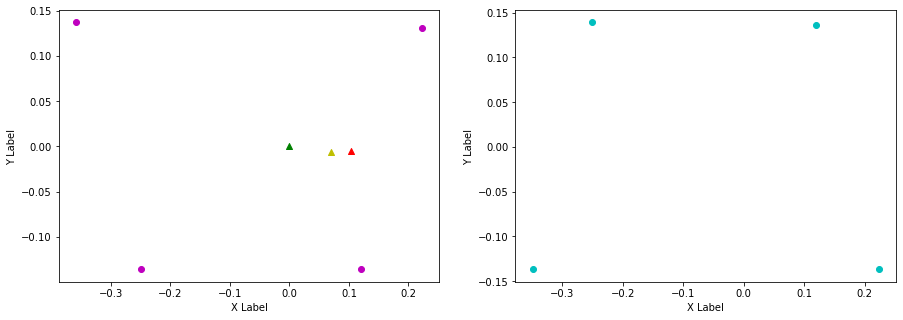

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.119, 0.227, FL (y): 0.136, 0.13.
FL displacement: 0.10800000000000001, -0.006000000000000005.

FR (x): 0.223, 0.135, FR (y): -0.137, -0.136.
FR displacement: -0.088, 0.0010000000000000009.

RL (x): -0.251, -0.346, RL (y): 0.139, 0.137.
RL displacement: -0.09499999999999997, -0.0020000000000000018.

RR (x): -0.349, -0.245, RR (y): -0.136, -0.135.
RR displacement: 0.10399999999999998, 0.0010000000000000009.


Base displacement (Foot): [0.088, -0.0010000000000000009].

Base displacement (Odom): [[0.0940925734917526], [0.009615886328747436]]. Rotation displacement: -1.0203476248573304.



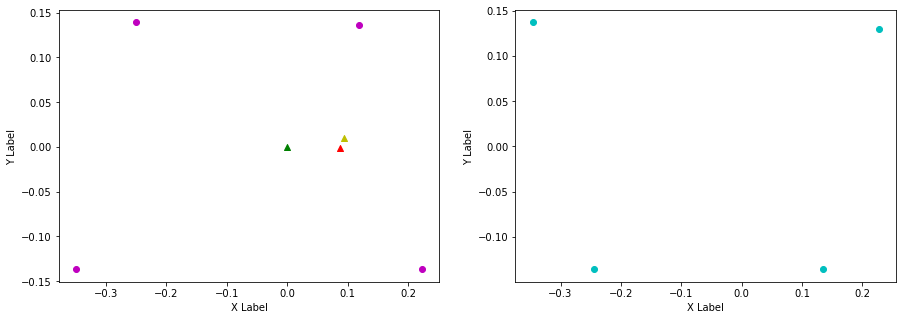

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.227, 0.125, FL (y): 0.13, 0.137.
FL displacement: -0.10200000000000001, 0.007000000000000006.

FR (x): 0.135, 0.226, FR (y): -0.136, -0.136.
FR displacement: 0.091, 0.0.

RL (x): -0.346, -0.249, RL (y): 0.137, 0.138.
RL displacement: 0.09699999999999998, 0.0010000000000000009.

RR (x): -0.245, -0.342, RR (y): -0.135, -0.136.
RR displacement: -0.09700000000000003, -0.0010000000000000009.


Base displacement (Foot): [0.10200000000000001, -0.007000000000000006].

Base displacement (Odom): [[0.07612181520996586], [-0.008973602028333971]]. Rotation displacement: 0.5800230256982243.



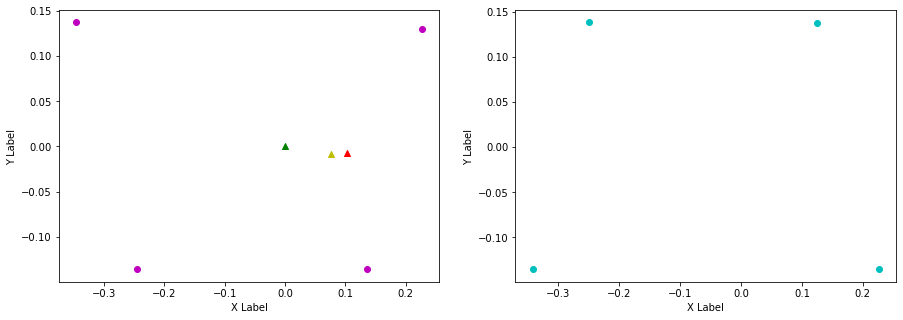

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.125, 0.234, FL (y): 0.137, 0.129.
FL displacement: 0.10900000000000001, -0.008000000000000007.

FR (x): 0.226, 0.156, FR (y): -0.136, -0.137.
FR displacement: -0.07, -0.0010000000000000009.

RL (x): -0.249, -0.327, RL (y): 0.138, 0.138.
RL displacement: -0.07800000000000001, 0.0.

RR (x): -0.342, -0.239, RR (y): -0.136, -0.135.
RR displacement: 0.10300000000000004, 0.0010000000000000009.


Base displacement (Foot): [0.07, 0.0010000000000000009].

Base displacement (Odom): [[0.054389689923072915], [0.0018162049502645772]]. Rotation displacement: -1.5004565413976614.



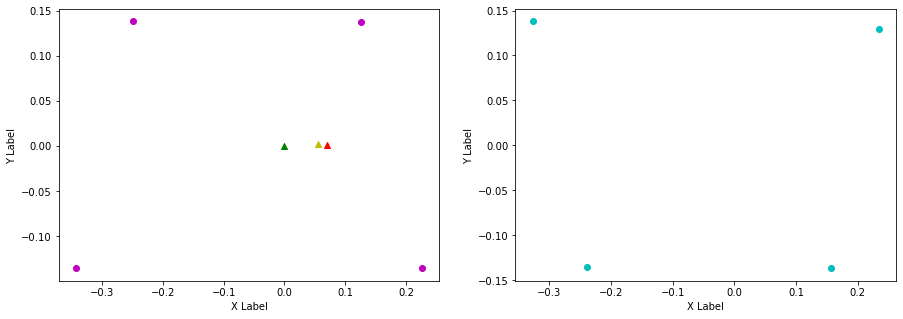

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.234, 0.128, FL (y): 0.129, 0.137.
FL displacement: -0.10600000000000001, 0.008000000000000007.

FR (x): 0.156, 0.228, FR (y): -0.137, -0.136.
FR displacement: 0.07200000000000001, 0.0010000000000000009.

RL (x): -0.327, -0.247, RL (y): 0.138, 0.138.
RL displacement: 0.08000000000000002, 0.0.

RR (x): -0.239, -0.338, RR (y): -0.135, -0.137.
RR displacement: -0.09900000000000003, -0.0020000000000000018.


Base displacement (Foot): [0.10600000000000001, -0.008000000000000007].

Base displacement (Odom): [[0.06559225163822902], [-0.007186985014318026]]. Rotation displacement: 1.3238064080254015.



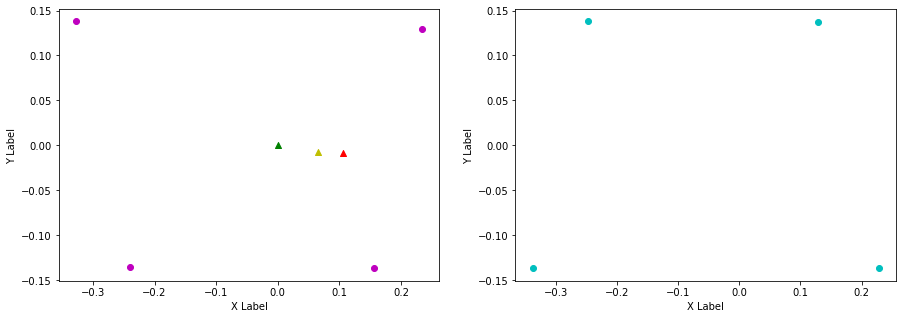

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.128, 0.223, FL (y): 0.137, 0.131.
FL displacement: 0.095, -0.006000000000000005.

FR (x): 0.228, 0.121, FR (y): -0.136, -0.136.
FR displacement: -0.10700000000000001, 0.0.

RL (x): -0.247, -0.359, RL (y): 0.138, 0.137.
RL displacement: -0.11199999999999999, -0.0010000000000000009.

RR (x): -0.338, -0.249, RR (y): -0.137, -0.136.
RR displacement: 0.08900000000000002, 0.0010000000000000009.


Base displacement (Foot): [0.10700000000000001, -0.0].

Base displacement (Odom): [[0.08530712471919433], [0.0069837783242636675]]. Rotation displacement: -1.9351635392947144.



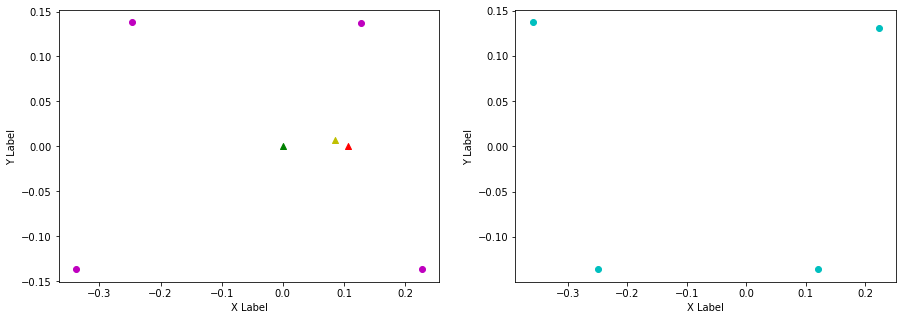

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.223, 0.119, FL (y): 0.131, 0.137.
FL displacement: -0.10400000000000001, 0.006000000000000005.

FR (x): 0.121, 0.222, FR (y): -0.136, -0.137.
FR displacement: 0.101, -0.0010000000000000009.

RL (x): -0.359, -0.252, RL (y): 0.137, 0.138.
RL displacement: 0.10699999999999998, 0.0010000000000000009.

RR (x): -0.249, -0.35, RR (y): -0.136, -0.136.
RR displacement: -0.10099999999999998, 0.0.


Base displacement (Foot): [0.10400000000000001, -0.006000000000000005].

Base displacement (Odom): [[0.05405330853892121], [-0.005236642095777455]]. Rotation displacement: 0.04322042234596511.



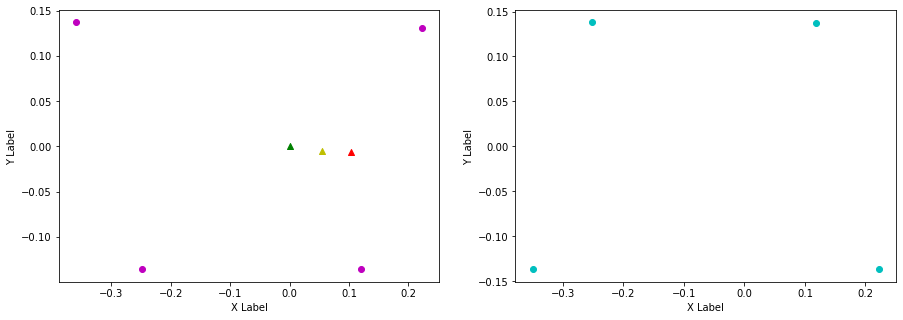

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.119, 0.233, FL (y): 0.137, 0.129.
FL displacement: 0.11400000000000002, -0.008000000000000007.

FR (x): 0.222, 0.156, FR (y): -0.137, -0.137.
FR displacement: -0.066, 0.0.

RL (x): -0.252, -0.33, RL (y): 0.138, 0.138.
RL displacement: -0.07800000000000001, 0.0.

RR (x): -0.35, -0.24, RR (y): -0.136, -0.135.
RR displacement: 0.10999999999999999, 0.0010000000000000009.


Base displacement (Foot): [0.066, -0.0].

Base displacement (Odom): [[0.059178382590576284], [0.00768460991043618]]. Rotation displacement: -0.506909810687217.



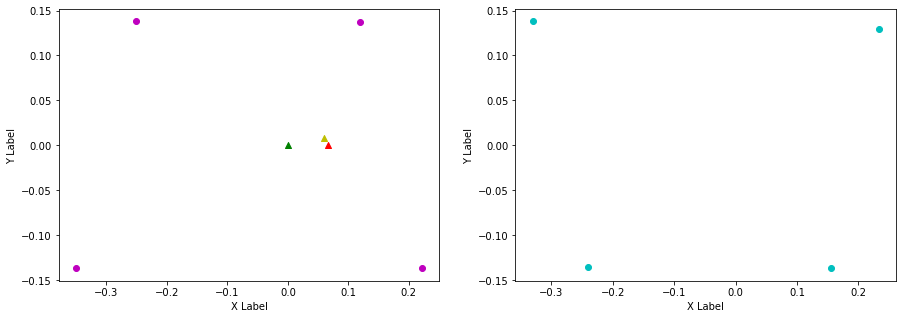

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.233, 0.125, FL (y): 0.129, 0.137.
FL displacement: -0.10800000000000001, 0.008000000000000007.

FR (x): 0.156, 0.226, FR (y): -0.137, -0.136.
FR displacement: 0.07, 0.0010000000000000009.

RL (x): -0.33, -0.249, RL (y): 0.138, 0.138.
RL displacement: 0.08100000000000002, 0.0.

RR (x): -0.24, -0.342, RR (y): -0.135, -0.137.
RR displacement: -0.10200000000000004, -0.0020000000000000018.


Base displacement (Foot): [0.10800000000000001, -0.008000000000000007].

Base displacement (Odom): [[0.07175684471571842], [-0.00670570416884253]]. Rotation displacement: 0.7584884604116552.



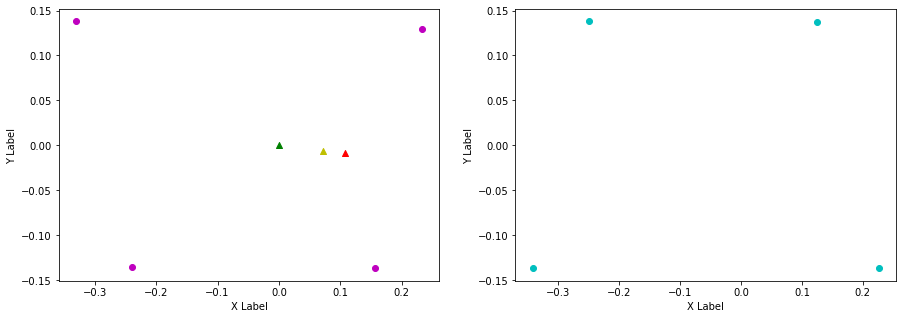

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.125, 0.229, FL (y): 0.137, 0.129.
FL displacement: 0.10400000000000001, -0.008000000000000007.

FR (x): 0.226, 0.141, FR (y): -0.136, -0.137.
FR displacement: -0.08500000000000002, -0.0010000000000000009.

RL (x): -0.249, -0.34, RL (y): 0.138, 0.138.
RL displacement: -0.09100000000000003, 0.0.

RR (x): -0.342, -0.244, RR (y): -0.137, -0.135.
RR displacement: 0.09800000000000003, 0.0020000000000000018.


Base displacement (Foot): [0.08500000000000002, 0.0010000000000000009].

Base displacement (Odom): [[0.11251013758922301], [0.012054361275545489]]. Rotation displacement: -1.5648808705791.



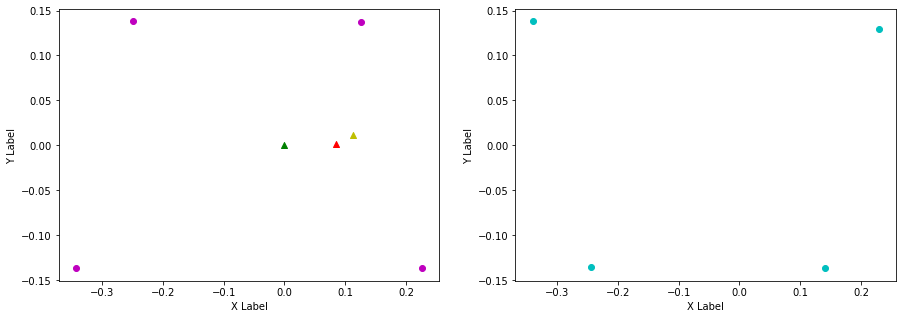

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.229, 0.136, FL (y): 0.129, 0.139.
FL displacement: -0.093, 0.010000000000000009.

FR (x): 0.141, 0.234, FR (y): -0.137, -0.136.
FR displacement: 0.09300000000000003, 0.0010000000000000009.

RL (x): -0.34, -0.241, RL (y): 0.138, 0.138.
RL displacement: 0.09900000000000003, 0.0.

RR (x): -0.244, -0.328, RR (y): -0.135, -0.138.
RR displacement: -0.08400000000000002, -0.0030000000000000027.


Base displacement (Foot): [0.093, -0.010000000000000009].

Base displacement (Odom): [[0.06627059615986752], [-0.006388155670743245]]. Rotation displacement: 0.7068186693664036.



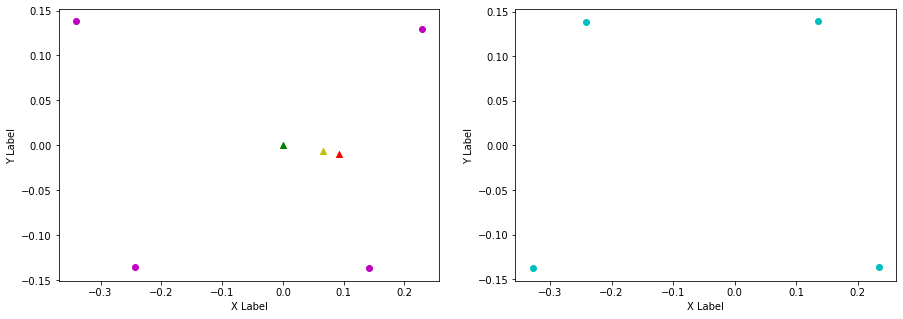

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.136, 0.223, FL (y): 0.139, 0.131.
FL displacement: 0.087, -0.008000000000000007.

FR (x): 0.234, 0.121, FR (y): -0.136, -0.135.
FR displacement: -0.11300000000000002, 0.0010000000000000009.

RL (x): -0.241, -0.361, RL (y): 0.138, 0.137.
RL displacement: -0.12, -0.0010000000000000009.

RR (x): -0.328, -0.248, RR (y): -0.138, -0.136.
RR displacement: 0.08000000000000002, 0.0020000000000000018.


Base displacement (Foot): [0.11300000000000002, -0.0010000000000000009].

Base displacement (Odom): [[0.10656347745427652], [0.010045508487419141]]. Rotation displacement: -1.535373064890318.



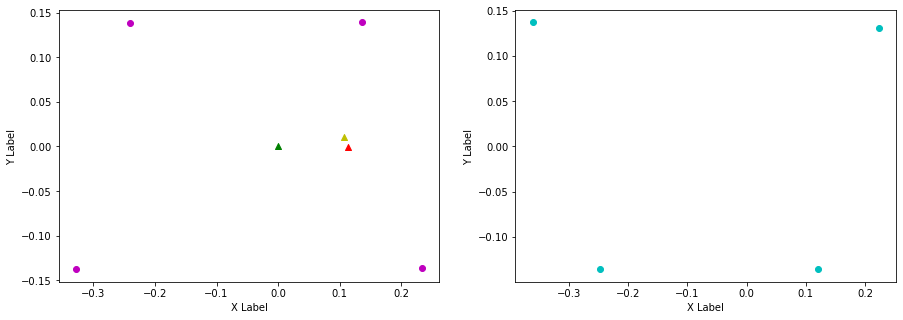

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.223, 0.138, FL (y): 0.131, 0.139.
FL displacement: -0.08499999999999999, 0.008000000000000007.

FR (x): 0.121, 0.235, FR (y): -0.135, -0.135.
FR displacement: 0.11399999999999999, 0.0.

RL (x): -0.361, -0.24, RL (y): 0.137, 0.138.
RL displacement: 0.121, 0.0010000000000000009.

RR (x): -0.248, -0.326, RR (y): -0.136, -0.138.
RR displacement: -0.07800000000000001, -0.0020000000000000018.


Base displacement (Foot): [0.08499999999999999, -0.008000000000000007].

Base displacement (Odom): [[0.05040815622273431], [-0.006161310804925435]]. Rotation displacement: 0.6359221034629533.



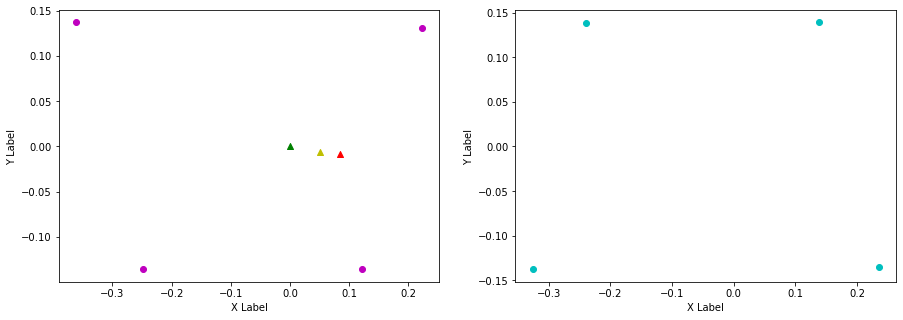

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.138, 0.237, FL (y): 0.139, 0.129.
FL displacement: 0.09899999999999998, -0.010000000000000009.

FR (x): 0.235, 0.156, FR (y): -0.135, -0.139.
FR displacement: -0.07899999999999999, -0.0040000000000000036.

RL (x): -0.24, -0.324, RL (y): 0.138, 0.139.
RL displacement: -0.08400000000000002, 0.0010000000000000009.

RR (x): -0.326, -0.236, RR (y): -0.138, -0.135.
RR displacement: 0.09000000000000002, 0.0030000000000000027.


Base displacement (Foot): [0.07899999999999999, 0.0040000000000000036].

Base displacement (Odom): [[0.07087304843404141], [0.002916118524938227]]. Rotation displacement: -1.4680880444692253.



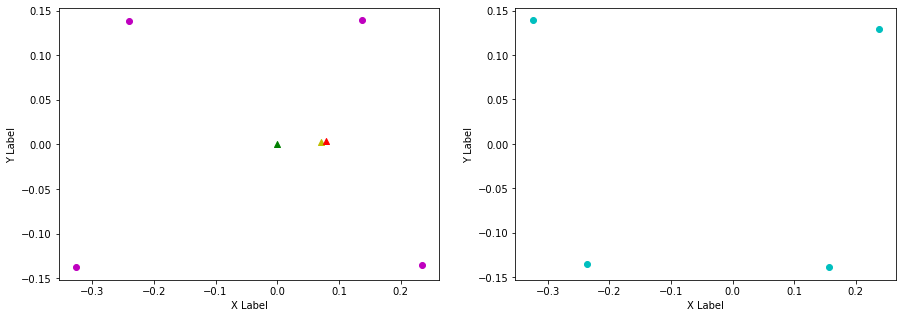

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.237, 0.138, FL (y): 0.129, 0.139.
FL displacement: -0.09899999999999998, 0.010000000000000009.

FR (x): 0.156, 0.236, FR (y): -0.139, -0.135.
FR displacement: 0.07999999999999999, 0.0040000000000000036.

RL (x): -0.324, -0.24, RL (y): 0.139, 0.138.
RL displacement: 0.08400000000000002, -0.0010000000000000009.

RR (x): -0.236, -0.326, RR (y): -0.135, -0.138.
RR displacement: -0.09000000000000002, -0.0030000000000000027.


Base displacement (Foot): [0.09899999999999998, -0.010000000000000009].

Base displacement (Odom): [[0.07656333264099269], [-0.006936917744939208]]. Rotation displacement: 1.5767172803307048.



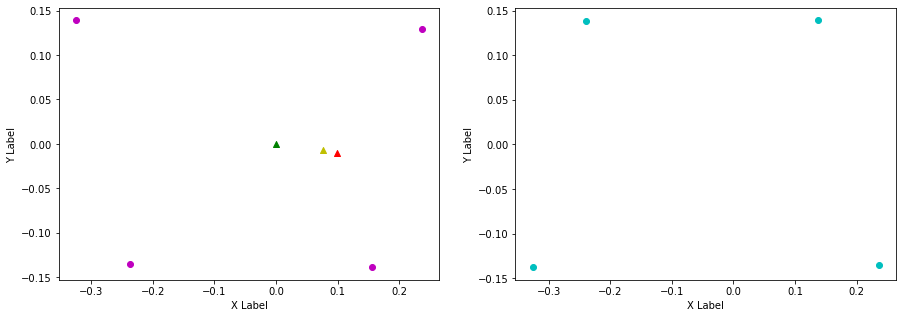

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.138, 0.23, FL (y): 0.139, 0.129.
FL displacement: 0.092, -0.010000000000000009.

FR (x): 0.236, 0.141, FR (y): -0.135, -0.137.
FR displacement: -0.095, -0.0020000000000000018.

RL (x): -0.24, -0.34, RL (y): 0.138, 0.139.
RL displacement: -0.10000000000000003, 0.0010000000000000009.

RR (x): -0.326, -0.243, RR (y): -0.138, -0.136.
RR displacement: 0.08300000000000002, 0.0020000000000000018.


Base displacement (Foot): [0.095, 0.0020000000000000018].

Base displacement (Odom): [[0.10279137950412576], [0.011159350432672355]]. Rotation displacement: -2.156411375050601.



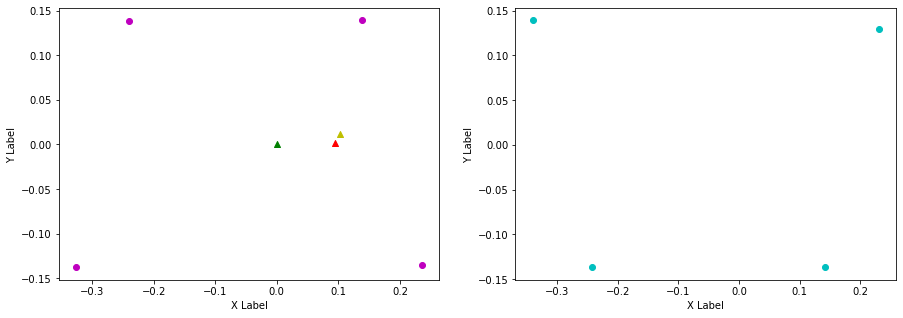

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.23, 0.125, FL (y): 0.129, 0.137.
FL displacement: -0.10500000000000001, 0.008000000000000007.

FR (x): 0.141, 0.226, FR (y): -0.137, -0.137.
FR displacement: 0.08500000000000002, 0.0.

RL (x): -0.34, -0.248, RL (y): 0.139, 0.138.
RL displacement: 0.09200000000000003, -0.0010000000000000009.

RR (x): -0.243, -0.343, RR (y): -0.136, -0.136.
RR displacement: -0.10000000000000003, 0.0.


Base displacement (Foot): [0.10500000000000001, -0.008000000000000007].

Base displacement (Odom): [[0.05052443871261847], [-0.005017232330430943]]. Rotation displacement: 0.3623411804164276.



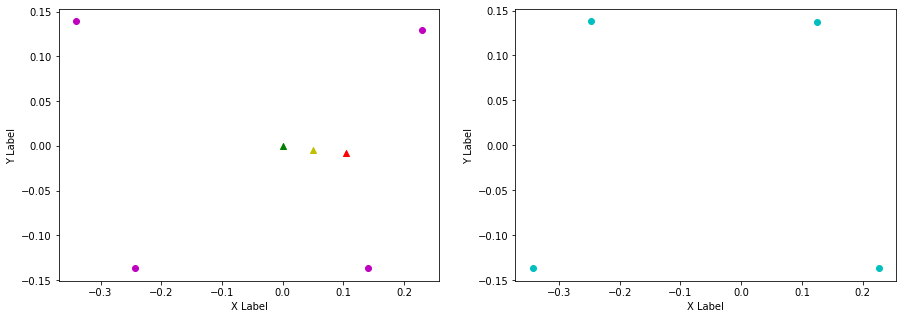

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.125, 0.226, FL (y): 0.137, 0.13.
FL displacement: 0.101, -0.007000000000000006.

FR (x): 0.226, 0.13, FR (y): -0.137, -0.136.
FR displacement: -0.096, 0.0010000000000000009.

RL (x): -0.248, -0.351, RL (y): 0.138, 0.138.
RL displacement: -0.10299999999999998, 0.0.

RR (x): -0.343, -0.246, RR (y): -0.136, -0.136.
RR displacement: 0.09700000000000003, 0.0.


Base displacement (Foot): [0.096, -0.0010000000000000009].

Base displacement (Odom): [[0.10775128314964588], [0.009001239201856137]]. Rotation displacement: -0.5582309387371667.



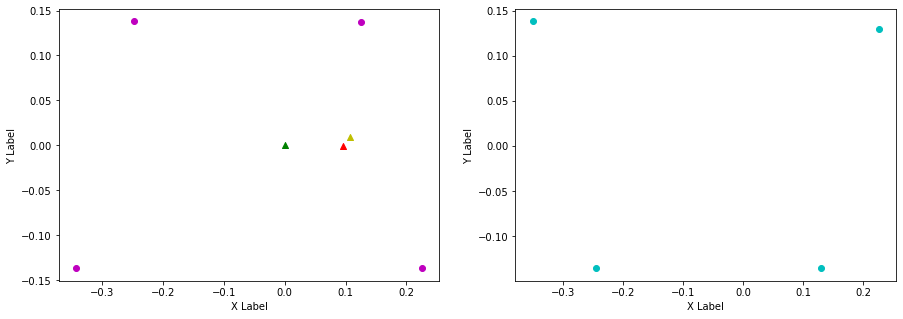

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.226, 0.121, FL (y): 0.13, 0.137.
FL displacement: -0.10500000000000001, 0.007000000000000006.

FR (x): 0.13, 0.224, FR (y): -0.136, -0.136.
FR displacement: 0.094, 0.0.

RL (x): -0.351, -0.25, RL (y): 0.138, 0.138.
RL displacement: 0.10099999999999998, 0.0.

RR (x): -0.246, -0.346, RR (y): -0.136, -0.136.
RR displacement: -0.09999999999999998, 0.0.


Base displacement (Foot): [0.10500000000000001, -0.007000000000000006].

Base displacement (Odom): [[0.08527563133770144], [-0.004995099054831087]]. Rotation displacement: 0.513476968446991.



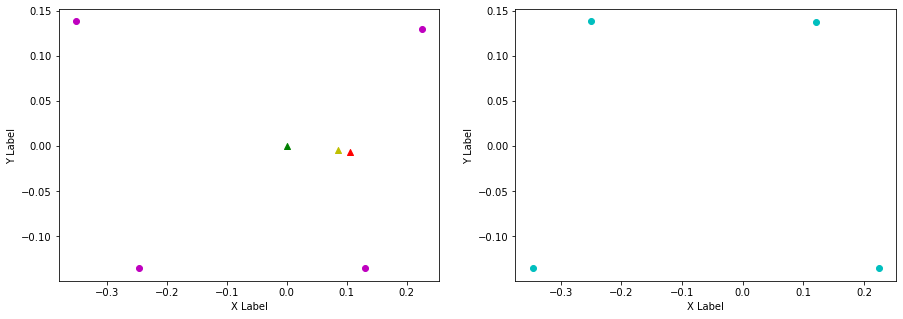

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.121, 0.236, FL (y): 0.137, 0.129.
FL displacement: 0.11499999999999999, -0.008000000000000007.

FR (x): 0.224, 0.156, FR (y): -0.136, -0.138.
FR displacement: -0.068, -0.0020000000000000018.

RL (x): -0.25, -0.326, RL (y): 0.138, 0.138.
RL displacement: -0.07600000000000001, 0.0.

RR (x): -0.346, -0.237, RR (y): -0.136, -0.135.
RR displacement: 0.10899999999999999, 0.0010000000000000009.


Base displacement (Foot): [0.068, 0.0020000000000000018].

Base displacement (Odom): [[0.07661345661220631], [0.004836586718798941]]. Rotation displacement: -1.293309471321718.



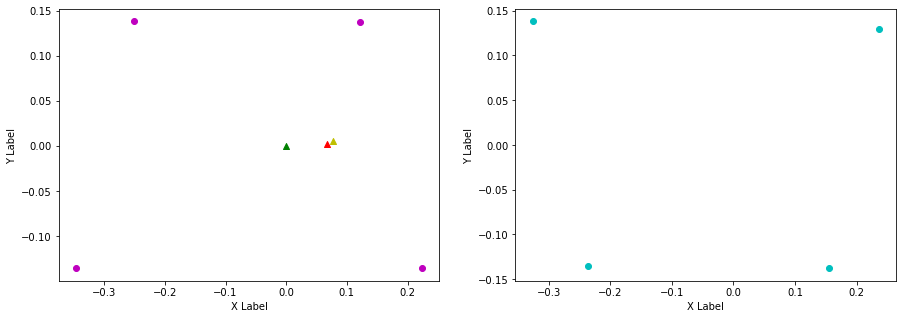

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.236, 0.14, FL (y): 0.129, 0.139.
FL displacement: -0.09599999999999997, 0.010000000000000009.

FR (x): 0.156, 0.237, FR (y): -0.138, -0.135.
FR displacement: 0.08099999999999999, 0.0030000000000000027.

RL (x): -0.326, -0.238, RL (y): 0.138, 0.138.
RL displacement: 0.08800000000000002, 0.0.

RR (x): -0.237, -0.323, RR (y): -0.135, -0.138.
RR displacement: -0.08600000000000002, -0.0030000000000000027.


Base displacement (Foot): [0.09599999999999997, -0.010000000000000009].

Base displacement (Odom): [[0.06362834804587658], [-0.007598454931436294]]. Rotation displacement: 0.7616476054857081.



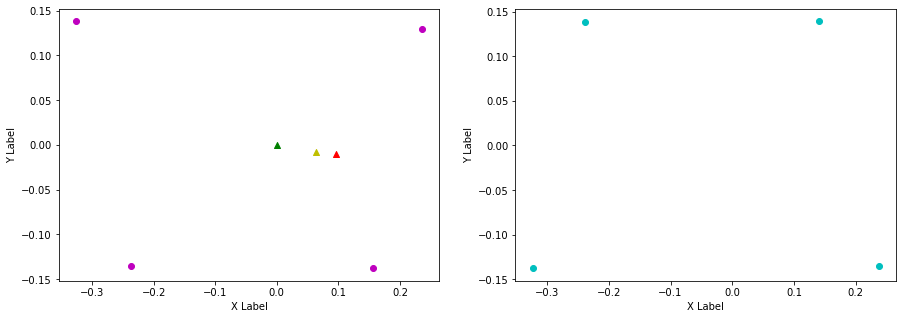

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.14, 0.224, FL (y): 0.139, 0.13.
FL displacement: 0.08399999999999999, -0.009000000000000008.

FR (x): 0.237, 0.126, FR (y): -0.135, -0.135.
FR displacement: -0.11099999999999999, 0.0.

RL (x): -0.238, -0.354, RL (y): 0.138, 0.137.
RL displacement: -0.11599999999999999, -0.0010000000000000009.

RR (x): -0.323, -0.249, RR (y): -0.138, -0.136.
RR displacement: 0.07400000000000001, 0.0020000000000000018.


Base displacement (Foot): [0.11099999999999999, -0.0].

Base displacement (Odom): [[0.09317223688287335], [0.004138965383527093]]. Rotation displacement: -1.7822994715949874.



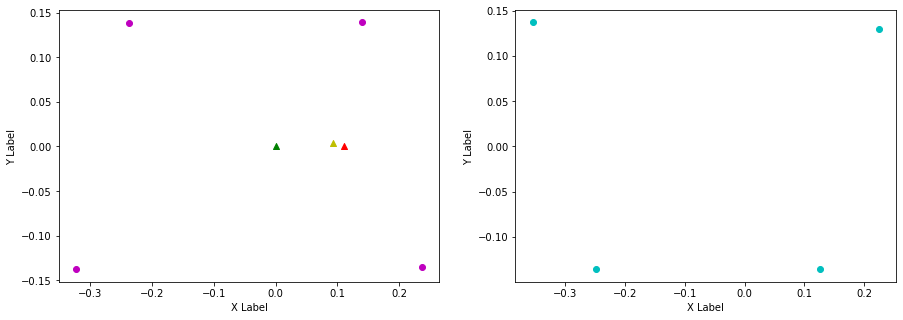

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.224, 0.137, FL (y): 0.13, 0.139.
FL displacement: -0.087, 0.009000000000000008.

FR (x): 0.126, 0.234, FR (y): -0.135, -0.136.
FR displacement: 0.10800000000000001, -0.0010000000000000009.

RL (x): -0.354, -0.241, RL (y): 0.137, 0.138.
RL displacement: 0.11299999999999999, 0.0010000000000000009.

RR (x): -0.249, -0.327, RR (y): -0.136, -0.138.
RR displacement: -0.07800000000000001, -0.0020000000000000018.


Base displacement (Foot): [0.087, -0.009000000000000008].

Base displacement (Odom): [[0.06117972860887155], [-0.008801800356929235]]. Rotation displacement: 1.0531377317333692.



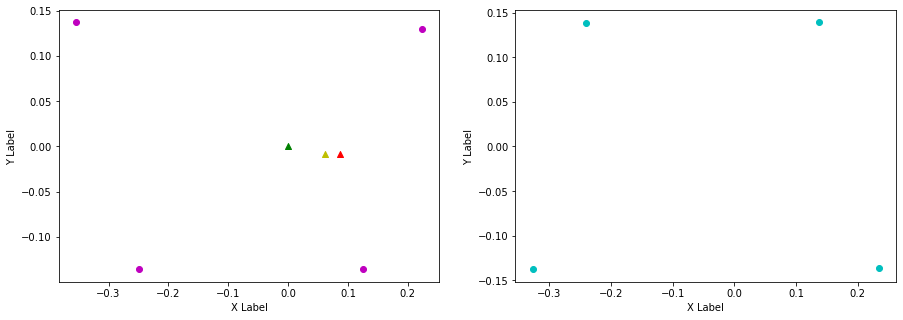

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.137, 0.221, FL (y): 0.139, 0.131.
FL displacement: 0.08399999999999999, -0.008000000000000007.

FR (x): 0.234, 0.122, FR (y): -0.136, -0.135.
FR displacement: -0.11200000000000002, 0.0010000000000000009.

RL (x): -0.241, -0.358, RL (y): 0.138, 0.137.
RL displacement: -0.11699999999999999, -0.0010000000000000009.

RR (x): -0.327, -0.25, RR (y): -0.138, -0.136.
RR displacement: 0.07700000000000001, 0.0020000000000000018.


Base displacement (Foot): [0.11200000000000002, -0.0010000000000000009].

Base displacement (Odom): [[0.07303157378916003], [0.003845028497067915]]. Rotation displacement: -1.8418284921602928.



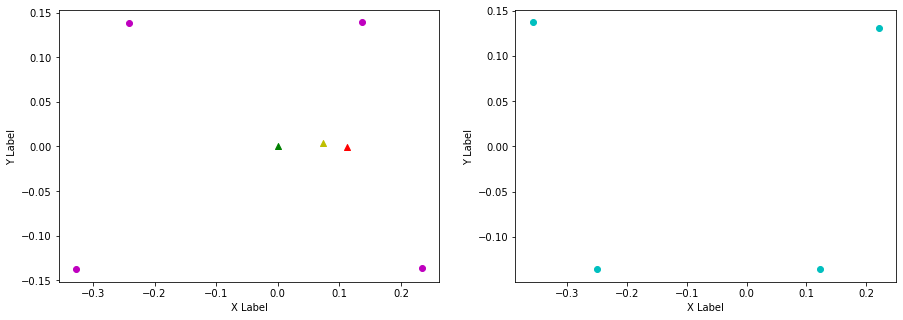

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.221, 0.139, FL (y): 0.131, 0.139.
FL displacement: -0.08199999999999999, 0.008000000000000007.

FR (x): 0.122, 0.237, FR (y): -0.135, -0.135.
FR displacement: 0.11499999999999999, 0.0.

RL (x): -0.358, -0.238, RL (y): 0.137, 0.138.
RL displacement: 0.12, 0.0010000000000000009.

RR (x): -0.25, -0.324, RR (y): -0.136, -0.138.
RR displacement: -0.07400000000000001, -0.0020000000000000018.


Base displacement (Foot): [0.08199999999999999, -0.008000000000000007].

Base displacement (Odom): [[0.05105484887848233], [-0.007521684895502645]]. Rotation displacement: 0.8731925666548204.



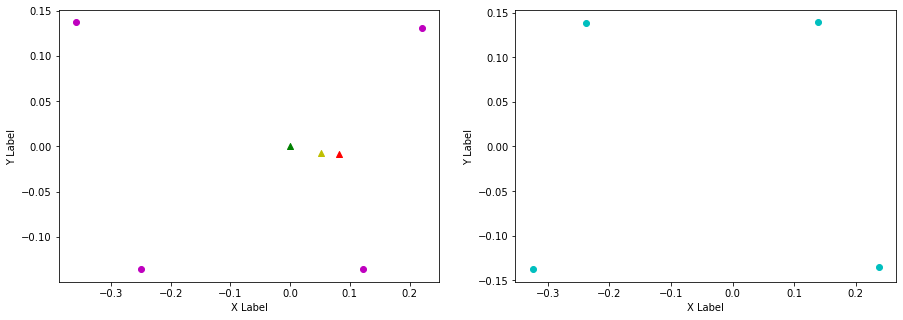

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.139, 0.228, FL (y): 0.139, 0.129.
FL displacement: 0.089, -0.010000000000000009.

FR (x): 0.237, 0.135, FR (y): -0.135, -0.136.
FR displacement: -0.10199999999999998, -0.0010000000000000009.

RL (x): -0.238, -0.346, RL (y): 0.138, 0.138.
RL displacement: -0.10799999999999998, 0.0.

RR (x): -0.324, -0.245, RR (y): -0.138, -0.136.
RR displacement: 0.07900000000000001, 0.0020000000000000018.


Base displacement (Foot): [0.10199999999999998, 0.0010000000000000009].

Base displacement (Odom): [[0.07830381493135308], [0.010230340250240388]]. Rotation displacement: -1.732012862646438.



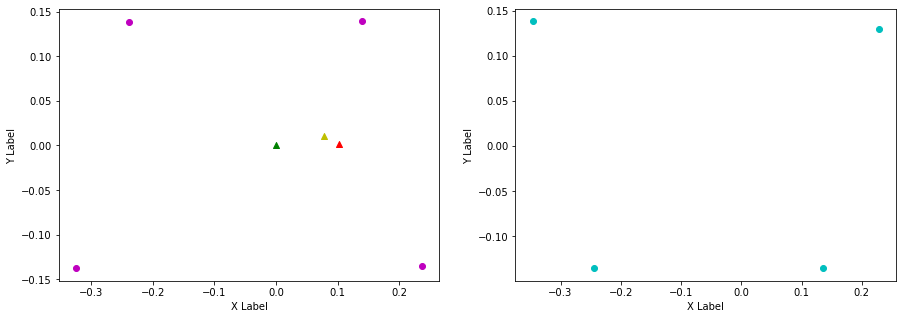

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.228, 0.128, FL (y): 0.129, 0.138.
FL displacement: -0.1, 0.009000000000000008.

FR (x): 0.135, 0.228, FR (y): -0.136, -0.136.
FR displacement: 0.093, 0.0.

RL (x): -0.346, -0.247, RL (y): 0.138, 0.138.
RL displacement: 0.09899999999999998, 0.0.

RR (x): -0.245, -0.338, RR (y): -0.136, -0.137.
RR displacement: -0.09300000000000003, -0.0010000000000000009.


Base displacement (Foot): [0.1, -0.009000000000000008].

Base displacement (Odom): [[0.04404296241545902], [-0.0029804329892240133]]. Rotation displacement: 0.846162269611384.



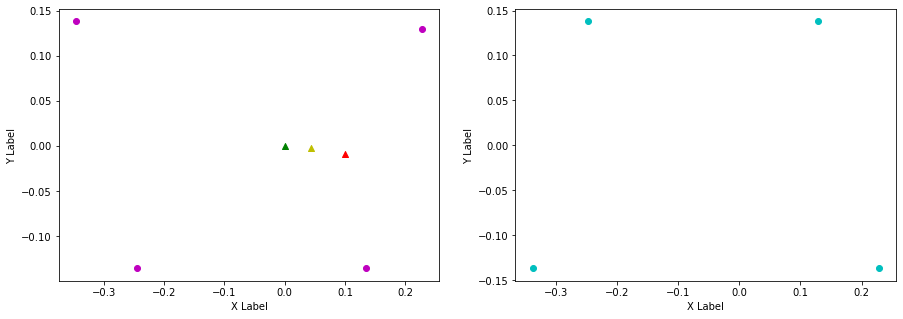

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.128, 0.222, FL (y): 0.138, 0.13.
FL displacement: 0.094, -0.008000000000000007.

FR (x): 0.228, 0.121, FR (y): -0.136, -0.135.
FR displacement: -0.10700000000000001, 0.0010000000000000009.

RL (x): -0.247, -0.359, RL (y): 0.138, 0.137.
RL displacement: -0.11199999999999999, -0.0010000000000000009.

RR (x): -0.338, -0.249, RR (y): -0.137, -0.136.
RR displacement: 0.08900000000000002, 0.0010000000000000009.


Base displacement (Foot): [0.10700000000000001, -0.0010000000000000009].

Base displacement (Odom): [[0.0945778696770807], [0.0071422340816820196]]. Rotation displacement: -1.1735400920957406.



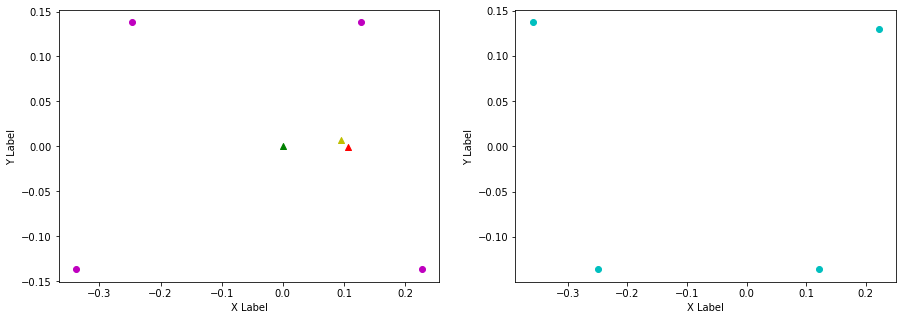

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.222, 0.134, FL (y): 0.13, 0.138.
FL displacement: -0.088, 0.008000000000000007.

FR (x): 0.121, 0.232, FR (y): -0.135, -0.136.
FR displacement: 0.11100000000000002, -0.0010000000000000009.

RL (x): -0.359, -0.243, RL (y): 0.137, 0.138.
RL displacement: 0.11599999999999999, 0.0010000000000000009.

RR (x): -0.249, -0.329, RR (y): -0.136, -0.138.
RR displacement: -0.08000000000000002, -0.0020000000000000018.


Base displacement (Foot): [0.088, -0.008000000000000007].

Base displacement (Odom): [[0.08971145369353817], [-0.010253092063189584]]. Rotation displacement: 0.31114924119290627.



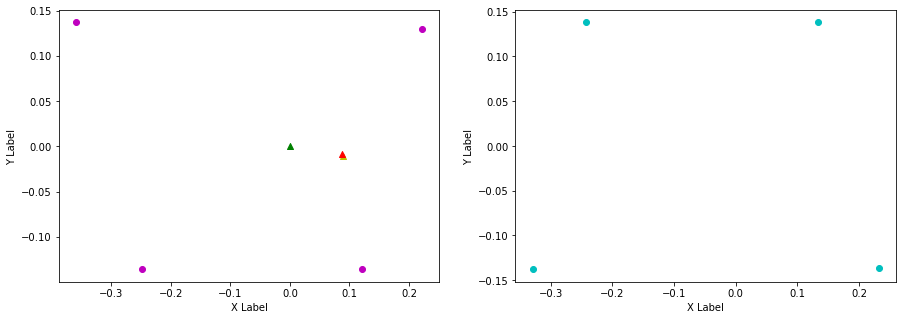

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.134, 0.238, FL (y): 0.138, 0.129.
FL displacement: 0.10399999999999998, -0.009000000000000008.

FR (x): 0.232, 0.155, FR (y): -0.136, -0.138.
FR displacement: -0.07700000000000001, -0.0020000000000000018.

RL (x): -0.243, -0.324, RL (y): 0.138, 0.139.
RL displacement: -0.08100000000000002, 0.0010000000000000009.

RR (x): -0.329, -0.235, RR (y): -0.138, -0.135.
RR displacement: 0.09400000000000003, 0.0030000000000000027.


Base displacement (Foot): [0.07700000000000001, 0.0020000000000000018].

Base displacement (Odom): [[0.051305451992525786], [0.002075295576210223]]. Rotation displacement: -1.1405302884802935.



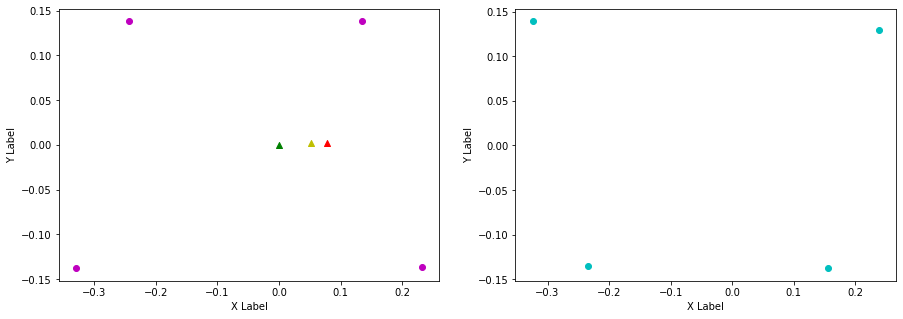

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.238, 0.148, FL (y): 0.129, 0.14.
FL displacement: -0.09, 0.01100000000000001.

FR (x): 0.155, 0.246, FR (y): -0.138, -0.135.
FR displacement: 0.091, 0.0030000000000000027.

RL (x): -0.324, -0.23, RL (y): 0.139, 0.137.
RL displacement: 0.094, -0.0020000000000000018.

RR (x): -0.235, -0.316, RR (y): -0.135, -0.139.
RR displacement: -0.08100000000000002, -0.0040000000000000036.


Base displacement (Foot): [0.09, -0.01100000000000001].

Base displacement (Odom): [[0.10141172606453663], [-0.011065002759043097]]. Rotation displacement: 1.2752836681404924.



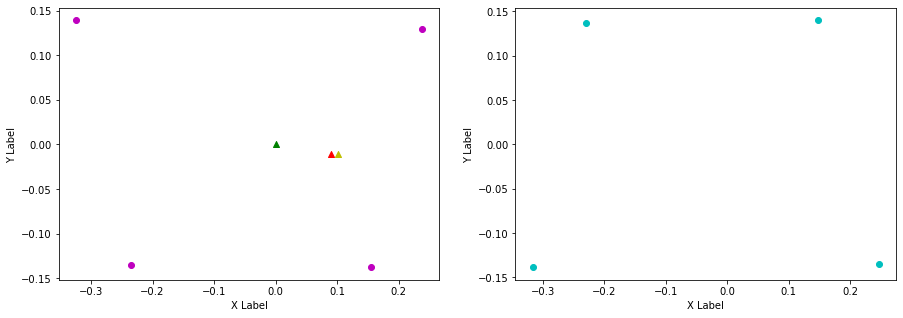

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.148, 0.231, FL (y): 0.14, 0.129.
FL displacement: 0.08300000000000002, -0.01100000000000001.

FR (x): 0.246, 0.149, FR (y): -0.135, -0.137.
FR displacement: -0.097, -0.0020000000000000018.

RL (x): -0.23, -0.334, RL (y): 0.137, 0.139.
RL displacement: -0.10400000000000001, 0.0020000000000000018.

RR (x): -0.316, -0.242, RR (y): -0.139, -0.135.
RR displacement: 0.07400000000000001, 0.0040000000000000036.


Base displacement (Foot): [0.097, 0.0020000000000000018].

Base displacement (Odom): [[0.08430362178416928], [0.004018766701047838]]. Rotation displacement: -2.307193841208983.



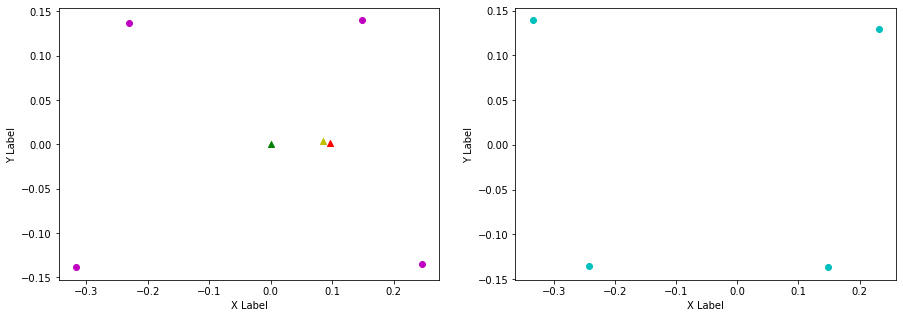

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.231, 0.134, FL (y): 0.129, 0.138.
FL displacement: -0.097, 0.009000000000000008.

FR (x): 0.149, 0.232, FR (y): -0.137, -0.136.
FR displacement: 0.08300000000000002, 0.0010000000000000009.

RL (x): -0.334, -0.243, RL (y): 0.139, 0.138.
RL displacement: 0.09100000000000003, -0.0010000000000000009.

RR (x): -0.242, -0.329, RR (y): -0.135, -0.138.
RR displacement: -0.08700000000000002, -0.0030000000000000027.


Base displacement (Foot): [0.097, -0.009000000000000008].

Base displacement (Odom): [[0.04372955273249968], [-0.00467079587611785]]. Rotation displacement: 0.9474840833801416.



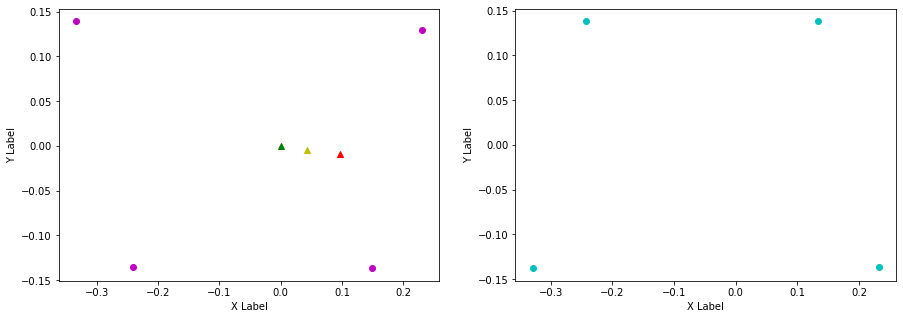

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.134, 0.222, FL (y): 0.138, 0.13.
FL displacement: 0.088, -0.008000000000000007.

FR (x): 0.232, 0.123, FR (y): -0.136, -0.135.
FR displacement: -0.10900000000000001, 0.0010000000000000009.

RL (x): -0.243, -0.361, RL (y): 0.138, 0.137.
RL displacement: -0.118, -0.0010000000000000009.

RR (x): -0.329, -0.249, RR (y): -0.138, -0.136.
RR displacement: 0.08000000000000002, 0.0020000000000000018.


Base displacement (Foot): [0.10900000000000001, -0.0010000000000000009].

Base displacement (Odom): [[0.06446573963234403], [0.002204744161769412]]. Rotation displacement: -1.2065774725183205.



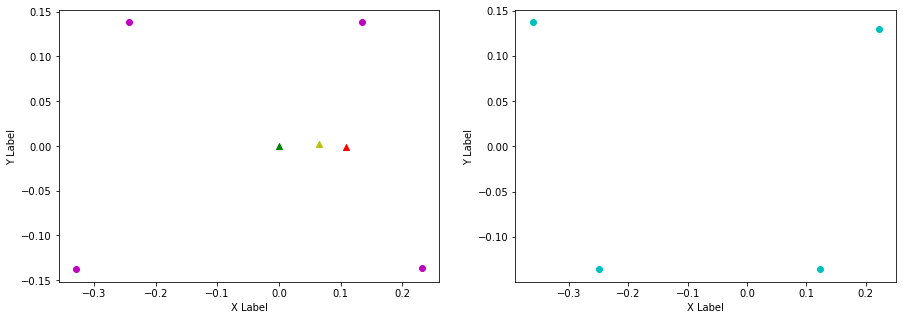

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.222, 0.118, FL (y): 0.13, 0.136.
FL displacement: -0.10400000000000001, 0.006000000000000005.

FR (x): 0.123, 0.222, FR (y): -0.135, -0.136.
FR displacement: 0.099, -0.0010000000000000009.

RL (x): -0.361, -0.252, RL (y): 0.137, 0.139.
RL displacement: 0.10899999999999999, 0.0020000000000000018.

RR (x): -0.249, -0.35, RR (y): -0.136, -0.136.
RR displacement: -0.10099999999999998, 0.0.


Base displacement (Foot): [0.10400000000000001, -0.006000000000000005].

Base displacement (Odom): [[0.057555332740117926], [-0.004706640678726615]]. Rotation displacement: -0.07445620707019779.



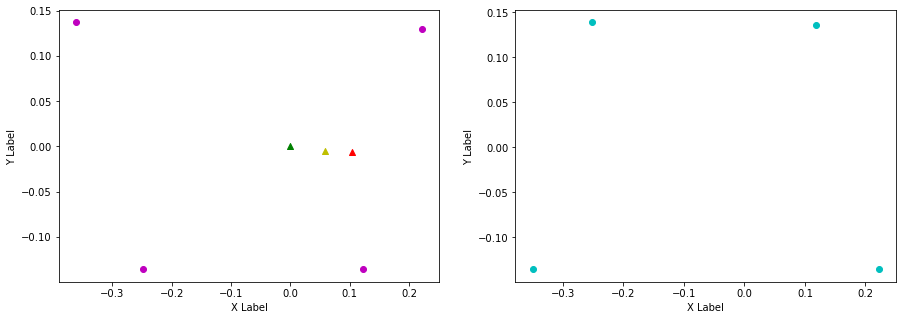

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.118, 0.233, FL (y): 0.136, 0.129.
FL displacement: 0.11500000000000002, -0.007000000000000006.

FR (x): 0.222, 0.155, FR (y): -0.136, -0.137.
FR displacement: -0.067, -0.0010000000000000009.

RL (x): -0.252, -0.329, RL (y): 0.139, 0.138.
RL displacement: -0.07700000000000001, -0.0010000000000000009.

RR (x): -0.35, -0.241, RR (y): -0.136, -0.135.
RR displacement: 0.10899999999999999, 0.0010000000000000009.


Base displacement (Foot): [0.067, 0.0010000000000000009].

Base displacement (Odom): [[0.08733342719606974], [0.008115021134621259]]. Rotation displacement: -0.5865481419700663.



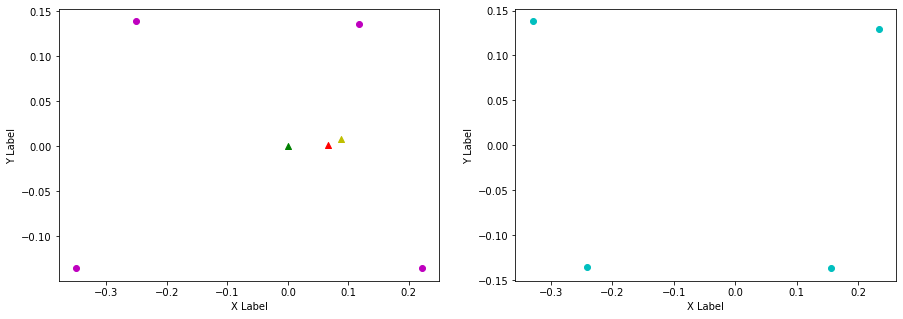

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.233, 0.141, FL (y): 0.129, 0.139.
FL displacement: -0.09200000000000003, 0.010000000000000009.

FR (x): 0.155, 0.239, FR (y): -0.137, -0.135.
FR displacement: 0.08399999999999999, 0.0020000000000000018.

RL (x): -0.329, -0.237, RL (y): 0.138, 0.138.
RL displacement: 0.09200000000000003, 0.0.

RR (x): -0.241, -0.323, RR (y): -0.135, -0.138.
RR displacement: -0.08200000000000002, -0.0030000000000000027.


Base displacement (Foot): [0.09200000000000003, -0.010000000000000009].

Base displacement (Odom): [[0.05477696634422191], [-0.0050581778871165994]]. Rotation displacement: 0.6261031677518397.



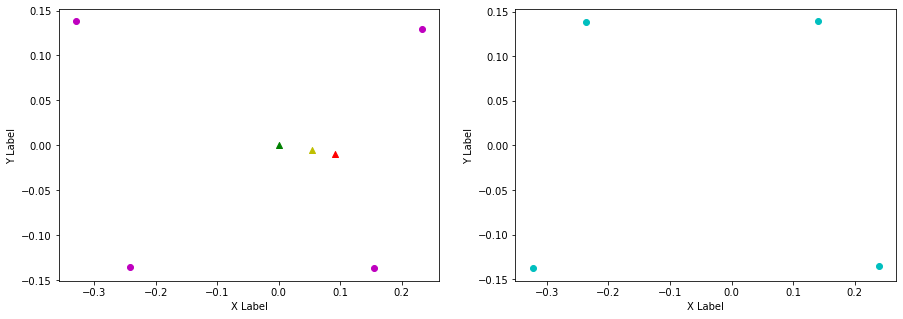

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.141, 0.224, FL (y): 0.139, 0.13.
FL displacement: 0.08300000000000002, -0.009000000000000008.

FR (x): 0.239, 0.126, FR (y): -0.135, -0.135.
FR displacement: -0.11299999999999999, 0.0.

RL (x): -0.237, -0.357, RL (y): 0.138, 0.137.
RL displacement: -0.12, -0.0010000000000000009.

RR (x): -0.323, -0.248, RR (y): -0.138, -0.136.
RR displacement: 0.07500000000000001, 0.0020000000000000018.


Base displacement (Foot): [0.11299999999999999, -0.0].

Base displacement (Odom): [[0.06022005725960655], [0.007347831141789385]]. Rotation displacement: -1.675027367004996.



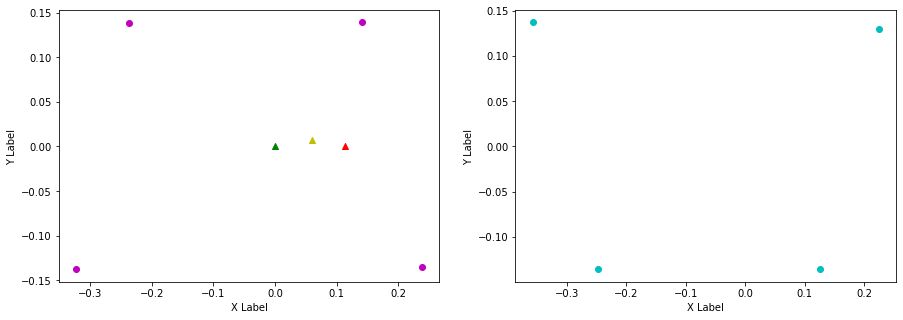

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.224, 0.144, FL (y): 0.13, 0.139.
FL displacement: -0.08000000000000002, 0.009000000000000008.

FR (x): 0.126, 0.242, FR (y): -0.135, -0.135.
FR displacement: 0.11599999999999999, 0.0.

RL (x): -0.357, -0.234, RL (y): 0.137, 0.137.
RL displacement: 0.12299999999999997, 0.0.

RR (x): -0.248, -0.319, RR (y): -0.136, -0.139.
RR displacement: -0.07100000000000001, -0.0030000000000000027.


Base displacement (Foot): [0.08000000000000002, -0.009000000000000008].

Base displacement (Odom): [[0.07213264762214155], [-0.008154627314846508]]. Rotation displacement: 0.47335284692936597.



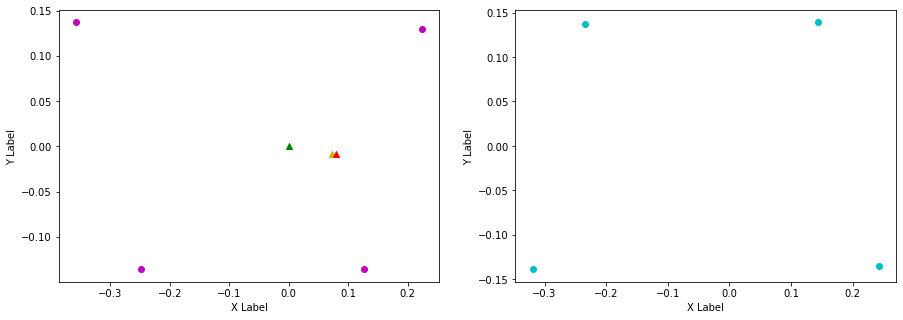

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.144, 0.236, FL (y): 0.139, 0.129.
FL displacement: 0.092, -0.010000000000000009.

FR (x): 0.242, 0.158, FR (y): -0.135, -0.138.
FR displacement: -0.08399999999999999, -0.0030000000000000027.

RL (x): -0.234, -0.326, RL (y): 0.137, 0.138.
RL displacement: -0.092, 0.0010000000000000009.

RR (x): -0.319, -0.238, RR (y): -0.139, -0.135.
RR displacement: 0.08100000000000002, 0.0040000000000000036.


Base displacement (Foot): [0.08399999999999999, 0.0030000000000000027].

Base displacement (Odom): [[0.07738924053220719], [0.009207466244896878]]. Rotation displacement: -1.4332575881673475.



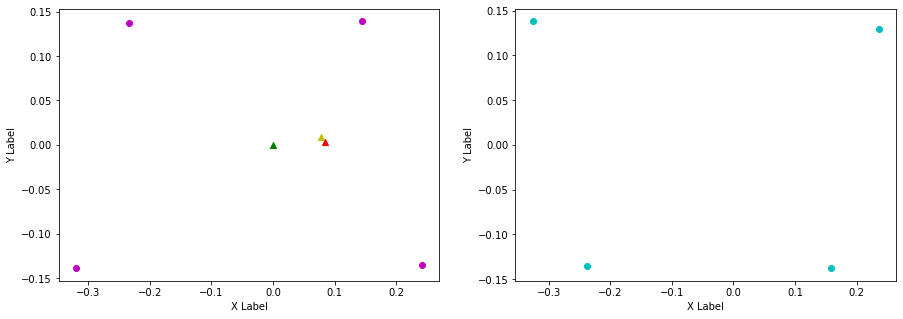

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.236, 0.136, FL (y): 0.129, 0.139.
FL displacement: -0.09999999999999998, 0.010000000000000009.

FR (x): 0.158, 0.234, FR (y): -0.138, -0.135.
FR displacement: 0.07600000000000001, 0.0030000000000000027.

RL (x): -0.326, -0.242, RL (y): 0.138, 0.138.
RL displacement: 0.08400000000000002, 0.0.

RR (x): -0.238, -0.328, RR (y): -0.135, -0.138.
RR displacement: -0.09000000000000002, -0.0030000000000000027.


Base displacement (Foot): [0.09999999999999998, -0.010000000000000009].

Base displacement (Odom): [[0.08567223732867468], [-0.009261245349280856]]. Rotation displacement: 1.4604849570478506.



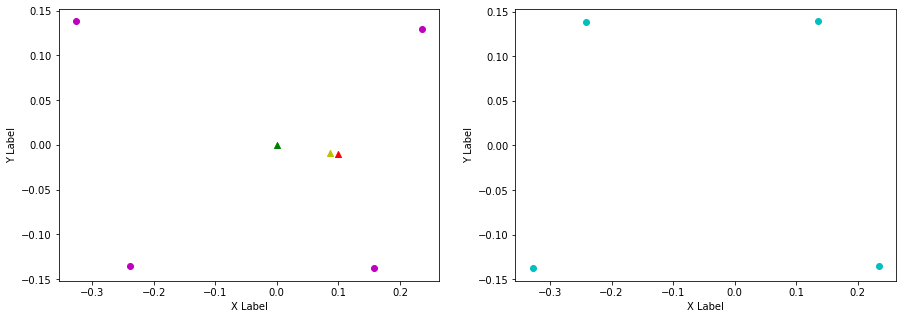

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.136, 0.234, FL (y): 0.139, 0.129.
FL displacement: 0.098, -0.010000000000000009.

FR (x): 0.234, 0.155, FR (y): -0.135, -0.137.
FR displacement: -0.07900000000000001, -0.0020000000000000018.

RL (x): -0.242, -0.328, RL (y): 0.138, 0.138.
RL displacement: -0.08600000000000002, 0.0.

RR (x): -0.328, -0.24, RR (y): -0.138, -0.135.
RR displacement: 0.08800000000000002, 0.0030000000000000027.


Base displacement (Foot): [0.07900000000000001, 0.0020000000000000018].

Base displacement (Odom): [[0.07691066224958565], [0.009305585067343358]]. Rotation displacement: -1.962847493933288.



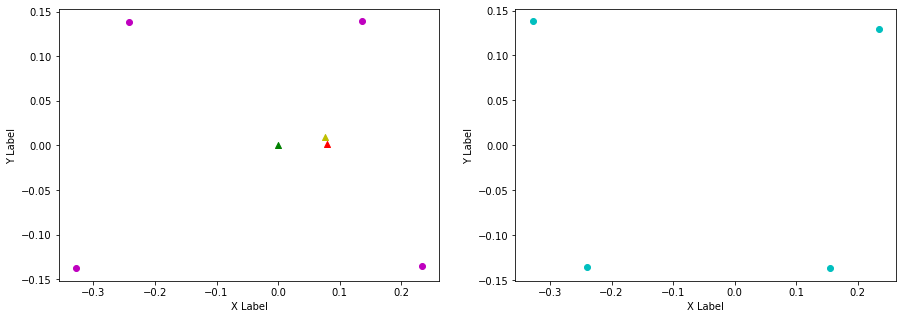

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.234, 0.14, FL (y): 0.129, 0.139.
FL displacement: -0.094, 0.010000000000000009.

FR (x): 0.155, 0.238, FR (y): -0.137, -0.136.
FR displacement: 0.08299999999999999, 0.0010000000000000009.

RL (x): -0.328, -0.238, RL (y): 0.138, 0.137.
RL displacement: 0.09000000000000002, -0.0010000000000000009.

RR (x): -0.24, -0.325, RR (y): -0.135, -0.138.
RR displacement: -0.08500000000000002, -0.0030000000000000027.


Base displacement (Foot): [0.094, -0.010000000000000009].

Base displacement (Odom): [[0.03660139674798124], [-0.004432388052494574]]. Rotation displacement: 1.1200869693127562.



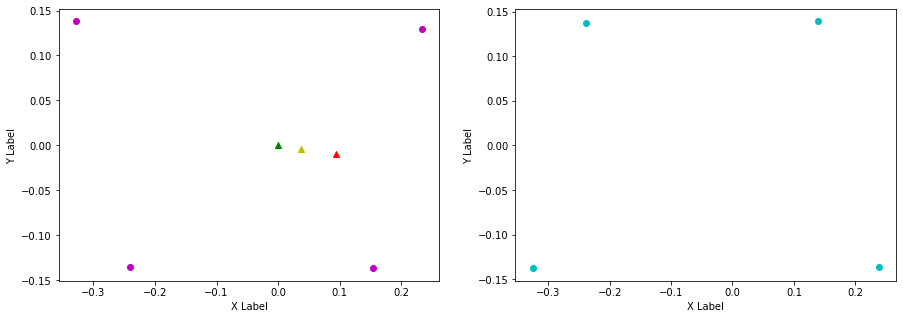

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.14, 0.231, FL (y): 0.139, 0.13.
FL displacement: 0.091, -0.009000000000000008.

FR (x): 0.238, 0.148, FR (y): -0.136, -0.137.
FR displacement: -0.09, -0.0010000000000000009.

RL (x): -0.238, -0.335, RL (y): 0.137, 0.139.
RL displacement: -0.09700000000000003, 0.0020000000000000018.

RR (x): -0.325, -0.242, RR (y): -0.138, -0.136.
RR displacement: 0.08300000000000002, 0.0020000000000000018.


Base displacement (Foot): [0.09, 0.0010000000000000009].

Base displacement (Odom): [[0.06144395112094969], [0.007164658434650306]]. Rotation displacement: -1.9380044983074782.



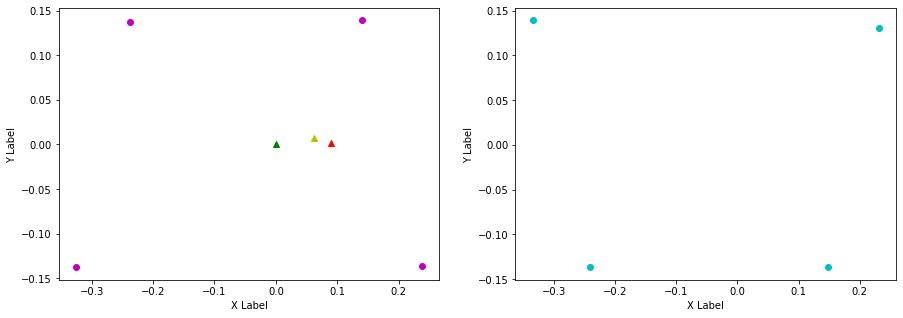

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.231, 0.137, FL (y): 0.13, 0.139.
FL displacement: -0.094, 0.009000000000000008.

FR (x): 0.148, 0.234, FR (y): -0.137, -0.136.
FR displacement: 0.08600000000000002, 0.0010000000000000009.

RL (x): -0.335, -0.241, RL (y): 0.139, 0.138.
RL displacement: 0.09400000000000003, -0.0010000000000000009.

RR (x): -0.242, -0.328, RR (y): -0.136, -0.138.
RR displacement: -0.08600000000000002, -0.0020000000000000018.


Base displacement (Foot): [0.094, -0.009000000000000008].

Base displacement (Odom): [[0.04397392197121963], [-0.005372513077279706]]. Rotation displacement: 0.9988865385297234.



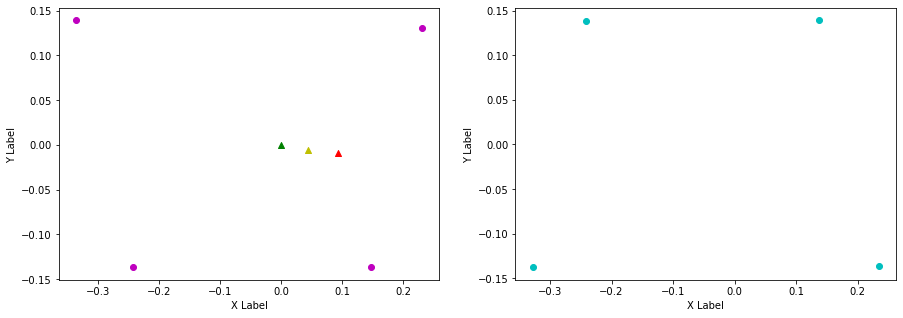

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.137, 0.237, FL (y): 0.139, 0.129.
FL displacement: 0.09999999999999998, -0.010000000000000009.

FR (x): 0.234, 0.156, FR (y): -0.136, -0.139.
FR displacement: -0.07800000000000001, -0.0030000000000000027.

RL (x): -0.241, -0.324, RL (y): 0.138, 0.139.
RL displacement: -0.08300000000000002, 0.0010000000000000009.

RR (x): -0.328, -0.236, RR (y): -0.138, -0.135.
RR displacement: 0.09200000000000003, 0.0030000000000000027.


Base displacement (Foot): [0.07800000000000001, 0.0030000000000000027].

Base displacement (Odom): [[0.06132665406633775], [0.001528367353911264]]. Rotation displacement: -1.7360000469041272.



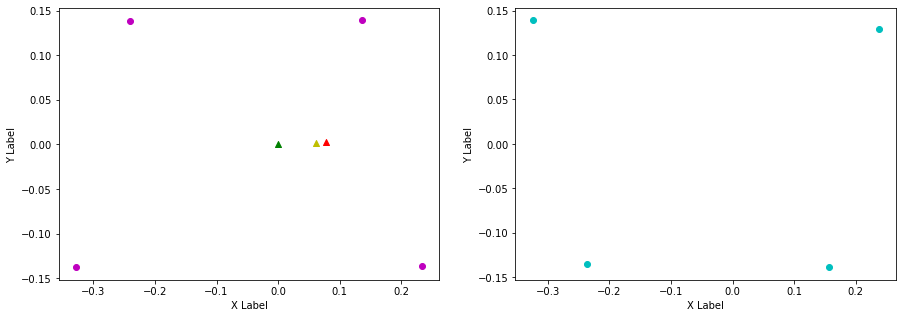

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.119, 0.236, FL (y): 0.136, 0.129.
FL displacement: 0.11699999999999999, -0.007000000000000006.

FR (x): 0.223, 0.156, FR (y): -0.137, -0.138.
FR displacement: -0.067, -0.0010000000000000009.

RL (x): -0.252, -0.326, RL (y): 0.138, 0.138.
RL displacement: -0.07400000000000001, 0.0.

RR (x): -0.351, -0.238, RR (y): -0.136, -0.135.
RR displacement: 0.11299999999999999, 0.0010000000000000009.


Base displacement (Foot): [0.067, 0.0010000000000000009].

Base displacement (Odom): [[0.08326898894525714], [0.006365748122327375]]. Rotation displacement: -0.2244993150496556.



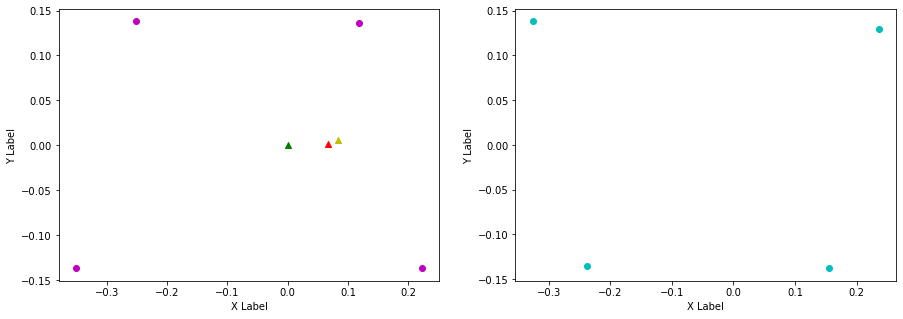

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.236, 0.137, FL (y): 0.129, 0.139.
FL displacement: -0.09899999999999998, 0.010000000000000009.

FR (x): 0.156, 0.234, FR (y): -0.138, -0.136.
FR displacement: 0.07800000000000001, 0.0020000000000000018.

RL (x): -0.326, -0.241, RL (y): 0.138, 0.138.
RL displacement: 0.08500000000000002, 0.0.

RR (x): -0.238, -0.328, RR (y): -0.135, -0.138.
RR displacement: -0.09000000000000002, -0.0030000000000000027.


Base displacement (Foot): [0.09899999999999998, -0.010000000000000009].

Base displacement (Odom): [[0.0567271043291635], [-0.006987974184188062]]. Rotation displacement: 1.135003282598077.



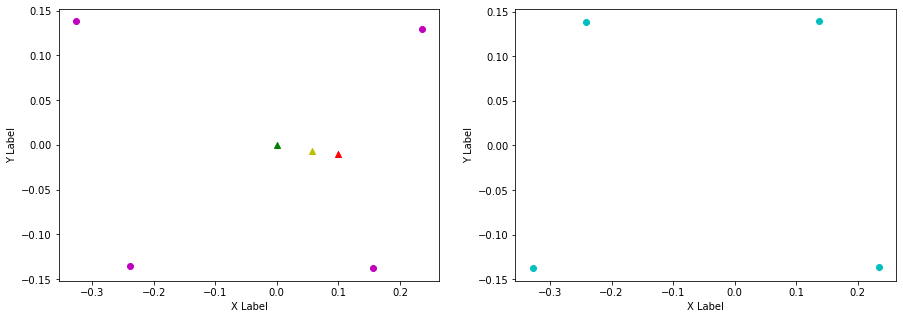

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.137, 0.227, FL (y): 0.139, 0.129.
FL displacement: 0.09, -0.010000000000000009.

FR (x): 0.234, 0.135, FR (y): -0.136, -0.136.
FR displacement: -0.099, 0.0.

RL (x): -0.241, -0.347, RL (y): 0.138, 0.139.
RL displacement: -0.10599999999999998, 0.0010000000000000009.

RR (x): -0.328, -0.246, RR (y): -0.138, -0.136.
RR displacement: 0.08200000000000002, 0.0020000000000000018.


Base displacement (Foot): [0.099, -0.0].

Base displacement (Odom): [[0.08050696233517574], [0.006296183100014119]]. Rotation displacement: -2.1068476179154634.



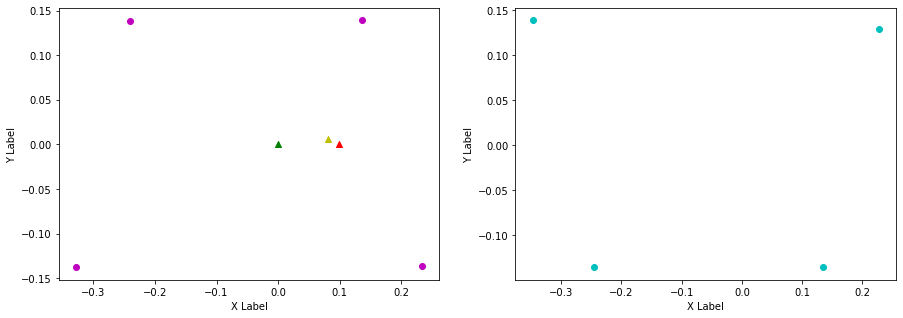

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.227, 0.131, FL (y): 0.129, 0.138.
FL displacement: -0.096, 0.009000000000000008.

FR (x): 0.135, 0.23, FR (y): -0.136, -0.136.
FR displacement: 0.095, 0.0.

RL (x): -0.347, -0.245, RL (y): 0.139, 0.138.
RL displacement: 0.10199999999999998, -0.0010000000000000009.

RR (x): -0.246, -0.334, RR (y): -0.136, -0.137.
RR displacement: -0.08800000000000002, -0.0010000000000000009.


Base displacement (Foot): [0.096, -0.009000000000000008].

Base displacement (Odom): [[0.07680807748970331], [-0.008289596970174173]]. Rotation displacement: 1.0890862714916718.



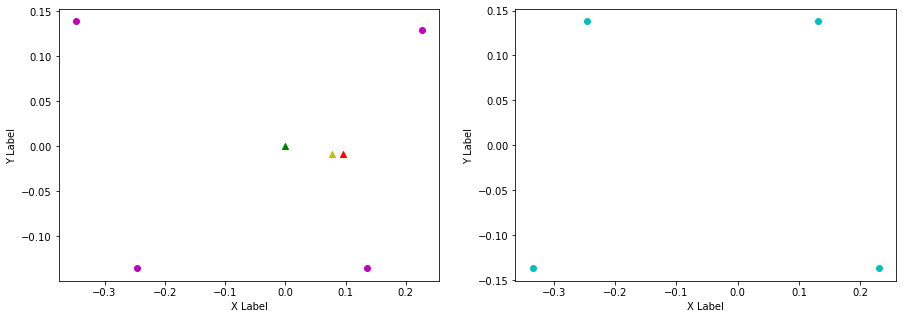

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.131, 0.224, FL (y): 0.138, 0.13.
FL displacement: 0.093, -0.008000000000000007.

FR (x): 0.23, 0.127, FR (y): -0.136, -0.135.
FR displacement: -0.10300000000000001, 0.0010000000000000009.

RL (x): -0.245, -0.357, RL (y): 0.138, 0.138.
RL displacement: -0.11199999999999999, 0.0.

RR (x): -0.334, -0.248, RR (y): -0.137, -0.136.
RR displacement: 0.08600000000000002, 0.0010000000000000009.


Base displacement (Foot): [0.10300000000000001, -0.0010000000000000009].

Base displacement (Odom): [[0.06878892309535001], [0.00992195770593618]]. Rotation displacement: -1.7323939098563068.



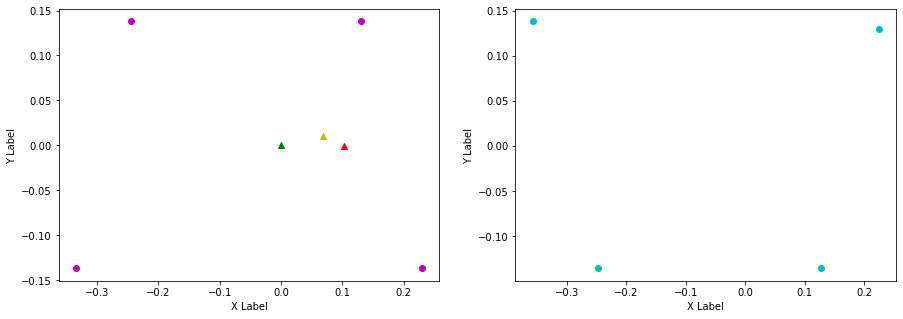

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.224, 0.121, FL (y): 0.13, 0.137.
FL displacement: -0.10300000000000001, 0.007000000000000006.

FR (x): 0.127, 0.224, FR (y): -0.135, -0.136.
FR displacement: 0.097, -0.0010000000000000009.

RL (x): -0.357, -0.25, RL (y): 0.138, 0.138.
RL displacement: 0.10699999999999998, 0.0.

RR (x): -0.248, -0.347, RR (y): -0.136, -0.136.
RR displacement: -0.09899999999999998, 0.0.


Base displacement (Foot): [0.10300000000000001, -0.007000000000000006].

Base displacement (Odom): [[0.047012607675314566], [-0.0026393349045470416]]. Rotation displacement: 0.5003069799169468.



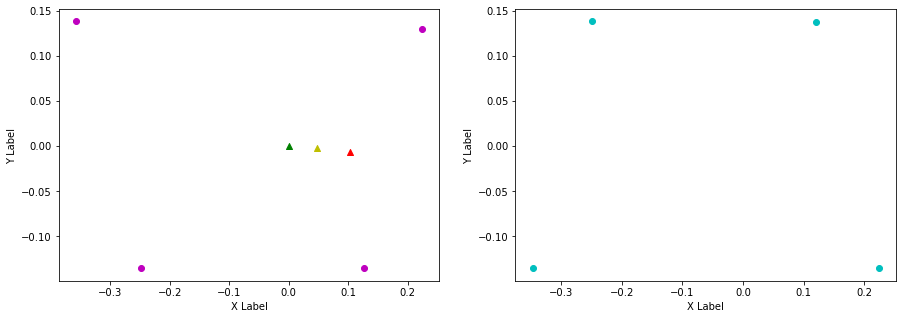

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.121, 0.223, FL (y): 0.137, 0.13.
FL displacement: 0.10200000000000001, -0.007000000000000006.

FR (x): 0.224, 0.121, FR (y): -0.136, -0.135.
FR displacement: -0.10300000000000001, 0.0010000000000000009.

RL (x): -0.25, -0.361, RL (y): 0.138, 0.137.
RL displacement: -0.11099999999999999, -0.0010000000000000009.

RR (x): -0.347, -0.25, RR (y): -0.136, -0.136.
RR displacement: 0.09699999999999998, 0.0.


Base displacement (Foot): [0.10300000000000001, -0.0010000000000000009].

Base displacement (Odom): [[0.07843909325572085], [0.005081720457585703]]. Rotation displacement: -0.8178206176931387.



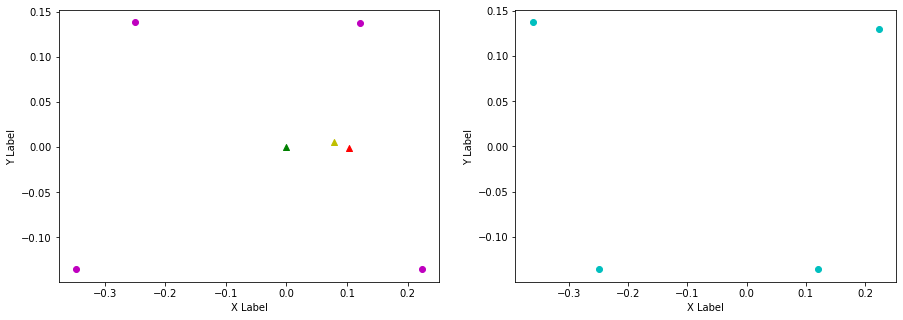

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.223, 0.119, FL (y): 0.13, 0.137.
FL displacement: -0.10400000000000001, 0.007000000000000006.

FR (x): 0.121, 0.223, FR (y): -0.135, -0.137.
FR displacement: 0.10200000000000001, -0.0020000000000000018.

RL (x): -0.361, -0.251, RL (y): 0.137, 0.138.
RL displacement: 0.10999999999999999, 0.0010000000000000009.

RR (x): -0.25, -0.351, RR (y): -0.136, -0.136.
RR displacement: -0.10099999999999998, 0.0.


Base displacement (Foot): [0.10400000000000001, -0.007000000000000006].

Base displacement (Odom): [[0.07803332387489403], [-0.007980281752878682]]. Rotation displacement: -0.4340412536962803.



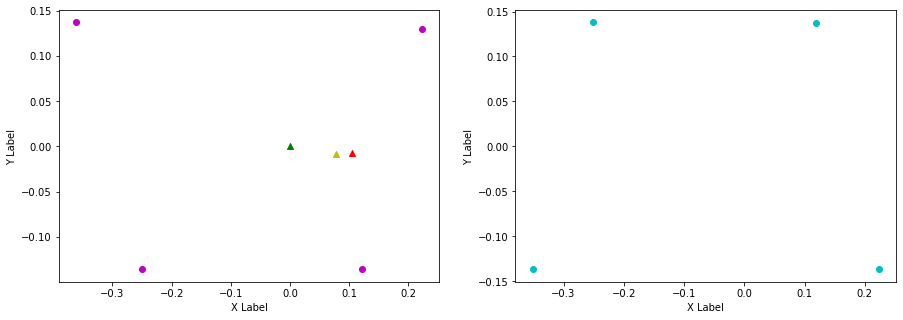

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.119, 0.238, FL (y): 0.137, 0.13.
FL displacement: 0.119, -0.007000000000000006.

FR (x): 0.223, 0.156, FR (y): -0.137, -0.138.
FR displacement: -0.067, -0.0010000000000000009.

RL (x): -0.251, -0.324, RL (y): 0.138, 0.139.
RL displacement: -0.07300000000000001, 0.0010000000000000009.

RR (x): -0.351, -0.235, RR (y): -0.136, -0.135.
RR displacement: 0.11599999999999999, 0.0010000000000000009.


Base displacement (Foot): [0.067, 0.0010000000000000009].

Base displacement (Odom): [[0.09315413100246328], [0.00946495653250956]]. Rotation displacement: -0.37529511583918373.



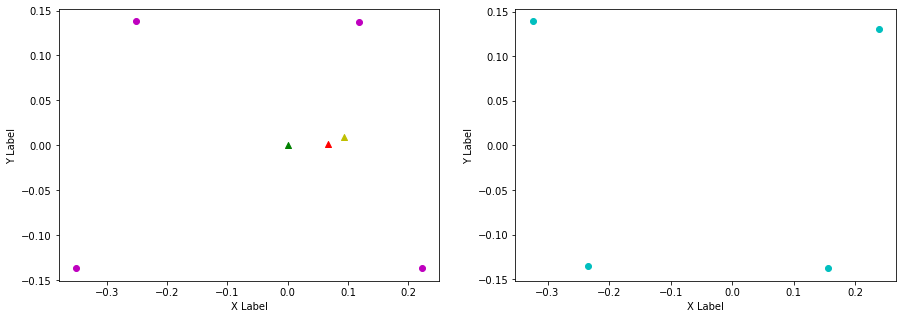

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.238, 0.139, FL (y): 0.13, 0.139.
FL displacement: -0.09899999999999998, 0.009000000000000008.

FR (x): 0.156, 0.236, FR (y): -0.138, -0.136.
FR displacement: 0.07999999999999999, 0.0020000000000000018.

RL (x): -0.324, -0.24, RL (y): 0.139, 0.138.
RL displacement: 0.08400000000000002, -0.0010000000000000009.

RR (x): -0.235, -0.326, RR (y): -0.135, -0.138.
RR displacement: -0.09100000000000003, -0.0030000000000000027.


Base displacement (Foot): [0.09899999999999998, -0.009000000000000008].

Base displacement (Odom): [[0.08469326316639547], [-0.006342907006265719]]. Rotation displacement: 1.0901925085357373.



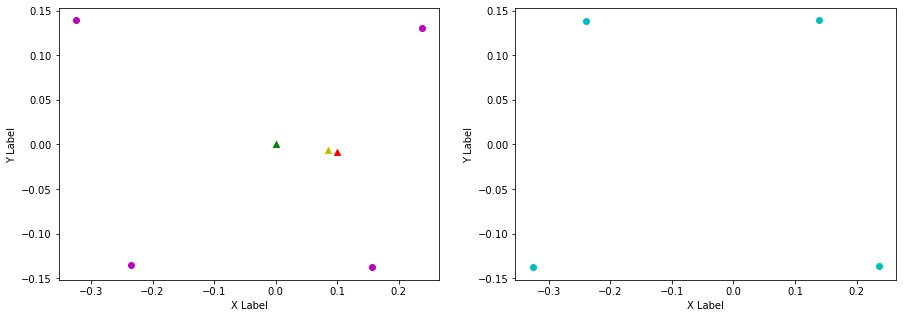

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.139, 0.227, FL (y): 0.139, 0.129.
FL displacement: 0.088, -0.010000000000000009.

FR (x): 0.236, 0.135, FR (y): -0.136, -0.135.
FR displacement: -0.10099999999999998, 0.0010000000000000009.

RL (x): -0.24, -0.347, RL (y): 0.138, 0.138.
RL displacement: -0.10699999999999998, 0.0.

RR (x): -0.326, -0.246, RR (y): -0.138, -0.136.
RR displacement: 0.08000000000000002, 0.0020000000000000018.


Base displacement (Foot): [0.10099999999999998, -0.0010000000000000009].

Base displacement (Odom): [[0.07734054024253867], [0.010071947416694371]]. Rotation displacement: -2.2207463518765835.



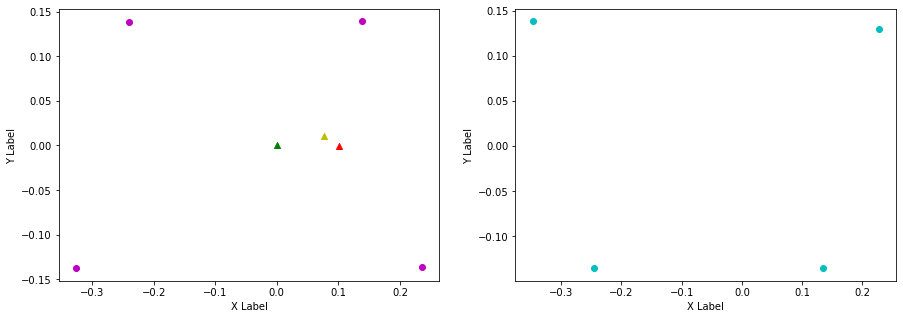

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.227, 0.142, FL (y): 0.129, 0.139.
FL displacement: -0.08500000000000002, 0.010000000000000009.

FR (x): 0.135, 0.239, FR (y): -0.135, -0.135.
FR displacement: 0.10399999999999998, 0.0.

RL (x): -0.347, -0.237, RL (y): 0.138, 0.138.
RL displacement: 0.10999999999999999, 0.0.

RR (x): -0.246, -0.323, RR (y): -0.136, -0.138.
RR displacement: -0.07700000000000001, -0.0020000000000000018.


Base displacement (Foot): [0.08500000000000002, -0.010000000000000009].

Base displacement (Odom): [[0.08997968319241689], [-0.009683381930846835]]. Rotation displacement: 1.0550373171246132.



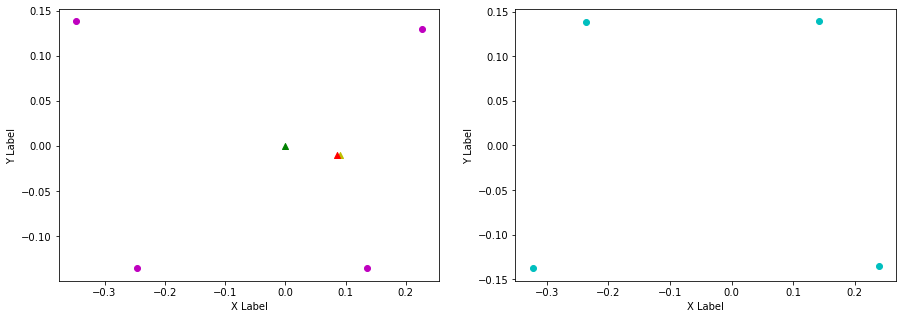

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.142, 0.231, FL (y): 0.139, 0.129.
FL displacement: 0.08900000000000002, -0.010000000000000009.

FR (x): 0.239, 0.15, FR (y): -0.135, -0.136.
FR displacement: -0.089, -0.0010000000000000009.

RL (x): -0.237, -0.335, RL (y): 0.138, 0.139.
RL displacement: -0.09800000000000003, 0.0010000000000000009.

RR (x): -0.323, -0.242, RR (y): -0.138, -0.136.
RR displacement: 0.08100000000000002, 0.0020000000000000018.


Base displacement (Foot): [0.089, 0.0010000000000000009].

Base displacement (Odom): [[0.06881263053939124], [0.009583170740278035]]. Rotation displacement: -1.8281191215526125.



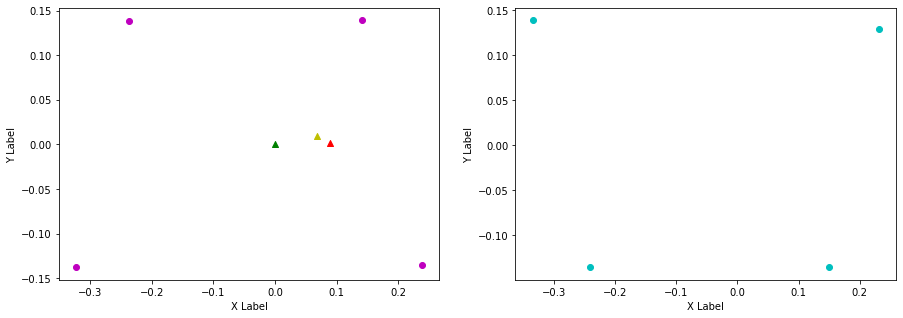

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.231, 0.134, FL (y): 0.129, 0.138.
FL displacement: -0.097, 0.009000000000000008.

FR (x): 0.15, 0.232, FR (y): -0.136, -0.136.
FR displacement: 0.08200000000000002, 0.0.

RL (x): -0.335, -0.243, RL (y): 0.139, 0.138.
RL displacement: 0.09200000000000003, -0.0010000000000000009.

RR (x): -0.242, -0.331, RR (y): -0.136, -0.138.
RR displacement: -0.08900000000000002, -0.0020000000000000018.


Base displacement (Foot): [0.097, -0.009000000000000008].

Base displacement (Odom): [[0.08103359376807884], [-0.006829793896834246]]. Rotation displacement: 1.1956396343399622.



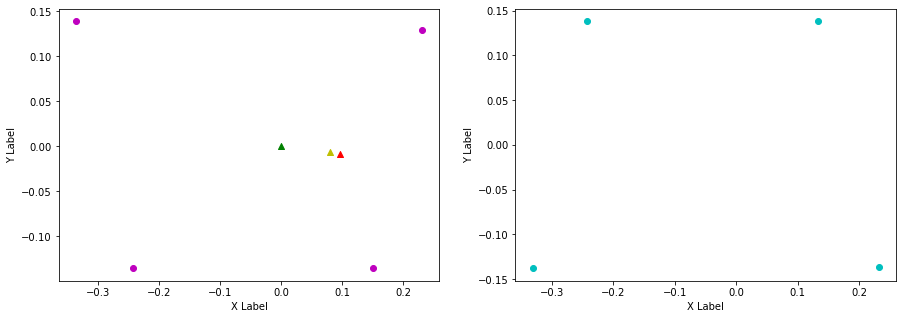

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.134, 0.23, FL (y): 0.138, 0.129.
FL displacement: 0.096, -0.009000000000000008.

FR (x): 0.232, 0.141, FR (y): -0.136, -0.136.
FR displacement: -0.09100000000000003, 0.0.

RL (x): -0.243, -0.341, RL (y): 0.138, 0.139.
RL displacement: -0.09800000000000003, 0.0010000000000000009.

RR (x): -0.331, -0.244, RR (y): -0.138, -0.136.
RR displacement: 0.08700000000000002, 0.0020000000000000018.


Base displacement (Foot): [0.09100000000000003, -0.0].

Base displacement (Odom): [[0.07025248905408743], [0.007166485724241056]]. Rotation displacement: -1.5784389195664326.



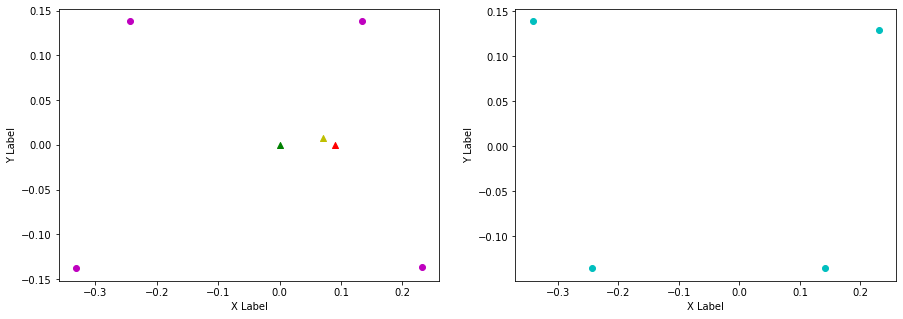

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.23, 0.136, FL (y): 0.129, 0.139.
FL displacement: -0.094, 0.010000000000000009.

FR (x): 0.141, 0.233, FR (y): -0.136, -0.136.
FR displacement: 0.09200000000000003, 0.0.

RL (x): -0.341, -0.243, RL (y): 0.139, 0.138.
RL displacement: 0.09800000000000003, -0.0010000000000000009.

RR (x): -0.244, -0.331, RR (y): -0.136, -0.138.
RR displacement: -0.08700000000000002, -0.0020000000000000018.


Base displacement (Foot): [0.094, -0.010000000000000009].

Base displacement (Odom): [[0.0670248444864725], [-0.007374782613515762]]. Rotation displacement: 0.6913320909304121.



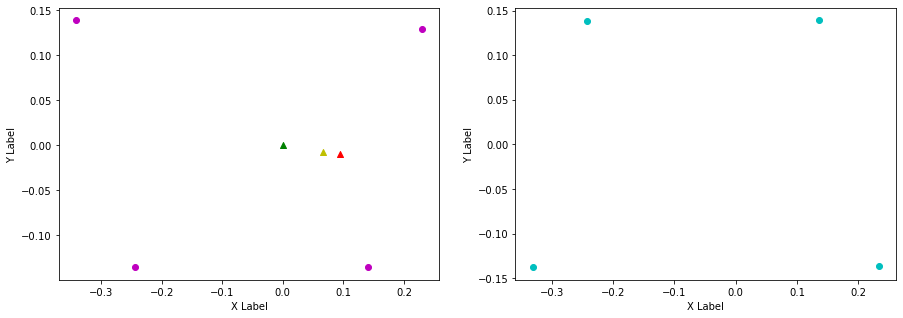

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.136, 0.235, FL (y): 0.139, 0.13.
FL displacement: 0.09899999999999998, -0.009000000000000008.

FR (x): 0.233, 0.156, FR (y): -0.136, -0.138.
FR displacement: -0.07700000000000001, -0.0020000000000000018.

RL (x): -0.243, -0.327, RL (y): 0.138, 0.139.
RL displacement: -0.08400000000000002, 0.0010000000000000009.

RR (x): -0.331, -0.239, RR (y): -0.138, -0.136.
RR displacement: 0.09200000000000003, 0.0020000000000000018.


Base displacement (Foot): [0.07700000000000001, 0.0020000000000000018].

Base displacement (Odom): [[0.01971830574179445], [0.006473712266055642]]. Rotation displacement: -1.7042283356296577.



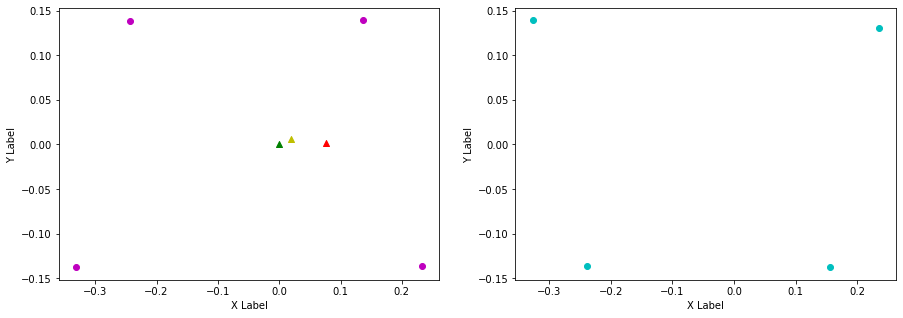

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.235, 0.128, FL (y): 0.13, 0.138.
FL displacement: -0.10699999999999998, 0.008000000000000007.

FR (x): 0.156, 0.229, FR (y): -0.138, -0.137.
FR displacement: 0.07300000000000001, 0.0010000000000000009.

RL (x): -0.327, -0.247, RL (y): 0.139, 0.138.
RL displacement: 0.08000000000000002, -0.0010000000000000009.

RR (x): -0.239, -0.34, RR (y): -0.136, -0.137.
RR displacement: -0.10100000000000003, -0.0010000000000000009.


Base displacement (Foot): [0.10699999999999998, -0.008000000000000007].

Base displacement (Odom): [[0.07256104926468465], [-0.008015706061996752]]. Rotation displacement: 0.8953699476561692.



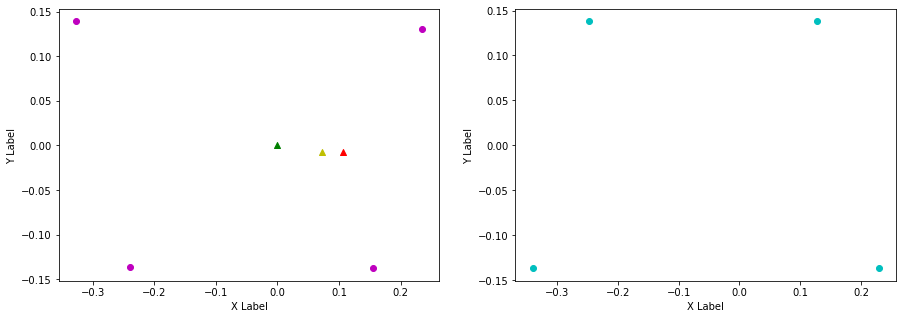

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.128, 0.223, FL (y): 0.138, 0.131.
FL displacement: 0.095, -0.007000000000000006.

FR (x): 0.229, 0.122, FR (y): -0.137, -0.135.
FR displacement: -0.10700000000000001, 0.0020000000000000018.

RL (x): -0.247, -0.361, RL (y): 0.138, 0.137.
RL displacement: -0.11399999999999999, -0.0010000000000000009.

RR (x): -0.34, -0.25, RR (y): -0.137, -0.137.
RR displacement: 0.09000000000000002, 0.0.


Base displacement (Foot): [0.10700000000000001, -0.0020000000000000018].

Base displacement (Odom): [[0.1236551667978778], [0.005646667962803775]]. Rotation displacement: -1.2442727399414881.



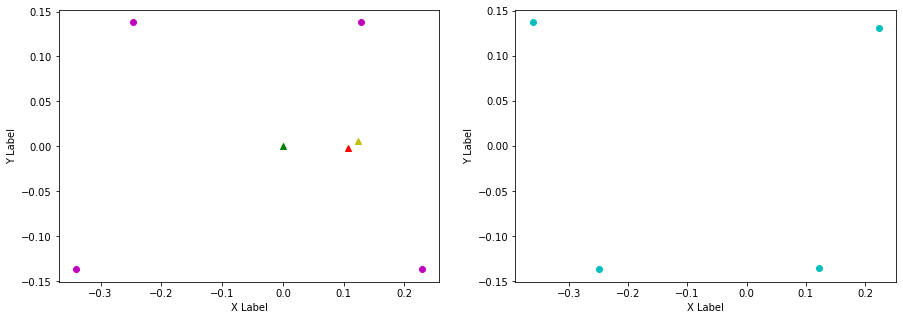

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.223, 0.125, FL (y): 0.131, 0.137.
FL displacement: -0.098, 0.006000000000000005.

FR (x): 0.122, 0.227, FR (y): -0.135, -0.136.
FR displacement: 0.10500000000000001, -0.0010000000000000009.

RL (x): -0.361, -0.248, RL (y): 0.137, 0.138.
RL displacement: 0.11299999999999999, 0.0010000000000000009.

RR (x): -0.25, -0.344, RR (y): -0.137, -0.137.
RR displacement: -0.09399999999999997, 0.0.


Base displacement (Foot): [0.098, -0.006000000000000005].

Base displacement (Odom): [[0.06521800180685067], [-0.007003172821050896]]. Rotation displacement: 0.2797464309785392.



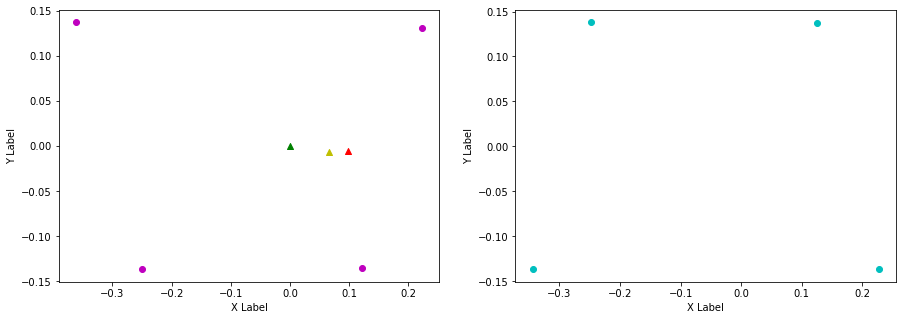

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.125, 0.228, FL (y): 0.137, 0.129.
FL displacement: 0.10300000000000001, -0.008000000000000007.

FR (x): 0.227, 0.137, FR (y): -0.136, -0.135.
FR displacement: -0.09, 0.0010000000000000009.

RL (x): -0.248, -0.347, RL (y): 0.138, 0.139.
RL displacement: -0.09899999999999998, 0.0010000000000000009.

RR (x): -0.344, -0.246, RR (y): -0.137, -0.137.
RR displacement: 0.09799999999999998, 0.0.


Base displacement (Foot): [0.09, -0.0010000000000000009].

Base displacement (Odom): [[0.10058935254632906], [0.012261044096536722]]. Rotation displacement: -1.0862580997116573.



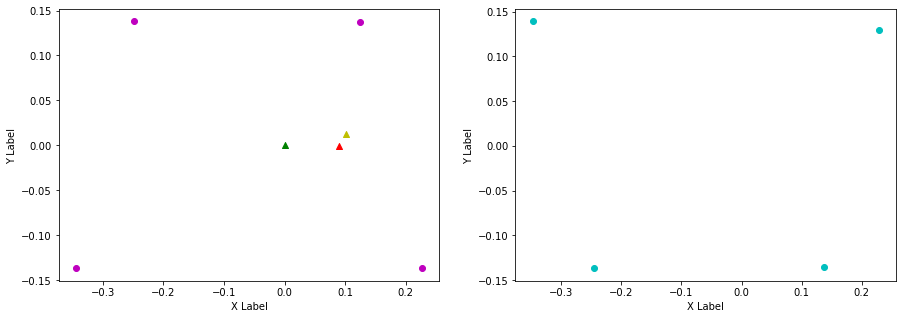

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.228, 0.125, FL (y): 0.129, 0.137.
FL displacement: -0.10300000000000001, 0.008000000000000007.

FR (x): 0.137, 0.227, FR (y): -0.135, -0.137.
FR displacement: 0.09, -0.0020000000000000018.

RL (x): -0.347, -0.248, RL (y): 0.139, 0.138.
RL displacement: 0.09899999999999998, -0.0010000000000000009.

RR (x): -0.246, -0.344, RR (y): -0.137, -0.137.
RR displacement: -0.09799999999999998, 0.0.


Base displacement (Foot): [0.10300000000000001, -0.008000000000000007].

Base displacement (Odom): [[0.06440540700965047], [-0.0052550148773509164]]. Rotation displacement: 0.95709365191796.



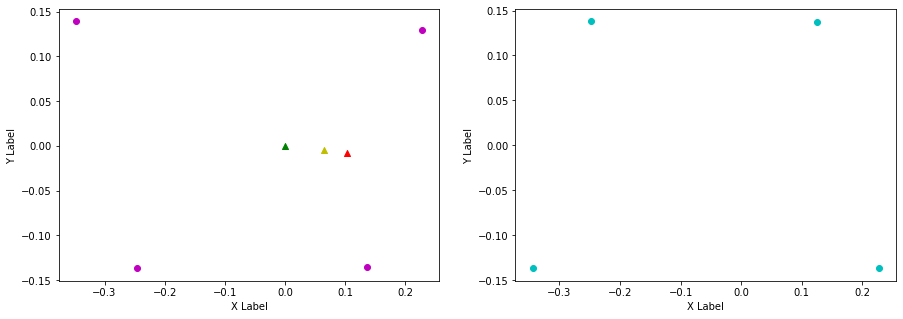

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.125, 0.236, FL (y): 0.137, 0.13.
FL displacement: 0.11099999999999999, -0.007000000000000006.

FR (x): 0.227, 0.156, FR (y): -0.137, -0.138.
FR displacement: -0.07100000000000001, -0.0010000000000000009.

RL (x): -0.248, -0.326, RL (y): 0.138, 0.139.
RL displacement: -0.07800000000000001, 0.0010000000000000009.

RR (x): -0.344, -0.238, RR (y): -0.137, -0.136.
RR displacement: 0.10599999999999998, 0.0010000000000000009.


Base displacement (Foot): [0.07100000000000001, 0.0010000000000000009].

Base displacement (Odom): [[0.07822824441567233], [0.010472093725768516]]. Rotation displacement: -1.476649626949454.



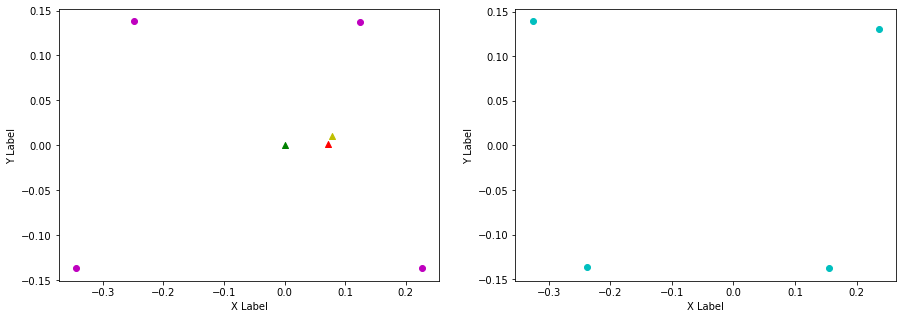

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.236, 0.14, FL (y): 0.13, 0.139.
FL displacement: -0.09599999999999997, 0.009000000000000008.

FR (x): 0.156, 0.238, FR (y): -0.138, -0.136.
FR displacement: 0.08199999999999999, 0.0020000000000000018.

RL (x): -0.326, -0.238, RL (y): 0.139, 0.138.
RL displacement: 0.08800000000000002, -0.0010000000000000009.

RR (x): -0.238, -0.326, RR (y): -0.136, -0.138.
RR displacement: -0.08800000000000002, -0.0020000000000000018.


Base displacement (Foot): [0.09599999999999997, -0.009000000000000008].

Base displacement (Odom): [[0.08775170465998894], [-0.008879378039349461]]. Rotation displacement: 0.9984661370417091.



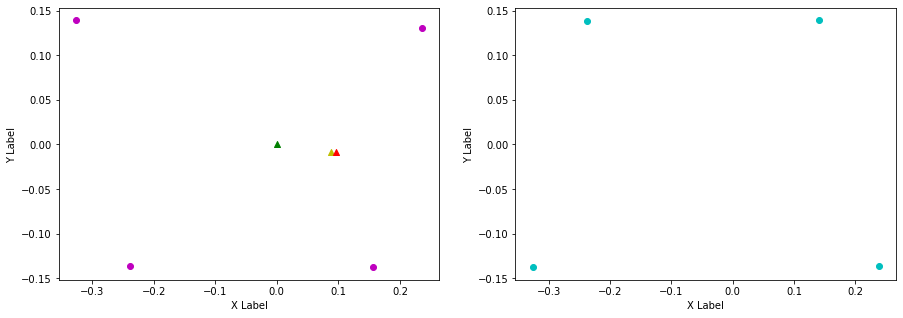

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.14, 0.227, FL (y): 0.139, 0.13.
FL displacement: 0.087, -0.009000000000000008.

FR (x): 0.238, 0.131, FR (y): -0.136, -0.135.
FR displacement: -0.10699999999999998, 0.0010000000000000009.

RL (x): -0.238, -0.353, RL (y): 0.138, 0.138.
RL displacement: -0.11499999999999999, 0.0.

RR (x): -0.326, -0.246, RR (y): -0.138, -0.137.
RR displacement: 0.08000000000000002, 0.0010000000000000009.


Base displacement (Foot): [0.10699999999999998, -0.0010000000000000009].

Base displacement (Odom): [[0.0824522554724938], [0.009984796947545505]]. Rotation displacement: -1.761541267967003.



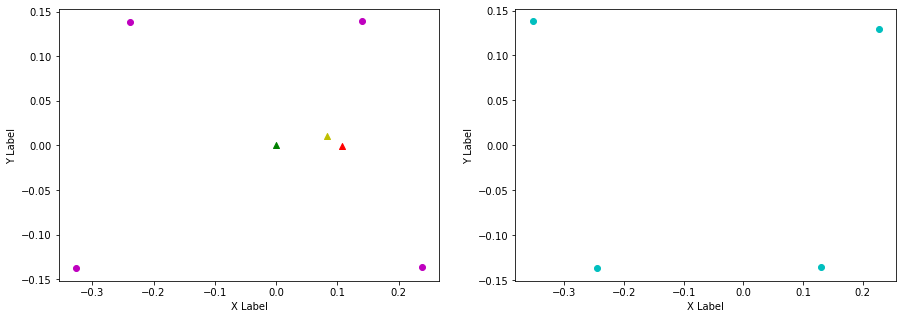

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.227, 0.128, FL (y): 0.13, 0.138.
FL displacement: -0.099, 0.008000000000000007.

FR (x): 0.131, 0.228, FR (y): -0.135, -0.136.
FR displacement: 0.097, -0.0010000000000000009.

RL (x): -0.353, -0.247, RL (y): 0.138, 0.138.
RL displacement: 0.10599999999999998, 0.0.

RR (x): -0.246, -0.339, RR (y): -0.137, -0.137.
RR displacement: -0.09300000000000003, 0.0.


Base displacement (Foot): [0.099, -0.008000000000000007].

Base displacement (Odom): [[0.03178438769210401], [-0.005766636106235623]]. Rotation displacement: 0.6363263350019344.



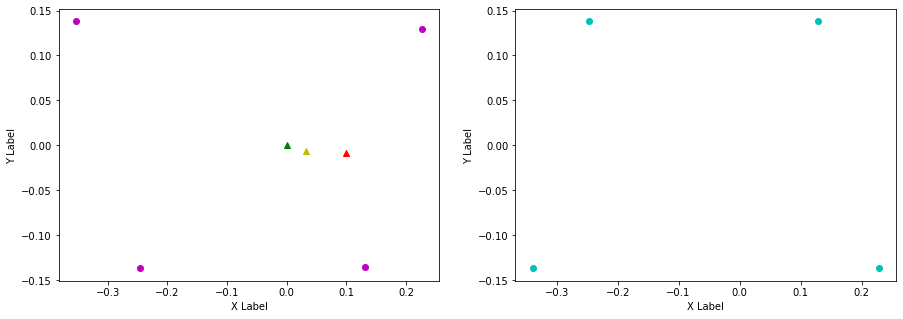

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.128, 0.231, FL (y): 0.138, 0.128.
FL displacement: 0.10300000000000001, -0.010000000000000009.

FR (x): 0.228, 0.152, FR (y): -0.136, -0.136.
FR displacement: -0.07600000000000001, 0.0.

RL (x): -0.247, -0.335, RL (y): 0.138, 0.139.
RL displacement: -0.08800000000000002, 0.0010000000000000009.

RR (x): -0.339, -0.243, RR (y): -0.137, -0.136.
RR displacement: 0.09600000000000003, 0.0010000000000000009.


Base displacement (Foot): [0.07600000000000001, -0.0].

Base displacement (Odom): [[0.1062980746265112], [0.011633463844372471]]. Rotation displacement: -1.192037924119059.



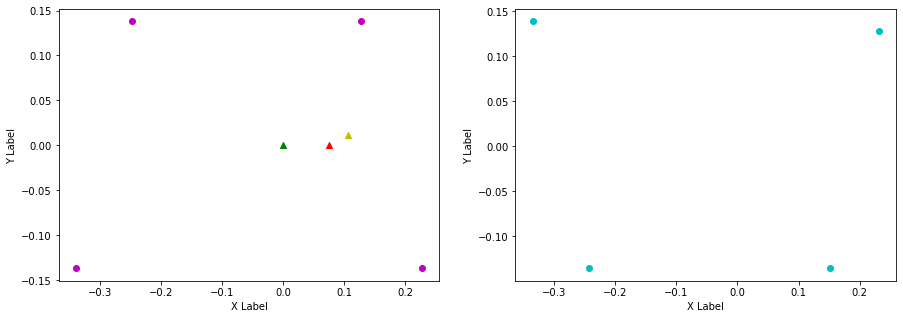

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.231, 0.121, FL (y): 0.128, 0.137.
FL displacement: -0.11000000000000001, 0.009000000000000008.

FR (x): 0.152, 0.225, FR (y): -0.136, -0.136.
FR displacement: 0.07300000000000001, 0.0.

RL (x): -0.335, -0.25, RL (y): 0.139, 0.138.
RL displacement: 0.08500000000000002, -0.0010000000000000009.

RR (x): -0.243, -0.347, RR (y): -0.136, -0.136.
RR displacement: -0.10399999999999998, 0.0.


Base displacement (Foot): [0.11000000000000001, -0.009000000000000008].

Base displacement (Odom): [[0.07568131888234553], [-0.007370526704802316]]. Rotation displacement: 0.8131129747950399.



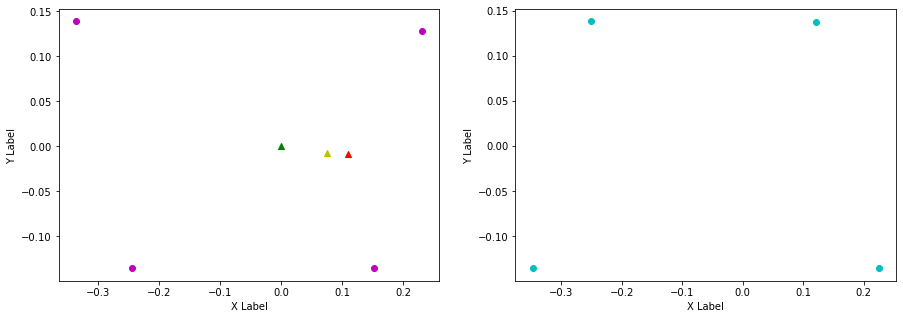

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.121, 0.233, FL (y): 0.137, 0.13.
FL displacement: 0.11200000000000002, -0.007000000000000006.

FR (x): 0.225, 0.153, FR (y): -0.136, -0.137.
FR displacement: -0.07200000000000001, -0.0010000000000000009.

RL (x): -0.25, -0.329, RL (y): 0.138, 0.138.
RL displacement: -0.07900000000000001, 0.0.

RR (x): -0.347, -0.241, RR (y): -0.136, -0.136.
RR displacement: 0.10599999999999998, 0.0.


Base displacement (Foot): [0.07200000000000001, 0.0010000000000000009].

Base displacement (Odom): [[0.04644958712870473], [0.004712441226311981]]. Rotation displacement: -1.3476501665903684.



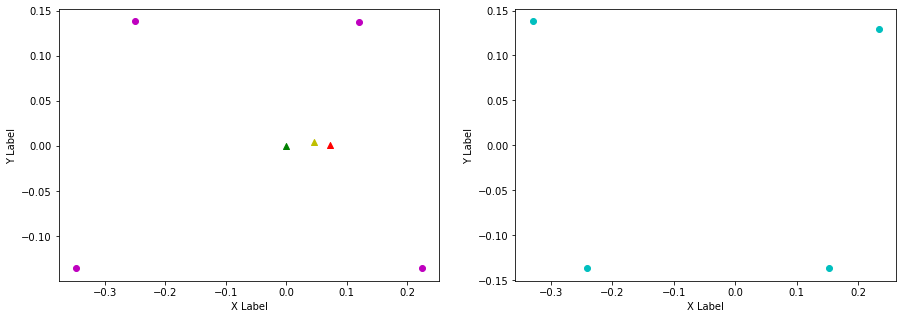

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.233, 0.135, FL (y): 0.13, 0.139.
FL displacement: -0.098, 0.009000000000000008.

FR (x): 0.153, 0.233, FR (y): -0.137, -0.136.
FR displacement: 0.08000000000000002, 0.0010000000000000009.

RL (x): -0.329, -0.243, RL (y): 0.138, 0.138.
RL displacement: 0.08600000000000002, 0.0.

RR (x): -0.241, -0.332, RR (y): -0.136, -0.138.
RR displacement: -0.09100000000000003, -0.0020000000000000018.


Base displacement (Foot): [0.098, -0.009000000000000008].

Base displacement (Odom): [[0.05480063661946821], [-0.0037447374803960543]]. Rotation displacement: 0.7621227406051825.



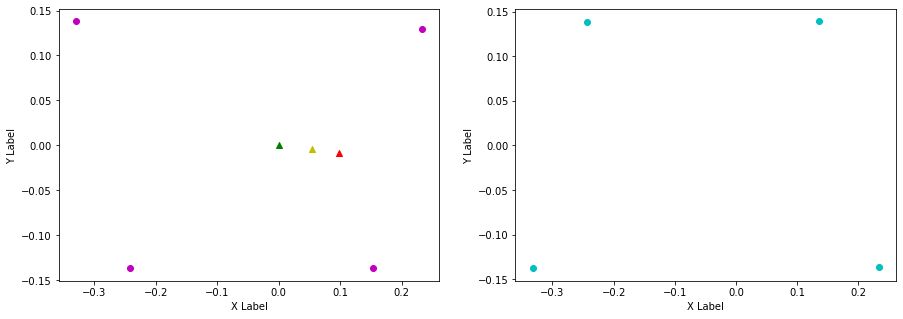

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.135, 0.235, FL (y): 0.139, 0.13.
FL displacement: 0.09999999999999998, -0.009000000000000008.

FR (x): 0.233, 0.155, FR (y): -0.136, -0.138.
FR displacement: -0.07800000000000001, -0.0020000000000000018.

RL (x): -0.243, -0.327, RL (y): 0.138, 0.138.
RL displacement: -0.08400000000000002, 0.0.

RR (x): -0.332, -0.239, RR (y): -0.138, -0.136.
RR displacement: 0.09300000000000003, 0.0020000000000000018.


Base displacement (Foot): [0.07800000000000001, 0.0020000000000000018].

Base displacement (Odom): [[0.09845814011827403], [0.008781071203364021]]. Rotation displacement: -1.4900354512395109.



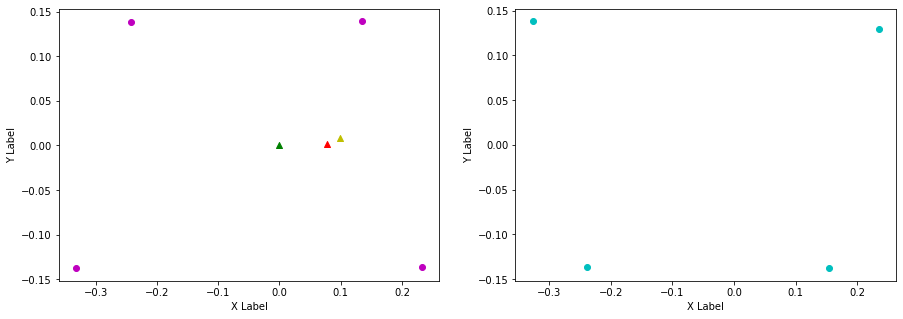

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.235, 0.158, FL (y): 0.13, 0.142.
FL displacement: -0.07699999999999999, 0.011999999999999983.

FR (x): 0.155, 0.256, FR (y): -0.138, -0.134.
FR displacement: 0.101, 0.0040000000000000036.

RL (x): -0.327, -0.222, RL (y): 0.138, 0.135.
RL displacement: 0.10500000000000001, -0.0030000000000000027.

RR (x): -0.239, -0.308, RR (y): -0.136, -0.142.
RR displacement: -0.069, -0.005999999999999978.


Base displacement (Foot): [0.07699999999999999, -0.011999999999999983].

Base displacement (Odom): [[0.03070003406052968], [-0.0037060304155254187]]. Rotation displacement: 0.9752027734986091.



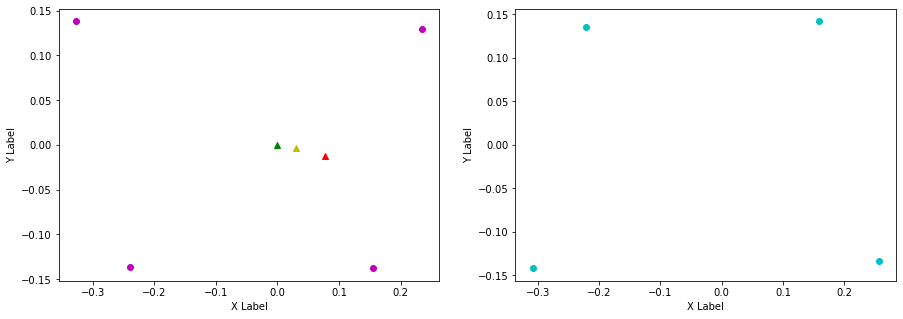

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.158, 0.234, FL (y): 0.142, 0.13.
FL displacement: 0.07600000000000001, -0.011999999999999983.

FR (x): 0.256, 0.155, FR (y): -0.134, -0.138.
FR displacement: -0.101, -0.0040000000000000036.

RL (x): -0.222, -0.328, RL (y): 0.135, 0.138.
RL displacement: -0.10600000000000001, 0.0030000000000000027.

RR (x): -0.308, -0.239, RR (y): -0.142, -0.136.
RR displacement: 0.069, 0.005999999999999978.


Base displacement (Foot): [0.101, 0.0040000000000000036].

Base displacement (Odom): [[0.10004197190341557], [0.0010222193951339165]]. Rotation displacement: -1.865669976395922.



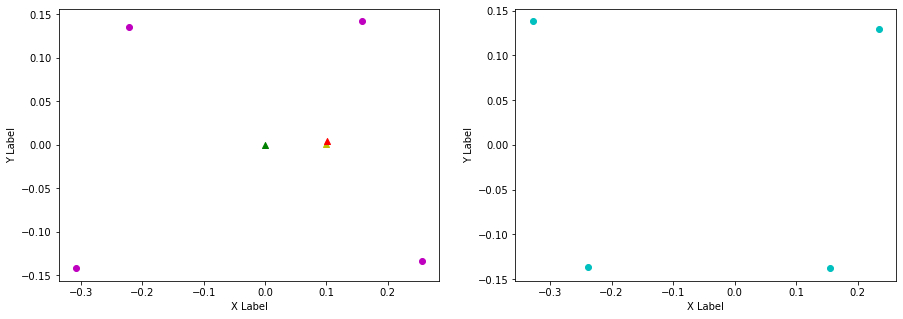

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.234, 0.125, FL (y): 0.13, 0.137.
FL displacement: -0.10900000000000001, 0.007000000000000006.

FR (x): 0.155, 0.227, FR (y): -0.138, -0.137.
FR displacement: 0.07200000000000001, 0.0010000000000000009.

RL (x): -0.328, -0.248, RL (y): 0.138, 0.138.
RL displacement: 0.08000000000000002, 0.0.

RR (x): -0.239, -0.344, RR (y): -0.136, -0.137.
RR displacement: -0.10499999999999998, -0.0010000000000000009.


Base displacement (Foot): [0.10900000000000001, -0.007000000000000006].

Base displacement (Odom): [[0.04636080390186592], [-0.0040023353575122655]]. Rotation displacement: 1.4500345547296953.



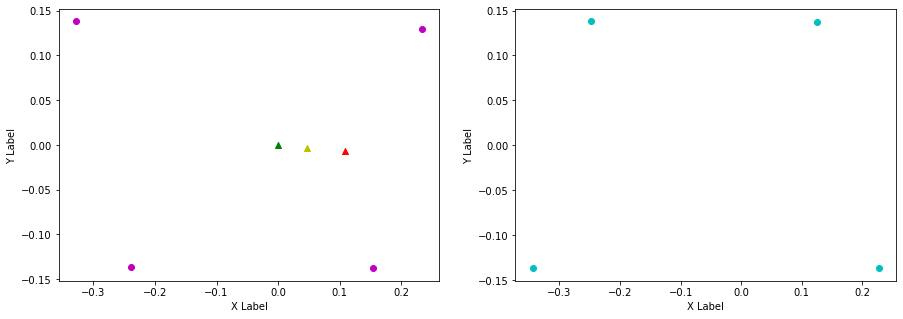

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.125, 0.224, FL (y): 0.137, 0.131.
FL displacement: 0.099, -0.006000000000000005.

FR (x): 0.227, 0.12, FR (y): -0.137, -0.135.
FR displacement: -0.10700000000000001, 0.0020000000000000018.

RL (x): -0.248, -0.362, RL (y): 0.138, 0.137.
RL displacement: -0.11399999999999999, -0.0010000000000000009.

RR (x): -0.344, -0.249, RR (y): -0.137, -0.137.
RR displacement: 0.09499999999999997, 0.0.


Base displacement (Foot): [0.10700000000000001, -0.0020000000000000018].

Base displacement (Odom): [[0.0879610438355991], [0.007160169842284958]]. Rotation displacement: -1.8575303333850197.



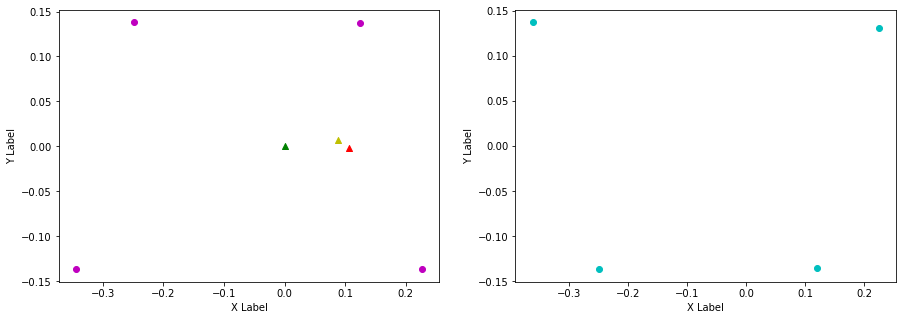

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.224, 0.14, FL (y): 0.131, 0.139.
FL displacement: -0.08399999999999999, 0.008000000000000007.

FR (x): 0.12, 0.238, FR (y): -0.135, -0.136.
FR displacement: 0.118, -0.0010000000000000009.

RL (x): -0.362, -0.238, RL (y): 0.137, 0.138.
RL displacement: 0.124, 0.0010000000000000009.

RR (x): -0.249, -0.326, RR (y): -0.137, -0.138.
RR displacement: -0.07700000000000001, -0.0010000000000000009.


Base displacement (Foot): [0.08399999999999999, -0.008000000000000007].

Base displacement (Odom): [[0.06767768771616112], [-0.007129456292275904]]. Rotation displacement: 0.7502944602089819.



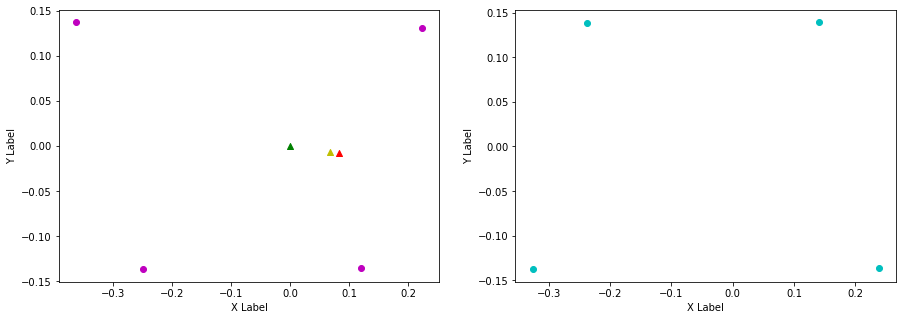

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.14, 0.233, FL (y): 0.139, 0.13.
FL displacement: 0.093, -0.009000000000000008.

FR (x): 0.238, 0.153, FR (y): -0.136, -0.137.
FR displacement: -0.08499999999999999, -0.0010000000000000009.

RL (x): -0.238, -0.329, RL (y): 0.138, 0.139.
RL displacement: -0.09100000000000003, 0.0010000000000000009.

RR (x): -0.326, -0.241, RR (y): -0.138, -0.136.
RR displacement: 0.08500000000000002, 0.0020000000000000018.


Base displacement (Foot): [0.08499999999999999, 0.0010000000000000009].

Base displacement (Odom): [[0.04357789997042438], [0.002648374971460754]]. Rotation displacement: -1.6496563317782769.



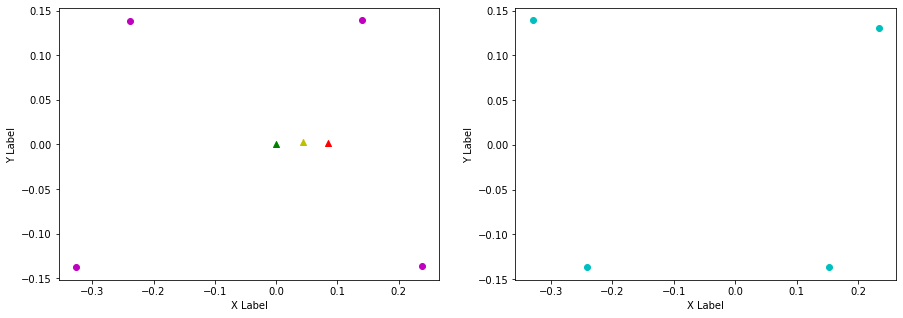

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.233, 0.139, FL (y): 0.13, 0.139.
FL displacement: -0.094, 0.009000000000000008.

FR (x): 0.153, 0.236, FR (y): -0.137, -0.136.
FR displacement: 0.08299999999999999, 0.0010000000000000009.

RL (x): -0.329, -0.24, RL (y): 0.139, 0.138.
RL displacement: 0.08900000000000002, -0.0010000000000000009.

RR (x): -0.241, -0.327, RR (y): -0.136, -0.138.
RR displacement: -0.08600000000000002, -0.0020000000000000018.


Base displacement (Foot): [0.094, -0.009000000000000008].

Base displacement (Odom): [[0.05799096385490676], [-0.00548774247614503]]. Rotation displacement: 1.4236497180446095.



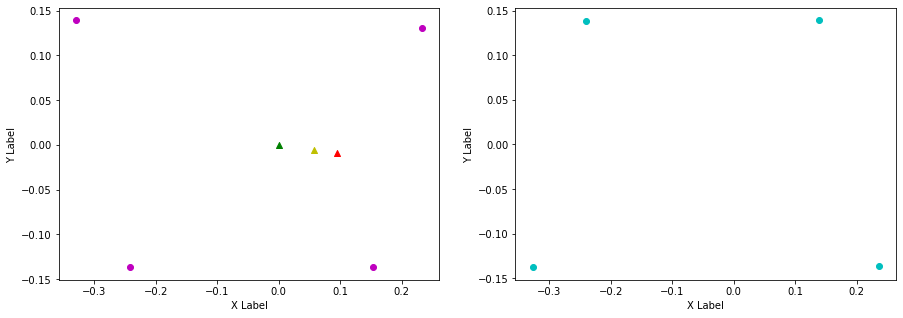

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.228, 0.142, FL (y): 0.13, 0.139.
FL displacement: -0.08600000000000002, 0.009000000000000008.

FR (x): 0.135, 0.24, FR (y): -0.136, -0.136.
FR displacement: 0.10499999999999998, 0.0.

RL (x): -0.348, -0.236, RL (y): 0.138, 0.138.
RL displacement: 0.11199999999999999, 0.0.

RR (x): -0.245, -0.324, RR (y): -0.136, -0.139.
RR displacement: -0.07900000000000001, -0.0030000000000000027.


Base displacement (Foot): [0.08600000000000002, -0.009000000000000008].

Base displacement (Odom): [[0.07151806124350668], [-0.007190201342936575]]. Rotation displacement: -1.8086554019282106.



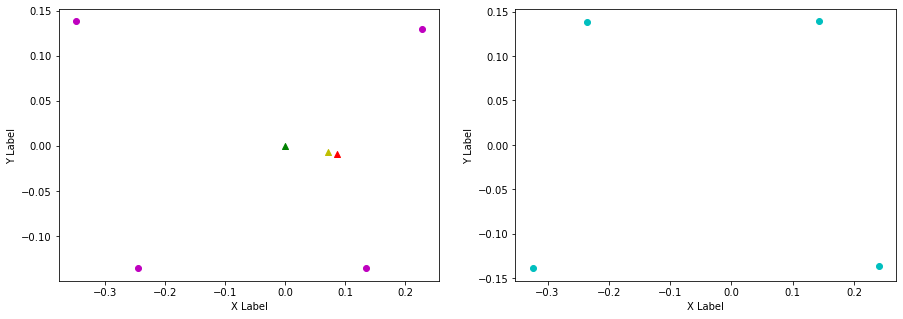

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.142, 0.227, FL (y): 0.139, 0.13.
FL displacement: 0.08500000000000002, -0.009000000000000008.

FR (x): 0.24, 0.129, FR (y): -0.136, -0.135.
FR displacement: -0.11099999999999999, 0.0010000000000000009.

RL (x): -0.236, -0.353, RL (y): 0.138, 0.138.
RL displacement: -0.11699999999999999, 0.0.

RR (x): -0.324, -0.247, RR (y): -0.139, -0.137.
RR displacement: 0.07700000000000001, 0.0020000000000000018.


Base displacement (Foot): [0.11099999999999999, -0.0010000000000000009].

Base displacement (Odom): [[0.06270580962707539], [0.004599183829069986]]. Rotation displacement: -0.8767899850833264.



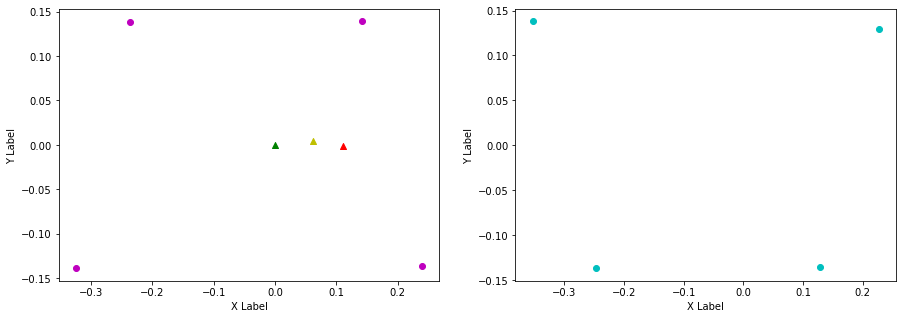

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.227, 0.14, FL (y): 0.13, 0.139.
FL displacement: -0.087, 0.009000000000000008.

FR (x): 0.129, 0.238, FR (y): -0.135, -0.136.
FR displacement: 0.10899999999999999, -0.0010000000000000009.

RL (x): -0.353, -0.238, RL (y): 0.138, 0.138.
RL displacement: 0.11499999999999999, 0.0.

RR (x): -0.247, -0.326, RR (y): -0.137, -0.139.
RR displacement: -0.07900000000000001, -0.0020000000000000018.


Base displacement (Foot): [0.087, -0.009000000000000008].

Base displacement (Odom): [[0.05706099516129348], [-0.005883690890680526]]. Rotation displacement: 0.9453762723062454.



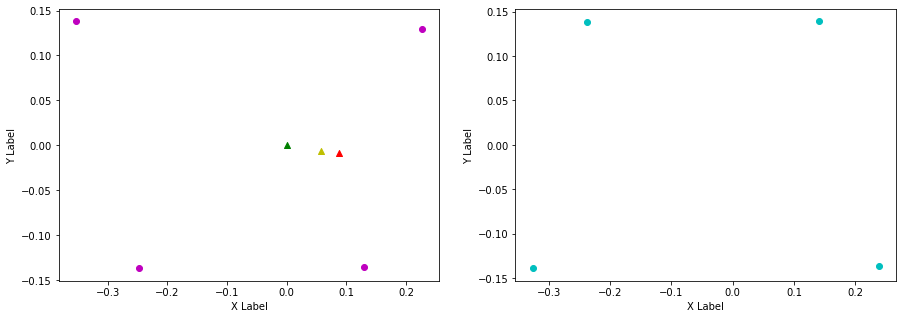

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.14, 0.227, FL (y): 0.139, 0.13.
FL displacement: 0.087, -0.009000000000000008.

FR (x): 0.238, 0.13, FR (y): -0.136, -0.135.
FR displacement: -0.10799999999999998, 0.0010000000000000009.

RL (x): -0.238, -0.352, RL (y): 0.138, 0.138.
RL displacement: -0.11399999999999999, 0.0.

RR (x): -0.326, -0.247, RR (y): -0.139, -0.136.
RR displacement: 0.07900000000000001, 0.0030000000000000027.


Base displacement (Foot): [0.10799999999999998, -0.0010000000000000009].

Base displacement (Odom): [[0.09114332048477558], [0.007640358534064973]]. Rotation displacement: -1.5080492165835382.



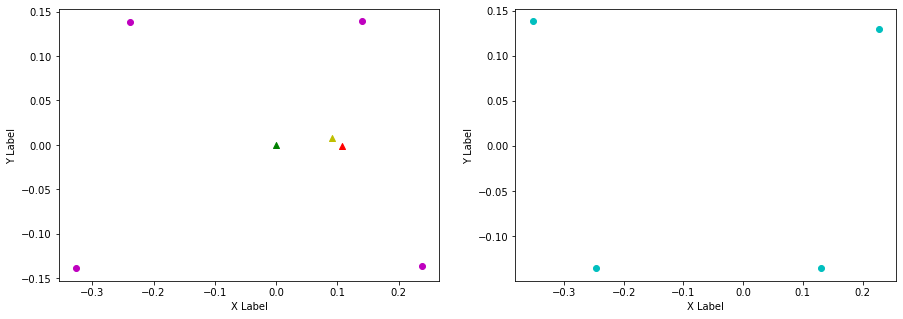

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.227, 0.137, FL (y): 0.13, 0.139.
FL displacement: -0.09, 0.009000000000000008.

FR (x): 0.13, 0.234, FR (y): -0.135, -0.136.
FR displacement: 0.10400000000000001, -0.0010000000000000009.

RL (x): -0.352, -0.241, RL (y): 0.138, 0.138.
RL displacement: 0.11099999999999999, 0.0.

RR (x): -0.247, -0.328, RR (y): -0.136, -0.138.
RR displacement: -0.08100000000000002, -0.0020000000000000018.


Base displacement (Foot): [0.09, -0.009000000000000008].

Base displacement (Odom): [[0.07219847830662629], [-0.008697883411374008]]. Rotation displacement: 1.1059863847630358.



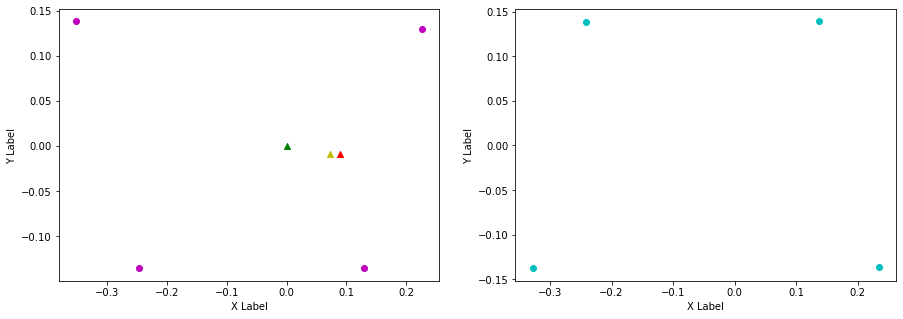

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.137, 0.228, FL (y): 0.139, 0.129.
FL displacement: 0.091, -0.010000000000000009.

FR (x): 0.234, 0.137, FR (y): -0.136, -0.136.
FR displacement: -0.097, 0.0.

RL (x): -0.241, -0.347, RL (y): 0.138, 0.138.
RL displacement: -0.10599999999999998, 0.0.

RR (x): -0.328, -0.246, RR (y): -0.138, -0.137.
RR displacement: 0.08200000000000002, 0.0010000000000000009.


Base displacement (Foot): [0.097, -0.0].

Base displacement (Odom): [[0.05480186786363728], [0.003913137233928055]]. Rotation displacement: -1.6139914037276843.



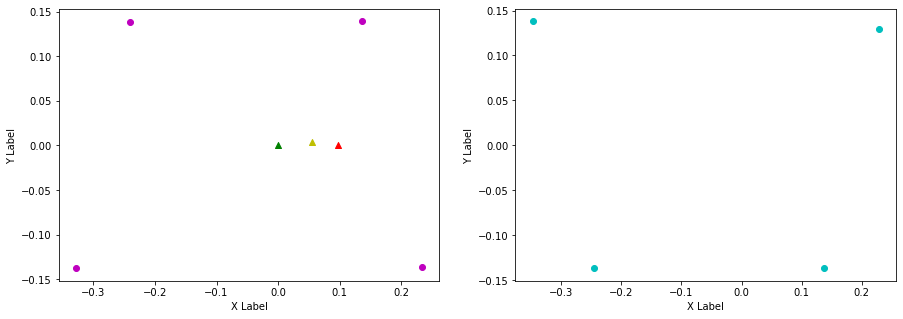

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.228, 0.143, FL (y): 0.129, 0.139.
FL displacement: -0.08500000000000002, 0.010000000000000009.

FR (x): 0.137, 0.241, FR (y): -0.136, -0.135.
FR displacement: 0.10399999999999998, 0.0010000000000000009.

RL (x): -0.347, -0.235, RL (y): 0.138, 0.138.
RL displacement: 0.11199999999999999, 0.0.

RR (x): -0.246, -0.322, RR (y): -0.137, -0.139.
RR displacement: -0.07600000000000001, -0.0020000000000000018.


Base displacement (Foot): [0.08500000000000002, -0.010000000000000009].

Base displacement (Odom): [[0.0650728207078346], [-0.0057591876351743565]]. Rotation displacement: 0.9824959921965594.



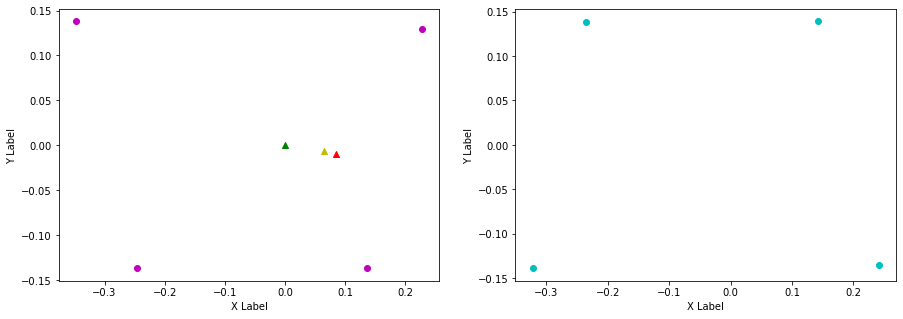

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.143, 0.23, FL (y): 0.139, 0.129.
FL displacement: 0.08700000000000002, -0.010000000000000009.

FR (x): 0.241, 0.141, FR (y): -0.135, -0.136.
FR displacement: -0.1, -0.0010000000000000009.

RL (x): -0.235, -0.341, RL (y): 0.138, 0.139.
RL displacement: -0.10600000000000004, 0.0010000000000000009.

RR (x): -0.322, -0.244, RR (y): -0.139, -0.136.
RR displacement: 0.07800000000000001, 0.0030000000000000027.


Base displacement (Foot): [0.1, 0.0010000000000000009].

Base displacement (Odom): [[0.09109918136490425], [0.005804347571983115]]. Rotation displacement: -1.7447501137924322.



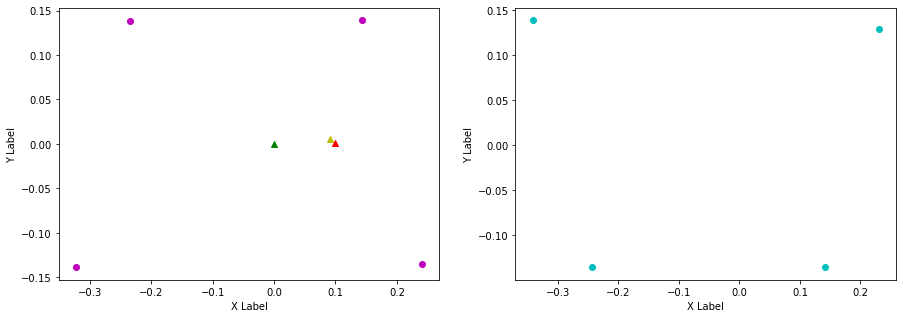

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.23, 0.135, FL (y): 0.129, 0.139.
FL displacement: -0.095, 0.010000000000000009.

FR (x): 0.141, 0.232, FR (y): -0.136, -0.136.
FR displacement: 0.09100000000000003, 0.0.

RL (x): -0.341, -0.243, RL (y): 0.139, 0.138.
RL displacement: 0.09800000000000003, -0.0010000000000000009.

RR (x): -0.244, -0.331, RR (y): -0.136, -0.138.
RR displacement: -0.08700000000000002, -0.0020000000000000018.


Base displacement (Foot): [0.095, -0.010000000000000009].

Base displacement (Odom): [[0.0972778704747006], [-0.008172696246520061]]. Rotation displacement: 1.058658994788013.



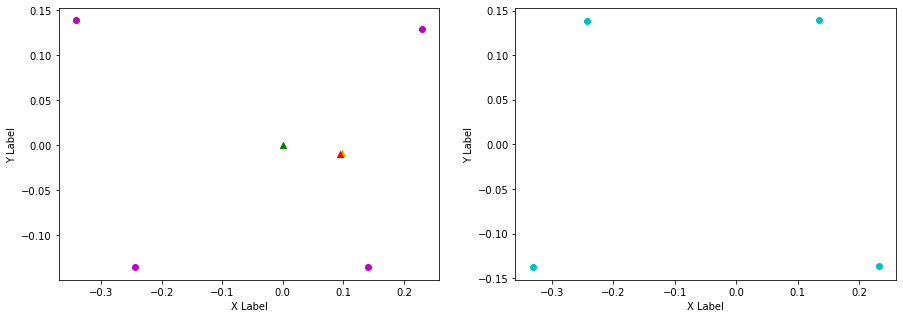

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.135, 0.226, FL (y): 0.139, 0.13.
FL displacement: 0.091, -0.009000000000000008.

FR (x): 0.232, 0.131, FR (y): -0.136, -0.135.
FR displacement: -0.101, 0.0010000000000000009.

RL (x): -0.243, -0.353, RL (y): 0.138, 0.138.
RL displacement: -0.10999999999999999, 0.0.

RR (x): -0.331, -0.247, RR (y): -0.138, -0.137.
RR displacement: 0.08400000000000002, 0.0010000000000000009.


Base displacement (Foot): [0.101, -0.0010000000000000009].

Base displacement (Odom): [[0.0804086803933195], [0.008673313219915713]]. Rotation displacement: -1.5879934080061913.



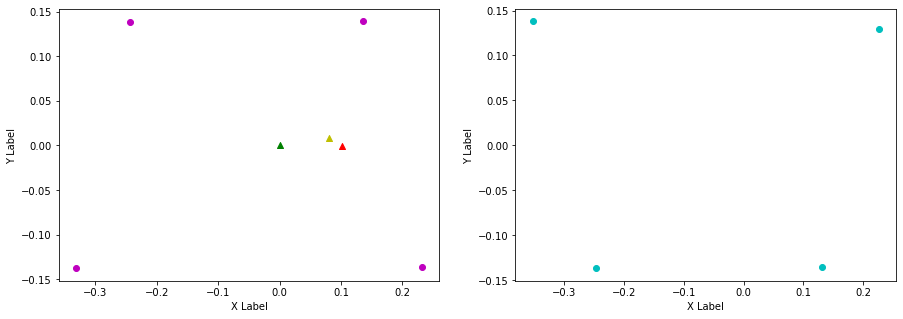

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.226, 0.134, FL (y): 0.13, 0.138.
FL displacement: -0.092, 0.008000000000000007.

FR (x): 0.131, 0.232, FR (y): -0.135, -0.135.
FR displacement: 0.101, 0.0.

RL (x): -0.353, -0.243, RL (y): 0.138, 0.138.
RL displacement: 0.10999999999999999, 0.0.

RR (x): -0.247, -0.331, RR (y): -0.137, -0.138.
RR displacement: -0.08400000000000002, -0.0010000000000000009.


Base displacement (Foot): [0.092, -0.008000000000000007].

Base displacement (Odom): [[0.07810544639558192], [-0.00898250743685125]]. Rotation displacement: 0.6306420262732703.



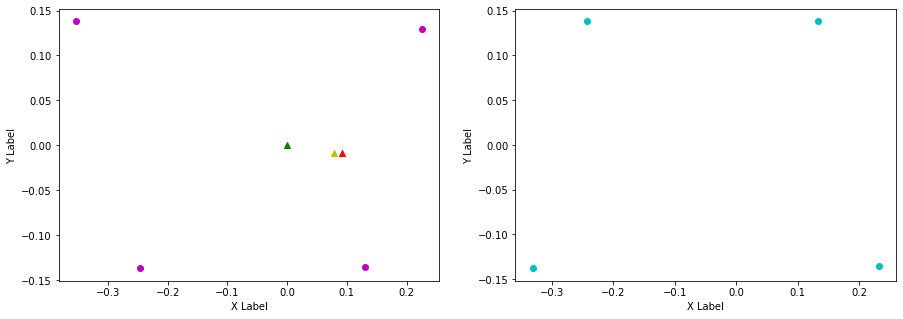

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.134, 0.23, FL (y): 0.138, 0.129.
FL displacement: 0.096, -0.009000000000000008.

FR (x): 0.232, 0.14, FR (y): -0.135, -0.136.
FR displacement: -0.092, -0.0010000000000000009.

RL (x): -0.243, -0.341, RL (y): 0.138, 0.139.
RL displacement: -0.09800000000000003, 0.0010000000000000009.

RR (x): -0.331, -0.244, RR (y): -0.138, -0.136.
RR displacement: 0.08700000000000002, 0.0020000000000000018.


Base displacement (Foot): [0.092, 0.0010000000000000009].

Base displacement (Odom): [[0.07792029237943399], [0.004304369580832912]]. Rotation displacement: -1.2054526087088622.



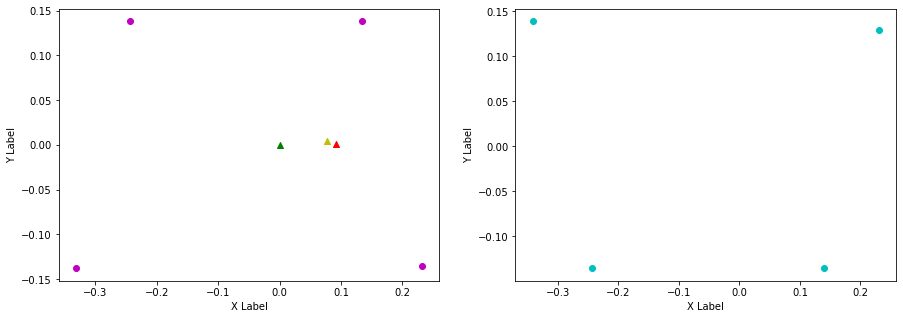

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.23, 0.137, FL (y): 0.129, 0.139.
FL displacement: -0.093, 0.010000000000000009.

FR (x): 0.14, 0.234, FR (y): -0.136, -0.136.
FR displacement: 0.094, 0.0.

RL (x): -0.341, -0.241, RL (y): 0.139, 0.138.
RL displacement: 0.10000000000000003, -0.0010000000000000009.

RR (x): -0.244, -0.329, RR (y): -0.136, -0.138.
RR displacement: -0.08500000000000002, -0.0020000000000000018.


Base displacement (Foot): [0.093, -0.010000000000000009].

Base displacement (Odom): [[0.08682254555167912], [-0.010321674740254139]]. Rotation displacement: 0.7663893379987159.



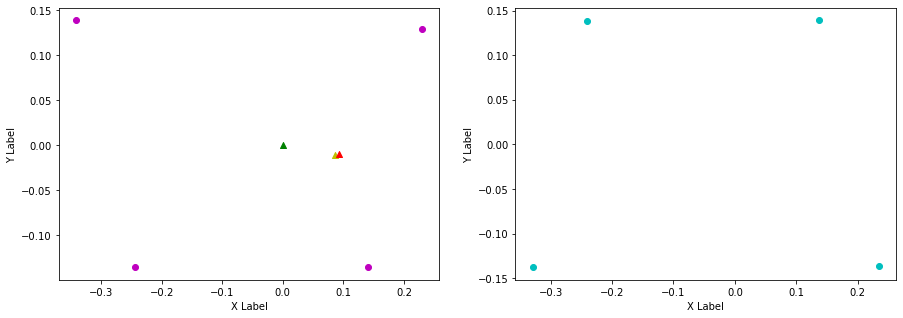

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.137, 0.237, FL (y): 0.139, 0.13.
FL displacement: 0.09999999999999998, -0.009000000000000008.

FR (x): 0.234, 0.156, FR (y): -0.136, -0.138.
FR displacement: -0.07800000000000001, -0.0020000000000000018.

RL (x): -0.241, -0.325, RL (y): 0.138, 0.139.
RL displacement: -0.08400000000000002, 0.0010000000000000009.

RR (x): -0.329, -0.237, RR (y): -0.138, -0.136.
RR displacement: 0.09200000000000003, 0.0020000000000000018.


Base displacement (Foot): [0.07800000000000001, 0.0020000000000000018].

Base displacement (Odom): [[0.08081841167019288], [0.007991319160865373]]. Rotation displacement: -1.511281345773859.



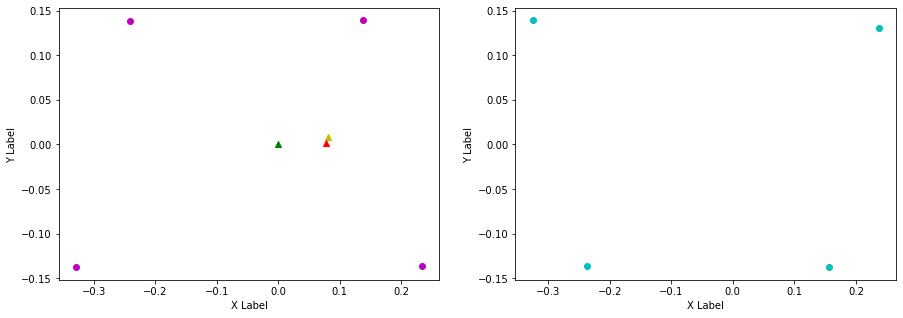

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.237, 0.125, FL (y): 0.13, 0.137.
FL displacement: -0.11199999999999999, 0.007000000000000006.

FR (x): 0.156, 0.227, FR (y): -0.138, -0.136.
FR displacement: 0.07100000000000001, 0.0020000000000000018.

RL (x): -0.325, -0.248, RL (y): 0.139, 0.138.
RL displacement: 0.07700000000000001, -0.0010000000000000009.

RR (x): -0.237, -0.344, RR (y): -0.136, -0.137.
RR displacement: -0.10699999999999998, -0.0010000000000000009.


Base displacement (Foot): [0.11199999999999999, -0.007000000000000006].

Base displacement (Odom): [[0.05370308673299551], [-0.005503525223927497]]. Rotation displacement: 1.2345969072138145.



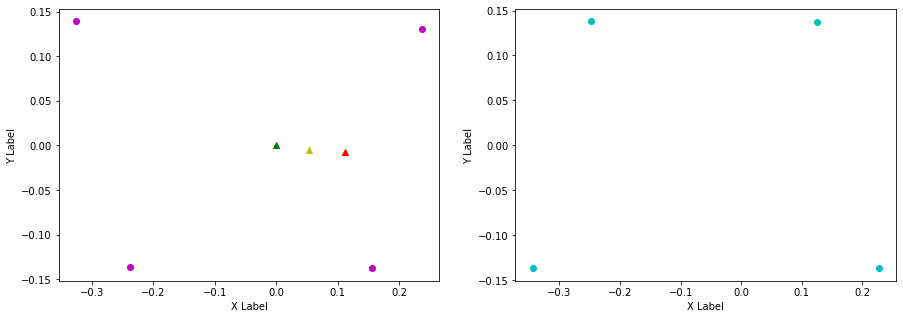

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.125, 0.229, FL (y): 0.137, 0.129.
FL displacement: 0.10400000000000001, -0.008000000000000007.

FR (x): 0.227, 0.142, FR (y): -0.136, -0.136.
FR displacement: -0.08500000000000002, 0.0.

RL (x): -0.248, -0.342, RL (y): 0.138, 0.138.
RL displacement: -0.09400000000000003, 0.0.

RR (x): -0.344, -0.245, RR (y): -0.137, -0.137.
RR displacement: 0.09899999999999998, 0.0.


Base displacement (Foot): [0.08500000000000002, -0.0].

Base displacement (Odom): [[0.0977575522824683], [0.008621564191244602]]. Rotation displacement: -1.8023452833025397.



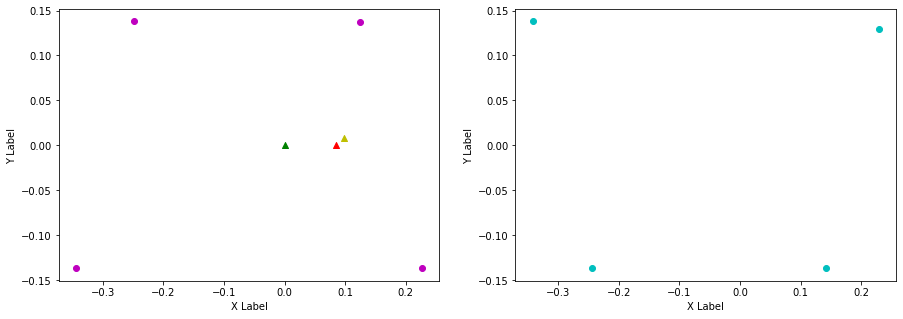

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.229, 0.122, FL (y): 0.129, 0.137.
FL displacement: -0.10700000000000001, 0.008000000000000007.

FR (x): 0.142, 0.224, FR (y): -0.136, -0.136.
FR displacement: 0.08200000000000002, 0.0.

RL (x): -0.342, -0.25, RL (y): 0.138, 0.139.
RL displacement: 0.09200000000000003, 0.0010000000000000009.

RR (x): -0.245, -0.348, RR (y): -0.137, -0.136.
RR displacement: -0.10299999999999998, 0.0010000000000000009.


Base displacement (Foot): [0.10700000000000001, -0.008000000000000007].

Base displacement (Odom): [[0.07608438174413656], [-0.01105747906798804]]. Rotation displacement: 0.8678991752042994.



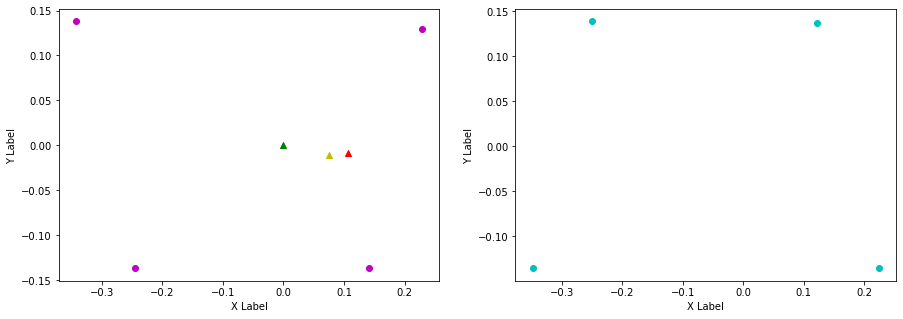

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.122, 0.232, FL (y): 0.137, 0.13.
FL displacement: 0.11000000000000001, -0.007000000000000006.

FR (x): 0.224, 0.148, FR (y): -0.136, -0.137.
FR displacement: -0.07600000000000001, -0.0010000000000000009.

RL (x): -0.25, -0.334, RL (y): 0.139, 0.139.
RL displacement: -0.08400000000000002, 0.0.

RR (x): -0.348, -0.243, RR (y): -0.136, -0.136.
RR displacement: 0.10499999999999998, 0.0.


Base displacement (Foot): [0.07600000000000001, 0.0010000000000000009].

Base displacement (Odom): [[0.09652110306491357], [0.010234261938311562]]. Rotation displacement: -1.3544547971643235.



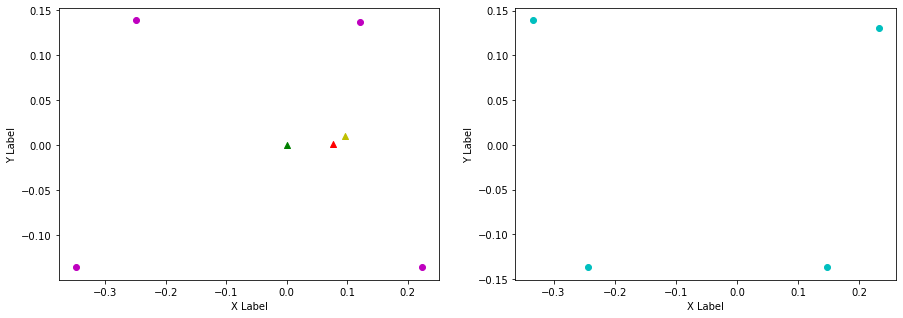

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.232, 0.126, FL (y): 0.13, 0.138.
FL displacement: -0.10600000000000001, 0.008000000000000007.

FR (x): 0.148, 0.227, FR (y): -0.137, -0.137.
FR displacement: 0.07900000000000001, 0.0.

RL (x): -0.334, -0.248, RL (y): 0.139, 0.138.
RL displacement: 0.08600000000000002, -0.0010000000000000009.

RR (x): -0.243, -0.344, RR (y): -0.136, -0.137.
RR displacement: -0.10099999999999998, -0.0010000000000000009.


Base displacement (Foot): [0.10600000000000001, -0.008000000000000007].

Base displacement (Odom): [[0.055414798748552485], [-0.004638161504180616]]. Rotation displacement: 0.8191902576315988.



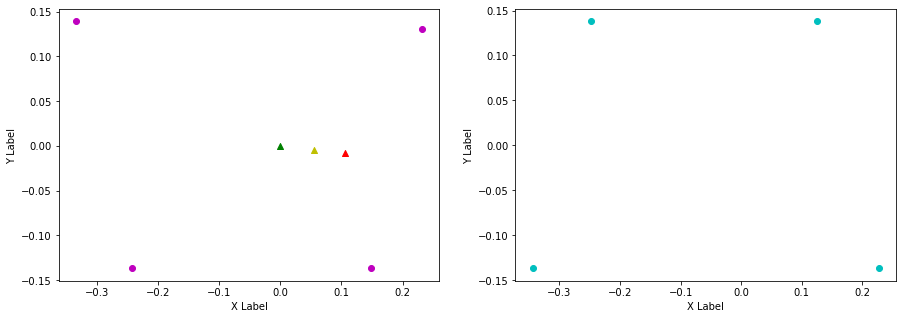

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.126, 0.241, FL (y): 0.138, 0.13.
FL displacement: 0.11499999999999999, -0.008000000000000007.

FR (x): 0.227, 0.156, FR (y): -0.137, -0.139.
FR displacement: -0.07100000000000001, -0.0020000000000000018.

RL (x): -0.248, -0.322, RL (y): 0.138, 0.14.
RL displacement: -0.07400000000000001, 0.0020000000000000018.

RR (x): -0.344, -0.233, RR (y): -0.137, -0.135.
RR displacement: 0.11099999999999996, 0.0020000000000000018.


Base displacement (Foot): [0.07100000000000001, 0.0020000000000000018].

Base displacement (Odom): [[0.04942462746674581], [0.008355489014125084]]. Rotation displacement: -1.4979542291841648.



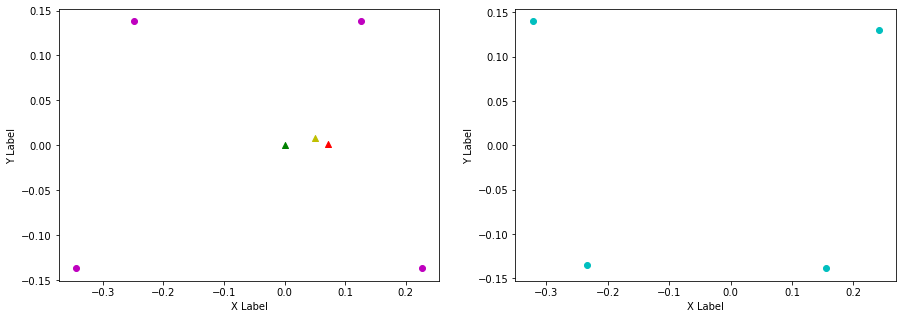

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.241, 0.16, FL (y): 0.13, 0.143.
FL displacement: -0.08099999999999999, 0.012999999999999984.

FR (x): 0.156, 0.258, FR (y): -0.139, -0.134.
FR displacement: 0.10200000000000001, 0.0050000000000000044.

RL (x): -0.322, -0.22, RL (y): 0.14, 0.135.
RL displacement: 0.10200000000000001, -0.0050000000000000044.

RR (x): -0.233, -0.306, RR (y): -0.135, -0.143.
RR displacement: -0.07299999999999998, -0.00799999999999998.


Base displacement (Foot): [0.08099999999999999, -0.012999999999999984].

Base displacement (Odom): [[0.03816875932939334], [-0.004683027307642362]]. Rotation displacement: 0.9730688220629662.



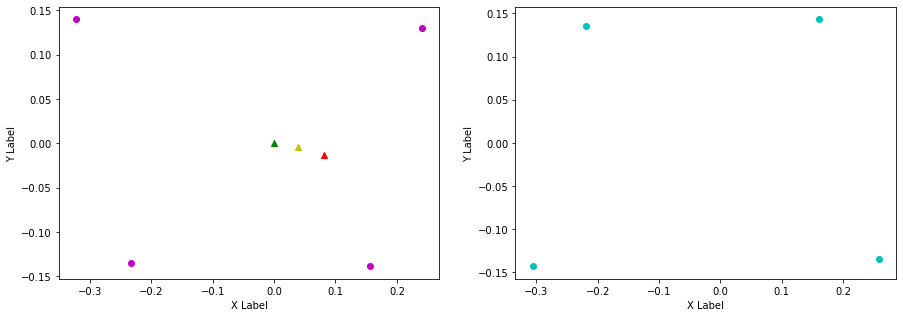

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.16, 0.235, FL (y): 0.143, 0.13.
FL displacement: 0.07499999999999998, -0.012999999999999984.

FR (x): 0.258, 0.156, FR (y): -0.134, -0.138.
FR displacement: -0.10200000000000001, -0.0040000000000000036.

RL (x): -0.22, -0.327, RL (y): 0.135, 0.138.
RL displacement: -0.10700000000000001, 0.0030000000000000027.

RR (x): -0.306, -0.24, RR (y): -0.143, -0.136.
RR displacement: 0.066, 0.0069999999999999785.


Base displacement (Foot): [0.10200000000000001, 0.0040000000000000036].

Base displacement (Odom): [[0.09986047048169944], [0.005553894564995332]]. Rotation displacement: -1.9389005448659196.



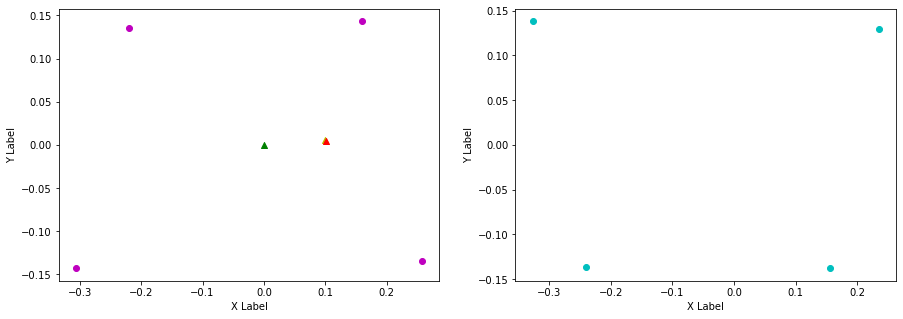

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.235, 0.129, FL (y): 0.13, 0.138.
FL displacement: -0.10599999999999998, 0.008000000000000007.

FR (x): 0.156, 0.228, FR (y): -0.138, -0.136.
FR displacement: 0.07200000000000001, 0.0020000000000000018.

RL (x): -0.327, -0.247, RL (y): 0.138, 0.138.
RL displacement: 0.08000000000000002, 0.0.

RR (x): -0.24, -0.34, RR (y): -0.136, -0.137.
RR displacement: -0.10000000000000003, -0.0010000000000000009.


Base displacement (Foot): [0.10599999999999998, -0.008000000000000007].

Base displacement (Odom): [[0.04918410933344308], [-0.0035086713735221764]]. Rotation displacement: 0.9853760448778816.



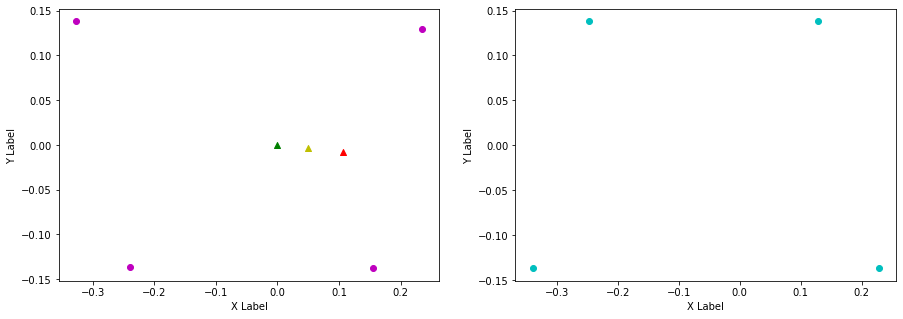

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.129, 0.236, FL (y): 0.138, 0.13.
FL displacement: 0.10699999999999998, -0.008000000000000007.

FR (x): 0.228, 0.156, FR (y): -0.136, -0.138.
FR displacement: -0.07200000000000001, -0.0020000000000000018.

RL (x): -0.247, -0.326, RL (y): 0.138, 0.139.
RL displacement: -0.07900000000000001, 0.0010000000000000009.

RR (x): -0.34, -0.238, RR (y): -0.137, -0.136.
RR displacement: 0.10200000000000004, 0.0010000000000000009.


Base displacement (Foot): [0.07200000000000001, 0.0020000000000000018].

Base displacement (Odom): [[0.05940297042402154], [0.0030450166242310672]]. Rotation displacement: -1.2117845215498317.



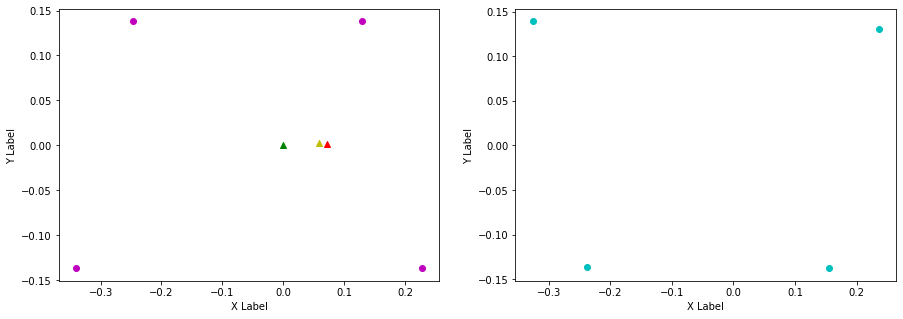

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.236, 0.142, FL (y): 0.13, 0.139.
FL displacement: -0.094, 0.009000000000000008.

FR (x): 0.156, 0.239, FR (y): -0.138, -0.136.
FR displacement: 0.08299999999999999, 0.0020000000000000018.

RL (x): -0.326, -0.236, RL (y): 0.139, 0.138.
RL displacement: 0.09000000000000002, -0.0010000000000000009.

RR (x): -0.238, -0.324, RR (y): -0.136, -0.139.
RR displacement: -0.08600000000000002, -0.0030000000000000027.


Base displacement (Foot): [0.094, -0.009000000000000008].

Base displacement (Odom): [[0.10820308296529557], [-0.010460225970341241]]. Rotation displacement: 1.0196693254834646.



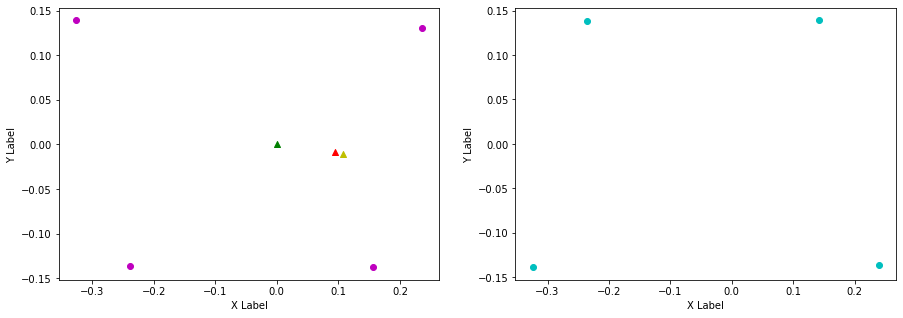

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.142, 0.224, FL (y): 0.139, 0.132.
FL displacement: 0.08200000000000002, -0.007000000000000006.

FR (x): 0.239, 0.119, FR (y): -0.136, -0.136.
FR displacement: -0.12, 0.0.

RL (x): -0.236, -0.363, RL (y): 0.138, 0.137.
RL displacement: -0.127, -0.0010000000000000009.

RR (x): -0.324, -0.249, RR (y): -0.139, -0.137.
RR displacement: 0.07500000000000001, 0.0020000000000000018.


Base displacement (Foot): [0.12, -0.0].

Base displacement (Odom): [[0.07357906088404098], [0.003853690968272261]]. Rotation displacement: -1.9194503727933954.



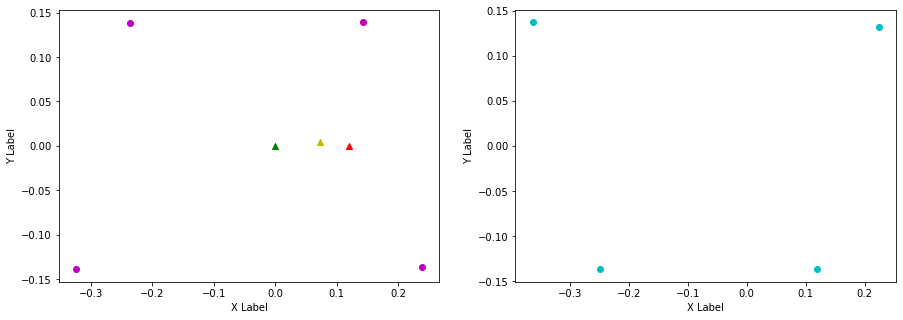

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.224, 0.129, FL (y): 0.132, 0.138.
FL displacement: -0.095, 0.006000000000000005.

FR (x): 0.119, 0.229, FR (y): -0.136, -0.137.
FR displacement: 0.11000000000000001, -0.0010000000000000009.

RL (x): -0.363, -0.246, RL (y): 0.137, 0.138.
RL displacement: 0.11699999999999999, 0.0010000000000000009.

RR (x): -0.249, -0.341, RR (y): -0.137, -0.137.
RR displacement: -0.09200000000000003, 0.0.


Base displacement (Foot): [0.095, -0.006000000000000005].

Base displacement (Odom): [[0.09135728273478705], [-0.007167079743455318]]. Rotation displacement: 0.7716290854602641.



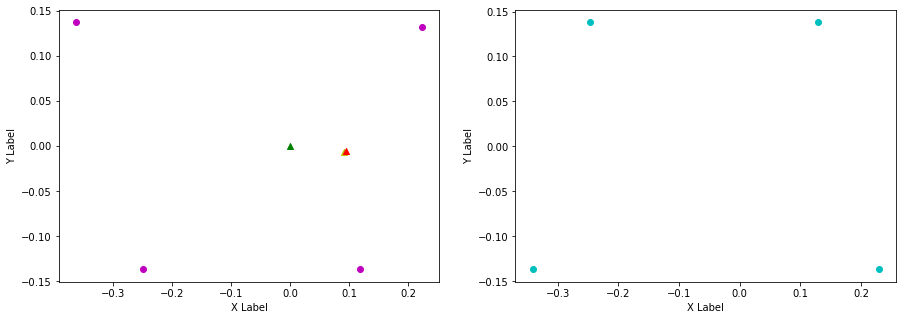

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.129, 0.235, FL (y): 0.138, 0.13.
FL displacement: 0.10599999999999998, -0.008000000000000007.

FR (x): 0.229, 0.154, FR (y): -0.137, -0.138.
FR displacement: -0.07500000000000001, -0.0010000000000000009.

RL (x): -0.246, -0.327, RL (y): 0.138, 0.139.
RL displacement: -0.08100000000000002, 0.0010000000000000009.

RR (x): -0.341, -0.239, RR (y): -0.137, -0.136.
RR displacement: 0.10200000000000004, 0.0010000000000000009.


Base displacement (Foot): [0.07500000000000001, 0.0010000000000000009].

Base displacement (Odom): [[0.04766273379516184], [0.0012184158787142962]]. Rotation displacement: -1.150448670901645.



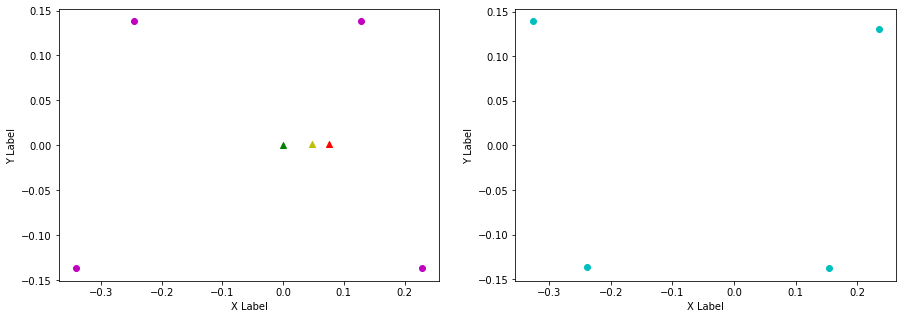

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.235, 0.132, FL (y): 0.13, 0.138.
FL displacement: -0.10299999999999998, 0.008000000000000007.

FR (x): 0.154, 0.23, FR (y): -0.138, -0.136.
FR displacement: 0.07600000000000001, 0.0020000000000000018.

RL (x): -0.327, -0.244, RL (y): 0.139, 0.138.
RL displacement: 0.08300000000000002, -0.0010000000000000009.

RR (x): -0.239, -0.336, RR (y): -0.136, -0.138.
RR displacement: -0.09700000000000003, -0.0020000000000000018.


Base displacement (Foot): [0.10299999999999998, -0.008000000000000007].

Base displacement (Odom): [[0.06905156069321716], [-0.005614784833340991]]. Rotation displacement: 1.1953317502590213.



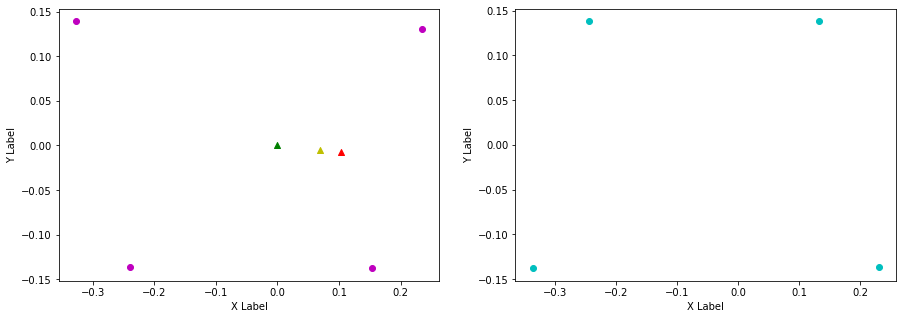

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.132, 0.231, FL (y): 0.138, 0.129.
FL displacement: 0.099, -0.009000000000000008.

FR (x): 0.23, 0.151, FR (y): -0.136, -0.137.
FR displacement: -0.07900000000000001, -0.0010000000000000009.

RL (x): -0.244, -0.335, RL (y): 0.138, 0.138.
RL displacement: -0.09100000000000003, 0.0.

RR (x): -0.336, -0.242, RR (y): -0.138, -0.136.
RR displacement: 0.09400000000000003, 0.0020000000000000018.


Base displacement (Foot): [0.07900000000000001, 0.0010000000000000009].

Base displacement (Odom): [[0.07002209806397808], [0.0030166841344403394]]. Rotation displacement: -1.7866194979937264.



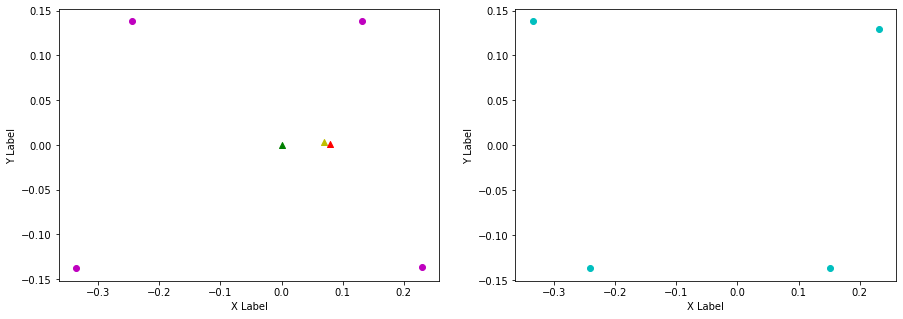

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.231, 0.138, FL (y): 0.129, 0.139.
FL displacement: -0.093, 0.010000000000000009.

FR (x): 0.151, 0.235, FR (y): -0.137, -0.135.
FR displacement: 0.08399999999999999, 0.0020000000000000018.

RL (x): -0.335, -0.24, RL (y): 0.138, 0.138.
RL displacement: 0.09500000000000003, 0.0.

RR (x): -0.242, -0.327, RR (y): -0.136, -0.138.
RR displacement: -0.08500000000000002, -0.0020000000000000018.


Base displacement (Foot): [0.093, -0.010000000000000009].

Base displacement (Odom): [[0.05735740623810193], [-0.005461177699981334]]. Rotation displacement: 1.2409224656271813.



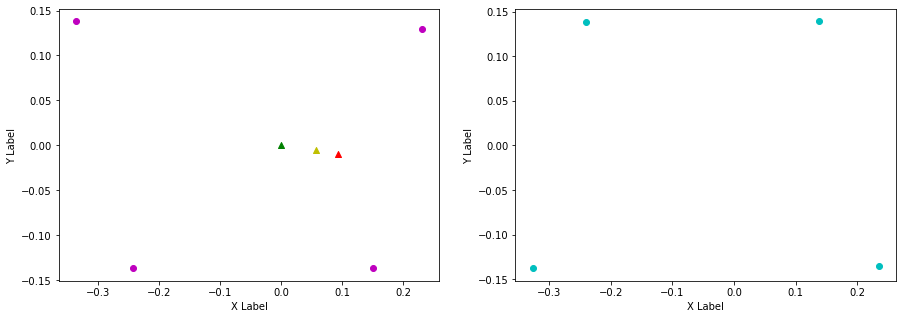

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.138, 0.224, FL (y): 0.139, 0.131.
FL displacement: 0.086, -0.008000000000000007.

FR (x): 0.235, 0.119, FR (y): -0.135, -0.135.
FR displacement: -0.11599999999999999, 0.0.

RL (x): -0.24, -0.361, RL (y): 0.138, 0.137.
RL displacement: -0.121, -0.0010000000000000009.

RR (x): -0.327, -0.25, RR (y): -0.138, -0.137.
RR displacement: 0.07700000000000001, 0.0010000000000000009.


Base displacement (Foot): [0.11599999999999999, -0.0].

Base displacement (Odom): [[0.12168734301875572], [0.01190902565102725]]. Rotation displacement: -2.1363557899593877.



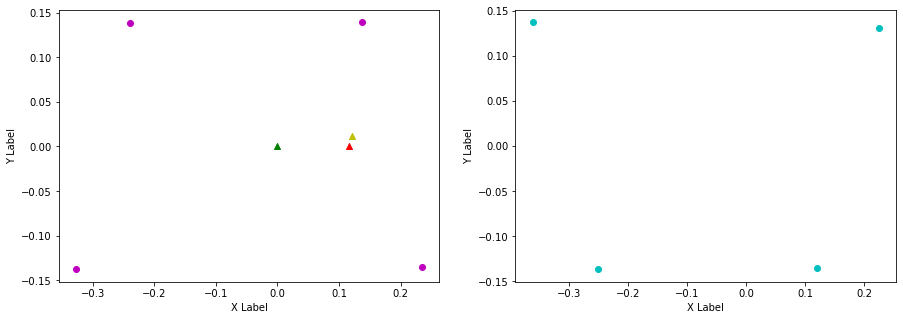

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.224, 0.125, FL (y): 0.131, 0.137.
FL displacement: -0.099, 0.006000000000000005.

FR (x): 0.119, 0.227, FR (y): -0.135, -0.137.
FR displacement: 0.10800000000000001, -0.0020000000000000018.

RL (x): -0.361, -0.248, RL (y): 0.137, 0.138.
RL displacement: 0.11299999999999999, 0.0010000000000000009.

RR (x): -0.25, -0.345, RR (y): -0.137, -0.137.
RR displacement: -0.09499999999999997, 0.0.


Base displacement (Foot): [0.099, -0.006000000000000005].

Base displacement (Odom): [[0.10446446047459634], [-0.008651241835805124]]. Rotation displacement: 1.0901874321401426.



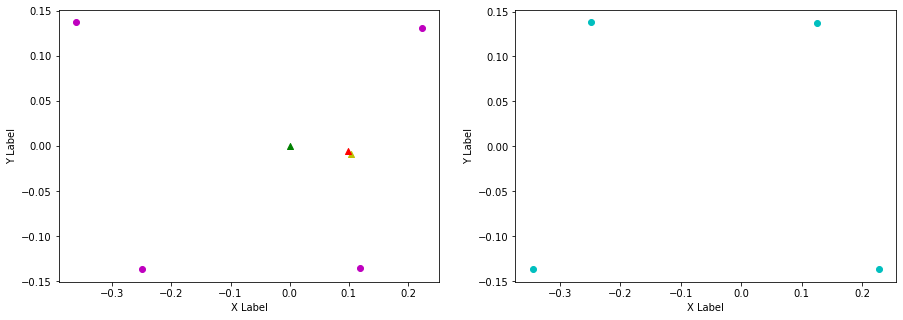

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.125, 0.226, FL (y): 0.137, 0.131.
FL displacement: 0.101, -0.006000000000000005.

FR (x): 0.227, 0.124, FR (y): -0.137, -0.136.
FR displacement: -0.10300000000000001, 0.0010000000000000009.

RL (x): -0.248, -0.356, RL (y): 0.138, 0.137.
RL displacement: -0.10799999999999998, -0.0010000000000000009.

RR (x): -0.345, -0.248, RR (y): -0.137, -0.137.
RR displacement: 0.09699999999999998, 0.0.


Base displacement (Foot): [0.10300000000000001, -0.0010000000000000009].

Base displacement (Odom): [[0.08388920667393673], [0.005819352809936618]]. Rotation displacement: -1.214728576652496.



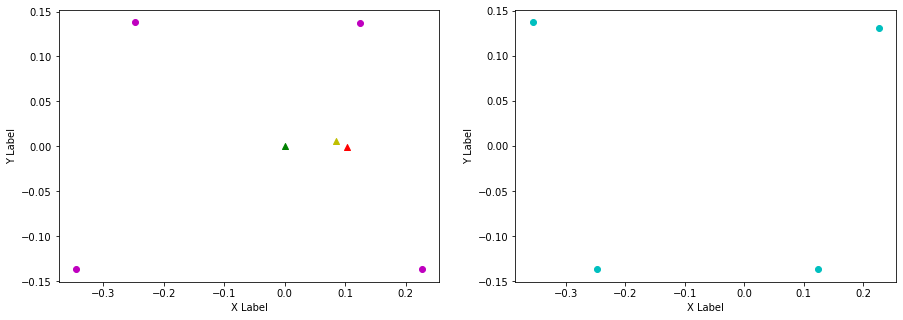

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.226, 0.143, FL (y): 0.131, 0.139.
FL displacement: -0.08300000000000002, 0.008000000000000007.

FR (x): 0.124, 0.241, FR (y): -0.136, -0.135.
FR displacement: 0.11699999999999999, 0.0010000000000000009.

RL (x): -0.356, -0.235, RL (y): 0.137, 0.138.
RL displacement: 0.121, 0.0010000000000000009.

RR (x): -0.248, -0.322, RR (y): -0.137, -0.139.
RR displacement: -0.07400000000000001, -0.0020000000000000018.


Base displacement (Foot): [0.08300000000000002, -0.008000000000000007].

Base displacement (Odom): [[0.0818168582531289], [-0.00967852007718406]]. Rotation displacement: 0.718117247387681.



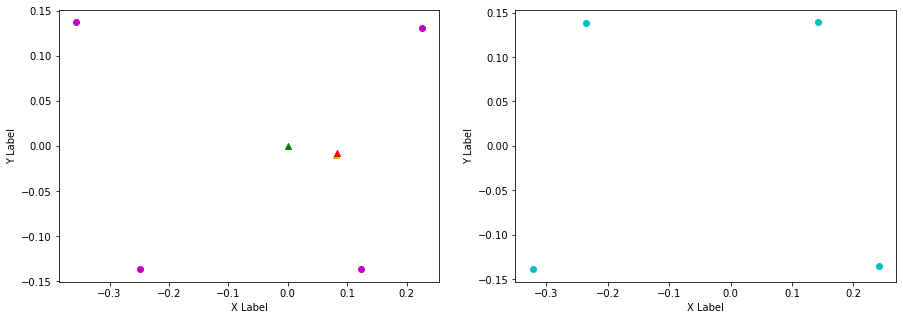

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.143, 0.225, FL (y): 0.139, 0.131.
FL displacement: 0.08200000000000002, -0.008000000000000007.

FR (x): 0.241, 0.122, FR (y): -0.135, -0.136.
FR displacement: -0.119, -0.0010000000000000009.

RL (x): -0.235, -0.358, RL (y): 0.138, 0.137.
RL displacement: -0.123, -0.0010000000000000009.

RR (x): -0.322, -0.249, RR (y): -0.139, -0.136.
RR displacement: 0.07300000000000001, 0.0030000000000000027.


Base displacement (Foot): [0.119, 0.0010000000000000009].

Base displacement (Odom): [[0.10760398566689444], [0.005157443270181972]]. Rotation displacement: -1.7607633009549302.



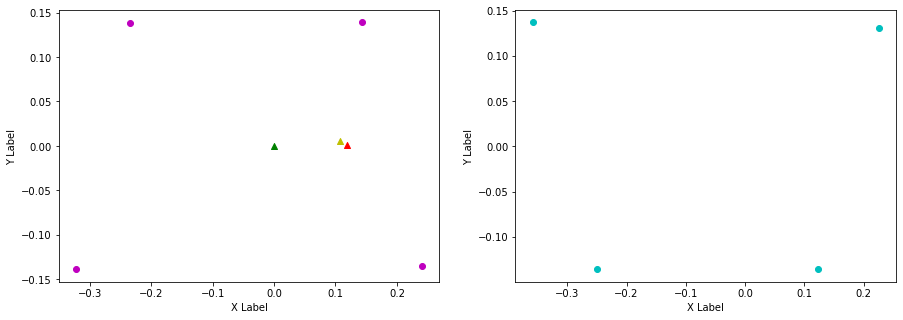

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.225, 0.125, FL (y): 0.131, 0.138.
FL displacement: -0.1, 0.007000000000000006.

FR (x): 0.122, 0.227, FR (y): -0.136, -0.137.
FR displacement: 0.10500000000000001, -0.0010000000000000009.

RL (x): -0.358, -0.248, RL (y): 0.137, 0.138.
RL displacement: 0.10999999999999999, 0.0010000000000000009.

RR (x): -0.249, -0.344, RR (y): -0.136, -0.137.
RR displacement: -0.09499999999999997, -0.0010000000000000009.


Base displacement (Foot): [0.1, -0.007000000000000006].

Base displacement (Odom): [[0.07826011342210926], [-0.007097063530787651]]. Rotation displacement: 0.5742943478410799.



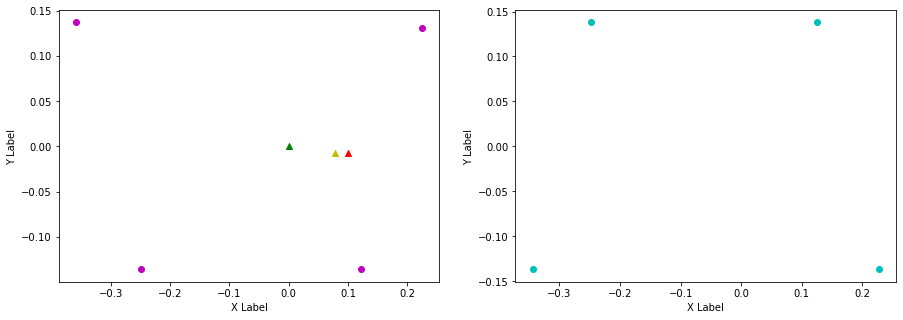

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.125, 0.239, FL (y): 0.138, 0.13.
FL displacement: 0.11399999999999999, -0.008000000000000007.

FR (x): 0.227, 0.156, FR (y): -0.137, -0.139.
FR displacement: -0.07100000000000001, -0.0020000000000000018.

RL (x): -0.248, -0.323, RL (y): 0.138, 0.139.
RL displacement: -0.07500000000000001, 0.0010000000000000009.

RR (x): -0.344, -0.235, RR (y): -0.137, -0.135.
RR displacement: 0.10899999999999999, 0.0020000000000000018.


Base displacement (Foot): [0.07100000000000001, 0.0020000000000000018].

Base displacement (Odom): [[0.04211974169239818], [0.005083122804284912]]. Rotation displacement: -0.8503878352147296.



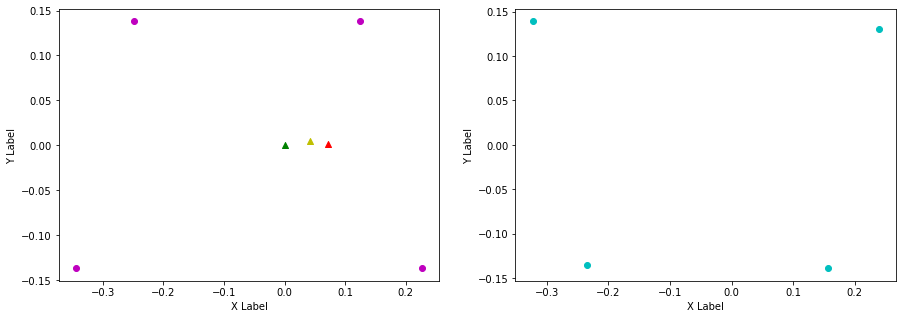

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.239, 0.119, FL (y): 0.13, 0.137.
FL displacement: -0.12, 0.007000000000000006.

FR (x): 0.156, 0.223, FR (y): -0.139, -0.137.
FR displacement: 0.067, 0.0020000000000000018.

RL (x): -0.323, -0.251, RL (y): 0.139, 0.139.
RL displacement: 0.07200000000000001, 0.0.

RR (x): -0.235, -0.351, RR (y): -0.135, -0.136.
RR displacement: -0.11599999999999999, -0.0010000000000000009.


Base displacement (Foot): [0.12, -0.007000000000000006].

Base displacement (Odom): [[0.0842229818072684], [-0.0074767914921825]]. Rotation displacement: 1.109456086142493.



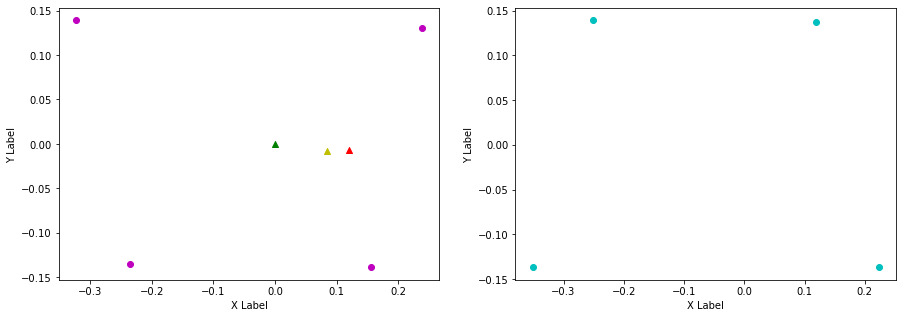

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.119, 0.228, FL (y): 0.137, 0.13.
FL displacement: 0.10900000000000001, -0.007000000000000006.

FR (x): 0.223, 0.136, FR (y): -0.137, -0.136.
FR displacement: -0.087, 0.0010000000000000009.

RL (x): -0.251, -0.347, RL (y): 0.139, 0.138.
RL displacement: -0.09599999999999997, -0.0010000000000000009.

RR (x): -0.351, -0.246, RR (y): -0.136, -0.136.
RR displacement: 0.10499999999999998, 0.0.


Base displacement (Foot): [0.087, -0.0010000000000000009].

Base displacement (Odom): [[0.07844708958212498], [0.00546923299240909]]. Rotation displacement: -1.688408333904744.



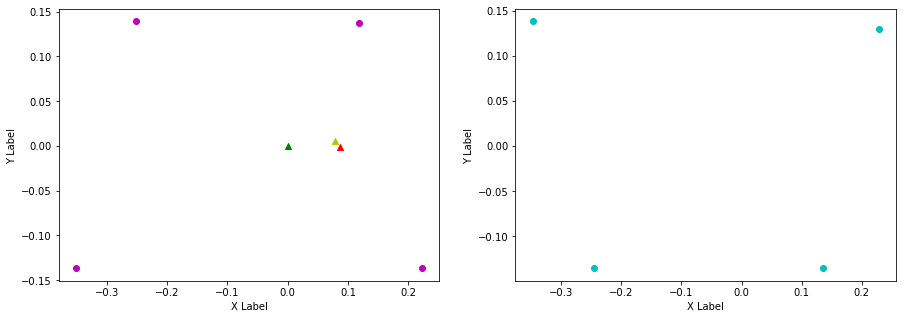

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.228, 0.125, FL (y): 0.13, 0.137.
FL displacement: -0.10300000000000001, 0.007000000000000006.

FR (x): 0.136, 0.226, FR (y): -0.136, -0.136.
FR displacement: 0.09, 0.0.

RL (x): -0.347, -0.248, RL (y): 0.138, 0.138.
RL displacement: 0.09899999999999998, 0.0.

RR (x): -0.246, -0.344, RR (y): -0.136, -0.137.
RR displacement: -0.09799999999999998, -0.0010000000000000009.


Base displacement (Foot): [0.10300000000000001, -0.007000000000000006].

Base displacement (Odom): [[0.06497343528273491], [-0.007244387177259171]]. Rotation displacement: 0.8480277034614544.



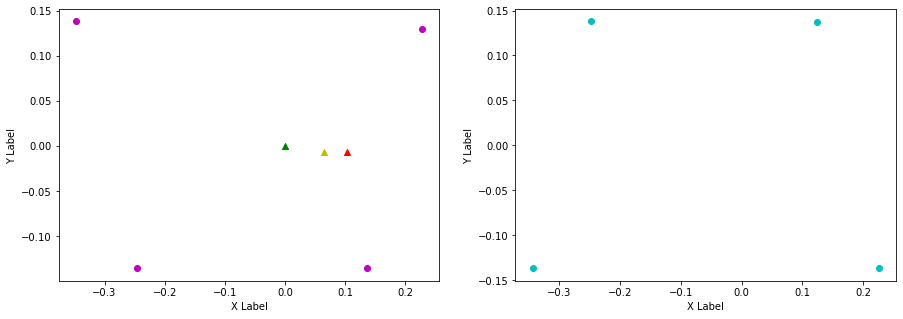

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.125, 0.234, FL (y): 0.137, 0.129.
FL displacement: 0.10900000000000001, -0.008000000000000007.

FR (x): 0.226, 0.156, FR (y): -0.136, -0.137.
FR displacement: -0.07, -0.0010000000000000009.

RL (x): -0.248, -0.327, RL (y): 0.138, 0.138.
RL displacement: -0.07900000000000001, 0.0.

RR (x): -0.344, -0.24, RR (y): -0.137, -0.136.
RR displacement: 0.10399999999999998, 0.0010000000000000009.


Base displacement (Foot): [0.07, 0.0010000000000000009].

Base displacement (Odom): [[0.10125292533269858], [0.010699538864251679]]. Rotation displacement: -1.731184270038857.



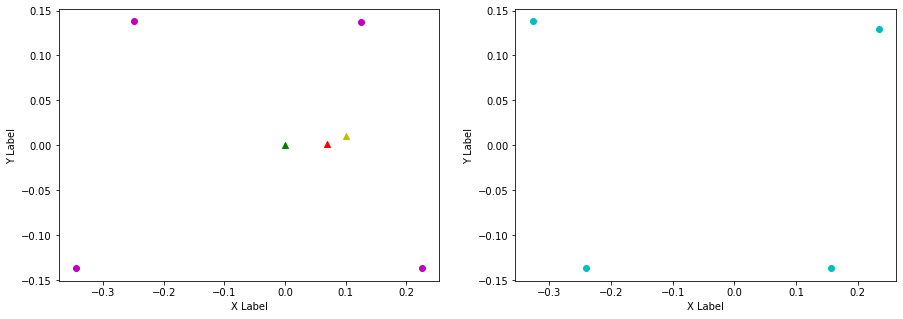

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.234, 0.132, FL (y): 0.129, 0.138.
FL displacement: -0.10200000000000001, 0.009000000000000008.

FR (x): 0.156, 0.23, FR (y): -0.137, -0.136.
FR displacement: 0.07400000000000001, 0.0010000000000000009.

RL (x): -0.327, -0.245, RL (y): 0.138, 0.138.
RL displacement: 0.08200000000000002, 0.0.

RR (x): -0.24, -0.335, RR (y): -0.136, -0.138.
RR displacement: -0.09500000000000003, -0.0020000000000000018.


Base displacement (Foot): [0.10200000000000001, -0.009000000000000008].

Base displacement (Odom): [[0.06360877429276046], [-0.005869747510727663]]. Rotation displacement: 1.1638614279729738.



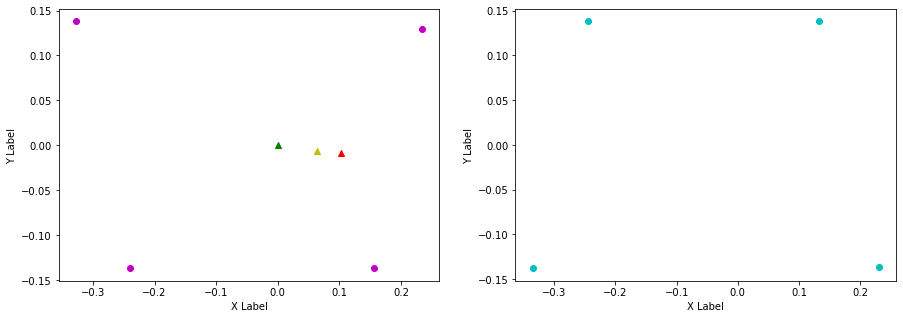

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.132, 0.232, FL (y): 0.138, 0.13.
FL displacement: 0.1, -0.008000000000000007.

FR (x): 0.23, 0.148, FR (y): -0.136, -0.137.
FR displacement: -0.08200000000000002, -0.0010000000000000009.

RL (x): -0.245, -0.334, RL (y): 0.138, 0.138.
RL displacement: -0.08900000000000002, 0.0.

RR (x): -0.335, -0.243, RR (y): -0.138, -0.136.
RR displacement: 0.09200000000000003, 0.0020000000000000018.


Base displacement (Foot): [0.08200000000000002, 0.0010000000000000009].

Base displacement (Odom): [[0.09066901924947102], [0.009373001531042036]]. Rotation displacement: 358.3329059117463.



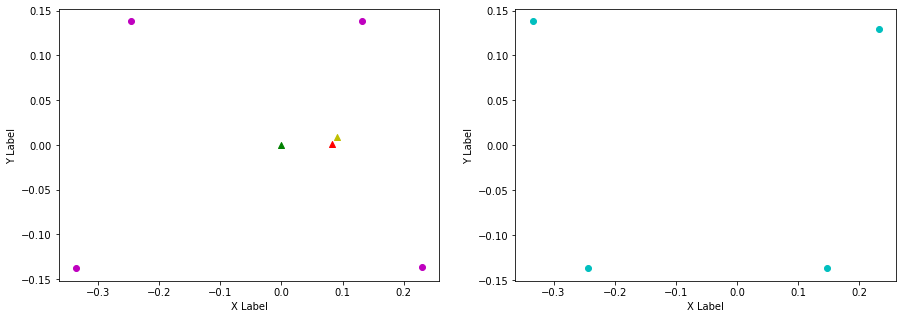

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.232, 0.125, FL (y): 0.13, 0.138.
FL displacement: -0.10700000000000001, 0.008000000000000007.

FR (x): 0.148, 0.226, FR (y): -0.137, -0.137.
FR displacement: 0.07800000000000001, 0.0.

RL (x): -0.334, -0.248, RL (y): 0.138, 0.138.
RL displacement: 0.08600000000000002, 0.0.

RR (x): -0.243, -0.344, RR (y): -0.136, -0.137.
RR displacement: -0.10099999999999998, -0.0010000000000000009.


Base displacement (Foot): [0.10700000000000001, -0.008000000000000007].

Base displacement (Odom): [[0.056740630600017106], [-0.005777625239407058]]. Rotation displacement: -358.8151715237765.



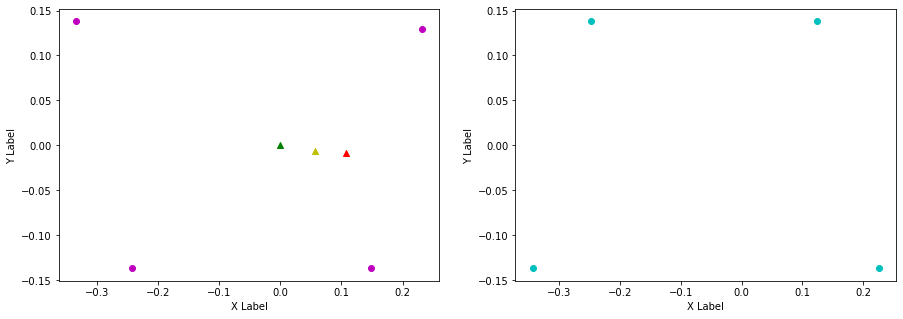

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.125, 0.227, FL (y): 0.138, 0.13.
FL displacement: 0.10200000000000001, -0.008000000000000007.

FR (x): 0.226, 0.131, FR (y): -0.137, -0.136.
FR displacement: -0.095, 0.0010000000000000009.

RL (x): -0.248, -0.352, RL (y): 0.138, 0.137.
RL displacement: -0.10399999999999998, -0.0010000000000000009.

RR (x): -0.344, -0.247, RR (y): -0.137, -0.136.
RR displacement: 0.09699999999999998, 0.0010000000000000009.


Base displacement (Foot): [0.095, -0.0010000000000000009].

Base displacement (Odom): [[0.0736643037145921], [0.005059131741145251]]. Rotation displacement: 358.3467795295769.



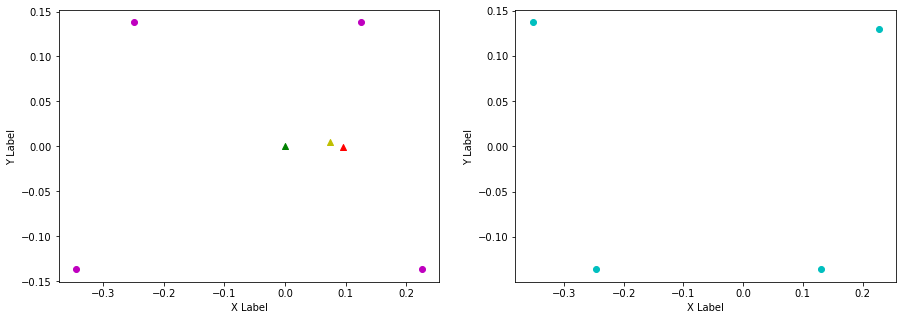

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.227, 0.14, FL (y): 0.13, 0.139.
FL displacement: -0.087, 0.009000000000000008.

FR (x): 0.131, 0.237, FR (y): -0.136, -0.135.
FR displacement: 0.10599999999999998, 0.0010000000000000009.

RL (x): -0.352, -0.238, RL (y): 0.137, 0.138.
RL displacement: 0.11399999999999999, 0.0010000000000000009.

RR (x): -0.247, -0.325, RR (y): -0.136, -0.139.
RR displacement: -0.07800000000000001, -0.0030000000000000027.


Base displacement (Foot): [0.087, -0.009000000000000008].

Base displacement (Odom): [[0.060287038909213386], [-0.009816570753248044]]. Rotation displacement: -359.10284289298755.



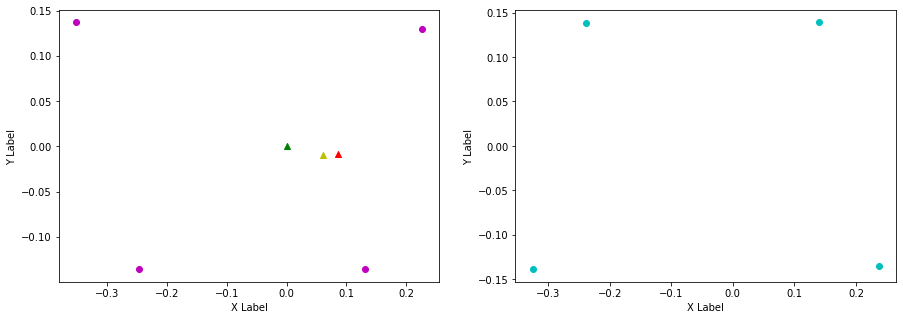

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.14, 0.237, FL (y): 0.139, 0.13.
FL displacement: 0.09699999999999998, -0.009000000000000008.

FR (x): 0.237, 0.156, FR (y): -0.135, -0.138.
FR displacement: -0.08099999999999999, -0.0030000000000000027.

RL (x): -0.238, -0.325, RL (y): 0.138, 0.139.
RL displacement: -0.08700000000000002, 0.0010000000000000009.

RR (x): -0.325, -0.237, RR (y): -0.139, -0.136.
RR displacement: 0.08800000000000002, 0.0030000000000000027.


Base displacement (Foot): [0.08099999999999999, 0.0030000000000000027].

Base displacement (Odom): [[0.10487194297701397], [0.007238238662301555]]. Rotation displacement: 358.0959418620473.



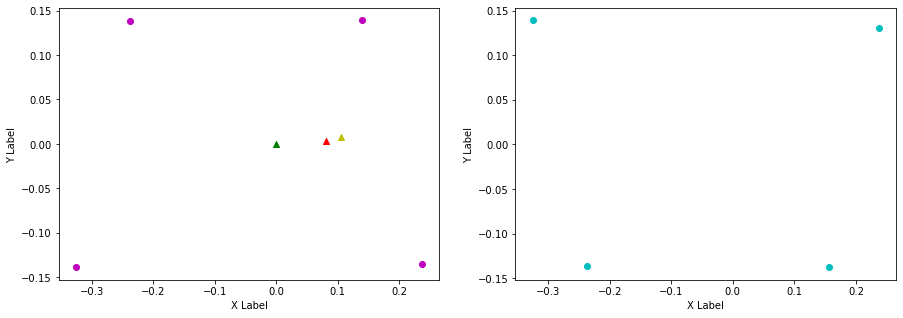

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.237, 0.141, FL (y): 0.13, 0.139.
FL displacement: -0.096, 0.009000000000000008.

FR (x): 0.156, 0.239, FR (y): -0.138, -0.135.
FR displacement: 0.08299999999999999, 0.0030000000000000027.

RL (x): -0.325, -0.236, RL (y): 0.139, 0.138.
RL displacement: 0.08900000000000002, -0.0010000000000000009.

RR (x): -0.237, -0.324, RR (y): -0.136, -0.139.
RR displacement: -0.08700000000000002, -0.0030000000000000027.


Base displacement (Foot): [0.096, -0.009000000000000008].

Base displacement (Odom): [[0.07067272253007673], [-0.006982841502479076]]. Rotation displacement: 1.5135971949184177.



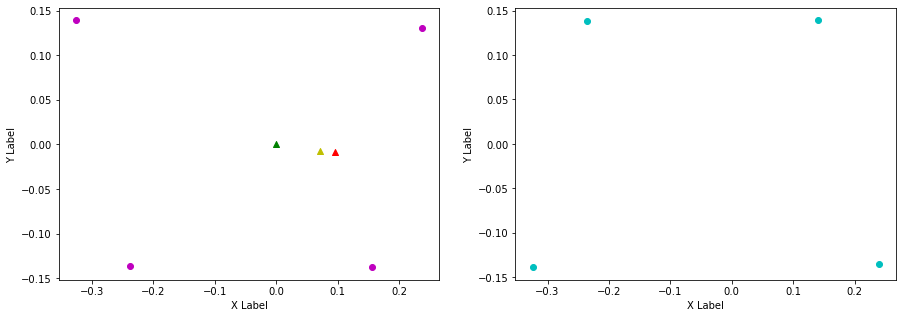

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.141, 0.234, FL (y): 0.139, 0.13.
FL displacement: 0.09300000000000003, -0.009000000000000008.

FR (x): 0.239, 0.158, FR (y): -0.135, -0.137.
FR displacement: -0.08099999999999999, -0.0020000000000000018.

RL (x): -0.236, -0.327, RL (y): 0.138, 0.138.
RL displacement: -0.09100000000000003, 0.0.

RR (x): -0.324, -0.24, RR (y): -0.139, -0.136.
RR displacement: 0.08400000000000002, 0.0030000000000000027.


Base displacement (Foot): [0.08099999999999999, 0.0020000000000000018].

Base displacement (Odom): [[0.07378367796999585], [0.009620468304198937]]. Rotation displacement: -2.1171838562485013.



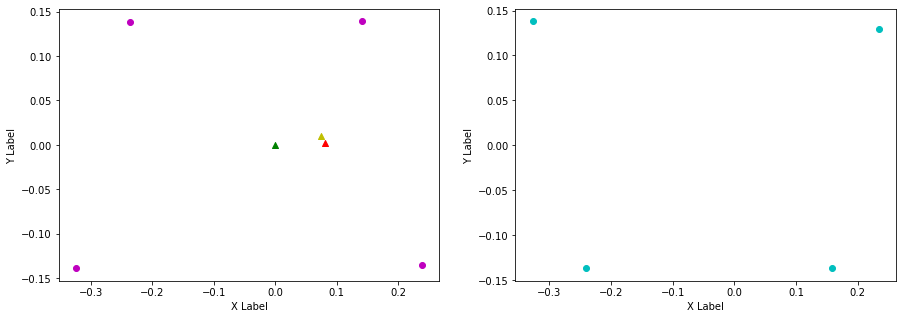

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.234, 0.134, FL (y): 0.13, 0.138.
FL displacement: -0.1, 0.008000000000000007.

FR (x): 0.158, 0.231, FR (y): -0.137, -0.135.
FR displacement: 0.07300000000000001, 0.0020000000000000018.

RL (x): -0.327, -0.243, RL (y): 0.138, 0.138.
RL displacement: 0.08400000000000002, 0.0.

RR (x): -0.24, -0.331, RR (y): -0.136, -0.138.
RR displacement: -0.09100000000000003, -0.0020000000000000018.


Base displacement (Foot): [0.1, -0.008000000000000007].

Base displacement (Odom): [[0.04632990264215264], [-0.0042721642965126705]]. Rotation displacement: 1.3381906796539373.



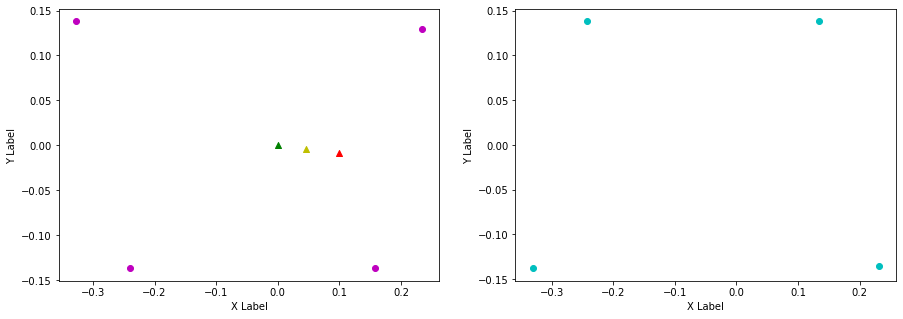

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.134, 0.231, FL (y): 0.138, 0.129.
FL displacement: 0.097, -0.009000000000000008.

FR (x): 0.231, 0.149, FR (y): -0.135, -0.137.
FR displacement: -0.08200000000000002, -0.0020000000000000018.

RL (x): -0.243, -0.334, RL (y): 0.138, 0.138.
RL displacement: -0.09100000000000003, 0.0.

RR (x): -0.331, -0.243, RR (y): -0.138, -0.136.
RR displacement: 0.08800000000000002, 0.0020000000000000018.


Base displacement (Foot): [0.08200000000000002, 0.0020000000000000018].

Base displacement (Odom): [[0.07426983313533686], [0.0026663263866595344]]. Rotation displacement: -1.8311120630557007.



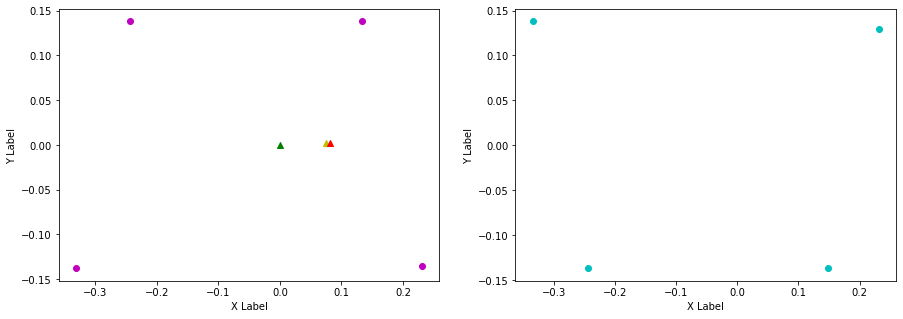

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.231, 0.136, FL (y): 0.129, 0.139.
FL displacement: -0.095, 0.010000000000000009.

FR (x): 0.149, 0.233, FR (y): -0.137, -0.135.
FR displacement: 0.08400000000000002, 0.0020000000000000018.

RL (x): -0.334, -0.241, RL (y): 0.138, 0.138.
RL displacement: 0.09300000000000003, 0.0.

RR (x): -0.243, -0.329, RR (y): -0.136, -0.138.
RR displacement: -0.08600000000000002, -0.0020000000000000018.


Base displacement (Foot): [0.095, -0.010000000000000009].

Base displacement (Odom): [[0.042946011471371115], [-0.006609893339954098]]. Rotation displacement: 1.4318851380400535.



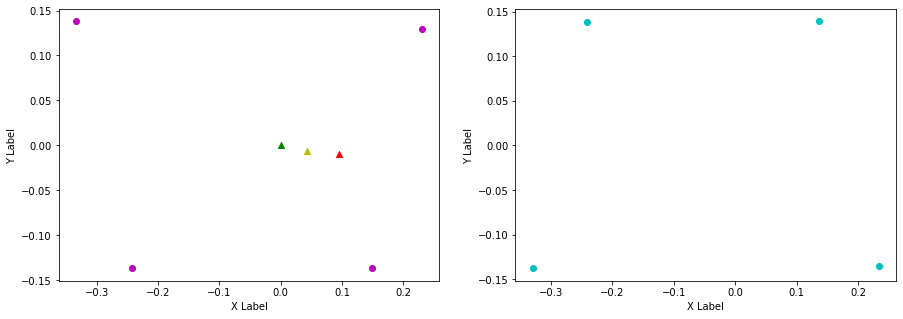

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.136, 0.227, FL (y): 0.139, 0.131.
FL displacement: 0.091, -0.008000000000000007.

FR (x): 0.233, 0.13, FR (y): -0.135, -0.136.
FR displacement: -0.10300000000000001, -0.0010000000000000009.

RL (x): -0.241, -0.352, RL (y): 0.138, 0.137.
RL displacement: -0.11099999999999999, -0.0010000000000000009.

RR (x): -0.329, -0.247, RR (y): -0.138, -0.136.
RR displacement: 0.08200000000000002, 0.0020000000000000018.


Base displacement (Foot): [0.10300000000000001, 0.0010000000000000009].

Base displacement (Odom): [[0.07736289230503557], [0.0023238738199058417]]. Rotation displacement: -1.9258358321770452.



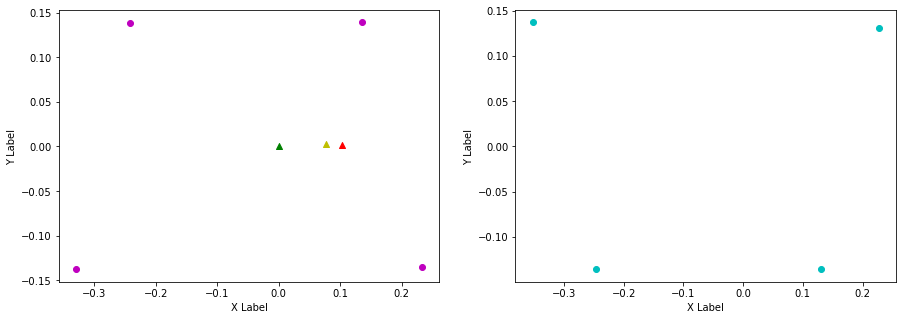

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.227, 0.118, FL (y): 0.131, 0.137.
FL displacement: -0.10900000000000001, 0.006000000000000005.

FR (x): 0.13, 0.223, FR (y): -0.136, -0.136.
FR displacement: 0.093, 0.0.

RL (x): -0.352, -0.251, RL (y): 0.137, 0.139.
RL displacement: 0.10099999999999998, 0.0020000000000000018.

RR (x): -0.247, -0.352, RR (y): -0.136, -0.136.
RR displacement: -0.10499999999999998, 0.0.


Base displacement (Foot): [0.10900000000000001, -0.006000000000000005].

Base displacement (Odom): [[0.0886351083668222], [-0.008771198422806492]]. Rotation displacement: 0.8992507565266921.



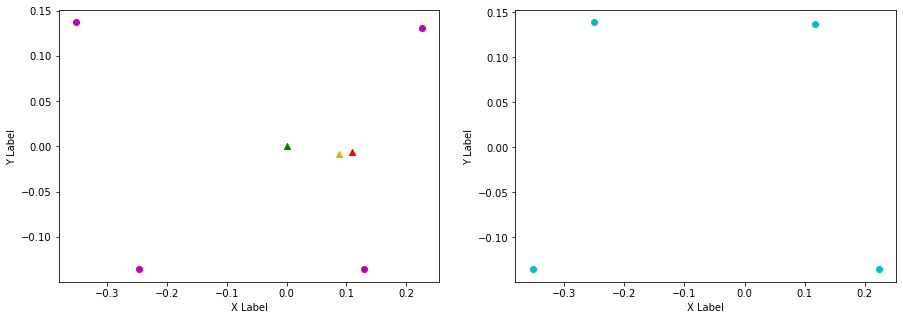

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.118, 0.232, FL (y): 0.137, 0.13.
FL displacement: 0.11400000000000002, -0.007000000000000006.

FR (x): 0.223, 0.148, FR (y): -0.136, -0.137.
FR displacement: -0.07500000000000001, -0.0010000000000000009.

RL (x): -0.251, -0.334, RL (y): 0.139, 0.138.
RL displacement: -0.08300000000000002, -0.0010000000000000009.

RR (x): -0.352, -0.242, RR (y): -0.136, -0.136.
RR displacement: 0.10999999999999999, 0.0.


Base displacement (Foot): [0.07500000000000001, 0.0010000000000000009].

Base displacement (Odom): [[0.07191583803634538], [0.007134616955775996]]. Rotation displacement: -1.1111623876733538.



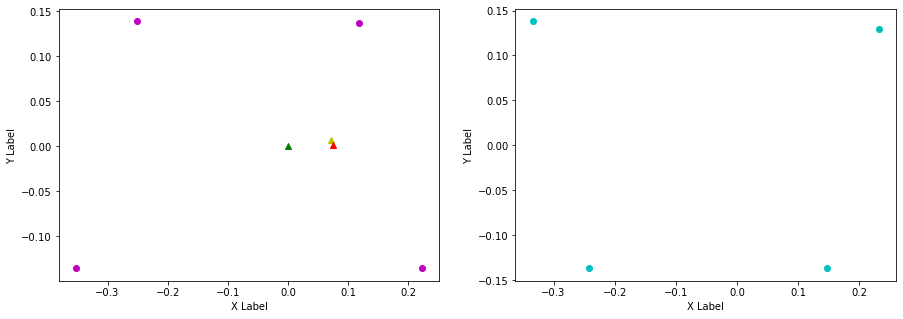

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.232, 0.134, FL (y): 0.13, 0.139.
FL displacement: -0.098, 0.009000000000000008.

FR (x): 0.148, 0.232, FR (y): -0.137, -0.136.
FR displacement: 0.08400000000000002, 0.0010000000000000009.

RL (x): -0.334, -0.243, RL (y): 0.138, 0.138.
RL displacement: 0.09100000000000003, 0.0.

RR (x): -0.242, -0.331, RR (y): -0.136, -0.138.
RR displacement: -0.08900000000000002, -0.0020000000000000018.


Base displacement (Foot): [0.098, -0.009000000000000008].

Base displacement (Odom): [[0.05043050908897673], [-0.00509917795238124]]. Rotation displacement: 0.7268631685142278.



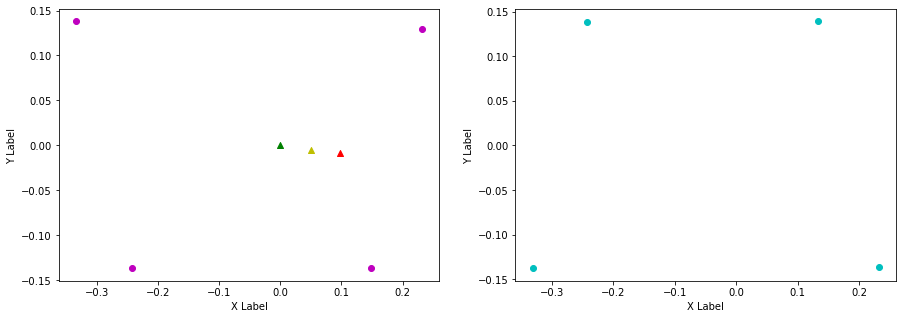

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.134, 0.228, FL (y): 0.139, 0.13.
FL displacement: 0.094, -0.009000000000000008.

FR (x): 0.232, 0.133, FR (y): -0.136, -0.137.
FR displacement: -0.099, -0.0010000000000000009.

RL (x): -0.243, -0.346, RL (y): 0.138, 0.137.
RL displacement: -0.10299999999999998, -0.0010000000000000009.

RR (x): -0.331, -0.245, RR (y): -0.138, -0.136.
RR displacement: 0.08600000000000002, 0.0020000000000000018.


Base displacement (Foot): [0.099, 0.0010000000000000009].

Base displacement (Odom): [[0.0944743290099499], [0.011993600392916193]]. Rotation displacement: -1.7611904177530493.



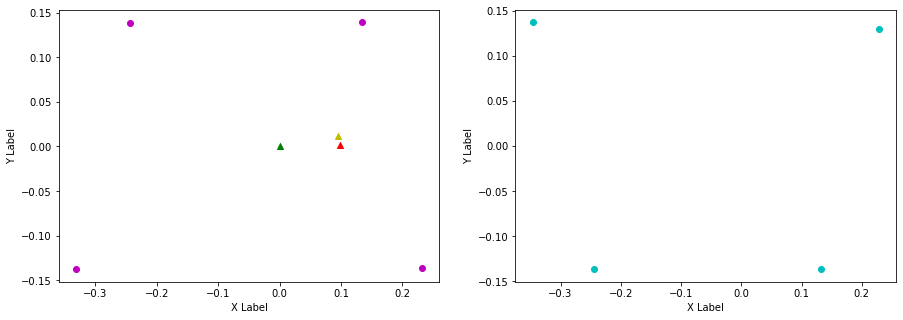

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.228, 0.132, FL (y): 0.13, 0.138.
FL displacement: -0.096, 0.008000000000000007.

FR (x): 0.133, 0.23, FR (y): -0.137, -0.136.
FR displacement: 0.097, 0.0010000000000000009.

RL (x): -0.346, -0.245, RL (y): 0.137, 0.138.
RL displacement: 0.10099999999999998, 0.0010000000000000009.

RR (x): -0.245, -0.335, RR (y): -0.136, -0.138.
RR displacement: -0.09000000000000002, -0.0020000000000000018.


Base displacement (Foot): [0.096, -0.008000000000000007].

Base displacement (Odom): [[0.07847084484729017], [-0.010339769758012096]]. Rotation displacement: 1.034229359040774.



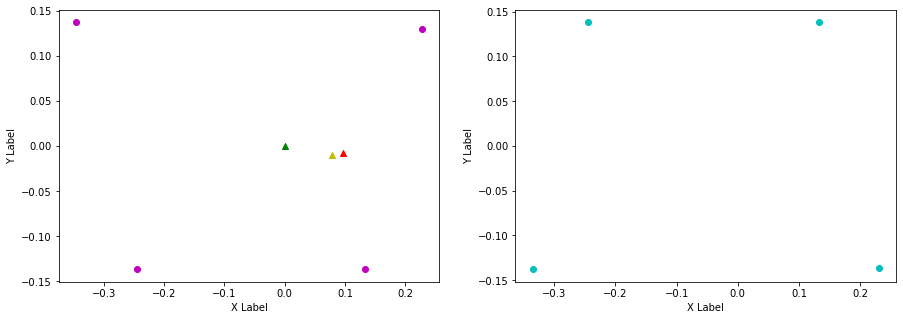

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.132, 0.245, FL (y): 0.138, 0.129.
FL displacement: 0.11299999999999999, -0.009000000000000008.

FR (x): 0.23, 0.156, FR (y): -0.136, -0.141.
FR displacement: -0.07400000000000001, -0.004999999999999977.

RL (x): -0.245, -0.316, RL (y): 0.138, 0.14.
RL displacement: -0.07100000000000001, 0.0020000000000000018.

RR (x): -0.335, -0.227, RR (y): -0.138, -0.135.
RR displacement: 0.10800000000000001, 0.0030000000000000027.


Base displacement (Foot): [0.07400000000000001, 0.004999999999999977].

Base displacement (Odom): [[0.0698452965590266], [0.006680413575601563]]. Rotation displacement: -1.5744851270245124.



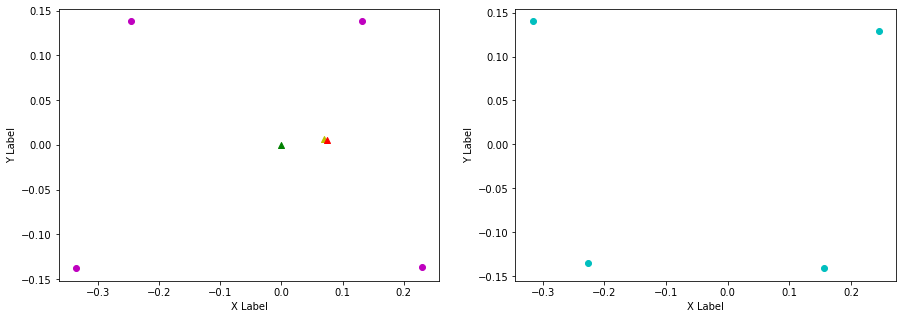

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.245, 0.122, FL (y): 0.129, 0.137.
FL displacement: -0.123, 0.008000000000000007.

FR (x): 0.156, 0.224, FR (y): -0.141, -0.137.
FR displacement: 0.068, 0.003999999999999976.

RL (x): -0.316, -0.25, RL (y): 0.14, 0.139.
RL displacement: 0.066, -0.0010000000000000009.

RR (x): -0.227, -0.348, RR (y): -0.135, -0.137.
RR displacement: -0.12099999999999997, -0.0020000000000000018.


Base displacement (Foot): [0.123, -0.008000000000000007].

Base displacement (Odom): [[0.10756926186002236], [-0.006228665372445263]]. Rotation displacement: 1.5314728046309978.



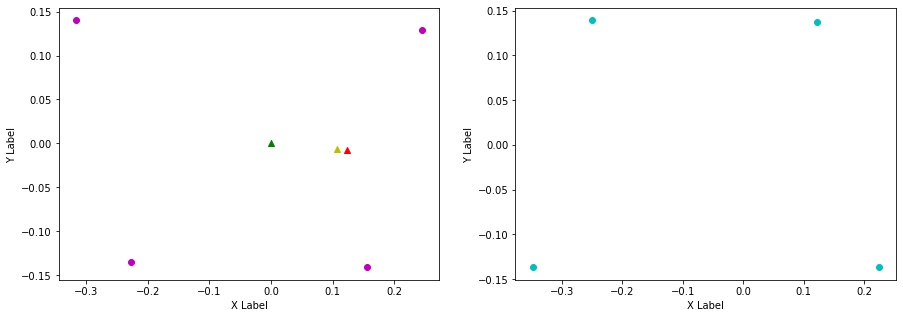

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.122, 0.236, FL (y): 0.137, 0.13.
FL displacement: 0.11399999999999999, -0.007000000000000006.

FR (x): 0.224, 0.156, FR (y): -0.137, -0.138.
FR displacement: -0.068, -0.0010000000000000009.

RL (x): -0.25, -0.326, RL (y): 0.139, 0.139.
RL displacement: -0.07600000000000001, 0.0.

RR (x): -0.348, -0.238, RR (y): -0.137, -0.136.
RR displacement: 0.10999999999999999, 0.0010000000000000009.


Base displacement (Foot): [0.068, 0.0010000000000000009].

Base displacement (Odom): [[0.05427825628869698], [0.009043251643809924]]. Rotation displacement: -1.7530355299536227.



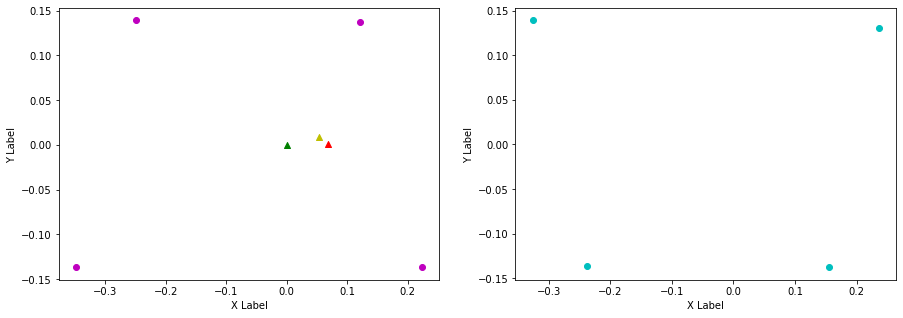

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.236, 0.137, FL (y): 0.13, 0.139.
FL displacement: -0.09899999999999998, 0.009000000000000008.

FR (x): 0.156, 0.234, FR (y): -0.138, -0.135.
FR displacement: 0.07800000000000001, 0.0030000000000000027.

RL (x): -0.326, -0.241, RL (y): 0.139, 0.138.
RL displacement: 0.08500000000000002, -0.0010000000000000009.

RR (x): -0.238, -0.329, RR (y): -0.136, -0.138.
RR displacement: -0.09100000000000003, -0.0020000000000000018.


Base displacement (Foot): [0.09899999999999998, -0.009000000000000008].

Base displacement (Odom): [[0.053626698728446165], [-0.004320089847301034]]. Rotation displacement: 0.9248091517761472.



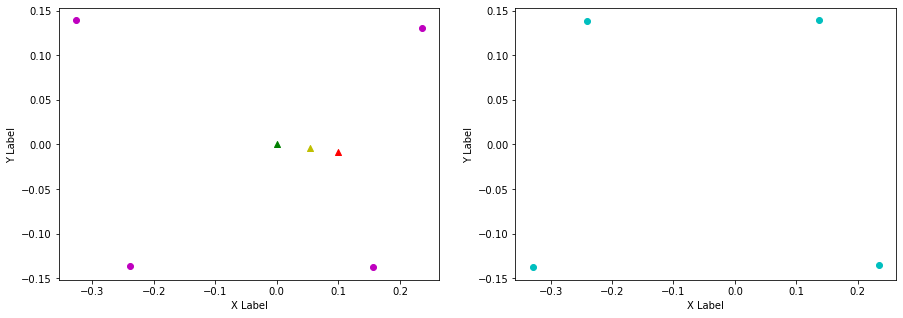

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.137, 0.237, FL (y): 0.139, 0.13.
FL displacement: 0.09999999999999998, -0.009000000000000008.

FR (x): 0.234, 0.155, FR (y): -0.135, -0.138.
FR displacement: -0.07900000000000001, -0.0030000000000000027.

RL (x): -0.241, -0.324, RL (y): 0.138, 0.139.
RL displacement: -0.08300000000000002, 0.0010000000000000009.

RR (x): -0.329, -0.237, RR (y): -0.138, -0.136.
RR displacement: 0.09200000000000003, 0.0020000000000000018.


Base displacement (Foot): [0.07900000000000001, 0.0030000000000000027].

Base displacement (Odom): [[0.11540274111606497], [0.009518128425488825]]. Rotation displacement: -1.818576797960796.



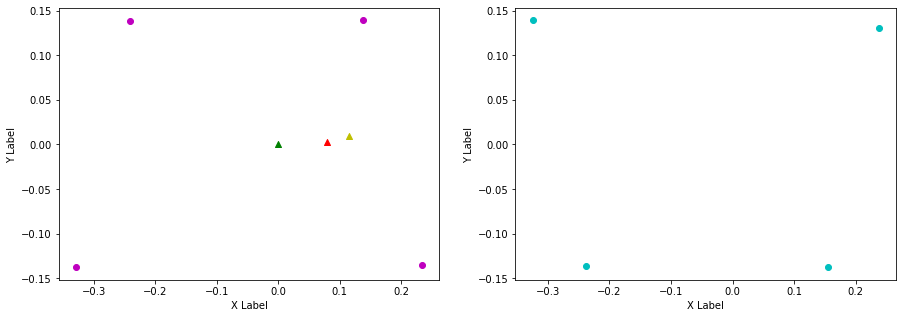

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.237, 0.143, FL (y): 0.13, 0.139.
FL displacement: -0.094, 0.009000000000000008.

FR (x): 0.155, 0.24, FR (y): -0.138, -0.135.
FR displacement: 0.08499999999999999, 0.0030000000000000027.

RL (x): -0.324, -0.235, RL (y): 0.139, 0.138.
RL displacement: 0.08900000000000002, -0.0010000000000000009.

RR (x): -0.237, -0.322, RR (y): -0.136, -0.139.
RR displacement: -0.08500000000000002, -0.0030000000000000027.


Base displacement (Foot): [0.094, -0.009000000000000008].

Base displacement (Odom): [[0.0896191035820153], [-0.007886351077145193]]. Rotation displacement: 1.1341798256265678.



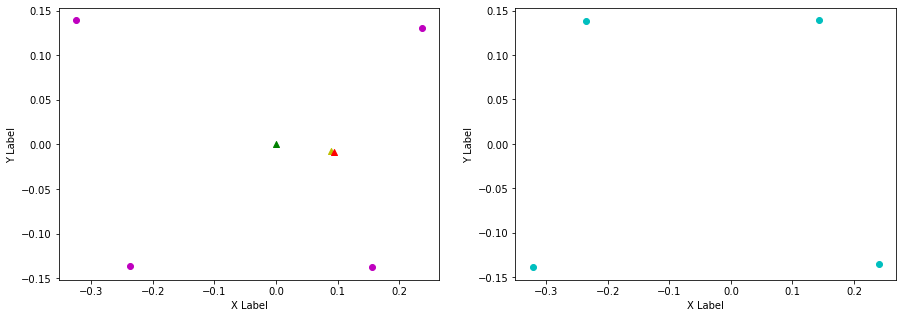

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.143, 0.234, FL (y): 0.139, 0.13.
FL displacement: 0.09100000000000003, -0.009000000000000008.

FR (x): 0.24, 0.155, FR (y): -0.135, -0.138.
FR displacement: -0.08499999999999999, -0.0030000000000000027.

RL (x): -0.235, -0.327, RL (y): 0.138, 0.138.
RL displacement: -0.09200000000000003, 0.0.

RR (x): -0.322, -0.239, RR (y): -0.139, -0.136.
RR displacement: 0.08300000000000002, 0.0030000000000000027.


Base displacement (Foot): [0.08499999999999999, 0.0030000000000000027].

Base displacement (Odom): [[0.08218615323354772], [0.008320052303602665]]. Rotation displacement: -1.5878266983583933.



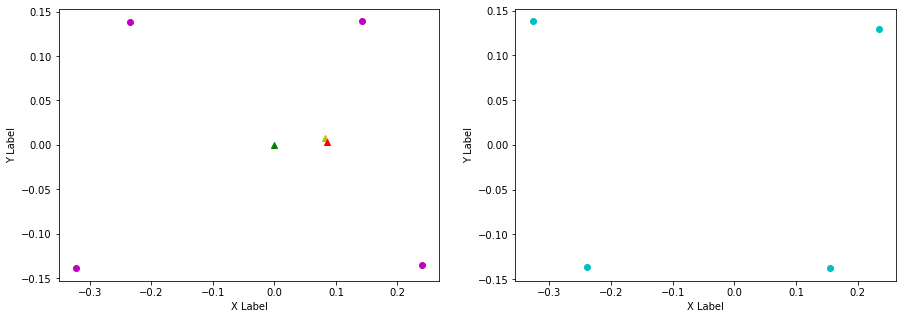

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.234, 0.121, FL (y): 0.13, 0.137.
FL displacement: -0.11300000000000002, 0.007000000000000006.

FR (x): 0.155, 0.224, FR (y): -0.138, -0.136.
FR displacement: 0.069, 0.0020000000000000018.

RL (x): -0.327, -0.25, RL (y): 0.138, 0.138.
RL displacement: 0.07700000000000001, 0.0.

RR (x): -0.239, -0.349, RR (y): -0.136, -0.136.
RR displacement: -0.10999999999999999, 0.0.


Base displacement (Foot): [0.11300000000000002, -0.007000000000000006].

Base displacement (Odom): [[0.09934365984289961], [-0.008130204880746561]]. Rotation displacement: 1.2968395170243436.



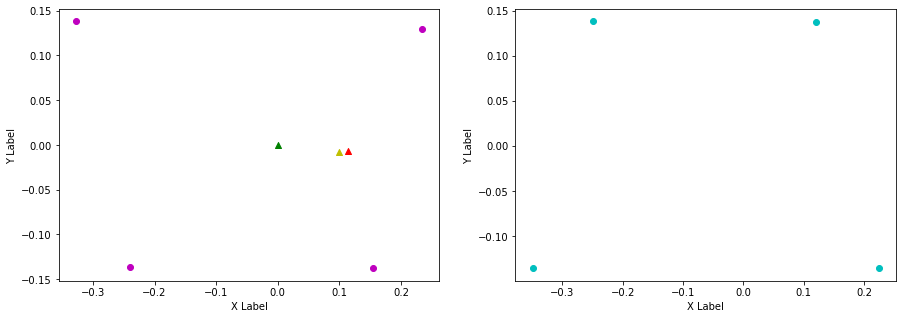

Command:  [0.3 0. ] 0.0
Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.121, 0.225, FL (y): 0.137, 0.131.
FL displacement: 0.10400000000000001, -0.006000000000000005.

FR (x): 0.224, 0.122, FR (y): -0.136, -0.136.
FR displacement: -0.10200000000000001, 0.0.

RL (x): -0.25, -0.356, RL (y): 0.138, 0.136.
RL displacement: -0.10599999999999998, -0.0020000000000000018.

RR (x): -0.349, -0.248, RR (y): -0.136, -0.136.
RR displacement: 0.10099999999999998, 0.0.


Base displacement (Foot): [0.10200000000000001, -0.0].

Base displacement (Odom): [[0.09814757757540526], [0.007105126780116322]]. Rotation displacement: -1.5182588232106933.



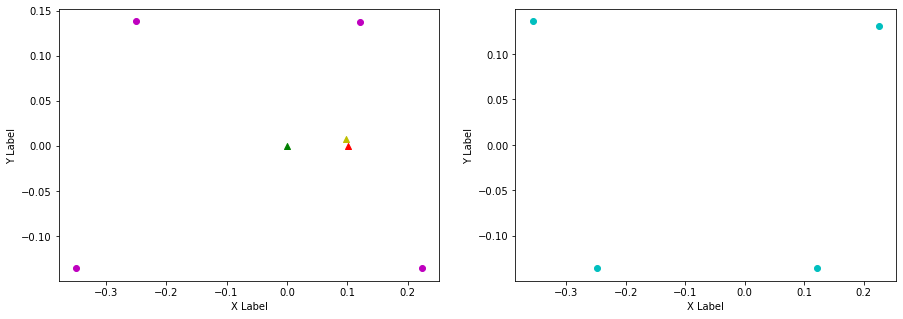

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.225, 0.125, FL (y): 0.131, 0.137.
FL displacement: -0.1, 0.006000000000000005.

FR (x): 0.122, 0.226, FR (y): -0.136, -0.136.
FR displacement: 0.10400000000000001, 0.0.

RL (x): -0.356, -0.248, RL (y): 0.136, 0.138.
RL displacement: 0.10799999999999998, 0.0020000000000000018.

RR (x): -0.248, -0.344, RR (y): -0.136, -0.137.
RR displacement: -0.09599999999999997, -0.0010000000000000009.


Base displacement (Foot): [0.1, -0.006000000000000005].

Base displacement (Odom): [[0.07769725420370133], [-0.006121419032588449]]. Rotation displacement: 0.7464991451053298.



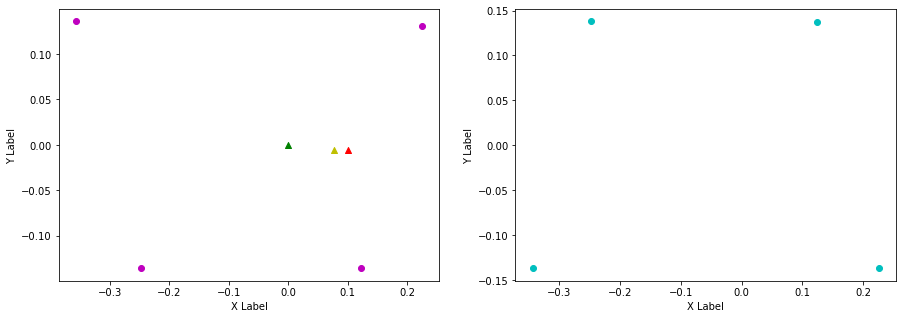

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.125, 0.228, FL (y): 0.137, 0.131.
FL displacement: 0.10300000000000001, -0.006000000000000005.

FR (x): 0.226, 0.134, FR (y): -0.136, -0.137.
FR displacement: -0.092, -0.0010000000000000009.

RL (x): -0.248, -0.346, RL (y): 0.138, 0.137.
RL displacement: -0.09799999999999998, -0.0010000000000000009.

RR (x): -0.344, -0.245, RR (y): -0.137, -0.136.
RR displacement: 0.09899999999999998, 0.0010000000000000009.


Base displacement (Foot): [0.092, 0.0010000000000000009].

Base displacement (Odom): [[0.08292710473127496], [0.006329703506043671]]. Rotation displacement: -1.3848303329940297.



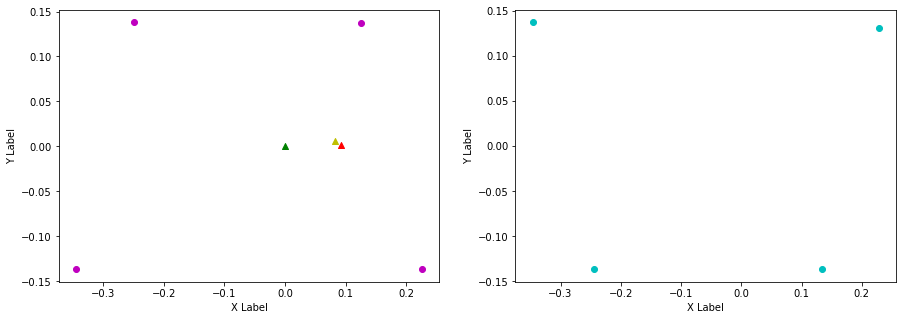

Command:  [0.3 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.228, 0.132, FL (y): 0.131, 0.138.
FL displacement: -0.096, 0.007000000000000006.

FR (x): 0.134, 0.229, FR (y): -0.137, -0.135.
FR displacement: 0.095, 0.0020000000000000018.

RL (x): -0.346, -0.245, RL (y): 0.137, 0.138.
RL displacement: 0.10099999999999998, 0.0010000000000000009.

RR (x): -0.245, -0.335, RR (y): -0.136, -0.138.
RR displacement: -0.09000000000000002, -0.0020000000000000018.


Base displacement (Foot): [0.096, -0.007000000000000006].

Base displacement (Odom): [[0.06997474272612436], [-0.007746207577399744]]. Rotation displacement: 0.9806761676402856.



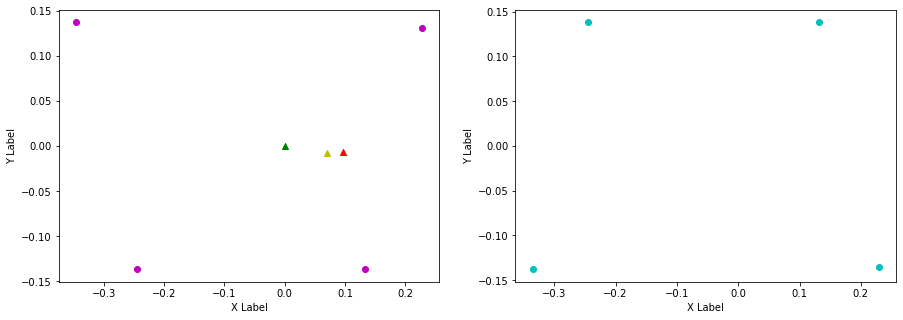

Command:  [0.3 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.132, 0.241, FL (y): 0.138, 0.13.
FL displacement: 0.10899999999999999, -0.008000000000000007.

FR (x): 0.229, 0.156, FR (y): -0.135, -0.139.
FR displacement: -0.07300000000000001, -0.0040000000000000036.

RL (x): -0.245, -0.32, RL (y): 0.138, 0.14.
RL displacement: -0.07500000000000001, 0.0020000000000000018.

RR (x): -0.335, -0.232, RR (y): -0.138, -0.135.
RR displacement: 0.10300000000000001, 0.0030000000000000027.


Base displacement (Foot): [0.07300000000000001, 0.0040000000000000036].

Base displacement (Odom): [[0.07625395514065225], [0.0067005623493603395]]. Rotation displacement: -1.6563087996302042.



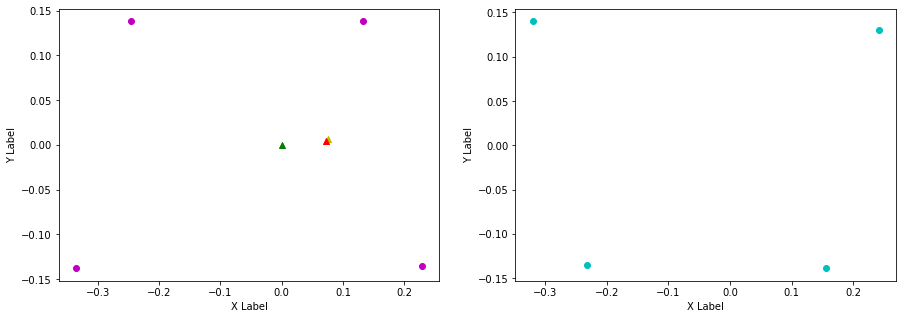

Command:  [0.3 0. ] 0.0
Command:  [0.4 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.194, 0.145, FL (y): 0.128, 0.139.
FL displacement: -0.049000000000000016, 0.01100000000000001.

FR (x): 0.188, 0.25, FR (y): -0.128, -0.132.
FR displacement: 0.062, -0.0040000000000000036.

RL (x): -0.283, -0.214, RL (y): 0.144, 0.134.
RL displacement: 0.06899999999999998, -0.009999999999999981.

RR (x): -0.282, -0.332, RR (y): -0.145, -0.143.
RR displacement: -0.050000000000000044, 0.0020000000000000018.


Base displacement (Foot): [0.049000000000000016, -0.01100000000000001].

Base displacement (Odom): [[0.029614380271240748], [-0.002359996047770707]]. Rotation displacement: -7.579251673202414.



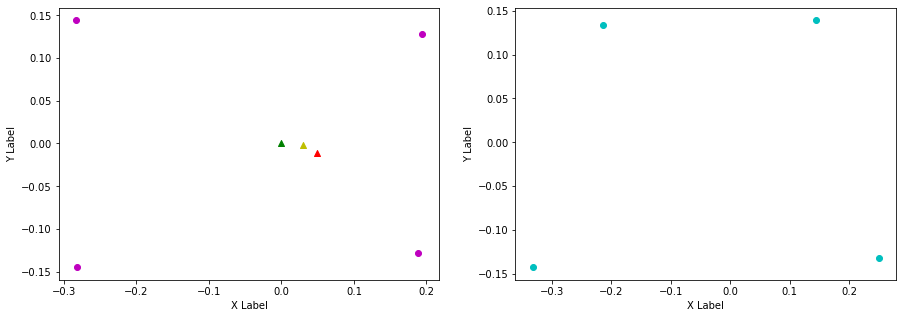

Command:  [0.4 0. ] 0.0
Command:  [0.4 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.145, 0.246, FL (y): 0.139, 0.132.
FL displacement: 0.101, -0.007000000000000006.

FR (x): 0.25, 0.127, FR (y): -0.132, -0.138.
FR displacement: -0.123, -0.006000000000000005.

RL (x): -0.214, -0.348, RL (y): 0.134, 0.138.
RL displacement: -0.13399999999999998, 0.0040000000000000036.

RR (x): -0.332, -0.227, RR (y): -0.143, -0.135.
RR displacement: 0.10500000000000001, 0.00799999999999998.


Base displacement (Foot): [0.123, 0.006000000000000005].

Base displacement (Odom): [[0.09927824072205427], [0.0016601329431100709]]. Rotation displacement: -0.8614270222504138.



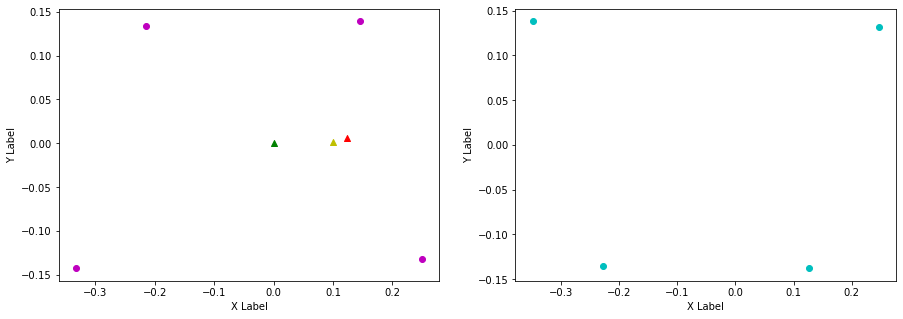

Command:  [0.4 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.246, 0.114, FL (y): 0.132, 0.138.
FL displacement: -0.132, 0.006000000000000005.

FR (x): 0.127, 0.242, FR (y): -0.138, -0.133.
FR displacement: 0.11499999999999999, 0.0050000000000000044.

RL (x): -0.348, -0.23, RL (y): 0.138, 0.137.
RL displacement: 0.11799999999999997, -0.0010000000000000009.

RR (x): -0.227, -0.349, RR (y): -0.135, -0.138.
RR displacement: -0.12199999999999997, -0.0030000000000000027.


Base displacement (Foot): [0.132, -0.006000000000000005].

Base displacement (Odom): [[0.10635191485192808], [-0.006902877556745679]]. Rotation displacement: 1.140480325836703.



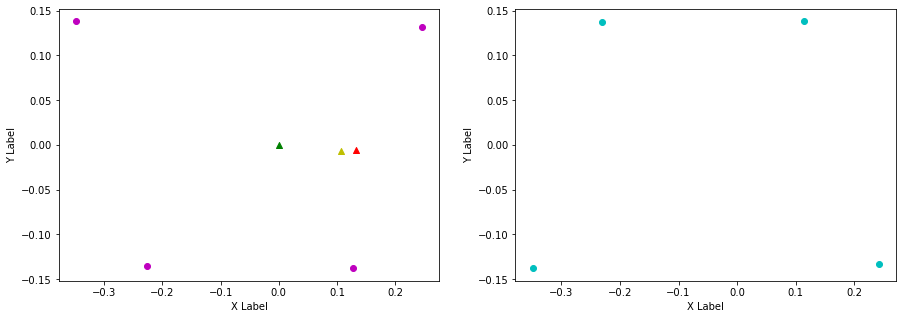

Command:  [0.4 0. ] 0.0
Command:  [0.4 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.114, 0.245, FL (y): 0.138, 0.127.
FL displacement: 0.131, -0.01100000000000001.

FR (x): 0.242, 0.139, FR (y): -0.133, -0.137.
FR displacement: -0.10299999999999998, -0.0040000000000000036.

RL (x): -0.23, -0.344, RL (y): 0.137, 0.137.
RL displacement: -0.11399999999999996, 0.0.

RR (x): -0.349, -0.227, RR (y): -0.138, -0.135.
RR displacement: 0.12199999999999997, 0.0030000000000000027.


Base displacement (Foot): [0.10299999999999998, 0.0040000000000000036].

Base displacement (Odom): [[0.11927509983365425], [0.009150518277296626]]. Rotation displacement: -1.187785827430254.



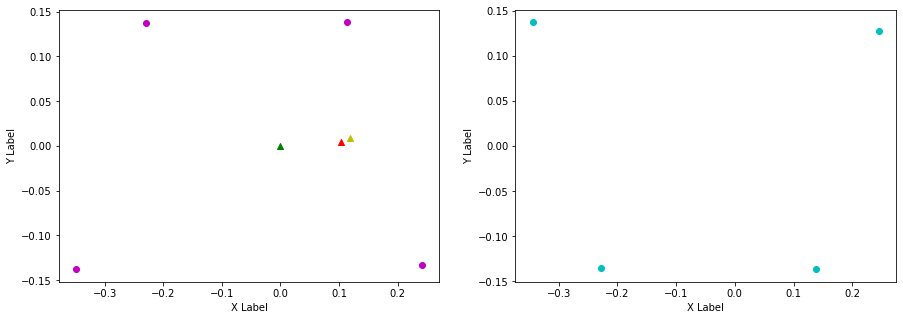

Command:  [0.4 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.245, 0.123, FL (y): 0.127, 0.139.
FL displacement: -0.122, 0.01200000000000001.

FR (x): 0.139, 0.253, FR (y): -0.137, -0.133.
FR displacement: 0.11399999999999999, 0.0040000000000000036.

RL (x): -0.344, -0.222, RL (y): 0.137, 0.138.
RL displacement: 0.12199999999999997, 0.0010000000000000009.

RR (x): -0.227, -0.337, RR (y): -0.135, -0.138.
RR displacement: -0.11000000000000001, -0.0030000000000000027.


Base displacement (Foot): [0.122, -0.01200000000000001].

Base displacement (Odom): [[0.0770410186367334], [-0.011204588341540145]]. Rotation displacement: 1.4261773823984054.



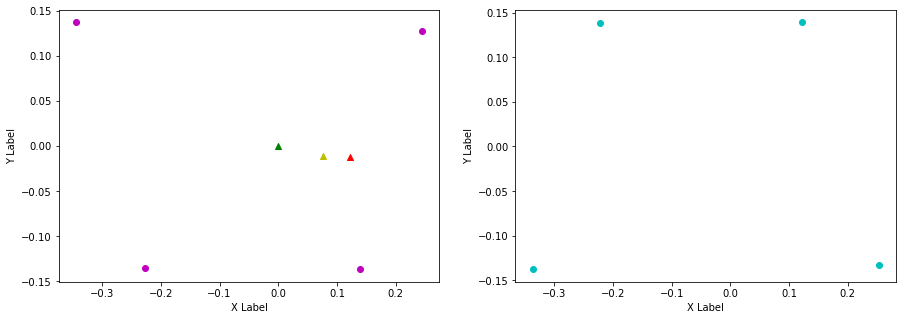

Command:  [0.4 0. ] 0.0
Command:  [0.4 0. ] 0.0

FL moving: True. FR moving: False
RL moving: False. RR moving: True
CoM displacement: 
FL (x): 0.123, 0.244, FL (y): 0.139, 0.128.
FL displacement: 0.121, -0.01100000000000001.

FR (x): 0.253, 0.135, FR (y): -0.133, -0.138.
FR displacement: -0.118, -0.0050000000000000044.

RL (x): -0.222, -0.35, RL (y): 0.138, 0.138.
RL displacement: -0.12799999999999997, 0.0.

RR (x): -0.337, -0.229, RR (y): -0.138, -0.135.
RR displacement: 0.10800000000000001, 0.0030000000000000027.


Base displacement (Foot): [0.118, 0.0050000000000000044].

Base displacement (Odom): [[0.1308189882888322], [0.014131051595549948]]. Rotation displacement: -1.934463158017051.



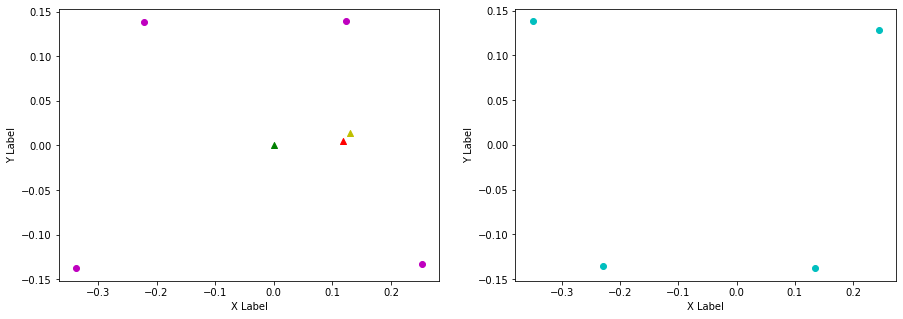

Command:  [0.4 0. ] 0.0

FL moving: False. FR moving: True
RL moving: True. RR moving: False
CoM displacement: 
FL (x): 0.244, 0.117, FL (y): 0.128, 0.139.
FL displacement: -0.127, 0.01100000000000001.

FR (x): 0.135, 0.248, FR (y): -0.138, -0.135.
FR displacement: 0.11299999999999999, 0.0030000000000000027.

RL (x): -0.35, -0.227, RL (y): 0.138, 0.138.
RL displacement: 0.12299999999999997, 0.0.

RR (x): -0.229, -0.345, RR (y): -0.135, -0.138.
RR displacement: -0.11599999999999996, -0.0030000000000000027.


Base displacement (Foot): [0.127, -0.01100000000000001].

Base displacement (Odom): [[0.06334337978274363], [-0.005925232684454329]]. Rotation displacement: 1.8564934649912035.



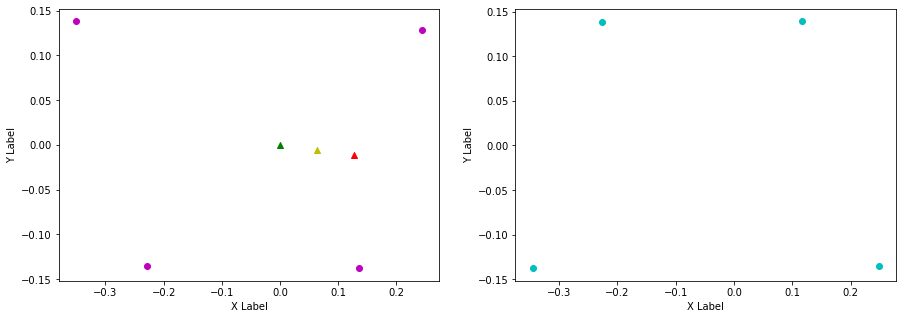

Command:  [0.4 0. ] 0.0


KeyboardInterrupt: 

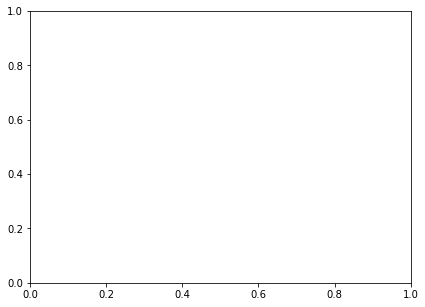

In [37]:
def visualize_absolute_foostep_sizes(dataset, footsteps, threshold=0.02):
    prev_yaw = 0
    
    # Visualize footsteps
    for idx, footstep in enumerate(footsteps):
        dataset[footstep, 7:19] = np.round(dataset[footstep, 7:19], 3)
        
        if idx < (len(footsteps) - 1):
            print("Command: ", dataset[footstep, 1:3], dataset[footstep, 6])
            time_difference = abs(dataset[footsteps[idx], 0] - dataset[footsteps[idx+1], 0])
            
            if time_difference < 0.4 and time_difference > 0:
                fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))
                axes[0].set_xlabel('X Label')
                axes[0].set_ylabel('Y Label')
                axes[1].set_xlabel('X Label')
                axes[1].set_ylabel('Y Label')
    
                # Find corresponding index between two consecutive footsteps
                lower_bound_index = np.abs(dataset[:, 0] - (dataset[footsteps[idx], 0]))
                upper_bound_index = np.abs(dataset[:, 0] - (dataset[footsteps[idx], 0] + time_difference))
                matching_index_lower_bound = lower_bound_index.argmin()
                matching_index_upper_bound = upper_bound_index.argmin()

                # Retrieve what is the maximum height
                # reached in between the current and
                # next footstep
                height_peeks_in_between = [dataset[matching_index_lower_bound:matching_index_upper_bound, x] for x in [9, 12, 15, 18]]

                fl_moving = max(height_peeks_in_between[0]) > -0.31
                fr_moving = max(height_peeks_in_between[1]) > -0.31
                rl_moving = max(height_peeks_in_between[2]) > -0.31
                rr_moving = max(height_peeks_in_between[3]) > -0.31
                                
                if (not fr_moving != fl_moving):
                    print("Exception")
                    continue
                    
                # Get euler angles from odom to base rotation
                _, _, curr_yaw = euler_from_quaternion(dataset[footstep, 22], dataset[footstep, 23], dataset[footstep, 24], dataset[footstep, 25])
                _, _, next_yaw = euler_from_quaternion(dataset[footsteps[idx+1], 22], dataset[footsteps[idx+1], 23], dataset[footsteps[idx+1], 24], dataset[footsteps[idx+1], 25])

                # Compute rotation matrix
                c_curr, s_curr = np.cos(curr_yaw), np.sin(curr_yaw)
                c_next, s_next = np.cos(next_yaw), np.sin(next_yaw)
                R_curr = np.array(((c_curr, -s_curr), (s_curr, c_curr)))
                R_next = np.array(((c_next, -s_next), (s_next, c_next)))
                
                # Odom base vectors
                curr_base = np.array([[dataset[footstep, 19], dataset[footstep, 20]]])
                next_base = np.array([[dataset[footsteps[idx+1], 19], dataset[footsteps[idx+1], 20]]])
                
                # Local base vectors
                local_curr_base = R_curr.T @ curr_base.T
                local_next_base = R_curr.T @ next_base.T
                local_next_base_next = R_next.T @ next_base.T
                base_displacement = local_next_base - local_curr_base
                
                #print("Footstep timestamp: ", dataset[footstep, 0])
                print(f'\nFL moving: {fl_moving}. FR moving: {fr_moving}')
                print(f'RL moving: {rl_moving}. RR moving: {rr_moving}')
                
                print("CoM displacement: ")
                print(f'FL (x): {dataset[footsteps[idx], 7]}, {dataset[footsteps[idx+1], 7]}, FL (y): {dataset[footsteps[idx], 8]}, {dataset[footsteps[idx+1], 8]}.')
                print(f'FL displacement: {(dataset[footsteps[idx+1], 7] - dataset[footsteps[idx], 7]).tolist()}, {(dataset[footsteps[idx+1], 8] - dataset[footsteps[idx], 8]).tolist()}.\n')
                
                print(f'FR (x): {dataset[footsteps[idx], 10]}, {dataset[footsteps[idx+1], 10]}, FR (y): {dataset[footsteps[idx], 11]}, {dataset[footsteps[idx+1], 11]}.')
                print(f'FR displacement: {(dataset[footsteps[idx+1], 10] - dataset[footsteps[idx], 10]).tolist()}, {(dataset[footsteps[idx+1], 11] - dataset[footsteps[idx], 11]).tolist()}.\n')
                
                print(f'RL (x): {dataset[footsteps[idx], 13]}, {dataset[footsteps[idx+1], 13]}, RL (y): {dataset[footsteps[idx], 14]}, {dataset[footsteps[idx+1], 14]}.')
                print(f'RL displacement: {(dataset[footsteps[idx+1], 13] - dataset[footsteps[idx], 13]).tolist()}, {(dataset[footsteps[idx+1], 14] - dataset[footsteps[idx], 14]).tolist()}.\n')
                
                print(f'RR (x): {dataset[footsteps[idx], 16]}, {dataset[footsteps[idx+1], 16]}, RR (y): {dataset[footsteps[idx], 17]}, {dataset[footsteps[idx+1], 17]}.')
                print(f'RR displacement: {(dataset[footsteps[idx+1], 16] - dataset[footsteps[idx], 16]).tolist()}, {(dataset[footsteps[idx+1], 17] - dataset[footsteps[idx], 17]).tolist()}.\n')
        
                # Feet displacements
                fl_x_displacement = dataset[footsteps[idx+1], 7] - dataset[footsteps[idx], 7]
                fl_y_displacement = dataset[footsteps[idx+1], 8] - dataset[footsteps[idx], 8]
                fr_x_displacement = dataset[footsteps[idx+1], 10] - dataset[footsteps[idx], 10]
                fr_y_displacement = dataset[footsteps[idx+1], 11] - dataset[footsteps[idx], 11]
                rl_x_displacement = dataset[footsteps[idx+1], 13] - dataset[footsteps[idx], 13]
                rl_y_displacement = dataset[footsteps[idx+1], 14] - dataset[footsteps[idx], 14]
                rr_x_displacement = dataset[footsteps[idx+1], 16] - dataset[footsteps[idx], 16]
                rr_y_displacement = dataset[footsteps[idx+1], 17] - dataset[footsteps[idx], 17]
                
                # Support foot base displacement
                support_base_displacement = [0, 0]
                if fr_moving:
                    support_base_displacement[0] = -fl_x_displacement
                    support_base_displacement[1] = -fl_y_displacement
                else:
                    support_base_displacement[0] = -fr_x_displacement
                    support_base_displacement[1] = -fr_y_displacement
                                    
                print(f'\nBase displacement (Foot): {support_base_displacement}.\n')
                print(f'Base displacement (Odom): {base_displacement.tolist()}. Rotation displacement: {(curr_yaw - prev_yaw) * 180 / np.pi}.\n')
                
                prev_yaw = curr_yaw
                    
                x_0 = np.array([dataset[footstep, 7], 
                                dataset[footstep, 10],
                                dataset[footstep, 13], 
                                dataset[footstep, 16]])
                y_0 = np.array([dataset[footstep, 8], 
                                dataset[footstep, 11],
                                dataset[footstep, 14], 
                                dataset[footstep, 17]])
                
                x_1 = np.array([dataset[footstep, 7] + fl_x_displacement, 
                                dataset[footstep, 10] + fr_x_displacement,
                                dataset[footstep, 13] + rl_x_displacement, 
                                dataset[footstep, 16] + rr_x_displacement])
                y_1 = np.array([dataset[footstep, 8] + fl_y_displacement, 
                                dataset[footstep, 11] + fr_y_displacement,
                                dataset[footstep, 14] + rl_y_displacement, 
                                dataset[footstep, 17] + rr_y_displacement])
                
                #axes[0].scatter(x_0, y_0, c= 'b',marker='o')
                axes[0].scatter(x_0, y_0, c= 'm',marker='o')
                axes[0].scatter(0, 0, c= 'g', marker='^')
                axes[0].scatter(base_displacement[0], base_displacement[1], c= 'y', marker='^')
                axes[0].scatter(support_base_displacement[0], support_base_displacement[1], c= 'r', marker='^')
                
                #axes[1].scatter(x_1, y_1, c= 'r', marker='o')
                axes[1].scatter(x_1, y_1, c= 'c', marker='o')
                
                plt.show()
                
visualize_absolute_foostep_sizes(motion_fwd, footsteps_fwd, threshold=0.01)                  

### Forward motion

RuntimeError: Requested MovieWriter (ffmpeg) not available

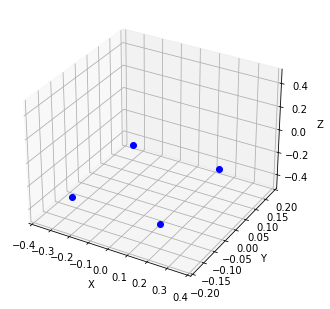

In [28]:
anim = visualize_animated_footsteps(motion_fwd, footsteps_fwd, "bo")
HTML(anim.to_html5_video())

### Backward motion

In [28]:
#anim = visualize_animated_footsteps(motion_bwd, footsteps_01_bwd, "bo")
#HTML(anim.to_html5_video())

### Side motion (right)

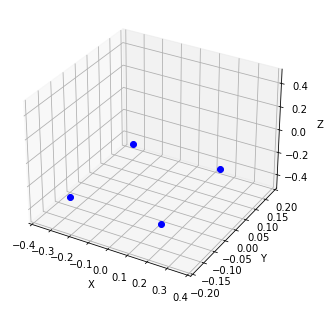

In [29]:
anim = visualize_animated_footsteps(motion_side_right, footsteps_01_side_right, "bo")
HTML(anim.to_html5_video())

### Side motion (left)

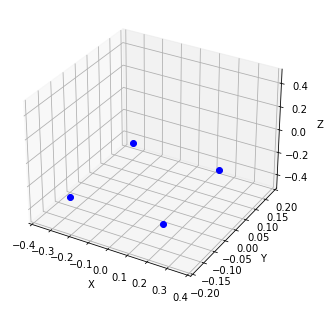

In [30]:
anim = visualize_animated_footsteps(motion_side_left, footsteps_01_side_left, "bo")
HTML(anim.to_html5_video())

### Rotation (clockwise)

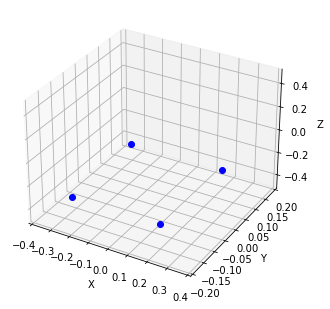

In [31]:
anim = visualize_animated_footsteps(motion_clock, footsteps_01_clock, "bo")
HTML(anim.to_html5_video())

### Rotation (counter clockwise)

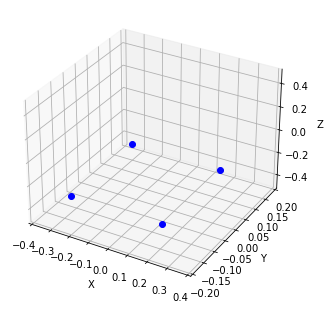

In [32]:
anim = visualize_animated_footsteps(motion_count, footsteps_01_count, "bo")
HTML(anim.to_html5_video())

# Multivariate Linear Regression (FR foot prediction)

The input will use initially only:

- **HighCmd: fwd, side, rot speeds**
- **HighState: fwd, side, rot speeds, footPosition2Body (FR)**

and as output we seek to predict the following:

- **footPosition2Body (FR)**

In [ ]:
import sklearn
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

In [ ]:
def plot_target_and_predictions(title: str, predictions, target):
    fig, ax1 = plt.subplots(1,1, figsize=(15,10))
    fig.suptitle(title)
    
    # FR plot (height)
    ax1.plot(range(predictions.shape[0]), predictions, 'b-')
    ax1.set_ylabel('Predictions')
    ax1.set_xlabel('Time')
         
    # FR plot (force)
    ax2 = ax1.twinx()
    ax2.plot(range(predictions.shape[0]), target, 'g-')
    ax2.set_ylabel('Target', color='g')

    for tl in ax2.get_yticklabels():
        tl.set_color('g')
    
    fig.tight_layout()
    plt.show()

In [21]:
def create_step_size_dataset(dataset, footsteps, motion=None, debug=False):
    # General
    inputs = []
    labels = []
    com_velocity_x = 0
    com_velocity_y = 0
    last_footsteps = [0, 0, 0, 0, 0, 0, 0, 0]
    
    # Compute step sizes
    for idx, footstep in enumerate(footsteps):
        if idx < (len(footsteps) - 1):
            # Compute time difference between
            # current and next footsteps
            time_difference = abs(dataset[footsteps[idx], 0] - dataset[footsteps[idx+1], 0])
            
            if time_difference < 0.4 and time_difference > 0:
                #inputs.append(dataset[footsteps[idx-1], 1:7].tolist() + dataset[footsteps[idx-1], 34:40].tolist() + dataset[footsteps[idx-1], 7:19].tolist())
                #labels.append(dataset[footsteps[idx], 7:19])
                
                # Find corresponding index between two consecutive footsteps
                lower_bound_index = np.abs(dataset[:, 0] - (dataset[footsteps[idx], 0]))
                upper_bound_index = np.abs(dataset[:, 0] - (dataset[footsteps[idx], 0] + time_difference))
                matching_index_lower_bound = lower_bound_index.argmin()
                matching_index_upper_bound = upper_bound_index.argmin()

                # Retrieve what is the maximum height
                # reached in between the current and
                # next footstep
                height_peeks_in_between = [dataset[matching_index_lower_bound:matching_index_upper_bound, x] for x in [9, 12, 15, 18]]

                fl_moving = max(height_peeks_in_between[0]) > -0.31
                fr_moving = max(height_peeks_in_between[1]) > -0.31
                rl_moving = max(height_peeks_in_between[2]) > -0.31
                rr_moving = max(height_peeks_in_between[3]) > -0.31
                
                if debug:
                    print(idx, height_peeks_in_between)
                    print("Time difference: ", time_difference)
                    print("Footstep timestamp: ", dataset[footstep, 0])
                    print(f'FL moving: {fl_moving}. FR moving: {fr_moving}')
                    print(f'RL moving: {rl_moving}. RR moving: {rr_moving}')

                if (not fr_moving != fl_moving):
                    #print("Exception")
                    #print(idx, height_peeks_in_between)
                    #print("Time difference: ", time_difference)
                    #print("Footstep timestamp: ", dataset[footstep, 0])
                    #print(f'FL moving: {fl_moving}. FR moving: {fr_moving}')
                    #print(f'RL moving: {rl_moving}. RR moving: {rr_moving}')
                    continue
                
                assert fr_moving == rl_moving
                assert rr_moving == fl_moving
                assert fr_moving != fl_moving
                
                # Compute FR movement
                fl_movement_x = dataset[footsteps[idx+1], 7] - dataset[footsteps[idx], 7]
                fl_movement_y = dataset[footsteps[idx+1], 8] - dataset[footsteps[idx], 8]

                # Compute FL movement
                fr_movement_x = dataset[footsteps[idx+1], 10] - dataset[footsteps[idx], 10]
                fr_movement_y = dataset[footsteps[idx+1], 11] - dataset[footsteps[idx], 11]

                # Compute RR movement
                rl_movement_x = dataset[footsteps[idx+1], 13] - dataset[footsteps[idx], 13]
                rl_movement_y = dataset[footsteps[idx+1], 14] - dataset[footsteps[idx], 14]

                # Compute RL movement
                rr_movement_x = dataset[footsteps[idx+1], 16] - dataset[footsteps[idx], 16]
                rr_movement_y = dataset[footsteps[idx+1], 17] - dataset[footsteps[idx], 17]
                
                # Movement direction for FR/RL swing
                sign_fr_swing_x = +1 if dataset[footsteps[idx+1], 10] > dataset[footsteps[idx+1], 7] else -1
                sign_fr_swing_y = +1 if dataset[footsteps[idx+1], 11] > dataset[footsteps[idx+1], 17] else -1
                sign_rl_swing_x = +1 if dataset[footsteps[idx+1], 13] > dataset[footsteps[idx+1], 16] else -1
                sign_rl_swing_y = +1 if dataset[footsteps[idx+1], 14] > dataset[footsteps[idx+1], 8] else -1
                
                # Movement direction for FL/RR swing
                sign_fl_swing_x = +1 if dataset[footsteps[idx+1], 7] > dataset[footsteps[idx+1], 10] else -1
                sign_fl_swing_y = +1 if dataset[footsteps[idx+1], 17] > dataset[footsteps[idx+1], 11] else -1
                sign_rr_swing_x = +1 if dataset[footsteps[idx+1], 16] > dataset[footsteps[idx+1], 13] else -1
                sign_rr_swing_y = +1 if dataset[footsteps[idx+1], 8] > dataset[footsteps[idx+1], 14] else -1
                
                com_movement_x = None
                com_movement_y = None
                
                if motion == "forward":
                    if fr_moving:
                        com_movement_x = abs(dataset[footsteps[idx+1], 7] - dataset[footstep, 7])
                        com_movement_y = dataset[footsteps[idx+1], 8] - dataset[footstep, 8]
                    else:
                        com_movement_x = abs(dataset[footsteps[idx+1], 10] - dataset[footstep, 10])
                        com_movement_y = dataset[footsteps[idx+1], 11] - dataset[footstep, 11]
                
                if motion == "right":
                    if fr_moving:
                        com_movement_x = dataset[footsteps[idx+1], 7] - dataset[footstep, 7]
                        com_movement_y = -abs(dataset[footsteps[idx+1], 8] - dataset[footstep, 8])
                    else:
                        com_movement_x = dataset[footsteps[idx+1], 10] - dataset[footstep, 10]
                        com_movement_y = -abs(dataset[footsteps[idx+1], 11] - dataset[footstep, 11])
                
                if motion == "left":
                    if fr_moving:
                        com_movement_x = dataset[footsteps[idx+1], 7] - dataset[footstep, 7]
                        com_movement_y = abs(dataset[footsteps[idx+1], 8] - dataset[footstep, 8])
                    else:
                        com_movement_x = dataset[footsteps[idx+1], 10] - dataset[footstep, 10]
                        com_movement_y = abs(dataset[footsteps[idx+1], 11] - dataset[footstep, 11])
                
                if motion == "clock":
                    sign_fr_swing_y = -1
                    sign_rl_swing_y = 1
                    sign_fl_swing_y = -1
                    sign_rr_swing_y = 1
                    
                    if fr_moving:
                        com_movement_x = dataset[footsteps[idx+1], 7] - dataset[footstep, 7]
                        com_movement_y = -abs(dataset[footsteps[idx+1], 8] - dataset[footstep, 8]) + abs(dataset[footsteps[idx+1], 17] - dataset[footstep, 17])
                    else:
                        com_movement_x = dataset[footsteps[idx+1], 10] - dataset[footstep, 10]
                        com_movement_y = -abs(dataset[footsteps[idx+1], 11] - dataset[footstep, 11]) + abs(dataset[footsteps[idx+1], 14] - dataset[footstep, 14])
                
                if motion == "count":
                    sign_fr_swing_y = 1
                    sign_rl_swing_y = -1
                    sign_fl_swing_y = 1
                    sign_rr_swing_y = -1
                    
                    if fr_moving:
                        com_movement_x = dataset[footsteps[idx+1], 7] - dataset[footstep, 7]
                        com_movement_y = abs(dataset[footsteps[idx+1], 8] - dataset[footstep, 8]) - abs(dataset[footsteps[idx+1], 17] - dataset[footstep, 17])
                    else:
                        com_movement_x = dataset[footsteps[idx+1], 10] - dataset[footstep, 10]
                        com_movement_y = -abs(dataset[footsteps[idx+1], 11] - dataset[footstep, 11]) - abs(dataset[footsteps[idx+1], 14] - dataset[footstep, 14])
                                
                if debug:
                    print(f'Coord FL: {[dataset[footstep, 7], dataset[footstep, 8], dataset[footstep, 9]]}.')
                    print(f'Coord FR: {[dataset[footstep, 10], dataset[footstep, 11], dataset[footstep, 12]]}.')
                    print(f'Coord RL: {[dataset[footstep, 13], dataset[footstep, 14], dataset[footstep, 15]]}.')
                    print(f'Coord RR: {[dataset[footstep, 16], dataset[footstep, 17], dataset[footstep, 18]]}.')

                    print(f'\nCoord FL: {[dataset[footsteps[idx+1], 7], dataset[footsteps[idx+1], 8], dataset[footsteps[idx+1], 9]]}.')
                    print(f'Coord FR: {[dataset[footsteps[idx+1], 10], dataset[footsteps[idx+1], 11], dataset[footsteps[idx+1], 12]]}.')
                    print(f'Coord RL: {[dataset[footsteps[idx+1], 13], dataset[footsteps[idx+1], 14], dataset[footsteps[idx+1], 15]]}.')
                    print(f'Coord RR: {[dataset[footsteps[idx+1], 16], dataset[footsteps[idx+1], 17], dataset[footsteps[idx+1], 18]]}.')
                    
                # Timstamp
                DT = dataset[footsteps[idx+1], 0]-dataset[footsteps[idx], 0]
                
                # Inputs
                inputs.append(dataset[footsteps[idx], 1:7].tolist() + 
                              dataset[footsteps[idx], 34:40].tolist() + 
                              dataset[footsteps[idx], 7:19].tolist() + 
                              [fr_moving, fl_moving] + 
                              last_footsteps +
                              [com_velocity_x, com_velocity_y] +
                              [DT] + 
                              [dataset[footsteps[idx], 0]])
                                
                # Compute new velocity
                com_velocity_x = com_movement_x/DT
                com_velocity_y = com_movement_y/DT
    
                if fr_moving:
                    if debug:
                        print(fl_movement_x, fl_movement_y, fr_movement_x, fr_movement_y, rr_movement_x, rr_movement_y, rl_movement_x, rl_movement_y)
                        print(f'\nFL step_size x: {0}. FL step_size y: {0}.')
                        print(f'FR step_size x: {(abs(fr_movement_x) + abs(fl_movement_x)) * sign_fr_swing_x}. FR step_size y: {(abs(fr_movement_y) + abs(fl_movement_y)) * sign_fr_swing_y}.')
                        print(f'RL step_size x: {(abs(rr_movement_x) + abs(rl_movement_x)) * sign_rl_swing_x}. RL step_size y: {(abs(rr_movement_y) + abs(rl_movement_y)) * sign_rl_swing_y}.')
                        print(f'RR step_size x: {0}. RR step_size y: {0}.')
                        print(sign_fr_swing_x, sign_fr_swing_y, sign_rl_swing_x, sign_rl_swing_y)
                    labels.append([0, 
                                   0,
                                   (abs(fr_movement_x) + abs(fl_movement_x)) * sign_fr_swing_x, 
                                   (abs(fr_movement_y) + abs(fl_movement_y)) * sign_fr_swing_y,
                                   (abs(rr_movement_x) + abs(rl_movement_x)) * sign_rl_swing_x,
                                   (abs(rr_movement_y) + abs(rl_movement_y)) * sign_rl_swing_y,
                                   0,
                                   0])
                    #assert sign_fr_swing_y > 0
                    #assert sign_rl_swing_y < 0
                elif fl_moving:
                    if debug:
                        print(fl_movement_x, fl_movement_y, fr_movement_x, fr_movement_y, rr_movement_x, rr_movement_y, rl_movement_x, rl_movement_y)
                        print(f'\nFL step_size x: {(abs(fr_movement_x) + abs(fl_movement_x)) * sign_fl_swing_x}. FL step_size y: {(abs(fr_movement_y) + abs(fl_movement_y)) * sign_fl_swing_y}.')
                        print(f'FR step_size x: {0}. FR step_size y: {0}.')
                        print(f'RL step_size x: {0}. RL step_size y: {0}.')
                        print(f'RR step_size x: {(abs(rr_movement_x) + abs(rl_movement_x)) * sign_rr_swing_x}. RR step_size y: {(abs(rr_movement_y) + abs(rl_movement_y)) * sign_rr_swing_y}.')
                        print(sign_fl_swing_x, sign_fl_swing_y, sign_rr_swing_x, sign_rr_swing_y)
                    labels.append([(abs(fr_movement_x) + abs(fl_movement_x)) * sign_fl_swing_x, 
                                       (abs(fr_movement_y) + abs(fl_movement_y)) * sign_fl_swing_y,
                                       0, 
                                       0,
                                       0,
                                       0,
                                       (abs(rr_movement_x) + abs(rl_movement_x)) * sign_rr_swing_x,
                                       (abs(rr_movement_y) + abs(rl_movement_y)) * sign_rr_swing_y])
                    #assert sign_fl_swing_y > 0
                    #assert sign_rr_swing_y < 0
                if debug:
                    print("\n")

                last_footsteps = labels[-1]
            else:
                com_velocity_x = 0
                com_velocity_y = 0
                    
    # Convert to numpy array
    inputs_numpy = np.array(inputs)
    labels_numpy = np.array(labels)
    
    return inputs_numpy, labels_numpy

X_motion_fwd_step, Y_motion_fwd_step = create_step_size_dataset(motion_fwd, footsteps_fwd, motion="forward")
X_motion_clock_step, Y_motion_clock_step = create_step_size_dataset(motion_clock, footsteps_01_clock, motion="clock")
X_motion_count_step, Y_motion_count_step = create_step_size_dataset(motion_count, footsteps_01_count, motion="count")
X_motion_side_left_step, Y_motion_side_left_step = create_step_size_dataset(motion_side_left, footsteps_01_side_left, motion="left")
X_motion_side_right_step, Y_motion_side_right_step = create_step_size_dataset(motion_side_right, footsteps_01_side_right, motion="right")

# Stack datasets
X_motion_step = np.concatenate((X_motion_fwd_step, X_motion_side_right_step, X_motion_side_left_step, X_motion_clock_step, X_motion_count_step))
Y_motion_step = np.concatenate((Y_motion_fwd_step, Y_motion_side_right_step, Y_motion_side_left_step, Y_motion_clock_step, Y_motion_count_step))
print(X_motion_step.shape)
print(Y_motion_step.shape)

(148884, 38)
(148884, 8)


In [22]:
%store X_motion_step
%store Y_motion_step

Stored 'X_motion_step' (ndarray)
Stored 'Y_motion_step' (ndarray)


In [23]:
def create_3D_pose_dataset(dataset, footsteps, debug=False):
    # Footsteps sizes
    inputs = []
    labels = []
    
    for idx, footstep in enumerate(footsteps):
        if idx < (len(footsteps) - 1):
            # Compute time difference between
            # current and next footsteps
            time_difference = abs(dataset[footsteps[idx], 0] - dataset[footsteps[idx+1], 0])
            
            if time_difference < 0.4 and time_difference > 0:
                # Find corresponding index between two consecutive footsteps
                lower_bound_index = np.abs(dataset[:, 0] - (dataset[footsteps[idx], 0]))
                upper_bound_index = np.abs(dataset[:, 0] - (dataset[footsteps[idx], 0] + time_difference))
                matching_index_lower_bound = lower_bound_index.argmin()
                matching_index_upper_bound = upper_bound_index.argmin()

                # Retrieve what is the maximum height
                # reached in between the current and
                # next footstep
                height_peeks_in_between = [dataset[matching_index_lower_bound:matching_index_upper_bound, x] for x in [9, 12, 15, 18]]

                fl_moving = max(height_peeks_in_between[0]) > -0.31
                fr_moving = max(height_peeks_in_between[1]) > -0.31
                rl_moving = max(height_peeks_in_between[2]) > -0.31
                rr_moving = max(height_peeks_in_between[3]) > -0.31
                
                if debug:
                    print(idx, height_peeks_in_between)
                    print("Time difference: ", time_difference)
                    print("Footstep timestamp: ", dataset[footstep, 0])
                    print(f'FL moving: {fl_moving}. FR moving: {fr_moving}')
                    print(f'RL moving: {rl_moving}. RR moving: {rr_moving}')

                if (not fr_moving != fl_moving):
                    #print("Exception")
                    #print(idx, height_peeks_in_between)
                    #print("Time difference: ", time_difference)
                    #print("Footstep timestamp: ", dataset[footstep, 0])
                    #print(f'FL moving: {fl_moving}. FR moving: {fr_moving}')
                    #print(f'RL moving: {rl_moving}. RR moving: {rr_moving}')
                    continue
                
                assert fr_moving == rl_moving
                assert rr_moving == fl_moving
                assert fr_moving != fl_moving
            
                inputs.append(dataset[footsteps[idx], 1:7].tolist() + dataset[footsteps[idx], 34:40].tolist() + dataset[footsteps[idx], 7:19].tolist() + [fr_moving, fl_moving] + [dataset[footsteps[idx], 0]])
                labels.append(dataset[footsteps[idx+1], 7:19])
                    
    # Convert to numpy array
    inputs_numpy = np.array(inputs)
    labels_numpy = np.array(labels)
    
    return inputs_numpy, labels_numpy

X_motion_fwd_3D, Y_motion_fwd_3D = create_3D_pose_dataset(motion_fwd, footsteps_fwd)
#X_motion_bwd_3D, Y_motion_bwd_3D = create_3D_pose_dataset(motion_bwd, footsteps_01_bwd)
X_motion_clock_3D, Y_motion_clock_3D = create_3D_pose_dataset(motion_clock, footsteps_01_clock)
X_motion_count_3D, Y_motion_count_3D = create_3D_pose_dataset(motion_count, footsteps_01_count)
X_motion_side_left_3D, Y_motion_side_left_3D = create_3D_pose_dataset(motion_side_left, footsteps_01_side_left)
X_motion_side_right_3D, Y_motion_side_right_3D = create_3D_pose_dataset(motion_side_right, footsteps_01_side_right)

# Stack datasets
#X_motion_3D = np.concatenate((X_motion_fwd_3D, X_motion_bwd_3D, X_motion_side_right_3D, X_motion_side_left_3D, X_motion_clock_3D, X_motion_count_3D))
#Y_motion_3D = np.concatenate((Y_motion_fwd_3D, Y_motion_bwd_3D, Y_motion_side_right_3D, Y_motion_side_left_3D, Y_motion_clock_3D, Y_motion_count_3D))
X_motion_3D = np.concatenate((X_motion_fwd_3D, X_motion_side_right_3D, X_motion_side_left_3D, X_motion_clock_3D, X_motion_count_3D))
Y_motion_3D = np.concatenate((Y_motion_fwd_3D, Y_motion_side_right_3D, Y_motion_side_left_3D, Y_motion_clock_3D, Y_motion_count_3D))
print(X_motion_3D.shape)
print(Y_motion_3D.shape)

(148884, 27)
(148884, 12)


In [ ]:
%store X_motion_3D
%store Y_motion_3D

In [79]:
def create_relative_step_size_dataset(dataset, footsteps, debug=False):
    # Footsteps sizes
    inputs = []
    labels = []
    
    for idx, footstep in enumerate(footsteps):
        if idx < (len(footsteps) - 1):
            # Compute time difference between
            # current and next footsteps
            time_difference = abs(dataset[footsteps[idx], 0] - dataset[footsteps[idx+1], 0])
            
            if time_difference < 0.4 and time_difference > 0:
                # Find corresponding index between two consecutive footsteps
                lower_bound_index = np.abs(dataset[:, 0] - (dataset[footsteps[idx], 0]))
                upper_bound_index = np.abs(dataset[:, 0] - (dataset[footsteps[idx], 0] + time_difference))
                matching_index_lower_bound = lower_bound_index.argmin()
                matching_index_upper_bound = upper_bound_index.argmin()

                # Retrieve what is the maximum height
                # reached in between the current and
                # next footstep
                height_peeks_in_between = [dataset[matching_index_lower_bound:matching_index_upper_bound, x] for x in [9, 12, 15, 18]]

                fl_moving = max(height_peeks_in_between[0]) > -0.31
                fr_moving = max(height_peeks_in_between[1]) > -0.31
                rl_moving = max(height_peeks_in_between[2]) > -0.31
                rr_moving = max(height_peeks_in_between[3]) > -0.31
                
                if debug:
                    print(idx, height_peeks_in_between)
                    print("Time difference: ", time_difference)
                    print("Footstep timestamp: ", dataset[footstep, 0])
                    print(f'FL moving: {fl_moving}. FR moving: {fr_moving}')
                    print(f'RL moving: {rl_moving}. RR moving: {rr_moving}')

                if (not fr_moving != fl_moving):
                    #print("Exception")
                    #print(idx, height_peeks_in_between)
                    #print("Time difference: ", time_difference)
                    #print("Footstep timestamp: ", dataset[footstep, 0])
                    #print(f'FL moving: {fl_moving}. FR moving: {fr_moving}')
                    #print(f'RL moving: {rl_moving}. RR moving: {rr_moving}')
                    continue
                
                # Feet displacements
                fl_x_displacement = dataset[footsteps[idx+1], 7] - dataset[footsteps[idx], 7]
                fl_y_displacement = dataset[footsteps[idx+1], 8] - dataset[footsteps[idx], 8]
                fr_x_displacement = dataset[footsteps[idx+1], 10] - dataset[footsteps[idx], 10]
                fr_y_displacement = dataset[footsteps[idx+1], 11] - dataset[footsteps[idx], 11]
                rl_x_displacement = dataset[footsteps[idx+1], 13] - dataset[footsteps[idx], 13]
                rl_y_displacement = dataset[footsteps[idx+1], 14] - dataset[footsteps[idx], 14]
                rr_x_displacement = dataset[footsteps[idx+1], 16] - dataset[footsteps[idx], 16]
                rr_y_displacement = dataset[footsteps[idx+1], 17] - dataset[footsteps[idx], 17]

            
                inputs.append(dataset[footsteps[idx], 1:7].tolist() + dataset[footsteps[idx], 34:40].tolist() + dataset[footsteps[idx], 7:19].tolist() + [fr_moving, fl_moving] + [dataset[footsteps[idx], 0]])
                labels.append([fl_x_displacement, fl_y_displacement,
                               fr_x_displacement, fr_y_displacement,
                               rl_x_displacement, rl_y_displacement,
                               rr_x_displacement, rr_y_displacement])
                
    # Convert to numpy array
    inputs_numpy = np.array(inputs)
    labels_numpy = np.array(labels)
    
    return inputs_numpy, labels_numpy

X_motion_fwd_relative, Y_motion_fwd_relative = create_relative_step_size_dataset(motion_fwd, footsteps_fwd)
X_motion_clock_relative, Y_motion_clock_relative = create_relative_step_size_dataset(motion_clock, footsteps_01_clock)
X_motion_count_relative, Y_motion_count_relative = create_relative_step_size_dataset(motion_count, footsteps_01_count)
X_motion_side_left_relative, Y_motion_side_left_relative = create_relative_step_size_dataset(motion_side_left, footsteps_01_side_left)
X_motion_side_right_relative, Y_motion_side_right_relative = create_relative_step_size_dataset(motion_side_right, footsteps_01_side_right)

# Stack datasets
X_motion_relative = np.concatenate((X_motion_fwd_relative, X_motion_side_right_relative, X_motion_side_left_relative, X_motion_clock_relative, X_motion_count_relative))
Y_motion_relative = np.concatenate((Y_motion_fwd_relative, Y_motion_side_right_relative, Y_motion_side_left_relative, Y_motion_clock_relative, Y_motion_count_relative))
print(X_motion_relative.shape)
print(Y_motion_relative.shape)

(27032, 27)
(27032, 8)


In [80]:
%store X_motion_relative
%store Y_motion_relative

Stored 'X_motion_relative' (ndarray)
Stored 'Y_motion_relative' (ndarray)


In [40]:
def getCoMDataset(dataset, footsteps, motion=None, debug=False):
    # Footsteps sizes
    inputs = []
    labels = []
    prev_com_displacement = [0, 0]
    
    for idx, footstep in enumerate(footsteps):
        if idx < (len(footsteps) - 1):
            # Compute time difference between
            # current and next footsteps
            time_difference = abs(dataset[footsteps[idx], 0] - dataset[footsteps[idx+1], 0])
            
            if time_difference < 0.4 and time_difference > 0:
                # Find corresponding index between two consecutive footsteps
                lower_bound_index = np.abs(dataset[:, 0] - (dataset[footsteps[idx], 0]))
                upper_bound_index = np.abs(dataset[:, 0] - (dataset[footsteps[idx], 0] + time_difference))
                matching_index_lower_bound = lower_bound_index.argmin()
                matching_index_upper_bound = upper_bound_index.argmin()

                # Retrieve what is the maximum height
                # reached in between the current and
                # next footstep
                height_peeks_in_between = [dataset[matching_index_lower_bound:matching_index_upper_bound, x] for x in [9, 12, 15, 18]]

                fl_moving = max(height_peeks_in_between[0]) > -0.31
                fr_moving = max(height_peeks_in_between[1]) > -0.31
                rl_moving = max(height_peeks_in_between[2]) > -0.31
                rr_moving = max(height_peeks_in_between[3]) > -0.31
                
                if debug:
                    print(idx, height_peeks_in_between)
                    print("Time difference: ", time_difference)
                    print("Footstep timestamp: ", dataset[footstep, 0])
                    print(f'FL moving: {fl_moving}. FR moving: {fr_moving}')
                    print(f'RL moving: {rl_moving}. RR moving: {rr_moving}')

                if (not fr_moving != fl_moving):
                    #print("Exception")
                    continue
                    
                # Feet displacements
                fl_x_displacement = dataset[footsteps[idx+1], 7] - dataset[footsteps[idx], 7]
                fl_y_displacement = dataset[footsteps[idx+1], 8] - dataset[footsteps[idx], 8]
                fr_x_displacement = dataset[footsteps[idx+1], 10] - dataset[footsteps[idx], 10]
                fr_y_displacement = dataset[footsteps[idx+1], 11] - dataset[footsteps[idx], 11]
                rl_x_displacement = dataset[footsteps[idx+1], 13] - dataset[footsteps[idx], 13]
                rl_y_displacement = dataset[footsteps[idx+1], 14] - dataset[footsteps[idx], 14]
                rr_x_displacement = dataset[footsteps[idx+1], 16] - dataset[footsteps[idx], 16]
                rr_y_displacement = dataset[footsteps[idx+1], 17] - dataset[footsteps[idx], 17]
                
                # Get euler angles from odom to base rotation
                _, _, curr_yaw = euler_from_quaternion(dataset[footstep, 34], dataset[footstep, 35], dataset[footstep, 36], dataset[footstep, 37])
                _, _, next_yaw = euler_from_quaternion(dataset[footsteps[idx+1], 34], dataset[footsteps[idx+1], 35], dataset[footsteps[idx+1], 36], dataset[footsteps[idx+1], 37])

                # Compute rotation matrix
                c_curr, s_curr = np.cos(curr_yaw), np.sin(curr_yaw)
                c_next, s_next = np.cos(next_yaw), np.sin(next_yaw)
                R_curr = np.array(((c_curr, -s_curr), (s_curr, c_curr)))
                R_next = np.array(((c_next, -s_next), (s_next, c_next)))
                
                # Odom base vectors
                curr_base = np.array([[dataset[footstep, 31], dataset[footstep, 32]]])
                next_base = np.array([[dataset[footsteps[idx+1], 31], dataset[footsteps[idx+1], 32]]])
                
                # Local base vectors
                local_curr_base = R_curr.T @ curr_base.T
                local_next_base = R_curr.T @ next_base.T
                base_displacement = local_next_base - local_curr_base
                
                # Support foot base displacement
                support_base_displacement = [0, 0]
                if fr_moving:
                    support_base_displacement[0] = -fl_x_displacement
                    support_base_displacement[1] = -fl_y_displacement
                else:
                    support_base_displacement[0] = -fr_x_displacement
                    support_base_displacement[1] = -fr_y_displacement
                
                # Inputs
                inputs.append(dataset[footsteps[idx], 1:7].tolist() + # Velocities
                              dataset[footsteps[idx], 7:19].tolist() + # Relative feet positions
                              [fr_moving, fl_moving] + 
                              prev_com_displacement)
                
                labels.append(support_base_displacement)
                #labels.append(base_displacement.tolist()[0] + base_displacement.tolist()[1])
                
                #print(inputs[-1])
                #print(labels[-1])
                
                # Update base displacement
                prev_com_displacement = support_base_displacement
                #prev_com_displacement = base_displacement.tolist()[0] + base_displacement.tolist()[1]
            else:
                prev_com_displacement = [0, 0]
                
    # Convert to numpy array
    inputs_numpy = np.array(inputs, dtype=object)
    labels_numpy = np.array(labels, dtype=object)
    
    return inputs_numpy, labels_numpy

X_motion_fwd_CoM, Y_motion_fwd_CoM = getCoMDataset(motion_fwd, footsteps_fwd, motion="forward")
X_motion_clock_CoM, Y_motion_clock_CoM = getCoMDataset(motion_clock, footsteps_01_clock, motion="clock")
X_motion_count_CoM, Y_motion_count_CoM = getCoMDataset(motion_count, footsteps_01_count, motion="count")
X_motion_side_left_CoM, Y_motion_side_left_CoM = getCoMDataset(motion_side_left, footsteps_01_side_left, motion="left")
X_motion_side_right_CoM, Y_motion_side_right_CoM = getCoMDataset(motion_side_right, footsteps_01_side_right, motion="right")

# Stack datasets
X_motion_CoM = np.concatenate((X_motion_fwd_CoM, X_motion_side_right_CoM, X_motion_side_left_CoM, X_motion_clock_CoM, X_motion_count_CoM))
Y_motion_CoM = np.concatenate((Y_motion_fwd_CoM, Y_motion_side_right_CoM, Y_motion_side_left_CoM, Y_motion_clock_CoM, Y_motion_count_CoM))
print(X_motion_CoM.shape)
print(Y_motion_CoM.shape)

IndexError: index 34 is out of bounds for axis 1 with size 32

In [31]:
def getCoMDataset2(dataset, footsteps, motion=None, debug=False):
    # Footsteps sizes
    inputs = []
    labels = []
    prev_com_displacement = [0, 0]
    
    for idx, footstep in enumerate(footsteps):
        if idx < (len(footsteps) - 1):
            # Compute time difference between
            # current and next footsteps
            time_difference = abs(dataset[footsteps[idx], 0] - dataset[footsteps[idx+1], 0])
            
            if time_difference < 0.4 and time_difference > 0:
                # Find corresponding index between two consecutive footsteps
                lower_bound_index = np.abs(dataset[:, 0] - (dataset[footsteps[idx], 0]))
                upper_bound_index = np.abs(dataset[:, 0] - (dataset[footsteps[idx], 0] + time_difference))
                matching_index_lower_bound = lower_bound_index.argmin()
                matching_index_upper_bound = upper_bound_index.argmin()

                # Retrieve what is the maximum height
                # reached in between the current and
                # next footstep
                height_peeks_in_between = [dataset[matching_index_lower_bound:matching_index_upper_bound, x] for x in [9, 12, 15, 18]]

                fl_moving = max(height_peeks_in_between[0]) > -0.31
                fr_moving = max(height_peeks_in_between[1]) > -0.31
                rl_moving = max(height_peeks_in_between[2]) > -0.31
                rr_moving = max(height_peeks_in_between[3]) > -0.31
                
                if debug:
                    print(idx, height_peeks_in_between)
                    print("Time difference: ", time_difference)
                    print("Footstep timestamp: ", dataset[footstep, 0])
                    print(f'FL moving: {fl_moving}. FR moving: {fr_moving}')
                    print(f'RL moving: {rl_moving}. RR moving: {rr_moving}')

                if (not fr_moving != fl_moving):
                    #print("Exception")
                    continue
                    
                # Feet displacements
                fl_x_displacement = dataset[footsteps[idx+1], 7] - dataset[footsteps[idx], 7]
                fl_y_displacement = dataset[footsteps[idx+1], 8] - dataset[footsteps[idx], 8]
                fr_x_displacement = dataset[footsteps[idx+1], 10] - dataset[footsteps[idx], 10]
                fr_y_displacement = dataset[footsteps[idx+1], 11] - dataset[footsteps[idx], 11]
                rl_x_displacement = dataset[footsteps[idx+1], 13] - dataset[footsteps[idx], 13]
                rl_y_displacement = dataset[footsteps[idx+1], 14] - dataset[footsteps[idx], 14]
                rr_x_displacement = dataset[footsteps[idx+1], 16] - dataset[footsteps[idx], 16]
                rr_y_displacement = dataset[footsteps[idx+1], 17] - dataset[footsteps[idx], 17]
                
                # Get euler angles from odom to base rotation
                _, _, curr_yaw = euler_from_quaternion(dataset[footstep, 22], dataset[footstep, 23], dataset[footstep, 24], dataset[footstep, 25])
                _, _, next_yaw = euler_from_quaternion(dataset[footsteps[idx+1], 22], dataset[footsteps[idx+1], 23], dataset[footsteps[idx+1], 24], dataset[footsteps[idx+1], 25])

                # Compute rotation matrix
                c_curr, s_curr = np.cos(curr_yaw), np.sin(curr_yaw)
                c_next, s_next = np.cos(next_yaw), np.sin(next_yaw)
                R_curr = np.array(((c_curr, -s_curr), (s_curr, c_curr)))
                R_next = np.array(((c_next, -s_next), (s_next, c_next)))
                
                # Odom base vectors
                curr_base = np.array([[dataset[footstep, 19], dataset[footstep, 20]]])
                next_base = np.array([[dataset[footsteps[idx+1], 19], dataset[footsteps[idx+1], 20]]])
                
                # Local base vectors
                local_curr_base = R_curr.T @ curr_base.T
                local_next_base = R_curr.T @ next_base.T
                base_displacement = local_next_base - local_curr_base
                
                # Support foot base displacement
                support_base_displacement = [0, 0]
                if fr_moving:
                    support_base_displacement[0] = -fl_x_displacement
                    support_base_displacement[1] = -fl_y_displacement
                else:
                    support_base_displacement[0] = -fr_x_displacement
                    support_base_displacement[1] = -fr_y_displacement
                
                # Inputs
                inputs.append(dataset[footsteps[idx], 1:7].tolist() + # Velocities
                              dataset[footsteps[idx], 7:19].tolist() + # Relative feet positions
                              [fr_moving, fl_moving] + 
                              prev_com_displacement)
                
                #labels.append(support_base_displacement)
                labels.append(base_displacement.tolist()[0] + base_displacement.tolist()[1])
                
                #print(inputs[-1])
                #print(labels[-1])
                
                # Update base displacement
                #prev_com_displacement = support_base_displacement
                prev_com_displacement = base_displacement.tolist()[0] + base_displacement.tolist()[1]
            else:
                prev_com_displacement = [0, 0]
                
    # Convert to numpy array
    inputs_numpy = np.array(inputs, dtype=object)
    labels_numpy = np.array(labels, dtype=object)
    
    return inputs_numpy, labels_numpy

X_motion_fwd_CoM, Y_motion_fwd_CoM = getCoMDataset2(motion_fwd, footsteps_fwd, motion="forward")
X_motion_clock_CoM, Y_motion_clock_CoM = getCoMDataset2(motion_clock, footsteps_01_clock, motion="clock")
X_motion_count_CoM, Y_motion_count_CoM = getCoMDataset2(motion_count, footsteps_01_count, motion="count")
X_motion_side_left_CoM, Y_motion_side_left_CoM = getCoMDataset2(motion_side_left, footsteps_01_side_left, motion="left")
X_motion_side_right_CoM, Y_motion_side_right_CoM = getCoMDataset2(motion_side_right, footsteps_01_side_right, motion="right")

# Stack datasets
X_motion_CoM = np.concatenate((X_motion_fwd_CoM, X_motion_side_right_CoM, X_motion_side_left_CoM, X_motion_clock_CoM, X_motion_count_CoM))
Y_motion_CoM = np.concatenate((Y_motion_fwd_CoM, Y_motion_side_right_CoM, Y_motion_side_left_CoM, Y_motion_clock_CoM, Y_motion_count_CoM))
print(X_motion_CoM.shape)
print(Y_motion_CoM.shape)

(27236, 22)
(27236, 2)


In [32]:
%store X_motion_CoM
%store Y_motion_CoM

Stored 'X_motion_CoM' (ndarray)
Stored 'Y_motion_CoM' (ndarray)


In [43]:
def labels_stats(dataset, title):
    print(f'Statistics for {title} CoM motion')
    
    print(f'CoM min x step: {min(dataset[:, 0])}. CoM max x step: {max(dataset[:, 0])}.')
    print(f'CoM min y step: {min(dataset[:, 1])}. CoM max y step: {max(dataset[:, 1])}.')
    print(f'CoM mean x step: {round(np.mean(dataset[:, 0]), 3)}. CoM mean y step: {round(np.mean(dataset[:, 1]), 3)}. CoM std x step: {round(np.std(dataset[:, 0]), 3)}. CoM std y step: {round(np.std(dataset[:, 1]), 3)}.\n')

labels_stats(Y_motion_fwd_CoM, "forward")
labels_stats(Y_motion_clock_CoM, "clockwise")
labels_stats(Y_motion_count_CoMD, "counter clockwise")
labels_stats(Y_motion_side_left_CoM, "left step")
labels_stats(Y_motion_side_right_CoM, "right step")

Statistics for forward CoM motion
CoM min x step: -0.30981806204829354. CoM max x step: 0.28062046362532556.
CoM min y step: -0.28743939652034634. CoM max y step: 0.30465744116211013.
CoM mean x step: -0.014. CoM mean y step: 0.002. CoM std x step: 0.057. CoM std y step: 0.057.

Statistics for clockwise CoM motion
CoM min x step: -0.05098542515787585. CoM max x step: 0.05144581790182201.
CoM min y step: -0.05438790652009118. CoM max y step: 0.05366461301756331.
CoM mean x step: -0.0. CoM mean y step: 0.0. CoM std x step: 0.016. CoM std y step: 0.016.

Statistics for counter clockwise CoM motion
CoM min x step: -0.03628533003430334. CoM max x step: 0.03377066618924118.
CoM min y step: -0.032317051282714004. CoM max y step: 0.034441938307756104.
CoM mean x step: -0.0. CoM mean y step: 0.0. CoM std x step: 0.01. CoM std y step: 0.01.

Statistics for left step CoM motion
CoM min x step: -0.15581582772000502. CoM max x step: 0.14926909647334696.
CoM min y step: -0.14527217202002785. CoM max